# Data Analysis with the Ames Housing Data Set

## By Brice Walker

### Outline

- [Importing libraries](#libraries)
- [Importing the dataset](#data)
- [Initial exploratory analysis](#analysis)
- [Univariate analysis](#univariate)
- [Bivariate analysis](#bivariate)
- [Plotting the data](#plotting)
- [Cleaning the data](#cleaning)
- [Feature extraction and engineering](#features)
- [Checking assumptions](#assumptions)
- [Regression analysis](#regression)
    - [Linear regression](#linear)
    - [Ridge regression](#ridge-reg) 
    - [Lasso regression](#lasso-reg)
    - [ElasticNet regression](#enet)
    - [Stochastic Gradient Descent regression](#stochastic)
    - [Gradient Boosting regression](#gradboost)
    - [AdaBoost regression](#adaboost)
    - [XGBoost regression](#xgboost)
    - [Logistic regression](#log-reg)
    - [KNeighbors regression](#knn)
    - [Decision Tree regression](#tree)
    - [Random Forest regression](#forest)
    - [Extra Trees regression](#extra)
    - [Support Vector Machine regression](#svm)
    - [Kernel Ridge regression](#kernel)
- [Ensembling models](#ensemble-reg)
- [Exporting the final model](#exporting)


<a id='intro'></a>
## Introduction

This is a regression project completed on the Ames Housing Dataset discussed here at:

    https://ww2.amstat.org/publications/jse/v19n3/decock.pdf

This projecta attempts to predict sale prices of homes in Ames, Iowa. In this notebook, I run some exploratory data analysis and then clean the dataset, preparing it for predictive modeling. I then engineered better features out of the data and created several regression models. Finally, I created an ensemble model and submitted it to the Kaggle Competition at:

    https://www.kaggle.com/c/house-prices-advanced-regression-techniques
    
The Root Mean Squared Error Score that I got is: 0.12300

<a id='libraries'></a>
## Importing libraries

In [117]:
# Common imports
import pandas as pd
import numpy as np
import os
import pickle

import matplotlib.pyplot as plt

import seaborn as sns
color = sns.color_palette()
sns.set_style('darkgrid')

from math import sqrt
from scipy import stats
from scipy.stats import norm, skew
from scipy.stats.stats import pearsonr
from scipy.special import boxcox1p, inv_boxcox1p

from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler, MinMaxScaler

from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, make_scorer
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.externals import joblib

from sklearn.linear_model import LinearRegression, Ridge, RidgeCV, BayesianRidge, Lasso, LassoCV, ElasticNet, ElasticNetCV
from sklearn.linear_model import LogisticRegression, SGDRegressor, LassoLarsIC, LogisticRegressionCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor, GradientBoostingClassifier, AdaBoostClassifier, AdaBoostRegressor
from sklearn.ensemble import BaggingClassifier, BaggingRegressor, ExtraTreesClassifier, ExtraTreesRegressor, VotingClassifier
from sklearn.ensemble import IsolationForest, RandomForestClassifier, RandomForestRegressor, RandomTreesEmbedding
from sklearn.svm import SVR
from sklearn.kernel_ridge import KernelRidge
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
import xgboost

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [118]:
np.random.seed(95) # Setting random seed so this notebook's results are reproducible.

<a id='data'></a>
## Reading the data

In [119]:
train = pd.read_csv('./input/train.csv')
test = pd.read_csv('./input/test.csv')

# Looking at our test set
test.head(5)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,1461,20,RH,80.0,11622,Pave,NaN,Reg,Lvl,AllPub,...,120,0,NaN,MnPrv,NaN,0,6,2010,WD,Normal
1,1462,20,RL,81.0,14267,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,Gar2,12500,6,2010,WD,Normal
2,1463,60,RL,74.0,13830,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,MnPrv,NaN,0,3,2010,WD,Normal
3,1464,60,RL,78.0,9978,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,NaN,0,6,2010,WD,Normal
4,1465,120,RL,43.0,5005,Pave,NaN,IR1,HLS,AllPub,...,144,0,NaN,NaN,NaN,0,1,2010,WD,Normal


Dataframes are created for both the training and test data set.

<a id='analysis'></a>
## Initial Exploratory Analysis

In [120]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
Id               1460 non-null int64
MSSubClass       1460 non-null int64
MSZoning         1460 non-null object
LotFrontage      1201 non-null float64
LotArea          1460 non-null int64
Street           1460 non-null object
Alley            91 non-null object
LotShape         1460 non-null object
LandContour      1460 non-null object
Utilities        1460 non-null object
LotConfig        1460 non-null object
LandSlope        1460 non-null object
Neighborhood     1460 non-null object
Condition1       1460 non-null object
Condition2       1460 non-null object
BldgType         1460 non-null object
HouseStyle       1460 non-null object
OverallQual      1460 non-null int64
OverallCond      1460 non-null int64
YearBuilt        1460 non-null int64
YearRemodAdd     1460 non-null int64
RoofStyle        1460 non-null object
RoofMatl         1460 non-null object
Exterior1st      1460 non-n

There are 82 columns and 2051 rows in our data frame.

Getting a feel for our dataset, it looks like some columns like PoolQC have lots of missing values.

In [121]:
# Checking for duplicate rows
Un_ids = len(set(train.Id))
Tot_ids = train.shape[0]
Dup_ids = Tot_ids - Un_ids
print("There are " + str(Dup_ids) + " duplicate IDs for the " + str(Tot_ids) + " total entries in this data set.")

There are 0 duplicate IDs for the 1460 total entries in this data set.


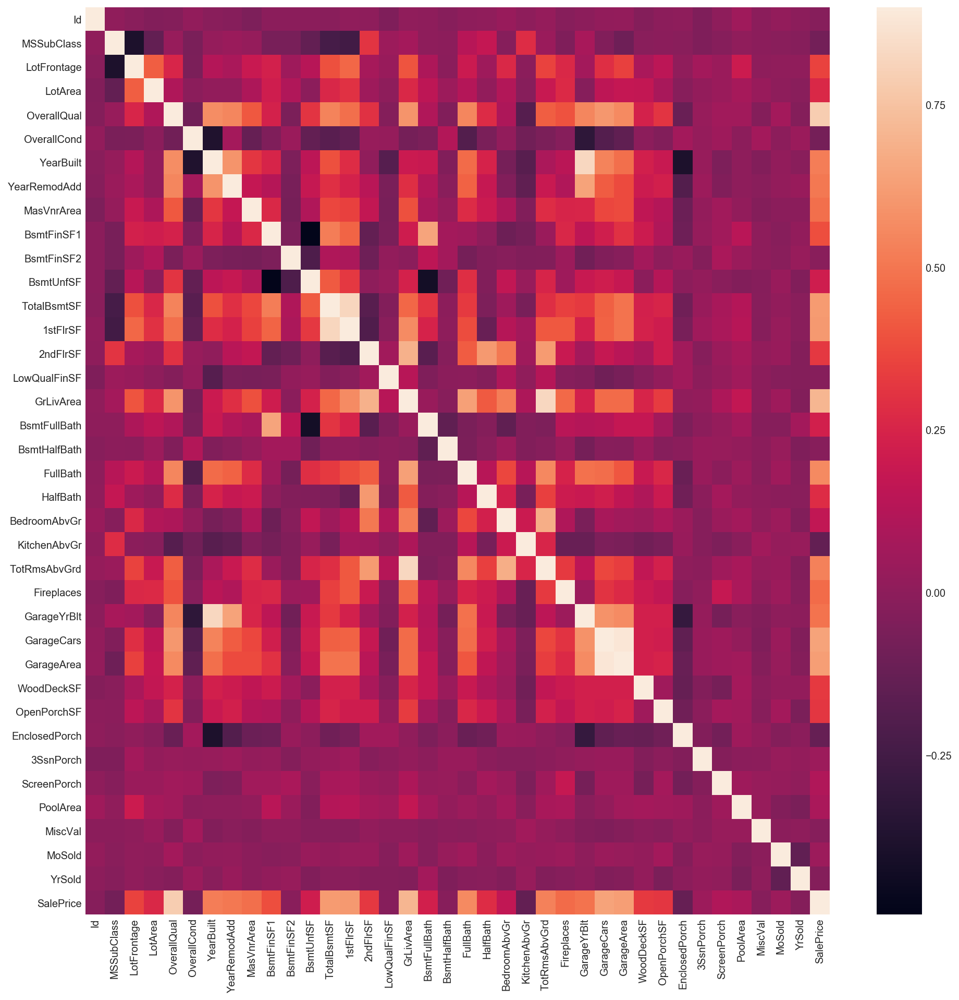

In [122]:
initial_heatmap = train.corr()
plt.subplots(figsize=(16,16))
sns.heatmap(initial_heatmap, vmax=0.9, square=False)

<a id='univariate'></a>
## Univariate Analysis

### Looking at 'SalePrice', our dependent variable for regression analysis.

In [123]:
train['SalePrice'].describe()

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64

In [124]:
print("The median for Sale Price is: ", train['SalePrice'].median(axis = 0))

The median for Sale Price is:  163000.0


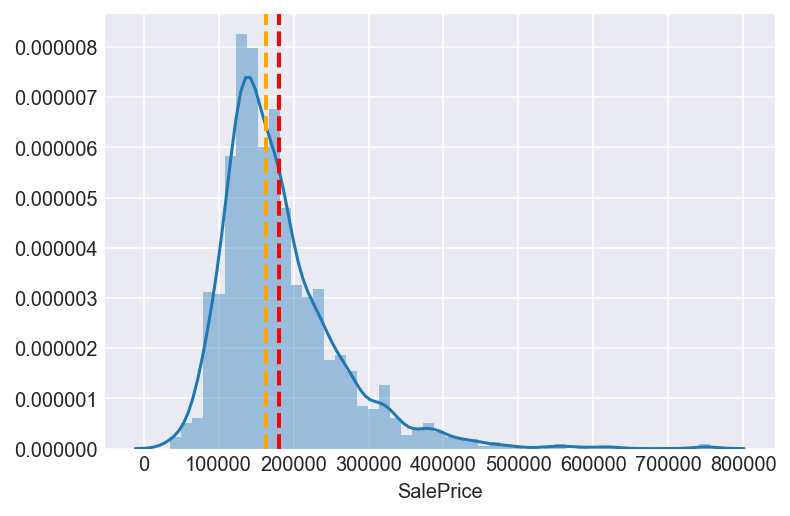

In [125]:
# Plotting SalePrice with the mean and median
sns.distplot(train['SalePrice']);
plt.axvline(train['SalePrice'].mean(), color='red', linestyle='dashed', linewidth=2)
plt.axvline(train['SalePrice'].median(), color='orange', linestyle='dashed', linewidth=2)

In [126]:
# This looks pretty skewed, so let's measure it:
print("Skewness for Sales Price: %f" % train['SalePrice'].skew())
print("Kurtosis for Sales Price: %f" % train['SalePrice'].kurt())

Skewness for Sales Price: 1.882876
Kurtosis for Sales Price: 6.536282


<a id='bivariate'></a>
## Bivariate Analysis

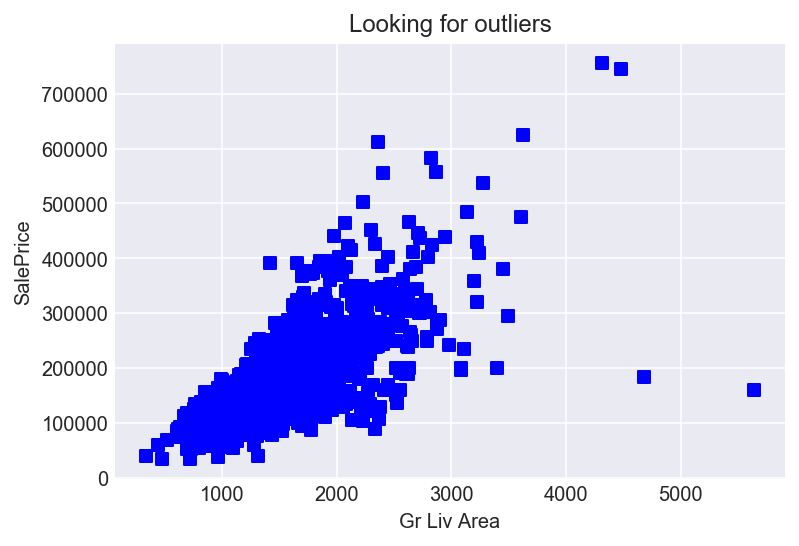

In [127]:
plt.scatter(train['GrLivArea'], train['SalePrice'], c = "blue", marker = "s")
plt.title("Looking for outliers")
plt.xlabel("Gr Liv Area")
plt.ylabel("SalePrice")
plt.show()

#### We have some outliers! The author of the original dataset recommends removing these outliers, stating:
    
    "I would recommend removing any houses with more than 4000 square feet from the data set..."
    
#### He further explains that these are in fact true outliers.
    
from: 

https://ww2.amstat.org/publications/jse/v19n3/decock.pdf

#### So, let's remove them from our dataset:

In [128]:
# Removing our outliers.
train = train[train['GrLivArea'] < 4000]

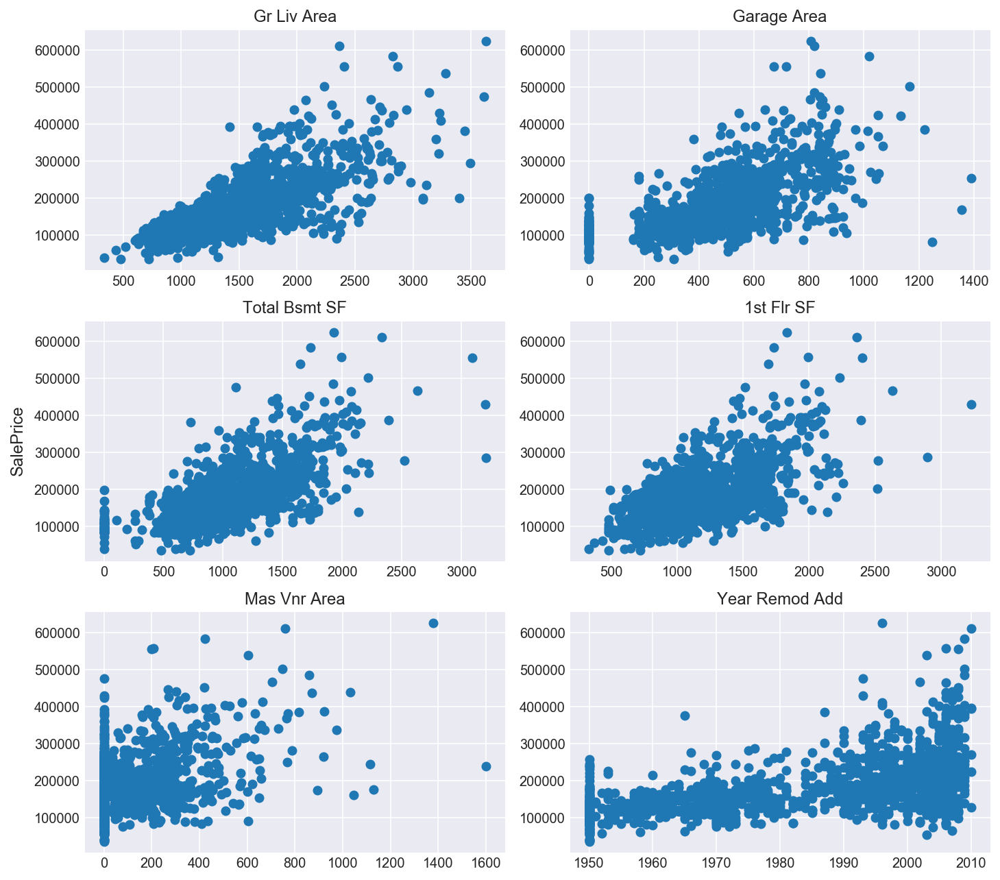

In [129]:
# Plotting some of the variables most correlated with Sale Price.
plt.figure(1)
f, ax1 = plt.subplots(3, 2, figsize=(10, 9))
price = train.SalePrice.values
ax1[0, 0].scatter(train['GrLivArea'].values, train['SalePrice'])
ax1[0, 0].set_title('Gr Liv Area')
ax1[0, 1].scatter(train['GarageArea'].values, train['SalePrice'])
ax1[0, 1].set_title('Garage Area')
ax1[1, 0].scatter(train['TotalBsmtSF'].values, train['SalePrice'])
ax1[1, 0].set_title('Total Bsmt SF')
ax1[1, 1].scatter(train['1stFlrSF'].values, train['SalePrice'])
ax1[1, 1].set_title('1st Flr SF')
ax1[2, 0].scatter(train['MasVnrArea'].values, train['SalePrice'])
ax1[2, 0].set_title('Mas Vnr Area')
ax1[2, 1].scatter(train['YearRemodAdd'].values, train['SalePrice'])
ax1[2, 1].set_title('Year Remod Add')
f.text(-0.01, 0.5, 'SalePrice', va='center', rotation='vertical', fontsize = 12)
plt.tight_layout()
plt.show()

We can see some general positive trends with these.

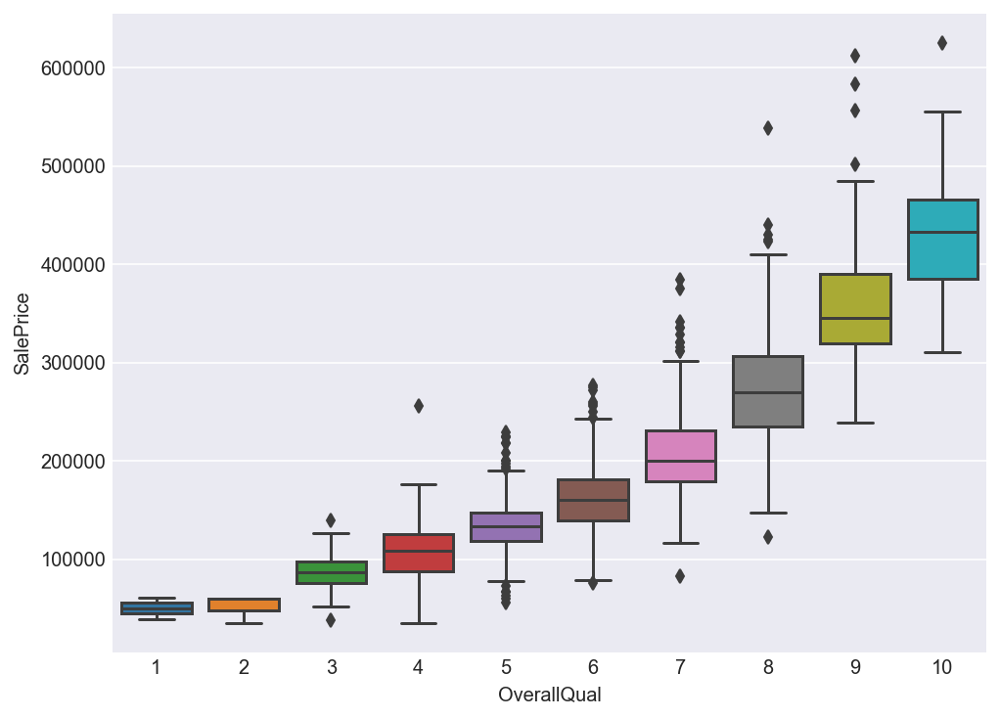

In [130]:
oq = 'OverallQual'
data = pd.concat([train['SalePrice'], train[oq]], axis=1)
f, ax = plt.subplots(figsize=(8, 6))
fig = sns.boxplot(x=oq, y="SalePrice", data=data)
fig.axis();

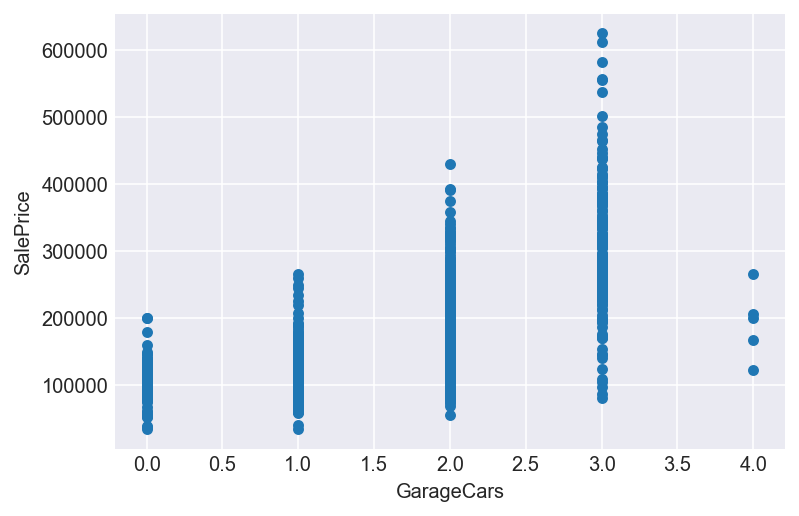

In [131]:
g_cars = 'GarageCars'
price_bsmt = pd.concat([train['SalePrice'], train[g_cars]], axis=1)
price_bsmt.plot.scatter(x=g_cars, y='SalePrice');

In [132]:
# Taking a look at the neighborhoods
train.groupby(['Neighborhood'])['SalePrice'].mean().sort_values(ascending=False)

Neighborhood
NridgHt    316270.623377
NoRidge    314028.410256
StoneBr    310499.000000
Timber     242247.447368
Veenker    238772.727273
Somerst    225379.837209
ClearCr    212565.428571
Crawfor    210624.725490
CollgCr    197965.773333
Blmngtn    194870.882353
Gilbert    192854.506329
NWAmes     189050.068493
SawyerW    186555.796610
Mitchel    156270.122449
NAmes      145847.080000
NPkVill    142694.444444
SWISU      142591.360000
Blueste    137500.000000
Sawyer     136793.135135
OldTown    128225.300885
Edwards    127318.571429
BrkSide    124834.051724
BrDale     104493.750000
IDOTRR     100123.783784
MeadowV     98576.470588
Name: SalePrice, dtype: float64

Wow! Some neighborhoods are much nicer than others.

In [133]:
# Checking out the building types.
train.groupby('BldgType')['SalePrice'].mean()

BldgType
1Fam      184857.808388
2fmCon    128432.258065
Duplex    133541.076923
Twnhs     135911.627907
TwnhsE    181959.342105
Name: SalePrice, dtype: float64

<a id='plotting'></a>
## Plotting the data

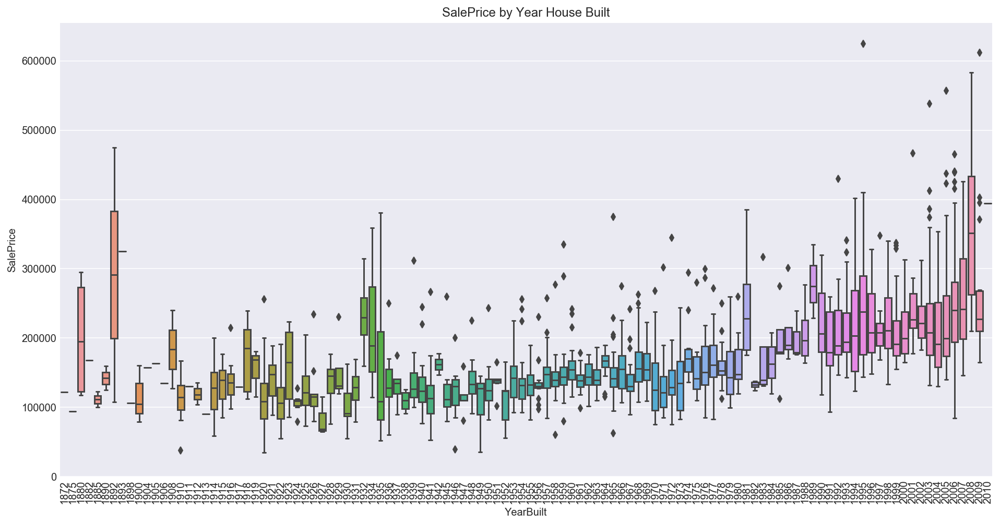

In [134]:
f, ax = plt.subplots(figsize=(16, 8))
fig = sns.boxplot(x='YearBuilt', y='SalePrice', data=train)
fig.axis(ymin=0);
plt.xticks(rotation=90);
plt.title("SalePrice by Year House Built");

There is a general trend upwards: Newer houses tend to be worth more.

<a id='cleaning'></a>
## Cleaning the data

### Combining both datasets for data cleaning and feature extraction.

In [135]:
# Separating out the dependent variables
ntrain = train.shape[0]
ntest = test.shape[0]
y_train = train['SalePrice']
# Creating a separate table for use in a logistic regression model for our regression analysis
y_log = y_train
# Saving and then droppping the Id Column
train_ID = train['Id']
test_ID = test['Id']
X_train = train.drop("Id", axis = 1)
X_test = test.drop("Id", axis = 1)
y_train.head(5)

0    208500
1    181500
2    223500
3    140000
4    250000
Name: SalePrice, dtype: int64

In [136]:
# Combinging the two datasets
df = pd.concat((X_train, X_test)).reset_index(drop=False)
#df.drop(['SalePrice'], axis=1, inplace=True)
df.head(5)

,index,1stFlrSF,2ndFlrSF,3SsnPorch,Alley,BedroomAbvGr,BldgType,BsmtCond,BsmtExposure,BsmtFinSF1,...,SaleType,ScreenPorch,Street,TotRmsAbvGrd,TotalBsmtSF,Utilities,WoodDeckSF,YearBuilt,YearRemodAdd,YrSold
0,0,856,854,0,NaN,3,1Fam,TA,No,706.0,...,WD,0,Pave,8,856.0,AllPub,0,2003,2003,2008
1,1,1262,0,0,NaN,3,1Fam,TA,Gd,978.0,...,WD,0,Pave,6,1262.0,AllPub,298,1976,1976,2007
2,2,920,866,0,NaN,3,1Fam,TA,Mn,486.0,...,WD,0,Pave,6,920.0,AllPub,0,2001,2002,2008
3,3,961,756,0,NaN,3,1Fam,Gd,No,216.0,...,WD,0,Pave,7,756.0,AllPub,0,1915,1970,2006
4,4,1145,1053,0,NaN,4,1Fam,TA,Av,655.0,...,WD,0,Pave,9,1145.0,AllPub,192,2000,2000,2008


In [137]:
print("Finding the features that are  most correlated with SalePrice for purposes of transformation:")
df.corr()['SalePrice'].abs().sort_values(ascending=False)

Finding the features that are  most correlated with SalePrice for purposes of transformation:


SalePrice        1.000000
OverallQual      0.800858
GrLivArea        0.720516
GarageCars       0.649256
TotalBsmtSF      0.646584
GarageArea       0.636964
1stFlrSF         0.625235
FullBath         0.559048
TotRmsAbvGrd     0.537462
YearBuilt        0.535279
YearRemodAdd     0.521428
GarageYrBlt      0.499230
MasVnrArea       0.478862
Fireplaces       0.466765
BsmtFinSF1       0.395923
LotFrontage      0.356773
OpenPorchSF      0.330361
WoodDeckSF       0.322538
2ndFlrSF         0.297301
HalfBath         0.282925
LotArea          0.269866
BsmtFullBath     0.235697
BsmtUnfSF        0.220678
BedroomAbvGr     0.160542
KitchenAbvGr     0.138849
EnclosedPorch    0.129774
ScreenPorch      0.118324
MSSubClass       0.088160
OverallCond      0.080202
MoSold           0.056797
3SsnPorch        0.047414
BsmtHalfBath     0.036792
PoolArea         0.032819
index            0.027455
LowQualFinSF     0.025351
YrSold           0.023694
MiscVal          0.021097
BsmtFinSF2       0.008900
Name: SalePr

### Replacing Missing Values

In [138]:
# Identifying missing values.
total = df.isnull().sum().sort_values(ascending=False)
percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total Missing Values', 'Percent of Data'])
missing_data.head(10)

,Total Missing Values,Percent of Data
PoolQC,2907,0.997256
MiscFeature,2810,0.963979
Alley,2717,0.932075
Fence,2345,0.804460
SalePrice,1459,0.500515
FireplaceQu,1420,0.487136
LotFrontage,486,0.166724
GarageYrBlt,159,0.054545
GarageQual,159,0.054545
GarageFinish,159,0.054545


Text(0.5,1,'Percentage of missing data by feature')

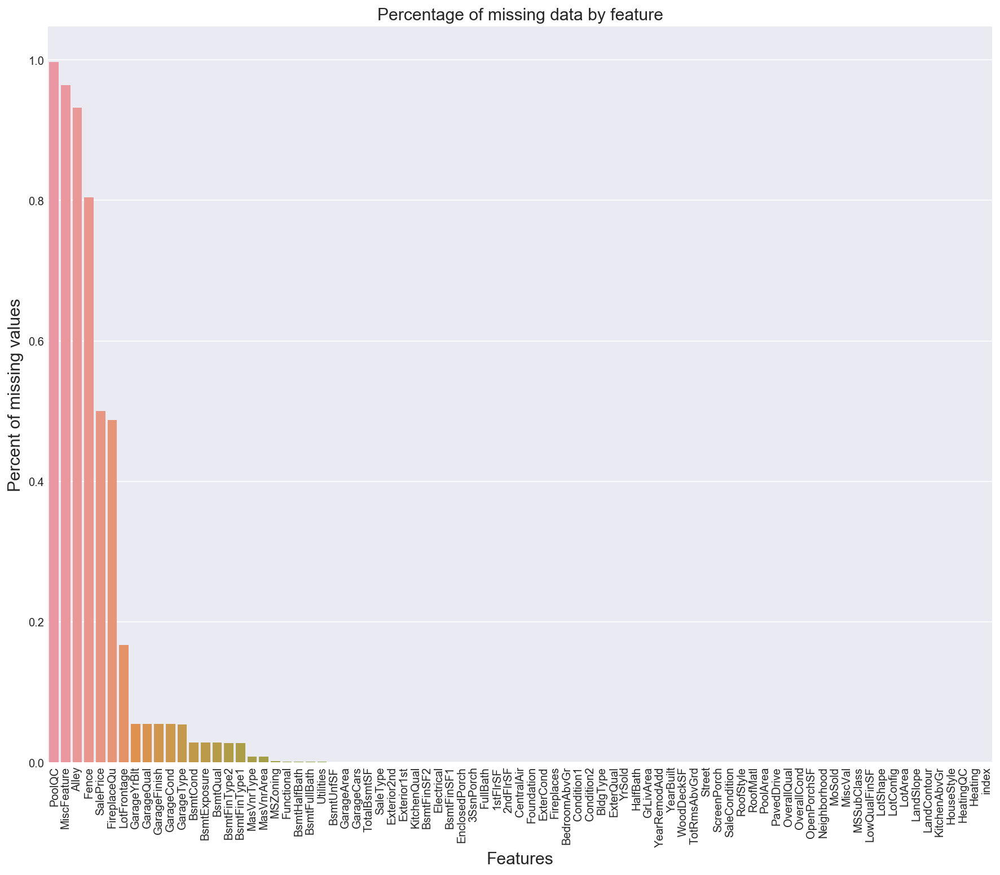

In [139]:
# Visualizing missing values.
f, ax = plt.subplots(figsize=(15, 12))
plt.xticks(rotation='90')
sns.barplot(x=percent.index, y=percent)
plt.xlabel('Features', fontsize=15)
plt.ylabel('Percent of missing values', fontsize=15)
plt.title('Percentage of missing data by feature', fontsize=15)

Wow! There are a lot of missing values for Pool QC. This makes sense as most houses do not have a pool. In fact, we can make the assumption that the missing values for most categories are due to the instance not having that feature. 

** Note: It is also reasonable to assume that Garage Yr Blt would be equal to the year the house was built.

In [140]:
# Replacing missing values for every column except Lot Frontage with the an appropriate value: 
# 0 for numeric and No/None for categorical
df = df.fillna({
    'Alley': 'None',
    'MasVnrType' : 'None',
    'PoolQC' : 'No',
    'MiscFeature': 'No',
    'Fence': 'No',
    'FireplaceQu': 'No',
    'GarageCond': 'No',
    'GarageFinish': 'No',
    'GarageQual' : 'No',
    'GarageType' : 'No',
    'BsmtExposure' : 'No',
    'BsmtFinType1' : 'No',
    'BsmtFinType2' : 'No',
    'BsmtCond' : 'No',
    'BsmtQual' : 'No',
    'MasVnrArea' : 0,
    'BsmtHalfBath'   : 0,
    'BsmtFullBath' : 0,
    'GarageCars'   : 0,
    'GarageArea' : 0,
    'TotalBsmtSF'   : 0,
    'BsmtUnfSF' : 0,
    'BsmtFinSF1'   : 0,
    'BsmtFinSF2' : 0,
    'GarageYrBlt': 0,
    'MSZoning': 'RL',
    'Functional': 'Typ',
    'KitchenQual': 'Ta',
    'Exterior1st': 'VinylSd',
    'Exterior2nd': 'VinylSd',
    'SaleType': 'WD',
    'SaleCondition': 'Normal',
    'Utilities' : 'AllPub',
    'Electrical' : 'SBrkr'
})

In [141]:
# Filling nulls for Basement variables
df.loc[df.BsmtFinSF1.isnull(), 'BsmtFinSF1'] = df.BsmtFinSF1.median()

In [142]:
# Filling nulls for Garage variables
df.loc[df['GarageArea'].isnull(), 'GarageArea'] = df.loc[df['GarageType']=='Detchd', 'GarageArea'].mean()
df.loc[df['GarageCars'].isnull(), 'GarageCars'] = df.loc[df['GarageType']=='Detchd', 'GarageCars'].median()

In [143]:
# Replacing missing values for Lot Frontage with the mean value for the neighborhood the house is in.
df["LotFrontage"] = df.groupby("Neighborhood")["LotFrontage"].transform(lambda x: x.fillna(x.median()))
total = df.isnull().sum().sort_values(ascending=False)
total.head(5)

SalePrice        1459
Foundation          0
EnclosedPorch       0
ExterCond           0
ExterQual           0
dtype: int64

In [144]:
# Capturing the stragglers that couldn't be transformed based on their neighborhoods
df["LotFrontage"] = df["LotFrontage"].transform(lambda x: x.fillna(x.mean()))

<a id='features'></a>
## Feature Engineering

### Aggregate Variables

In [145]:
# Creating an aggregate variable for Total Sqaure Feet.
df['TotalSF'] = (df['TotalBsmtSF'] + df['1stFlrSF'] + df['2ndFlrSF'] + df['WoodDeckSF'] + df['OpenPorchSF']).astype(int)

### Refactoring Variables

In [146]:
newer_dwelling = df.MSSubClass.replace({20: 1, 
                                        30: 0, 
                                        40: 0, 
                                        45: 0,
                                        50: 0, 
                                        60: 1,
                                        70: 0,
                                        75: 0,
                                        80: 0,
                                        85: 0,
                                        90: 0,
                                        120: 1,
                                        150: 0,
                                        160: 0,
                                        180: 0,
                                        190: 0})
newer_dwelling.name = 'newer_dwelling'

In [147]:
# Turning MS SubClass and Mo Sold into categorical variables.
df = df.replace({
    "MSSubClass" : {20 : "SC20", 30 : "SC30", 40 : "SC40", 45 : "SC45", 50 : "SC50", 60 : "SC60", 70 : "SC70",
                     75 : "SC75", 80 : "SC80", 85 : "SC85", 90 : "SC90", 120 : "SC120", 150 : "SC150", 160 : "SC160",
                     180 : "SC180", 190 : "SC190"},
    "MoSold" : {1 : "Jan", 2 : "Feb", 3 : "Mar", 4 : "Apr", 5 : "May", 6 : "Jun", 7 : "Jul", 8 : "Aug", 9 : "Sep",
                 10 : "Oct", 11 : "Nov", 12 : "Dec"}
})

# Turning Year sold into a categorical variable.
df['YrSold'] = df['YrSold'].astype(str)

In [148]:
# Numerically encoding categorical variables where order might be inherent.
df = df.replace({
    "Alley" : {"None" : 0, "Grvl" : 1, "Pave" : 2},
    "BsmtCond" : {"No" : 0, "Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
    "BsmtExposure" : {"No" : 0, "Mn" : 1, "Av": 2, "Gd" : 3},
    "BsmtFinType1" : {"No" : 0, "Unf" : 1, "LwQ": 2, "Rec" : 3, "BLQ" : 4, "ALQ" : 5, "GLQ" : 6},
    "BsmtFinType2" : {"No" : 0, "Unf" : 1, "LwQ": 2, "Rec" : 3, "BLQ" : 4, "ALQ" : 5, "GLQ" : 6},
    "BsmtQual" : {"No" : 0, "Po" : 1, "Fa" : 2, "TA": 3, "Gd" : 4, "Ex" : 5},
    "ExterCond" : {"Po" : 0, "Fa" : 1, "TA": 2, "Gd": 3, "Ex" : 4},
    "ExterQual" : {"Po" : 0, "Fa" : 1, "TA": 2, "Gd": 3, "Ex" : 4},
    "FireplaceQu" : {"No" : 0, "Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
    "Functional" : {"Sal" : 0, "Sev" : 1, "Maj2" : 2, "Maj1" : 3, "Mod": 4, "Min2" : 5, "Min1" : 6, "Typ" : 7},
    "GarageCond" : {"No" : 0, "Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
    "GarageQual" : {"No" : 0, "Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
    "HeatingQC" : {"Po" : 0, "Fa" : 1, "TA" : 2, "Gd" : 3, "Ex" : 4},
    "KitchenQual" : {"Po" : 0, "Fa" : 1, "TA" : 2, "Gd" : 3, "Ex" : 4},
    "LandSlope" : {"Sev" : 0, "Mod" : 1, "Gtl" : 2},
    "LotShape" : {"IR3" : 0, "IR2" : 1, "IR1" : 2, "Reg" : 3},
    "PavedDrive" : {"None" : 0, "P" : 1, "Y" : 2},
    "PoolQC" : {"No" : 0, "Fa" : 1, "TA" : 2, "Gd" : 3, "Ex" : 4},
    "Street" : {"Grvl" : 0, "Pave" : 1},
    "Utilities" : {"ELO" : 0, "NoSeWa" : 1, "NoSewr" : 2, "AllPub" : 3},
    "Fence" : {'NoFence': 0, 'MnWw': 1, 'MnPrv': 2, 'GdWo': 3, 'GdPrv': 4}
})

In [149]:
# Numerically encoding some Yes/No variables.
df = df.replace({'CentralAir': {'Y': 1, 'N': 0}})
df = df.replace({'PavedDrive': {'Y': 1, 'P': 0, 'N': 0}})

In [150]:
# Creating some aggregate variables measuring condition qualities.
overall_poor_qu = df.OverallQual.copy()
overall_poor_qu = 5 - overall_poor_qu
overall_poor_qu[overall_poor_qu<0] = 0
overall_poor_qu.name = 'overall_poor_qu'

overall_good_qu = df.OverallQual.copy()
overall_good_qu = overall_good_qu - 5
overall_good_qu[overall_good_qu<0] = 0
overall_good_qu.name = 'overall_good_qu'

overall_poor_cond = df.OverallCond.copy()
overall_poor_cond = 5 - overall_poor_cond
overall_poor_cond[overall_poor_cond<0] = 0
overall_poor_cond.name = 'overall_poor_cond'

overall_good_cond = df.OverallCond.copy()
overall_good_cond = overall_good_cond - 5
overall_good_cond[overall_good_cond<0] = 0
overall_good_cond.name = 'overall_good_cond'

exter_poor_qu = df.ExterQual.copy()
exter_poor_qu[exter_poor_qu<3] = 1
exter_poor_qu[exter_poor_qu>=3] = 0
exter_poor_qu.name = 'exter_poor_qu'

exter_good_qu = df.ExterQual.copy()
exter_good_qu[exter_good_qu<=3] = 0
exter_good_qu[exter_good_qu>3] = 1
exter_good_qu.name = 'exter_good_qu'

exter_poor_cond = df.ExterCond.copy()
exter_poor_cond[exter_poor_cond<3] = 1
exter_poor_cond[exter_poor_cond>=3] = 0
exter_poor_cond.name = 'exter_poor_cond'

exter_good_cond = df.ExterCond.copy()
exter_good_cond[exter_good_cond<=3] = 0
exter_good_cond[exter_good_cond>3] = 1
exter_good_cond.name = 'exter_good_cond'

bsmt_poor_cond = df.BsmtCond.copy()
bsmt_poor_cond[bsmt_poor_cond<3] = 1
bsmt_poor_cond[bsmt_poor_cond>=3] = 0
bsmt_poor_cond.name = 'bsmt_poor_cond'

bsmt_good_cond = df.BsmtCond.copy()
bsmt_good_cond[bsmt_good_cond<=3] = 0
bsmt_good_cond[bsmt_good_cond>3] = 1
bsmt_good_cond.name = 'bsmt_good_cond'

garage_poor_qu = df.GarageQual.copy()
garage_poor_qu[garage_poor_qu<3] = 1
garage_poor_qu[garage_poor_qu>=3] = 0
garage_poor_qu.name = 'garage_poor_qu'

garage_good_qu = df.GarageQual.copy()
garage_good_qu[garage_good_qu<=3] = 0
garage_good_qu[garage_good_qu>3] = 1
garage_good_qu.name = 'garage_good_qu'

garage_poor_cond = df.GarageCond.copy()
garage_poor_cond[garage_poor_cond<3] = 1
garage_poor_cond[garage_poor_cond>=3] = 0
garage_poor_cond.name = 'garage_poor_cond'

garage_good_cond = df.GarageCond.copy()
garage_good_cond[garage_good_cond<=3] = 0
garage_good_cond[garage_good_cond>3] = 1
garage_good_cond.name = 'garage_good_cond'

In [151]:
# Creating a dataframe for our aggregate variables.
qu_list = pd.concat((overall_poor_qu, overall_good_qu, overall_poor_cond, overall_good_cond, exter_poor_qu,
                     exter_good_qu, exter_poor_cond, exter_good_cond, bsmt_poor_cond, bsmt_good_cond, garage_poor_qu,
                     garage_good_qu, garage_poor_cond, garage_good_cond), axis=1)

In [152]:
# Creating some more aggregate variables.
MasVnrType_Any = df.MasVnrType.replace({'BrkCmn': 1,
                                        'BrkFace': 1,
                                        'CBlock': 1,
                                        'Stone': 1,
                                        'None': 0})
MasVnrType_Any.name = 'MasVnrType_Any'

SaleCondition_PriceDown = df.SaleCondition.replace({'Abnorml': 1,
                                                    'Alloca': 1,
                                                    'AdjLand': 1,
                                                    'Family': 1,
                                                    'Normal': 0,
                                                    'Partial': 0})
SaleCondition_PriceDown.name = 'SaleCondition_PriceDown'

season = df.MoSold.replace({1: 0, 
                            2: 0, 
                            3: 0, 
                            4: 1,
                            5: 1, 
                            6: 1,
                            7: 1,
                            8: 0,
                            9: 0,
                            10: 0,
                            11: 0,
                            12: 0})
season.name = 'season'

In [153]:
# Separating out the high end neighborhoods.
Neighborhood_Good = pd.DataFrame(np.zeros((df.shape[0],1)), columns=['Neighborhood_Good'])
Neighborhood_Good[df.Neighborhood=='NridgHt'] = 1
Neighborhood_Good[df.Neighborhood=='Crawfor'] = 1
Neighborhood_Good[df.Neighborhood=='StoneBr'] = 1
Neighborhood_Good[df.Neighborhood=='Somerst'] = 1
Neighborhood_Good[df.Neighborhood=='NoRidge'] = 1

In [154]:
df = pd.concat((df, newer_dwelling, season, qu_list, MasVnrType_Any,), axis=1)

## Transformation

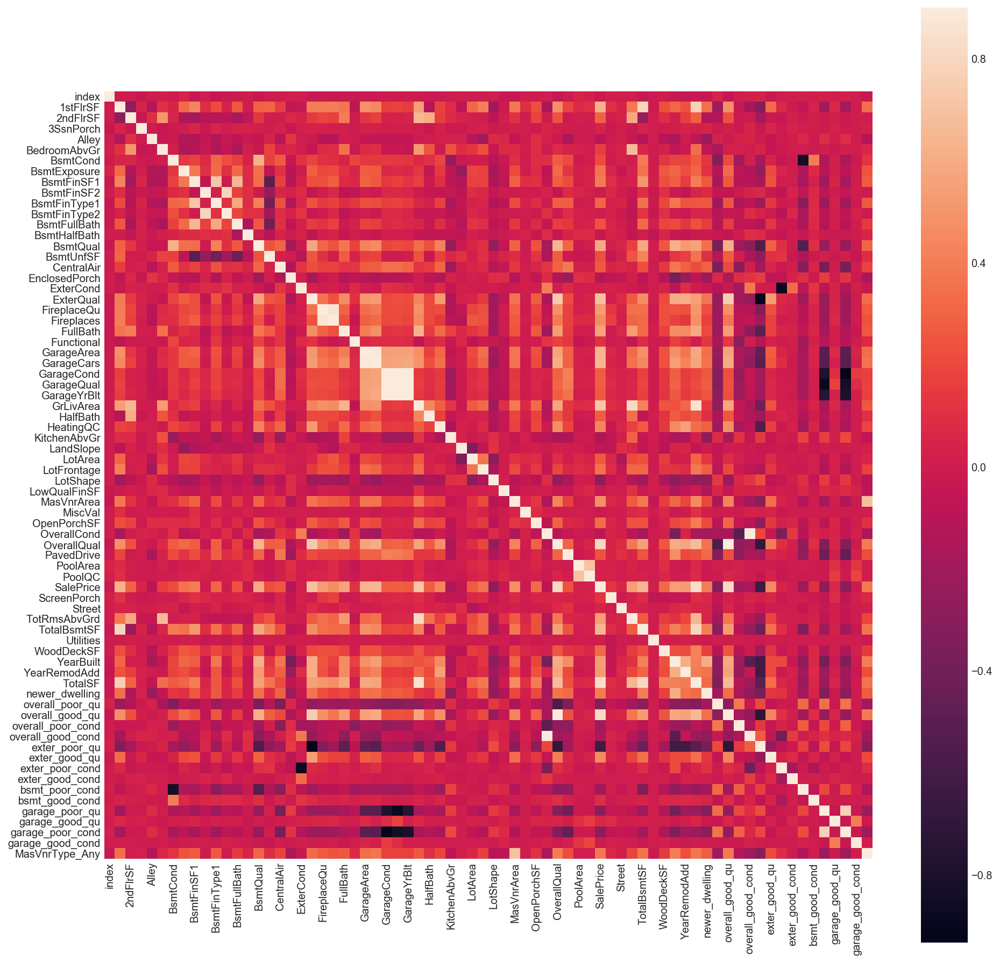

In [155]:
# Identifying correlations after the refactoring
heatmap = df.corr()
plt.subplots(figsize=(16,16))
sns.heatmap(heatmap, vmax=0.9, square=True)

In [156]:
print("Finding the features that are  most correlated with SalePrice for purposes of transformation:")
train.corr()['SalePrice'].abs().sort_values(ascending=False)

Finding the features that are  most correlated with SalePrice for purposes of transformation:


SalePrice        1.000000
OverallQual      0.800858
GrLivArea        0.720516
GarageCars       0.649256
TotalBsmtSF      0.646584
GarageArea       0.636964
1stFlrSF         0.625235
FullBath         0.559048
TotRmsAbvGrd     0.537462
YearBuilt        0.535279
YearRemodAdd     0.521428
GarageYrBlt      0.499230
MasVnrArea       0.478862
Fireplaces       0.466765
BsmtFinSF1       0.395923
LotFrontage      0.356773
OpenPorchSF      0.330361
WoodDeckSF       0.322538
2ndFlrSF         0.297301
HalfBath         0.282925
LotArea          0.269866
BsmtFullBath     0.235697
BsmtUnfSF        0.220678
BedroomAbvGr     0.160542
KitchenAbvGr     0.138849
EnclosedPorch    0.129774
ScreenPorch      0.118324
MSSubClass       0.088160
OverallCond      0.080202
MoSold           0.056797
3SsnPorch        0.047414
BsmtHalfBath     0.036792
PoolArea         0.032819
Id               0.027455
LowQualFinSF     0.025351
YrSold           0.023694
MiscVal          0.021097
BsmtFinSF2       0.008900
Name: SalePr

### Extracting Features

In [157]:
# Separating out the numerical and categorical variables.
all_feat = df.select_dtypes(include = ['object', 'int64', 'float64']).columns
cat_feat = df.select_dtypes(include = ['object']).columns
num_feat = df.select_dtypes(exclude = ["object"]).columns
num_feat = num_feat.drop("SalePrice")
print("Numerical features : " + str(len(num_feat)))
print("Categorical features : " + str(len(cat_feat)))
cat_feat

Numerical features : 71
Categorical features : 27


Index(['BldgType', 'Condition1', 'Condition2', 'Electrical', 'Exterior1st',
       'Exterior2nd', 'Fence', 'Foundation', 'GarageFinish', 'GarageType',
       'Heating', 'HouseStyle', 'KitchenQual', 'LandContour', 'LotConfig',
       'MSSubClass', 'MSZoning', 'MasVnrType', 'MiscFeature', 'MoSold',
       'Neighborhood', 'RoofMatl', 'RoofStyle', 'SaleCondition', 'SaleType',
       'YrSold', 'season'],
      dtype='object')

##### Getting Dummies

In [158]:
df = pd.get_dummies(df)
df.head(5)

,index,1stFlrSF,2ndFlrSF,3SsnPorch,Alley,BedroomAbvGr,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,...,season_Dec,season_Feb,season_Jan,season_Jul,season_Jun,season_Mar,season_May,season_Nov,season_Oct,season_Sep
0,0,856,854,0,0,3,3,0,706.0,0.0,...,0,1,0,0,0,0,0,0,0,0
1,1,1262,0,0,0,3,3,3,978.0,0.0,...,0,0,0,0,0,0,1,0,0,0
2,2,920,866,0,0,3,3,1,486.0,0.0,...,0,0,0,0,0,0,0,0,0,1
3,3,961,756,0,0,3,4,0,216.0,0.0,...,0,1,0,0,0,0,0,0,0,0
4,4,1145,1053,0,0,4,3,2,655.0,0.0,...,1,0,0,0,0,0,0,0,0,0


In [159]:
# Creating individual dataframes for categorical and numerical values.
df_num = df[num_feat]
cat_cols = [col for col in df.columns if col not in num_feat]
df_dum = df[cat_cols]
df_dummies = df_dum.drop(['SalePrice'], axis=1)
df_dummies.head(5)

,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,...,season_Dec,season_Feb,season_Jan,season_Jul,season_Jun,season_Mar,season_May,season_Nov,season_Oct,season_Sep
0,1,0,0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,0,0,0,0
1,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,1,0,0,0
2,1,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,1
3,1,0,0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,0,0,0,0
4,1,0,0,0,0,0,0,1,0,0,...,1,0,0,0,0,0,0,0,0,0


##### Creating Polynomial Features

In [160]:
# Creating polynomial features up to a degree of 3 for all numerical features.
pf = PolynomialFeatures(degree=2, include_bias=True)
poly = pf.fit_transform(df_num)
poly2 = pf.get_feature_names(df_num.columns)
poly2

df_poly = pd.DataFrame(poly, columns = poly2)
# df_poly.drop(['index'], axis=1, inplace=True)
print("Numerical features : " + str(len(df_poly.columns)))

Numerical features : 2628


#### Fixing the skewed features

In [161]:
# Checking the skew of all numerical features
poly_num_feat = df_poly.select_dtypes(exclude = ["object"]).columns
skewed_feats = df_poly[poly_num_feat].apply(lambda x: skew(x)).sort_values(ascending=False)
skewness = pd.DataFrame({'Skew' :skewed_feats})
skewness = skewness[abs(skewness) > 0.75]
skewness.head(5)

,Skew
LowQualFinSF bsmt_good_cond,53.962953
PoolQC exter_good_qu,53.962953
bsmt_good_cond garage_good_qu,53.962953
overall_poor_qu garage_good_cond,53.962953
MiscVal PoolArea,53.962953


#### Oh No! We are so skewed!

In [162]:
print("There are {} skewed numerical features to transform".format(skewness.shape[0]))
skewed_features = skewness.index
lam = 0.15
for feat in skewed_features:
    df_poly = boxcox1p(df_poly, lam)
print('Transformation Complete')

There are 2628 skewed numerical features to transform
Transformation Complete


In [163]:
# Train/Test Split for scaling the data using MinMaxScaler
poly_train_split = df_poly[:train.shape[0]]
poly_test_split = df_poly[train.shape[0]:]
# Creating our scaler
ss = StandardScaler()
ss.fit(poly_train_split)
# Scaling the data
poly_train_scaled = ss.transform(poly_train_split)
params = ss.get_params(deep=True)
poly_test_scaled = ss.transform(poly_test_split)
params
# Combinging the datasets again
poly_train_df = pd.DataFrame(poly_train_scaled, columns = poly2)
poly_test_df = pd.DataFrame(poly_test_scaled, columns = poly2)
df_poly = pd.concat([poly_train_df, poly_test_df]).reset_index(drop=True)
# df_poly.drop(['index'], axis=1, inplace=True)
df_poly.drop(['1'], axis=1, inplace=True)

In [164]:
print("New number of Numerical features : " + str(len(df_dummies.select_dtypes(exclude = ["object"]).columns)))
print("New number of Categorical features : " + str(len(df_dummies.select_dtypes(include = ['object']).columns)))

New number of Numerical features : 220
New number of Categorical features : 0


In [165]:
# Combining the dummy categories and numerical features
df = pd.concat([df_poly, df_dummies], axis=1).reset_index(drop=True)
df.drop(['index'], axis=1, inplace=True)
df.head(5)

,1stFlrSF,2ndFlrSF,3SsnPorch,Alley,BedroomAbvGr,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,...,season_Dec,season_Feb,season_Jan,season_Jul,season_Jun,season_Mar,season_May,season_Nov,season_Oct,season_Sep
0,-0.791677,1.149869,-0.12946,-0.258199,0.065214,0.161492,-0.684999,0.687214,-0.359941,0.163841,...,0,1,0,0,0,0,0,0,0,0
1,0.456961,-0.869674,-0.12946,-0.258199,0.065214,0.161492,1.460469,0.687245,-0.359941,0.163502,...,0,0,0,0,0,0,1,0,0,0
2,-0.552208,1.149870,-0.12946,-0.258199,0.065214,0.161492,1.458834,0.687176,-0.359941,0.163841,...,0,0,0,0,0,0,0,0,0,1
3,-0.409128,1.149858,-0.12946,-0.258199,0.065214,0.162219,-0.684999,0.687080,-0.359941,0.163502,...,0,1,0,0,0,0,0,0,0,0
4,0.153116,1.149887,-0.12946,-0.258199,0.067001,0.161492,1.460023,0.687207,-0.359941,0.163841,...,1,0,0,0,0,0,0,0,0,0


#### This is going to be a sparse dataset with n_samples < n_features. A lasso model might do well here.

In [166]:
# Train/Test Split
X_train_scaled = df[:train.shape[0]]
X_test = df[train.shape[0]:]
test_cols = [col for col in X_test.columns]
# Making sure the first rows on our new test dataset are the fist rows in our original dataset.
X_test.head()

,1stFlrSF,2ndFlrSF,3SsnPorch,Alley,BedroomAbvGr,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,...,season_Dec,season_Feb,season_Jan,season_Jul,season_Jun,season_Mar,season_May,season_Nov,season_Oct,season_Sep
1456,-0.639581,-0.869674,-0.12946,-0.258199,0.061966,0.161492,-0.684999,0.687172,2.778100,0.162301,...,0,0,0,0,1,0,0,0,0,0
1457,0.616160,-0.869674,-0.12946,-0.258199,0.065214,0.161492,-0.684999,0.687240,-0.359941,0.163502,...,0,0,0,0,1,0,0,0,0,0
1458,-0.523693,1.149851,-0.12946,-0.258199,0.065214,0.161492,-0.684999,0.687225,-0.359941,0.163841,...,0,0,0,0,0,1,0,0,0,0
1459,-0.530794,1.149848,-0.12946,-0.258199,0.065214,0.161492,-0.684999,0.687198,-0.359941,0.163841,...,0,0,0,0,1,0,0,0,0,0
1460,0.500706,-0.869674,-0.12946,-0.258199,0.061966,0.161492,-0.684999,0.687105,-0.359941,0.163502,...,0,0,1,0,0,0,0,0,0,0


In [167]:
# Fixing some of the changes made in our numerous concatenations
X_test = np.nan_to_num(X_test)
X_test = pd.DataFrame(X_test, index=test['Id'], columns = test_cols)
X_test_scaled = X_test.apply(pd.to_numeric)

<a id='assumptions'></a>
## Checking assumptions

### Normalicy Check

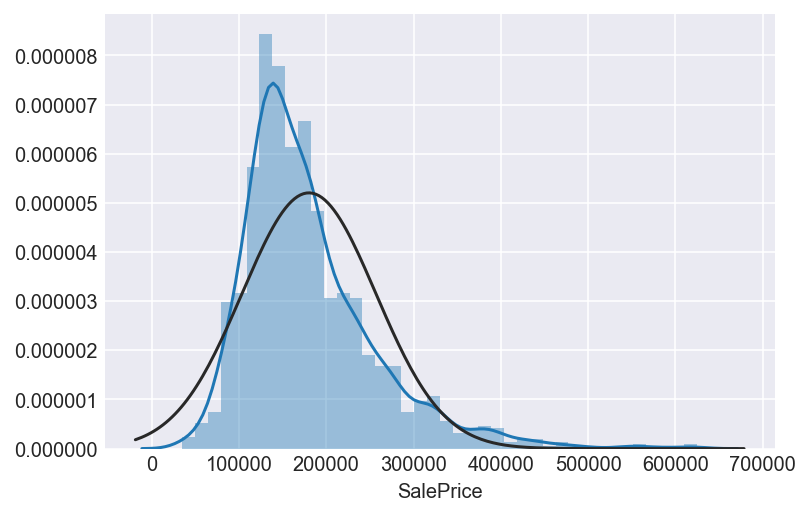

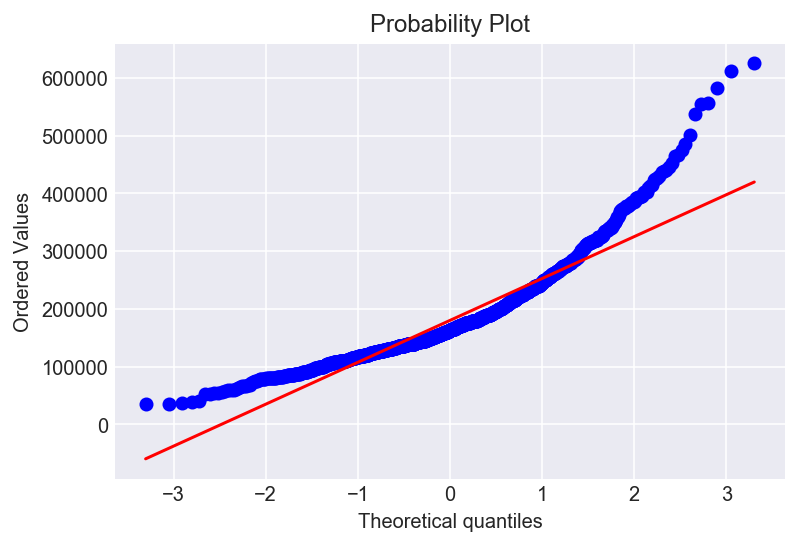

In [168]:
sns.distplot(train['SalePrice'], fit=norm);
fig = plt.figure()
sp = stats.probplot(train['SalePrice'], plot=plt)

In [169]:
# Creating Log and Log1p for SalePrice
log_y_train = np.log(train['SalePrice'])
y_train = np.log1p(train['SalePrice'])
log10_y_train = np.log10(train['SalePrice'])

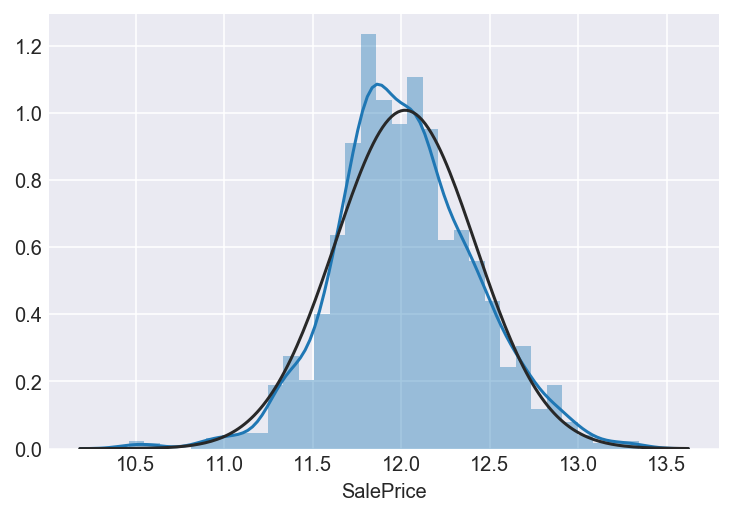

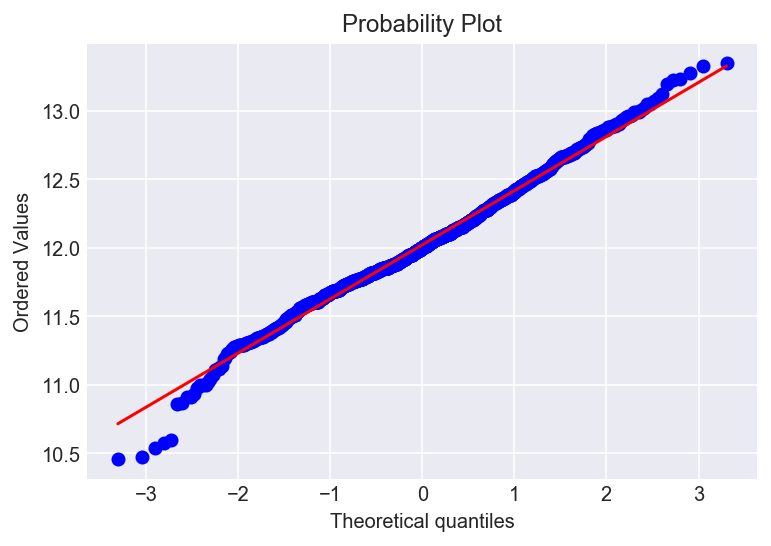

In [170]:
sns.distplot(y_train, fit=norm);
fig = plt.figure()
sp = stats.probplot(y_train, plot=plt)

#### This looks much better.

### Train/Test Split for testing our models

In [171]:
X_train_reg, X_holdout_reg, y_train_reg, y_holdout_reg = train_test_split(X_train_scaled, y_train, random_state=95)

<a id='regression'></a>
## Regression Analysis

### Creating a function that measures Root Mean Squared Error.

In [172]:
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

In [173]:
n_folds = 5

def rmse_cv(model):
    kf = KFold(n_folds, shuffle=True, random_state=95).get_n_splits(X_train_scaled.values)
    rmse= np.sqrt(-cross_val_score(model, X_train_scaled, y_train, scoring="neg_mean_squared_error", cv = kf))
    return(rmse)

<a id='linear'></a>
### Simple (Polynomial) Linear Regression

In [174]:
# Linear regression using the Normal Equation (OLS based CLR) on our train/test split
lr = LinearRegression(n_jobs=-1)
linreg = lr.fit(X_train_reg, y_train_reg)
linreg
linreg_pred = linreg.predict(X_holdout_reg)
print("Train R Squared:", lr.score(X_train_reg, y_train_reg))
print("Holdout R Squared:", lr.score(X_holdout_reg, y_holdout_reg))
print('Intercept:', linreg.intercept_)
print('Coefs:', linreg.coef_)

Train R Squared: 1.0
Holdout R Squared: -2021064.48078
Intercept: 12.8045001136
Coefs: [  1.64880110e+01   5.20484911e+00   2.29339133e-01 ...,  -5.42036404e-03
   5.12045721e-02   1.19865079e-02]


In [175]:
# Final Regression Model on the full training dataset
lr = LinearRegression(n_jobs=-1)
linreg = lr.fit(X_train_scaled, y_train)
linreg
linreg_pred = linreg.predict(X_test_scaled)
print('R Squared:', linreg.score(X_train_scaled, y_train))
print('Intercept:', linreg.intercept_)
print('Coefs:', linreg.coef_)

R Squared: 1.0
Intercept: -180.630975528
Coefs: [ -8.79163007e+02  -8.93144047e+01  -2.29255255e+01 ...,   7.72641417e-02
   7.61411224e-02  -2.15134742e-03]


In [176]:
print("CV Root Mean Squared Error: {:.4f} ({:.4f})\n".format(rmse_cv(linreg).mean(), rmse_cv(linreg).std()))

CV Root Mean Squared Error: 1138.0876 (874.2841)



### Regularlized Regression Models

<a id='reg-ridge'></a>
#### Ridge regression

In [177]:
# Train/Test Split
r_alphas = np.arange(408.3, 408.5, .0001)
coefs = []
features = [col for col in df.columns]
ridge_cv = RidgeCV(alphas=r_alphas)
ridge_cv.fit(X_train_reg, y_train_reg)
ridge_cv_pred = ridge_cv.predict(X_holdout_reg)
print('Best alpha:', ridge_cv.alpha_)
print("Train R Squared:", ridge_cv.score(X_train_reg, y_train_reg))
print("Holdout R Squared:", ridge_cv.score(X_holdout_reg, y_holdout_reg))
print('Intercept:', ridge_cv.intercept_)
print('Coefs:', ridge_cv.coef_)

Best alpha: 408.3998
Train R Squared: 0.938622459981
Holdout R Squared: 0.842552703341
Intercept: 12.0196364849
Coefs: [  2.05705464e-03   1.17521506e-04  -1.27733065e-04 ...,  -1.08864459e-05
   3.66238939e-04  -2.52179909e-03]


In [178]:
# Double checking on full dataset.
r_alphas = np.arange(769, 771, .001)
ridge_cv = RidgeCV(alphas=r_alphas, cv=5)
ridge_cv.fit(X_train_scaled, y_train)
ridge_cv_pred = ridge_cv.predict(X_test_scaled)
print('Best alpha:', ridge_cv.alpha_)
print('R Squared:', ridge_cv.score(X_train_scaled, y_train))
print('Intercept:', ridge_cv.intercept_)
print('Coefs:', ridge_cv.coef_)

Best alpha: 769.811
R Squared: 0.925451981341
Intercept: 12.0226383872
Coefs: [ 0.00288627  0.00015363 -0.0001022  ..., -0.00076755 -0.00075897
 -0.00102547]


In [179]:
# Final Model.
ridge = Ridge(alpha=408.3998)
ridge.fit(X_train_scaled, y_train)
ridge_pred = ridge.predict(X_test_scaled)

In [180]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(ridge).mean(), rmse_cv(ridge).std()))

RMSE: 0.1367 (0.0130)



<a id='lasso-reg'></a>
#### Lasso regression

In [181]:
# Train/Test Split.
l_alphas = np.arange(0, 0.1, .0001)
lasso_cv = LassoCV(alphas=l_alphas, n_jobs=-1, max_iter=1000000, verbose=1)
lasso_cv.fit(X_train_reg, y_train_reg)
lasso_cv_pred = lasso_cv.predict(X_holdout_reg)
print('Best alpha:', lasso_cv.alpha_)
print("Train R Squared:", lasso_cv.score(X_train_reg, y_train_reg))
print("Holdout R Squared:", lasso_cv.score(X_holdout_reg, y_holdout_reg))
print('Intercept', lasso_cv.intercept_)
print('Coefs:', lasso_cv.coef_)

........................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

Best alpha: 0.003
Train R Squared: 0.925767322411
Holdout R Squared: 0.861398116901
Intercept 11.9935589969
Coefs: [ 0. -0. -0. ..., -0.  0. -0.]


In [182]:
# Checking on the full dataset.
lasso_cv = LassoCV(alphas=l_alphas, n_jobs=-1, max_iter=1000000, verbose=1)
lasso_cv.fit(X_train_scaled, y_train)
lasso_cv_pred = lasso_cv.predict(X_test_scaled)
print('Best alpha:', lasso_cv.alpha_)
print("R Squared:", lasso_cv.score(X_train_scaled, y_train))

........................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

Best alpha: 0.0027
R Squared: 0.922840038182


In [183]:
# Final Model.
lasso = Lasso(alpha=0.003, max_iter=50000)
lasso.fit(X_train_scaled, y_train)
lasso_pred = lasso.predict(X_test_scaled)

In [184]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(lasso).mean(), rmse_cv(lasso).std()))

RMSE: 0.1301 (0.0100)



<a id='enet'></a>
#### ElasticNet regression

In [185]:
# Modeling on the Train/Test split
e_alphas = np.arange(0, 0.5, .0001)
l1_ratios = (0.9)
enet_cv = ElasticNetCV(l1_ratio=0.9, alphas=e_alphas, max_iter=1000000, n_jobs=-1, verbose=1)
enet_cv.fit(X_train_reg, y_train_reg)
enet_cv_pred = enet_cv.predict(X_holdout_reg)
print("Best alpha", enet_cv.alpha_)
print("Best l1 ratio", enet_cv.l1_ratio_)
print("Train R Squared:", enet_cv.score(X_train_reg, y_train_reg))
print("Holdout R Squared:", enet_cv.score(X_holdout_reg, y_holdout_reg))
print('Intercept', enet_cv.intercept_)
print('Coefs:', enet_cv.coef_)

........................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

........................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

Best alpha 0.0034
Best l1 ratio 0.9
Train R Squared: 0.925263714119
Holdout R Squared: 0.861210463452
Intercept 11.9941263177
Coefs: [ 0. -0. -0. ..., -0.  0. -0.]


In [186]:
# Checking on the full dataset.
enet_cv = ElasticNetCV(l1_ratio=0.9, alphas=e_alphas, max_iter=1000000, n_jobs=-1, verbose=1)
enet_cv.fit(X_train_scaled, y_train)
enet_cv_pred = enet_cv.predict(X_test_scaled)
print('Best alpha:', enet_cv.alpha_)
print("R Squared:", enet_cv.score(X_train_scaled, y_train))

........................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

........................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

Best alpha: 0.0029
R Squared: 0.923500100898


In [187]:
# Final Model
enet = ElasticNet(l1_ratio=0.9, alpha=0.0029, max_iter=50000)
enet.fit(X_train_scaled, y_train)
enet_pred = enet.predict(X_test_scaled)

In [188]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(enet).mean(), rmse_cv(enet).std()))

RMSE: 0.1298 (0.0102)



<a id='stochastic'></a>
### Stochastic Gradient Descent

In [189]:
# Train/Test split
sgd_reg = SGDRegressor(max_iter=100000, l1_ratio=1, penalty='l1', eta0=0.01, random_state=95, verbose=1)
sgd_reg.fit(X_train_reg, y_train_reg.ravel())
sgd_pred = sgd_reg.predict(X_holdout_reg)
print("R Squared:", sgd_reg.score(X_train_reg, y_train_reg))
print('Intercept:', sgd_reg.intercept_)
print('Coefs:', sgd_reg.coef_)

-- Epoch 1
Norm: 1222148409934.55, NNZs: 2772, Bias: -5784334663.114577, T: 1092, Avg. loss: 6341686864783310816542720.000000
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 919063139338.17, NNZs: 2772, Bias: 9417643263.517536, T: 2184, Avg. loss: 10787514675781438193795072.000000
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 811408778456.60, NNZs: 2772, Bias: 9303258911.063093, T: 3276, Avg. loss: 6135106059242773202075648.000000
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 759513754073.89, NNZs: 2772, Bias: 109328928.900504, T: 4368, Avg. loss: 4232825304976942354661376.000000
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 771940683086.88, NNZs: 2772, Bias: -7092328476.878421, T: 5460, Avg. loss: 3958774353824118126673920.000000
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 722895311722.63, NNZs: 2772, Bias: -4532861941.860324, T: 6552, Avg. loss: 3428780323008945852514304.000000
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 765265106140.21, NNZs: 27

Norm: 387848913267.88, NNZs: 2772, Bias: -655089237.522047, T: 58968, Avg. loss: 910274206524894974312448.000000
Total training time: 1.01 seconds.
-- Epoch 55
Norm: 400723213407.55, NNZs: 2772, Bias: -1234121282.610164, T: 60060, Avg. loss: 1175497489052978947031040.000000
Total training time: 1.02 seconds.
-- Epoch 56
Norm: 401126419515.71, NNZs: 2772, Bias: 8041826430.996953, T: 61152, Avg. loss: 899789868614021743116288.000000
Total training time: 1.04 seconds.
-- Epoch 57
Norm: 419728065361.15, NNZs: 2772, Bias: 5321844983.896986, T: 62244, Avg. loss: 711007390832540344385536.000000
Total training time: 1.06 seconds.
-- Epoch 58
Norm: 400136472818.37, NNZs: 2772, Bias: 7137191452.404710, T: 63336, Avg. loss: 776934775789883530149888.000000
Total training time: 1.08 seconds.
-- Epoch 59
Norm: 398260092784.90, NNZs: 2772, Bias: -6768257278.352560, T: 64428, Avg. loss: 805162683264228669784064.000000
Total training time: 1.10 seconds.
-- Epoch 60
Norm: 384974369418.49, NNZs: 2772, Bi

-- Epoch 105
Norm: 336589205412.17, NNZs: 2772, Bias: -3789640095.187680, T: 114660, Avg. loss: 555286196642101661270016.000000
Total training time: 1.88 seconds.
-- Epoch 106
Norm: 341193729963.15, NNZs: 2772, Bias: -4201139939.626200, T: 115752, Avg. loss: 600333254929256959442944.000000
Total training time: 1.90 seconds.
-- Epoch 107
Norm: 334822198377.76, NNZs: 2772, Bias: -584639017.242702, T: 116844, Avg. loss: 737950117263622702891008.000000
Total training time: 1.92 seconds.
-- Epoch 108
Norm: 309109116956.37, NNZs: 2772, Bias: 176620698.722919, T: 117936, Avg. loss: 708072189727131970830336.000000
Total training time: 1.93 seconds.
-- Epoch 109
Norm: 337169686826.13, NNZs: 2772, Bias: 609775904.383615, T: 119028, Avg. loss: 452889277264834334818304.000000
Total training time: 1.95 seconds.
-- Epoch 110
Norm: 299863816052.06, NNZs: 2772, Bias: -8583310357.951436, T: 120120, Avg. loss: 860366315509236509966336.000000
Total training time: 1.97 seconds.
-- Epoch 111
Norm: 33452762

Norm: 255779375727.27, NNZs: 2772, Bias: 1249410406.747630, T: 179088, Avg. loss: 568584445390409303064576.000000
Total training time: 2.89 seconds.
-- Epoch 165
Norm: 296476173518.78, NNZs: 2772, Bias: -3993214557.840002, T: 180180, Avg. loss: 247245624467219713884160.000000
Total training time: 2.91 seconds.
-- Epoch 166
Norm: 251667856155.98, NNZs: 2772, Bias: -2580416538.404202, T: 181272, Avg. loss: 690966117814172433514496.000000
Total training time: 2.93 seconds.
-- Epoch 167
Norm: 292817334826.99, NNZs: 2772, Bias: -4105975674.947043, T: 182364, Avg. loss: 285310914012777998712832.000000
Total training time: 2.94 seconds.
-- Epoch 168
Norm: 249111273750.90, NNZs: 2772, Bias: -6031127598.616459, T: 183456, Avg. loss: 528875677033567489097728.000000
Total training time: 2.96 seconds.
-- Epoch 169
Norm: 290212651020.37, NNZs: 2772, Bias: -13751279.727315, T: 184548, Avg. loss: 304873550118367612895232.000000
Total training time: 2.98 seconds.
-- Epoch 170
Norm: 245674900710.50, NN

Norm: 243062845031.21, NNZs: 2772, Bias: 2237907675.338626, T: 234780, Avg. loss: 436895500144973554122752.000000
Total training time: 3.78 seconds.
-- Epoch 216
Norm: 245100199738.09, NNZs: 2772, Bias: -4036835367.912624, T: 235872, Avg. loss: 386995717359729433903104.000000
Total training time: 3.79 seconds.
-- Epoch 217
Norm: 252541126572.31, NNZs: 2772, Bias: -1168854735.405511, T: 236964, Avg. loss: 392455079885991607009280.000000
Total training time: 3.81 seconds.
-- Epoch 218
Norm: 240469807854.48, NNZs: 2772, Bias: 2150432955.663401, T: 238056, Avg. loss: 450408438676390974324736.000000
Total training time: 3.83 seconds.
-- Epoch 219
Norm: 257164111290.08, NNZs: 2772, Bias: -4643581441.520709, T: 239148, Avg. loss: 354490592522941767876608.000000
Total training time: 3.85 seconds.
-- Epoch 220
Norm: 258988399535.62, NNZs: 2772, Bias: 89710174.027803, T: 240240, Avg. loss: 391577725937806026473472.000000
Total training time: 3.86 seconds.
-- Epoch 221
Norm: 254061258499.02, NNZs

Norm: 222233514518.18, NNZs: 2772, Bias: -1582719390.230357, T: 290472, Avg. loss: 464994337044145190731776.000000
Total training time: 4.63 seconds.
-- Epoch 267
Norm: 234603383639.55, NNZs: 2772, Bias: -5423208523.800717, T: 291564, Avg. loss: 375357408268453119262720.000000
Total training time: 4.64 seconds.
-- Epoch 268
Norm: 238647775326.76, NNZs: 2772, Bias: 5206428714.477654, T: 292656, Avg. loss: 327256591419069679271936.000000
Total training time: 4.66 seconds.
-- Epoch 269
Norm: 211898059656.78, NNZs: 2772, Bias: -6473060011.983221, T: 293748, Avg. loss: 412210530018387015237632.000000
Total training time: 4.67 seconds.
-- Epoch 270
Norm: 222694961887.26, NNZs: 2772, Bias: -136232898.148395, T: 294840, Avg. loss: 258554524741065200631808.000000
Total training time: 4.69 seconds.
-- Epoch 271
Norm: 242648196962.70, NNZs: 2772, Bias: -4890946638.196935, T: 295932, Avg. loss: 344622092880630308143104.000000
Total training time: 4.71 seconds.
-- Epoch 272
Norm: 221644879592.57, N

Norm: 203925698258.18, NNZs: 2772, Bias: -6922695324.427218, T: 346164, Avg. loss: 463812241264789038301184.000000
Total training time: 5.46 seconds.
-- Epoch 318
Norm: 218940604207.10, NNZs: 2772, Bias: -6075610888.488999, T: 347256, Avg. loss: 263402008917074878922752.000000
Total training time: 5.48 seconds.
-- Epoch 319
Norm: 237454070435.87, NNZs: 2772, Bias: -2392632483.714679, T: 348348, Avg. loss: 296948209306210274377728.000000
Total training time: 5.50 seconds.
-- Epoch 320
Norm: 202823765478.93, NNZs: 2772, Bias: -3537714359.467243, T: 349440, Avg. loss: 534742808002728040595456.000000
Total training time: 5.52 seconds.
-- Epoch 321
Norm: 198237382455.07, NNZs: 2772, Bias: -3165873549.308536, T: 350532, Avg. loss: 324470868215577811353600.000000
Total training time: 5.53 seconds.
-- Epoch 322
Norm: 207279118186.18, NNZs: 2772, Bias: -3610440562.900514, T: 351624, Avg. loss: 283943403587301902647296.000000
Total training time: 5.55 seconds.
-- Epoch 323
Norm: 198379710793.18,

Norm: 204247789357.97, NNZs: 2772, Bias: -1814408257.535758, T: 408408, Avg. loss: 224179839871511049535488.000000
Total training time: 6.41 seconds.
-- Epoch 375
Norm: 190976320110.59, NNZs: 2772, Bias: -4026438145.877988, T: 409500, Avg. loss: 379173476965518000783360.000000
Total training time: 6.43 seconds.
-- Epoch 376
Norm: 223711621269.22, NNZs: 2772, Bias: -2589369914.657094, T: 410592, Avg. loss: 183598081732885824405504.000000
Total training time: 6.45 seconds.
-- Epoch 377
Norm: 198821509266.20, NNZs: 2772, Bias: -1598033703.802256, T: 411684, Avg. loss: 400965968279538742853632.000000
Total training time: 6.47 seconds.
-- Epoch 378
Norm: 215957200010.59, NNZs: 2772, Bias: -2811791936.937078, T: 412776, Avg. loss: 194619858442352618110976.000000
Total training time: 6.48 seconds.
-- Epoch 379
Norm: 194818858923.27, NNZs: 2772, Bias: -3100917566.743156, T: 413868, Avg. loss: 498569583302565873844224.000000
Total training time: 6.50 seconds.
-- Epoch 380
Norm: 216385070832.99,

Norm: 210822708085.13, NNZs: 2772, Bias: -5902778716.425653, T: 466284, Avg. loss: 223595409048871930691584.000000
Total training time: 7.32 seconds.
-- Epoch 428
Norm: 179145721518.07, NNZs: 2772, Bias: -4842828789.201537, T: 467376, Avg. loss: 331624037238296104927232.000000
Total training time: 7.33 seconds.
-- Epoch 429
Norm: 206320792015.24, NNZs: 2772, Bias: -3858610307.201236, T: 468468, Avg. loss: 200255584631182514454528.000000
Total training time: 7.35 seconds.
-- Epoch 430
Norm: 181061817535.22, NNZs: 2772, Bias: -859246149.545794, T: 469560, Avg. loss: 356579117389479103430656.000000
Total training time: 7.37 seconds.
-- Epoch 431
Norm: 188534043623.78, NNZs: 2772, Bias: -4000771550.960144, T: 470652, Avg. loss: 278327255493412114137088.000000
Total training time: 7.38 seconds.
-- Epoch 432
Norm: 187973827116.14, NNZs: 2772, Bias: -5086955382.806577, T: 471744, Avg. loss: 267092440548294921289728.000000
Total training time: 7.40 seconds.
-- Epoch 433
Norm: 208391626458.18, 

-- Epoch 479
Norm: 190413550377.02, NNZs: 2772, Bias: -5466692592.712761, T: 523068, Avg. loss: 202854250841130527621120.000000
Total training time: 8.18 seconds.
-- Epoch 480
Norm: 182906137184.82, NNZs: 2772, Bias: -4022118343.604521, T: 524160, Avg. loss: 232462420497681497456640.000000
Total training time: 8.20 seconds.
-- Epoch 481
Norm: 200721944528.72, NNZs: 2772, Bias: -2720744122.922424, T: 525252, Avg. loss: 216756452400236312133632.000000
Total training time: 8.22 seconds.
-- Epoch 482
Norm: 183449276815.92, NNZs: 2772, Bias: -3032862457.978120, T: 526344, Avg. loss: 290029564116072616951808.000000
Total training time: 8.23 seconds.
-- Epoch 483
Norm: 187592314873.50, NNZs: 2772, Bias: -3636410924.730691, T: 527436, Avg. loss: 203068857788692596523008.000000
Total training time: 8.25 seconds.
-- Epoch 484
Norm: 157455300404.67, NNZs: 2772, Bias: 179086701.050680, T: 528528, Avg. loss: 336025121938664824242176.000000
Total training time: 8.27 seconds.
-- Epoch 485
Norm: 17818

Norm: 216659005901.71, NNZs: 2772, Bias: -707814311.362009, T: 586404, Avg. loss: 134173625331063160045568.000000
Total training time: 9.15 seconds.
-- Epoch 538
Norm: 187122215027.96, NNZs: 2772, Bias: -2321283942.567266, T: 587496, Avg. loss: 333140385546203484389376.000000
Total training time: 9.17 seconds.
-- Epoch 539
Norm: 185865521383.77, NNZs: 2772, Bias: -3062328142.193344, T: 588588, Avg. loss: 240288831813082895351808.000000
Total training time: 9.18 seconds.
-- Epoch 540
Norm: 163383291215.49, NNZs: 2772, Bias: 928865389.934947, T: 589680, Avg. loss: 274903783236834460434432.000000
Total training time: 9.20 seconds.
-- Epoch 541
Norm: 183907243571.27, NNZs: 2772, Bias: -4970945392.776093, T: 590772, Avg. loss: 196748896022093824524288.000000
Total training time: 9.22 seconds.
-- Epoch 542
Norm: 176864706473.93, NNZs: 2772, Bias: -1059428183.023794, T: 591864, Avg. loss: 272515730038952866873344.000000
Total training time: 9.23 seconds.
-- Epoch 543
Norm: 173658431505.61, NN

Norm: 171260580048.47, NNZs: 2772, Bias: -104344616.426143, T: 643188, Avg. loss: 182512656661634906849280.000000
Total training time: 10.00 seconds.
-- Epoch 590
Norm: 163272637600.52, NNZs: 2772, Bias: -1038759183.072397, T: 644280, Avg. loss: 189902640244861744185344.000000
Total training time: 10.02 seconds.
-- Epoch 591
Norm: 190910210911.82, NNZs: 2772, Bias: -1087641997.142295, T: 645372, Avg. loss: 104593211178702814052352.000000
Total training time: 10.04 seconds.
-- Epoch 592
Norm: 153047970550.71, NNZs: 2772, Bias: -1168572501.383637, T: 646464, Avg. loss: 326242985165755806384128.000000
Total training time: 10.06 seconds.
-- Epoch 593
Norm: 169440854103.67, NNZs: 2772, Bias: -3125000008.570365, T: 647556, Avg. loss: 193948267508368838492160.000000
Total training time: 10.07 seconds.
-- Epoch 594
Norm: 185764047651.17, NNZs: 2772, Bias: -1314186766.923779, T: 648648, Avg. loss: 169752004809423488811008.000000
Total training time: 10.09 seconds.
-- Epoch 595
Norm: 17509385093

Norm: 166441877811.41, NNZs: 2772, Bias: -1745990973.305432, T: 699972, Avg. loss: 187478623222161903452160.000000
Total training time: 10.87 seconds.
-- Epoch 642
Norm: 158415447332.37, NNZs: 2772, Bias: -4202860943.523209, T: 701064, Avg. loss: 237408758883565852164096.000000
Total training time: 10.88 seconds.
-- Epoch 643
Norm: 159826402500.41, NNZs: 2772, Bias: -1565174833.713804, T: 702156, Avg. loss: 174587632331756845137920.000000
Total training time: 10.90 seconds.
-- Epoch 644
Norm: 165997726382.06, NNZs: 2772, Bias: -2663053473.628020, T: 703248, Avg. loss: 179788348455582020141056.000000
Total training time: 10.91 seconds.
-- Epoch 645
Norm: 158871793192.02, NNZs: 2772, Bias: -1046332844.823211, T: 704340, Avg. loss: 273643197864132361584640.000000
Total training time: 10.93 seconds.
-- Epoch 646
Norm: 157410805025.54, NNZs: 2772, Bias: -1772387582.774236, T: 705432, Avg. loss: 201522724812492772474880.000000
Total training time: 10.95 seconds.
-- Epoch 647
Norm: 1642154053

Norm: 166815600133.59, NNZs: 2772, Bias: -552857568.159890, T: 755664, Avg. loss: 178571248456761457246208.000000
Total training time: 11.73 seconds.
-- Epoch 693
Norm: 158528701444.73, NNZs: 2772, Bias: 1444528891.867310, T: 756756, Avg. loss: 252289826877244253929472.000000
Total training time: 11.75 seconds.
-- Epoch 694
Norm: 157699705130.30, NNZs: 2772, Bias: -1214899442.076782, T: 757848, Avg. loss: 188029830053996405981184.000000
Total training time: 11.77 seconds.
-- Epoch 695
Norm: 163050494637.58, NNZs: 2772, Bias: -4927935.074158, T: 758940, Avg. loss: 183561032882519757815808.000000
Total training time: 11.78 seconds.
-- Epoch 696
Norm: 155339825621.57, NNZs: 2772, Bias: -747399871.137010, T: 760032, Avg. loss: 216668512647388021653504.000000
Total training time: 11.80 seconds.
-- Epoch 697
Norm: 161762805935.50, NNZs: 2772, Bias: 19459226.158371, T: 761124, Avg. loss: 216725326711405431226368.000000
Total training time: 11.82 seconds.
-- Epoch 698
Norm: 174990606883.04, NN

Norm: 161012591437.69, NNZs: 2772, Bias: -5170793271.657825, T: 811356, Avg. loss: 165521626861093211078656.000000
Total training time: 12.57 seconds.
-- Epoch 744
Norm: 136658614356.68, NNZs: 2772, Bias: -1849749854.364696, T: 812448, Avg. loss: 246301484530433668415488.000000
Total training time: 12.59 seconds.
-- Epoch 745
Norm: 155065412078.50, NNZs: 2772, Bias: -4043737609.182499, T: 813540, Avg. loss: 182275682172898522431488.000000
Total training time: 12.61 seconds.
-- Epoch 746
Norm: 147658053822.18, NNZs: 2772, Bias: -2721260342.268666, T: 814632, Avg. loss: 182520945666099840548864.000000
Total training time: 12.62 seconds.
-- Epoch 747
Norm: 147790426646.56, NNZs: 2772, Bias: -4199796028.124519, T: 815724, Avg. loss: 160084609844859107278848.000000
Total training time: 12.64 seconds.
-- Epoch 748
Norm: 147397130054.24, NNZs: 2772, Bias: -1839740176.733925, T: 816816, Avg. loss: 160140714360949281128448.000000
Total training time: 12.66 seconds.
-- Epoch 749
Norm: 1812154766

Norm: 134483740341.73, NNZs: 2772, Bias: -397146455.983266, T: 877968, Avg. loss: 282296149630621098967040.000000
Total training time: 13.65 seconds.
-- Epoch 805
Norm: 164450938950.40, NNZs: 2772, Bias: -1490870829.275626, T: 879060, Avg. loss: 127708844915593203154944.000000
Total training time: 13.66 seconds.
-- Epoch 806
Norm: 143344094927.46, NNZs: 2772, Bias: -1600073692.586748, T: 880152, Avg. loss: 269853509913797426413568.000000
Total training time: 13.68 seconds.
-- Epoch 807
Norm: 157882812662.08, NNZs: 2772, Bias: -2106501209.016757, T: 881244, Avg. loss: 183371286507308617564160.000000
Total training time: 13.70 seconds.
-- Epoch 808
Norm: 144617637467.33, NNZs: 2772, Bias: -2197255228.240387, T: 882336, Avg. loss: 196403985770386024300544.000000
Total training time: 13.71 seconds.
-- Epoch 809
Norm: 141384873321.62, NNZs: 2772, Bias: -2173898204.866491, T: 883428, Avg. loss: 180052515717718426517504.000000
Total training time: 13.73 seconds.
-- Epoch 810
Norm: 15205692748

-- Epoch 856
Norm: 136247419864.26, NNZs: 2772, Bias: -2467327966.737658, T: 934752, Avg. loss: 178722108568456184987648.000000
Total training time: 14.51 seconds.
-- Epoch 857
Norm: 141915226263.88, NNZs: 2772, Bias: 1638634331.773140, T: 935844, Avg. loss: 171090680241821736501248.000000
Total training time: 14.53 seconds.
-- Epoch 858
Norm: 137364930920.62, NNZs: 2772, Bias: -445492053.957866, T: 936936, Avg. loss: 165543376221019960246272.000000
Total training time: 14.55 seconds.
-- Epoch 859
Norm: 158013365371.32, NNZs: 2772, Bias: -2534693077.183576, T: 938028, Avg. loss: 162148792498249036464128.000000
Total training time: 14.56 seconds.
-- Epoch 860
Norm: 137273069905.49, NNZs: 2772, Bias: -1435611491.351991, T: 939120, Avg. loss: 233467816564383100698624.000000
Total training time: 14.58 seconds.
-- Epoch 861
Norm: 171445251162.36, NNZs: 2772, Bias: -1562658203.142243, T: 940212, Avg. loss: 100323579910308560371712.000000
Total training time: 14.60 seconds.
-- Epoch 862
Norm:

Norm: 129541768624.86, NNZs: 2772, Bias: -1808691982.750302, T: 1002456, Avg. loss: 204300097809475507847168.000000
Total training time: 15.55 seconds.
-- Epoch 919
Norm: 156852597864.44, NNZs: 2772, Bias: -5171713521.804295, T: 1003548, Avg. loss: 113406505966852724752384.000000
Total training time: 15.57 seconds.
-- Epoch 920
Norm: 122524118559.78, NNZs: 2772, Bias: -1828242047.754079, T: 1004640, Avg. loss: 249216070125393310384128.000000
Total training time: 15.59 seconds.
-- Epoch 921
Norm: 139263858139.84, NNZs: 2772, Bias: -2471730337.924450, T: 1005732, Avg. loss: 124695189152003765829632.000000
Total training time: 15.60 seconds.
-- Epoch 922
Norm: 135993749010.91, NNZs: 2772, Bias: -2286781977.786844, T: 1006824, Avg. loss: 142463346614379655200768.000000
Total training time: 15.62 seconds.
-- Epoch 923
Norm: 154974003806.99, NNZs: 2772, Bias: -4655259124.283484, T: 1007916, Avg. loss: 111777903391551631917056.000000
Total training time: 15.63 seconds.
-- Epoch 924
Norm: 1374

Norm: 108860172376.57, NNZs: 2772, Bias: -2827244580.038097, T: 1057056, Avg. loss: 224765500221976332992512.000000
Total training time: 16.41 seconds.
-- Epoch 969
Norm: 145414231585.46, NNZs: 2772, Bias: 331394041.343453, T: 1058148, Avg. loss: 92715996366206308188160.000000
Total training time: 16.43 seconds.
-- Epoch 970
Norm: 121790172884.58, NNZs: 2772, Bias: -1109228000.433859, T: 1059240, Avg. loss: 210023558483134027661312.000000
Total training time: 16.45 seconds.
-- Epoch 971
Norm: 147496701477.61, NNZs: 2772, Bias: -378233506.860373, T: 1060332, Avg. loss: 101394100596250754678784.000000
Total training time: 16.47 seconds.
-- Epoch 972
Norm: 118062668665.78, NNZs: 2772, Bias: -2499650614.851492, T: 1061424, Avg. loss: 248213209054885701484544.000000
Total training time: 16.49 seconds.
-- Epoch 973
Norm: 146487041175.65, NNZs: 2772, Bias: -2531623305.422125, T: 1062516, Avg. loss: 91117520396548394975232.000000
Total training time: 16.50 seconds.
-- Epoch 974
Norm: 113611087

Norm: 149195855007.77, NNZs: 2772, Bias: -5412294568.050508, T: 1112748, Avg. loss: 169654946605814320726016.000000
Total training time: 17.27 seconds.
-- Epoch 1020
Norm: 130713359646.76, NNZs: 2772, Bias: -2139556596.966471, T: 1113840, Avg. loss: 244145539246287348563968.000000
Total training time: 17.29 seconds.
-- Epoch 1021
Norm: 142202605008.18, NNZs: 2772, Bias: -1316544026.765192, T: 1114932, Avg. loss: 128112821165765045518336.000000
Total training time: 17.30 seconds.
-- Epoch 1022
Norm: 121102558241.33, NNZs: 2772, Bias: -1108521859.983154, T: 1116024, Avg. loss: 211877298868521399222272.000000
Total training time: 17.32 seconds.
-- Epoch 1023
Norm: 132985492937.68, NNZs: 2772, Bias: -4242788082.895230, T: 1117116, Avg. loss: 157967247348043238866944.000000
Total training time: 17.34 seconds.
-- Epoch 1024
Norm: 118515210344.09, NNZs: 2772, Bias: -566113451.883206, T: 1118208, Avg. loss: 195385942979904142311424.000000
Total training time: 17.35 seconds.
-- Epoch 1025
Norm:

Norm: 154240859483.44, NNZs: 2772, Bias: -3682118410.640743, T: 1168440, Avg. loss: 104892298637215214338048.000000
Total training time: 18.14 seconds.
-- Epoch 1071
Norm: 130738878893.72, NNZs: 2772, Bias: -3012416353.353381, T: 1169532, Avg. loss: 297790897035761713938432.000000
Total training time: 18.16 seconds.
-- Epoch 1072
Norm: 121980056346.74, NNZs: 2772, Bias: 993476680.312820, T: 1170624, Avg. loss: 163167908941598394679296.000000
Total training time: 18.18 seconds.
-- Epoch 1073
Norm: 127108538256.06, NNZs: 2772, Bias: -2901829620.484380, T: 1171716, Avg. loss: 145884710983981630226432.000000
Total training time: 18.19 seconds.
-- Epoch 1074
Norm: 125920159138.23, NNZs: 2772, Bias: -1491305814.168857, T: 1172808, Avg. loss: 159423889296404770717696.000000
Total training time: 18.21 seconds.
-- Epoch 1075
Norm: 130530268153.16, NNZs: 2772, Bias: -201457149.899429, T: 1173900, Avg. loss: 148519432385959448018944.000000
Total training time: 18.23 seconds.
-- Epoch 1076
Norm: 1

Norm: 132004959576.61, NNZs: 2772, Bias: -222119461.123776, T: 1223040, Avg. loss: 148745571599763959185408.000000
Total training time: 19.01 seconds.
-- Epoch 1121
Norm: 147801359292.83, NNZs: 2772, Bias: -2265173022.465803, T: 1224132, Avg. loss: 113962000663877282430976.000000
Total training time: 19.02 seconds.
-- Epoch 1122
Norm: 129500379240.50, NNZs: 2772, Bias: -2465129115.500470, T: 1225224, Avg. loss: 223494365603148609880064.000000
Total training time: 19.04 seconds.
-- Epoch 1123
Norm: 131372504136.33, NNZs: 2772, Bias: -2099819584.295212, T: 1226316, Avg. loss: 150103606373419608702976.000000
Total training time: 19.06 seconds.
-- Epoch 1124
Norm: 138782906498.04, NNZs: 2772, Bias: -1030074351.644176, T: 1227408, Avg. loss: 112519666641676835749888.000000
Total training time: 19.07 seconds.
-- Epoch 1125
Norm: 151493647849.51, NNZs: 2772, Bias: 583761896.942996, T: 1228500, Avg. loss: 133122885038250492166144.000000
Total training time: 19.09 seconds.
-- Epoch 1126
Norm: 1

Norm: 138981663569.70, NNZs: 2772, Bias: -1485127280.922122, T: 1280916, Avg. loss: 97602272843104719470592.000000
Total training time: 19.86 seconds.
-- Epoch 1174
Norm: 118382799820.28, NNZs: 2772, Bias: -675859082.865554, T: 1282008, Avg. loss: 181150158800516133421056.000000
Total training time: 19.88 seconds.
-- Epoch 1175
Norm: 140164404637.72, NNZs: 2772, Bias: -1295806469.020618, T: 1283100, Avg. loss: 94050410610359762157568.000000
Total training time: 19.89 seconds.
-- Epoch 1176
Norm: 131049543081.76, NNZs: 2772, Bias: -631230803.266854, T: 1284192, Avg. loss: 136550107292764922183680.000000
Total training time: 19.91 seconds.
-- Epoch 1177
Norm: 137734116303.93, NNZs: 2772, Bias: -1731323890.416459, T: 1285284, Avg. loss: 133049122312735881691136.000000
Total training time: 19.93 seconds.
-- Epoch 1178
Norm: 131153832717.56, NNZs: 2772, Bias: -1545457795.956912, T: 1286376, Avg. loss: 138634653807786539876352.000000
Total training time: 19.94 seconds.
-- Epoch 1179
Norm: 13

Norm: 128476733724.14, NNZs: 2772, Bias: -441278581.425380, T: 1337700, Avg. loss: 130429041307363972218880.000000
Total training time: 20.70 seconds.
-- Epoch 1226
Norm: 146785567701.51, NNZs: 2772, Bias: -2763678619.398931, T: 1338792, Avg. loss: 84737298875803668316160.000000
Total training time: 20.72 seconds.
-- Epoch 1227
Norm: 131413905982.84, NNZs: 2772, Bias: -280973214.842493, T: 1339884, Avg. loss: 195184484158760361656320.000000
Total training time: 20.74 seconds.
-- Epoch 1228
Norm: 136911096399.38, NNZs: 2772, Bias: -2450191998.289315, T: 1340976, Avg. loss: 105735396858856459993088.000000
Total training time: 20.75 seconds.
-- Epoch 1229
Norm: 131887699144.13, NNZs: 2772, Bias: -6826370.916463, T: 1342068, Avg. loss: 205734851197663912656896.000000
Total training time: 20.77 seconds.
-- Epoch 1230
Norm: 129093219731.49, NNZs: 2772, Bias: -1735613757.737157, T: 1343160, Avg. loss: 128297698975968214908928.000000
Total training time: 20.78 seconds.
-- Epoch 1231
Norm: 1361

Norm: 135641205623.60, NNZs: 2772, Bias: 1588387454.893124, T: 1392300, Avg. loss: 205362215245932339920896.000000
Total training time: 21.55 seconds.
-- Epoch 1276
Norm: 121761158614.57, NNZs: 2772, Bias: -1165776821.662925, T: 1393392, Avg. loss: 180259604011423287476224.000000
Total training time: 21.57 seconds.
-- Epoch 1277
Norm: 123217085025.23, NNZs: 2772, Bias: -3771095268.054727, T: 1394484, Avg. loss: 112371665773464528093184.000000
Total training time: 21.58 seconds.
-- Epoch 1278
Norm: 131631594699.66, NNZs: 2772, Bias: -853289982.300192, T: 1395576, Avg. loss: 111848508029489337335808.000000
Total training time: 21.60 seconds.
-- Epoch 1279
Norm: 125489870137.31, NNZs: 2772, Bias: -3061463707.329073, T: 1396668, Avg. loss: 170176776286659426648064.000000
Total training time: 21.62 seconds.
-- Epoch 1280
Norm: 123229952424.80, NNZs: 2772, Bias: -2224675971.336711, T: 1397760, Avg. loss: 131101579729324935741440.000000
Total training time: 21.64 seconds.
-- Epoch 1281
Norm: 

Norm: 138244070453.90, NNZs: 2772, Bias: 91034186.529034, T: 1447992, Avg. loss: 117082088671659947982848.000000
Total training time: 22.39 seconds.
-- Epoch 1327
Norm: 138311954170.78, NNZs: 2772, Bias: -2431603453.053071, T: 1449084, Avg. loss: 134035367646453848604672.000000
Total training time: 22.41 seconds.
-- Epoch 1328
Norm: 130829488626.17, NNZs: 2772, Bias: -1647203708.099401, T: 1450176, Avg. loss: 140047938013130735484928.000000
Total training time: 22.43 seconds.
-- Epoch 1329
Norm: 126835247827.66, NNZs: 2772, Bias: 390195160.977173, T: 1451268, Avg. loss: 155933484220429740539904.000000
Total training time: 22.45 seconds.
-- Epoch 1330
Norm: 128580929003.69, NNZs: 2772, Bias: 60963572.982661, T: 1452360, Avg. loss: 122736629988394977460224.000000
Total training time: 22.46 seconds.
-- Epoch 1331
Norm: 128975810157.90, NNZs: 2772, Bias: -1111915180.998725, T: 1453452, Avg. loss: 162562568681641891332096.000000
Total training time: 22.48 seconds.
-- Epoch 1332
Norm: 121527

Norm: 113362325857.66, NNZs: 2772, Bias: -305124014.373372, T: 1514604, Avg. loss: 128262807861694941888512.000000
Total training time: 23.47 seconds.
-- Epoch 1388
Norm: 120674221675.82, NNZs: 2772, Bias: 341514197.246382, T: 1515696, Avg. loss: 97855283424724802076672.000000
Total training time: 23.49 seconds.
-- Epoch 1389
Norm: 118058091635.04, NNZs: 2772, Bias: -1994884007.166181, T: 1516788, Avg. loss: 132326457722532681220096.000000
Total training time: 23.50 seconds.
-- Epoch 1390
Norm: 107077249402.23, NNZs: 2772, Bias: -2181516323.860456, T: 1517880, Avg. loss: 153665949592584150056960.000000
Total training time: 23.52 seconds.
-- Epoch 1391
Norm: 124120904224.72, NNZs: 2772, Bias: -406304548.504136, T: 1518972, Avg. loss: 95929652539265543831552.000000
Total training time: 23.54 seconds.
-- Epoch 1392
Norm: 115952987712.69, NNZs: 2772, Bias: -1123815790.646942, T: 1520064, Avg. loss: 123772499525461593817088.000000
Total training time: 23.56 seconds.
-- Epoch 1393
Norm: 1374

Norm: 120018352208.01, NNZs: 2772, Bias: -1004595590.692991, T: 1569204, Avg. loss: 122117144321639621591040.000000
Total training time: 24.30 seconds.
-- Epoch 1438
Norm: 112997587761.36, NNZs: 2772, Bias: -2158269841.824448, T: 1570296, Avg. loss: 132614807918336551157760.000000
Total training time: 24.32 seconds.
-- Epoch 1439
Norm: 129400952979.26, NNZs: 2772, Bias: -1533714435.978311, T: 1571388, Avg. loss: 104034072626953520676864.000000
Total training time: 24.33 seconds.
-- Epoch 1440
Norm: 115685180924.56, NNZs: 2772, Bias: -2175613805.980095, T: 1572480, Avg. loss: 173184907659040497074176.000000
Total training time: 24.35 seconds.
-- Epoch 1441
Norm: 122023922191.92, NNZs: 2772, Bias: -1988150728.666853, T: 1573572, Avg. loss: 113325061412387091906560.000000
Total training time: 24.37 seconds.
-- Epoch 1442
Norm: 103604891455.40, NNZs: 2772, Bias: -3320654032.450994, T: 1574664, Avg. loss: 161301942752062470094848.000000
Total training time: 24.39 seconds.
-- Epoch 1443
Norm

Norm: 140868908567.19, NNZs: 2772, Bias: -5074092672.185277, T: 1623804, Avg. loss: 61365354667646136614912.000000
Total training time: 25.14 seconds.
-- Epoch 1488
Norm: 92535392588.62, NNZs: 2772, Bias: -692341288.750531, T: 1624896, Avg. loss: 236887479402925874216960.000000
Total training time: 25.15 seconds.
-- Epoch 1489
Norm: 120121603625.57, NNZs: 2772, Bias: -194216459.282528, T: 1625988, Avg. loss: 67783003001146788806656.000000
Total training time: 25.17 seconds.
-- Epoch 1490
Norm: 106754065096.89, NNZs: 2772, Bias: -1975397209.188770, T: 1627080, Avg. loss: 156215958292019703447552.000000
Total training time: 25.19 seconds.
-- Epoch 1491
Norm: 116321781383.22, NNZs: 2772, Bias: -1036694303.998459, T: 1628172, Avg. loss: 124448696451381262811136.000000
Total training time: 25.21 seconds.
-- Epoch 1492
Norm: 125696509586.19, NNZs: 2772, Bias: 1974665475.915764, T: 1629264, Avg. loss: 91722243351237101617152.000000
Total training time: 25.23 seconds.
-- Epoch 1493
Norm: 11735

Norm: 110717073377.30, NNZs: 2772, Bias: -330404099.526056, T: 1690416, Avg. loss: 97320543621512492482560.000000
Total training time: 26.20 seconds.
-- Epoch 1549
Norm: 142576228852.52, NNZs: 2772, Bias: -1913725380.626364, T: 1691508, Avg. loss: 69985969738180328423424.000000
Total training time: 26.21 seconds.
-- Epoch 1550
Norm: 112753325112.98, NNZs: 2772, Bias: -105474532.430347, T: 1692600, Avg. loss: 237251924780836267753472.000000
Total training time: 26.23 seconds.
-- Epoch 1551
Norm: 139529736209.35, NNZs: 2772, Bias: -269855216.395472, T: 1693692, Avg. loss: 63927756432031134777344.000000
Total training time: 26.25 seconds.
-- Epoch 1552
Norm: 130237371534.56, NNZs: 2772, Bias: -1360090264.708090, T: 1694784, Avg. loss: 133929279512533188739072.000000
Total training time: 26.27 seconds.
-- Epoch 1553
Norm: 113194131729.38, NNZs: 2772, Bias: -3150772103.947845, T: 1695876, Avg. loss: 184262368436367826878464.000000
Total training time: 26.28 seconds.
-- Epoch 1554
Norm: 1110

Norm: 110726668886.97, NNZs: 2772, Bias: 31909314.007567, T: 1755936, Avg. loss: 81434452468927303778304.000000
Total training time: 27.25 seconds.
-- Epoch 1609
Norm: 128366443628.94, NNZs: 2772, Bias: -1810764454.557739, T: 1757028, Avg. loss: 89820791452897032273920.000000
Total training time: 27.27 seconds.
-- Epoch 1610
Norm: 105359200618.90, NNZs: 2772, Bias: -1619433296.371164, T: 1758120, Avg. loss: 160552741222284552830976.000000
Total training time: 27.28 seconds.
-- Epoch 1611
Norm: 115754611776.02, NNZs: 2772, Bias: 534655.840548, T: 1759212, Avg. loss: 88595808902707838713856.000000
Total training time: 27.30 seconds.
-- Epoch 1612
Norm: 100089476650.85, NNZs: 2772, Bias: -1663022850.046165, T: 1760304, Avg. loss: 140081472398976639565824.000000
Total training time: 27.32 seconds.
-- Epoch 1613
Norm: 111650770670.67, NNZs: 2772, Bias: -2151311904.738774, T: 1761396, Avg. loss: 97216618051607937941504.000000
Total training time: 27.33 seconds.
-- Epoch 1614
Norm: 1183551104

Norm: 111318568607.61, NNZs: 2772, Bias: -1798336160.004554, T: 1822548, Avg. loss: 97780184518414162722816.000000
Total training time: 28.31 seconds.
-- Epoch 1670
Norm: 93847833246.74, NNZs: 2772, Bias: 1522054500.361443, T: 1823640, Avg. loss: 143624551971675543961600.000000
Total training time: 28.32 seconds.
-- Epoch 1671
Norm: 117668078344.62, NNZs: 2772, Bias: -1057269460.313811, T: 1824732, Avg. loss: 89047943966658941419520.000000
Total training time: 28.34 seconds.
-- Epoch 1672
Norm: 110085007635.88, NNZs: 2772, Bias: -2188051032.675169, T: 1825824, Avg. loss: 106955015984401656840192.000000
Total training time: 28.36 seconds.
-- Epoch 1673
Norm: 112626743984.05, NNZs: 2772, Bias: -1195736043.958197, T: 1826916, Avg. loss: 135119631246355345702912.000000
Total training time: 28.38 seconds.
-- Epoch 1674
Norm: 111289821361.67, NNZs: 2772, Bias: -525953534.515976, T: 1828008, Avg. loss: 118355531291962898382848.000000
Total training time: 28.39 seconds.
-- Epoch 1675
Norm: 112

Norm: 99941102485.90, NNZs: 2772, Bias: -2864334998.026826, T: 1889160, Avg. loss: 97271468090087805288448.000000
Total training time: 29.35 seconds.
-- Epoch 1731
Norm: 98555285988.90, NNZs: 2772, Bias: -1109597041.739475, T: 1890252, Avg. loss: 119308110160406291415040.000000
Total training time: 29.37 seconds.
-- Epoch 1732
Norm: 114810538797.84, NNZs: 2772, Bias: -263473129.225975, T: 1891344, Avg. loss: 83174838568305331011584.000000
Total training time: 29.39 seconds.
-- Epoch 1733
Norm: 129518420990.05, NNZs: 2772, Bias: -1796679768.426657, T: 1892436, Avg. loss: 64983283123172096868352.000000
Total training time: 29.41 seconds.
-- Epoch 1734
Norm: 105364551720.16, NNZs: 2772, Bias: -977298743.656290, T: 1893528, Avg. loss: 200788676300198266273792.000000
Total training time: 29.42 seconds.
-- Epoch 1735
Norm: 101188112158.86, NNZs: 2772, Bias: -2909750320.589344, T: 1894620, Avg. loss: 144686471417763580608512.000000
Total training time: 29.44 seconds.
-- Epoch 1736
Norm: 99066

Norm: 111814203037.16, NNZs: 2772, Bias: 613577585.131882, T: 1954680, Avg. loss: 80277583739993903333376.000000
Total training time: 30.41 seconds.
-- Epoch 1791
Norm: 123246675393.09, NNZs: 2772, Bias: -1599161790.946850, T: 1955772, Avg. loss: 74708001931623988723712.000000
Total training time: 30.42 seconds.
-- Epoch 1792
Norm: 91204665234.76, NNZs: 2772, Bias: -1134575077.359844, T: 1956864, Avg. loss: 143911739759214284767232.000000
Total training time: 30.44 seconds.
-- Epoch 1793
Norm: 106533973115.71, NNZs: 2772, Bias: -2741474758.398977, T: 1957956, Avg. loss: 91954671757365895757824.000000
Total training time: 30.46 seconds.
-- Epoch 1794
Norm: 121855194930.44, NNZs: 2772, Bias: -1427203106.561747, T: 1959048, Avg. loss: 81817197464180863533056.000000
Total training time: 30.48 seconds.
-- Epoch 1795
Norm: 111306409759.89, NNZs: 2772, Bias: -3084732068.172205, T: 1960140, Avg. loss: 160692825239861206188032.000000
Total training time: 30.49 seconds.
-- Epoch 1796
Norm: 11468

Norm: 123503122068.15, NNZs: 2772, Bias: -3318085769.354009, T: 2021292, Avg. loss: 114810208236262578454528.000000
Total training time: 31.48 seconds.
-- Epoch 1852
Norm: 111228956280.18, NNZs: 2772, Bias: -1696025240.822041, T: 2022384, Avg. loss: 136534636123989938798592.000000
Total training time: 31.49 seconds.
-- Epoch 1853
Norm: 133939163009.87, NNZs: 2772, Bias: -3071905552.072525, T: 2023476, Avg. loss: 79644158235954875727872.000000
Total training time: 31.51 seconds.
-- Epoch 1854
Norm: 105842884247.03, NNZs: 2772, Bias: -1316546104.929720, T: 2024568, Avg. loss: 192914302671235588292608.000000
Total training time: 31.53 seconds.
-- Epoch 1855
Norm: 107263789382.98, NNZs: 2772, Bias: -2906142840.986640, T: 2025660, Avg. loss: 142964428978106069417984.000000
Total training time: 31.55 seconds.
-- Epoch 1856
Norm: 97385574161.38, NNZs: 2772, Bias: -1751879576.550282, T: 2026752, Avg. loss: 123574686076357270568960.000000
Total training time: 31.56 seconds.
-- Epoch 1857
Norm: 

Norm: 105677866475.50, NNZs: 2772, Bias: -2013204663.052545, T: 2086812, Avg. loss: 71394089534141790945280.000000
Total training time: 32.53 seconds.
-- Epoch 1912
Norm: 107160071193.83, NNZs: 2772, Bias: -1421121968.906403, T: 2087904, Avg. loss: 87760756225367680745472.000000
Total training time: 32.55 seconds.
-- Epoch 1913
Norm: 128874402911.12, NNZs: 2772, Bias: -1295884113.298927, T: 2088996, Avg. loss: 57542905151220646674432.000000
Total training time: 32.57 seconds.
-- Epoch 1914
Norm: 102757573379.20, NNZs: 2772, Bias: -1192791897.541127, T: 2090088, Avg. loss: 151248167965896994717696.000000
Total training time: 32.58 seconds.
-- Epoch 1915
Norm: 114524787966.67, NNZs: 2772, Bias: 158683988.100055, T: 2091180, Avg. loss: 85538977985276623716352.000000
Total training time: 32.60 seconds.
-- Epoch 1916
Norm: 89602289002.27, NNZs: 2772, Bias: -505829036.969111, T: 2092272, Avg. loss: 169560816879277329874944.000000
Total training time: 32.62 seconds.
-- Epoch 1917
Norm: 123229

Norm: 103236919192.51, NNZs: 2772, Bias: -1312622644.902211, T: 2152332, Avg. loss: 124750791831573619539968.000000
Total training time: 33.59 seconds.
-- Epoch 1972
Norm: 104021300145.21, NNZs: 2772, Bias: 422094514.316575, T: 2153424, Avg. loss: 93340508779871238881280.000000
Total training time: 33.60 seconds.
-- Epoch 1973
Norm: 118304752146.06, NNZs: 2772, Bias: -3063012570.975986, T: 2154516, Avg. loss: 81043136567282587664384.000000
Total training time: 33.62 seconds.
-- Epoch 1974
Norm: 116018643472.67, NNZs: 2772, Bias: -1269210292.846101, T: 2155608, Avg. loss: 101053986092450725232640.000000
Total training time: 33.64 seconds.
-- Epoch 1975
Norm: 118473049446.07, NNZs: 2772, Bias: -4211783616.085758, T: 2156700, Avg. loss: 119338119702527504023552.000000
Total training time: 33.66 seconds.
-- Epoch 1976
Norm: 124125580553.39, NNZs: 2772, Bias: -1532003766.174634, T: 2157792, Avg. loss: 79448787929459048054784.000000
Total training time: 33.67 seconds.
-- Epoch 1977
Norm: 116

Norm: 97085105879.70, NNZs: 2772, Bias: -1980771780.318227, T: 2206932, Avg. loss: 75715346675477048721408.000000
Total training time: 34.43 seconds.
-- Epoch 2022
Norm: 104649504939.63, NNZs: 2772, Bias: -1371169078.671843, T: 2208024, Avg. loss: 72833244744574472028160.000000
Total training time: 34.45 seconds.
-- Epoch 2023
Norm: 89182056136.49, NNZs: 2772, Bias: -2768232451.894580, T: 2209116, Avg. loss: 164004097170719157256192.000000
Total training time: 34.46 seconds.
-- Epoch 2024
Norm: 100716021316.64, NNZs: 2772, Bias: -1041919405.159638, T: 2210208, Avg. loss: 71584122754015187435520.000000
Total training time: 34.48 seconds.
-- Epoch 2025
Norm: 91958224968.67, NNZs: 2772, Bias: -3039979967.978559, T: 2211300, Avg. loss: 129916449325165270007808.000000
Total training time: 34.50 seconds.
-- Epoch 2026
Norm: 91756855452.12, NNZs: 2772, Bias: -288056413.671811, T: 2212392, Avg. loss: 95427201276459863769088.000000
Total training time: 34.52 seconds.
-- Epoch 2027
Norm: 9234427

Norm: 101925002304.87, NNZs: 2772, Bias: -1233313459.733226, T: 2273544, Avg. loss: 112976923604554010853376.000000
Total training time: 35.50 seconds.
-- Epoch 2083
Norm: 106732050391.09, NNZs: 2772, Bias: -1996160959.828571, T: 2274636, Avg. loss: 98135287815404129353728.000000
Total training time: 35.52 seconds.
-- Epoch 2084
Norm: 97207459323.21, NNZs: 2772, Bias: -1889482372.694996, T: 2275728, Avg. loss: 124235411999946249863168.000000
Total training time: 35.53 seconds.
-- Epoch 2085
Norm: 97679030089.62, NNZs: 2772, Bias: -2819572732.757502, T: 2276820, Avg. loss: 78960075136992060375040.000000
Total training time: 35.55 seconds.
-- Epoch 2086
Norm: 90441733269.37, NNZs: 2772, Bias: -579420416.219923, T: 2277912, Avg. loss: 104246042954729259008000.000000
Total training time: 35.57 seconds.
-- Epoch 2087
Norm: 113416545905.98, NNZs: 2772, Bias: -2127597270.640304, T: 2279004, Avg. loss: 58720940536159971311616.000000
Total training time: 35.59 seconds.
-- Epoch 2088
Norm: 12669

Norm: 94889567006.77, NNZs: 2772, Bias: -1568652246.053465, T: 2340156, Avg. loss: 111294873893457801248768.000000
Total training time: 36.57 seconds.
-- Epoch 2144
Norm: 102218629023.61, NNZs: 2772, Bias: -881414395.755023, T: 2341248, Avg. loss: 82114119606563684483072.000000
Total training time: 36.59 seconds.
-- Epoch 2145
Norm: 100872244808.52, NNZs: 2772, Bias: -1867644743.197915, T: 2342340, Avg. loss: 112721266604844056051712.000000
Total training time: 36.61 seconds.
-- Epoch 2146
Norm: 90088775836.50, NNZs: 2772, Bias: 500655698.902713, T: 2343432, Avg. loss: 121061982288639185387520.000000
Total training time: 36.63 seconds.
-- Epoch 2147
Norm: 115199582817.17, NNZs: 2772, Bias: -2444238003.289536, T: 2344524, Avg. loss: 53145762603545999179776.000000
Total training time: 36.64 seconds.
-- Epoch 2148
Norm: 95381205682.58, NNZs: 2772, Bias: 522638351.212161, T: 2345616, Avg. loss: 144284009094185513648128.000000
Total training time: 36.66 seconds.
-- Epoch 2149
Norm: 95335037

-- Epoch 2205
Norm: 112610782367.46, NNZs: 2772, Bias: -555866799.707552, T: 2407860, Avg. loss: 164958357683237130600448.000000
Total training time: 37.64 seconds.
-- Epoch 2206
Norm: 82409003852.75, NNZs: 2772, Bias: -1421044805.195883, T: 2408952, Avg. loss: 135245486987411154010112.000000
Total training time: 37.65 seconds.
-- Epoch 2207
Norm: 102334422074.09, NNZs: 2772, Bias: -878631104.790127, T: 2410044, Avg. loss: 56724551392342216540160.000000
Total training time: 37.67 seconds.
-- Epoch 2208
Norm: 86335475715.23, NNZs: 2772, Bias: -1521323774.421533, T: 2411136, Avg. loss: 121346570820416452952064.000000
Total training time: 37.69 seconds.
-- Epoch 2209
Norm: 113067992192.34, NNZs: 2772, Bias: -2965207728.135974, T: 2412228, Avg. loss: 57522211932161815085056.000000
Total training time: 37.71 seconds.
-- Epoch 2210
Norm: 76430390333.46, NNZs: 2772, Bias: -2605065118.859006, T: 2413320, Avg. loss: 144785150059785576513536.000000
Total training time: 37.72 seconds.
-- Epoch 22

Norm: 102896025075.26, NNZs: 2772, Bias: -2866781318.616864, T: 2473380, Avg. loss: 86817138496219518074880.000000
Total training time: 38.66 seconds.
-- Epoch 2266
Norm: 88938229900.96, NNZs: 2772, Bias: 79820751.025582, T: 2474472, Avg. loss: 106215341653176333893632.000000
Total training time: 38.68 seconds.
-- Epoch 2267
Norm: 102881490829.84, NNZs: 2772, Bias: -3316186765.941965, T: 2475564, Avg. loss: 83111227539239783628800.000000
Total training time: 38.70 seconds.
-- Epoch 2268
Norm: 104106276093.80, NNZs: 2772, Bias: 57173306.788615, T: 2476656, Avg. loss: 57827826577602022211584.000000
Total training time: 38.71 seconds.
-- Epoch 2269
Norm: 107354692412.38, NNZs: 2772, Bias: -4539155677.995305, T: 2477748, Avg. loss: 90749654305786606649344.000000
Total training time: 38.73 seconds.
-- Epoch 2270
Norm: 82207382777.51, NNZs: 2772, Bias: 282945798.698348, T: 2478840, Avg. loss: 116159343774753504624640.000000
Total training time: 38.74 seconds.
-- Epoch 2271
Norm: 92576508231.

Norm: 112296309343.03, NNZs: 2772, Bias: -1991280258.524060, T: 2530164, Avg. loss: 75393931626226703663104.000000
Total training time: 39.51 seconds.
-- Epoch 2318
Norm: 98272149796.04, NNZs: 2772, Bias: 282696828.927050, T: 2531256, Avg. loss: 94765807838856365473792.000000
Total training time: 39.53 seconds.
-- Epoch 2319
Norm: 105337975397.09, NNZs: 2772, Bias: -1169096348.580871, T: 2532348, Avg. loss: 83307666274914226143232.000000
Total training time: 39.54 seconds.
-- Epoch 2320
Norm: 92295905546.59, NNZs: 2772, Bias: 506101454.085660, T: 2533440, Avg. loss: 115875879808333930037248.000000
Total training time: 39.56 seconds.
-- Epoch 2321
Norm: 106879056646.61, NNZs: 2772, Bias: -1058327141.413373, T: 2534532, Avg. loss: 108236262303186911494144.000000
Total training time: 39.58 seconds.
-- Epoch 2322
Norm: 101860285582.28, NNZs: 2772, Bias: 784878151.139905, T: 2535624, Avg. loss: 97918135422252816007168.000000
Total training time: 39.60 seconds.
-- Epoch 2323
Norm: 1058497132

Norm: 99913887105.27, NNZs: 2772, Bias: 221825322.266535, T: 2586948, Avg. loss: 93882343336921551339520.000000
Total training time: 40.36 seconds.
-- Epoch 2370
Norm: 93675832079.60, NNZs: 2772, Bias: -1623320886.442479, T: 2588040, Avg. loss: 92535190781297202036736.000000
Total training time: 40.37 seconds.
-- Epoch 2371
Norm: 84613621473.39, NNZs: 2772, Bias: -1516410084.859970, T: 2589132, Avg. loss: 113602031603486226907136.000000
Total training time: 40.39 seconds.
-- Epoch 2372
Norm: 76549121739.08, NNZs: 2772, Bias: -534911275.243017, T: 2590224, Avg. loss: 84196237168836257775616.000000
Total training time: 40.41 seconds.
-- Epoch 2373
Norm: 96183287423.08, NNZs: 2772, Bias: -1722735868.605485, T: 2591316, Avg. loss: 64214531772496092332032.000000
Total training time: 40.43 seconds.
-- Epoch 2374
Norm: 91675341392.07, NNZs: 2772, Bias: -1205785912.678294, T: 2592408, Avg. loss: 101863448877891472850944.000000
Total training time: 40.44 seconds.
-- Epoch 2375
Norm: 10067836774

Norm: 99164637354.45, NNZs: 2772, Bias: -1465323535.517448, T: 2642640, Avg. loss: 132006791890668705808384.000000
Total training time: 41.20 seconds.
-- Epoch 2421
Norm: 101546449669.40, NNZs: 2772, Bias: -1289821750.491009, T: 2643732, Avg. loss: 75718063797981566468096.000000
Total training time: 41.22 seconds.
-- Epoch 2422
Norm: 94679966960.42, NNZs: 2772, Bias: -1217584019.349241, T: 2644824, Avg. loss: 79076622509730756034560.000000
Total training time: 41.23 seconds.
-- Epoch 2423
Norm: 101179625814.26, NNZs: 2772, Bias: -2357933747.735384, T: 2645916, Avg. loss: 84372063767690496442368.000000
Total training time: 41.25 seconds.
-- Epoch 2424
Norm: 102354863198.49, NNZs: 2772, Bias: -305488515.504905, T: 2647008, Avg. loss: 95988054943751062159360.000000
Total training time: 41.27 seconds.
-- Epoch 2425
Norm: 111840588850.97, NNZs: 2772, Bias: -3282078190.668105, T: 2648100, Avg. loss: 53595860353295899951104.000000
Total training time: 41.29 seconds.
-- Epoch 2426
Norm: 107361

Norm: 94681734051.59, NNZs: 2772, Bias: 755478843.033528, T: 2708160, Avg. loss: 113925232640502116909056.000000
Total training time: 42.25 seconds.
-- Epoch 2481
Norm: 89596340110.69, NNZs: 2772, Bias: -1650226820.910676, T: 2709252, Avg. loss: 77297200528372141129728.000000
Total training time: 42.27 seconds.
-- Epoch 2482
Norm: 96451635131.05, NNZs: 2772, Bias: -721822988.354659, T: 2710344, Avg. loss: 55280915205091940630528.000000
Total training time: 42.29 seconds.
-- Epoch 2483
Norm: 99061757340.31, NNZs: 2772, Bias: -3393021311.750536, T: 2711436, Avg. loss: 86971401687546434945024.000000
Total training time: 42.30 seconds.
-- Epoch 2484
Norm: 87743811787.41, NNZs: 2772, Bias: -209803328.481979, T: 2712528, Avg. loss: 100980113161596887367680.000000
Total training time: 42.32 seconds.
-- Epoch 2485
Norm: 98703145686.31, NNZs: 2772, Bias: -2400430863.391200, T: 2713620, Avg. loss: 107302878025378531639296.000000
Total training time: 42.34 seconds.
-- Epoch 2486
Norm: 77720227141

Norm: 101682031993.33, NNZs: 2772, Bias: -823537106.133197, T: 2773680, Avg. loss: 148704785272336373776384.000000
Total training time: 43.30 seconds.
-- Epoch 2541
Norm: 93919908419.65, NNZs: 2772, Bias: -2072038702.564730, T: 2774772, Avg. loss: 108725332250569681666048.000000
Total training time: 43.32 seconds.
-- Epoch 2542
Norm: 104416666115.05, NNZs: 2772, Bias: -272730625.480853, T: 2775864, Avg. loss: 65898487581471303270400.000000
Total training time: 43.33 seconds.
-- Epoch 2543
Norm: 96793534856.97, NNZs: 2772, Bias: -1312383724.454222, T: 2776956, Avg. loss: 93444818900445651009536.000000
Total training time: 43.35 seconds.
-- Epoch 2544
Norm: 97865766215.22, NNZs: 2772, Bias: -2165506329.614695, T: 2778048, Avg. loss: 68592308533311951601664.000000
Total training time: 43.37 seconds.
-- Epoch 2545
Norm: 101624379637.72, NNZs: 2772, Bias: -2138472418.903338, T: 2779140, Avg. loss: 104731637189691081490432.000000
Total training time: 43.39 seconds.
-- Epoch 2546
Norm: 924006

Norm: 90167457396.25, NNZs: 2772, Bias: -967926190.061014, T: 2830464, Avg. loss: 113083146131172608704512.000000
Total training time: 44.16 seconds.
-- Epoch 2593
Norm: 119023056037.63, NNZs: 2772, Bias: -49657178.317648, T: 2831556, Avg. loss: 33334146009203333922816.000000
Total training time: 44.18 seconds.
-- Epoch 2594
Norm: 82411063842.66, NNZs: 2772, Bias: -61420407.949791, T: 2832648, Avg. loss: 164702456957491113623552.000000
Total training time: 44.19 seconds.
-- Epoch 2595
Norm: 95297740866.01, NNZs: 2772, Bias: -2762606254.296050, T: 2833740, Avg. loss: 91413426773418039050240.000000
Total training time: 44.21 seconds.
-- Epoch 2596
Norm: 83567861253.17, NNZs: 2772, Bias: 624452613.929086, T: 2834832, Avg. loss: 102599019638639080505344.000000
Total training time: 44.23 seconds.
-- Epoch 2597
Norm: 104198069492.02, NNZs: 2772, Bias: 306140148.104703, T: 2835924, Avg. loss: 63639877018851056025600.000000
Total training time: 44.24 seconds.
-- Epoch 2598
Norm: 80274541723.67

Norm: 98058025687.17, NNZs: 2772, Bias: -1440810502.464571, T: 2888340, Avg. loss: 59499205636801249148928.000000
Total training time: 45.01 seconds.
-- Epoch 2646
Norm: 90919090932.54, NNZs: 2772, Bias: -401717152.101374, T: 2889432, Avg. loss: 73578072330415697297408.000000
Total training time: 45.02 seconds.
-- Epoch 2647
Norm: 95664982751.03, NNZs: 2772, Bias: -637744149.949239, T: 2890524, Avg. loss: 89325109906031620653056.000000
Total training time: 45.04 seconds.
-- Epoch 2648
Norm: 92077438830.33, NNZs: 2772, Bias: -654127826.452602, T: 2891616, Avg. loss: 91560000074141493362688.000000
Total training time: 45.06 seconds.
-- Epoch 2649
Norm: 98929216733.28, NNZs: 2772, Bias: 431998229.933510, T: 2892708, Avg. loss: 72193297472184926601216.000000
Total training time: 45.08 seconds.
-- Epoch 2650
Norm: 83627885706.01, NNZs: 2772, Bias: -1409655314.924977, T: 2893800, Avg. loss: 95190817594441608462336.000000
Total training time: 45.09 seconds.
-- Epoch 2651
Norm: 89137678310.50,

Norm: 98974225598.11, NNZs: 2772, Bias: -707141643.053070, T: 2944032, Avg. loss: 81922225008663364370432.000000
Total training time: 45.86 seconds.
-- Epoch 2697
Norm: 92614989024.42, NNZs: 2772, Bias: -1058925108.029916, T: 2945124, Avg. loss: 129998283791662231584768.000000
Total training time: 45.88 seconds.
-- Epoch 2698
Norm: 90217802904.57, NNZs: 2772, Bias: -406963397.215768, T: 2946216, Avg. loss: 82052162803124605550592.000000
Total training time: 45.90 seconds.
-- Epoch 2699
Norm: 92048167588.09, NNZs: 2772, Bias: -942188504.952045, T: 2947308, Avg. loss: 86077695582554604699648.000000
Total training time: 45.92 seconds.
-- Epoch 2700
Norm: 78633844881.15, NNZs: 2772, Bias: -1209434934.653383, T: 2948400, Avg. loss: 89857936974728916893696.000000
Total training time: 45.93 seconds.
-- Epoch 2701
Norm: 107119398372.72, NNZs: 2772, Bias: -1714413490.422470, T: 2949492, Avg. loss: 41251232149766255149056.000000
Total training time: 45.95 seconds.
-- Epoch 2702
Norm: 77905614972

Norm: 83015199636.36, NNZs: 2772, Bias: -751924668.426130, T: 3009552, Avg. loss: 68578180497623276847104.000000
Total training time: 46.91 seconds.
-- Epoch 2757
Norm: 90644915248.05, NNZs: 2772, Bias: -1647578217.287120, T: 3010644, Avg. loss: 73755121820039995457536.000000
Total training time: 46.93 seconds.
-- Epoch 2758
Norm: 87582330266.15, NNZs: 2772, Bias: -263040125.098790, T: 3011736, Avg. loss: 86977997497807002402816.000000
Total training time: 46.95 seconds.
-- Epoch 2759
Norm: 101464552964.17, NNZs: 2772, Bias: -695350019.729639, T: 3012828, Avg. loss: 87689972461279719194624.000000
Total training time: 46.96 seconds.
-- Epoch 2760
Norm: 84141217366.98, NNZs: 2772, Bias: -783867299.864723, T: 3013920, Avg. loss: 101357501874130785402880.000000
Total training time: 46.98 seconds.
-- Epoch 2761
Norm: 96333060454.39, NNZs: 2772, Bias: -1450358317.315395, T: 3015012, Avg. loss: 60721160652004175904768.000000
Total training time: 46.99 seconds.
-- Epoch 2762
Norm: 68439654220.

Norm: 73190911731.08, NNZs: 2772, Bias: -449732265.334674, T: 3064152, Avg. loss: 115110183789622678519808.000000
Total training time: 47.75 seconds.
-- Epoch 2807
Norm: 98512876317.00, NNZs: 2772, Bias: -46555175.686476, T: 3065244, Avg. loss: 45874845868203828051968.000000
Total training time: 47.77 seconds.
-- Epoch 2808
Norm: 69913388785.47, NNZs: 2772, Bias: -1353297338.237633, T: 3066336, Avg. loss: 141673213572349083779072.000000
Total training time: 47.78 seconds.
-- Epoch 2809
Norm: 99991099551.82, NNZs: 2772, Bias: -1356010259.771261, T: 3067428, Avg. loss: 40408040478705639751680.000000
Total training time: 47.80 seconds.
-- Epoch 2810
Norm: 96885751223.95, NNZs: 2772, Bias: 64407435.509089, T: 3068520, Avg. loss: 61604960963572894007296.000000
Total training time: 47.82 seconds.
-- Epoch 2811
Norm: 105076601475.22, NNZs: 2772, Bias: -1658084825.851512, T: 3069612, Avg. loss: 123977855288254322966528.000000
Total training time: 47.83 seconds.
-- Epoch 2812
Norm: 84267966647.

Norm: 79124950150.85, NNZs: 2772, Bias: 183791526.163425, T: 3131856, Avg. loss: 127034380567623661256704.000000
Total training time: 48.78 seconds.
-- Epoch 2869
Norm: 90619389988.02, NNZs: 2772, Bias: -685594703.770029, T: 3132948, Avg. loss: 67425474300373261877248.000000
Total training time: 48.80 seconds.
-- Epoch 2870
Norm: 77969701040.40, NNZs: 2772, Bias: -292083903.310657, T: 3134040, Avg. loss: 82627755621674192470016.000000
Total training time: 48.81 seconds.
-- Epoch 2871
Norm: 92934726372.65, NNZs: 2772, Bias: -478496315.530897, T: 3135132, Avg. loss: 70990436442724934615040.000000
Total training time: 48.83 seconds.
-- Epoch 2872
Norm: 84674461675.87, NNZs: 2772, Bias: -1060115566.663893, T: 3136224, Avg. loss: 91017327378151199735808.000000
Total training time: 48.85 seconds.
-- Epoch 2873
Norm: 96636646262.92, NNZs: 2772, Bias: -1376958573.003128, T: 3137316, Avg. loss: 81502663821254121750528.000000
Total training time: 48.87 seconds.
-- Epoch 2874
Norm: 75206541161.58

Norm: 117302487061.33, NNZs: 2772, Bias: -1713630326.367203, T: 3198468, Avg. loss: 30595049271433675931648.000000
Total training time: 49.82 seconds.
-- Epoch 2930
Norm: 89810864494.70, NNZs: 2772, Bias: 527869948.054854, T: 3199560, Avg. loss: 119255742373189870682112.000000
Total training time: 49.84 seconds.
-- Epoch 2931
Norm: 91655879151.97, NNZs: 2772, Bias: -2705332015.107815, T: 3200652, Avg. loss: 93498864477880532860928.000000
Total training time: 49.85 seconds.
-- Epoch 2932
Norm: 83380894934.59, NNZs: 2772, Bias: -767345613.367270, T: 3201744, Avg. loss: 75492639152442766786560.000000
Total training time: 49.87 seconds.
-- Epoch 2933
Norm: 104090838192.65, NNZs: 2772, Bias: -2626812748.770697, T: 3202836, Avg. loss: 64717266694017107623936.000000
Total training time: 49.88 seconds.
-- Epoch 2934
Norm: 80925501240.05, NNZs: 2772, Bias: -477714865.495706, T: 3203928, Avg. loss: 101198004735905089191936.000000
Total training time: 49.90 seconds.
-- Epoch 2935
Norm: 9281164736

Norm: 80274648948.10, NNZs: 2772, Bias: -1057276041.247643, T: 3255252, Avg. loss: 78929187838706422120448.000000
Total training time: 50.66 seconds.
-- Epoch 2982
Norm: 88192583587.82, NNZs: 2772, Bias: -1710695837.750324, T: 3256344, Avg. loss: 58960993231176653078528.000000
Total training time: 50.68 seconds.
-- Epoch 2983
Norm: 101066307829.80, NNZs: 2772, Bias: -1150229134.681246, T: 3257436, Avg. loss: 63938909158900290813952.000000
Total training time: 50.69 seconds.
-- Epoch 2984
Norm: 77049802120.70, NNZs: 2772, Bias: -1497202323.550164, T: 3258528, Avg. loss: 124979954489593444696064.000000
Total training time: 50.71 seconds.
-- Epoch 2985
Norm: 86996090414.04, NNZs: 2772, Bias: -1841152612.725877, T: 3259620, Avg. loss: 82134019775762490458112.000000
Total training time: 50.72 seconds.
-- Epoch 2986
Norm: 82197403658.77, NNZs: 2772, Bias: -276540950.763881, T: 3260712, Avg. loss: 83788093710732651134976.000000
Total training time: 50.74 seconds.
-- Epoch 2987
Norm: 863997320

Norm: 94443750213.53, NNZs: 2772, Bias: -2854030502.529429, T: 3314220, Avg. loss: 83291774353892425334784.000000
Total training time: 51.53 seconds.
-- Epoch 3036
Norm: 68398737522.21, NNZs: 2772, Bias: -311481759.903232, T: 3315312, Avg. loss: 125991685098377930866688.000000
Total training time: 51.54 seconds.
-- Epoch 3037
Norm: 86900530011.13, NNZs: 2772, Bias: -906297436.494481, T: 3316404, Avg. loss: 38954848932549506367488.000000
Total training time: 51.56 seconds.
-- Epoch 3038
Norm: 79737942637.14, NNZs: 2772, Bias: -129075116.061743, T: 3317496, Avg. loss: 96481218698517074149376.000000
Total training time: 51.58 seconds.
-- Epoch 3039
Norm: 83077030062.85, NNZs: 2772, Bias: -2338521266.353057, T: 3318588, Avg. loss: 77211286774472859713536.000000
Total training time: 51.59 seconds.
-- Epoch 3040
Norm: 83690377561.69, NNZs: 2772, Bias: -505718838.766508, T: 3319680, Avg. loss: 73064837047475610058752.000000
Total training time: 51.61 seconds.
-- Epoch 3041
Norm: 87418594311.3

Norm: 82237305239.70, NNZs: 2772, Bias: 137789610.148290, T: 3369912, Avg. loss: 72192057899828067172352.000000
Total training time: 52.36 seconds.
-- Epoch 3087
Norm: 87087290580.30, NNZs: 2772, Bias: 284746942.104081, T: 3371004, Avg. loss: 61411990445580739411968.000000
Total training time: 52.38 seconds.
-- Epoch 3088
Norm: 69745101293.79, NNZs: 2772, Bias: -154536823.141467, T: 3372096, Avg. loss: 88401938754102271934464.000000
Total training time: 52.39 seconds.
-- Epoch 3089
Norm: 89134898953.03, NNZs: 2772, Bias: -1165121880.185407, T: 3373188, Avg. loss: 40329387856040978022400.000000
Total training time: 52.41 seconds.
-- Epoch 3090
Norm: 68838556128.16, NNZs: 2772, Bias: -736459984.249388, T: 3374280, Avg. loss: 95862486311453463674880.000000
Total training time: 52.43 seconds.
-- Epoch 3091
Norm: 95421583088.56, NNZs: 2772, Bias: -1086663231.906979, T: 3375372, Avg. loss: 57676325279753278849024.000000
Total training time: 52.45 seconds.
-- Epoch 3092
Norm: 73477233661.34, 

Norm: 89130716228.90, NNZs: 2772, Bias: -502435316.097315, T: 3437616, Avg. loss: 85224315134118811664384.000000
Total training time: 53.42 seconds.
-- Epoch 3149
Norm: 95633396642.31, NNZs: 2772, Bias: -1582726582.501664, T: 3438708, Avg. loss: 113991791630345756999680.000000
Total training time: 53.43 seconds.
-- Epoch 3150
Norm: 64850306535.46, NNZs: 2772, Bias: -938498652.598497, T: 3439800, Avg. loss: 110189904526909665968128.000000
Total training time: 53.45 seconds.
-- Epoch 3151
Norm: 80212812549.14, NNZs: 2772, Bias: -522615209.859949, T: 3440892, Avg. loss: 47449066188225181122560.000000
Total training time: 53.47 seconds.
-- Epoch 3152
Norm: 70391461518.28, NNZs: 2772, Bias: -1228978678.132544, T: 3441984, Avg. loss: 85485292095232981073920.000000
Total training time: 53.49 seconds.
-- Epoch 3153
Norm: 103165190661.03, NNZs: 2772, Bias: -1032899903.852950, T: 3443076, Avg. loss: 35736577436565536505856.000000
Total training time: 53.51 seconds.
-- Epoch 3154
Norm: 7302827633

Norm: 103496490387.79, NNZs: 2772, Bias: -668820644.271581, T: 3504228, Avg. loss: 46491311382621361012736.000000
Total training time: 54.48 seconds.
-- Epoch 3210
Norm: 72087133716.29, NNZs: 2772, Bias: -101536106.715326, T: 3505320, Avg. loss: 145634414252806283198464.000000
Total training time: 54.50 seconds.
-- Epoch 3211
Norm: 100416745365.30, NNZs: 2772, Bias: -3015185929.282117, T: 3506412, Avg. loss: 39232730172658968166400.000000
Total training time: 54.52 seconds.
-- Epoch 3212
Norm: 75496778607.59, NNZs: 2772, Bias: -1478243223.309672, T: 3507504, Avg. loss: 107371179267109593022464.000000
Total training time: 54.54 seconds.
-- Epoch 3213
Norm: 90650914103.26, NNZs: 2772, Bias: -1924889792.635831, T: 3508596, Avg. loss: 58412783010198117679104.000000
Total training time: 54.55 seconds.
-- Epoch 3214
Norm: 82079353765.02, NNZs: 2772, Bias: -874030135.917811, T: 3509688, Avg. loss: 93933576623482262781952.000000
Total training time: 54.57 seconds.
-- Epoch 3215
Norm: 785071995

Norm: 91859484202.51, NNZs: 2772, Bias: 596031929.436282, T: 3571932, Avg. loss: 49714590356054189539328.000000
Total training time: 55.55 seconds.
-- Epoch 3272
Norm: 68716461269.22, NNZs: 2772, Bias: -1253646931.206523, T: 3573024, Avg. loss: 107966028984185935364096.000000
Total training time: 55.57 seconds.
-- Epoch 3273
Norm: 95844746990.38, NNZs: 2772, Bias: 494145046.837708, T: 3574116, Avg. loss: 48668840298468496900096.000000
Total training time: 55.59 seconds.
-- Epoch 3274
Norm: 66365766741.11, NNZs: 2772, Bias: 518825156.128602, T: 3575208, Avg. loss: 110790429203971654549504.000000
Total training time: 55.60 seconds.
-- Epoch 3275
Norm: 94403711893.18, NNZs: 2772, Bias: 1307720122.167783, T: 3576300, Avg. loss: 46826051039310628519936.000000
Total training time: 55.62 seconds.
-- Epoch 3276
Norm: 69401641888.91, NNZs: 2772, Bias: -95012925.163045, T: 3577392, Avg. loss: 112463766784305608523776.000000
Total training time: 55.63 seconds.
-- Epoch 3277
Norm: 93112455999.92, 

Norm: 77645812140.75, NNZs: 2772, Bias: -288442320.141045, T: 3638544, Avg. loss: 80703115413579953602560.000000
Total training time: 56.60 seconds.
-- Epoch 3333
Norm: 90086574900.83, NNZs: 2772, Bias: -219122755.532854, T: 3639636, Avg. loss: 62835181107755062657024.000000
Total training time: 56.61 seconds.
-- Epoch 3334
Norm: 71530150685.09, NNZs: 2772, Bias: -1004018000.029154, T: 3640728, Avg. loss: 100175863718998630727680.000000
Total training time: 56.63 seconds.
-- Epoch 3335
Norm: 85467987507.52, NNZs: 2772, Bias: 197663761.637252, T: 3641820, Avg. loss: 60354022499227824816128.000000
Total training time: 56.65 seconds.
-- Epoch 3336
Norm: 65233594855.55, NNZs: 2772, Bias: -55289779.129574, T: 3642912, Avg. loss: 98731410481733989040128.000000
Total training time: 56.67 seconds.
-- Epoch 3337
Norm: 82761156086.39, NNZs: 2772, Bias: 56049617.146274, T: 3644004, Avg. loss: 60107557902102067937280.000000
Total training time: 56.68 seconds.
-- Epoch 3338
Norm: 66213544789.57, NN

Norm: 87205462521.12, NNZs: 2772, Bias: 226488593.723429, T: 3706248, Avg. loss: 44515199969055301697536.000000
Total training time: 57.67 seconds.
-- Epoch 3395
Norm: 83802421410.71, NNZs: 2772, Bias: -1922364398.544003, T: 3707340, Avg. loss: 97859386554159053406208.000000
Total training time: 57.69 seconds.
-- Epoch 3396
Norm: 83908704795.01, NNZs: 2772, Bias: -1324311272.512809, T: 3708432, Avg. loss: 52971600500818771443712.000000
Total training time: 57.70 seconds.
-- Epoch 3397
Norm: 80399859506.80, NNZs: 2772, Bias: -1267339750.335879, T: 3709524, Avg. loss: 76273206899214236254208.000000
Total training time: 57.72 seconds.
-- Epoch 3398
Norm: 81822478767.07, NNZs: 2772, Bias: 163249205.830454, T: 3710616, Avg. loss: 66991504563497609461760.000000
Total training time: 57.74 seconds.
-- Epoch 3399
Norm: 79720557247.72, NNZs: 2772, Bias: -521184148.947896, T: 3711708, Avg. loss: 98354381964477286318080.000000
Total training time: 57.76 seconds.
-- Epoch 3400
Norm: 65875750524.46,

Norm: 86635570436.22, NNZs: 2772, Bias: -394549267.593727, T: 3771768, Avg. loss: 61122689861205165604864.000000
Total training time: 58.72 seconds.
-- Epoch 3455
Norm: 87895676414.07, NNZs: 2772, Bias: -1581294255.729095, T: 3772860, Avg. loss: 86403229782699023532032.000000
Total training time: 58.74 seconds.
-- Epoch 3456
Norm: 78132569159.64, NNZs: 2772, Bias: -595348049.443726, T: 3773952, Avg. loss: 72075688722565345312768.000000
Total training time: 58.75 seconds.
-- Epoch 3457
Norm: 108508889642.18, NNZs: 2772, Bias: 1043495496.600231, T: 3775044, Avg. loss: 28968430589276529360896.000000
Total training time: 58.77 seconds.
-- Epoch 3458
Norm: 76501228261.43, NNZs: 2772, Bias: -1489772907.341091, T: 3776136, Avg. loss: 151301449669736981856256.000000
Total training time: 58.79 seconds.
-- Epoch 3459
Norm: 99165318331.84, NNZs: 2772, Bias: 314788910.827842, T: 3777228, Avg. loss: 35441537446912532152320.000000
Total training time: 58.81 seconds.
-- Epoch 3460
Norm: 77616031086.8

Norm: 75053082667.11, NNZs: 2772, Bias: -506443618.429188, T: 3827460, Avg. loss: 159954454327804653731840.000000
Total training time: 59.59 seconds.
-- Epoch 3506
Norm: 76414708080.88, NNZs: 2772, Bias: -1197750557.532585, T: 3828552, Avg. loss: 69512480458006834708480.000000
Total training time: 59.61 seconds.
-- Epoch 3507
Norm: 92224803548.00, NNZs: 2772, Bias: -1287384169.273034, T: 3829644, Avg. loss: 58763078432943822077952.000000
Total training time: 59.63 seconds.
-- Epoch 3508
Norm: 69855198534.10, NNZs: 2772, Bias: -1794232221.108770, T: 3830736, Avg. loss: 113656774605089051508736.000000
Total training time: 59.65 seconds.
-- Epoch 3509
Norm: 87404541612.15, NNZs: 2772, Bias: -1615874943.540109, T: 3831828, Avg. loss: 37852197334614590619648.000000
Total training time: 59.66 seconds.
-- Epoch 3510
Norm: 84037306685.45, NNZs: 2772, Bias: -2791168257.501811, T: 3832920, Avg. loss: 118197210569764061052928.000000
Total training time: 59.68 seconds.
-- Epoch 3511
Norm: 82647553

Norm: 77911256495.23, NNZs: 2772, Bias: -1336455305.482579, T: 3894072, Avg. loss: 56915363802728206696448.000000
Total training time: 60.64 seconds.
-- Epoch 3567
Norm: 97230767890.97, NNZs: 2772, Bias: 143147517.556690, T: 3895164, Avg. loss: 46674101430086795264000.000000
Total training time: 60.66 seconds.
-- Epoch 3568
Norm: 85058745690.20, NNZs: 2772, Bias: -920212789.027462, T: 3896256, Avg. loss: 92755038997172977664000.000000
Total training time: 60.68 seconds.
-- Epoch 3569
Norm: 83542346196.79, NNZs: 2772, Bias: 90676124.698930, T: 3897348, Avg. loss: 94019896272969097281536.000000
Total training time: 60.70 seconds.
-- Epoch 3570
Norm: 78265366659.60, NNZs: 2772, Bias: -684689642.479312, T: 3898440, Avg. loss: 73153851381312812744704.000000
Total training time: 60.71 seconds.
-- Epoch 3571
Norm: 82739518775.37, NNZs: 2772, Bias: -1906562727.781595, T: 3899532, Avg. loss: 79688257829209146130432.000000
Total training time: 60.73 seconds.
-- Epoch 3572
Norm: 76071306955.19, N

-- Epoch 3628
Norm: 80874066468.84, NNZs: 2772, Bias: 72887347.429176, T: 3961776, Avg. loss: 68455390608886044033024.000000
Total training time: 61.70 seconds.
-- Epoch 3629
Norm: 97698849171.31, NNZs: 2772, Bias: -1792030376.644408, T: 3962868, Avg. loss: 48754879083051059511296.000000
Total training time: 61.72 seconds.
-- Epoch 3630
Norm: 69368584879.84, NNZs: 2772, Bias: -1579901537.155775, T: 3963960, Avg. loss: 128044930777744937058304.000000
Total training time: 61.73 seconds.
-- Epoch 3631
Norm: 74515546901.57, NNZs: 2772, Bias: -1913057477.148704, T: 3965052, Avg. loss: 64146308382499505438720.000000
Total training time: 61.75 seconds.
-- Epoch 3632
Norm: 73857956828.37, NNZs: 2772, Bias: -389551256.301894, T: 3966144, Avg. loss: 53407203931042114174976.000000
Total training time: 61.77 seconds.
-- Epoch 3633
Norm: 100868652493.92, NNZs: 2772, Bias: -2761977983.108998, T: 3967236, Avg. loss: 34338178418792663613440.000000
Total training time: 61.79 seconds.
-- Epoch 3634
Norm

Norm: 89586608207.10, NNZs: 2772, Bias: 868120828.373967, T: 4029480, Avg. loss: 43110962917304883478528.000000
Total training time: 62.74 seconds.
-- Epoch 3691
Norm: 82216360219.38, NNZs: 2772, Bias: -1706673291.492758, T: 4030572, Avg. loss: 105518948291988670119936.000000
Total training time: 62.76 seconds.
-- Epoch 3692
Norm: 74945138894.28, NNZs: 2772, Bias: -1066709260.121595, T: 4031664, Avg. loss: 64445955906198155821056.000000
Total training time: 62.78 seconds.
-- Epoch 3693
Norm: 89538901462.71, NNZs: 2772, Bias: -2083682011.905687, T: 4032756, Avg. loss: 51738533992842794106880.000000
Total training time: 62.79 seconds.
-- Epoch 3694
Norm: 70282654974.75, NNZs: 2772, Bias: 113209020.648608, T: 4033848, Avg. loss: 87648755090405086724096.000000
Total training time: 62.81 seconds.
-- Epoch 3695
Norm: 103007058482.28, NNZs: 2772, Bias: -1944985045.512406, T: 4034940, Avg. loss: 28980414928278188457984.000000
Total training time: 62.82 seconds.
-- Epoch 3696
Norm: 66494684043.

Norm: 74117896939.80, NNZs: 2772, Bias: -505360064.334536, T: 4097184, Avg. loss: 87515202014372014587904.000000
Total training time: 63.78 seconds.
-- Epoch 3753
Norm: 86487119553.26, NNZs: 2772, Bias: -2476052833.389266, T: 4098276, Avg. loss: 52686524472425485172736.000000
Total training time: 63.80 seconds.
-- Epoch 3754
Norm: 73820919784.16, NNZs: 2772, Bias: -256319727.955093, T: 4099368, Avg. loss: 83426380337929756082176.000000
Total training time: 63.81 seconds.
-- Epoch 3755
Norm: 91882462980.57, NNZs: 2772, Bias: -2064386031.249337, T: 4100460, Avg. loss: 50463234820233509208064.000000
Total training time: 63.83 seconds.
-- Epoch 3756
Norm: 77928570312.94, NNZs: 2772, Bias: -1112586452.822220, T: 4101552, Avg. loss: 83402956203565760118784.000000
Total training time: 63.85 seconds.
-- Epoch 3757
Norm: 82778645430.12, NNZs: 2772, Bias: -2162014297.238038, T: 4102644, Avg. loss: 64674124070706579767296.000000
Total training time: 63.86 seconds.
-- Epoch 3758
Norm: 74109767884.

Norm: 60446236713.16, NNZs: 2772, Bias: 661949375.856041, T: 4153968, Avg. loss: 84824840369771892441088.000000
Total training time: 64.60 seconds.
-- Epoch 3805
Norm: 83802333924.63, NNZs: 2772, Bias: -559239564.022501, T: 4155060, Avg. loss: 25837544203224583503872.000000
Total training time: 64.62 seconds.
-- Epoch 3806
Norm: 74284449380.30, NNZs: 2772, Bias: -342739971.136679, T: 4156152, Avg. loss: 87084620509280563363840.000000
Total training time: 64.64 seconds.
-- Epoch 3807
Norm: 83921845958.76, NNZs: 2772, Bias: -290262615.447935, T: 4157244, Avg. loss: 61533794273970964398080.000000
Total training time: 64.66 seconds.
-- Epoch 3808
Norm: 58368029038.60, NNZs: 2772, Bias: -34448650.410880, T: 4158336, Avg. loss: 95315683743238402867200.000000
Total training time: 64.67 seconds.
-- Epoch 3809
Norm: 88156045585.60, NNZs: 2772, Bias: -803115487.877136, T: 4159428, Avg. loss: 30545149733644529565696.000000
Total training time: 64.69 seconds.
-- Epoch 3810
Norm: 66756519439.79, NN

-- Epoch 3855
Norm: 88385907293.88, NNZs: 2772, Bias: -852212318.168897, T: 4209660, Avg. loss: 45987237146884107665408.000000
Total training time: 65.45 seconds.
-- Epoch 3856
Norm: 78725914057.13, NNZs: 2772, Bias: 975474798.978217, T: 4210752, Avg. loss: 68550432261565113696256.000000
Total training time: 65.46 seconds.
-- Epoch 3857
Norm: 85880365258.98, NNZs: 2772, Bias: -248139559.905030, T: 4211844, Avg. loss: 77179344365330089639936.000000
Total training time: 65.48 seconds.
-- Epoch 3858
Norm: 79628266742.41, NNZs: 2772, Bias: -187192986.084172, T: 4212936, Avg. loss: 66693749545354458562560.000000
Total training time: 65.50 seconds.
-- Epoch 3859
Norm: 79278980552.40, NNZs: 2772, Bias: -467896919.139776, T: 4214028, Avg. loss: 82341074212358788743168.000000
Total training time: 65.52 seconds.
-- Epoch 3860
Norm: 79863898238.40, NNZs: 2772, Bias: -1628469905.078167, T: 4215120, Avg. loss: 58113246884312096178176.000000
Total training time: 65.53 seconds.
-- Epoch 3861
Norm: 71

Norm: 69184771416.48, NNZs: 2772, Bias: -1536497374.983304, T: 4274088, Avg. loss: 81831859546945491042304.000000
Total training time: 66.47 seconds.
-- Epoch 3915
Norm: 73740038199.62, NNZs: 2772, Bias: -1472413518.902889, T: 4275180, Avg. loss: 66847404229644957777920.000000
Total training time: 66.49 seconds.
-- Epoch 3916
Norm: 71692536565.60, NNZs: 2772, Bias: 86826954.943811, T: 4276272, Avg. loss: 65418140668983670472704.000000
Total training time: 66.51 seconds.
-- Epoch 3917
Norm: 88984130275.03, NNZs: 2772, Bias: -577105643.860579, T: 4277364, Avg. loss: 57509888609291585191936.000000
Total training time: 66.52 seconds.
-- Epoch 3918
Norm: 82106695941.07, NNZs: 2772, Bias: -2324370326.772454, T: 4278456, Avg. loss: 77761084840024760909824.000000
Total training time: 66.54 seconds.
-- Epoch 3919
Norm: 89914189202.01, NNZs: 2772, Bias: -904457062.314586, T: 4279548, Avg. loss: 64430770359463202258944.000000
Total training time: 66.56 seconds.
-- Epoch 3920
Norm: 59438335644.51,

Norm: 80644443553.87, NNZs: 2772, Bias: -310961152.404680, T: 4340700, Avg. loss: 41953338888025676972032.000000
Total training time: 67.53 seconds.
-- Epoch 3976
Norm: 79277648151.47, NNZs: 2772, Bias: -436592451.753145, T: 4341792, Avg. loss: 64481774649657440337920.000000
Total training time: 67.55 seconds.
-- Epoch 3977
Norm: 77263051119.34, NNZs: 2772, Bias: -413603480.584311, T: 4342884, Avg. loss: 73628923488894237802496.000000
Total training time: 67.57 seconds.
-- Epoch 3978
Norm: 77197249411.35, NNZs: 2772, Bias: -499465565.676862, T: 4343976, Avg. loss: 63233367258048229277696.000000
Total training time: 67.58 seconds.
-- Epoch 3979
Norm: 77352998100.42, NNZs: 2772, Bias: 782629528.578840, T: 4345068, Avg. loss: 92526298379740740845568.000000
Total training time: 67.60 seconds.
-- Epoch 3980
Norm: 77338593607.24, NNZs: 2772, Bias: -652106629.182228, T: 4346160, Avg. loss: 66576841676901947801600.000000
Total training time: 67.61 seconds.
-- Epoch 3981
Norm: 76969473769.39, N

Norm: 81757062798.55, NNZs: 2772, Bias: 386949982.349102, T: 4397484, Avg. loss: 53880592533365196849152.000000
Total training time: 68.36 seconds.
-- Epoch 4028
Norm: 65834867486.56, NNZs: 2772, Bias: 348765042.515974, T: 4398576, Avg. loss: 71917625832488449343488.000000
Total training time: 68.38 seconds.
-- Epoch 4029
Norm: 81692463097.06, NNZs: 2772, Bias: 252744396.448117, T: 4399668, Avg. loss: 40078255182382293319680.000000
Total training time: 68.40 seconds.
-- Epoch 4030
Norm: 69473998299.74, NNZs: 2772, Bias: -255608988.146997, T: 4400760, Avg. loss: 81743717490819571122176.000000
Total training time: 68.41 seconds.
-- Epoch 4031
Norm: 78692535851.88, NNZs: 2772, Bias: -248825185.706382, T: 4401852, Avg. loss: 48432501882081085751296.000000
Total training time: 68.43 seconds.
-- Epoch 4032
Norm: 85061500120.55, NNZs: 2772, Bias: 916254089.389785, T: 4402944, Avg. loss: 56637905615646827216896.000000
Total training time: 68.44 seconds.
-- Epoch 4033
Norm: 85806741108.57, NNZs

Norm: 81490793363.15, NNZs: 2772, Bias: -1510684783.798570, T: 4456452, Avg. loss: 47716100935545352355840.000000
Total training time: 69.22 seconds.
-- Epoch 4082
Norm: 59302908722.54, NNZs: 2772, Bias: -1382771816.196913, T: 4457544, Avg. loss: 89342499257129774350336.000000
Total training time: 69.24 seconds.
-- Epoch 4083
Norm: 85804183740.41, NNZs: 2772, Bias: -1876663964.350843, T: 4458636, Avg. loss: 40091693533606830931968.000000
Total training time: 69.25 seconds.
-- Epoch 4084
Norm: 92800001157.97, NNZs: 2772, Bias: 813240254.981157, T: 4459728, Avg. loss: 54400082623419845181440.000000
Total training time: 69.27 seconds.
-- Epoch 4085
Norm: 81653145244.78, NNZs: 2772, Bias: -758175059.731238, T: 4460820, Avg. loss: 96793047896855102357504.000000
Total training time: 69.28 seconds.
-- Epoch 4086
Norm: 83721712502.90, NNZs: 2772, Bias: 48076352.062009, T: 4461912, Avg. loss: 56349167600577393197056.000000
Total training time: 69.30 seconds.
-- Epoch 4087
Norm: 84206479304.86, 

Norm: 69936172844.20, NNZs: 2772, Bias: -1223368748.158154, T: 4512144, Avg. loss: 98964550054707090948096.000000
Total training time: 70.05 seconds.
-- Epoch 4133
Norm: 79531207245.19, NNZs: 2772, Bias: -286300372.894243, T: 4513236, Avg. loss: 45670678694795247878144.000000
Total training time: 70.07 seconds.
-- Epoch 4134
Norm: 62914415091.97, NNZs: 2772, Bias: 400306558.758362, T: 4514328, Avg. loss: 74606234210901208072192.000000
Total training time: 70.09 seconds.
-- Epoch 4135
Norm: 85123357787.78, NNZs: 2772, Bias: -1017128627.743032, T: 4515420, Avg. loss: 40310339754022286655488.000000
Total training time: 70.10 seconds.
-- Epoch 4136
Norm: 72347210160.20, NNZs: 2772, Bias: 1495922864.569239, T: 4516512, Avg. loss: 72763554324883563347968.000000
Total training time: 70.12 seconds.
-- Epoch 4137
Norm: 74768629574.76, NNZs: 2772, Bias: -210176851.707239, T: 4517604, Avg. loss: 79892541546253548257280.000000
Total training time: 70.13 seconds.
-- Epoch 4138
Norm: 80901213530.43,

Norm: 82354120240.33, NNZs: 2772, Bias: -782218159.330508, T: 4567836, Avg. loss: 40736686575488893714432.000000
Total training time: 70.88 seconds.
-- Epoch 4184
Norm: 71069874712.55, NNZs: 2772, Bias: -199837795.473488, T: 4568928, Avg. loss: 73313319243623820165120.000000
Total training time: 70.89 seconds.
-- Epoch 4185
Norm: 87547312181.44, NNZs: 2772, Bias: 796092025.078568, T: 4570020, Avg. loss: 56190038537898437902336.000000
Total training time: 70.91 seconds.
-- Epoch 4186
Norm: 99195436508.28, NNZs: 2772, Bias: 1193123523.179356, T: 4571112, Avg. loss: 44757321483089573052416.000000
Total training time: 70.93 seconds.
-- Epoch 4187
Norm: 104991329119.18, NNZs: 2772, Bias: -1264695377.538761, T: 4572204, Avg. loss: 63187844339887306178560.000000
Total training time: 70.94 seconds.
-- Epoch 4188
Norm: 80784139599.70, NNZs: 2772, Bias: 362501666.562553, T: 4573296, Avg. loss: 89273758406813379723264.000000
Total training time: 70.96 seconds.
-- Epoch 4189
Norm: 92821884985.42, 

Norm: 70692482728.96, NNZs: 2772, Bias: -1279372936.773086, T: 4634448, Avg. loss: 80079501834892412452864.000000
Total training time: 71.92 seconds.
-- Epoch 4245
Norm: 70350108702.08, NNZs: 2772, Bias: -151084693.973121, T: 4635540, Avg. loss: 70491617326828749848576.000000
Total training time: 71.93 seconds.
-- Epoch 4246
Norm: 71335261833.40, NNZs: 2772, Bias: -552391082.118021, T: 4636632, Avg. loss: 56393449843057315807232.000000
Total training time: 71.95 seconds.
-- Epoch 4247
Norm: 70745043226.14, NNZs: 2772, Bias: -562293385.485775, T: 4637724, Avg. loss: 66229491410296188698624.000000
Total training time: 71.97 seconds.
-- Epoch 4248
Norm: 83193329293.61, NNZs: 2772, Bias: -701667029.449546, T: 4638816, Avg. loss: 46517623229398292365312.000000
Total training time: 71.99 seconds.
-- Epoch 4249
Norm: 72854552648.26, NNZs: 2772, Bias: -1153910610.881905, T: 4639908, Avg. loss: 95897390923090407456768.000000
Total training time: 72.00 seconds.
-- Epoch 4250
Norm: 72801703899.17

Norm: 75417876945.99, NNZs: 2772, Bias: -1342447380.454009, T: 4690140, Avg. loss: 68776450059999215878144.000000
Total training time: 72.76 seconds.
-- Epoch 4296
Norm: 62572341120.56, NNZs: 2772, Bias: -210300877.076403, T: 4691232, Avg. loss: 87383180603365032722432.000000
Total training time: 72.78 seconds.
-- Epoch 4297
Norm: 77775907600.52, NNZs: 2772, Bias: -912916521.236670, T: 4692324, Avg. loss: 47155720161562707623936.000000
Total training time: 72.80 seconds.
-- Epoch 4298
Norm: 72473259539.61, NNZs: 2772, Bias: -1207344463.923466, T: 4693416, Avg. loss: 70974697823300298473472.000000
Total training time: 72.81 seconds.
-- Epoch 4299
Norm: 82318190341.06, NNZs: 2772, Bias: -1372934313.290937, T: 4694508, Avg. loss: 49508148666374639583232.000000
Total training time: 72.83 seconds.
-- Epoch 4300
Norm: 77516304243.82, NNZs: 2772, Bias: -1996888808.439813, T: 4695600, Avg. loss: 80114586829168100507648.000000
Total training time: 72.84 seconds.
-- Epoch 4301
Norm: 79784035762.

Norm: 73536859864.90, NNZs: 2772, Bias: 79570669.138951, T: 4746924, Avg. loss: 52855065061715586580480.000000
Total training time: 73.59 seconds.
-- Epoch 4348
Norm: 65640938377.71, NNZs: 2772, Bias: -808515770.893587, T: 4748016, Avg. loss: 69461959462115491184640.000000
Total training time: 73.61 seconds.
-- Epoch 4349
Norm: 83685388058.28, NNZs: 2772, Bias: 60031336.770039, T: 4749108, Avg. loss: 41962578428744068759552.000000
Total training time: 73.62 seconds.
-- Epoch 4350
Norm: 79697843263.69, NNZs: 2772, Bias: -145384927.191761, T: 4750200, Avg. loss: 56275941953205486747648.000000
Total training time: 73.64 seconds.
-- Epoch 4351
Norm: 77511290283.00, NNZs: 2772, Bias: -790826912.598227, T: 4751292, Avg. loss: 65763399599650892677120.000000
Total training time: 73.65 seconds.
-- Epoch 4352
Norm: 61027302198.64, NNZs: 2772, Bias: 398767190.442911, T: 4752384, Avg. loss: 64574626013583687811072.000000
Total training time: 73.67 seconds.
-- Epoch 4353
Norm: 86587377985.56, NNZs:

Norm: 68654417320.41, NNZs: 2772, Bias: 770762997.340104, T: 4802616, Avg. loss: 61347908966903200088064.000000
Total training time: 74.43 seconds.
-- Epoch 4399
Norm: 76918158675.01, NNZs: 2772, Bias: -249930012.924882, T: 4803708, Avg. loss: 62338734202108025765888.000000
Total training time: 74.45 seconds.
-- Epoch 4400
Norm: 78884795363.48, NNZs: 2772, Bias: -151059681.044318, T: 4804800, Avg. loss: 54829541119777166065664.000000
Total training time: 74.47 seconds.
-- Epoch 4401
Norm: 71996336727.83, NNZs: 2772, Bias: -654115321.604005, T: 4805892, Avg. loss: 83461825721929465593856.000000
Total training time: 74.49 seconds.
-- Epoch 4402
Norm: 76503551944.47, NNZs: 2772, Bias: 55045617.287230, T: 4806984, Avg. loss: 47582681921616217112576.000000
Total training time: 74.50 seconds.
-- Epoch 4403
Norm: 87544315906.39, NNZs: 2772, Bias: -502420209.481999, T: 4808076, Avg. loss: 33676652216270427521024.000000
Total training time: 74.52 seconds.
-- Epoch 4404
Norm: 81293737031.48, NNZ

Norm: 73929431387.32, NNZs: 2772, Bias: -832089178.841946, T: 4870320, Avg. loss: 58952620213954293006336.000000
Total training time: 75.46 seconds.
-- Epoch 4461
Norm: 72494246379.19, NNZs: 2772, Bias: -1742661443.940415, T: 4871412, Avg. loss: 67023729420825624838144.000000
Total training time: 75.48 seconds.
-- Epoch 4462
Norm: 74296000126.52, NNZs: 2772, Bias: -1192279618.869264, T: 4872504, Avg. loss: 46268681835135134334976.000000
Total training time: 75.50 seconds.
-- Epoch 4463
Norm: 95047979915.35, NNZs: 2772, Bias: -1885648477.718163, T: 4873596, Avg. loss: 38252621727575417290752.000000
Total training time: 75.51 seconds.
-- Epoch 4464
Norm: 68618760066.83, NNZs: 2772, Bias: -735976976.824002, T: 4874688, Avg. loss: 134145161079165605117952.000000
Total training time: 75.53 seconds.
-- Epoch 4465
Norm: 86944164736.39, NNZs: 2772, Bias: -2612293788.318541, T: 4875780, Avg. loss: 41507139478654443061248.000000
Total training time: 75.55 seconds.
-- Epoch 4466
Norm: 70072046073

Norm: 61188040722.60, NNZs: 2772, Bias: 414235367.665853, T: 4927104, Avg. loss: 99398860489161439182848.000000
Total training time: 76.30 seconds.
-- Epoch 4513
Norm: 85277634380.95, NNZs: 2772, Bias: -122196560.615786, T: 4928196, Avg. loss: 30942858603131494727680.000000
Total training time: 76.32 seconds.
-- Epoch 4514
Norm: 57308593234.75, NNZs: 2772, Bias: -400009658.999082, T: 4929288, Avg. loss: 104232269335579464826880.000000
Total training time: 76.34 seconds.
-- Epoch 4515
Norm: 69680130381.63, NNZs: 2772, Bias: -1535103488.961910, T: 4930380, Avg. loss: 42267046157767726333952.000000
Total training time: 76.35 seconds.
-- Epoch 4516
Norm: 76122449413.65, NNZs: 2772, Bias: -627713031.601905, T: 4931472, Avg. loss: 44335228069919020023808.000000
Total training time: 76.37 seconds.
-- Epoch 4517
Norm: 87303511562.91, NNZs: 2772, Bias: -1930127124.245316, T: 4932564, Avg. loss: 53317444991060344307712.000000
Total training time: 76.39 seconds.
-- Epoch 4518
Norm: 68360796395.40

Norm: 67124852490.99, NNZs: 2772, Bias: -446142945.719200, T: 4992624, Avg. loss: 107628830713218062090240.000000
Total training time: 77.34 seconds.
-- Epoch 4573
Norm: 79868676093.97, NNZs: 2772, Bias: -1092711645.428974, T: 4993716, Avg. loss: 57748258924930000748544.000000
Total training time: 77.36 seconds.
-- Epoch 4574
Norm: 64138118746.83, NNZs: 2772, Bias: 1023783278.875953, T: 4994808, Avg. loss: 75673592350684955541504.000000
Total training time: 77.37 seconds.
-- Epoch 4575
Norm: 80670221914.53, NNZs: 2772, Bias: -138014092.672633, T: 4995900, Avg. loss: 60731339010749054844928.000000
Total training time: 77.39 seconds.
-- Epoch 4576
Norm: 66135614461.59, NNZs: 2772, Bias: 163433893.384101, T: 4996992, Avg. loss: 69089997033130522836992.000000
Total training time: 77.41 seconds.
-- Epoch 4577
Norm: 78770259289.64, NNZs: 2772, Bias: -966681450.863024, T: 4998084, Avg. loss: 42283116437058510389248.000000
Total training time: 77.42 seconds.
-- Epoch 4578
Norm: 58916560057.51,

Norm: 86798789957.74, NNZs: 2772, Bias: 922426838.652772, T: 5049408, Avg. loss: 55002312382593722482688.000000
Total training time: 78.18 seconds.
-- Epoch 4625
Norm: 84290956207.02, NNZs: 2772, Bias: -804114968.059153, T: 5050500, Avg. loss: 91030828152920488280064.000000
Total training time: 78.19 seconds.
-- Epoch 4626
Norm: 84887175621.59, NNZs: 2772, Bias: 226392230.120889, T: 5051592, Avg. loss: 46801393852896948256768.000000
Total training time: 78.21 seconds.
-- Epoch 4627
Norm: 95605545327.84, NNZs: 2772, Bias: -2063433912.279032, T: 5052684, Avg. loss: 57328674722647224877056.000000
Total training time: 78.23 seconds.
-- Epoch 4628
Norm: 61930009869.10, NNZs: 2772, Bias: -1162354586.024675, T: 5053776, Avg. loss: 114987793500637969252352.000000
Total training time: 78.24 seconds.
-- Epoch 4629
Norm: 90916373441.21, NNZs: 2772, Bias: -1203828070.841493, T: 5054868, Avg. loss: 26175514669638427344896.000000
Total training time: 78.26 seconds.
-- Epoch 4630
Norm: 59715034630.21

-- Epoch 4675
Norm: 68287149352.45, NNZs: 2772, Bias: -618823070.141097, T: 5105100, Avg. loss: 65943311746295788470272.000000
Total training time: 79.03 seconds.
-- Epoch 4676
Norm: 70943336433.07, NNZs: 2772, Bias: -762825818.733104, T: 5106192, Avg. loss: 42269920611593080537088.000000
Total training time: 79.05 seconds.
-- Epoch 4677
Norm: 76719671764.11, NNZs: 2772, Bias: -1619909697.335675, T: 5107284, Avg. loss: 59241281141990018252800.000000
Total training time: 79.06 seconds.
-- Epoch 4678
Norm: 64322294043.97, NNZs: 2772, Bias: -269145497.896220, T: 5108376, Avg. loss: 70119118580522179100672.000000
Total training time: 79.08 seconds.
-- Epoch 4679
Norm: 75076450185.95, NNZs: 2772, Bias: -1590255476.188704, T: 5109468, Avg. loss: 57449673353592412569600.000000
Total training time: 79.10 seconds.
-- Epoch 4680
Norm: 65984498682.79, NNZs: 2772, Bias: -206553477.450353, T: 5110560, Avg. loss: 68148909619905201963008.000000
Total training time: 79.11 seconds.
-- Epoch 4681
Norm: 

Norm: 87586133379.08, NNZs: 2772, Bias: -934500218.636169, T: 5172804, Avg. loss: 33898846522784012566528.000000
Total training time: 80.05 seconds.
-- Epoch 4738
Norm: 58631802237.35, NNZs: 2772, Bias: -1766769731.287384, T: 5173896, Avg. loss: 114231038706339350052864.000000
Total training time: 80.07 seconds.
-- Epoch 4739
Norm: 82791932546.30, NNZs: 2772, Bias: 282857644.329264, T: 5174988, Avg. loss: 38120792562608625418240.000000
Total training time: 80.08 seconds.
-- Epoch 4740
Norm: 62299713430.72, NNZs: 2772, Bias: -1125177773.627462, T: 5176080, Avg. loss: 88751126199402261118976.000000
Total training time: 80.10 seconds.
-- Epoch 4741
Norm: 93840498960.83, NNZs: 2772, Bias: -162987964.823634, T: 5177172, Avg. loss: 24245424084140863520768.000000
Total training time: 80.12 seconds.
-- Epoch 4742
Norm: 63126365574.85, NNZs: 2772, Bias: -387639345.325912, T: 5178264, Avg. loss: 106946914932039637532672.000000
Total training time: 80.13 seconds.
-- Epoch 4743
Norm: 85979792488.5

Norm: 75056849736.75, NNZs: 2772, Bias: -612366372.278005, T: 5239416, Avg. loss: 67089496748365398933504.000000
Total training time: 81.11 seconds.
-- Epoch 4799
Norm: 90758877425.71, NNZs: 2772, Bias: -643445565.429627, T: 5240508, Avg. loss: 27399125739851139252224.000000
Total training time: 81.12 seconds.
-- Epoch 4800
Norm: 56550228903.34, NNZs: 2772, Bias: -1086750703.501793, T: 5241600, Avg. loss: 104938939793887652216832.000000
Total training time: 81.14 seconds.
-- Epoch 4801
Norm: 78185640357.04, NNZs: 2772, Bias: -303418928.540304, T: 5242692, Avg. loss: 40472508989172965441536.000000
Total training time: 81.16 seconds.
-- Epoch 4802
Norm: 81127035126.40, NNZs: 2772, Bias: 1645823662.742878, T: 5243784, Avg. loss: 52094527554106383400960.000000
Total training time: 81.17 seconds.
-- Epoch 4803
Norm: 79927209594.45, NNZs: 2772, Bias: -1238092829.581244, T: 5244876, Avg. loss: 70396109954295151984640.000000
Total training time: 81.19 seconds.
-- Epoch 4804
Norm: 78927725310.5

Norm: 76316504352.23, NNZs: 2772, Bias: 269906881.038497, T: 5297292, Avg. loss: 52986221265581735149568.000000
Total training time: 81.95 seconds.
-- Epoch 4852
Norm: 65558267597.65, NNZs: 2772, Bias: -6948759.246115, T: 5298384, Avg. loss: 70294584357897176612864.000000
Total training time: 81.96 seconds.
-- Epoch 4853
Norm: 72913631405.60, NNZs: 2772, Bias: 213305487.852518, T: 5299476, Avg. loss: 54829699817713243783168.000000
Total training time: 81.98 seconds.
-- Epoch 4854
Norm: 60802438356.62, NNZs: 2772, Bias: -1472779753.427527, T: 5300568, Avg. loss: 78222905947574958555136.000000
Total training time: 81.99 seconds.
-- Epoch 4855
Norm: 71954297060.46, NNZs: 2772, Bias: 629203095.353281, T: 5301660, Avg. loss: 67737146201363032571904.000000
Total training time: 82.01 seconds.
-- Epoch 4856
Norm: 70427879370.47, NNZs: 2772, Bias: -743236700.637111, T: 5302752, Avg. loss: 57940669091318033547264.000000
Total training time: 82.03 seconds.
-- Epoch 4857
Norm: 78097816278.92, NNZs

Norm: 80498140172.92, NNZs: 2772, Bias: 67287756.314187, T: 5352984, Avg. loss: 34731349165184372441088.000000
Total training time: 82.77 seconds.
-- Epoch 4903
Norm: 78580910489.98, NNZs: 2772, Bias: -280514865.969147, T: 5354076, Avg. loss: 79820385493376680591360.000000
Total training time: 82.79 seconds.
-- Epoch 4904
Norm: 81245956061.36, NNZs: 2772, Bias: 224263298.119916, T: 5355168, Avg. loss: 50955068911644556918784.000000
Total training time: 82.81 seconds.
-- Epoch 4905
Norm: 96872805745.09, NNZs: 2772, Bias: -554786623.066332, T: 5356260, Avg. loss: 34315411172383608799232.000000
Total training time: 82.82 seconds.
-- Epoch 4906
Norm: 90350445302.89, NNZs: 2772, Bias: -141536665.229950, T: 5357352, Avg. loss: 66353825319769721536512.000000
Total training time: 82.84 seconds.
-- Epoch 4907
Norm: 69121549262.37, NNZs: 2772, Bias: 700882351.253026, T: 5358444, Avg. loss: 129991843766024708030464.000000
Total training time: 82.86 seconds.
-- Epoch 4908
Norm: 73842372138.55, NNZ

Norm: 87489302803.90, NNZs: 2772, Bias: 774357937.527557, T: 5408676, Avg. loss: 32634964178079630491648.000000
Total training time: 83.62 seconds.
-- Epoch 4954
Norm: 68306522363.16, NNZs: 2772, Bias: -413908770.018855, T: 5409768, Avg. loss: 83217140218367307677696.000000
Total training time: 83.63 seconds.
-- Epoch 4955
Norm: 72287263676.42, NNZs: 2772, Bias: -1018220259.870686, T: 5410860, Avg. loss: 52279226492635110703104.000000
Total training time: 83.65 seconds.
-- Epoch 4956
Norm: 72678184370.59, NNZs: 2772, Bias: 625121297.569353, T: 5411952, Avg. loss: 56023113700605062807552.000000
Total training time: 83.66 seconds.
-- Epoch 4957
Norm: 72732012889.33, NNZs: 2772, Bias: -718776269.888510, T: 5413044, Avg. loss: 63480747071504082010112.000000
Total training time: 83.68 seconds.
-- Epoch 4958
Norm: 74356352140.25, NNZs: 2772, Bias: -158388189.407350, T: 5414136, Avg. loss: 52301847756940651790336.000000
Total training time: 83.69 seconds.
-- Epoch 4959
Norm: 76432181929.61, N

Norm: 80984467974.17, NNZs: 2772, Bias: -306926293.429376, T: 5466552, Avg. loss: 34867295434781499588608.000000
Total training time: 84.45 seconds.
-- Epoch 5007
Norm: 89566117425.55, NNZs: 2772, Bias: 917185479.137625, T: 5467644, Avg. loss: 50195268909427159203840.000000
Total training time: 84.47 seconds.
-- Epoch 5008
Norm: 65006038277.24, NNZs: 2772, Bias: -144380184.306281, T: 5468736, Avg. loss: 129374131242417629691904.000000
Total training time: 84.49 seconds.
-- Epoch 5009
Norm: 79949580373.33, NNZs: 2772, Bias: 153061490.958565, T: 5469828, Avg. loss: 42987975076236671057920.000000
Total training time: 84.50 seconds.
-- Epoch 5010
Norm: 82000860797.05, NNZs: 2772, Bias: -357386316.290181, T: 5470920, Avg. loss: 46720309988749519880192.000000
Total training time: 84.52 seconds.
-- Epoch 5011
Norm: 62121057570.58, NNZs: 2772, Bias: -1707067345.270209, T: 5472012, Avg. loss: 119728346114202877820928.000000
Total training time: 84.54 seconds.
-- Epoch 5012
Norm: 72291891100.76,

-- Epoch 5059
Norm: 67891508606.06, NNZs: 2772, Bias: -1636714116.511758, T: 5524428, Avg. loss: 53115199107354052263936.000000
Total training time: 85.32 seconds.
-- Epoch 5060
Norm: 72818606318.62, NNZs: 2772, Bias: 705108772.155216, T: 5525520, Avg. loss: 54790476471105803517952.000000
Total training time: 85.34 seconds.
-- Epoch 5061
Norm: 82909081665.73, NNZs: 2772, Bias: 1542408055.443509, T: 5526612, Avg. loss: 43166778641768643559424.000000
Total training time: 85.36 seconds.
-- Epoch 5062
Norm: 77676878128.68, NNZs: 2772, Bias: 151029888.925807, T: 5527704, Avg. loss: 65332425925029003264000.000000
Total training time: 85.38 seconds.
-- Epoch 5063
Norm: 87700115800.91, NNZs: 2772, Bias: -1280428928.450341, T: 5528796, Avg. loss: 41568482428973821722624.000000
Total training time: 85.39 seconds.
-- Epoch 5064
Norm: 80147992596.87, NNZs: 2772, Bias: 1431053219.250729, T: 5529888, Avg. loss: 74255300104585482338304.000000
Total training time: 85.41 seconds.
-- Epoch 5065
Norm: 74

Norm: 86865803907.08, NNZs: 2772, Bias: 9796072.634260, T: 5589948, Avg. loss: 26633630823253698150400.000000
Total training time: 86.37 seconds.
-- Epoch 5120
Norm: 55494248503.23, NNZs: 2772, Bias: -966786216.820842, T: 5591040, Avg. loss: 132236093985373244358656.000000
Total training time: 86.39 seconds.
-- Epoch 5121
Norm: 80174791262.00, NNZs: 2772, Bias: -409541736.786665, T: 5592132, Avg. loss: 30266537488534720217088.000000
Total training time: 86.41 seconds.
-- Epoch 5122
Norm: 73344558169.25, NNZs: 2772, Bias: 268460417.040939, T: 5593224, Avg. loss: 59371340072868835753984.000000
Total training time: 86.42 seconds.
-- Epoch 5123
Norm: 76951123081.80, NNZs: 2772, Bias: -540696443.810712, T: 5594316, Avg. loss: 69110956417717960179712.000000
Total training time: 86.44 seconds.
-- Epoch 5124
Norm: 66646917047.96, NNZs: 2772, Bias: -1489442591.481365, T: 5595408, Avg. loss: 81461547768581128716288.000000
Total training time: 86.45 seconds.
-- Epoch 5125
Norm: 77974673521.19, NN

Norm: 66229154077.39, NNZs: 2772, Bias: -1046470516.911749, T: 5657652, Avg. loss: 42741675139705671254016.000000
Total training time: 87.43 seconds.
-- Epoch 5182
Norm: 61923288935.05, NNZs: 2772, Bias: 639977927.115534, T: 5658744, Avg. loss: 60726146655432170536960.000000
Total training time: 87.45 seconds.
-- Epoch 5183
Norm: 72239376022.14, NNZs: 2772, Bias: -282146717.479974, T: 5659836, Avg. loss: 55041262348210681151488.000000
Total training time: 87.47 seconds.
-- Epoch 5184
Norm: 63643043451.70, NNZs: 2772, Bias: 211893567.017185, T: 5660928, Avg. loss: 67799651240260415782912.000000
Total training time: 87.48 seconds.
-- Epoch 5185
Norm: 77953173722.33, NNZs: 2772, Bias: 269015014.527414, T: 5662020, Avg. loss: 46703080654247278149632.000000
Total training time: 87.50 seconds.
-- Epoch 5186
Norm: 69266227788.53, NNZs: 2772, Bias: 389506391.354370, T: 5663112, Avg. loss: 62784049749021132062720.000000
Total training time: 87.52 seconds.
-- Epoch 5187
Norm: 70312565639.09, NNZ

Norm: 70062305387.71, NNZs: 2772, Bias: -1398552501.683573, T: 5725356, Avg. loss: 49016256786114837217280.000000
Total training time: 88.48 seconds.
-- Epoch 5244
Norm: 79638273413.58, NNZs: 2772, Bias: -81462265.141924, T: 5726448, Avg. loss: 39793661588475310243840.000000
Total training time: 88.50 seconds.
-- Epoch 5245
Norm: 71198190570.81, NNZs: 2772, Bias: 73276660.798405, T: 5727540, Avg. loss: 81320649626310672384000.000000
Total training time: 88.51 seconds.
-- Epoch 5246
Norm: 73790110940.23, NNZs: 2772, Bias: -453128425.459335, T: 5728632, Avg. loss: 49955638663675293728768.000000
Total training time: 88.53 seconds.
-- Epoch 5247
Norm: 64906489947.34, NNZs: 2772, Bias: -349161253.988114, T: 5729724, Avg. loss: 69356068077548983025664.000000
Total training time: 88.55 seconds.
-- Epoch 5248
Norm: 70202399249.60, NNZs: 2772, Bias: -438093606.330457, T: 5730816, Avg. loss: 42672516913603744366592.000000
Total training time: 88.56 seconds.
-- Epoch 5249
Norm: 69475621480.36, NN

Norm: 59291048886.75, NNZs: 2772, Bias: -1084230399.971017, T: 5791968, Avg. loss: 72628530934143436980224.000000
Total training time: 89.52 seconds.
-- Epoch 5305
Norm: 83870641867.22, NNZs: 2772, Bias: -445309776.361987, T: 5793060, Avg. loss: 29999398812110628585472.000000
Total training time: 89.53 seconds.
-- Epoch 5306
Norm: 57068159927.45, NNZs: 2772, Bias: -295738810.784273, T: 5794152, Avg. loss: 100535926945930064953344.000000
Total training time: 89.55 seconds.
-- Epoch 5307
Norm: 73746333968.65, NNZs: 2772, Bias: 277674831.277005, T: 5795244, Avg. loss: 41102573493529520111616.000000
Total training time: 89.57 seconds.
-- Epoch 5308
Norm: 61217537889.23, NNZs: 2772, Bias: -876327465.250145, T: 5796336, Avg. loss: 85550690701324538871808.000000
Total training time: 89.59 seconds.
-- Epoch 5309
Norm: 74449663325.45, NNZs: 2772, Bias: -602517055.127731, T: 5797428, Avg. loss: 37656569744571469135872.000000
Total training time: 89.60 seconds.
-- Epoch 5310
Norm: 78903790796.33,

-- Epoch 5355
Norm: 80440700286.44, NNZs: 2772, Bias: -35716557.375386, T: 5847660, Avg. loss: 34837906477476569153536.000000
Total training time: 90.38 seconds.
-- Epoch 5356
Norm: 75383770537.78, NNZs: 2772, Bias: -821054159.766975, T: 5848752, Avg. loss: 48847971111526127894528.000000
Total training time: 90.40 seconds.
-- Epoch 5357
Norm: 83708823222.58, NNZs: 2772, Bias: -363757407.717451, T: 5849844, Avg. loss: 41534375962908330819584.000000
Total training time: 90.41 seconds.
-- Epoch 5358
Norm: 54636045945.38, NNZs: 2772, Bias: 304443295.014489, T: 5850936, Avg. loss: 99937538937248718782464.000000
Total training time: 90.43 seconds.
-- Epoch 5359
Norm: 78962858755.23, NNZs: 2772, Bias: -824091409.051952, T: 5852028, Avg. loss: 17736451502852458676224.000000
Total training time: 90.44 seconds.
-- Epoch 5360
Norm: 78128882541.81, NNZs: 2772, Bias: 860213468.400027, T: 5853120, Avg. loss: 46153800320123704180736.000000
Total training time: 90.46 seconds.
-- Epoch 5361
Norm: 83415

Norm: 77535867580.93, NNZs: 2772, Bias: -1782593646.172291, T: 5905536, Avg. loss: 49569843920877494730752.000000
Total training time: 91.21 seconds.
-- Epoch 5409
Norm: 79451710028.95, NNZs: 2772, Bias: -859825591.685683, T: 5906628, Avg. loss: 55842382852993339883520.000000
Total training time: 91.23 seconds.
-- Epoch 5410
Norm: 56840452583.63, NNZs: 2772, Bias: -368383335.951410, T: 5907720, Avg. loss: 99695966056833299251200.000000
Total training time: 91.25 seconds.
-- Epoch 5411
Norm: 70124095009.40, NNZs: 2772, Bias: -426736216.034458, T: 5908812, Avg. loss: 40672915134237089202176.000000
Total training time: 91.26 seconds.
-- Epoch 5412
Norm: 80790188568.63, NNZs: 2772, Bias: -572537169.254369, T: 5909904, Avg. loss: 37878185262817235435520.000000
Total training time: 91.28 seconds.
-- Epoch 5413
Norm: 71012276745.98, NNZs: 2772, Bias: -782335027.459532, T: 5910996, Avg. loss: 95017979579967568084992.000000
Total training time: 91.29 seconds.
-- Epoch 5414
Norm: 64873590629.83,

Norm: 73303302848.80, NNZs: 2772, Bias: -960182490.379422, T: 5962320, Avg. loss: 46687399939420765290496.000000
Total training time: 92.04 seconds.
-- Epoch 5461
Norm: 68178976733.97, NNZs: 2772, Bias: -366168905.023114, T: 5963412, Avg. loss: 73524030529000274132992.000000
Total training time: 92.06 seconds.
-- Epoch 5462
Norm: 76181577608.66, NNZs: 2772, Bias: -69885516.998629, T: 5964504, Avg. loss: 40261756803098165116928.000000
Total training time: 92.08 seconds.
-- Epoch 5463
Norm: 68554605666.88, NNZs: 2772, Bias: -924821236.629195, T: 5965596, Avg. loss: 89552778864170849271808.000000
Total training time: 92.10 seconds.
-- Epoch 5464
Norm: 75945753495.59, NNZs: 2772, Bias: -1478147608.250399, T: 5966688, Avg. loss: 44390704904635972321280.000000
Total training time: 92.11 seconds.
-- Epoch 5465
Norm: 69856394407.44, NNZs: 2772, Bias: -623114060.131963, T: 5967780, Avg. loss: 99596672711256637964288.000000
Total training time: 92.13 seconds.
-- Epoch 5466
Norm: 60650014187.80, 

Norm: 74401667097.12, NNZs: 2772, Bias: -900821406.300292, T: 6019104, Avg. loss: 32676065752741190828032.000000
Total training time: 92.89 seconds.
-- Epoch 5513
Norm: 71850508339.92, NNZs: 2772, Bias: -1233385136.714613, T: 6020196, Avg. loss: 78002473024507162394624.000000
Total training time: 92.91 seconds.
-- Epoch 5514
Norm: 63801238744.88, NNZs: 2772, Bias: -498059078.047251, T: 6021288, Avg. loss: 58721426133206024847360.000000
Total training time: 92.93 seconds.
-- Epoch 5515
Norm: 75741629081.99, NNZs: 2772, Bias: -634864988.284933, T: 6022380, Avg. loss: 30574006029784031690752.000000
Total training time: 92.94 seconds.
-- Epoch 5516
Norm: 60568882800.73, NNZs: 2772, Bias: -281268241.969591, T: 6023472, Avg. loss: 76530862015121574592512.000000
Total training time: 92.96 seconds.
-- Epoch 5517
Norm: 76656854054.22, NNZs: 2772, Bias: -689041070.031744, T: 6024564, Avg. loss: 25084837014671798042624.000000
Total training time: 92.98 seconds.
-- Epoch 5518
Norm: 59071118750.75,

Norm: 70913369334.94, NNZs: 2772, Bias: 700705840.348134, T: 6086808, Avg. loss: 76016234415976588771328.000000
Total training time: 93.92 seconds.
-- Epoch 5575
Norm: 68480931858.91, NNZs: 2772, Bias: -562415562.488041, T: 6087900, Avg. loss: 78113328539740785344512.000000
Total training time: 93.94 seconds.
-- Epoch 5576
Norm: 73689672983.62, NNZs: 2772, Bias: 327022742.273536, T: 6088992, Avg. loss: 35090785050744108089344.000000
Total training time: 93.95 seconds.
-- Epoch 5577
Norm: 85310903883.72, NNZs: 2772, Bias: -946728406.965037, T: 6090084, Avg. loss: 38502779268381947199488.000000
Total training time: 93.97 seconds.
-- Epoch 5578
Norm: 74542346606.35, NNZs: 2772, Bias: 191145930.089690, T: 6091176, Avg. loss: 61136477295777434042368.000000
Total training time: 93.99 seconds.
-- Epoch 5579
Norm: 61397330544.07, NNZs: 2772, Bias: -201477747.710452, T: 6092268, Avg. loss: 102445850727664320512000.000000
Total training time: 94.01 seconds.
-- Epoch 5580
Norm: 68445043644.62, NN

Norm: 72786095200.96, NNZs: 2772, Bias: 357867520.901671, T: 6153420, Avg. loss: 60767273857331989839872.000000
Total training time: 94.98 seconds.
-- Epoch 5636
Norm: 58577166814.78, NNZs: 2772, Bias: -491378128.072634, T: 6154512, Avg. loss: 59538843422121504276480.000000
Total training time: 94.99 seconds.
-- Epoch 5637
Norm: 82050746009.61, NNZs: 2772, Bias: 230561404.709553, T: 6155604, Avg. loss: 17218454133758471700480.000000
Total training time: 95.01 seconds.
-- Epoch 5638
Norm: 49427766569.35, NNZs: 2772, Bias: -350894542.511043, T: 6156696, Avg. loss: 93012399479414581100544.000000
Total training time: 95.03 seconds.
-- Epoch 5639
Norm: 75284498796.19, NNZs: 2772, Bias: -569991284.294101, T: 6157788, Avg. loss: 28357007545514137223168.000000
Total training time: 95.05 seconds.
-- Epoch 5640
Norm: 70671821766.23, NNZs: 2772, Bias: -1305409425.941786, T: 6158880, Avg. loss: 49806088711387542978560.000000
Total training time: 95.06 seconds.
-- Epoch 5641
Norm: 68377235431.05, N

-- Epoch 5698
Norm: 64267564634.98, NNZs: 2772, Bias: -235924073.645454, T: 6222216, Avg. loss: 58115870449498673119232.000000
Total training time: 96.04 seconds.
-- Epoch 5699
Norm: 68066707458.96, NNZs: 2772, Bias: 897358575.312017, T: 6223308, Avg. loss: 59312393647447127097344.000000
Total training time: 96.06 seconds.
-- Epoch 5700
Norm: 64099517662.67, NNZs: 2772, Bias: -48442730.553205, T: 6224400, Avg. loss: 43527679662871281664000.000000
Total training time: 96.07 seconds.
-- Epoch 5701
Norm: 69017428371.94, NNZs: 2772, Bias: -449659344.252942, T: 6225492, Avg. loss: 47582276453273639583744.000000
Total training time: 96.09 seconds.
-- Epoch 5702
Norm: 60256048194.57, NNZs: 2772, Bias: -1445196777.200896, T: 6226584, Avg. loss: 43378269647634685755392.000000
Total training time: 96.11 seconds.
-- Epoch 5703
Norm: 63681123073.81, NNZs: 2772, Bias: -1119200588.599266, T: 6227676, Avg. loss: 49389892929145043681280.000000
Total training time: 96.12 seconds.
-- Epoch 5704
Norm: 62

Norm: 61007352552.65, NNZs: 2772, Bias: -433960954.237597, T: 6279000, Avg. loss: 56319854157261388644352.000000
Total training time: 96.86 seconds.
-- Epoch 5751
Norm: 77169436060.14, NNZs: 2772, Bias: -1339438522.258106, T: 6280092, Avg. loss: 42232562463000307433472.000000
Total training time: 96.88 seconds.
-- Epoch 5752
Norm: 52693916118.30, NNZs: 2772, Bias: -554179904.422809, T: 6281184, Avg. loss: 74796912180870026100736.000000
Total training time: 96.89 seconds.
-- Epoch 5753
Norm: 73371065480.81, NNZs: 2772, Bias: -1309716803.398110, T: 6282276, Avg. loss: 34424437515065409667072.000000
Total training time: 96.91 seconds.
-- Epoch 5754
Norm: 61882190357.06, NNZs: 2772, Bias: -18930559.857053, T: 6283368, Avg. loss: 67853553502938583793664.000000
Total training time: 96.93 seconds.
-- Epoch 5755
Norm: 66851591669.47, NNZs: 2772, Bias: -837564076.166824, T: 6284460, Avg. loss: 39323844577267378290688.000000
Total training time: 96.94 seconds.
-- Epoch 5756
Norm: 71694904423.26,

Norm: 68727064242.55, NNZs: 2772, Bias: -1291136594.990232, T: 6334692, Avg. loss: 49242298568869094096896.000000
Total training time: 97.68 seconds.
-- Epoch 5802
Norm: 64978892078.99, NNZs: 2772, Bias: -89561129.668137, T: 6335784, Avg. loss: 45642324619248307011584.000000
Total training time: 97.70 seconds.
-- Epoch 5803
Norm: 66227897058.13, NNZs: 2772, Bias: 14952097.816589, T: 6336876, Avg. loss: 58514600869546449436672.000000
Total training time: 97.72 seconds.
-- Epoch 5804
Norm: 63622087124.05, NNZs: 2772, Bias: -1211026520.386144, T: 6337968, Avg. loss: 54768156933477449596928.000000
Total training time: 97.73 seconds.
-- Epoch 5805
Norm: 67238828867.65, NNZs: 2772, Bias: -948679576.862998, T: 6339060, Avg. loss: 56343005709275532099584.000000
Total training time: 97.75 seconds.
-- Epoch 5806
Norm: 62262204470.47, NNZs: 2772, Bias: -1373906281.911857, T: 6340152, Avg. loss: 51727551143162666811392.000000
Total training time: 97.76 seconds.
-- Epoch 5807
Norm: 90114744106.04, 

Norm: 66413956252.97, NNZs: 2772, Bias: -1936271637.960153, T: 6391476, Avg. loss: 57908139299063847714816.000000
Total training time: 98.50 seconds.
-- Epoch 5854
Norm: 63220134309.63, NNZs: 2772, Bias: -804405493.406267, T: 6392568, Avg. loss: 45248251978391039770624.000000
Total training time: 98.52 seconds.
-- Epoch 5855
Norm: 62554330068.44, NNZs: 2772, Bias: -893397309.145770, T: 6393660, Avg. loss: 72213257718992918806528.000000
Total training time: 98.54 seconds.
-- Epoch 5856
Norm: 73802506943.52, NNZs: 2772, Bias: 87503796.786038, T: 6394752, Avg. loss: 31427741775977940779008.000000
Total training time: 98.55 seconds.
-- Epoch 5857
Norm: 81740045504.00, NNZs: 2772, Bias: -1671151229.905425, T: 6395844, Avg. loss: 54988425416714257170432.000000
Total training time: 98.57 seconds.
-- Epoch 5858
Norm: 57606100647.16, NNZs: 2772, Bias: 27336731.832639, T: 6396936, Avg. loss: 79246710038939515748352.000000
Total training time: 98.58 seconds.
-- Epoch 5859
Norm: 75336292697.36, NN

Norm: 72580535636.17, NNZs: 2772, Bias: 331154516.383727, T: 6447168, Avg. loss: 56669288271875705667584.000000
Total training time: 99.34 seconds.
-- Epoch 5905
Norm: 69367305430.23, NNZs: 2772, Bias: -1885661661.346660, T: 6448260, Avg. loss: 69224858695752256323584.000000
Total training time: 99.36 seconds.
-- Epoch 5906
Norm: 58070864688.92, NNZs: 2772, Bias: -586901290.523290, T: 6449352, Avg. loss: 46681953366928699424768.000000
Total training time: 99.38 seconds.
-- Epoch 5907
Norm: 69919837721.52, NNZs: 2772, Bias: -774164707.076475, T: 6450444, Avg. loss: 35461118791829445148672.000000
Total training time: 99.40 seconds.
-- Epoch 5908
Norm: 67922862062.69, NNZs: 2772, Bias: -1513895863.180464, T: 6451536, Avg. loss: 37342031989880234442752.000000
Total training time: 99.41 seconds.
-- Epoch 5909
Norm: 61869742725.21, NNZs: 2772, Bias: -615142667.212847, T: 6452628, Avg. loss: 68492136856278198648832.000000
Total training time: 99.43 seconds.
-- Epoch 5910
Norm: 59804433706.50,

Norm: 62207857134.25, NNZs: 2772, Bias: -110150540.127381, T: 6513780, Avg. loss: 84998008090774812491776.000000
Total training time: 100.40 seconds.
-- Epoch 5966
Norm: 68083511812.41, NNZs: 2772, Bias: -681604303.100054, T: 6514872, Avg. loss: 30398533223817918021632.000000
Total training time: 100.42 seconds.
-- Epoch 5967
Norm: 63654124762.56, NNZs: 2772, Bias: -853528704.919148, T: 6515964, Avg. loss: 74956959310170260766720.000000
Total training time: 100.43 seconds.
-- Epoch 5968
Norm: 69254518385.20, NNZs: 2772, Bias: -920379076.153724, T: 6517056, Avg. loss: 44365915070067659243520.000000
Total training time: 100.45 seconds.
-- Epoch 5969
Norm: 59518761057.22, NNZs: 2772, Bias: -10432920.904145, T: 6518148, Avg. loss: 70074575110135829495808.000000
Total training time: 100.47 seconds.
-- Epoch 5970
Norm: 65766169722.34, NNZs: 2772, Bias: -363346823.470787, T: 6519240, Avg. loss: 38876314029064011644928.000000
Total training time: 100.48 seconds.
-- Epoch 5971
Norm: 71665359175

Norm: 77108352758.47, NNZs: 2772, Bias: -1296654792.964899, T: 6579300, Avg. loss: 23779675570362868826112.000000
Total training time: 101.43 seconds.
-- Epoch 6026
Norm: 58226570273.75, NNZs: 2772, Bias: -1497667836.824107, T: 6580392, Avg. loss: 59264217315013013012480.000000
Total training time: 101.45 seconds.
-- Epoch 6027
Norm: 73870677347.49, NNZs: 2772, Bias: -788625394.304663, T: 6581484, Avg. loss: 42659009466516199440384.000000
Total training time: 101.47 seconds.
-- Epoch 6028
Norm: 56435816718.60, NNZs: 2772, Bias: -1314065708.528458, T: 6582576, Avg. loss: 68929381047329989066752.000000
Total training time: 101.48 seconds.
-- Epoch 6029
Norm: 75018651570.20, NNZs: 2772, Bias: -1100510576.540373, T: 6583668, Avg. loss: 38795879674095983394816.000000
Total training time: 101.50 seconds.
-- Epoch 6030
Norm: 56778812390.08, NNZs: 2772, Bias: -940165078.646666, T: 6584760, Avg. loss: 94494075832921969655808.000000
Total training time: 101.52 seconds.
-- Epoch 6031
Norm: 667194

Norm: 77257969210.42, NNZs: 2772, Bias: -504167651.211813, T: 6645912, Avg. loss: 33266136993133647364096.000000
Total training time: 102.49 seconds.
-- Epoch 6087
Norm: 71297531722.25, NNZs: 2772, Bias: -2036166299.770308, T: 6647004, Avg. loss: 89032856704186515980288.000000
Total training time: 102.51 seconds.
-- Epoch 6088
Norm: 70835412914.08, NNZs: 2772, Bias: -1450913914.090376, T: 6648096, Avg. loss: 47876431953425273454592.000000
Total training time: 102.52 seconds.
-- Epoch 6089
Norm: 78769218015.34, NNZs: 2772, Bias: -1955787840.215027, T: 6649188, Avg. loss: 38327588611586030305280.000000
Total training time: 102.54 seconds.
-- Epoch 6090
Norm: 66521808524.96, NNZs: 2772, Bias: -381170358.645674, T: 6650280, Avg. loss: 80663493457510716669952.000000
Total training time: 102.56 seconds.
-- Epoch 6091
Norm: 62729327524.49, NNZs: 2772, Bias: -611868995.111859, T: 6651372, Avg. loss: 65883229464667736768512.000000
Total training time: 102.58 seconds.
-- Epoch 6092
Norm: 7109918

Norm: 81518387511.20, NNZs: 2772, Bias: 711679303.053021, T: 6700512, Avg. loss: 34302704110234092175360.000000
Total training time: 103.34 seconds.
-- Epoch 6137
Norm: 88314822218.78, NNZs: 2772, Bias: -523825253.598335, T: 6701604, Avg. loss: 41642997068669414014976.000000
Total training time: 103.36 seconds.
-- Epoch 6138
Norm: 64181833160.13, NNZs: 2772, Bias: -1742377780.957363, T: 6702696, Avg. loss: 95396055778916248322048.000000
Total training time: 103.37 seconds.
-- Epoch 6139
Norm: 63789328325.68, NNZs: 2772, Bias: -872103113.965980, T: 6703788, Avg. loss: 55201990498249676423168.000000
Total training time: 103.39 seconds.
-- Epoch 6140
Norm: 61646901536.90, NNZs: 2772, Bias: -762836206.882205, T: 6704880, Avg. loss: 55082591601869493108736.000000
Total training time: 103.41 seconds.
-- Epoch 6141
Norm: 79704093243.82, NNZs: 2772, Bias: -970061217.157505, T: 6705972, Avg. loss: 17127805225888427016192.000000
Total training time: 103.42 seconds.
-- Epoch 6142
Norm: 5162424744

Norm: 64687535900.42, NNZs: 2772, Bias: -1164220372.954500, T: 6756204, Avg. loss: 52798384774464015433728.000000
Total training time: 104.16 seconds.
-- Epoch 6188
Norm: 66327618296.98, NNZs: 2772, Bias: -767761381.307276, T: 6757296, Avg. loss: 56301108016226464956416.000000
Total training time: 104.18 seconds.
-- Epoch 6189
Norm: 71153137679.11, NNZs: 2772, Bias: -827086121.526997, T: 6758388, Avg. loss: 58233614401009665179648.000000
Total training time: 104.20 seconds.
-- Epoch 6190
Norm: 57570553974.78, NNZs: 2772, Bias: -45334123.454674, T: 6759480, Avg. loss: 66194709497132569591808.000000
Total training time: 104.21 seconds.
-- Epoch 6191
Norm: 67177837276.99, NNZs: 2772, Bias: -291459765.220967, T: 6760572, Avg. loss: 48861031731778358870016.000000
Total training time: 104.23 seconds.
-- Epoch 6192
Norm: 65371517391.10, NNZs: 2772, Bias: -1113816231.721551, T: 6761664, Avg. loss: 45027119806952364834816.000000
Total training time: 104.24 seconds.
-- Epoch 6193
Norm: 780861935

Norm: 71684083385.75, NNZs: 2772, Bias: -1804226114.827042, T: 6810804, Avg. loss: 31979922976601676972032.000000
Total training time: 105.00 seconds.
-- Epoch 6238
Norm: 55642964625.04, NNZs: 2772, Bias: -273495286.406116, T: 6811896, Avg. loss: 66950327793750609231872.000000
Total training time: 105.02 seconds.
-- Epoch 6239
Norm: 68400049755.52, NNZs: 2772, Bias: -502795918.837439, T: 6812988, Avg. loss: 41758680704729978241024.000000
Total training time: 105.04 seconds.
-- Epoch 6240
Norm: 54889460388.65, NNZs: 2772, Bias: -83973536.254003, T: 6814080, Avg. loss: 61476329058140902391808.000000
Total training time: 105.06 seconds.
-- Epoch 6241
Norm: 78056539785.35, NNZs: 2772, Bias: -909752004.590173, T: 6815172, Avg. loss: 25338106498364834054144.000000
Total training time: 105.07 seconds.
-- Epoch 6242
Norm: 58584760186.82, NNZs: 2772, Bias: 753055240.416476, T: 6816264, Avg. loss: 69155752626730104258560.000000
Total training time: 105.09 seconds.
-- Epoch 6243
Norm: 80816609333

Norm: 76867671464.25, NNZs: 2772, Bias: -99109262.837989, T: 6877416, Avg. loss: 54149347774935068573696.000000
Total training time: 106.04 seconds.
-- Epoch 6299
Norm: 69572186432.39, NNZs: 2772, Bias: -2147256466.748461, T: 6878508, Avg. loss: 86525680328793821020160.000000
Total training time: 106.06 seconds.
-- Epoch 6300
Norm: 55348483822.57, NNZs: 2772, Bias: -686467041.531185, T: 6879600, Avg. loss: 65969519672782433026048.000000
Total training time: 106.08 seconds.
-- Epoch 6301
Norm: 78403082338.06, NNZs: 2772, Bias: 440158879.832020, T: 6880692, Avg. loss: 18639444727835305967616.000000
Total training time: 106.09 seconds.
-- Epoch 6302
Norm: 54532921621.40, NNZs: 2772, Bias: -569512795.083648, T: 6881784, Avg. loss: 67034563036020251557888.000000
Total training time: 106.11 seconds.
-- Epoch 6303
Norm: 79809553185.10, NNZs: 2772, Bias: -1288929494.225388, T: 6882876, Avg. loss: 29113491678341770510336.000000
Total training time: 106.12 seconds.
-- Epoch 6304
Norm: 7643209188

Norm: 53649212730.47, NNZs: 2772, Bias: -26668128.468579, T: 6934200, Avg. loss: 66621651187319846207488.000000
Total training time: 106.86 seconds.
-- Epoch 6351
Norm: 68731810636.59, NNZs: 2772, Bias: -1548461476.733242, T: 6935292, Avg. loss: 35810625575543277355008.000000
Total training time: 106.88 seconds.
-- Epoch 6352
Norm: 54730981362.49, NNZs: 2772, Bias: 102504945.091724, T: 6936384, Avg. loss: 77706306092077116555264.000000
Total training time: 106.89 seconds.
-- Epoch 6353
Norm: 68871646462.88, NNZs: 2772, Bias: -1176756189.194810, T: 6937476, Avg. loss: 32978655305138331189248.000000
Total training time: 106.91 seconds.
-- Epoch 6354
Norm: 61623001665.68, NNZs: 2772, Bias: 124965795.816271, T: 6938568, Avg. loss: 60643626543773174988800.000000
Total training time: 106.93 seconds.
-- Epoch 6355
Norm: 70786142751.70, NNZs: 2772, Bias: -1543814882.130056, T: 6939660, Avg. loss: 42128856672126202019840.000000
Total training time: 106.94 seconds.
-- Epoch 6356
Norm: 5820383123

Norm: 60220267859.12, NNZs: 2772, Bias: -876692333.201571, T: 6993168, Avg. loss: 58985857168568204918784.000000
Total training time: 107.71 seconds.
-- Epoch 6405
Norm: 72127791728.79, NNZs: 2772, Bias: -389639470.759656, T: 6994260, Avg. loss: 50773240590813263560704.000000
Total training time: 107.73 seconds.
-- Epoch 6406
Norm: 63887489728.47, NNZs: 2772, Bias: -1525237140.183864, T: 6995352, Avg. loss: 60649790606141535813632.000000
Total training time: 107.74 seconds.
-- Epoch 6407
Norm: 79170827276.61, NNZs: 2772, Bias: -1565312017.100728, T: 6996444, Avg. loss: 32227167771157264859136.000000
Total training time: 107.76 seconds.
-- Epoch 6408
Norm: 61697628361.93, NNZs: 2772, Bias: -1376271450.586583, T: 6997536, Avg. loss: 79483465284799724257280.000000
Total training time: 107.78 seconds.
-- Epoch 6409
Norm: 82766691301.37, NNZs: 2772, Bias: -1197708531.425512, T: 6998628, Avg. loss: 21917886155807147425792.000000
Total training time: 107.80 seconds.
-- Epoch 6410
Norm: 628281

Norm: 59111007789.08, NNZs: 2772, Bias: 945834884.937622, T: 7058688, Avg. loss: 54058703415556180017152.000000
Total training time: 108.74 seconds.
-- Epoch 6465
Norm: 71424827193.65, NNZs: 2772, Bias: -658801534.779691, T: 7059780, Avg. loss: 33368549077815633379328.000000
Total training time: 108.76 seconds.
-- Epoch 6466
Norm: 69224241004.21, NNZs: 2772, Bias: -169611724.464702, T: 7060872, Avg. loss: 50337584509271448485888.000000
Total training time: 108.78 seconds.
-- Epoch 6467
Norm: 74773458247.68, NNZs: 2772, Bias: -1200489555.226075, T: 7061964, Avg. loss: 55469041756996536107008.000000
Total training time: 108.80 seconds.
-- Epoch 6468
Norm: 68889838741.91, NNZs: 2772, Bias: -76469241.096173, T: 7063056, Avg. loss: 49976795503297843691520.000000
Total training time: 108.81 seconds.
-- Epoch 6469
Norm: 81067099363.85, NNZs: 2772, Bias: 919131227.094066, T: 7064148, Avg. loss: 35812668968238820884480.000000
Total training time: 108.83 seconds.
-- Epoch 6470
Norm: 53171465317.

Norm: 63926373238.82, NNZs: 2772, Bias: -821122277.001654, T: 7115472, Avg. loss: 79533158229957815566336.000000
Total training time: 109.58 seconds.
-- Epoch 6517
Norm: 72352550218.53, NNZs: 2772, Bias: -161708187.138464, T: 7116564, Avg. loss: 44068231430549295595520.000000
Total training time: 109.59 seconds.
-- Epoch 6518
Norm: 79345438392.34, NNZs: 2772, Bias: 737668434.221077, T: 7117656, Avg. loss: 35149087787752143978496.000000
Total training time: 109.61 seconds.
-- Epoch 6519
Norm: 87178140966.79, NNZs: 2772, Bias: -932009984.722675, T: 7118748, Avg. loss: 46770097393238787751936.000000
Total training time: 109.63 seconds.
-- Epoch 6520
Norm: 54874172708.68, NNZs: 2772, Bias: -997533312.779018, T: 7119840, Avg. loss: 109494117392016985817088.000000
Total training time: 109.65 seconds.
-- Epoch 6521
Norm: 71554704666.59, NNZs: 2772, Bias: -1105979098.251071, T: 7120932, Avg. loss: 34340468330486158065664.000000
Total training time: 109.66 seconds.
-- Epoch 6522
Norm: 550729832

Norm: 60564307594.98, NNZs: 2772, Bias: 382399986.226223, T: 7180992, Avg. loss: 78272617468922911784960.000000
Total training time: 110.61 seconds.
-- Epoch 6577
Norm: 78875576293.81, NNZs: 2772, Bias: 1144057303.454991, T: 7182084, Avg. loss: 35275588371667126059008.000000
Total training time: 110.63 seconds.
-- Epoch 6578
Norm: 63672155411.32, NNZs: 2772, Bias: 278321762.333740, T: 7183176, Avg. loss: 82214068684501679079424.000000
Total training time: 110.65 seconds.
-- Epoch 6579
Norm: 70746675168.10, NNZs: 2772, Bias: -752841313.622949, T: 7184268, Avg. loss: 38122003311342787756032.000000
Total training time: 110.66 seconds.
-- Epoch 6580
Norm: 50182816544.63, NNZs: 2772, Bias: -599617537.103294, T: 7185360, Avg. loss: 64629660980917976432640.000000
Total training time: 110.68 seconds.
-- Epoch 6581
Norm: 65556057643.67, NNZs: 2772, Bias: -522008326.326799, T: 7186452, Avg. loss: 25430954595481204817920.000000
Total training time: 110.70 seconds.
-- Epoch 6582
Norm: 57807427474.

Norm: 65159954481.55, NNZs: 2772, Bias: -1310315239.064551, T: 7247604, Avg. loss: 72119619539808485900288.000000
Total training time: 111.66 seconds.
-- Epoch 6638
Norm: 66236704534.08, NNZs: 2772, Bias: -1504181015.705544, T: 7248696, Avg. loss: 46775706436613055709184.000000
Total training time: 111.68 seconds.
-- Epoch 6639
Norm: 55727082292.37, NNZs: 2772, Bias: -1140503306.128021, T: 7249788, Avg. loss: 60795913535505699962880.000000
Total training time: 111.69 seconds.
-- Epoch 6640
Norm: 64667422747.63, NNZs: 2772, Bias: -697877253.579442, T: 7250880, Avg. loss: 37257616296670543216640.000000
Total training time: 111.71 seconds.
-- Epoch 6641
Norm: 71048444287.12, NNZs: 2772, Bias: -141615331.508852, T: 7251972, Avg. loss: 45031230218273273413632.000000
Total training time: 111.73 seconds.
-- Epoch 6642
Norm: 63610968761.47, NNZs: 2772, Bias: -386627981.716837, T: 7253064, Avg. loss: 52332477086306914009088.000000
Total training time: 111.74 seconds.
-- Epoch 6643
Norm: 7595058

-- Epoch 6689
Norm: 65524870435.36, NNZs: 2772, Bias: -73424545.947445, T: 7304388, Avg. loss: 80655831898608656973824.000000
Total training time: 112.49 seconds.
-- Epoch 6690
Norm: 61640014354.98, NNZs: 2772, Bias: -1101830705.898873, T: 7305480, Avg. loss: 45444463005156190978048.000000
Total training time: 112.51 seconds.
-- Epoch 6691
Norm: 64397981323.07, NNZs: 2772, Bias: -260424580.720213, T: 7306572, Avg. loss: 48614845730924001230848.000000
Total training time: 112.53 seconds.
-- Epoch 6692
Norm: 68624610343.07, NNZs: 2772, Bias: -415723243.930804, T: 7307664, Avg. loss: 38807090396266638606336.000000
Total training time: 112.54 seconds.
-- Epoch 6693
Norm: 66853920727.81, NNZs: 2772, Bias: -309807716.856596, T: 7308756, Avg. loss: 57209470798409444098048.000000
Total training time: 112.56 seconds.
-- Epoch 6694
Norm: 68074820985.16, NNZs: 2772, Bias: -540213619.160474, T: 7309848, Avg. loss: 41495629128670287757312.000000
Total training time: 112.57 seconds.
-- Epoch 6695
No

Norm: 57853978948.64, NNZs: 2772, Bias: -549260154.102873, T: 7358988, Avg. loss: 53019133181211311079424.000000
Total training time: 113.34 seconds.
-- Epoch 6740
Norm: 56331889102.81, NNZs: 2772, Bias: 508040877.891860, T: 7360080, Avg. loss: 41926489072295095566336.000000
Total training time: 113.36 seconds.
-- Epoch 6741
Norm: 64159048796.98, NNZs: 2772, Bias: -1268032552.676143, T: 7361172, Avg. loss: 45667601156903045955584.000000
Total training time: 113.37 seconds.
-- Epoch 6742
Norm: 54760417456.56, NNZs: 2772, Bias: 181745627.045249, T: 7362264, Avg. loss: 56357161388852199292928.000000
Total training time: 113.39 seconds.
-- Epoch 6743
Norm: 65943563485.56, NNZs: 2772, Bias: -1102164495.155560, T: 7363356, Avg. loss: 42740732594179174039552.000000
Total training time: 113.41 seconds.
-- Epoch 6744
Norm: 55574458581.08, NNZs: 2772, Bias: 792139562.047428, T: 7364448, Avg. loss: 49021515394838421307392.000000
Total training time: 113.42 seconds.
-- Epoch 6745
Norm: 69681072621

Norm: 69984136964.63, NNZs: 2772, Bias: 362506335.160419, T: 7427784, Avg. loss: 43345734269008334553088.000000
Total training time: 114.38 seconds.
-- Epoch 6803
Norm: 66997002535.29, NNZs: 2772, Bias: -895059078.875416, T: 7428876, Avg. loss: 60383075231348669022208.000000
Total training time: 114.40 seconds.
-- Epoch 6804
Norm: 52507554912.45, NNZs: 2772, Bias: 345525638.129225, T: 7429968, Avg. loss: 55016306316609547403264.000000
Total training time: 114.42 seconds.
-- Epoch 6805
Norm: 68583674668.99, NNZs: 2772, Bias: -521454716.467939, T: 7431060, Avg. loss: 33182697804756621983744.000000
Total training time: 114.43 seconds.
-- Epoch 6806
Norm: 67239846901.05, NNZs: 2772, Bias: -1126110198.421704, T: 7432152, Avg. loss: 54008771853062860963840.000000
Total training time: 114.45 seconds.
-- Epoch 6807
Norm: 73293621859.68, NNZs: 2772, Bias: -178921219.871408, T: 7433244, Avg. loss: 51934334580519159726080.000000
Total training time: 114.46 seconds.
-- Epoch 6808
Norm: 66933580665

Norm: 74339838239.49, NNZs: 2772, Bias: -1693712767.700174, T: 7484568, Avg. loss: 54541534104307665731584.000000
Total training time: 115.21 seconds.
-- Epoch 6855
Norm: 78661712025.38, NNZs: 2772, Bias: -1494058841.186241, T: 7485660, Avg. loss: 68271737899745445675008.000000
Total training time: 115.23 seconds.
-- Epoch 6856
Norm: 68577352402.12, NNZs: 2772, Bias: -437055864.202960, T: 7486752, Avg. loss: 62398096391959140630528.000000
Total training time: 115.25 seconds.
-- Epoch 6857
Norm: 70150744308.99, NNZs: 2772, Bias: 396804204.340826, T: 7487844, Avg. loss: 66471221329441044037632.000000
Total training time: 115.26 seconds.
-- Epoch 6858
Norm: 69630613297.53, NNZs: 2772, Bias: -238693062.182963, T: 7488936, Avg. loss: 29684412224346299301888.000000
Total training time: 115.28 seconds.
-- Epoch 6859
Norm: 73240288920.82, NNZs: 2772, Bias: -955544756.118137, T: 7490028, Avg. loss: 54448616189432000675840.000000
Total training time: 115.29 seconds.
-- Epoch 6860
Norm: 621550919

Norm: 61610980753.10, NNZs: 2772, Bias: 933175606.075520, T: 7541352, Avg. loss: 56579328969543853801472.000000
Total training time: 116.03 seconds.
-- Epoch 6907
Norm: 84614885371.64, NNZs: 2772, Bias: -640890458.164053, T: 7542444, Avg. loss: 29869798687121315201024.000000
Total training time: 116.04 seconds.
-- Epoch 6908
Norm: 62594788446.12, NNZs: 2772, Bias: 439325028.034442, T: 7543536, Avg. loss: 97363994890244561305600.000000
Total training time: 116.06 seconds.
-- Epoch 6909
Norm: 72767999646.55, NNZs: 2772, Bias: -1743805330.614048, T: 7544628, Avg. loss: 42449107306716430598144.000000
Total training time: 116.08 seconds.
-- Epoch 6910
Norm: 56958090445.75, NNZs: 2772, Bias: -622054711.102532, T: 7545720, Avg. loss: 66262913624184484528128.000000
Total training time: 116.09 seconds.
-- Epoch 6911
Norm: 72654688117.22, NNZs: 2772, Bias: -992898415.281812, T: 7546812, Avg. loss: 34753450857085091708928.000000
Total training time: 116.11 seconds.
-- Epoch 6912
Norm: 61508242774

Norm: 57943393256.15, NNZs: 2772, Bias: -87599538.854389, T: 7595952, Avg. loss: 56060720255652824350720.000000
Total training time: 116.87 seconds.
-- Epoch 6957
Norm: 61494239683.40, NNZs: 2772, Bias: -768336793.889666, T: 7597044, Avg. loss: 32620600317442242117632.000000
Total training time: 116.89 seconds.
-- Epoch 6958
Norm: 49632996787.40, NNZs: 2772, Bias: -789522745.496143, T: 7598136, Avg. loss: 56108441324406939058176.000000
Total training time: 116.90 seconds.
-- Epoch 6959
Norm: 64495978998.40, NNZs: 2772, Bias: 90349457.159933, T: 7599228, Avg. loss: 31055295564902060523520.000000
Total training time: 116.92 seconds.
-- Epoch 6960
Norm: 59231552260.28, NNZs: 2772, Bias: -498666813.087488, T: 7600320, Avg. loss: 47140579101055706464256.000000
Total training time: 116.94 seconds.
-- Epoch 6961
Norm: 76391128314.04, NNZs: 2772, Bias: -169468058.956398, T: 7601412, Avg. loss: 29941472482162118754304.000000
Total training time: 116.96 seconds.
-- Epoch 6962
Norm: 56950490224.8

Norm: 64503181548.69, NNZs: 2772, Bias: -2220590198.035596, T: 7651644, Avg. loss: 54794983325805177733120.000000
Total training time: 117.71 seconds.
-- Epoch 7008
Norm: 57921605756.87, NNZs: 2772, Bias: 58444490.783241, T: 7652736, Avg. loss: 57595594938877726425088.000000
Total training time: 117.72 seconds.
-- Epoch 7009
Norm: 68905715502.26, NNZs: 2772, Bias: -1324201067.809014, T: 7653828, Avg. loss: 44125022513311139233792.000000
Total training time: 117.74 seconds.
-- Epoch 7010
Norm: 60335748189.26, NNZs: 2772, Bias: -805193059.130242, T: 7654920, Avg. loss: 45248982420231848722432.000000
Total training time: 117.76 seconds.
-- Epoch 7011
Norm: 65695839940.20, NNZs: 2772, Bias: -889334099.144009, T: 7656012, Avg. loss: 36339868970367590596608.000000
Total training time: 117.77 seconds.
-- Epoch 7012
Norm: 51643505983.15, NNZs: 2772, Bias: -211830877.980491, T: 7657104, Avg. loss: 62135351430383495282688.000000
Total training time: 117.79 seconds.
-- Epoch 7013
Norm: 7035446193

Norm: 68213094887.54, NNZs: 2772, Bias: -94268491.767885, T: 7706244, Avg. loss: 30869624533701451841536.000000
Total training time: 118.54 seconds.
-- Epoch 7058
Norm: 48620248861.07, NNZs: 2772, Bias: 410511072.462559, T: 7707336, Avg. loss: 62964088522176301367296.000000
Total training time: 118.56 seconds.
-- Epoch 7059
Norm: 66533457671.72, NNZs: 2772, Bias: 228548431.884870, T: 7708428, Avg. loss: 18157267846271573426176.000000
Total training time: 118.58 seconds.
-- Epoch 7060
Norm: 58931631664.67, NNZs: 2772, Bias: -829725251.080687, T: 7709520, Avg. loss: 55078205574112903954432.000000
Total training time: 118.60 seconds.
-- Epoch 7061
Norm: 65721114944.37, NNZs: 2772, Bias: 191852923.442703, T: 7710612, Avg. loss: 42092903442992391520256.000000
Total training time: 118.61 seconds.
-- Epoch 7062
Norm: 62844800215.58, NNZs: 2772, Bias: 689321573.271738, T: 7711704, Avg. loss: 50181021166035722567680.000000
Total training time: 118.63 seconds.
-- Epoch 7063
Norm: 73812011419.66,

Norm: 50609373380.75, NNZs: 2772, Bias: -582983400.966165, T: 7772856, Avg. loss: 95360669656049464115200.000000
Total training time: 119.60 seconds.
-- Epoch 7119
Norm: 75146816955.36, NNZs: 2772, Bias: -366869041.352136, T: 7773948, Avg. loss: 25151145205169626546176.000000
Total training time: 119.61 seconds.
-- Epoch 7120
Norm: 56061857800.04, NNZs: 2772, Bias: -481936760.725552, T: 7775040, Avg. loss: 72594103952168951218176.000000
Total training time: 119.63 seconds.
-- Epoch 7121
Norm: 76266908133.71, NNZs: 2772, Bias: -550676157.549752, T: 7776132, Avg. loss: 27022595014511543975936.000000
Total training time: 119.64 seconds.
-- Epoch 7122
Norm: 62226358316.49, NNZs: 2772, Bias: -767916057.199704, T: 7777224, Avg. loss: 57506739834948952260608.000000
Total training time: 119.66 seconds.
-- Epoch 7123
Norm: 58438995815.94, NNZs: 2772, Bias: -1295632116.180286, T: 7778316, Avg. loss: 48499843672320614858752.000000
Total training time: 119.68 seconds.
-- Epoch 7124
Norm: 626184760

Norm: 66315605885.82, NNZs: 2772, Bias: -646140442.763885, T: 7829640, Avg. loss: 39696538717621827141632.000000
Total training time: 120.41 seconds.
-- Epoch 7171
Norm: 70307301120.28, NNZs: 2772, Bias: -1162613444.801948, T: 7830732, Avg. loss: 45636346220725879701504.000000
Total training time: 120.43 seconds.
-- Epoch 7172
Norm: 49506044509.06, NNZs: 2772, Bias: 455436806.953749, T: 7831824, Avg. loss: 69638980650305801158656.000000
Total training time: 120.44 seconds.
-- Epoch 7173
Norm: 74342814210.53, NNZs: 2772, Bias: 360628029.213724, T: 7832916, Avg. loss: 28400862884899323904000.000000
Total training time: 120.46 seconds.
-- Epoch 7174
Norm: 51752460525.52, NNZs: 2772, Bias: -472337045.007647, T: 7834008, Avg. loss: 70979068872644796350464.000000
Total training time: 120.47 seconds.
-- Epoch 7175
Norm: 71072960820.24, NNZs: 2772, Bias: -319625586.832483, T: 7835100, Avg. loss: 31017343400425845424128.000000
Total training time: 120.49 seconds.
-- Epoch 7176
Norm: 55633721774

Norm: 46537687547.03, NNZs: 2772, Bias: 455598112.119493, T: 7886424, Avg. loss: 81145834350882035073024.000000
Total training time: 121.23 seconds.
-- Epoch 7223
Norm: 69495852139.35, NNZs: 2772, Bias: -524416459.074149, T: 7887516, Avg. loss: 22696165201611786813440.000000
Total training time: 121.25 seconds.
-- Epoch 7224
Norm: 50260725101.85, NNZs: 2772, Bias: -1546361840.913193, T: 7888608, Avg. loss: 75051148407095991205888.000000
Total training time: 121.27 seconds.
-- Epoch 7225
Norm: 69720705806.73, NNZs: 2772, Bias: -852026250.458414, T: 7889700, Avg. loss: 16142408680847882321920.000000
Total training time: 121.28 seconds.
-- Epoch 7226
Norm: 61802036754.32, NNZs: 2772, Bias: 396586632.649807, T: 7890792, Avg. loss: 49522960990836415791104.000000
Total training time: 121.30 seconds.
-- Epoch 7227
Norm: 70080919080.20, NNZs: 2772, Bias: -990536604.177241, T: 7891884, Avg. loss: 42302159067170268512256.000000
Total training time: 121.32 seconds.
-- Epoch 7228
Norm: 48603343560

Norm: 56475614501.31, NNZs: 2772, Bias: -1087867101.605465, T: 7942116, Avg. loss: 36059735243909448597504.000000
Total training time: 122.06 seconds.
-- Epoch 7274
Norm: 51898760036.25, NNZs: 2772, Bias: -112925203.635588, T: 7943208, Avg. loss: 35141610642684214509568.000000
Total training time: 122.08 seconds.
-- Epoch 7275
Norm: 62393519104.18, NNZs: 2772, Bias: -1851564459.147471, T: 7944300, Avg. loss: 42543789356535341121536.000000
Total training time: 122.10 seconds.
-- Epoch 7276
Norm: 68265789194.11, NNZs: 2772, Bias: 11034855.130893, T: 7945392, Avg. loss: 32326312314821601656832.000000
Total training time: 122.11 seconds.
-- Epoch 7277
Norm: 77040663470.87, NNZs: 2772, Bias: -778475924.716661, T: 7946484, Avg. loss: 38803569701050053033984.000000
Total training time: 122.13 seconds.
-- Epoch 7278
Norm: 73389173262.81, NNZs: 2772, Bias: -942668399.578232, T: 7947576, Avg. loss: 54616266830166861283328.000000
Total training time: 122.15 seconds.
-- Epoch 7279
Norm: 6540709060

-- Epoch 7328
Norm: 56409891489.31, NNZs: 2772, Bias: -435439315.313722, T: 8002176, Avg. loss: 62044786194891793235968.000000
Total training time: 122.93 seconds.
-- Epoch 7329
Norm: 74367721783.24, NNZs: 2772, Bias: -515913645.285334, T: 8003268, Avg. loss: 25556317970546806489088.000000
Total training time: 122.95 seconds.
-- Epoch 7330
Norm: 56904889152.46, NNZs: 2772, Bias: -743734212.929505, T: 8004360, Avg. loss: 65725040783925813706752.000000
Total training time: 122.96 seconds.
-- Epoch 7331
Norm: 76031950409.92, NNZs: 2772, Bias: 331972987.404159, T: 8005452, Avg. loss: 20651081369232770859008.000000
Total training time: 122.98 seconds.
-- Epoch 7332
Norm: 63007829974.01, NNZs: 2772, Bias: -575343875.439043, T: 8006544, Avg. loss: 63656776442094374879232.000000
Total training time: 122.99 seconds.
-- Epoch 7333
Norm: 79244649725.90, NNZs: 2772, Bias: -1593956784.936570, T: 8007636, Avg. loss: 34991433122539534024704.000000
Total training time: 123.01 seconds.
-- Epoch 7334
No

Norm: 60907845662.83, NNZs: 2772, Bias: 191603018.264119, T: 8057868, Avg. loss: 40942129528089775964160.000000
Total training time: 123.75 seconds.
-- Epoch 7380
Norm: 54810057632.44, NNZs: 2772, Bias: -457598720.934757, T: 8058960, Avg. loss: 53365050704072923938816.000000
Total training time: 123.76 seconds.
-- Epoch 7381
Norm: 56102956976.42, NNZs: 2772, Bias: -439077451.204335, T: 8060052, Avg. loss: 42557523067729782767616.000000
Total training time: 123.78 seconds.
-- Epoch 7382
Norm: 66650449651.30, NNZs: 2772, Bias: 54731167.473496, T: 8061144, Avg. loss: 31839953606373623726080.000000
Total training time: 123.80 seconds.
-- Epoch 7383
Norm: 74973213129.11, NNZs: 2772, Bias: -190934399.078131, T: 8062236, Avg. loss: 33978737880757973286912.000000
Total training time: 123.82 seconds.
-- Epoch 7384
Norm: 51201050639.19, NNZs: 2772, Bias: -182569999.508755, T: 8063328, Avg. loss: 67235114655975135510528.000000
Total training time: 123.83 seconds.
-- Epoch 7385
Norm: 73846165287.5

Norm: 75081319040.46, NNZs: 2772, Bias: -1262451644.299155, T: 8124480, Avg. loss: 45692052342876948922368.000000
Total training time: 124.78 seconds.
-- Epoch 7441
Norm: 75100188990.67, NNZs: 2772, Bias: -1683665046.850640, T: 8125572, Avg. loss: 49177279499693933461504.000000
Total training time: 124.80 seconds.
-- Epoch 7442
Norm: 49461302789.91, NNZs: 2772, Bias: -279259503.374140, T: 8126664, Avg. loss: 74349312725814341533696.000000
Total training time: 124.82 seconds.
-- Epoch 7443
Norm: 59668061022.27, NNZs: 2772, Bias: -227577268.181696, T: 8127756, Avg. loss: 35096983385698333622272.000000
Total training time: 124.83 seconds.
-- Epoch 7444
Norm: 60858099193.32, NNZs: 2772, Bias: 513247250.915189, T: 8128848, Avg. loss: 51666425810172027863040.000000
Total training time: 124.85 seconds.
-- Epoch 7445
Norm: 59322112409.53, NNZs: 2772, Bias: 62841769.926403, T: 8129940, Avg. loss: 57218034331088733601792.000000
Total training time: 124.87 seconds.
-- Epoch 7446
Norm: 54617994293

Norm: 57337244687.33, NNZs: 2772, Bias: -242171777.841274, T: 8192184, Avg. loss: 61611644746619965931520.000000
Total training time: 125.81 seconds.
-- Epoch 7503
Norm: 71568398713.59, NNZs: 2772, Bias: -854118158.697568, T: 8193276, Avg. loss: 35388821990173139009536.000000
Total training time: 125.83 seconds.
-- Epoch 7504
Norm: 52611843576.59, NNZs: 2772, Bias: -608632187.544969, T: 8194368, Avg. loss: 69556661258192422961152.000000
Total training time: 125.85 seconds.
-- Epoch 7505
Norm: 74921944900.20, NNZs: 2772, Bias: -1177324813.708864, T: 8195460, Avg. loss: 16970620747357022584832.000000
Total training time: 125.86 seconds.
-- Epoch 7506
Norm: 57725228729.02, NNZs: 2772, Bias: -288010894.810746, T: 8196552, Avg. loss: 69906710525328001859584.000000
Total training time: 125.88 seconds.
-- Epoch 7507
Norm: 65705908326.74, NNZs: 2772, Bias: -1372474661.196762, T: 8197644, Avg. loss: 41193810475917028360192.000000
Total training time: 125.89 seconds.
-- Epoch 7508
Norm: 65361479

Norm: 73149273052.50, NNZs: 2772, Bias: -431389200.118069, T: 8250060, Avg. loss: 40514144479368171225088.000000
Total training time: 126.65 seconds.
-- Epoch 7556
Norm: 57330871645.36, NNZs: 2772, Bias: 550295783.758984, T: 8251152, Avg. loss: 60305529236192090914816.000000
Total training time: 126.67 seconds.
-- Epoch 7557
Norm: 69614120924.61, NNZs: 2772, Bias: -468387916.122256, T: 8252244, Avg. loss: 36087256634022741147648.000000
Total training time: 126.69 seconds.
-- Epoch 7558
Norm: 56205562118.54, NNZs: 2772, Bias: -842714320.185565, T: 8253336, Avg. loss: 73516006062345773121536.000000
Total training time: 126.70 seconds.
-- Epoch 7559
Norm: 64604378626.47, NNZs: 2772, Bias: -1212099442.735872, T: 8254428, Avg. loss: 37027406437096695529472.000000
Total training time: 126.72 seconds.
-- Epoch 7560
Norm: 67494466651.26, NNZs: 2772, Bias: 717052920.405279, T: 8255520, Avg. loss: 24187682663341662142464.000000
Total training time: 126.74 seconds.
-- Epoch 7561
Norm: 74298800955

Norm: 52131604789.53, NNZs: 2772, Bias: -708109225.624961, T: 8305752, Avg. loss: 59407539263083695308800.000000
Total training time: 127.48 seconds.
-- Epoch 7607
Norm: 65807735671.38, NNZs: 2772, Bias: 111089910.652790, T: 8306844, Avg. loss: 40753934683071727009792.000000
Total training time: 127.49 seconds.
-- Epoch 7608
Norm: 47919966870.94, NNZs: 2772, Bias: 49305962.974916, T: 8307936, Avg. loss: 53910484737771431788544.000000
Total training time: 127.51 seconds.
-- Epoch 7609
Norm: 76327946828.10, NNZs: 2772, Bias: -691283948.510556, T: 8309028, Avg. loss: 21224167122070270902272.000000
Total training time: 127.53 seconds.
-- Epoch 7610
Norm: 46257991727.66, NNZs: 2772, Bias: -298224280.899872, T: 8310120, Avg. loss: 91583837472917882404864.000000
Total training time: 127.55 seconds.
-- Epoch 7611
Norm: 76139665092.01, NNZs: 2772, Bias: -514356801.587025, T: 8311212, Avg. loss: 19524555357519773433856.000000
Total training time: 127.56 seconds.
-- Epoch 7612
Norm: 48094677242.7

Norm: 55730669667.03, NNZs: 2772, Bias: -540782495.487911, T: 8362536, Avg. loss: 41937498786195528744960.000000
Total training time: 128.32 seconds.
-- Epoch 7659
Norm: 72990971287.86, NNZs: 2772, Bias: -1253559052.593620, T: 8363628, Avg. loss: 26719551917806495727616.000000
Total training time: 128.34 seconds.
-- Epoch 7660
Norm: 53886678339.19, NNZs: 2772, Bias: 10711869.991982, T: 8364720, Avg. loss: 75143773548256784547840.000000
Total training time: 128.35 seconds.
-- Epoch 7661
Norm: 75564869245.40, NNZs: 2772, Bias: -415928743.927590, T: 8365812, Avg. loss: 29326624324526951890944.000000
Total training time: 128.37 seconds.
-- Epoch 7662
Norm: 53490040659.45, NNZs: 2772, Bias: 300691924.904838, T: 8366904, Avg. loss: 82268540602554993606656.000000
Total training time: 128.39 seconds.
-- Epoch 7663
Norm: 61423958321.09, NNZs: 2772, Bias: -444053757.998237, T: 8367996, Avg. loss: 42641477702207129255936.000000
Total training time: 128.40 seconds.
-- Epoch 7664
Norm: 57126548787.

Norm: 80082048872.62, NNZs: 2772, Bias: -297671111.872024, T: 8418228, Avg. loss: 16001669401177975947264.000000
Total training time: 129.18 seconds.
-- Epoch 7710
Norm: 59822464750.01, NNZs: 2772, Bias: -1457761368.957772, T: 8419320, Avg. loss: 90023130971000836980736.000000
Total training time: 129.20 seconds.
-- Epoch 7711
Norm: 75634084141.06, NNZs: 2772, Bias: -52900530.083086, T: 8420412, Avg. loss: 24790183922213272420352.000000
Total training time: 129.21 seconds.
-- Epoch 7712
Norm: 47229405570.57, NNZs: 2772, Bias: -873988500.806666, T: 8421504, Avg. loss: 75784143268746589372416.000000
Total training time: 129.23 seconds.
-- Epoch 7713
Norm: 76144689590.69, NNZs: 2772, Bias: -1015443845.597801, T: 8422596, Avg. loss: 16629271054993007312896.000000
Total training time: 129.25 seconds.
-- Epoch 7714
Norm: 56772594298.71, NNZs: 2772, Bias: 192447899.348594, T: 8423688, Avg. loss: 66437326890002053857280.000000
Total training time: 129.27 seconds.
-- Epoch 7715
Norm: 6761469679

Norm: 65626806014.83, NNZs: 2772, Bias: -748481941.598924, T: 8484840, Avg. loss: 33031228298105962102784.000000
Total training time: 130.23 seconds.
-- Epoch 7771
Norm: 72212054946.14, NNZs: 2772, Bias: 3477603.324430, T: 8485932, Avg. loss: 40761779966389178597376.000000
Total training time: 130.25 seconds.
-- Epoch 7772
Norm: 55093246372.92, NNZs: 2772, Bias: 437566038.134108, T: 8487024, Avg. loss: 60932266383888709844992.000000
Total training time: 130.26 seconds.
-- Epoch 7773
Norm: 71220918868.99, NNZs: 2772, Bias: -181628634.074363, T: 8488116, Avg. loss: 39675291806501112381440.000000
Total training time: 130.28 seconds.
-- Epoch 7774
Norm: 62183641772.50, NNZs: 2772, Bias: 598778023.778295, T: 8489208, Avg. loss: 56829174199015903854592.000000
Total training time: 130.30 seconds.
-- Epoch 7775
Norm: 69941028492.42, NNZs: 2772, Bias: -1251820450.559767, T: 8490300, Avg. loss: 29823221947761017487360.000000
Total training time: 130.32 seconds.
-- Epoch 7776
Norm: 60328185145.82

Norm: 57264704986.53, NNZs: 2772, Bias: -630597017.315515, T: 8539440, Avg. loss: 46727013761470592712704.000000
Total training time: 131.06 seconds.
-- Epoch 7821
Norm: 66608131078.01, NNZs: 2772, Bias: -955955727.236606, T: 8540532, Avg. loss: 19144833202819826712576.000000
Total training time: 131.07 seconds.
-- Epoch 7822
Norm: 55215567901.68, NNZs: 2772, Bias: -1331465376.270865, T: 8541624, Avg. loss: 65296314152595360841728.000000
Total training time: 131.09 seconds.
-- Epoch 7823
Norm: 64965881607.34, NNZs: 2772, Bias: -1160948790.339232, T: 8542716, Avg. loss: 30595763512343015718912.000000
Total training time: 131.11 seconds.
-- Epoch 7824
Norm: 73940327196.66, NNZs: 2772, Bias: -1550215803.196551, T: 8543808, Avg. loss: 35844781280287243894784.000000
Total training time: 131.13 seconds.
-- Epoch 7825
Norm: 63137598766.54, NNZs: 2772, Bias: -159991153.403530, T: 8544900, Avg. loss: 73406223049638075695104.000000
Total training time: 131.14 seconds.
-- Epoch 7826
Norm: 5183825

Norm: 60844221153.37, NNZs: 2772, Bias: -136745017.205798, T: 8596224, Avg. loss: 43411681824745071837184.000000
Total training time: 131.88 seconds.
-- Epoch 7873
Norm: 63683010574.26, NNZs: 2772, Bias: 16467596.261342, T: 8597316, Avg. loss: 32715588258941972250624.000000
Total training time: 131.90 seconds.
-- Epoch 7874
Norm: 63268114438.39, NNZs: 2772, Bias: 718232248.680892, T: 8598408, Avg. loss: 50938213280233423896576.000000
Total training time: 131.92 seconds.
-- Epoch 7875
Norm: 57991713702.95, NNZs: 2772, Bias: -80234776.760691, T: 8599500, Avg. loss: 46657199987194094157824.000000
Total training time: 131.93 seconds.
-- Epoch 7876
Norm: 62966261354.10, NNZs: 2772, Bias: 664984225.288801, T: 8600592, Avg. loss: 28363299164442597523456.000000
Total training time: 131.95 seconds.
-- Epoch 7877
Norm: 63309224414.70, NNZs: 2772, Bias: -1319547044.120218, T: 8601684, Avg. loss: 59080255382789558370304.000000
Total training time: 131.96 seconds.
-- Epoch 7878
Norm: 58292120148.91

Norm: 59266505375.36, NNZs: 2772, Bias: -1044612846.502822, T: 8663928, Avg. loss: 38685737078652397420544.000000
Total training time: 132.93 seconds.
-- Epoch 7935
Norm: 64400532177.28, NNZs: 2772, Bias: -1419866143.534165, T: 8665020, Avg. loss: 47669122524582728695808.000000
Total training time: 132.94 seconds.
-- Epoch 7936
Norm: 47345887518.48, NNZs: 2772, Bias: 612543458.861964, T: 8666112, Avg. loss: 49495203309673687023616.000000
Total training time: 132.96 seconds.
-- Epoch 7937
Norm: 72797073150.50, NNZs: 2772, Bias: -1133931101.207518, T: 8667204, Avg. loss: 18547881450673356668928.000000
Total training time: 132.98 seconds.
-- Epoch 7938
Norm: 62110135769.10, NNZs: 2772, Bias: 935486241.362474, T: 8668296, Avg. loss: 53083368630661784010752.000000
Total training time: 133.00 seconds.
-- Epoch 7939
Norm: 62782321985.95, NNZs: 2772, Bias: -142326145.981718, T: 8669388, Avg. loss: 46948341323577442697216.000000
Total training time: 133.01 seconds.
-- Epoch 7940
Norm: 574314124

Norm: 60441949514.82, NNZs: 2772, Bias: -1778226422.360843, T: 8721804, Avg. loss: 40188711940253363994624.000000
Total training time: 133.77 seconds.
-- Epoch 7988
Norm: 62201622578.58, NNZs: 2772, Bias: -1198948361.252360, T: 8722896, Avg. loss: 32193239707592876359680.000000
Total training time: 133.79 seconds.
-- Epoch 7989
Norm: 68124030616.72, NNZs: 2772, Bias: -726971384.250883, T: 8723988, Avg. loss: 37073990735923209306112.000000
Total training time: 133.81 seconds.
-- Epoch 7990
Norm: 70369989441.76, NNZs: 2772, Bias: -68634469.566947, T: 8725080, Avg. loss: 31378708655033578160128.000000
Total training time: 133.82 seconds.
-- Epoch 7991
Norm: 57452653389.51, NNZs: 2772, Bias: -354538374.847768, T: 8726172, Avg. loss: 78775415200809681420288.000000
Total training time: 133.84 seconds.
-- Epoch 7992
Norm: 56246152941.89, NNZs: 2772, Bias: -943207550.588111, T: 8727264, Avg. loss: 38024584395549535371264.000000
Total training time: 133.85 seconds.
-- Epoch 7993
Norm: 750786051

Norm: 56875832703.51, NNZs: 2772, Bias: 353769323.650473, T: 8788416, Avg. loss: 31536599005882323304448.000000
Total training time: 134.80 seconds.
-- Epoch 8049
Norm: 68264462759.17, NNZs: 2772, Bias: 27109951.529670, T: 8789508, Avg. loss: 32683570374530278883328.000000
Total training time: 134.82 seconds.
-- Epoch 8050
Norm: 61715998050.79, NNZs: 2772, Bias: 581650167.651001, T: 8790600, Avg. loss: 43302298318672121298944.000000
Total training time: 134.84 seconds.
-- Epoch 8051
Norm: 78038746499.34, NNZs: 2772, Bias: -530031488.863277, T: 8791692, Avg. loss: 19826463035909063311360.000000
Total training time: 134.86 seconds.
-- Epoch 8052
Norm: 61851895628.62, NNZs: 2772, Bias: 1069728206.119992, T: 8792784, Avg. loss: 65064294443269153095680.000000
Total training time: 134.87 seconds.
-- Epoch 8053
Norm: 67088325508.12, NNZs: 2772, Bias: -129040847.407200, T: 8793876, Avg. loss: 46006968557092277846016.000000
Total training time: 134.89 seconds.
-- Epoch 8054
Norm: 62332990382.00

Norm: 61983841998.08, NNZs: 2772, Bias: -99196736.919208, T: 8844108, Avg. loss: 51444836424143513583616.000000
Total training time: 135.64 seconds.
-- Epoch 8100
Norm: 61658080455.55, NNZs: 2772, Bias: -288600778.196476, T: 8845200, Avg. loss: 44797425456722026168320.000000
Total training time: 135.66 seconds.
-- Epoch 8101
Norm: 64889629759.36, NNZs: 2772, Bias: -1139762257.747478, T: 8846292, Avg. loss: 47419989863842990522368.000000
Total training time: 135.68 seconds.
-- Epoch 8102
Norm: 64295484206.81, NNZs: 2772, Bias: -279886433.706102, T: 8847384, Avg. loss: 43646554405650663735296.000000
Total training time: 135.69 seconds.
-- Epoch 8103
Norm: 58735985806.96, NNZs: 2772, Bias: -63441180.532130, T: 8848476, Avg. loss: 58826273404602376257536.000000
Total training time: 135.71 seconds.
-- Epoch 8104
Norm: 51391745751.80, NNZs: 2772, Bias: 23243791.058097, T: 8849568, Avg. loss: 36056552620767282462720.000000
Total training time: 135.73 seconds.
-- Epoch 8105
Norm: 59171809445.3

Norm: 67776858728.96, NNZs: 2772, Bias: -187281062.014758, T: 8900892, Avg. loss: 19345549737006156742656.000000
Total training time: 136.46 seconds.
-- Epoch 8152
Norm: 47422440863.52, NNZs: 2772, Bias: -845423143.858988, T: 8901984, Avg. loss: 61908589424094935515136.000000
Total training time: 136.48 seconds.
-- Epoch 8153
Norm: 64309965225.99, NNZs: 2772, Bias: 182137167.758379, T: 8903076, Avg. loss: 27464102171880150007808.000000
Total training time: 136.50 seconds.
-- Epoch 8154
Norm: 48899750675.62, NNZs: 2772, Bias: 51989096.370073, T: 8904168, Avg. loss: 49228518070144594870272.000000
Total training time: 136.51 seconds.
-- Epoch 8155
Norm: 75701624322.40, NNZs: 2772, Bias: -777256077.747582, T: 8905260, Avg. loss: 20355288050433657929728.000000
Total training time: 136.53 seconds.
-- Epoch 8156
Norm: 41261195539.13, NNZs: 2772, Bias: 247258178.301181, T: 8906352, Avg. loss: 79819209518593018429440.000000
Total training time: 136.55 seconds.
-- Epoch 8157
Norm: 64140927572.95

Norm: 68191737810.34, NNZs: 2772, Bias: 496008683.013852, T: 8957676, Avg. loss: 26305108186848477315072.000000
Total training time: 137.29 seconds.
-- Epoch 8204
Norm: 66061643893.63, NNZs: 2772, Bias: -968775968.719772, T: 8958768, Avg. loss: 39240978982741424996352.000000
Total training time: 137.31 seconds.
-- Epoch 8205
Norm: 62159909713.81, NNZs: 2772, Bias: -706767642.012558, T: 8959860, Avg. loss: 55789781649378265530368.000000
Total training time: 137.32 seconds.
-- Epoch 8206
Norm: 53436963772.16, NNZs: 2772, Bias: 94891152.354621, T: 8960952, Avg. loss: 50138420055504846848000.000000
Total training time: 137.34 seconds.
-- Epoch 8207
Norm: 70158107131.16, NNZs: 2772, Bias: -749465829.089442, T: 8962044, Avg. loss: 19552493717007250751488.000000
Total training time: 137.35 seconds.
-- Epoch 8208
Norm: 71080094878.44, NNZs: 2772, Bias: 402290450.783237, T: 8963136, Avg. loss: 35208102878423866671104.000000
Total training time: 137.37 seconds.
-- Epoch 8209
Norm: 78772554895.53

Norm: 73579894157.43, NNZs: 2772, Bias: -386627419.921911, T: 9014460, Avg. loss: 22877648240708333600768.000000
Total training time: 138.11 seconds.
-- Epoch 8256
Norm: 48183557604.65, NNZs: 2772, Bias: -715732192.879919, T: 9015552, Avg. loss: 90068576564529202200576.000000
Total training time: 138.12 seconds.
-- Epoch 8257
Norm: 77848259430.34, NNZs: 2772, Bias: 59569181.249710, T: 9016644, Avg. loss: 20152243581518040006656.000000
Total training time: 138.14 seconds.
-- Epoch 8258
Norm: 61696288781.89, NNZs: 2772, Bias: -529623966.070676, T: 9017736, Avg. loss: 65324142150960034086912.000000
Total training time: 138.16 seconds.
-- Epoch 8259
Norm: 70534858114.17, NNZs: 2772, Bias: -564672942.033742, T: 9018828, Avg. loss: 32054441560537313574912.000000
Total training time: 138.17 seconds.
-- Epoch 8260
Norm: 57004646234.02, NNZs: 2772, Bias: -671739342.820710, T: 9019920, Avg. loss: 54282286962321855086592.000000
Total training time: 138.19 seconds.
-- Epoch 8261
Norm: 77449714210.

Norm: 72003568713.53, NNZs: 2772, Bias: -872856411.125367, T: 9082164, Avg. loss: 18950078210841625231360.000000
Total training time: 139.17 seconds.
-- Epoch 8318
Norm: 46499399965.90, NNZs: 2772, Bias: 549699325.594893, T: 9083256, Avg. loss: 74182338597064720515072.000000
Total training time: 139.19 seconds.
-- Epoch 8319
Norm: 71359720743.60, NNZs: 2772, Bias: -631175888.270302, T: 9084348, Avg. loss: 19273881891266340323328.000000
Total training time: 139.21 seconds.
-- Epoch 8320
Norm: 51332757989.91, NNZs: 2772, Bias: -898473905.871482, T: 9085440, Avg. loss: 56733002131121956192256.000000
Total training time: 139.22 seconds.
-- Epoch 8321
Norm: 69678503046.02, NNZs: 2772, Bias: -200364253.418097, T: 9086532, Avg. loss: 23331964997151246778368.000000
Total training time: 139.24 seconds.
-- Epoch 8322
Norm: 47255223799.51, NNZs: 2772, Bias: 479331090.056343, T: 9087624, Avg. loss: 60537017482493305028608.000000
Total training time: 139.26 seconds.
-- Epoch 8323
Norm: 69530884540.

Norm: 68255791895.63, NNZs: 2772, Bias: -264170112.956912, T: 9149868, Avg. loss: 33310901331370843308032.000000
Total training time: 140.21 seconds.
-- Epoch 8380
Norm: 57575393882.58, NNZs: 2772, Bias: -107780032.914327, T: 9150960, Avg. loss: 61349453736690176753664.000000
Total training time: 140.23 seconds.
-- Epoch 8381
Norm: 61177423831.54, NNZs: 2772, Bias: -111809982.754005, T: 9152052, Avg. loss: 44145250697658247413760.000000
Total training time: 140.25 seconds.
-- Epoch 8382
Norm: 54184586694.16, NNZs: 2772, Bias: -1316736254.536590, T: 9153144, Avg. loss: 46796229188928694910976.000000
Total training time: 140.27 seconds.
-- Epoch 8383
Norm: 64632436806.80, NNZs: 2772, Bias: -290282344.177059, T: 9154236, Avg. loss: 35588199252715672436736.000000
Total training time: 140.28 seconds.
-- Epoch 8384
Norm: 48099054656.83, NNZs: 2772, Bias: -929311820.619587, T: 9155328, Avg. loss: 52279832435530804494336.000000
Total training time: 140.30 seconds.
-- Epoch 8385
Norm: 602505104

Norm: 56080971648.49, NNZs: 2772, Bias: -743330434.022236, T: 9206652, Avg. loss: 58175121681347791290368.000000
Total training time: 141.05 seconds.
-- Epoch 8432
Norm: 70160581331.87, NNZs: 2772, Bias: 650667066.189952, T: 9207744, Avg. loss: 27734815928775717421056.000000
Total training time: 141.07 seconds.
-- Epoch 8433
Norm: 63059564336.60, NNZs: 2772, Bias: 49276276.809908, T: 9208836, Avg. loss: 77385639561391467659264.000000
Total training time: 141.08 seconds.
-- Epoch 8434
Norm: 65508561725.90, NNZs: 2772, Bias: 692866221.099380, T: 9209928, Avg. loss: 40074492050223512158208.000000
Total training time: 141.10 seconds.
-- Epoch 8435
Norm: 73538011153.17, NNZs: 2772, Bias: 97823977.715490, T: 9211020, Avg. loss: 35591727228195291791360.000000
Total training time: 141.12 seconds.
-- Epoch 8436
Norm: 53367342433.27, NNZs: 2772, Bias: 485961731.464058, T: 9212112, Avg. loss: 72398852956387108978688.000000
Total training time: 141.13 seconds.
-- Epoch 8437
Norm: 70341531613.94, N

Norm: 47818318713.98, NNZs: 2772, Bias: 605376787.624730, T: 9264528, Avg. loss: 61287703528137845374976.000000
Total training time: 141.88 seconds.
-- Epoch 8485
Norm: 62051309571.44, NNZs: 2772, Bias: -960458462.725522, T: 9265620, Avg. loss: 22854506327648753418240.000000
Total training time: 141.90 seconds.
-- Epoch 8486
Norm: 55089831187.71, NNZs: 2772, Bias: 471468640.982092, T: 9266712, Avg. loss: 61900522224066515435520.000000
Total training time: 141.92 seconds.
-- Epoch 8487
Norm: 62391892921.69, NNZs: 2772, Bias: -1004027627.614800, T: 9267804, Avg. loss: 38847591889994963222528.000000
Total training time: 141.93 seconds.
-- Epoch 8488
Norm: 57710354106.24, NNZs: 2772, Bias: 167831270.196674, T: 9268896, Avg. loss: 40059160450348752044032.000000
Total training time: 141.95 seconds.
-- Epoch 8489
Norm: 59544525054.17, NNZs: 2772, Bias: -906295411.555689, T: 9269988, Avg. loss: 42476022117973486469120.000000
Total training time: 141.97 seconds.
-- Epoch 8490
Norm: 61167738737.

-- Epoch 8545
Norm: 61529107909.71, NNZs: 2772, Bias: -749439063.637681, T: 9331140, Avg. loss: 63334513121457529159680.000000
Total training time: 142.93 seconds.
-- Epoch 8546
Norm: 50139697423.85, NNZs: 2772, Bias: 234622847.570335, T: 9332232, Avg. loss: 40678764057617443586048.000000
Total training time: 142.95 seconds.
-- Epoch 8547
Norm: 62443088607.81, NNZs: 2772, Bias: 550138759.070305, T: 9333324, Avg. loss: 25018669666579823722496.000000
Total training time: 142.97 seconds.
-- Epoch 8548
Norm: 55676498868.09, NNZs: 2772, Bias: 789631577.999993, T: 9334416, Avg. loss: 46822153715361482014720.000000
Total training time: 142.98 seconds.
-- Epoch 8549
Norm: 71141672285.98, NNZs: 2772, Bias: -438131524.234017, T: 9335508, Avg. loss: 27910460241201160257536.000000
Total training time: 143.00 seconds.
-- Epoch 8550
Norm: 65798813896.59, NNZs: 2772, Bias: -965023616.749787, T: 9336600, Avg. loss: 50013381415936431489024.000000
Total training time: 143.02 seconds.
-- Epoch 8551
Norm:

Norm: 62503093790.41, NNZs: 2772, Bias: -853756448.648097, T: 9397752, Avg. loss: 43998683937798780616704.000000
Total training time: 143.96 seconds.
-- Epoch 8607
Norm: 61877651798.70, NNZs: 2772, Bias: -1196703037.969404, T: 9398844, Avg. loss: 48038240175833772720128.000000
Total training time: 143.98 seconds.
-- Epoch 8608
Norm: 45833823933.46, NNZs: 2772, Bias: 465985821.425264, T: 9399936, Avg. loss: 58311513770615086514176.000000
Total training time: 144.00 seconds.
-- Epoch 8609
Norm: 61152360104.10, NNZs: 2772, Bias: -591534256.057060, T: 9401028, Avg. loss: 23642604817454574075904.000000
Total training time: 144.02 seconds.
-- Epoch 8610
Norm: 51646314058.56, NNZs: 2772, Bias: 3717347.854625, T: 9402120, Avg. loss: 43496076628827888943104.000000
Total training time: 144.03 seconds.
-- Epoch 8611
Norm: 65236587598.54, NNZs: 2772, Bias: -204045392.163791, T: 9403212, Avg. loss: 29538436871336971206656.000000
Total training time: 144.05 seconds.
-- Epoch 8612
Norm: 47509245901.1

Norm: 65354180376.20, NNZs: 2772, Bias: 257308835.222202, T: 9453444, Avg. loss: 36231865896833694826496.000000
Total training time: 144.79 seconds.
-- Epoch 8658
Norm: 59775372376.00, NNZs: 2772, Bias: -691986926.885741, T: 9454536, Avg. loss: 47923098427341672546304.000000
Total training time: 144.81 seconds.
-- Epoch 8659
Norm: 64866366259.26, NNZs: 2772, Bias: 331786545.980435, T: 9455628, Avg. loss: 49122731055660190924800.000000
Total training time: 144.83 seconds.
-- Epoch 8660
Norm: 65056257305.50, NNZs: 2772, Bias: -122635480.180586, T: 9456720, Avg. loss: 40224416017128555020288.000000
Total training time: 144.84 seconds.
-- Epoch 8661
Norm: 60032752973.75, NNZs: 2772, Bias: -357448605.454494, T: 9457812, Avg. loss: 44064630634602859331584.000000
Total training time: 144.86 seconds.
-- Epoch 8662
Norm: 58525006219.48, NNZs: 2772, Bias: -999866197.053249, T: 9458904, Avg. loss: 30039469052528466853888.000000
Total training time: 144.88 seconds.
-- Epoch 8663
Norm: 58765072511.

Norm: 64359637233.98, NNZs: 2772, Bias: -496772081.166700, T: 9509136, Avg. loss: 41080252781475838033920.000000
Total training time: 145.60 seconds.
-- Epoch 8709
Norm: 64959089606.29, NNZs: 2772, Bias: -1334817050.728382, T: 9510228, Avg. loss: 65664067529067158568960.000000
Total training time: 145.62 seconds.
-- Epoch 8710
Norm: 54196331804.79, NNZs: 2772, Bias: -995152363.843806, T: 9511320, Avg. loss: 48455611303485417455616.000000
Total training time: 145.64 seconds.
-- Epoch 8711
Norm: 69678790601.48, NNZs: 2772, Bias: -379459047.111945, T: 9512412, Avg. loss: 27673770036211438583808.000000
Total training time: 145.65 seconds.
-- Epoch 8712
Norm: 55892828629.84, NNZs: 2772, Bias: 831570870.131645, T: 9513504, Avg. loss: 54054502661661202055168.000000
Total training time: 145.67 seconds.
-- Epoch 8713
Norm: 71505786534.06, NNZs: 2772, Bias: -1786449691.892308, T: 9514596, Avg. loss: 23688898744063478464512.000000
Total training time: 145.69 seconds.
-- Epoch 8714
Norm: 441568686

Norm: 74234891362.63, NNZs: 2772, Bias: -584866872.640200, T: 9565920, Avg. loss: 29032624683160258478080.000000
Total training time: 146.42 seconds.
-- Epoch 8761
Norm: 63791496842.65, NNZs: 2772, Bias: -926350248.040823, T: 9567012, Avg. loss: 77099879269636748869632.000000
Total training time: 146.44 seconds.
-- Epoch 8762
Norm: 67706621661.43, NNZs: 2772, Bias: 119795601.652902, T: 9568104, Avg. loss: 36709203407511138336768.000000
Total training time: 146.46 seconds.
-- Epoch 8763
Norm: 65829441014.20, NNZs: 2772, Bias: -886271168.566744, T: 9569196, Avg. loss: 55000628960186037436416.000000
Total training time: 146.47 seconds.
-- Epoch 8764
Norm: 53229637463.37, NNZs: 2772, Bias: -198104945.637252, T: 9570288, Avg. loss: 54987598774072904777728.000000
Total training time: 146.49 seconds.
-- Epoch 8765
Norm: 62536755354.92, NNZs: 2772, Bias: -478883403.110976, T: 9571380, Avg. loss: 32880242340808223621120.000000
Total training time: 146.50 seconds.
-- Epoch 8766
Norm: 45206775131

Norm: 60395188499.07, NNZs: 2772, Bias: -719451363.528948, T: 9621612, Avg. loss: 59736307445652703412224.000000
Total training time: 147.26 seconds.
-- Epoch 8812
Norm: 69558483373.89, NNZs: 2772, Bias: 209074028.609134, T: 9622704, Avg. loss: 32992292980782966767616.000000
Total training time: 147.28 seconds.
-- Epoch 8813
Norm: 74774892605.39, NNZs: 2772, Bias: -762460804.540841, T: 9623796, Avg. loss: 35095650570352384278528.000000
Total training time: 147.30 seconds.
-- Epoch 8814
Norm: 59857827704.86, NNZs: 2772, Bias: -858426146.817360, T: 9624888, Avg. loss: 63949752549136782065664.000000
Total training time: 147.31 seconds.
-- Epoch 8815
Norm: 65339858205.28, NNZs: 2772, Bias: -958716340.967671, T: 9625980, Avg. loss: 49017781772759544627200.000000
Total training time: 147.33 seconds.
-- Epoch 8816
Norm: 54425668796.56, NNZs: 2772, Bias: 636389714.908281, T: 9627072, Avg. loss: 43810330986478538063872.000000
Total training time: 147.35 seconds.
-- Epoch 8817
Norm: 69756230505.

Norm: 67190141669.61, NNZs: 2772, Bias: 75127572.395082, T: 9677304, Avg. loss: 30602599166149956468736.000000
Total training time: 148.08 seconds.
-- Epoch 8863
Norm: 56044004737.34, NNZs: 2772, Bias: -891777199.075531, T: 9678396, Avg. loss: 75812155052948553990144.000000
Total training time: 148.10 seconds.
-- Epoch 8864
Norm: 65479126718.66, NNZs: 2772, Bias: -738105331.008537, T: 9679488, Avg. loss: 32511964601860199809024.000000
Total training time: 148.11 seconds.
-- Epoch 8865
Norm: 54234828374.55, NNZs: 2772, Bias: 206071218.551273, T: 9680580, Avg. loss: 77142634158440753135616.000000
Total training time: 148.13 seconds.
-- Epoch 8866
Norm: 57941110189.26, NNZs: 2772, Bias: -923510769.259248, T: 9681672, Avg. loss: 35855207544458649272320.000000
Total training time: 148.15 seconds.
-- Epoch 8867
Norm: 66965287472.20, NNZs: 2772, Bias: -944060661.365700, T: 9682764, Avg. loss: 24539437887269936037888.000000
Total training time: 148.17 seconds.
-- Epoch 8868
Norm: 46463797924.4

Norm: 45534760583.72, NNZs: 2772, Bias: -528376866.427128, T: 9745008, Avg. loss: 69787331393646994915328.000000
Total training time: 149.13 seconds.
-- Epoch 8925
Norm: 69892471008.09, NNZs: 2772, Bias: 86228300.723186, T: 9746100, Avg. loss: 18782474668522738810880.000000
Total training time: 149.15 seconds.
-- Epoch 8926
Norm: 51936263138.26, NNZs: 2772, Bias: 534875087.936040, T: 9747192, Avg. loss: 69914838990815552864256.000000
Total training time: 149.17 seconds.
-- Epoch 8927
Norm: 56344147359.89, NNZs: 2772, Bias: -361841835.304472, T: 9748284, Avg. loss: 45163737976556197249024.000000
Total training time: 149.18 seconds.
-- Epoch 8928
Norm: 54913917457.56, NNZs: 2772, Bias: 43609720.455729, T: 9749376, Avg. loss: 44694326004046565998592.000000
Total training time: 149.20 seconds.
-- Epoch 8929
Norm: 54383833507.29, NNZs: 2772, Bias: -406227934.687365, T: 9750468, Avg. loss: 46931442706396850683904.000000
Total training time: 149.22 seconds.
-- Epoch 8930
Norm: 63468193912.17,

Norm: 59210190696.49, NNZs: 2772, Bias: -752783071.101830, T: 9801792, Avg. loss: 62468060360091684044800.000000
Total training time: 149.97 seconds.
-- Epoch 8977
Norm: 51042008939.43, NNZs: 2772, Bias: 67326507.901836, T: 9802884, Avg. loss: 56517607731445998026752.000000
Total training time: 149.99 seconds.
-- Epoch 8978
Norm: 60019250605.81, NNZs: 2772, Bias: 214049507.677203, T: 9803976, Avg. loss: 25656798949355403870208.000000
Total training time: 150.00 seconds.
-- Epoch 8979
Norm: 75172640019.72, NNZs: 2772, Bias: 419502119.362816, T: 9805068, Avg. loss: 26597442190752023052288.000000
Total training time: 150.02 seconds.
-- Epoch 8980
Norm: 60656451539.27, NNZs: 2772, Bias: 280233691.356197, T: 9806160, Avg. loss: 62010165577973109882880.000000
Total training time: 150.03 seconds.
-- Epoch 8981
Norm: 54542487971.61, NNZs: 2772, Bias: -972662518.497663, T: 9807252, Avg. loss: 51045430093270954803200.000000
Total training time: 150.05 seconds.
-- Epoch 8982
Norm: 62792254919.29,

Norm: 69282264976.13, NNZs: 2772, Bias: -338410323.354737, T: 9859668, Avg. loss: 19673232845637509185536.000000
Total training time: 150.81 seconds.
-- Epoch 9030
Norm: 67311014790.71, NNZs: 2772, Bias: -1058955887.347298, T: 9860760, Avg. loss: 34569432671070520868864.000000
Total training time: 150.82 seconds.
-- Epoch 9031
Norm: 53683725603.52, NNZs: 2772, Bias: -51636603.974080, T: 9861852, Avg. loss: 70034280100271889580032.000000
Total training time: 150.84 seconds.
-- Epoch 9032
Norm: 56447813565.91, NNZs: 2772, Bias: 115817351.696389, T: 9862944, Avg. loss: 39017038768934890766336.000000
Total training time: 150.86 seconds.
-- Epoch 9033
Norm: 55736604523.87, NNZs: 2772, Bias: -863254261.263288, T: 9864036, Avg. loss: 44776653753811053051904.000000
Total training time: 150.87 seconds.
-- Epoch 9034
Norm: 57575924207.86, NNZs: 2772, Bias: -1001830957.700304, T: 9865128, Avg. loss: 30663900279485767876608.000000
Total training time: 150.89 seconds.
-- Epoch 9035
Norm: 7454551995

Norm: 57158176279.58, NNZs: 2772, Bias: -643994555.371906, T: 9916452, Avg. loss: 24276525328691193970688.000000
Total training time: 151.63 seconds.
-- Epoch 9082
Norm: 68677748924.98, NNZs: 2772, Bias: -527610360.754427, T: 9917544, Avg. loss: 23798964697872113598464.000000
Total training time: 151.64 seconds.
-- Epoch 9083
Norm: 57805215404.54, NNZs: 2772, Bias: -525377655.599889, T: 9918636, Avg. loss: 67349004882575349514240.000000
Total training time: 151.66 seconds.
-- Epoch 9084
Norm: 58697388530.01, NNZs: 2772, Bias: -293025325.069375, T: 9919728, Avg. loss: 44901599861452966985728.000000
Total training time: 151.67 seconds.
-- Epoch 9085
Norm: 57147749758.27, NNZs: 2772, Bias: -759496095.858790, T: 9920820, Avg. loss: 45285045931882529685504.000000
Total training time: 151.69 seconds.
-- Epoch 9086
Norm: 54214805156.92, NNZs: 2772, Bias: -1272797592.039865, T: 9921912, Avg. loss: 46848291680196703027200.000000
Total training time: 151.71 seconds.
-- Epoch 9087
Norm: 626129564

Norm: 46156224674.04, NNZs: 2772, Bias: -304237658.693817, T: 9974328, Avg. loss: 45852823243949191725056.000000
Total training time: 152.46 seconds.
-- Epoch 9135
Norm: 72876570118.19, NNZs: 2772, Bias: -39407413.401908, T: 9975420, Avg. loss: 20967790086209597865984.000000
Total training time: 152.48 seconds.
-- Epoch 9136
Norm: 47073298386.34, NNZs: 2772, Bias: 618805885.046708, T: 9976512, Avg. loss: 77153098615857174544384.000000
Total training time: 152.50 seconds.
-- Epoch 9137
Norm: 67781907808.42, NNZs: 2772, Bias: -151376752.340111, T: 9977604, Avg. loss: 14964299172595388907520.000000
Total training time: 152.51 seconds.
-- Epoch 9138
Norm: 48711177722.35, NNZs: 2772, Bias: 161665544.965195, T: 9978696, Avg. loss: 60581172843507664027648.000000
Total training time: 152.53 seconds.
-- Epoch 9139
Norm: 67736461332.40, NNZs: 2772, Bias: -349804580.975627, T: 9979788, Avg. loss: 28859444257041728667648.000000
Total training time: 152.55 seconds.
-- Epoch 9140
Norm: 53434928109.1

Norm: 66310335613.71, NNZs: 2772, Bias: -1358090332.268608, T: 10030020, Avg. loss: 23151060435583480365056.000000
Total training time: 153.28 seconds.
-- Epoch 9186
Norm: 51104831660.83, NNZs: 2772, Bias: -365333450.839242, T: 10031112, Avg. loss: 55810484444532964327424.000000
Total training time: 153.30 seconds.
-- Epoch 9187
Norm: 59995869269.69, NNZs: 2772, Bias: -566831447.450303, T: 10032204, Avg. loss: 45411648592356250222592.000000
Total training time: 153.32 seconds.
-- Epoch 9188
Norm: 50122983987.24, NNZs: 2772, Bias: -316058450.529501, T: 10033296, Avg. loss: 43505003481107716374528.000000
Total training time: 153.34 seconds.
-- Epoch 9189
Norm: 81507779931.43, NNZs: 2772, Bias: 420638037.682370, T: 10034388, Avg. loss: 14006938915240532770816.000000
Total training time: 153.35 seconds.
-- Epoch 9190
Norm: 53449004918.25, NNZs: 2772, Bias: -522244828.379097, T: 10035480, Avg. loss: 82536015370147223044096.000000
Total training time: 153.37 seconds.
-- Epoch 9191
Norm: 6487

-- Epoch 9239
Norm: 67247097362.60, NNZs: 2772, Bias: -366879160.596520, T: 10088988, Avg. loss: 24570485202885657231360.000000
Total training time: 154.15 seconds.
-- Epoch 9240
Norm: 73574052133.17, NNZs: 2772, Bias: -2420196.573087, T: 10090080, Avg. loss: 23096061220282154614784.000000
Total training time: 154.16 seconds.
-- Epoch 9241
Norm: 78420102536.96, NNZs: 2772, Bias: 593310804.606743, T: 10091172, Avg. loss: 43941388920475743158272.000000
Total training time: 154.18 seconds.
-- Epoch 9242
Norm: 54934533115.64, NNZs: 2772, Bias: 874256520.415411, T: 10092264, Avg. loss: 91997434055115791138816.000000
Total training time: 154.20 seconds.
-- Epoch 9243
Norm: 69508096455.22, NNZs: 2772, Bias: -923339030.407716, T: 10093356, Avg. loss: 25015893913854743150592.000000
Total training time: 154.21 seconds.
-- Epoch 9244
Norm: 51972610157.53, NNZs: 2772, Bias: -346641519.682953, T: 10094448, Avg. loss: 80080818487090386829312.000000
Total training time: 154.23 seconds.
-- Epoch 9245


Norm: 54676229327.90, NNZs: 2772, Bias: -207144907.178197, T: 10146864, Avg. loss: 44035849273589022851072.000000
Total training time: 154.97 seconds.
-- Epoch 9293
Norm: 62487366682.25, NNZs: 2772, Bias: -158583981.104264, T: 10147956, Avg. loss: 39981083195011657367552.000000
Total training time: 154.99 seconds.
-- Epoch 9294
Norm: 56232938472.30, NNZs: 2772, Bias: -558470499.286882, T: 10149048, Avg. loss: 37707023740250424868864.000000
Total training time: 155.01 seconds.
-- Epoch 9295
Norm: 60988691142.30, NNZs: 2772, Bias: -1027547438.447924, T: 10150140, Avg. loss: 41224889514576266133504.000000
Total training time: 155.03 seconds.
-- Epoch 9296
Norm: 60821873047.24, NNZs: 2772, Bias: 72393873.397976, T: 10151232, Avg. loss: 35688075801352967553024.000000
Total training time: 155.04 seconds.
-- Epoch 9297
Norm: 61706823710.62, NNZs: 2772, Bias: -1316219084.565576, T: 10152324, Avg. loss: 36420521637706207330304.000000
Total training time: 155.06 seconds.
-- Epoch 9298
Norm: 5291

Norm: 76515644159.81, NNZs: 2772, Bias: -1529373873.649602, T: 10202556, Avg. loss: 15499441150951424000000.000000
Total training time: 155.81 seconds.
-- Epoch 9344
Norm: 59441948113.48, NNZs: 2772, Bias: -438512088.670391, T: 10203648, Avg. loss: 66498808880258994929664.000000
Total training time: 155.83 seconds.
-- Epoch 9345
Norm: 60618542640.49, NNZs: 2772, Bias: 152829638.927669, T: 10204740, Avg. loss: 50544347804861280026624.000000
Total training time: 155.84 seconds.
-- Epoch 9346
Norm: 58778105630.48, NNZs: 2772, Bias: 504226726.859407, T: 10205832, Avg. loss: 49145254215919947743232.000000
Total training time: 155.86 seconds.
-- Epoch 9347
Norm: 61263779923.30, NNZs: 2772, Bias: -284174567.593024, T: 10206924, Avg. loss: 45593817756521658843136.000000
Total training time: 155.88 seconds.
-- Epoch 9348
Norm: 45466078120.97, NNZs: 2772, Bias: -404617770.895741, T: 10208016, Avg. loss: 61027260879608131616768.000000
Total training time: 155.89 seconds.
-- Epoch 9349
Norm: 61584

Norm: 70621240391.57, NNZs: 2772, Bias: -232714091.597089, T: 10261524, Avg. loss: 22848567167444049723392.000000
Total training time: 156.67 seconds.
-- Epoch 9398
Norm: 44136633447.98, NNZs: 2772, Bias: 287973208.158472, T: 10262616, Avg. loss: 70953846842630137184256.000000
Total training time: 156.68 seconds.
-- Epoch 9399
Norm: 59016167206.76, NNZs: 2772, Bias: -245904533.660137, T: 10263708, Avg. loss: 28735982920953743015936.000000
Total training time: 156.70 seconds.
-- Epoch 9400
Norm: 56702493331.32, NNZs: 2772, Bias: -499916209.985989, T: 10264800, Avg. loss: 35348973173762720530432.000000
Total training time: 156.72 seconds.
-- Epoch 9401
Norm: 63258265078.89, NNZs: 2772, Bias: 42182354.087781, T: 10265892, Avg. loss: 42443023556211659243520.000000
Total training time: 156.73 seconds.
-- Epoch 9402
Norm: 58818036002.03, NNZs: 2772, Bias: -98891664.823906, T: 10266984, Avg. loss: 41847740444127069732864.000000
Total training time: 156.75 seconds.
-- Epoch 9403
Norm: 64757512

-- Epoch 9447
Norm: 65461962972.50, NNZs: 2772, Bias: -1248342608.773429, T: 10316124, Avg. loss: 35356397768319577358336.000000
Total training time: 157.51 seconds.
-- Epoch 9448
Norm: 54983569406.06, NNZs: 2772, Bias: -597203036.302214, T: 10317216, Avg. loss: 49360361521291712266240.000000
Total training time: 157.53 seconds.
-- Epoch 9449
Norm: 61441650386.72, NNZs: 2772, Bias: -963033976.913397, T: 10318308, Avg. loss: 35640418833758563598336.000000
Total training time: 157.55 seconds.
-- Epoch 9450
Norm: 42122183715.69, NNZs: 2772, Bias: 50441096.087544, T: 10319400, Avg. loss: 47975814392515695476736.000000
Total training time: 157.56 seconds.
-- Epoch 9451
Norm: 63343442140.41, NNZs: 2772, Bias: -1346991504.902724, T: 10320492, Avg. loss: 20497781592293522800640.000000
Total training time: 157.58 seconds.
-- Epoch 9452
Norm: 43873867136.33, NNZs: 2772, Bias: -300080067.907924, T: 10321584, Avg. loss: 59467049366118685736960.000000
Total training time: 157.60 seconds.
-- Epoch 9

-- Epoch 9497
Norm: 66391983889.82, NNZs: 2772, Bias: -782033712.146878, T: 10370724, Avg. loss: 25213077671496044773376.000000
Total training time: 158.34 seconds.
-- Epoch 9498
Norm: 45179440896.19, NNZs: 2772, Bias: 109746679.204346, T: 10371816, Avg. loss: 52425433732847362899968.000000
Total training time: 158.36 seconds.
-- Epoch 9499
Norm: 62387531138.28, NNZs: 2772, Bias: -206967802.977403, T: 10372908, Avg. loss: 28743525023268303011840.000000
Total training time: 158.37 seconds.
-- Epoch 9500
Norm: 58998768526.08, NNZs: 2772, Bias: 241032867.456562, T: 10374000, Avg. loss: 35745380556483694952448.000000
Total training time: 158.39 seconds.
-- Epoch 9501
Norm: 57771278371.37, NNZs: 2772, Bias: -69695168.187176, T: 10375092, Avg. loss: 62281447216357541150720.000000
Total training time: 158.40 seconds.
-- Epoch 9502
Norm: 65241021688.80, NNZs: 2772, Bias: -305469020.169133, T: 10376184, Avg. loss: 29280366661175716347904.000000
Total training time: 158.42 seconds.
-- Epoch 9503

Norm: 53389512797.30, NNZs: 2772, Bias: -1050879549.736846, T: 10437336, Avg. loss: 63228888638817589788672.000000
Total training time: 159.35 seconds.
-- Epoch 9559
Norm: 72056944755.55, NNZs: 2772, Bias: -79892193.946050, T: 10438428, Avg. loss: 25751157967717125849088.000000
Total training time: 159.36 seconds.
-- Epoch 9560
Norm: 77564653734.31, NNZs: 2772, Bias: 1270642391.189288, T: 10439520, Avg. loss: 36342667764994081292288.000000
Total training time: 159.38 seconds.
-- Epoch 9561
Norm: 68895883325.52, NNZs: 2772, Bias: -338053735.106020, T: 10440612, Avg. loss: 75012670246065167925248.000000
Total training time: 159.40 seconds.
-- Epoch 9562
Norm: 58752772271.60, NNZs: 2772, Bias: -382137475.980126, T: 10441704, Avg. loss: 51656014921178965606400.000000
Total training time: 159.42 seconds.
-- Epoch 9563
Norm: 62178708611.92, NNZs: 2772, Bias: 164740482.715281, T: 10442796, Avg. loss: 35624177190105102942208.000000
Total training time: 159.43 seconds.
-- Epoch 9564
Norm: 48171

Norm: 61817812553.89, NNZs: 2772, Bias: 246049908.806281, T: 10493028, Avg. loss: 38000146345338196721664.000000
Total training time: 160.20 seconds.
-- Epoch 9610
Norm: 56026580138.25, NNZs: 2772, Bias: -1012012622.197306, T: 10494120, Avg. loss: 42339299095422395482112.000000
Total training time: 160.22 seconds.
-- Epoch 9611
Norm: 57786857370.62, NNZs: 2772, Bias: -63881980.191442, T: 10495212, Avg. loss: 42708365552003997237248.000000
Total training time: 160.23 seconds.
-- Epoch 9612
Norm: 55734800792.86, NNZs: 2772, Bias: -258564883.205796, T: 10496304, Avg. loss: 37057927855292272345088.000000
Total training time: 160.25 seconds.
-- Epoch 9613
Norm: 56243269026.72, NNZs: 2772, Bias: -371873643.131404, T: 10497396, Avg. loss: 44349130704013194428416.000000
Total training time: 160.27 seconds.
-- Epoch 9614
Norm: 55531462460.93, NNZs: 2772, Bias: -461671506.348168, T: 10498488, Avg. loss: 36425060738134496509952.000000
Total training time: 160.28 seconds.
-- Epoch 9615
Norm: 74597

-- Epoch 9672
Norm: 64171085480.49, NNZs: 2772, Bias: 109088232.740052, T: 10561824, Avg. loss: 55679756778674755469312.000000
Total training time: 161.24 seconds.
-- Epoch 9673
Norm: 66997169880.78, NNZs: 2772, Bias: -329675848.822739, T: 10562916, Avg. loss: 42983680364964653039616.000000
Total training time: 161.26 seconds.
-- Epoch 9674
Norm: 63467493155.49, NNZs: 2772, Bias: -237963076.864220, T: 10564008, Avg. loss: 47634103014537375514624.000000
Total training time: 161.28 seconds.
-- Epoch 9675
Norm: 57254333427.33, NNZs: 2772, Bias: -85706998.417823, T: 10565100, Avg. loss: 46151428303049409429504.000000
Total training time: 161.29 seconds.
-- Epoch 9676
Norm: 48217984708.13, NNZs: 2772, Bias: 289846837.058301, T: 10566192, Avg. loss: 41074508486329969410048.000000
Total training time: 161.31 seconds.
-- Epoch 9677
Norm: 59971215723.92, NNZs: 2772, Bias: -441825542.439198, T: 10567284, Avg. loss: 25847389228864595034112.000000
Total training time: 161.32 seconds.
-- Epoch 9678

Norm: 53968136988.47, NNZs: 2772, Bias: 922762810.769003, T: 10618608, Avg. loss: 40286772200663140007936.000000
Total training time: 162.06 seconds.
-- Epoch 9725
Norm: 59197185795.95, NNZs: 2772, Bias: -644117861.628199, T: 10619700, Avg. loss: 37472231862365010788352.000000
Total training time: 162.08 seconds.
-- Epoch 9726
Norm: 39891405158.02, NNZs: 2772, Bias: 362495789.911711, T: 10620792, Avg. loss: 47573998264212042809344.000000
Total training time: 162.10 seconds.
-- Epoch 9727
Norm: 69156746844.08, NNZs: 2772, Bias: -289462311.501896, T: 10621884, Avg. loss: 16645835468867614277632.000000
Total training time: 162.11 seconds.
-- Epoch 9728
Norm: 68323357596.76, NNZs: 2772, Bias: -180769047.099657, T: 10622976, Avg. loss: 32520950700514132099072.000000
Total training time: 162.13 seconds.
-- Epoch 9729
Norm: 63898926207.33, NNZs: 2772, Bias: -1384545419.353197, T: 10624068, Avg. loss: 53577372862087161708544.000000
Total training time: 162.14 seconds.
-- Epoch 9730
Norm: 40473

Norm: 51153669838.75, NNZs: 2772, Bias: -955832824.172864, T: 10675392, Avg. loss: 41105474776713400418304.000000
Total training time: 162.90 seconds.
-- Epoch 9777
Norm: 67815526624.69, NNZs: 2772, Bias: -985914676.456201, T: 10676484, Avg. loss: 22417336626051974955008.000000
Total training time: 162.91 seconds.
-- Epoch 9778
Norm: 66067846537.46, NNZs: 2772, Bias: 637834006.736105, T: 10677576, Avg. loss: 37926883666853181259776.000000
Total training time: 162.93 seconds.
-- Epoch 9779
Norm: 68598769111.68, NNZs: 2772, Bias: -558581679.369677, T: 10678668, Avg. loss: 43019877308272446799872.000000
Total training time: 162.95 seconds.
-- Epoch 9780
Norm: 57557697557.33, NNZs: 2772, Bias: -629751935.154642, T: 10679760, Avg. loss: 52502069379808385564672.000000
Total training time: 162.97 seconds.
-- Epoch 9781
Norm: 59394675173.59, NNZs: 2772, Bias: -737756608.788505, T: 10680852, Avg. loss: 41145853019659807227904.000000
Total training time: 162.98 seconds.
-- Epoch 9782
Norm: 45320

Norm: 48989290737.52, NNZs: 2772, Bias: -115885940.011023, T: 10743096, Avg. loss: 64594831536599676747776.000000
Total training time: 163.95 seconds.
-- Epoch 9839
Norm: 62861379841.43, NNZs: 2772, Bias: 34353099.617998, T: 10744188, Avg. loss: 32252253772256068501504.000000
Total training time: 163.96 seconds.
-- Epoch 9840
Norm: 51120741163.83, NNZs: 2772, Bias: 374135101.555734, T: 10745280, Avg. loss: 54274567096187404419072.000000
Total training time: 163.98 seconds.
-- Epoch 9841
Norm: 67814208806.27, NNZs: 2772, Bias: -934694575.396779, T: 10746372, Avg. loss: 29041519886927484944384.000000
Total training time: 164.00 seconds.
-- Epoch 9842
Norm: 64421249706.85, NNZs: 2772, Bias: -339742072.853529, T: 10747464, Avg. loss: 34292059879672094130176.000000
Total training time: 164.02 seconds.
-- Epoch 9843
Norm: 68668503540.89, NNZs: 2772, Bias: -896578612.339670, T: 10748556, Avg. loss: 37780289386794497081344.000000
Total training time: 164.03 seconds.
-- Epoch 9844
Norm: 4452153

-- Epoch 9899
Norm: 61133868233.01, NNZs: 2772, Bias: -99885886.135271, T: 10809708, Avg. loss: 42709372789574512672768.000000
Total training time: 164.99 seconds.
-- Epoch 9900
Norm: 53247849616.35, NNZs: 2772, Bias: -87193388.861476, T: 10810800, Avg. loss: 50466465203950693908480.000000
Total training time: 165.01 seconds.
-- Epoch 9901
Norm: 58219798795.71, NNZs: 2772, Bias: -351521327.846454, T: 10811892, Avg. loss: 36417461923047568048128.000000
Total training time: 165.03 seconds.
-- Epoch 9902
Norm: 49146202026.60, NNZs: 2772, Bias: -470089866.286186, T: 10812984, Avg. loss: 47234398985789946986496.000000
Total training time: 165.04 seconds.
-- Epoch 9903
Norm: 60455045532.67, NNZs: 2772, Bias: -404570891.329929, T: 10814076, Avg. loss: 32217339835768744443904.000000
Total training time: 165.06 seconds.
-- Epoch 9904
Norm: 48364193647.09, NNZs: 2772, Bias: -386905574.804089, T: 10815168, Avg. loss: 44925930549117760569344.000000
Total training time: 165.08 seconds.
-- Epoch 990

Norm: 51447013173.44, NNZs: 2772, Bias: -1124127997.553254, T: 10874136, Avg. loss: 67200469788925074866176.000000
Total training time: 166.00 seconds.
-- Epoch 9959
Norm: 65773111835.97, NNZs: 2772, Bias: -916826754.863586, T: 10875228, Avg. loss: 23996038889234652725248.000000
Total training time: 166.02 seconds.
-- Epoch 9960
Norm: 59955921463.04, NNZs: 2772, Bias: 108963170.140783, T: 10876320, Avg. loss: 45326146180577417494528.000000
Total training time: 166.04 seconds.
-- Epoch 9961
Norm: 58634536063.55, NNZs: 2772, Bias: -737035148.835826, T: 10877412, Avg. loss: 35888739290519586209792.000000
Total training time: 166.05 seconds.
-- Epoch 9962
Norm: 54350947367.30, NNZs: 2772, Bias: -505137136.688507, T: 10878504, Avg. loss: 29591315883324776382464.000000
Total training time: 166.07 seconds.
-- Epoch 9963
Norm: 65938607982.74, NNZs: 2772, Bias: -339396731.959340, T: 10879596, Avg. loss: 22586017331590104875008.000000
Total training time: 166.09 seconds.
-- Epoch 9964
Norm: 5647

Norm: 50853947662.17, NNZs: 2772, Bias: -212039232.564393, T: 10930920, Avg. loss: 37043650136563561529344.000000
Total training time: 166.82 seconds.
-- Epoch 10011
Norm: 67328893641.09, NNZs: 2772, Bias: -494622235.304285, T: 10932012, Avg. loss: 25753569318773014396928.000000
Total training time: 166.84 seconds.
-- Epoch 10012
Norm: 60217585754.18, NNZs: 2772, Bias: 37595562.343223, T: 10933104, Avg. loss: 64463172350650429210624.000000
Total training time: 166.86 seconds.
-- Epoch 10013
Norm: 57535571030.31, NNZs: 2772, Bias: -916827843.079360, T: 10934196, Avg. loss: 50207202516442558758912.000000
Total training time: 166.87 seconds.
-- Epoch 10014
Norm: 53843212628.03, NNZs: 2772, Bias: -19919731.650977, T: 10935288, Avg. loss: 44922250760268300681216.000000
Total training time: 166.89 seconds.
-- Epoch 10015
Norm: 58872250251.28, NNZs: 2772, Bias: -184588320.511778, T: 10936380, Avg. loss: 40882941357035108696064.000000
Total training time: 166.90 seconds.
-- Epoch 10016
Norm: 6

Norm: 49282516905.10, NNZs: 2772, Bias: 166856445.956506, T: 10987704, Avg. loss: 40672703184026495614976.000000
Total training time: 167.65 seconds.
-- Epoch 10063
Norm: 61419854475.16, NNZs: 2772, Bias: 389547086.773606, T: 10988796, Avg. loss: 24979085102083989307392.000000
Total training time: 167.67 seconds.
-- Epoch 10064
Norm: 50780683535.07, NNZs: 2772, Bias: 432834740.554347, T: 10989888, Avg. loss: 49700968045698441281536.000000
Total training time: 167.68 seconds.
-- Epoch 10065
Norm: 67497684472.20, NNZs: 2772, Bias: 45938569.683798, T: 10990980, Avg. loss: 17582555940399345565696.000000
Total training time: 167.70 seconds.
-- Epoch 10066
Norm: 56864729682.63, NNZs: 2772, Bias: 348019530.001210, T: 10992072, Avg. loss: 48902654577601723498496.000000
Total training time: 167.71 seconds.
-- Epoch 10067
Norm: 65153531275.99, NNZs: 2772, Bias: -400220480.287122, T: 10993164, Avg. loss: 40209276103249643962368.000000
Total training time: 167.73 seconds.
-- Epoch 10068
Norm: 4814

Norm: 68526016840.73, NNZs: 2772, Bias: -479366855.896730, T: 11045580, Avg. loss: 44743622041254695534592.000000
Total training time: 168.48 seconds.
-- Epoch 10116
Norm: 64348231580.21, NNZs: 2772, Bias: 525837000.167934, T: 11046672, Avg. loss: 46451009690563558506496.000000
Total training time: 168.49 seconds.
-- Epoch 10117
Norm: 59580102822.45, NNZs: 2772, Bias: 191419532.783065, T: 11047764, Avg. loss: 59159002875321179439104.000000
Total training time: 168.51 seconds.
-- Epoch 10118
Norm: 55887796397.49, NNZs: 2772, Bias: 853397835.640392, T: 11048856, Avg. loss: 33533362656802005581824.000000
Total training time: 168.53 seconds.
-- Epoch 10119
Norm: 59113510677.94, NNZs: 2772, Bias: -235719333.587456, T: 11049948, Avg. loss: 41306682284370506547200.000000
Total training time: 168.54 seconds.
-- Epoch 10120
Norm: 46089734701.24, NNZs: 2772, Bias: -378022415.467069, T: 11051040, Avg. loss: 43397271905555022086144.000000
Total training time: 168.56 seconds.
-- Epoch 10121
Norm: 6

Norm: 48970595601.89, NNZs: 2772, Bias: 56296945.309805, T: 11103456, Avg. loss: 39083831018620996026368.000000
Total training time: 169.30 seconds.
-- Epoch 10169
Norm: 62933893347.25, NNZs: 2772, Bias: -165285517.237167, T: 11104548, Avg. loss: 38814977917457279221760.000000
Total training time: 169.32 seconds.
-- Epoch 10170
Norm: 51402759506.72, NNZs: 2772, Bias: -208541832.642815, T: 11105640, Avg. loss: 43096819119572972994560.000000
Total training time: 169.33 seconds.
-- Epoch 10171
Norm: 55501227806.68, NNZs: 2772, Bias: 109078773.499507, T: 11106732, Avg. loss: 37731349070751733907456.000000
Total training time: 169.35 seconds.
-- Epoch 10172
Norm: 65013773775.03, NNZs: 2772, Bias: -1110052278.274526, T: 11107824, Avg. loss: 27161104811205226135552.000000
Total training time: 169.37 seconds.
-- Epoch 10173
Norm: 61336659785.66, NNZs: 2772, Bias: -1268943718.473697, T: 11108916, Avg. loss: 56963704448030930370560.000000
Total training time: 169.38 seconds.
-- Epoch 10174
Norm:

Norm: 52675325444.00, NNZs: 2772, Bias: 263873499.787040, T: 11161332, Avg. loss: 57090865333398530949120.000000
Total training time: 170.13 seconds.
-- Epoch 10222
Norm: 50760408913.51, NNZs: 2772, Bias: -352406853.934509, T: 11162424, Avg. loss: 41157225316476470165504.000000
Total training time: 170.15 seconds.
-- Epoch 10223
Norm: 59554889285.40, NNZs: 2772, Bias: -823254390.818515, T: 11163516, Avg. loss: 22954849506945610547200.000000
Total training time: 170.16 seconds.
-- Epoch 10224
Norm: 61831153731.70, NNZs: 2772, Bias: -1123901353.647575, T: 11164608, Avg. loss: 36367330976095147130880.000000
Total training time: 170.18 seconds.
-- Epoch 10225
Norm: 59247875765.33, NNZs: 2772, Bias: -863509134.920583, T: 11165700, Avg. loss: 44695589682065851809792.000000
Total training time: 170.20 seconds.
-- Epoch 10226
Norm: 46494489054.07, NNZs: 2772, Bias: 1918665.074349, T: 11166792, Avg. loss: 47597096595187306594304.000000
Total training time: 170.21 seconds.
-- Epoch 10227
Norm: 5

Norm: 64405905946.61, NNZs: 2772, Bias: 302406023.168189, T: 11220300, Avg. loss: 47836957683654145867776.000000
Total training time: 170.99 seconds.
-- Epoch 10276
Norm: 54749738198.15, NNZs: 2772, Bias: -12607806.382923, T: 11221392, Avg. loss: 46835218985758748573696.000000
Total training time: 171.01 seconds.
-- Epoch 10277
Norm: 52977199111.71, NNZs: 2772, Bias: -1438097387.651649, T: 11222484, Avg. loss: 44802383022718049058816.000000
Total training time: 171.02 seconds.
-- Epoch 10278
Norm: 56554573505.40, NNZs: 2772, Bias: -191631777.608560, T: 11223576, Avg. loss: 36511034882611409321984.000000
Total training time: 171.04 seconds.
-- Epoch 10279
Norm: 58068321008.86, NNZs: 2772, Bias: -1084273912.093199, T: 11224668, Avg. loss: 41232576162299392294912.000000
Total training time: 171.06 seconds.
-- Epoch 10280
Norm: 57405580286.51, NNZs: 2772, Bias: -365740065.081078, T: 11225760, Avg. loss: 35087630929057527365632.000000
Total training time: 171.07 seconds.
-- Epoch 10281
Norm

Norm: 66103922356.93, NNZs: 2772, Bias: -1079956207.029952, T: 11274900, Avg. loss: 19868203747087317204992.000000
Total training time: 171.81 seconds.
-- Epoch 10326
Norm: 56215369069.32, NNZs: 2772, Bias: -485646610.887865, T: 11275992, Avg. loss: 60372191887387497857024.000000
Total training time: 171.83 seconds.
-- Epoch 10327
Norm: 51033710044.02, NNZs: 2772, Bias: -233747088.755848, T: 11277084, Avg. loss: 47143345290415668461568.000000
Total training time: 171.85 seconds.
-- Epoch 10328
Norm: 54002981071.54, NNZs: 2772, Bias: -457815863.214554, T: 11278176, Avg. loss: 40161534177347337453568.000000
Total training time: 171.86 seconds.
-- Epoch 10329
Norm: 55246283118.10, NNZs: 2772, Bias: -685865992.097679, T: 11279268, Avg. loss: 41778107440056863031296.000000
Total training time: 171.88 seconds.
-- Epoch 10330
Norm: 47022955242.46, NNZs: 2772, Bias: 167482297.447417, T: 11280360, Avg. loss: 36509165120587464441856.000000
Total training time: 171.89 seconds.
-- Epoch 10331
Norm

Norm: 60142416090.88, NNZs: 2772, Bias: -149786613.824914, T: 11329500, Avg. loss: 40048795870402214625280.000000
Total training time: 172.63 seconds.
-- Epoch 10376
Norm: 47510727445.80, NNZs: 2772, Bias: -523605283.050906, T: 11330592, Avg. loss: 41362596421119711903744.000000
Total training time: 172.64 seconds.
-- Epoch 10377
Norm: 57708483324.11, NNZs: 2772, Bias: -929283938.970442, T: 11331684, Avg. loss: 36140893978432655851520.000000
Total training time: 172.66 seconds.
-- Epoch 10378
Norm: 56837843603.33, NNZs: 2772, Bias: 432846125.129191, T: 11332776, Avg. loss: 36734311632571685928960.000000
Total training time: 172.68 seconds.
-- Epoch 10379
Norm: 61228986125.05, NNZs: 2772, Bias: -346034194.127361, T: 11333868, Avg. loss: 35805349267171432202240.000000
Total training time: 172.70 seconds.
-- Epoch 10380
Norm: 62666289224.66, NNZs: 2772, Bias: 573185816.051899, T: 11334960, Avg. loss: 37779351730196213399552.000000
Total training time: 172.71 seconds.
-- Epoch 10381
Norm: 

Norm: 44031243796.38, NNZs: 2772, Bias: -56442110.640600, T: 11396112, Avg. loss: 57384124344012564856832.000000
Total training time: 173.67 seconds.
-- Epoch 10437
Norm: 52932560120.89, NNZs: 2772, Bias: -1406228993.233384, T: 11397204, Avg. loss: 25263113941114744209408.000000
Total training time: 173.68 seconds.
-- Epoch 10438
Norm: 54670359319.63, NNZs: 2772, Bias: -736592759.061483, T: 11398296, Avg. loss: 36482702913156119789568.000000
Total training time: 173.70 seconds.
-- Epoch 10439
Norm: 75541256090.76, NNZs: 2772, Bias: 244156731.762083, T: 11399388, Avg. loss: 12336613531511131471872.000000
Total training time: 173.72 seconds.
-- Epoch 10440
Norm: 49182131010.50, NNZs: 2772, Bias: 173659502.758070, T: 11400480, Avg. loss: 69646091058087376977920.000000
Total training time: 173.74 seconds.
-- Epoch 10441
Norm: 62196904084.45, NNZs: 2772, Bias: -1277330624.322971, T: 11401572, Avg. loss: 37698883822666018455552.000000
Total training time: 173.75 seconds.
-- Epoch 10442
Norm:

Norm: 66948013505.35, NNZs: 2772, Bias: 1122652721.818241, T: 11462724, Avg. loss: 24492196825940310884352.000000
Total training time: 174.69 seconds.
-- Epoch 10498
Norm: 67923577359.04, NNZs: 2772, Bias: -487261822.595595, T: 11463816, Avg. loss: 33026054462999854317568.000000
Total training time: 174.71 seconds.
-- Epoch 10499
Norm: 58270050362.43, NNZs: 2772, Bias: 112262905.263974, T: 11464908, Avg. loss: 60445685800069981274112.000000
Total training time: 174.73 seconds.
-- Epoch 10500
Norm: 45029896282.75, NNZs: 2772, Bias: -526581641.017749, T: 11466000, Avg. loss: 39860567024361197797376.000000
Total training time: 174.74 seconds.
-- Epoch 10501
Norm: 65569357557.38, NNZs: 2772, Bias: -407216743.512720, T: 11467092, Avg. loss: 19668017886814181261312.000000
Total training time: 174.76 seconds.
-- Epoch 10502
Norm: 41426681918.31, NNZs: 2772, Bias: -925999954.072844, T: 11468184, Avg. loss: 67987941486645739520000.000000
Total training time: 174.78 seconds.
-- Epoch 10503
Norm:

Norm: 60190282052.04, NNZs: 2772, Bias: 88742392.126560, T: 11529336, Avg. loss: 75001624748856998625280.000000
Total training time: 175.74 seconds.
-- Epoch 10559
Norm: 74221557467.47, NNZs: 2772, Bias: -1076707343.352529, T: 11530428, Avg. loss: 22793950165645595246592.000000
Total training time: 175.76 seconds.
-- Epoch 10560
Norm: 53252696703.17, NNZs: 2772, Bias: 289100782.810341, T: 11531520, Avg. loss: 68121875499531200626688.000000
Total training time: 175.77 seconds.
-- Epoch 10561
Norm: 63980352305.94, NNZs: 2772, Bias: -611683721.101013, T: 11532612, Avg. loss: 15394385699138246279168.000000
Total training time: 175.79 seconds.
-- Epoch 10562
Norm: 59696370922.84, NNZs: 2772, Bias: 831548389.571075, T: 11533704, Avg. loss: 32906962954962220351488.000000
Total training time: 175.81 seconds.
-- Epoch 10563
Norm: 62345635416.60, NNZs: 2772, Bias: -48117319.306551, T: 11534796, Avg. loss: 46517832548850937626624.000000
Total training time: 175.82 seconds.
-- Epoch 10564
Norm: 57

Norm: 66860318948.65, NNZs: 2772, Bias: -24860572.460901, T: 11585028, Avg. loss: 15656110148027970224128.000000
Total training time: 176.59 seconds.
-- Epoch 10610
Norm: 68809890502.62, NNZs: 2772, Bias: -1243901478.597346, T: 11586120, Avg. loss: 23680976249652263256064.000000
Total training time: 176.61 seconds.
-- Epoch 10611
Norm: 83469195601.26, NNZs: 2772, Bias: -320280396.274034, T: 11587212, Avg. loss: 15476395514980529602560.000000
Total training time: 176.62 seconds.
-- Epoch 10612
Norm: 60997700389.80, NNZs: 2772, Bias: 828820419.460638, T: 11588304, Avg. loss: 88045042637281725251584.000000
Total training time: 176.64 seconds.
-- Epoch 10613
Norm: 60941473743.39, NNZs: 2772, Bias: -449661596.936105, T: 11589396, Avg. loss: 32357607839343059140608.000000
Total training time: 176.65 seconds.
-- Epoch 10614
Norm: 60523169927.79, NNZs: 2772, Bias: -113855661.897515, T: 11590488, Avg. loss: 30726782667738524418048.000000
Total training time: 176.67 seconds.
-- Epoch 10615
Norm:

Norm: 69058175498.50, NNZs: 2772, Bias: -914421789.299035, T: 11639628, Avg. loss: 9754380155230162518016.000000
Total training time: 177.40 seconds.
-- Epoch 10660
Norm: 65747209955.33, NNZs: 2772, Bias: 360642028.011011, T: 11640720, Avg. loss: 42441541428770913648640.000000
Total training time: 177.42 seconds.
-- Epoch 10661
Norm: 71789555989.57, NNZs: 2772, Bias: -1356054202.400517, T: 11641812, Avg. loss: 26862474530171186577408.000000
Total training time: 177.44 seconds.
-- Epoch 10662
Norm: 55079555477.23, NNZs: 2772, Bias: 324902081.674966, T: 11642904, Avg. loss: 45578411179256993284096.000000
Total training time: 177.46 seconds.
-- Epoch 10663
Norm: 68947892823.27, NNZs: 2772, Bias: -739816336.930258, T: 11643996, Avg. loss: 22157170664547335274496.000000
Total training time: 177.47 seconds.
-- Epoch 10664
Norm: 52605115176.80, NNZs: 2772, Bias: -557938279.588821, T: 11645088, Avg. loss: 61429296348040297185280.000000
Total training time: 177.49 seconds.
-- Epoch 10665
Norm: 

Norm: 65149374406.53, NNZs: 2772, Bias: -435301575.128422, T: 11706240, Avg. loss: 28715219613220543135744.000000
Total training time: 178.43 seconds.
-- Epoch 10721
Norm: 61943724869.39, NNZs: 2772, Bias: 273098946.220609, T: 11707332, Avg. loss: 49885115121891834593280.000000
Total training time: 178.44 seconds.
-- Epoch 10722
Norm: 64468759753.84, NNZs: 2772, Bias: -343211779.914272, T: 11708424, Avg. loss: 27401497753903471525888.000000
Total training time: 178.46 seconds.
-- Epoch 10723
Norm: 69516242883.66, NNZs: 2772, Bias: -833942115.944225, T: 11709516, Avg. loss: 30570615194612521762816.000000
Total training time: 178.48 seconds.
-- Epoch 10724
Norm: 59840422348.13, NNZs: 2772, Bias: -420001925.902034, T: 11710608, Avg. loss: 51700733787031941939200.000000
Total training time: 178.49 seconds.
-- Epoch 10725
Norm: 58479681848.27, NNZs: 2772, Bias: -1413975827.917607, T: 11711700, Avg. loss: 44648725854451803357184.000000
Total training time: 178.51 seconds.
-- Epoch 10726
Norm

Norm: 66520272745.98, NNZs: 2772, Bias: -1134745032.433377, T: 11761932, Avg. loss: 22763103116154967687168.000000
Total training time: 179.25 seconds.
-- Epoch 10772
Norm: 42573521205.86, NNZs: 2772, Bias: 167719088.702192, T: 11763024, Avg. loss: 68394031875565079756800.000000
Total training time: 179.27 seconds.
-- Epoch 10773
Norm: 66503692262.31, NNZs: 2772, Bias: -25365996.206441, T: 11764116, Avg. loss: 20108635344069229281280.000000
Total training time: 179.29 seconds.
-- Epoch 10774
Norm: 46464118442.31, NNZs: 2772, Bias: -12935532.331316, T: 11765208, Avg. loss: 55182668167980097994752.000000
Total training time: 179.30 seconds.
-- Epoch 10775
Norm: 67540606887.50, NNZs: 2772, Bias: -572543841.711169, T: 11766300, Avg. loss: 18601678178881204387840.000000
Total training time: 179.32 seconds.
-- Epoch 10776
Norm: 44147387934.26, NNZs: 2772, Bias: 165025481.760179, T: 11767392, Avg. loss: 77328085581424551264256.000000
Total training time: 179.34 seconds.
-- Epoch 10777
Norm: 6

Norm: 50090758400.42, NNZs: 2772, Bias: 80296789.417261, T: 11816532, Avg. loss: 44094031108207384985600.000000
Total training time: 180.08 seconds.
-- Epoch 10822
Norm: 53190739108.65, NNZs: 2772, Bias: -9790950.417907, T: 11817624, Avg. loss: 34933990237772059770880.000000
Total training time: 180.10 seconds.
-- Epoch 10823
Norm: 48665047465.15, NNZs: 2772, Bias: -594476905.650609, T: 11818716, Avg. loss: 46872640122003224788992.000000
Total training time: 180.12 seconds.
-- Epoch 10824
Norm: 52348721765.03, NNZs: 2772, Bias: 293312021.313179, T: 11819808, Avg. loss: 31442717818695173799936.000000
Total training time: 180.13 seconds.
-- Epoch 10825
Norm: 61758433632.85, NNZs: 2772, Bias: -1169936636.518937, T: 11820900, Avg. loss: 20630177535559716569088.000000
Total training time: 180.15 seconds.
-- Epoch 10826
Norm: 51601759836.67, NNZs: 2772, Bias: 174631865.888144, T: 11821992, Avg. loss: 41882555164103729479680.000000
Total training time: 180.16 seconds.
-- Epoch 10827
Norm: 523

Norm: 56112668390.32, NNZs: 2772, Bias: 209314489.683063, T: 11871132, Avg. loss: 31759892739126827417600.000000
Total training time: 180.91 seconds.
-- Epoch 10872
Norm: 57314070374.04, NNZs: 2772, Bias: 826317145.700709, T: 11872224, Avg. loss: 35828391230251544346624.000000
Total training time: 180.93 seconds.
-- Epoch 10873
Norm: 62158665869.09, NNZs: 2772, Bias: -75066235.538675, T: 11873316, Avg. loss: 36489841573281272954880.000000
Total training time: 180.95 seconds.
-- Epoch 10874
Norm: 51887249208.39, NNZs: 2772, Bias: -343829904.727087, T: 11874408, Avg. loss: 49502542383809350860800.000000
Total training time: 180.96 seconds.
-- Epoch 10875
Norm: 65360475321.37, NNZs: 2772, Bias: -1289465562.123336, T: 11875500, Avg. loss: 24629166398196951285760.000000
Total training time: 180.98 seconds.
-- Epoch 10876
Norm: 54670433615.50, NNZs: 2772, Bias: 801202943.977821, T: 11876592, Avg. loss: 43578482976122764001280.000000
Total training time: 180.99 seconds.
-- Epoch 10877
Norm: 5

Norm: 57655270798.95, NNZs: 2772, Bias: -539839343.689917, T: 11931192, Avg. loss: 41925578034741082324992.000000
Total training time: 181.77 seconds.
-- Epoch 10927
Norm: 67300108357.00, NNZs: 2772, Bias: -526126406.895675, T: 11932284, Avg. loss: 27298222822746964885504.000000
Total training time: 181.79 seconds.
-- Epoch 10928
Norm: 66818611132.25, NNZs: 2772, Bias: -179596374.365742, T: 11933376, Avg. loss: 34304584842160155656192.000000
Total training time: 181.80 seconds.
-- Epoch 10929
Norm: 67012344849.95, NNZs: 2772, Bias: -491613674.779392, T: 11934468, Avg. loss: 41257839921996350095360.000000
Total training time: 181.82 seconds.
-- Epoch 10930
Norm: 55788191026.40, NNZs: 2772, Bias: 1271718007.104120, T: 11935560, Avg. loss: 64838653117990273286144.000000
Total training time: 181.83 seconds.
-- Epoch 10931
Norm: 52962245480.38, NNZs: 2772, Bias: -46794098.092576, T: 11936652, Avg. loss: 51606900043174689898496.000000
Total training time: 181.85 seconds.
-- Epoch 10932
Norm:

Norm: 44757503517.69, NNZs: 2772, Bias: -59351159.077584, T: 11990160, Avg. loss: 33284782861750540173312.000000
Total training time: 182.63 seconds.
-- Epoch 10981
Norm: 63140500618.52, NNZs: 2772, Bias: -1598846946.624448, T: 11991252, Avg. loss: 20705775831728506535936.000000
Total training time: 182.65 seconds.
-- Epoch 10982
Norm: 49639428914.32, NNZs: 2772, Bias: -740532276.812650, T: 11992344, Avg. loss: 58736299129437260087296.000000
Total training time: 182.67 seconds.
-- Epoch 10983
Norm: 72046132225.30, NNZs: 2772, Bias: -1065606111.187726, T: 11993436, Avg. loss: 14246750313647509078016.000000
Total training time: 182.68 seconds.
-- Epoch 10984
Norm: 51589588285.74, NNZs: 2772, Bias: 183414295.790914, T: 11994528, Avg. loss: 58728792905746028167168.000000
Total training time: 182.70 seconds.
-- Epoch 10985
Norm: 60600636479.88, NNZs: 2772, Bias: 238047727.978840, T: 11995620, Avg. loss: 33128364883205110628352.000000
Total training time: 182.71 seconds.
-- Epoch 10986
Norm:

Norm: 50142494068.26, NNZs: 2772, Bias: -465102486.287370, T: 12048036, Avg. loss: 33410251555216480534528.000000
Total training time: 183.48 seconds.
-- Epoch 11034
Norm: 51883165002.59, NNZs: 2772, Bias: -806379692.487173, T: 12049128, Avg. loss: 32009405457614210334720.000000
Total training time: 183.49 seconds.
-- Epoch 11035
Norm: 60142336110.48, NNZs: 2772, Bias: 321856057.260626, T: 12050220, Avg. loss: 28966927686519306059776.000000
Total training time: 183.51 seconds.
-- Epoch 11036
Norm: 51623532112.99, NNZs: 2772, Bias: -570031076.770870, T: 12051312, Avg. loss: 47141954040950790553600.000000
Total training time: 183.53 seconds.
-- Epoch 11037
Norm: 57016000412.70, NNZs: 2772, Bias: -584186116.036584, T: 12052404, Avg. loss: 35685716088764514697216.000000
Total training time: 183.54 seconds.
-- Epoch 11038
Norm: 49819049957.91, NNZs: 2772, Bias: -583097193.650353, T: 12053496, Avg. loss: 49963360097834515824640.000000
Total training time: 183.56 seconds.
-- Epoch 11039
Norm:

Norm: 57473429473.91, NNZs: 2772, Bias: -677227072.948015, T: 12102636, Avg. loss: 37319136973256245903360.000000
Total training time: 184.32 seconds.
-- Epoch 11084
Norm: 60044176122.68, NNZs: 2772, Bias: -9649129.677350, T: 12103728, Avg. loss: 30816609664143741419520.000000
Total training time: 184.34 seconds.
-- Epoch 11085
Norm: 54208107776.05, NNZs: 2772, Bias: -753792549.086437, T: 12104820, Avg. loss: 44021362354018444115968.000000
Total training time: 184.35 seconds.
-- Epoch 11086
Norm: 48827375372.34, NNZs: 2772, Bias: 20132241.216582, T: 12105912, Avg. loss: 34072976565586834227200.000000
Total training time: 184.37 seconds.
-- Epoch 11087
Norm: 53722182064.04, NNZs: 2772, Bias: -733439012.901785, T: 12107004, Avg. loss: 26596652660032440107008.000000
Total training time: 184.38 seconds.
-- Epoch 11088
Norm: 55845879250.54, NNZs: 2772, Bias: 9517949.156769, T: 12108096, Avg. loss: 30525549755812053778432.000000
Total training time: 184.40 seconds.
-- Epoch 11089
Norm: 58745

Norm: 58217958602.53, NNZs: 2772, Bias: -264883492.409503, T: 12161604, Avg. loss: 18964377631057554440192.000000
Total training time: 185.16 seconds.
-- Epoch 11138
Norm: 61187128615.99, NNZs: 2772, Bias: -17311222.047443, T: 12162696, Avg. loss: 29303618326919729119232.000000
Total training time: 185.18 seconds.
-- Epoch 11139
Norm: 60263234482.55, NNZs: 2772, Bias: -456689345.790777, T: 12163788, Avg. loss: 41123824541580929269760.000000
Total training time: 185.20 seconds.
-- Epoch 11140
Norm: 47590223896.35, NNZs: 2772, Bias: -715927464.891076, T: 12164880, Avg. loss: 49277822680047686778880.000000
Total training time: 185.21 seconds.
-- Epoch 11141
Norm: 59962050295.73, NNZs: 2772, Bias: -380333282.229037, T: 12165972, Avg. loss: 27704604241619681542144.000000
Total training time: 185.23 seconds.
-- Epoch 11142
Norm: 42681456544.12, NNZs: 2772, Bias: -564383415.473866, T: 12167064, Avg. loss: 41481791350744866095104.000000
Total training time: 185.24 seconds.
-- Epoch 11143
Norm:

Norm: 72855791585.97, NNZs: 2772, Bias: -249029903.102769, T: 12216204, Avg. loss: 12370969141580258082816.000000
Total training time: 185.98 seconds.
-- Epoch 11188
Norm: 44265329624.92, NNZs: 2772, Bias: -951956391.143182, T: 12217296, Avg. loss: 72268693123268404576256.000000
Total training time: 186.00 seconds.
-- Epoch 11189
Norm: 60915141205.43, NNZs: 2772, Bias: -651113152.499307, T: 12218388, Avg. loss: 14816027858907244265472.000000
Total training time: 186.02 seconds.
-- Epoch 11190
Norm: 67185503798.09, NNZs: 2772, Bias: -14243556.708438, T: 12219480, Avg. loss: 27122707577896574124032.000000
Total training time: 186.03 seconds.
-- Epoch 11191
Norm: 69198432600.81, NNZs: 2772, Bias: -1081237403.491105, T: 12220572, Avg. loss: 35336706640595977764864.000000
Total training time: 186.05 seconds.
-- Epoch 11192
Norm: 43659994957.23, NNZs: 2772, Bias: -486457611.790816, T: 12221664, Avg. loss: 65001833905951856394240.000000
Total training time: 186.07 seconds.
-- Epoch 11193
Norm

Norm: 64332090874.01, NNZs: 2772, Bias: -466750938.459439, T: 12282816, Avg. loss: 43091970309789363208192.000000
Total training time: 187.00 seconds.
-- Epoch 11249
Norm: 66384546197.31, NNZs: 2772, Bias: 15285689.549675, T: 12283908, Avg. loss: 33298379667647030624256.000000
Total training time: 187.02 seconds.
-- Epoch 11250
Norm: 52846021544.10, NNZs: 2772, Bias: -237860786.231297, T: 12285000, Avg. loss: 53814633187495783694336.000000
Total training time: 187.03 seconds.
-- Epoch 11251
Norm: 56710137973.69, NNZs: 2772, Bias: -1327084757.898218, T: 12286092, Avg. loss: 35800119332895241273344.000000
Total training time: 187.05 seconds.
-- Epoch 11252
Norm: 62239488523.06, NNZs: 2772, Bias: 174478786.190615, T: 12287184, Avg. loss: 24406652789175365926912.000000
Total training time: 187.06 seconds.
-- Epoch 11253
Norm: 62755382396.63, NNZs: 2772, Bias: -61278094.254295, T: 12288276, Avg. loss: 34877446154172860727296.000000
Total training time: 187.08 seconds.
-- Epoch 11254
Norm: 5

Norm: 58952126252.37, NNZs: 2772, Bias: -1065339272.818606, T: 12339600, Avg. loss: 20201881836118788276224.000000
Total training time: 187.81 seconds.
-- Epoch 11301
Norm: 64731169587.84, NNZs: 2772, Bias: -922151055.693245, T: 12340692, Avg. loss: 46574367457546598350848.000000
Total training time: 187.83 seconds.
-- Epoch 11302
Norm: 57744356013.35, NNZs: 2772, Bias: 79427027.110306, T: 12341784, Avg. loss: 44860299998504494825472.000000
Total training time: 187.84 seconds.
-- Epoch 11303
Norm: 60737314877.83, NNZs: 2772, Bias: -1437226779.059321, T: 12342876, Avg. loss: 39236911854928349102080.000000
Total training time: 187.86 seconds.
-- Epoch 11304
Norm: 56975870332.81, NNZs: 2772, Bias: 510591351.904766, T: 12343968, Avg. loss: 46240379317912231477248.000000
Total training time: 187.88 seconds.
-- Epoch 11305
Norm: 60481158561.17, NNZs: 2772, Bias: -1006335963.176384, T: 12345060, Avg. loss: 36231998794760510767104.000000
Total training time: 187.89 seconds.
-- Epoch 11306
Norm

Norm: 66499521044.34, NNZs: 2772, Bias: 374669622.149961, T: 12405120, Avg. loss: 34376238585700644028416.000000
Total training time: 188.83 seconds.
-- Epoch 11361
Norm: 74255052302.28, NNZs: 2772, Bias: -2120441685.510874, T: 12406212, Avg. loss: 21071702700486706593792.000000
Total training time: 188.85 seconds.
-- Epoch 11362
Norm: 65726405266.73, NNZs: 2772, Bias: 559503596.804312, T: 12407304, Avg. loss: 44876806195575376576512.000000
Total training time: 188.87 seconds.
-- Epoch 11363
Norm: 59830911939.51, NNZs: 2772, Bias: -1193025878.595305, T: 12408396, Avg. loss: 58166615570544571973632.000000
Total training time: 188.88 seconds.
-- Epoch 11364
Norm: 62033564655.66, NNZs: 2772, Bias: -172152066.321577, T: 12409488, Avg. loss: 29696641804633735430144.000000
Total training time: 188.90 seconds.
-- Epoch 11365
Norm: 55898804275.54, NNZs: 2772, Bias: -714869578.416793, T: 12410580, Avg. loss: 55553739795305924132864.000000
Total training time: 188.92 seconds.
-- Epoch 11366
Norm

Norm: 67464494231.25, NNZs: 2772, Bias: -245214948.452163, T: 12472824, Avg. loss: 31034382551750329499648.000000
Total training time: 189.87 seconds.
-- Epoch 11423
Norm: 61286954759.02, NNZs: 2772, Bias: -703455269.440177, T: 12473916, Avg. loss: 57951343293474560540672.000000
Total training time: 189.89 seconds.
-- Epoch 11424
Norm: 62297122223.29, NNZs: 2772, Bias: 147087850.962071, T: 12475008, Avg. loss: 33711639880557440008192.000000
Total training time: 189.91 seconds.
-- Epoch 11425
Norm: 51965968276.95, NNZs: 2772, Bias: -510656955.507608, T: 12476100, Avg. loss: 44404800511426038857728.000000
Total training time: 189.92 seconds.
-- Epoch 11426
Norm: 58984823944.86, NNZs: 2772, Bias: -384861730.943822, T: 12477192, Avg. loss: 28454928537234782027776.000000
Total training time: 189.94 seconds.
-- Epoch 11427
Norm: 51515011519.69, NNZs: 2772, Bias: -591133586.180773, T: 12478284, Avg. loss: 56002058635113536684032.000000
Total training time: 189.96 seconds.
-- Epoch 11428
Norm:

Norm: 53146418462.65, NNZs: 2772, Bias: -383649645.832710, T: 12538344, Avg. loss: 39734910755466372972544.000000
Total training time: 190.90 seconds.
-- Epoch 11483
Norm: 69473274753.97, NNZs: 2772, Bias: -709147654.329788, T: 12539436, Avg. loss: 20575814341944236048384.000000
Total training time: 190.91 seconds.
-- Epoch 11484
Norm: 52123379213.78, NNZs: 2772, Bias: 204783175.277258, T: 12540528, Avg. loss: 53522329576091829665792.000000
Total training time: 190.93 seconds.
-- Epoch 11485
Norm: 65927033237.61, NNZs: 2772, Bias: -513956328.676222, T: 12541620, Avg. loss: 16915956308930889515008.000000
Total training time: 190.95 seconds.
-- Epoch 11486
Norm: 59851041807.93, NNZs: 2772, Bias: -505310947.110591, T: 12542712, Avg. loss: 35226936076509567254528.000000
Total training time: 190.97 seconds.
-- Epoch 11487
Norm: 64368642233.21, NNZs: 2772, Bias: -1233781659.402800, T: 12543804, Avg. loss: 41761569762893505757184.000000
Total training time: 190.98 seconds.
-- Epoch 11488
Norm

Norm: 54523455797.83, NNZs: 2772, Bias: -429314460.587280, T: 12592944, Avg. loss: 45116680104778777231360.000000
Total training time: 191.72 seconds.
-- Epoch 11533
Norm: 70588146378.93, NNZs: 2772, Bias: -1057714532.953416, T: 12594036, Avg. loss: 21093439824983276650496.000000
Total training time: 191.73 seconds.
-- Epoch 11534
Norm: 59090403001.55, NNZs: 2772, Bias: -124339944.681708, T: 12595128, Avg. loss: 47188357860285646635008.000000
Total training time: 191.75 seconds.
-- Epoch 11535
Norm: 59395577084.95, NNZs: 2772, Bias: -1708917981.469612, T: 12596220, Avg. loss: 52563957334372658446336.000000
Total training time: 191.77 seconds.
-- Epoch 11536
Norm: 52850851974.54, NNZs: 2772, Bias: -101156775.270626, T: 12597312, Avg. loss: 42502145003090635390976.000000
Total training time: 191.78 seconds.
-- Epoch 11537
Norm: 56759902745.74, NNZs: 2772, Bias: -1342239898.708747, T: 12598404, Avg. loss: 46258520377308217344000.000000
Total training time: 191.80 seconds.
-- Epoch 11538
N

-- Epoch 11582
Norm: 59878089319.04, NNZs: 2772, Bias: 55702333.784160, T: 12647544, Avg. loss: 46212401960225897185280.000000
Total training time: 192.57 seconds.
-- Epoch 11583
Norm: 54502672699.93, NNZs: 2772, Bias: -1167197940.739229, T: 12648636, Avg. loss: 47559290188313107890176.000000
Total training time: 192.59 seconds.
-- Epoch 11584
Norm: 49552471101.12, NNZs: 2772, Bias: -1051187858.451994, T: 12649728, Avg. loss: 25795178480339945259008.000000
Total training time: 192.61 seconds.
-- Epoch 11585
Norm: 51019809866.40, NNZs: 2772, Bias: -733787154.578410, T: 12650820, Avg. loss: 32634632147592403746816.000000
Total training time: 192.62 seconds.
-- Epoch 11586
Norm: 43555914410.79, NNZs: 2772, Bias: -1188858714.568820, T: 12651912, Avg. loss: 39221966443824745021440.000000
Total training time: 192.64 seconds.
-- Epoch 11587
Norm: 60007822893.97, NNZs: 2772, Bias: -736152001.294605, T: 12653004, Avg. loss: 21337402101917368188928.000000
Total training time: 192.65 seconds.
-- 

Norm: 58445409801.54, NNZs: 2772, Bias: -1205979743.567529, T: 12704328, Avg. loss: 32210814566323042910208.000000
Total training time: 193.39 seconds.
-- Epoch 11635
Norm: 65485626425.58, NNZs: 2772, Bias: -911552490.725546, T: 12705420, Avg. loss: 31053200335543818256384.000000
Total training time: 193.41 seconds.
-- Epoch 11636
Norm: 56436781908.13, NNZs: 2772, Bias: -806435178.119179, T: 12706512, Avg. loss: 49208079208967579893760.000000
Total training time: 193.42 seconds.
-- Epoch 11637
Norm: 53236283480.07, NNZs: 2772, Bias: -1114952187.569311, T: 12707604, Avg. loss: 43829167568807899693056.000000
Total training time: 193.44 seconds.
-- Epoch 11638
Norm: 48826531859.29, NNZs: 2772, Bias: -715070737.489858, T: 12708696, Avg. loss: 37259038839122524372992.000000
Total training time: 193.46 seconds.
-- Epoch 11639
Norm: 59221608989.04, NNZs: 2772, Bias: -1183024958.353445, T: 12709788, Avg. loss: 22870462120526520254464.000000
Total training time: 193.47 seconds.
-- Epoch 11640
N

-- Epoch 11684
Norm: 53820476502.99, NNZs: 2772, Bias: -710151846.400255, T: 12758928, Avg. loss: 69266306925270143074304.000000
Total training time: 194.23 seconds.
-- Epoch 11685
Norm: 65897111414.54, NNZs: 2772, Bias: -440142638.911050, T: 12760020, Avg. loss: 21854704216930282110976.000000
Total training time: 194.25 seconds.
-- Epoch 11686
Norm: 53750655039.76, NNZs: 2772, Bias: -204271693.893895, T: 12761112, Avg. loss: 57191128740483240558592.000000
Total training time: 194.26 seconds.
-- Epoch 11687
Norm: 59156325496.21, NNZs: 2772, Bias: -571588879.174309, T: 12762204, Avg. loss: 20265154192270293991424.000000
Total training time: 194.28 seconds.
-- Epoch 11688
Norm: 55463527522.31, NNZs: 2772, Bias: -1249900829.331562, T: 12763296, Avg. loss: 38446200838203216232448.000000
Total training time: 194.30 seconds.
-- Epoch 11689
Norm: 59510775794.52, NNZs: 2772, Bias: -1023788384.530290, T: 12764388, Avg. loss: 30191266047959452614656.000000
Total training time: 194.31 seconds.
--

Norm: 53649238144.67, NNZs: 2772, Bias: -1085414063.070831, T: 12824448, Avg. loss: 32297692489297856299008.000000
Total training time: 195.23 seconds.
-- Epoch 11745
Norm: 53479266974.12, NNZs: 2772, Bias: -191656137.711366, T: 12825540, Avg. loss: 42289490801549956349952.000000
Total training time: 195.25 seconds.
-- Epoch 11746
Norm: 48280018082.41, NNZs: 2772, Bias: -16410841.415568, T: 12826632, Avg. loss: 30365905154470938935296.000000
Total training time: 195.26 seconds.
-- Epoch 11747
Norm: 63013963442.90, NNZs: 2772, Bias: -1576014674.978152, T: 12827724, Avg. loss: 25237228776745447981056.000000
Total training time: 195.28 seconds.
-- Epoch 11748
Norm: 44967867208.12, NNZs: 2772, Bias: -560880260.992382, T: 12828816, Avg. loss: 52667186069013039939584.000000
Total training time: 195.29 seconds.
-- Epoch 11749
Norm: 53338859465.22, NNZs: 2772, Bias: -787404458.665854, T: 12829908, Avg. loss: 27105967077676707479552.000000
Total training time: 195.31 seconds.
-- Epoch 11750
Nor

Norm: 49515976476.95, NNZs: 2772, Bias: -327976317.752216, T: 12883416, Avg. loss: 35283615193836482985984.000000
Total training time: 196.07 seconds.
-- Epoch 11799
Norm: 61462576785.47, NNZs: 2772, Bias: -1312765833.551621, T: 12884508, Avg. loss: 20133065910241678327808.000000
Total training time: 196.08 seconds.
-- Epoch 11800
Norm: 48357631288.80, NNZs: 2772, Bias: 244342228.421622, T: 12885600, Avg. loss: 45175148228270134132736.000000
Total training time: 196.10 seconds.
-- Epoch 11801
Norm: 68255450371.56, NNZs: 2772, Bias: -729074682.149760, T: 12886692, Avg. loss: 20869667109527867097088.000000
Total training time: 196.11 seconds.
-- Epoch 11802
Norm: 41205764900.03, NNZs: 2772, Bias: -357774548.865905, T: 12887784, Avg. loss: 73864388734886965411840.000000
Total training time: 196.13 seconds.
-- Epoch 11803
Norm: 62671194224.30, NNZs: 2772, Bias: -1219801300.403823, T: 12888876, Avg. loss: 18213727692936829730816.000000
Total training time: 196.15 seconds.
-- Epoch 11804
Nor

Norm: 54420244391.36, NNZs: 2772, Bias: -326929166.708449, T: 12941292, Avg. loss: 38342096507134122393600.000000
Total training time: 196.89 seconds.
-- Epoch 11852
Norm: 53839696420.28, NNZs: 2772, Bias: -557689105.423799, T: 12942384, Avg. loss: 23959878324372820197376.000000
Total training time: 196.91 seconds.
-- Epoch 11853
Norm: 57410724003.62, NNZs: 2772, Bias: -866178261.699539, T: 12943476, Avg. loss: 46153250768428992561152.000000
Total training time: 196.92 seconds.
-- Epoch 11854
Norm: 59337434323.43, NNZs: 2772, Bias: -148479225.264010, T: 12944568, Avg. loss: 34968107220844859621376.000000
Total training time: 196.94 seconds.
-- Epoch 11855
Norm: 60311297344.50, NNZs: 2772, Bias: -814882468.335264, T: 12945660, Avg. loss: 41952992759665500618752.000000
Total training time: 196.96 seconds.
-- Epoch 11856
Norm: 56186744712.57, NNZs: 2772, Bias: 56897403.527684, T: 12946752, Avg. loss: 30053755919526835257344.000000
Total training time: 196.97 seconds.
-- Epoch 11857
Norm: 

Norm: 53806971615.94, NNZs: 2772, Bias: -464765378.611665, T: 13000260, Avg. loss: 19268056108604028092416.000000
Total training time: 197.73 seconds.
-- Epoch 11906
Norm: 42976989072.07, NNZs: 2772, Bias: -344019143.172593, T: 13001352, Avg. loss: 39421058294681106907136.000000
Total training time: 197.74 seconds.
-- Epoch 11907
Norm: 60083530147.30, NNZs: 2772, Bias: 702055703.096912, T: 13002444, Avg. loss: 9351214840699133362176.000000
Total training time: 197.76 seconds.
-- Epoch 11908
Norm: 48926038097.48, NNZs: 2772, Bias: -15320028.014228, T: 13003536, Avg. loss: 42092750118056005468160.000000
Total training time: 197.78 seconds.
-- Epoch 11909
Norm: 60910837367.84, NNZs: 2772, Bias: -501182389.861504, T: 13004628, Avg. loss: 28037621480953219121152.000000
Total training time: 197.79 seconds.
-- Epoch 11910
Norm: 51481569074.93, NNZs: 2772, Bias: -654437071.543311, T: 13005720, Avg. loss: 38997074789607975944192.000000
Total training time: 197.81 seconds.
-- Epoch 11911
Norm: 6

Norm: 41641852467.31, NNZs: 2772, Bias: -473722681.643880, T: 13055952, Avg. loss: 54486665535040782336000.000000
Total training time: 198.54 seconds.
-- Epoch 11957
Norm: 64700399600.41, NNZs: 2772, Bias: -162455008.864521, T: 13057044, Avg. loss: 15452749170345150251008.000000
Total training time: 198.55 seconds.
-- Epoch 11958
Norm: 46910195262.58, NNZs: 2772, Bias: -409752832.708078, T: 13058136, Avg. loss: 62189483817433139511296.000000
Total training time: 198.57 seconds.
-- Epoch 11959
Norm: 53789967847.52, NNZs: 2772, Bias: -492023081.855516, T: 13059228, Avg. loss: 31485108701705418047488.000000
Total training time: 198.59 seconds.
-- Epoch 11960
Norm: 56993515882.23, NNZs: 2772, Bias: 122276616.157816, T: 13060320, Avg. loss: 24487970275878594674688.000000
Total training time: 198.60 seconds.
-- Epoch 11961
Norm: 55001913099.73, NNZs: 2772, Bias: -586785392.050745, T: 13061412, Avg. loss: 40700395679586673754112.000000
Total training time: 198.62 seconds.
-- Epoch 11962
Norm:

Norm: 63638520046.24, NNZs: 2772, Bias: -845462328.898903, T: 13113828, Avg. loss: 18927704529799672233984.000000
Total training time: 199.37 seconds.
-- Epoch 12010
Norm: 44003736493.58, NNZs: 2772, Bias: 183279915.564358, T: 13114920, Avg. loss: 56532910918301414064128.000000
Total training time: 199.39 seconds.
-- Epoch 12011
Norm: 62725121472.79, NNZs: 2772, Bias: -534380316.169268, T: 13116012, Avg. loss: 22492103710564660805632.000000
Total training time: 199.41 seconds.
-- Epoch 12012
Norm: 45783218805.40, NNZs: 2772, Bias: -51380341.598405, T: 13117104, Avg. loss: 55985730987616746078208.000000
Total training time: 199.43 seconds.
-- Epoch 12013
Norm: 58661155399.66, NNZs: 2772, Bias: 207879099.980313, T: 13118196, Avg. loss: 25584809407717708922880.000000
Total training time: 199.44 seconds.
-- Epoch 12014
Norm: 54115650985.37, NNZs: 2772, Bias: -677618924.128445, T: 13119288, Avg. loss: 26149034855885235552256.000000
Total training time: 199.46 seconds.
-- Epoch 12015
Norm: 4

Norm: 54443545772.23, NNZs: 2772, Bias: -760043951.653555, T: 13168428, Avg. loss: 27276273428132840603648.000000
Total training time: 200.19 seconds.
-- Epoch 12060
Norm: 57185139960.32, NNZs: 2772, Bias: -324427925.956160, T: 13169520, Avg. loss: 25924695736922432077824.000000
Total training time: 200.21 seconds.
-- Epoch 12061
Norm: 55708047660.09, NNZs: 2772, Bias: -929878644.762229, T: 13170612, Avg. loss: 45298282636922272612352.000000
Total training time: 200.23 seconds.
-- Epoch 12062
Norm: 61363317848.47, NNZs: 2772, Bias: -739998155.821805, T: 13171704, Avg. loss: 24462540244599932190720.000000
Total training time: 200.24 seconds.
-- Epoch 12063
Norm: 53303714385.25, NNZs: 2772, Bias: -947033339.718053, T: 13172796, Avg. loss: 53100794621354489937920.000000
Total training time: 200.26 seconds.
-- Epoch 12064
Norm: 45324605787.25, NNZs: 2772, Bias: -401979041.980934, T: 13173888, Avg. loss: 40361356745240259592192.000000
Total training time: 200.28 seconds.
-- Epoch 12065
Norm

Norm: 58019262895.55, NNZs: 2772, Bias: -231454318.520399, T: 13223028, Avg. loss: 21956119502772393476096.000000
Total training time: 201.02 seconds.
-- Epoch 12110
Norm: 58696320350.76, NNZs: 2772, Bias: -275642352.760986, T: 13224120, Avg. loss: 27629694010386817220608.000000
Total training time: 201.04 seconds.
-- Epoch 12111
Norm: 59389341903.02, NNZs: 2772, Bias: -1296708763.697519, T: 13225212, Avg. loss: 62058440131352790564864.000000
Total training time: 201.06 seconds.
-- Epoch 12112
Norm: 44975020228.40, NNZs: 2772, Bias: -75279168.800661, T: 13226304, Avg. loss: 43998206774377806036992.000000
Total training time: 201.07 seconds.
-- Epoch 12113
Norm: 56906689781.22, NNZs: 2772, Bias: -962207823.985425, T: 13227396, Avg. loss: 21723238525311089901568.000000
Total training time: 201.09 seconds.
-- Epoch 12114
Norm: 67405907153.67, NNZs: 2772, Bias: 449580116.528290, T: 13228488, Avg. loss: 24002878341696523862016.000000
Total training time: 201.10 seconds.
-- Epoch 12115
Norm:

Norm: 62273564571.71, NNZs: 2772, Bias: 298511388.364539, T: 13279812, Avg. loss: 18854609741043870990336.000000
Total training time: 201.85 seconds.
-- Epoch 12162
Norm: 61836415952.97, NNZs: 2772, Bias: -27926298.700026, T: 13280904, Avg. loss: 28704826437999037251584.000000
Total training time: 201.87 seconds.
-- Epoch 12163
Norm: 51562583042.09, NNZs: 2772, Bias: -655422362.263463, T: 13281996, Avg. loss: 56589043725100791103488.000000
Total training time: 201.89 seconds.
-- Epoch 12164
Norm: 60452302324.56, NNZs: 2772, Bias: -304782214.299068, T: 13283088, Avg. loss: 22591628925512011743232.000000
Total training time: 201.90 seconds.
-- Epoch 12165
Norm: 67443167658.57, NNZs: 2772, Bias: -66823157.072629, T: 13284180, Avg. loss: 35868325024074668441600.000000
Total training time: 201.92 seconds.
-- Epoch 12166
Norm: 45633188527.42, NNZs: 2772, Bias: 235923761.180316, T: 13285272, Avg. loss: 67211112976792581832704.000000
Total training time: 201.94 seconds.
-- Epoch 12167
Norm: 57

Norm: 40873764184.97, NNZs: 2772, Bias: -429252426.714481, T: 13346424, Avg. loss: 67036553121203771932672.000000
Total training time: 202.89 seconds.
-- Epoch 12223
Norm: 58064902282.74, NNZs: 2772, Bias: -152662024.712035, T: 13347516, Avg. loss: 28933448254340164747264.000000
Total training time: 202.91 seconds.
-- Epoch 12224
Norm: 61370750168.25, NNZs: 2772, Bias: -1132668095.062504, T: 13348608, Avg. loss: 28594191269086074241024.000000
Total training time: 202.93 seconds.
-- Epoch 12225
Norm: 60986290576.84, NNZs: 2772, Bias: 175125423.475581, T: 13349700, Avg. loss: 49782234977373142384640.000000
Total training time: 202.94 seconds.
-- Epoch 12226
Norm: 60902674692.22, NNZs: 2772, Bias: -1504091335.641637, T: 13350792, Avg. loss: 25985734850728016478208.000000
Total training time: 202.96 seconds.
-- Epoch 12227
Norm: 50365244373.37, NNZs: 2772, Bias: -628011352.309775, T: 13351884, Avg. loss: 46698799163689316384768.000000
Total training time: 202.98 seconds.
-- Epoch 12228
Nor

Norm: 60194974761.40, NNZs: 2772, Bias: 260266104.118990, T: 13404300, Avg. loss: 29531393681951152930816.000000
Total training time: 203.74 seconds.
-- Epoch 12276
Norm: 57453633611.84, NNZs: 2772, Bias: -434012721.685319, T: 13405392, Avg. loss: 22774234625111475879936.000000
Total training time: 203.75 seconds.
-- Epoch 12277
Norm: 52665694868.04, NNZs: 2772, Bias: -154748534.908920, T: 13406484, Avg. loss: 41263854546197927690240.000000
Total training time: 203.77 seconds.
-- Epoch 12278
Norm: 47716022942.22, NNZs: 2772, Bias: -138354551.003523, T: 13407576, Avg. loss: 37559437558345294151680.000000
Total training time: 203.79 seconds.
-- Epoch 12279
Norm: 66061830041.19, NNZs: 2772, Bias: -143965797.273659, T: 13408668, Avg. loss: 16112055271942797656064.000000
Total training time: 203.81 seconds.
-- Epoch 12280
Norm: 51626002459.71, NNZs: 2772, Bias: -899294775.140075, T: 13409760, Avg. loss: 55970758056313127698432.000000
Total training time: 203.82 seconds.
-- Epoch 12281
Norm:

Norm: 57532962139.27, NNZs: 2772, Bias: -138744373.343944, T: 13458900, Avg. loss: 35989475232478903926784.000000
Total training time: 204.57 seconds.
-- Epoch 12326
Norm: 43687038914.35, NNZs: 2772, Bias: -269745825.990791, T: 13459992, Avg. loss: 37472373595990919217152.000000
Total training time: 204.59 seconds.
-- Epoch 12327
Norm: 52284880246.11, NNZs: 2772, Bias: -750755658.351763, T: 13461084, Avg. loss: 28937583552212928299008.000000
Total training time: 204.60 seconds.
-- Epoch 12328
Norm: 44431507926.84, NNZs: 2772, Bias: -513133227.328619, T: 13462176, Avg. loss: 30948844136591083438080.000000
Total training time: 204.62 seconds.
-- Epoch 12329
Norm: 55257075899.43, NNZs: 2772, Bias: -119233030.014724, T: 13463268, Avg. loss: 27210760146667610046464.000000
Total training time: 204.64 seconds.
-- Epoch 12330
Norm: 55709348270.48, NNZs: 2772, Bias: -602115594.481936, T: 13464360, Avg. loss: 38568349630844574367744.000000
Total training time: 204.66 seconds.
-- Epoch 12331
Norm

Norm: 55878388772.52, NNZs: 2772, Bias: 302334765.801379, T: 13514592, Avg. loss: 31532233559809755971584.000000
Total training time: 205.40 seconds.
-- Epoch 12377
Norm: 69727439057.92, NNZs: 2772, Bias: -1233477586.044625, T: 13515684, Avg. loss: 23077252814232608571392.000000
Total training time: 205.42 seconds.
-- Epoch 12378
Norm: 58288599509.15, NNZs: 2772, Bias: 585450719.619866, T: 13516776, Avg. loss: 49345981137940222312448.000000
Total training time: 205.43 seconds.
-- Epoch 12379
Norm: 65644114921.58, NNZs: 2772, Bias: -1011159594.661641, T: 13517868, Avg. loss: 29360422026645612789760.000000
Total training time: 205.45 seconds.
-- Epoch 12380
Norm: 58199193696.70, NNZs: 2772, Bias: -739090905.159504, T: 13518960, Avg. loss: 38839031326979743809536.000000
Total training time: 205.46 seconds.
-- Epoch 12381
Norm: 53032313505.66, NNZs: 2772, Bias: 211056284.057182, T: 13520052, Avg. loss: 44729069929875548143616.000000
Total training time: 205.48 seconds.
-- Epoch 12382
Norm:

Norm: 63893917319.37, NNZs: 2772, Bias: 265752246.450691, T: 13570284, Avg. loss: 26341216014959640576000.000000
Total training time: 206.22 seconds.
-- Epoch 12428
Norm: 41755140384.61, NNZs: 2772, Bias: 434223686.552939, T: 13571376, Avg. loss: 59235079428519290208256.000000
Total training time: 206.24 seconds.
-- Epoch 12429
Norm: 57938231272.08, NNZs: 2772, Bias: -724499376.140038, T: 13572468, Avg. loss: 10608120743838263279616.000000
Total training time: 206.25 seconds.
-- Epoch 12430
Norm: 49298545073.20, NNZs: 2772, Bias: -926560420.713190, T: 13573560, Avg. loss: 38944531079397390680064.000000
Total training time: 206.27 seconds.
-- Epoch 12431
Norm: 58314012737.33, NNZs: 2772, Bias: -372761599.922332, T: 13574652, Avg. loss: 16189870578431193776128.000000
Total training time: 206.28 seconds.
-- Epoch 12432
Norm: 64085933266.18, NNZs: 2772, Bias: -384967779.324246, T: 13575744, Avg. loss: 28590072274735656337408.000000
Total training time: 206.30 seconds.
-- Epoch 12433
Norm: 

Norm: 50249390497.79, NNZs: 2772, Bias: -822531059.561398, T: 13627068, Avg. loss: 34208227688947931676672.000000
Total training time: 207.03 seconds.
-- Epoch 12480
Norm: 45079903466.36, NNZs: 2772, Bias: -559620336.209219, T: 13628160, Avg. loss: 27920538888532228308992.000000
Total training time: 207.04 seconds.
-- Epoch 12481
Norm: 58689145832.69, NNZs: 2772, Bias: -755503149.877753, T: 13629252, Avg. loss: 29598541983341789315072.000000
Total training time: 207.06 seconds.
-- Epoch 12482
Norm: 47891479178.04, NNZs: 2772, Bias: -782305672.899450, T: 13630344, Avg. loss: 45174831629203692060672.000000
Total training time: 207.08 seconds.
-- Epoch 12483
Norm: 56988796015.12, NNZs: 2772, Bias: -775911171.548035, T: 13631436, Avg. loss: 29506698414276913135616.000000
Total training time: 207.10 seconds.
-- Epoch 12484
Norm: 37479152453.09, NNZs: 2772, Bias: -454448884.971011, T: 13632528, Avg. loss: 44838023067395608805376.000000
Total training time: 207.11 seconds.
-- Epoch 12485
Norm

Norm: 55242145949.19, NNZs: 2772, Bias: -305199585.644443, T: 13681668, Avg. loss: 15588819577776931602432.000000
Total training time: 207.84 seconds.
-- Epoch 12530
Norm: 47061315734.69, NNZs: 2772, Bias: 751207812.194333, T: 13682760, Avg. loss: 44564473646684919824384.000000
Total training time: 207.86 seconds.
-- Epoch 12531
Norm: 55579644592.31, NNZs: 2772, Bias: -482750522.958059, T: 13683852, Avg. loss: 26557490747474746277888.000000
Total training time: 207.88 seconds.
-- Epoch 12532
Norm: 42488504686.12, NNZs: 2772, Bias: 170591313.912171, T: 13684944, Avg. loss: 46688018724546244771840.000000
Total training time: 207.89 seconds.
-- Epoch 12533
Norm: 55432794397.65, NNZs: 2772, Bias: -655501237.554518, T: 13686036, Avg. loss: 24875803762113464238080.000000
Total training time: 207.91 seconds.
-- Epoch 12534
Norm: 57582053011.59, NNZs: 2772, Bias: 435670682.381866, T: 13687128, Avg. loss: 27287892414261949890560.000000
Total training time: 207.93 seconds.
-- Epoch 12535
Norm: 6

Norm: 50941311564.82, NNZs: 2772, Bias: -189662941.132125, T: 13739544, Avg. loss: 65243297436633315409920.000000
Total training time: 208.68 seconds.
-- Epoch 12583
Norm: 48372267068.52, NNZs: 2772, Bias: -782715696.399367, T: 13740636, Avg. loss: 37772844944273023434752.000000
Total training time: 208.70 seconds.
-- Epoch 12584
Norm: 52993967792.94, NNZs: 2772, Bias: 76870512.082889, T: 13741728, Avg. loss: 29181439427817414590464.000000
Total training time: 208.72 seconds.
-- Epoch 12585
Norm: 50534861480.86, NNZs: 2772, Bias: -802079313.255602, T: 13742820, Avg. loss: 40721370764345625018368.000000
Total training time: 208.73 seconds.
-- Epoch 12586
Norm: 51805194886.18, NNZs: 2772, Bias: 186880067.339868, T: 13743912, Avg. loss: 32131871874161886363648.000000
Total training time: 208.75 seconds.
-- Epoch 12587
Norm: 51377870697.02, NNZs: 2772, Bias: -358225632.431244, T: 13745004, Avg. loss: 42837239094525502160896.000000
Total training time: 208.76 seconds.
-- Epoch 12588
Norm: 5

Norm: 49699102972.10, NNZs: 2772, Bias: 395397542.003394, T: 13794144, Avg. loss: 32951342783720820047872.000000
Total training time: 209.50 seconds.
-- Epoch 12633
Norm: 52541476251.01, NNZs: 2772, Bias: -696442761.926157, T: 13795236, Avg. loss: 47683324936325957681152.000000
Total training time: 209.52 seconds.
-- Epoch 12634
Norm: 36006317362.17, NNZs: 2772, Bias: 54034258.059383, T: 13796328, Avg. loss: 42720528508007282114560.000000
Total training time: 209.54 seconds.
-- Epoch 12635
Norm: 62196889086.88, NNZs: 2772, Bias: 360242455.374360, T: 13797420, Avg. loss: 20015338653934998781952.000000
Total training time: 209.55 seconds.
-- Epoch 12636
Norm: 64252599017.14, NNZs: 2772, Bias: -313700864.052116, T: 13798512, Avg. loss: 28409912886117152063488.000000
Total training time: 209.57 seconds.
-- Epoch 12637
Norm: 66172294572.82, NNZs: 2772, Bias: -958146482.081336, T: 13799604, Avg. loss: 33656016000706907471872.000000
Total training time: 209.58 seconds.
-- Epoch 12638
Norm: 36

Norm: 56638044219.55, NNZs: 2772, Bias: -711236744.583035, T: 13850928, Avg. loss: 35046463349615017066496.000000
Total training time: 210.31 seconds.
-- Epoch 12685
Norm: 53593884522.66, NNZs: 2772, Bias: 98292925.297513, T: 13852020, Avg. loss: 48251894475659528896512.000000
Total training time: 210.32 seconds.
-- Epoch 12686
Norm: 45879482868.30, NNZs: 2772, Bias: -312887251.984748, T: 13853112, Avg. loss: 38131110960119299440640.000000
Total training time: 210.34 seconds.
-- Epoch 12687
Norm: 53098445908.61, NNZs: 2772, Bias: -994209747.856166, T: 13854204, Avg. loss: 34281157657071372468224.000000
Total training time: 210.36 seconds.
-- Epoch 12688
Norm: 51970517584.74, NNZs: 2772, Bias: -153002535.795999, T: 13855296, Avg. loss: 23436737498775535222784.000000
Total training time: 210.37 seconds.
-- Epoch 12689
Norm: 62448332941.20, NNZs: 2772, Bias: -490078316.887331, T: 13856388, Avg. loss: 28046341985055457411072.000000
Total training time: 210.39 seconds.
-- Epoch 12690
Norm: 

Norm: 58220429759.65, NNZs: 2772, Bias: 220245015.688129, T: 13907712, Avg. loss: 29414909866733016711168.000000
Total training time: 211.12 seconds.
-- Epoch 12737
Norm: 53806830166.21, NNZs: 2772, Bias: -79612605.100906, T: 13908804, Avg. loss: 59580404193146462797824.000000
Total training time: 211.14 seconds.
-- Epoch 12738
Norm: 56074784320.99, NNZs: 2772, Bias: 98634290.892590, T: 13909896, Avg. loss: 29063597319576010883072.000000
Total training time: 211.15 seconds.
-- Epoch 12739
Norm: 51885998784.95, NNZs: 2772, Bias: -880623145.901972, T: 13910988, Avg. loss: 42210844761257842573312.000000
Total training time: 211.17 seconds.
-- Epoch 12740
Norm: 49895314471.00, NNZs: 2772, Bias: -491815547.703706, T: 13912080, Avg. loss: 31915841933102274314240.000000
Total training time: 211.19 seconds.
-- Epoch 12741
Norm: 63186268063.83, NNZs: 2772, Bias: -449614531.467193, T: 13913172, Avg. loss: 18202046264584546811904.000000
Total training time: 211.20 seconds.
-- Epoch 12742
Norm: 47

Norm: 55055931432.74, NNZs: 2772, Bias: -716087930.848170, T: 13963404, Avg. loss: 34510108755686552764416.000000
Total training time: 211.94 seconds.
-- Epoch 12788
Norm: 38711154108.02, NNZs: 2772, Bias: -140469070.327195, T: 13964496, Avg. loss: 42751589965919114231808.000000
Total training time: 211.95 seconds.
-- Epoch 12789
Norm: 52435981993.15, NNZs: 2772, Bias: -646693769.457565, T: 13965588, Avg. loss: 17414507636991312527360.000000
Total training time: 211.97 seconds.
-- Epoch 12790
Norm: 49981125150.91, NNZs: 2772, Bias: 61880237.516799, T: 13966680, Avg. loss: 28300725351939869507584.000000
Total training time: 211.98 seconds.
-- Epoch 12791
Norm: 60589703995.59, NNZs: 2772, Bias: -1126157942.466566, T: 13967772, Avg. loss: 34351477153633333673984.000000
Total training time: 212.00 seconds.
-- Epoch 12792
Norm: 47331919180.30, NNZs: 2772, Bias: 275447770.393442, T: 13968864, Avg. loss: 53598494440050558763008.000000
Total training time: 212.01 seconds.
-- Epoch 12793
Norm: 

Norm: 47753709611.16, NNZs: 2772, Bias: -852134068.056319, T: 14021280, Avg. loss: 20753041055039008800768.000000
Total training time: 212.77 seconds.
-- Epoch 12841
Norm: 58443299256.24, NNZs: 2772, Bias: -777799601.466658, T: 14022372, Avg. loss: 27794496892097991278592.000000
Total training time: 212.78 seconds.
-- Epoch 12842
Norm: 54812459929.85, NNZs: 2772, Bias: 752191355.174559, T: 14023464, Avg. loss: 30748003857964290015232.000000
Total training time: 212.80 seconds.
-- Epoch 12843
Norm: 58360034172.07, NNZs: 2772, Bias: 65205378.232628, T: 14024556, Avg. loss: 39285026736122751877120.000000
Total training time: 212.82 seconds.
-- Epoch 12844
Norm: 38373149764.34, NNZs: 2772, Bias: -652754278.541234, T: 14025648, Avg. loss: 53068197222401653604352.000000
Total training time: 212.83 seconds.
-- Epoch 12845
Norm: 56473328424.82, NNZs: 2772, Bias: -597197796.429075, T: 14026740, Avg. loss: 12872859342345382920192.000000
Total training time: 212.85 seconds.
-- Epoch 12846
Norm: 5

Norm: 55052537748.19, NNZs: 2772, Bias: -174348798.622643, T: 14079156, Avg. loss: 18063357652224507379712.000000
Total training time: 213.62 seconds.
-- Epoch 12894
Norm: 47105270798.82, NNZs: 2772, Bias: -541469864.605869, T: 14080248, Avg. loss: 39512156282280310996992.000000
Total training time: 213.64 seconds.
-- Epoch 12895
Norm: 55910179955.31, NNZs: 2772, Bias: 228183423.796383, T: 14081340, Avg. loss: 23627608060308404305920.000000
Total training time: 213.65 seconds.
-- Epoch 12896
Norm: 48389511351.71, NNZs: 2772, Bias: -23909717.752290, T: 14082432, Avg. loss: 33902621301277536026624.000000
Total training time: 213.67 seconds.
-- Epoch 12897
Norm: 64640738579.62, NNZs: 2772, Bias: 220640663.222940, T: 14083524, Avg. loss: 16259846846419084247040.000000
Total training time: 213.68 seconds.
-- Epoch 12898
Norm: 44861502600.92, NNZs: 2772, Bias: -331049500.047114, T: 14084616, Avg. loss: 55016831094732047253504.000000
Total training time: 213.70 seconds.
-- Epoch 12899
Norm: 5

Norm: 48030609606.72, NNZs: 2772, Bias: -26950998.914795, T: 14134848, Avg. loss: 38886740702712012210176.000000
Total training time: 214.46 seconds.
-- Epoch 12945
Norm: 64875483347.64, NNZs: 2772, Bias: 131835655.228333, T: 14135940, Avg. loss: 18228631776661598109696.000000
Total training time: 214.47 seconds.
-- Epoch 12946
Norm: 46353247477.40, NNZs: 2772, Bias: -664154647.989747, T: 14137032, Avg. loss: 45875569754694706266112.000000
Total training time: 214.49 seconds.
-- Epoch 12947
Norm: 51547372356.41, NNZs: 2772, Bias: -718641256.508673, T: 14138124, Avg. loss: 25249771269278113202176.000000
Total training time: 214.50 seconds.
-- Epoch 12948
Norm: 52853474763.46, NNZs: 2772, Bias: -611501854.702914, T: 14139216, Avg. loss: 31396945316675990847488.000000
Total training time: 214.52 seconds.
-- Epoch 12949
Norm: 53293690292.46, NNZs: 2772, Bias: -1245811953.953706, T: 14140308, Avg. loss: 48060123821709421707264.000000
Total training time: 214.53 seconds.
-- Epoch 12950
Norm:

Norm: 45875009043.18, NNZs: 2772, Bias: -158859453.142494, T: 14193816, Avg. loss: 33993121030976242188288.000000
Total training time: 215.29 seconds.
-- Epoch 12999
Norm: 62781014046.50, NNZs: 2772, Bias: -817462382.065768, T: 14194908, Avg. loss: 20541732272572492414976.000000
Total training time: 215.31 seconds.
-- Epoch 13000
Norm: 47139384604.35, NNZs: 2772, Bias: 726078998.960656, T: 14196000, Avg. loss: 41657483807159582982144.000000
Total training time: 215.33 seconds.
-- Epoch 13001
Norm: 60791966079.20, NNZs: 2772, Bias: -472374894.622185, T: 14197092, Avg. loss: 24729780549709973159936.000000
Total training time: 215.35 seconds.
-- Epoch 13002
Norm: 39375766059.44, NNZs: 2772, Bias: 279560263.810843, T: 14198184, Avg. loss: 52911661648636524101632.000000
Total training time: 215.36 seconds.
-- Epoch 13003
Norm: 61793947740.07, NNZs: 2772, Bias: -784991957.970552, T: 14199276, Avg. loss: 10402423986526225432576.000000
Total training time: 215.38 seconds.
-- Epoch 13004
Norm: 

Norm: 47810011996.00, NNZs: 2772, Bias: -658057667.128081, T: 14250600, Avg. loss: 40258958958397950525440.000000
Total training time: 216.12 seconds.
-- Epoch 13051
Norm: 57915078741.41, NNZs: 2772, Bias: -368965005.904237, T: 14251692, Avg. loss: 23867204407569621712896.000000
Total training time: 216.13 seconds.
-- Epoch 13052
Norm: 45493599601.33, NNZs: 2772, Bias: 127581645.459710, T: 14252784, Avg. loss: 39032374723236910333952.000000
Total training time: 216.15 seconds.
-- Epoch 13053
Norm: 60998317089.05, NNZs: 2772, Bias: 166162672.221594, T: 14253876, Avg. loss: 20939445594552014995456.000000
Total training time: 216.17 seconds.
-- Epoch 13054
Norm: 40513109414.80, NNZs: 2772, Bias: -527278908.535448, T: 14254968, Avg. loss: 59268847372239676375040.000000
Total training time: 216.18 seconds.
-- Epoch 13055
Norm: 56470735258.29, NNZs: 2772, Bias: -225567256.019308, T: 14256060, Avg. loss: 20708155720787224952832.000000
Total training time: 216.20 seconds.
-- Epoch 13056
Norm: 

Norm: 62561927151.87, NNZs: 2772, Bias: 273070439.841755, T: 14310660, Avg. loss: 15934187650849288749056.000000
Total training time: 216.97 seconds.
-- Epoch 13106
Norm: 42549765332.65, NNZs: 2772, Bias: -283287849.298348, T: 14311752, Avg. loss: 56659150754139521155072.000000
Total training time: 216.99 seconds.
-- Epoch 13107
Norm: 58624433022.04, NNZs: 2772, Bias: -104050620.527905, T: 14312844, Avg. loss: 24165366284578493300736.000000
Total training time: 217.01 seconds.
-- Epoch 13108
Norm: 47515007846.03, NNZs: 2772, Bias: -345427412.579596, T: 14313936, Avg. loss: 45315400467473378574336.000000
Total training time: 217.02 seconds.
-- Epoch 13109
Norm: 58705775985.32, NNZs: 2772, Bias: -498799697.939598, T: 14315028, Avg. loss: 30169316180990923636736.000000
Total training time: 217.03 seconds.
-- Epoch 13110
Norm: 47596351996.88, NNZs: 2772, Bias: -1034172695.470047, T: 14316120, Avg. loss: 45850134098429366763520.000000
Total training time: 217.05 seconds.
-- Epoch 13111
Norm

Norm: 59829035741.81, NNZs: 2772, Bias: -1167685068.147695, T: 14365260, Avg. loss: 22925110147437136183296.000000
Total training time: 217.80 seconds.
-- Epoch 13156
Norm: 50892436650.79, NNZs: 2772, Bias: -83070774.273145, T: 14366352, Avg. loss: 42193555423940459888640.000000
Total training time: 217.82 seconds.
-- Epoch 13157
Norm: 63372565782.34, NNZs: 2772, Bias: -1202658907.341842, T: 14367444, Avg. loss: 22923937063610167066624.000000
Total training time: 217.84 seconds.
-- Epoch 13158
Norm: 55613928243.17, NNZs: 2772, Bias: 133096.541556, T: 14368536, Avg. loss: 35653501576764788310016.000000
Total training time: 217.85 seconds.
-- Epoch 13159
Norm: 48871595060.62, NNZs: 2772, Bias: -849525870.825263, T: 14369628, Avg. loss: 41639456589606293602304.000000
Total training time: 217.87 seconds.
-- Epoch 13160
Norm: 57513140177.11, NNZs: 2772, Bias: 153531344.561004, T: 14370720, Avg. loss: 22234082891704341364736.000000
Total training time: 217.89 seconds.
-- Epoch 13161
Norm: 51

Norm: 44601449788.90, NNZs: 2772, Bias: 580863555.114004, T: 14431872, Avg. loss: 31136232763187936624640.000000
Total training time: 218.83 seconds.
-- Epoch 13217
Norm: 50889639061.92, NNZs: 2772, Bias: -875362443.296303, T: 14432964, Avg. loss: 23896348991432509358080.000000
Total training time: 218.85 seconds.
-- Epoch 13218
Norm: 52409932018.75, NNZs: 2772, Bias: -810024333.555287, T: 14434056, Avg. loss: 32018448405601424769024.000000
Total training time: 218.86 seconds.
-- Epoch 13219
Norm: 61259748749.18, NNZs: 2772, Bias: 1971437.342887, T: 14435148, Avg. loss: 17354368895191563108352.000000
Total training time: 218.88 seconds.
-- Epoch 13220
Norm: 57450289654.62, NNZs: 2772, Bias: -461316222.720401, T: 14436240, Avg. loss: 39667731954411589599232.000000
Total training time: 218.90 seconds.
-- Epoch 13221
Norm: 48171059196.36, NNZs: 2772, Bias: -1013524764.548808, T: 14437332, Avg. loss: 43323634217187299819520.000000
Total training time: 218.92 seconds.
-- Epoch 13222
Norm: 4

Norm: 54635036753.68, NNZs: 2772, Bias: 1052298126.583609, T: 14497392, Avg. loss: 44893953572728012275712.000000
Total training time: 219.86 seconds.
-- Epoch 13277
Norm: 58445370861.08, NNZs: 2772, Bias: -425647160.640112, T: 14498484, Avg. loss: 30611576771934697816064.000000
Total training time: 219.87 seconds.
-- Epoch 13278
Norm: 53324973750.17, NNZs: 2772, Bias: 378445146.074496, T: 14499576, Avg. loss: 38975117464775350550528.000000
Total training time: 219.89 seconds.
-- Epoch 13279
Norm: 47985256201.91, NNZs: 2772, Bias: -613402243.811108, T: 14500668, Avg. loss: 40406103760111887450112.000000
Total training time: 219.91 seconds.
-- Epoch 13280
Norm: 42712378329.54, NNZs: 2772, Bias: 156009675.439817, T: 14501760, Avg. loss: 32195121141512100904960.000000
Total training time: 219.93 seconds.
-- Epoch 13281
Norm: 55637724765.00, NNZs: 2772, Bias: -848991638.643961, T: 14502852, Avg. loss: 23107222940294668353536.000000
Total training time: 219.94 seconds.
-- Epoch 13282
Norm: 

Norm: 51908494496.94, NNZs: 2772, Bias: -390104197.671662, T: 14562912, Avg. loss: 32283516087688771928064.000000
Total training time: 220.88 seconds.
-- Epoch 13337
Norm: 56493410536.62, NNZs: 2772, Bias: 440041814.324158, T: 14564004, Avg. loss: 32997697547586412478464.000000
Total training time: 220.90 seconds.
-- Epoch 13338
Norm: 47640716908.96, NNZs: 2772, Bias: -116903029.211732, T: 14565096, Avg. loss: 42827478089023499534336.000000
Total training time: 220.92 seconds.
-- Epoch 13339
Norm: 57045195828.51, NNZs: 2772, Bias: -115191346.516225, T: 14566188, Avg. loss: 29669329566241264762880.000000
Total training time: 220.94 seconds.
-- Epoch 13340
Norm: 40398651596.50, NNZs: 2772, Bias: -602386110.278461, T: 14567280, Avg. loss: 38185731396563418218496.000000
Total training time: 220.95 seconds.
-- Epoch 13341
Norm: 59978749088.20, NNZs: 2772, Bias: -258953010.279090, T: 14568372, Avg. loss: 20912962832815668330496.000000
Total training time: 220.97 seconds.
-- Epoch 13342
Norm:

Norm: 50500683264.60, NNZs: 2772, Bias: 104184816.018823, T: 14628432, Avg. loss: 31668266811467547803648.000000
Total training time: 221.91 seconds.
-- Epoch 13397
Norm: 62765950550.96, NNZs: 2772, Bias: -133695105.221578, T: 14629524, Avg. loss: 12709496036475575205888.000000
Total training time: 221.93 seconds.
-- Epoch 13398
Norm: 37770136344.14, NNZs: 2772, Bias: -265212615.419531, T: 14630616, Avg. loss: 57413832432406937731072.000000
Total training time: 221.94 seconds.
-- Epoch 13399
Norm: 62863800082.82, NNZs: 2772, Bias: 72891451.047337, T: 14631708, Avg. loss: 16140934327522960605184.000000
Total training time: 221.96 seconds.
-- Epoch 13400
Norm: 37284281354.91, NNZs: 2772, Bias: -39804149.310061, T: 14632800, Avg. loss: 50565534834263280582656.000000
Total training time: 221.98 seconds.
-- Epoch 13401
Norm: 66216340796.10, NNZs: 2772, Bias: -603476005.864976, T: 14633892, Avg. loss: 13087917055689556492288.000000
Total training time: 222.00 seconds.
-- Epoch 13402
Norm: 38

Norm: 59401843187.47, NNZs: 2772, Bias: -247929263.969730, T: 14686308, Avg. loss: 28277998651608416649216.000000
Total training time: 222.75 seconds.
-- Epoch 13450
Norm: 49637717258.77, NNZs: 2772, Bias: 201405010.182143, T: 14687400, Avg. loss: 33535955027493967101952.000000
Total training time: 222.76 seconds.
-- Epoch 13451
Norm: 62990165234.33, NNZs: 2772, Bias: -687901247.597913, T: 14688492, Avg. loss: 18362488505180002189312.000000
Total training time: 222.78 seconds.
-- Epoch 13452
Norm: 49526447426.63, NNZs: 2772, Bias: 965087473.984685, T: 14689584, Avg. loss: 58756864543768067440640.000000
Total training time: 222.80 seconds.
-- Epoch 13453
Norm: 48396660502.26, NNZs: 2772, Bias: -210534995.551447, T: 14690676, Avg. loss: 36402513736124782870528.000000
Total training time: 222.81 seconds.
-- Epoch 13454
Norm: 51930141644.40, NNZs: 2772, Bias: -260538033.291356, T: 14691768, Avg. loss: 27695328933017938821120.000000
Total training time: 222.83 seconds.
-- Epoch 13455
Norm: 

Norm: 57745461327.20, NNZs: 2772, Bias: -434912214.078470, T: 14740908, Avg. loss: 17195001560103416496128.000000
Total training time: 223.58 seconds.
-- Epoch 13500
Norm: 49559614951.66, NNZs: 2772, Bias: -733876608.465622, T: 14742000, Avg. loss: 23770839677971317391360.000000
Total training time: 223.59 seconds.
-- Epoch 13501
Norm: 55420270480.76, NNZs: 2772, Bias: -196319610.654798, T: 14743092, Avg. loss: 15545063800079009185792.000000
Total training time: 223.61 seconds.
-- Epoch 13502
Norm: 59422916609.24, NNZs: 2772, Bias: -56851381.487033, T: 14744184, Avg. loss: 24269894284807602438144.000000
Total training time: 223.63 seconds.
-- Epoch 13503
Norm: 66038440422.02, NNZs: 2772, Bias: 616486252.793625, T: 14745276, Avg. loss: 26022879398840802213888.000000
Total training time: 223.64 seconds.
-- Epoch 13504
Norm: 55790470924.01, NNZs: 2772, Bias: 99387550.312508, T: 14746368, Avg. loss: 33522313339353767608320.000000
Total training time: 223.66 seconds.
-- Epoch 13505
Norm: 50

Norm: 45654261286.80, NNZs: 2772, Bias: 192759347.784650, T: 14796600, Avg. loss: 36123834034133145747456.000000
Total training time: 224.39 seconds.
-- Epoch 13551
Norm: 56159154045.62, NNZs: 2772, Bias: -1489121274.461692, T: 14797692, Avg. loss: 29862771695587407429632.000000
Total training time: 224.41 seconds.
-- Epoch 13552
Norm: 41371170774.91, NNZs: 2772, Bias: -357600874.322627, T: 14798784, Avg. loss: 38297566340278579625984.000000
Total training time: 224.43 seconds.
-- Epoch 13553
Norm: 54035366276.36, NNZs: 2772, Bias: -83243370.085246, T: 14799876, Avg. loss: 27129314340404478345216.000000
Total training time: 224.44 seconds.
-- Epoch 13554
Norm: 41577892412.97, NNZs: 2772, Bias: -143300956.196105, T: 14800968, Avg. loss: 43341552150608831578112.000000
Total training time: 224.46 seconds.
-- Epoch 13555
Norm: 52735301097.32, NNZs: 2772, Bias: -119747784.379816, T: 14802060, Avg. loss: 23171076960878692663296.000000
Total training time: 224.48 seconds.
-- Epoch 13556
Norm:

Norm: 51107054915.45, NNZs: 2772, Bias: 6467761.496949, T: 14853384, Avg. loss: 31241398161578093707264.000000
Total training time: 225.23 seconds.
-- Epoch 13603
Norm: 48501562054.77, NNZs: 2772, Bias: -596924092.764522, T: 14854476, Avg. loss: 36817358260290201845760.000000
Total training time: 225.25 seconds.
-- Epoch 13604
Norm: 47337748307.79, NNZs: 2772, Bias: 456261571.629656, T: 14855568, Avg. loss: 31008044188944442589184.000000
Total training time: 225.27 seconds.
-- Epoch 13605
Norm: 54856036520.42, NNZs: 2772, Bias: -1219456262.431352, T: 14856660, Avg. loss: 36453052115517817487360.000000
Total training time: 225.28 seconds.
-- Epoch 13606
Norm: 49623512326.89, NNZs: 2772, Bias: 323824020.731405, T: 14857752, Avg. loss: 35087243085612807356416.000000
Total training time: 225.30 seconds.
-- Epoch 13607
Norm: 54728120971.49, NNZs: 2772, Bias: -1359862298.886075, T: 14858844, Avg. loss: 45745406040211875430400.000000
Total training time: 225.32 seconds.
-- Epoch 13608
Norm: 4

Norm: 69635994171.78, NNZs: 2772, Bias: 719709126.589814, T: 14919996, Avg. loss: 16791466898225272717312.000000
Total training time: 226.27 seconds.
-- Epoch 13664
Norm: 38466889184.70, NNZs: 2772, Bias: 586927876.092296, T: 14921088, Avg. loss: 60327116161689753485312.000000
Total training time: 226.29 seconds.
-- Epoch 13665
Norm: 61665844379.52, NNZs: 2772, Bias: -224474536.415265, T: 14922180, Avg. loss: 14739348163882297327616.000000
Total training time: 226.31 seconds.
-- Epoch 13666
Norm: 47398795674.42, NNZs: 2772, Bias: 192081921.659611, T: 14923272, Avg. loss: 65614350366063219179520.000000
Total training time: 226.32 seconds.
-- Epoch 13667
Norm: 62706191173.64, NNZs: 2772, Bias: 59123517.177193, T: 14924364, Avg. loss: 24357662565500463349760.000000
Total training time: 226.34 seconds.
-- Epoch 13668
Norm: 41528153336.38, NNZs: 2772, Bias: 89986584.077668, T: 14925456, Avg. loss: 53067476129224645935104.000000
Total training time: 226.35 seconds.
-- Epoch 13669
Norm: 59068

Norm: 51798548450.85, NNZs: 2772, Bias: -238898096.635207, T: 14986608, Avg. loss: 21424324364179769131008.000000
Total training time: 227.29 seconds.
-- Epoch 13725
Norm: 48633323654.96, NNZs: 2772, Bias: -1271585091.202302, T: 14987700, Avg. loss: 45749084593868452659200.000000
Total training time: 227.31 seconds.
-- Epoch 13726
Norm: 56564702344.91, NNZs: 2772, Bias: 56307321.340291, T: 14988792, Avg. loss: 26442650177104659873792.000000
Total training time: 227.33 seconds.
-- Epoch 13727
Norm: 47861694328.63, NNZs: 2772, Bias: -1041168532.019502, T: 14989884, Avg. loss: 48604608994315415322624.000000
Total training time: 227.34 seconds.
-- Epoch 13728
Norm: 40476967530.78, NNZs: 2772, Bias: -815288214.463337, T: 14990976, Avg. loss: 30449842183402535518208.000000
Total training time: 227.36 seconds.
-- Epoch 13729
Norm: 56588415061.30, NNZs: 2772, Bias: -387518930.675571, T: 14992068, Avg. loss: 21049861287851155521536.000000
Total training time: 227.38 seconds.
-- Epoch 13730
Norm

Norm: 59183139776.11, NNZs: 2772, Bias: -111992961.887157, T: 15053220, Avg. loss: 58340478034924581945344.000000
Total training time: 228.34 seconds.
-- Epoch 13786
Norm: 43535702503.83, NNZs: 2772, Bias: -654610835.525310, T: 15054312, Avg. loss: 55361603609686714613760.000000
Total training time: 228.36 seconds.
-- Epoch 13787
Norm: 53769032842.18, NNZs: 2772, Bias: -526728550.220766, T: 15055404, Avg. loss: 19652907154999210934272.000000
Total training time: 228.37 seconds.
-- Epoch 13788
Norm: 55432226393.51, NNZs: 2772, Bias: -624549186.300271, T: 15056496, Avg. loss: 26747436069481151987712.000000
Total training time: 228.39 seconds.
-- Epoch 13789
Norm: 56043594933.86, NNZs: 2772, Bias: -768319031.550614, T: 15057588, Avg. loss: 35888175046195142459392.000000
Total training time: 228.41 seconds.
-- Epoch 13790
Norm: 39494358016.05, NNZs: 2772, Bias: -281277726.035571, T: 15058680, Avg. loss: 49044363290417823744000.000000
Total training time: 228.42 seconds.
-- Epoch 13791
Norm

-- Epoch 13847
Norm: 51352160821.91, NNZs: 2772, Bias: -681501686.499406, T: 15120924, Avg. loss: 39921798737133981138944.000000
Total training time: 229.40 seconds.
-- Epoch 13848
Norm: 48950444500.36, NNZs: 2772, Bias: -662384424.770494, T: 15122016, Avg. loss: 27546737932575004688384.000000
Total training time: 229.42 seconds.
-- Epoch 13849
Norm: 53298123238.32, NNZs: 2772, Bias: -78256602.710832, T: 15123108, Avg. loss: 18144683727843940630528.000000
Total training time: 229.43 seconds.
-- Epoch 13850
Norm: 49781895043.35, NNZs: 2772, Bias: -583833535.206833, T: 15124200, Avg. loss: 39375906898923210407936.000000
Total training time: 229.45 seconds.
-- Epoch 13851
Norm: 46923048530.53, NNZs: 2772, Bias: -1113239483.570928, T: 15125292, Avg. loss: 32936797692121936035840.000000
Total training time: 229.47 seconds.
-- Epoch 13852
Norm: 47587573355.47, NNZs: 2772, Bias: -476674194.822509, T: 15126384, Avg. loss: 17710357902690405580800.000000
Total training time: 229.48 seconds.
-- E

-- Epoch 13908
Norm: 38796626858.89, NNZs: 2772, Bias: -268597579.539089, T: 15187536, Avg. loss: 52515270082118792773632.000000
Total training time: 230.43 seconds.
-- Epoch 13909
Norm: 53288532524.64, NNZs: 2772, Bias: -664485492.476587, T: 15188628, Avg. loss: 24386354995607510188032.000000
Total training time: 230.44 seconds.
-- Epoch 13910
Norm: 40697520796.48, NNZs: 2772, Bias: -217067403.792650, T: 15189720, Avg. loss: 41245724389351717076992.000000
Total training time: 230.46 seconds.
-- Epoch 13911
Norm: 54464780862.97, NNZs: 2772, Bias: -382227864.355755, T: 15190812, Avg. loss: 25183654379718143115264.000000
Total training time: 230.48 seconds.
-- Epoch 13912
Norm: 52484039490.97, NNZs: 2772, Bias: -539326940.046803, T: 15191904, Avg. loss: 28113855489673594404864.000000
Total training time: 230.49 seconds.
-- Epoch 13913
Norm: 52116195731.88, NNZs: 2772, Bias: -1233350770.250949, T: 15192996, Avg. loss: 49920098021335971659776.000000
Total training time: 230.51 seconds.
-- 

-- Epoch 13960
Norm: 43545972067.74, NNZs: 2772, Bias: -454420702.553861, T: 15244320, Avg. loss: 61024538037386588717056.000000
Total training time: 231.27 seconds.
-- Epoch 13961
Norm: 53521539039.99, NNZs: 2772, Bias: -180461168.180511, T: 15245412, Avg. loss: 24063095789480528838656.000000
Total training time: 231.29 seconds.
-- Epoch 13962
Norm: 58204497783.25, NNZs: 2772, Bias: 178694224.824457, T: 15246504, Avg. loss: 24822532043414450470912.000000
Total training time: 231.31 seconds.
-- Epoch 13963
Norm: 53553859119.60, NNZs: 2772, Bias: -1066426654.740851, T: 15247596, Avg. loss: 33321759820938622271488.000000
Total training time: 231.32 seconds.
-- Epoch 13964
Norm: 47895780800.61, NNZs: 2772, Bias: -281024491.803823, T: 15248688, Avg. loss: 39703701855399737032704.000000
Total training time: 231.34 seconds.
-- Epoch 13965
Norm: 55058833528.79, NNZs: 2772, Bias: -121786006.993278, T: 15249780, Avg. loss: 28456808880566293233664.000000
Total training time: 231.36 seconds.
-- E

Norm: 45554242942.54, NNZs: 2772, Bias: 116826566.977336, T: 15301104, Avg. loss: 37894462863182032535552.000000
Total training time: 232.11 seconds.
-- Epoch 14013
Norm: 57004733587.69, NNZs: 2772, Bias: 499087734.433036, T: 15302196, Avg. loss: 21316629732739753443328.000000
Total training time: 232.12 seconds.
-- Epoch 14014
Norm: 44145044788.86, NNZs: 2772, Bias: -794213609.304129, T: 15303288, Avg. loss: 39888456695952527327232.000000
Total training time: 232.14 seconds.
-- Epoch 14015
Norm: 58258644910.31, NNZs: 2772, Bias: -247640159.371902, T: 15304380, Avg. loss: 17299311107962723893248.000000
Total training time: 232.16 seconds.
-- Epoch 14016
Norm: 48530177892.51, NNZs: 2772, Bias: -49831344.399847, T: 15305472, Avg. loss: 36620766759203758931968.000000
Total training time: 232.17 seconds.
-- Epoch 14017
Norm: 54908422120.82, NNZs: 2772, Bias: 597956178.991090, T: 15306564, Avg. loss: 29421932664870194380800.000000
Total training time: 232.19 seconds.
-- Epoch 14018
Norm: 45

Norm: 57359887806.55, NNZs: 2772, Bias: -66757347.728595, T: 15357888, Avg. loss: 21355139216244144603136.000000
Total training time: 232.92 seconds.
-- Epoch 14065
Norm: 48470203245.38, NNZs: 2772, Bias: -125455127.796491, T: 15358980, Avg. loss: 56288603154947638296576.000000
Total training time: 232.94 seconds.
-- Epoch 14066
Norm: 53348078653.32, NNZs: 2772, Bias: -575300094.641103, T: 15360072, Avg. loss: 25901314999339941101568.000000
Total training time: 232.95 seconds.
-- Epoch 14067
Norm: 45778979652.43, NNZs: 2772, Bias: -326569237.345848, T: 15361164, Avg. loss: 52412807618389195358208.000000
Total training time: 232.97 seconds.
-- Epoch 14068
Norm: 50638883184.34, NNZs: 2772, Bias: -787954734.913325, T: 15362256, Avg. loss: 23132057936873734012928.000000
Total training time: 232.98 seconds.
-- Epoch 14069
Norm: 50676057685.74, NNZs: 2772, Bias: -758552326.025220, T: 15363348, Avg. loss: 46360494170426451165184.000000
Total training time: 233.00 seconds.
-- Epoch 14070
Norm:

Norm: 37182527854.38, NNZs: 2772, Bias: -71162426.329100, T: 15412488, Avg. loss: 40798843409570281291776.000000
Total training time: 233.73 seconds.
-- Epoch 14115
Norm: 52385518299.16, NNZs: 2772, Bias: -452391851.409176, T: 15413580, Avg. loss: 16335426191288206098432.000000
Total training time: 233.75 seconds.
-- Epoch 14116
Norm: 44349181039.59, NNZs: 2772, Bias: 126188588.085087, T: 15414672, Avg. loss: 37950807308124351889408.000000
Total training time: 233.76 seconds.
-- Epoch 14117
Norm: 52619810313.17, NNZs: 2772, Bias: -601621972.236582, T: 15415764, Avg. loss: 29837559959763957055488.000000
Total training time: 233.78 seconds.
-- Epoch 14118
Norm: 44679652711.72, NNZs: 2772, Bias: -407416217.596069, T: 15416856, Avg. loss: 28958701923650781577216.000000
Total training time: 233.80 seconds.
-- Epoch 14119
Norm: 53399976669.77, NNZs: 2772, Bias: -687915932.764925, T: 15417948, Avg. loss: 23556069667009258848256.000000
Total training time: 233.81 seconds.
-- Epoch 14120
Norm: 

-- Epoch 14175
Norm: 45381075985.52, NNZs: 2772, Bias: -594451338.854906, T: 15479100, Avg. loss: 65164256447473681170432.000000
Total training time: 234.78 seconds.
-- Epoch 14176
Norm: 46399357817.41, NNZs: 2772, Bias: 504858970.437938, T: 15480192, Avg. loss: 26364856538701106249728.000000
Total training time: 234.79 seconds.
-- Epoch 14177
Norm: 53482289963.28, NNZs: 2772, Bias: -312650639.027174, T: 15481284, Avg. loss: 28351113294087291142144.000000
Total training time: 234.81 seconds.
-- Epoch 14178
Norm: 54943896969.55, NNZs: 2772, Bias: 406433240.838405, T: 15482376, Avg. loss: 28227999155347200671744.000000
Total training time: 234.83 seconds.
-- Epoch 14179
Norm: 52466345030.22, NNZs: 2772, Bias: -476078297.134550, T: 15483468, Avg. loss: 39411233065060196679680.000000
Total training time: 234.84 seconds.
-- Epoch 14180
Norm: 48022987987.36, NNZs: 2772, Bias: 160521870.694524, T: 15484560, Avg. loss: 23479231323792226648064.000000
Total training time: 234.86 seconds.
-- Epoc

Norm: 52473431758.50, NNZs: 2772, Bias: 41371711.794257, T: 15544620, Avg. loss: 26605774262735946645504.000000
Total training time: 235.78 seconds.
-- Epoch 14236
Norm: 54293860555.09, NNZs: 2772, Bias: -628230220.536981, T: 15545712, Avg. loss: 26925968274718801788928.000000
Total training time: 235.80 seconds.
-- Epoch 14237
Norm: 58440198851.56, NNZs: 2772, Bias: -989140350.608148, T: 15546804, Avg. loss: 29211404599343521464320.000000
Total training time: 235.81 seconds.
-- Epoch 14238
Norm: 43864975784.62, NNZs: 2772, Bias: -254280396.680971, T: 15547896, Avg. loss: 48169800329481842327552.000000
Total training time: 235.83 seconds.
-- Epoch 14239
Norm: 48664144112.41, NNZs: 2772, Bias: -267408238.947580, T: 15548988, Avg. loss: 15677837124313578209280.000000
Total training time: 235.85 seconds.
-- Epoch 14240
Norm: 42574698742.62, NNZs: 2772, Bias: -522422365.756950, T: 15550080, Avg. loss: 35147694698252820545536.000000
Total training time: 235.87 seconds.
-- Epoch 14241
Norm: 

Norm: 57457400528.47, NNZs: 2772, Bias: -412778958.942439, T: 15599220, Avg. loss: 32196936920878718910464.000000
Total training time: 236.62 seconds.
-- Epoch 14286
Norm: 54888512546.94, NNZs: 2772, Bias: -408630491.976870, T: 15600312, Avg. loss: 30681411670229366341632.000000
Total training time: 236.64 seconds.
-- Epoch 14287
Norm: 50875915694.48, NNZs: 2772, Bias: -471445527.986055, T: 15601404, Avg. loss: 41993705731157294841856.000000
Total training time: 236.65 seconds.
-- Epoch 14288
Norm: 56722263685.86, NNZs: 2772, Bias: -537471573.691519, T: 15602496, Avg. loss: 16229744926701012385792.000000
Total training time: 236.67 seconds.
-- Epoch 14289
Norm: 51367759810.15, NNZs: 2772, Bias: -747717772.772879, T: 15603588, Avg. loss: 43317941225955371515904.000000
Total training time: 236.69 seconds.
-- Epoch 14290
Norm: 47470708454.61, NNZs: 2772, Bias: -179941418.650546, T: 15604680, Avg. loss: 27503414641130343497728.000000
Total training time: 236.70 seconds.
-- Epoch 14291
Norm

Norm: 49813985315.09, NNZs: 2772, Bias: -415650770.704613, T: 15653820, Avg. loss: 28053237032146853429248.000000
Total training time: 237.45 seconds.
-- Epoch 14336
Norm: 48242015753.60, NNZs: 2772, Bias: -378314074.350590, T: 15654912, Avg. loss: 26292070180465682677760.000000
Total training time: 237.46 seconds.
-- Epoch 14337
Norm: 62006314427.31, NNZs: 2772, Bias: -226048895.785262, T: 15656004, Avg. loss: 20516772611633291722752.000000
Total training time: 237.48 seconds.
-- Epoch 14338
Norm: 49327468938.79, NNZs: 2772, Bias: -723703959.307118, T: 15657096, Avg. loss: 49681384473470628265984.000000
Total training time: 237.50 seconds.
-- Epoch 14339
Norm: 45343245468.87, NNZs: 2772, Bias: -1195595698.230575, T: 15658188, Avg. loss: 38772395042517356118016.000000
Total training time: 237.51 seconds.
-- Epoch 14340
Norm: 47553198841.92, NNZs: 2772, Bias: -509378915.349856, T: 15659280, Avg. loss: 23992845398413424984064.000000
Total training time: 237.53 seconds.
-- Epoch 14341
Nor

Norm: 52440941363.84, NNZs: 2772, Bias: 69766898.746588, T: 15709512, Avg. loss: 36026527309221165268992.000000
Total training time: 238.27 seconds.
-- Epoch 14387
Norm: 51959767159.68, NNZs: 2772, Bias: -337608206.771068, T: 15710604, Avg. loss: 34237712258341818859520.000000
Total training time: 238.29 seconds.
-- Epoch 14388
Norm: 44534511177.26, NNZs: 2772, Bias: 257639484.396069, T: 15711696, Avg. loss: 33992243804923351793664.000000
Total training time: 238.31 seconds.
-- Epoch 14389
Norm: 52992023545.43, NNZs: 2772, Bias: -618901152.725872, T: 15712788, Avg. loss: 33610546504011769446400.000000
Total training time: 238.33 seconds.
-- Epoch 14390
Norm: 45357226176.81, NNZs: 2772, Bias: 587724455.593021, T: 15713880, Avg. loss: 34463571340596177010688.000000
Total training time: 238.34 seconds.
-- Epoch 14391
Norm: 57604805575.60, NNZs: 2772, Bias: -196036083.475581, T: 15714972, Avg. loss: 22192864992555173937152.000000
Total training time: 238.36 seconds.
-- Epoch 14392
Norm: 45

Norm: 43763810562.56, NNZs: 2772, Bias: -169863250.328153, T: 15764112, Avg. loss: 43018913269981227515904.000000
Total training time: 239.10 seconds.
-- Epoch 14437
Norm: 56036364382.83, NNZs: 2772, Bias: -574877774.049898, T: 15765204, Avg. loss: 20111267602981281857536.000000
Total training time: 239.12 seconds.
-- Epoch 14438
Norm: 60613941007.36, NNZs: 2772, Bias: 863114149.138683, T: 15766296, Avg. loss: 26787157358966544007168.000000
Total training time: 239.14 seconds.
-- Epoch 14439
Norm: 68429975097.64, NNZs: 2772, Bias: -1207306693.881928, T: 15767388, Avg. loss: 28008730187970058911744.000000
Total training time: 239.15 seconds.
-- Epoch 14440
Norm: 61368110481.50, NNZs: 2772, Bias: 654957260.449003, T: 15768480, Avg. loss: 42758984923324765700096.000000
Total training time: 239.17 seconds.
-- Epoch 14441
Norm: 59174770698.31, NNZs: 2772, Bias: 402263759.207863, T: 15769572, Avg. loss: 39950362747871218892800.000000
Total training time: 239.18 seconds.
-- Epoch 14442
Norm: 

-- Epoch 14488
Norm: 51524577246.85, NNZs: 2772, Bias: -647881344.693427, T: 15820896, Avg. loss: 41192003251001588973568.000000
Total training time: 239.93 seconds.
-- Epoch 14489
Norm: 47109765447.10, NNZs: 2772, Bias: -493812485.357593, T: 15821988, Avg. loss: 40408117622738438324224.000000
Total training time: 239.95 seconds.
-- Epoch 14490
Norm: 43358956819.74, NNZs: 2772, Bias: -662647281.726692, T: 15823080, Avg. loss: 30839802394844319449088.000000
Total training time: 239.97 seconds.
-- Epoch 14491
Norm: 53997567663.58, NNZs: 2772, Bias: -533720691.492889, T: 15824172, Avg. loss: 14348685455563725733888.000000
Total training time: 239.98 seconds.
-- Epoch 14492
Norm: 48485814893.44, NNZs: 2772, Bias: -93977844.088250, T: 15825264, Avg. loss: 40816517879900074409984.000000
Total training time: 240.00 seconds.
-- Epoch 14493
Norm: 57222230829.40, NNZs: 2772, Bias: -846115022.695453, T: 15826356, Avg. loss: 28520279768194286092288.000000
Total training time: 240.02 seconds.
-- Ep

Norm: 56768197099.61, NNZs: 2772, Bias: -629572543.875034, T: 15885324, Avg. loss: 19885107055875338534912.000000
Total training time: 240.94 seconds.
-- Epoch 14548
Norm: 38970728533.41, NNZs: 2772, Bias: -357064958.054887, T: 15886416, Avg. loss: 42278182829780350533632.000000
Total training time: 240.95 seconds.
-- Epoch 14549
Norm: 54691865461.30, NNZs: 2772, Bias: -1056990428.469047, T: 15887508, Avg. loss: 18709572434356661649408.000000
Total training time: 240.97 seconds.
-- Epoch 14550
Norm: 40758209048.29, NNZs: 2772, Bias: 219502409.089476, T: 15888600, Avg. loss: 56889523985357666779136.000000
Total training time: 240.99 seconds.
-- Epoch 14551
Norm: 52290084566.63, NNZs: 2772, Bias: -531436082.428646, T: 15889692, Avg. loss: 21478020560729449431040.000000
Total training time: 241.01 seconds.
-- Epoch 14552
Norm: 45287242501.72, NNZs: 2772, Bias: -185599617.265069, T: 15890784, Avg. loss: 42937166424341586378752.000000
Total training time: 241.02 seconds.
-- Epoch 14553
Norm

Norm: 58510977978.06, NNZs: 2772, Bias: -322406549.173920, T: 15941016, Avg. loss: 23506254145640747499520.000000
Total training time: 241.78 seconds.
-- Epoch 14599
Norm: 71193178743.10, NNZs: 2772, Bias: -422928940.164176, T: 15942108, Avg. loss: 19770596990171444412416.000000
Total training time: 241.80 seconds.
-- Epoch 14600
Norm: 52058767779.37, NNZs: 2772, Bias: 73898405.405315, T: 15943200, Avg. loss: 59122279975075690053632.000000
Total training time: 241.81 seconds.
-- Epoch 14601
Norm: 47233502929.06, NNZs: 2772, Bias: -486211612.632838, T: 15944292, Avg. loss: 39705143108576980500480.000000
Total training time: 241.83 seconds.
-- Epoch 14602
Norm: 42612613334.51, NNZs: 2772, Bias: -456090168.719887, T: 15945384, Avg. loss: 29660450979061298102272.000000
Total training time: 241.85 seconds.
-- Epoch 14603
Norm: 57595169847.35, NNZs: 2772, Bias: -488599621.566327, T: 15946476, Avg. loss: 18522980611534331314176.000000
Total training time: 241.86 seconds.
-- Epoch 14604
Norm: 

Norm: 49740541652.71, NNZs: 2772, Bias: -915505012.692613, T: 15995616, Avg. loss: 42432122377162828283904.000000
Total training time: 242.60 seconds.
-- Epoch 14649
Norm: 60839007242.51, NNZs: 2772, Bias: -322667607.614242, T: 15996708, Avg. loss: 17928844813040657367040.000000
Total training time: 242.62 seconds.
-- Epoch 14650
Norm: 50888858535.38, NNZs: 2772, Bias: -845287926.782731, T: 15997800, Avg. loss: 38212307154271154995200.000000
Total training time: 242.63 seconds.
-- Epoch 14651
Norm: 53998017115.79, NNZs: 2772, Bias: -1628949555.498280, T: 15998892, Avg. loss: 29761650414087219183616.000000
Total training time: 242.65 seconds.
-- Epoch 14652
Norm: 53610070642.27, NNZs: 2772, Bias: -523847689.398632, T: 15999984, Avg. loss: 26678899769985304887296.000000
Total training time: 242.67 seconds.
-- Epoch 14653
Norm: 52133007953.64, NNZs: 2772, Bias: -46867123.125837, T: 16001076, Avg. loss: 40081402295460164534272.000000
Total training time: 242.68 seconds.
-- Epoch 14654
Norm

Norm: 41947824191.08, NNZs: 2772, Bias: -361185733.971113, T: 16050216, Avg. loss: 48009989497162079141888.000000
Total training time: 243.43 seconds.
-- Epoch 14699
Norm: 55464090007.68, NNZs: 2772, Bias: -423744882.581385, T: 16051308, Avg. loss: 25112886533416602828800.000000
Total training time: 243.45 seconds.
-- Epoch 14700
Norm: 61068783396.53, NNZs: 2772, Bias: -17809863.665216, T: 16052400, Avg. loss: 22968835658370493972480.000000
Total training time: 243.47 seconds.
-- Epoch 14701
Norm: 59373421733.00, NNZs: 2772, Bias: -110294056.949787, T: 16053492, Avg. loss: 48205650017643581669376.000000
Total training time: 243.49 seconds.
-- Epoch 14702
Norm: 36585179324.32, NNZs: 2772, Bias: 131830800.079536, T: 16054584, Avg. loss: 52858985261492550500352.000000
Total training time: 243.50 seconds.
-- Epoch 14703
Norm: 51489525063.51, NNZs: 2772, Bias: -233556796.719978, T: 16055676, Avg. loss: 14501489982231818534912.000000
Total training time: 243.52 seconds.
-- Epoch 14704
Norm: 

Norm: 48074326331.71, NNZs: 2772, Bias: -432402659.045861, T: 16107000, Avg. loss: 37469873741781159378944.000000
Total training time: 244.28 seconds.
-- Epoch 14751
Norm: 45587721395.17, NNZs: 2772, Bias: -231978320.157757, T: 16108092, Avg. loss: 31027250510928470343680.000000
Total training time: 244.30 seconds.
-- Epoch 14752
Norm: 53790390979.72, NNZs: 2772, Bias: -400684648.082808, T: 16109184, Avg. loss: 21226928704251668463616.000000
Total training time: 244.32 seconds.
-- Epoch 14753
Norm: 49860537419.74, NNZs: 2772, Bias: -241022609.953118, T: 16110276, Avg. loss: 38663785586543258763264.000000
Total training time: 244.33 seconds.
-- Epoch 14754
Norm: 55125414981.62, NNZs: 2772, Bias: -675890728.377590, T: 16111368, Avg. loss: 24121963563731315064832.000000
Total training time: 244.35 seconds.
-- Epoch 14755
Norm: 47062219621.50, NNZs: 2772, Bias: -556309278.708160, T: 16112460, Avg. loss: 37785619206704625352704.000000
Total training time: 244.36 seconds.
-- Epoch 14756
Norm

Norm: 50740047890.39, NNZs: 2772, Bias: -78276901.541262, T: 16161600, Avg. loss: 24314532313260533743616.000000
Total training time: 245.12 seconds.
-- Epoch 14801
Norm: 50745872004.06, NNZs: 2772, Bias: -643775731.985230, T: 16162692, Avg. loss: 29446600113925943984128.000000
Total training time: 245.13 seconds.
-- Epoch 14802
Norm: 50686059088.24, NNZs: 2772, Bias: -36358160.778514, T: 16163784, Avg. loss: 33565549182053206982656.000000
Total training time: 245.15 seconds.
-- Epoch 14803
Norm: 53695914350.41, NNZs: 2772, Bias: -13501400.339837, T: 16164876, Avg. loss: 40171919298999770677248.000000
Total training time: 245.17 seconds.
-- Epoch 14804
Norm: 39447139008.10, NNZs: 2772, Bias: 115329010.943277, T: 16165968, Avg. loss: 40081782827310567653376.000000
Total training time: 245.18 seconds.
-- Epoch 14805
Norm: 62026208130.26, NNZs: 2772, Bias: -509681320.287577, T: 16167060, Avg. loss: 10457069399019003838464.000000
Total training time: 245.20 seconds.
-- Epoch 14806
Norm: 56

Norm: 44019657003.31, NNZs: 2772, Bias: -609624929.549027, T: 16216200, Avg. loss: 38737048102966717841408.000000
Total training time: 245.93 seconds.
-- Epoch 14851
Norm: 45762483036.50, NNZs: 2772, Bias: -893071631.534554, T: 16217292, Avg. loss: 32522354373658658471936.000000
Total training time: 245.95 seconds.
-- Epoch 14852
Norm: 49506351772.46, NNZs: 2772, Bias: 76362618.072363, T: 16218384, Avg. loss: 32342115083619758243840.000000
Total training time: 245.97 seconds.
-- Epoch 14853
Norm: 44847185232.26, NNZs: 2772, Bias: -309987733.590524, T: 16219476, Avg. loss: 39218754642693324800000.000000
Total training time: 245.98 seconds.
-- Epoch 14854
Norm: 47229783172.37, NNZs: 2772, Bias: -810861237.883479, T: 16220568, Avg. loss: 32007375208681333325824.000000
Total training time: 246.00 seconds.
-- Epoch 14855
Norm: 53205991621.52, NNZs: 2772, Bias: -964555766.655770, T: 16221660, Avg. loss: 30416496241754031259648.000000
Total training time: 246.01 seconds.
-- Epoch 14856
Norm: 

Norm: 52103698293.90, NNZs: 2772, Bias: -819733432.936478, T: 16271892, Avg. loss: 25535196233534751637504.000000
Total training time: 246.76 seconds.
-- Epoch 14902
Norm: 44106073699.30, NNZs: 2772, Bias: 274573279.538831, T: 16272984, Avg. loss: 37383587495299107520512.000000
Total training time: 246.77 seconds.
-- Epoch 14903
Norm: 54900741005.18, NNZs: 2772, Bias: -566109095.701610, T: 16274076, Avg. loss: 21783169231438435319808.000000
Total training time: 246.79 seconds.
-- Epoch 14904
Norm: 39104717365.29, NNZs: 2772, Bias: -637974740.004068, T: 16275168, Avg. loss: 43138456607876588765184.000000
Total training time: 246.81 seconds.
-- Epoch 14905
Norm: 56643931967.28, NNZs: 2772, Bias: -7811392.534171, T: 16276260, Avg. loss: 18845942427807912034304.000000
Total training time: 246.82 seconds.
-- Epoch 14906
Norm: 56422587790.60, NNZs: 2772, Bias: 744452253.380801, T: 16277352, Avg. loss: 28854401474450037932032.000000
Total training time: 246.84 seconds.
-- Epoch 14907
Norm: 50

Norm: 56215230685.50, NNZs: 2772, Bias: 69759201.982975, T: 16327584, Avg. loss: 26813902047195500118016.000000
Total training time: 247.57 seconds.
-- Epoch 14953
Norm: 52994983758.01, NNZs: 2772, Bias: -102863101.315345, T: 16328676, Avg. loss: 51317564615011256500224.000000
Total training time: 247.59 seconds.
-- Epoch 14954
Norm: 49599894452.62, NNZs: 2772, Bias: 552925273.033258, T: 16329768, Avg. loss: 31828997241205537374208.000000
Total training time: 247.61 seconds.
-- Epoch 14955
Norm: 54594324072.92, NNZs: 2772, Bias: -792087593.885826, T: 16330860, Avg. loss: 20849944371343730409472.000000
Total training time: 247.62 seconds.
-- Epoch 14956
Norm: 50353153217.09, NNZs: 2772, Bias: -339541776.448072, T: 16331952, Avg. loss: 30454033128447277006848.000000
Total training time: 247.64 seconds.
-- Epoch 14957
Norm: 53187669922.26, NNZs: 2772, Bias: -664579118.643373, T: 16333044, Avg. loss: 33146763757921905934336.000000
Total training time: 247.66 seconds.
-- Epoch 14958
Norm: 4

Norm: 46447901577.55, NNZs: 2772, Bias: -447671802.930705, T: 16382184, Avg. loss: 31196683146765059227648.000000
Total training time: 248.39 seconds.
-- Epoch 15003
Norm: 48664145513.58, NNZs: 2772, Bias: -1174096333.772689, T: 16383276, Avg. loss: 32515272408095342460928.000000
Total training time: 248.41 seconds.
-- Epoch 15004
Norm: 53004007529.50, NNZs: 2772, Bias: -63289478.759917, T: 16384368, Avg. loss: 27939852393642320723968.000000
Total training time: 248.43 seconds.
-- Epoch 15005
Norm: 59984059967.64, NNZs: 2772, Bias: 236750511.975609, T: 16385460, Avg. loss: 25454443266730283237376.000000
Total training time: 248.44 seconds.
-- Epoch 15006
Norm: 48991208000.75, NNZs: 2772, Bias: -970382386.130230, T: 16386552, Avg. loss: 33022670810628105437184.000000
Total training time: 248.46 seconds.
-- Epoch 15007
Norm: 61290828538.28, NNZs: 2772, Bias: -243384712.295840, T: 16387644, Avg. loss: 19615515361219719462912.000000
Total training time: 248.48 seconds.
-- Epoch 15008
Norm:

Norm: 40959653769.55, NNZs: 2772, Bias: -381007345.160533, T: 16436784, Avg. loss: 38406449704587539513344.000000
Total training time: 249.23 seconds.
-- Epoch 15053
Norm: 51367747467.60, NNZs: 2772, Bias: -336586171.958435, T: 16437876, Avg. loss: 26625487364711748993024.000000
Total training time: 249.25 seconds.
-- Epoch 15054
Norm: 45014079384.07, NNZs: 2772, Bias: -269613508.796123, T: 16438968, Avg. loss: 32575068148010196140032.000000
Total training time: 249.27 seconds.
-- Epoch 15055
Norm: 47888886088.72, NNZs: 2772, Bias: -116867613.966696, T: 16440060, Avg. loss: 26774921708656257925120.000000
Total training time: 249.28 seconds.
-- Epoch 15056
Norm: 55402941964.84, NNZs: 2772, Bias: -895867388.416392, T: 16441152, Avg. loss: 23099736515242862051328.000000
Total training time: 249.30 seconds.
-- Epoch 15057
Norm: 44204604933.29, NNZs: 2772, Bias: -1209374366.236816, T: 16442244, Avg. loss: 58432982321412486201344.000000
Total training time: 249.31 seconds.
-- Epoch 15058
Nor

Norm: 51109840192.16, NNZs: 2772, Bias: -450973716.770961, T: 16493568, Avg. loss: 27860848718725714542592.000000
Total training time: 250.05 seconds.
-- Epoch 15105
Norm: 47898969290.35, NNZs: 2772, Bias: -320617971.408414, T: 16494660, Avg. loss: 34780626550857719087104.000000
Total training time: 250.07 seconds.
-- Epoch 15106
Norm: 45742913510.53, NNZs: 2772, Bias: 112809408.721829, T: 16495752, Avg. loss: 28114901849607652769792.000000
Total training time: 250.09 seconds.
-- Epoch 15107
Norm: 48615353032.04, NNZs: 2772, Bias: -490688501.432579, T: 16496844, Avg. loss: 30416140652214363357184.000000
Total training time: 250.11 seconds.
-- Epoch 15108
Norm: 48479451801.55, NNZs: 2772, Bias: -445804142.646806, T: 16497936, Avg. loss: 31681237933043197411328.000000
Total training time: 250.12 seconds.
-- Epoch 15109
Norm: 57011748517.60, NNZs: 2772, Bias: -463008183.003622, T: 16499028, Avg. loss: 20284194062376022048768.000000
Total training time: 250.14 seconds.
-- Epoch 15110
Norm:

Norm: 58208175955.22, NNZs: 2772, Bias: -97087421.289165, T: 16560180, Avg. loss: 11919826427445856174080.000000
Total training time: 251.08 seconds.
-- Epoch 15166
Norm: 39530733783.20, NNZs: 2772, Bias: 194406647.332787, T: 16561272, Avg. loss: 50136278197899477647360.000000
Total training time: 251.09 seconds.
-- Epoch 15167
Norm: 49096623003.98, NNZs: 2772, Bias: -835177315.564393, T: 16562364, Avg. loss: 20173255707742250729472.000000
Total training time: 251.11 seconds.
-- Epoch 15168
Norm: 36210912694.23, NNZs: 2772, Bias: -195492743.772478, T: 16563456, Avg. loss: 33317897742273273135104.000000
Total training time: 251.13 seconds.
-- Epoch 15169
Norm: 54033381458.79, NNZs: 2772, Bias: 207265822.400979, T: 16564548, Avg. loss: 20960374478982470434816.000000
Total training time: 251.14 seconds.
-- Epoch 15170
Norm: 56247264812.79, NNZs: 2772, Bias: -589519421.022649, T: 16565640, Avg. loss: 29129383495147611750400.000000
Total training time: 251.16 seconds.
-- Epoch 15171
Norm: 5

Norm: 56843483884.43, NNZs: 2772, Bias: -366655233.230674, T: 16616964, Avg. loss: 16010988381507862659072.000000
Total training time: 251.89 seconds.
-- Epoch 15218
Norm: 42114957395.74, NNZs: 2772, Bias: 724897703.585650, T: 16618056, Avg. loss: 41765770321447834615808.000000
Total training time: 251.90 seconds.
-- Epoch 15219
Norm: 52619595546.24, NNZs: 2772, Bias: -407861798.646939, T: 16619148, Avg. loss: 22773459559152223256576.000000
Total training time: 251.92 seconds.
-- Epoch 15220
Norm: 38822011226.72, NNZs: 2772, Bias: 573160537.850607, T: 16620240, Avg. loss: 42342699519479702880256.000000
Total training time: 251.94 seconds.
-- Epoch 15221
Norm: 56690965725.49, NNZs: 2772, Bias: -948737007.342473, T: 16621332, Avg. loss: 16907343210403256598528.000000
Total training time: 251.95 seconds.
-- Epoch 15222
Norm: 38876526315.23, NNZs: 2772, Bias: -257218880.256017, T: 16622424, Avg. loss: 49007390782025971531776.000000
Total training time: 251.97 seconds.
-- Epoch 15223
Norm: 

Norm: 37782900845.52, NNZs: 2772, Bias: -260758921.840783, T: 16672656, Avg. loss: 42031439412579092398080.000000
Total training time: 252.70 seconds.
-- Epoch 15269
Norm: 45730695887.47, NNZs: 2772, Bias: -850401928.420090, T: 16673748, Avg. loss: 25657366028731124023296.000000
Total training time: 252.72 seconds.
-- Epoch 15270
Norm: 48028346683.37, NNZs: 2772, Bias: -560142164.589036, T: 16674840, Avg. loss: 30386478545970879528960.000000
Total training time: 252.73 seconds.
-- Epoch 15271
Norm: 66333629187.41, NNZs: 2772, Bias: 54774476.169017, T: 16675932, Avg. loss: 11260105263576099323904.000000
Total training time: 252.75 seconds.
-- Epoch 15272
Norm: 42977472927.67, NNZs: 2772, Bias: 947054441.068192, T: 16677024, Avg. loss: 61510370161584970399744.000000
Total training time: 252.76 seconds.
-- Epoch 15273
Norm: 48150556822.47, NNZs: 2772, Bias: 79862984.354430, T: 16678116, Avg. loss: 22317753534443098734592.000000
Total training time: 252.78 seconds.
-- Epoch 15274
Norm: 444

Norm: 53869305196.43, NNZs: 2772, Bias: -892708877.925770, T: 16739268, Avg. loss: 24560194333551506751488.000000
Total training time: 253.72 seconds.
-- Epoch 15330
Norm: 45684918978.83, NNZs: 2772, Bias: -235525521.799060, T: 16740360, Avg. loss: 39652853972795907899392.000000
Total training time: 253.74 seconds.
-- Epoch 15331
Norm: 53015791278.03, NNZs: 2772, Bias: -733428104.119321, T: 16741452, Avg. loss: 25328648660464187736064.000000
Total training time: 253.75 seconds.
-- Epoch 15332
Norm: 47402386008.47, NNZs: 2772, Bias: -122344670.929575, T: 16742544, Avg. loss: 33663167144430592327680.000000
Total training time: 253.77 seconds.
-- Epoch 15333
Norm: 51940371920.64, NNZs: 2772, Bias: 92867797.145528, T: 16743636, Avg. loss: 30327162400227419226112.000000
Total training time: 253.79 seconds.
-- Epoch 15334
Norm: 47806273286.22, NNZs: 2772, Bias: -317156439.364976, T: 16744728, Avg. loss: 35165046882070750560256.000000
Total training time: 253.81 seconds.
-- Epoch 15335
Norm: 

Norm: 48915053463.26, NNZs: 2772, Bias: -213912813.808199, T: 16794960, Avg. loss: 39065119966645438119936.000000
Total training time: 254.54 seconds.
-- Epoch 15381
Norm: 54043222300.59, NNZs: 2772, Bias: -824499247.640504, T: 16796052, Avg. loss: 32106238898930150539264.000000
Total training time: 254.56 seconds.
-- Epoch 15382
Norm: 47407705174.37, NNZs: 2772, Bias: -47459073.391456, T: 16797144, Avg. loss: 34723496720181592326144.000000
Total training time: 254.57 seconds.
-- Epoch 15383
Norm: 52378632564.20, NNZs: 2772, Bias: -459964864.926026, T: 16798236, Avg. loss: 22912584757108885422080.000000
Total training time: 254.59 seconds.
-- Epoch 15384
Norm: 43958704569.97, NNZs: 2772, Bias: -57193130.533433, T: 16799328, Avg. loss: 35846203232163500916736.000000
Total training time: 254.61 seconds.
-- Epoch 15385
Norm: 57005251856.38, NNZs: 2772, Bias: -73975541.826642, T: 16800420, Avg. loss: 21964020351571679248384.000000
Total training time: 254.62 seconds.
-- Epoch 15386
Norm: 5

Norm: 52206360924.45, NNZs: 2772, Bias: -94337216.067300, T: 16851744, Avg. loss: 62656274993656253906944.000000
Total training time: 255.36 seconds.
-- Epoch 15433
Norm: 68384608225.60, NNZs: 2772, Bias: -1850388.124078, T: 16852836, Avg. loss: 18546680902472832122880.000000
Total training time: 255.38 seconds.
-- Epoch 15434
Norm: 52226333300.70, NNZs: 2772, Bias: -344005102.101914, T: 16853928, Avg. loss: 62220759580748151783424.000000
Total training time: 255.40 seconds.
-- Epoch 15435
Norm: 53260598209.99, NNZs: 2772, Bias: -1149524291.101983, T: 16855020, Avg. loss: 33857699363866946830336.000000
Total training time: 255.41 seconds.
-- Epoch 15436
Norm: 42351276543.47, NNZs: 2772, Bias: -553435137.463062, T: 16856112, Avg. loss: 39390609118920230043648.000000
Total training time: 255.43 seconds.
-- Epoch 15437
Norm: 51654874146.69, NNZs: 2772, Bias: -398386591.293332, T: 16857204, Avg. loss: 29007006834706001952768.000000
Total training time: 255.44 seconds.
-- Epoch 15438
Norm: 

Norm: 54217865477.91, NNZs: 2772, Bias: -510944950.122029, T: 16908528, Avg. loss: 31065498024645819891712.000000
Total training time: 256.18 seconds.
-- Epoch 15485
Norm: 56677952049.92, NNZs: 2772, Bias: -355495757.832004, T: 16909620, Avg. loss: 36882944871791941648384.000000
Total training time: 256.20 seconds.
-- Epoch 15486
Norm: 53792288206.79, NNZs: 2772, Bias: -578211599.273363, T: 16910712, Avg. loss: 33653146276689122164736.000000
Total training time: 256.21 seconds.
-- Epoch 15487
Norm: 51902244214.33, NNZs: 2772, Bias: -84013419.115242, T: 16911804, Avg. loss: 38282607707946898948096.000000
Total training time: 256.23 seconds.
-- Epoch 15488
Norm: 36963384119.36, NNZs: 2772, Bias: 18614417.274274, T: 16912896, Avg. loss: 35570233783372549718016.000000
Total training time: 256.24 seconds.
-- Epoch 15489
Norm: 57730134441.14, NNZs: 2772, Bias: -897315515.545812, T: 16913988, Avg. loss: 12781617037773425868800.000000
Total training time: 256.26 seconds.
-- Epoch 15490
Norm: 5

Norm: 40762544540.85, NNZs: 2772, Bias: -771964246.229447, T: 16965312, Avg. loss: 29001800269167977299968.000000
Total training time: 257.00 seconds.
-- Epoch 15537
Norm: 57996845589.24, NNZs: 2772, Bias: -239383575.745213, T: 16966404, Avg. loss: 18438878685960580628480.000000
Total training time: 257.01 seconds.
-- Epoch 15538
Norm: 35837355256.05, NNZs: 2772, Bias: -655496194.329692, T: 16967496, Avg. loss: 44851818993963952504832.000000
Total training time: 257.03 seconds.
-- Epoch 15539
Norm: 50930187124.13, NNZs: 2772, Bias: -258637624.096811, T: 16968588, Avg. loss: 20558355698816164823040.000000
Total training time: 257.05 seconds.
-- Epoch 15540
Norm: 46254145630.01, NNZs: 2772, Bias: 290413321.563945, T: 16969680, Avg. loss: 26731267781824404783104.000000
Total training time: 257.06 seconds.
-- Epoch 15541
Norm: 51539243022.12, NNZs: 2772, Bias: -635727191.760965, T: 16970772, Avg. loss: 28098894008818071502848.000000
Total training time: 257.08 seconds.
-- Epoch 15542
Norm:

Norm: 59715905533.53, NNZs: 2772, Bias: -856033973.559415, T: 17023188, Avg. loss: 20741361286655271501824.000000
Total training time: 257.83 seconds.
-- Epoch 15590
Norm: 53776661236.07, NNZs: 2772, Bias: -894034092.392582, T: 17024280, Avg. loss: 34286942366168596348928.000000
Total training time: 257.84 seconds.
-- Epoch 15591
Norm: 61419654387.72, NNZs: 2772, Bias: -952297490.212041, T: 17025372, Avg. loss: 27496836426873840861184.000000
Total training time: 257.86 seconds.
-- Epoch 15592
Norm: 42107244034.41, NNZs: 2772, Bias: -727851233.086217, T: 17026464, Avg. loss: 45887380044301853523968.000000
Total training time: 257.88 seconds.
-- Epoch 15593
Norm: 47532824922.13, NNZs: 2772, Bias: -1334967182.164526, T: 17027556, Avg. loss: 21666857507034868219904.000000
Total training time: 257.90 seconds.
-- Epoch 15594
Norm: 46100538425.15, NNZs: 2772, Bias: -171343578.530166, T: 17028648, Avg. loss: 31135855112543421857792.000000
Total training time: 257.91 seconds.
-- Epoch 15595
Nor

Norm: 52825251954.39, NNZs: 2772, Bias: -991472878.628708, T: 17077788, Avg. loss: 47900296029657211338752.000000
Total training time: 258.64 seconds.
-- Epoch 15640
Norm: 55491307017.62, NNZs: 2772, Bias: -237606132.886859, T: 17078880, Avg. loss: 26907104593096183119872.000000
Total training time: 258.66 seconds.
-- Epoch 15641
Norm: 45154468343.29, NNZs: 2772, Bias: -440706716.635811, T: 17079972, Avg. loss: 43755281690964931903488.000000
Total training time: 258.68 seconds.
-- Epoch 15642
Norm: 57145708986.17, NNZs: 2772, Bias: -730307661.704778, T: 17081064, Avg. loss: 19072212948276121436160.000000
Total training time: 258.69 seconds.
-- Epoch 15643
Norm: 43700859843.14, NNZs: 2772, Bias: -364812609.655400, T: 17082156, Avg. loss: 46760582412565198405632.000000
Total training time: 258.71 seconds.
-- Epoch 15644
Norm: 50335685980.54, NNZs: 2772, Bias: -851709490.453153, T: 17083248, Avg. loss: 20815449766514692980736.000000
Total training time: 258.73 seconds.
-- Epoch 15645
Norm

Norm: 47317511436.86, NNZs: 2772, Bias: 187664918.356685, T: 17135664, Avg. loss: 34986847055998745575424.000000
Total training time: 259.49 seconds.
-- Epoch 15693
Norm: 50884990142.06, NNZs: 2772, Bias: -37790462.699910, T: 17136756, Avg. loss: 22393262880514350514176.000000
Total training time: 259.50 seconds.
-- Epoch 15694
Norm: 42882016742.39, NNZs: 2772, Bias: 335137565.348223, T: 17137848, Avg. loss: 27158036589009637998592.000000
Total training time: 259.52 seconds.
-- Epoch 15695
Norm: 52700788664.37, NNZs: 2772, Bias: -1122944865.457359, T: 17138940, Avg. loss: 9332393320514258468864.000000
Total training time: 259.54 seconds.
-- Epoch 15696
Norm: 57364640988.50, NNZs: 2772, Bias: 110675740.320582, T: 17140032, Avg. loss: 24736069025515838636032.000000
Total training time: 259.55 seconds.
-- Epoch 15697
Norm: 57017350248.08, NNZs: 2772, Bias: -775527490.666107, T: 17141124, Avg. loss: 39465154728063278252032.000000
Total training time: 259.57 seconds.
-- Epoch 15698
Norm: 44

Norm: 51760070977.17, NNZs: 2772, Bias: -154811644.817253, T: 17193540, Avg. loss: 13881211362824230535168.000000
Total training time: 260.31 seconds.
-- Epoch 15746
Norm: 38495768132.84, NNZs: 2772, Bias: -45807732.043747, T: 17194632, Avg. loss: 37365420295656394719232.000000
Total training time: 260.33 seconds.
-- Epoch 15747
Norm: 58838380071.84, NNZs: 2772, Bias: -444967340.103296, T: 17195724, Avg. loss: 9472761127241959604224.000000
Total training time: 260.34 seconds.
-- Epoch 15748
Norm: 59092014396.97, NNZs: 2772, Bias: -435142987.311726, T: 17196816, Avg. loss: 29053165305533197975552.000000
Total training time: 260.36 seconds.
-- Epoch 15749
Norm: 58080473013.28, NNZs: 2772, Bias: -723438307.691717, T: 17197908, Avg. loss: 44775077739376406429696.000000
Total training time: 260.37 seconds.
-- Epoch 15750
Norm: 48049252405.11, NNZs: 2772, Bias: 664035253.333675, T: 17199000, Avg. loss: 53030064894456794972160.000000
Total training time: 260.39 seconds.
-- Epoch 15751
Norm: 4

Norm: 41419257374.49, NNZs: 2772, Bias: 288387320.805020, T: 17251416, Avg. loss: 30624086988118049161216.000000
Total training time: 261.14 seconds.
-- Epoch 15799
Norm: 49343646181.69, NNZs: 2772, Bias: -1080826255.343114, T: 17252508, Avg. loss: 24421952098437242552320.000000
Total training time: 261.15 seconds.
-- Epoch 15800
Norm: 41406948419.89, NNZs: 2772, Bias: -100723915.767822, T: 17253600, Avg. loss: 38264369323174369689600.000000
Total training time: 261.17 seconds.
-- Epoch 15801
Norm: 57075691912.28, NNZs: 2772, Bias: 188625815.043312, T: 17254692, Avg. loss: 17798711825521092591616.000000
Total training time: 261.19 seconds.
-- Epoch 15802
Norm: 45737897774.60, NNZs: 2772, Bias: 167466033.856136, T: 17255784, Avg. loss: 45346250029791879102464.000000
Total training time: 261.21 seconds.
-- Epoch 15803
Norm: 49929842065.45, NNZs: 2772, Bias: -355513401.922061, T: 17256876, Avg. loss: 23817466043001395478528.000000
Total training time: 261.22 seconds.
-- Epoch 15804
Norm: 

Norm: 45437308270.34, NNZs: 2772, Bias: -379601544.333442, T: 17308200, Avg. loss: 40560197299044664475648.000000
Total training time: 261.98 seconds.
-- Epoch 15851
Norm: 53589906639.95, NNZs: 2772, Bias: -650273125.886113, T: 17309292, Avg. loss: 26944662650128066150400.000000
Total training time: 262.00 seconds.
-- Epoch 15852
Norm: 45137773569.49, NNZs: 2772, Bias: -422385483.600205, T: 17310384, Avg. loss: 37246822681089968963584.000000
Total training time: 262.01 seconds.
-- Epoch 15853
Norm: 52599013166.77, NNZs: 2772, Bias: -706200065.348183, T: 17311476, Avg. loss: 29445165295955137789952.000000
Total training time: 262.03 seconds.
-- Epoch 15854
Norm: 43740483212.12, NNZs: 2772, Bias: -928902097.577693, T: 17312568, Avg. loss: 31168030384622181285888.000000
Total training time: 262.05 seconds.
-- Epoch 15855
Norm: 48811105010.44, NNZs: 2772, Bias: -479928163.443772, T: 17313660, Avg. loss: 27900135107626841145344.000000
Total training time: 262.06 seconds.
-- Epoch 15856
Norm

Norm: 53732904869.32, NNZs: 2772, Bias: -952563693.200478, T: 17374812, Avg. loss: 14536341524815785492480.000000
Total training time: 262.99 seconds.
-- Epoch 15912
Norm: 38541400502.68, NNZs: 2772, Bias: -124739760.826697, T: 17375904, Avg. loss: 28954622549082633142272.000000
Total training time: 263.01 seconds.
-- Epoch 15913
Norm: 51526980551.58, NNZs: 2772, Bias: -292571153.317746, T: 17376996, Avg. loss: 13781492638960771399680.000000
Total training time: 263.03 seconds.
-- Epoch 15914
Norm: 36746152569.09, NNZs: 2772, Bias: -501630458.261989, T: 17378088, Avg. loss: 39087944504318485331968.000000
Total training time: 263.04 seconds.
-- Epoch 15915
Norm: 56184510700.53, NNZs: 2772, Bias: -14725385.604047, T: 17379180, Avg. loss: 17371940097495299784704.000000
Total training time: 263.06 seconds.
-- Epoch 15916
Norm: 38816673642.94, NNZs: 2772, Bias: -542359723.807835, T: 17380272, Avg. loss: 43113046834610280857600.000000
Total training time: 263.08 seconds.
-- Epoch 15917
Norm:

Norm: 49701234930.97, NNZs: 2772, Bias: -1255108420.329990, T: 17432688, Avg. loss: 30886156512107576688640.000000
Total training time: 263.85 seconds.
-- Epoch 15965
Norm: 59154811566.05, NNZs: 2772, Bias: 224252816.554091, T: 17433780, Avg. loss: 28092400871918092156928.000000
Total training time: 263.87 seconds.
-- Epoch 15966
Norm: 61182556219.18, NNZs: 2772, Bias: 265940170.475305, T: 17434872, Avg. loss: 24476432066569259974656.000000
Total training time: 263.89 seconds.
-- Epoch 15967
Norm: 51941766489.33, NNZs: 2772, Bias: -144673595.675073, T: 17435964, Avg. loss: 54782777832194722234368.000000
Total training time: 263.90 seconds.
-- Epoch 15968
Norm: 47780654499.92, NNZs: 2772, Bias: -178282830.201910, T: 17437056, Avg. loss: 31862986664501516959744.000000
Total training time: 263.92 seconds.
-- Epoch 15969
Norm: 54258144361.46, NNZs: 2772, Bias: -568322628.728045, T: 17438148, Avg. loss: 22325020253316559405056.000000
Total training time: 263.94 seconds.
-- Epoch 15970
Norm:

Norm: 38220841689.11, NNZs: 2772, Bias: -708800546.913683, T: 17498208, Avg. loss: 36527824151861729951744.000000
Total training time: 264.88 seconds.
-- Epoch 16025
Norm: 53077180475.23, NNZs: 2772, Bias: -448885993.098748, T: 17499300, Avg. loss: 20905818993350273925120.000000
Total training time: 264.90 seconds.
-- Epoch 16026
Norm: 46802209509.50, NNZs: 2772, Bias: -83340864.834594, T: 17500392, Avg. loss: 31403886288812550127616.000000
Total training time: 264.91 seconds.
-- Epoch 16027
Norm: 51485365991.47, NNZs: 2772, Bias: 74355876.412715, T: 17501484, Avg. loss: 21654449317761951727616.000000
Total training time: 264.93 seconds.
-- Epoch 16028
Norm: 51098517911.13, NNZs: 2772, Bias: -28425285.191061, T: 17502576, Avg. loss: 27538392123733696315392.000000
Total training time: 264.94 seconds.
-- Epoch 16029
Norm: 55854279981.08, NNZs: 2772, Bias: -956894145.438694, T: 17503668, Avg. loss: 26429268751757292339200.000000
Total training time: 264.96 seconds.
-- Epoch 16030
Norm: 44

Norm: 49433186590.65, NNZs: 2772, Bias: -417166211.542216, T: 17554992, Avg. loss: 24492009100992646742016.000000
Total training time: 265.71 seconds.
-- Epoch 16077
Norm: 48997843691.81, NNZs: 2772, Bias: -577237129.600114, T: 17556084, Avg. loss: 32840833428212345208832.000000
Total training time: 265.72 seconds.
-- Epoch 16078
Norm: 39516570579.28, NNZs: 2772, Bias: -173666549.197270, T: 17557176, Avg. loss: 35494211469937374920704.000000
Total training time: 265.74 seconds.
-- Epoch 16079
Norm: 56242416536.18, NNZs: 2772, Bias: 52166470.414221, T: 17558268, Avg. loss: 19310194416683216535552.000000
Total training time: 265.76 seconds.
-- Epoch 16080
Norm: 38253460003.80, NNZs: 2772, Bias: -147548218.310277, T: 17559360, Avg. loss: 54757121580032375914496.000000
Total training time: 265.77 seconds.
-- Epoch 16081
Norm: 54449632489.45, NNZs: 2772, Bias: 266316694.534968, T: 17560452, Avg. loss: 15720587602122363633664.000000
Total training time: 265.79 seconds.
-- Epoch 16082
Norm: 5

Norm: 45883007800.68, NNZs: 2772, Bias: -695240758.441425, T: 17612868, Avg. loss: 32618477626185817784320.000000
Total training time: 266.55 seconds.
-- Epoch 16130
Norm: 42171863561.80, NNZs: 2772, Bias: 382900017.287662, T: 17613960, Avg. loss: 20121596628893335289856.000000
Total training time: 266.57 seconds.
-- Epoch 16131
Norm: 56981629747.78, NNZs: 2772, Bias: -877720170.112665, T: 17615052, Avg. loss: 20132284391099813855232.000000
Total training time: 266.59 seconds.
-- Epoch 16132
Norm: 43263802633.65, NNZs: 2772, Bias: -3391379.708658, T: 17616144, Avg. loss: 43109514128949128462336.000000
Total training time: 266.60 seconds.
-- Epoch 16133
Norm: 57103256458.88, NNZs: 2772, Bias: -744939330.777017, T: 17617236, Avg. loss: 17487224210102878732288.000000
Total training time: 266.62 seconds.
-- Epoch 16134
Norm: 49672376236.31, NNZs: 2772, Bias: 799596292.443279, T: 17618328, Avg. loss: 37833139575418305642496.000000
Total training time: 266.64 seconds.
-- Epoch 16135
Norm: 48

Norm: 49613260507.58, NNZs: 2772, Bias: -43236109.326913, T: 17669652, Avg. loss: 52612804764597846278144.000000
Total training time: 267.41 seconds.
-- Epoch 16182
Norm: 53902770916.28, NNZs: 2772, Bias: 590357802.603769, T: 17670744, Avg. loss: 21467298559454359846912.000000
Total training time: 267.43 seconds.
-- Epoch 16183
Norm: 52498895444.98, NNZs: 2772, Bias: -599559198.714204, T: 17671836, Avg. loss: 29591097323926056861696.000000
Total training time: 267.44 seconds.
-- Epoch 16184
Norm: 47673606401.27, NNZs: 2772, Bias: -363627579.755664, T: 17672928, Avg. loss: 34002806022158453571584.000000
Total training time: 267.46 seconds.
-- Epoch 16185
Norm: 53404744085.30, NNZs: 2772, Bias: -335082191.447517, T: 17674020, Avg. loss: 22534417041498855964672.000000
Total training time: 267.48 seconds.
-- Epoch 16186
Norm: 45421945188.89, NNZs: 2772, Bias: -203033749.515664, T: 17675112, Avg. loss: 39181747612003558490112.000000
Total training time: 267.49 seconds.
-- Epoch 16187
Norm: 

Norm: 59902238005.02, NNZs: 2772, Bias: -283027144.730926, T: 17726436, Avg. loss: 16072198155428736008192.000000
Total training time: 268.26 seconds.
-- Epoch 16234
Norm: 42777175223.38, NNZs: 2772, Bias: -1030430792.310309, T: 17727528, Avg. loss: 42036260219418975404032.000000
Total training time: 268.27 seconds.
-- Epoch 16235
Norm: 51725924567.21, NNZs: 2772, Bias: -510566540.173887, T: 17728620, Avg. loss: 23284418014675808026624.000000
Total training time: 268.29 seconds.
-- Epoch 16236
Norm: 38818184334.16, NNZs: 2772, Bias: -771800930.593012, T: 17729712, Avg. loss: 30660613195171444555776.000000
Total training time: 268.31 seconds.
-- Epoch 16237
Norm: 49970547568.11, NNZs: 2772, Bias: 20385704.871527, T: 17730804, Avg. loss: 18812538032594526142464.000000
Total training time: 268.32 seconds.
-- Epoch 16238
Norm: 46869385318.12, NNZs: 2772, Bias: -369554516.251714, T: 17731896, Avg. loss: 23127004816903847804928.000000
Total training time: 268.34 seconds.
-- Epoch 16239
Norm:

Norm: 56597584052.94, NNZs: 2772, Bias: -628747799.647515, T: 17781036, Avg. loss: 15529393308840090402816.000000
Total training time: 269.08 seconds.
-- Epoch 16284
Norm: 38940372322.44, NNZs: 2772, Bias: -398653118.397702, T: 17782128, Avg. loss: 45842926845016619876352.000000
Total training time: 269.09 seconds.
-- Epoch 16285
Norm: 57390169608.32, NNZs: 2772, Bias: -234632080.765444, T: 17783220, Avg. loss: 10061945825876061978624.000000
Total training time: 269.11 seconds.
-- Epoch 16286
Norm: 34020087421.82, NNZs: 2772, Bias: -329938790.064343, T: 17784312, Avg. loss: 50679311475761158815744.000000
Total training time: 269.13 seconds.
-- Epoch 16287
Norm: 60176620559.44, NNZs: 2772, Bias: -266372756.164787, T: 17785404, Avg. loss: 9894010264958529437696.000000
Total training time: 269.14 seconds.
-- Epoch 16288
Norm: 42934478507.98, NNZs: 2772, Bias: -801467373.106312, T: 17786496, Avg. loss: 55519404546854179831808.000000
Total training time: 269.16 seconds.
-- Epoch 16289
Norm:

Norm: 56965223208.65, NNZs: 2772, Bias: 508070140.843085, T: 17835636, Avg. loss: 18543252757386291576832.000000
Total training time: 269.89 seconds.
-- Epoch 16334
Norm: 57335792024.60, NNZs: 2772, Bias: -1096079548.568649, T: 17836728, Avg. loss: 19728871320554244669440.000000
Total training time: 269.91 seconds.
-- Epoch 16335
Norm: 50841095611.31, NNZs: 2772, Bias: -775276170.863737, T: 17837820, Avg. loss: 47418023865305534562304.000000
Total training time: 269.92 seconds.
-- Epoch 16336
Norm: 34824796375.12, NNZs: 2772, Bias: -371272582.251282, T: 17838912, Avg. loss: 37936084937538480898048.000000
Total training time: 269.94 seconds.
-- Epoch 16337
Norm: 48768008137.67, NNZs: 2772, Bias: -50063962.253110, T: 17840004, Avg. loss: 18367414896634210811904.000000
Total training time: 269.96 seconds.
-- Epoch 16338
Norm: 35580389689.60, NNZs: 2772, Bias: -134298097.884480, T: 17841096, Avg. loss: 37373283793847747346432.000000
Total training time: 269.97 seconds.
-- Epoch 16339
Norm:

Norm: 47152104271.20, NNZs: 2772, Bias: -400181819.047789, T: 17890236, Avg. loss: 11082080153926035832832.000000
Total training time: 270.70 seconds.
-- Epoch 16384
Norm: 53261303568.72, NNZs: 2772, Bias: -344498735.146966, T: 17891328, Avg. loss: 19801100676691503611904.000000
Total training time: 270.72 seconds.
-- Epoch 16385
Norm: 52392446838.16, NNZs: 2772, Bias: -185599469.792217, T: 17892420, Avg. loss: 39662428237125977636864.000000
Total training time: 270.74 seconds.
-- Epoch 16386
Norm: 43114103779.31, NNZs: 2772, Bias: -52518340.115769, T: 17893512, Avg. loss: 37316851322379084759040.000000
Total training time: 270.75 seconds.
-- Epoch 16387
Norm: 54924669566.69, NNZs: 2772, Bias: 425900511.577207, T: 17894604, Avg. loss: 15300520358256995991552.000000
Total training time: 270.77 seconds.
-- Epoch 16388
Norm: 44357879427.86, NNZs: 2772, Bias: 210238866.877085, T: 17895696, Avg. loss: 42498385780786319065088.000000
Total training time: 270.78 seconds.
-- Epoch 16389
Norm: 4

Norm: 64505268776.59, NNZs: 2772, Bias: -1815339074.278873, T: 17947020, Avg. loss: 18328851858850855256064.000000
Total training time: 271.52 seconds.
-- Epoch 16436
Norm: 51545898374.91, NNZs: 2772, Bias: -412879969.640540, T: 17948112, Avg. loss: 37614387158918570704896.000000
Total training time: 271.53 seconds.
-- Epoch 16437
Norm: 51420314770.37, NNZs: 2772, Bias: -621401772.562517, T: 17949204, Avg. loss: 34109211589921824833536.000000
Total training time: 271.55 seconds.
-- Epoch 16438
Norm: 43927669020.66, NNZs: 2772, Bias: -1020770754.258957, T: 17950296, Avg. loss: 37404219841172452933632.000000
Total training time: 271.57 seconds.
-- Epoch 16439
Norm: 54462134030.10, NNZs: 2772, Bias: -596114514.002260, T: 17951388, Avg. loss: 25433209851588733042688.000000
Total training time: 271.58 seconds.
-- Epoch 16440
Norm: 35238722058.46, NNZs: 2772, Bias: -139868156.093464, T: 17952480, Avg. loss: 46549074789024732807168.000000
Total training time: 271.60 seconds.
-- Epoch 16441
No

Norm: 45907888513.35, NNZs: 2772, Bias: -405400378.832411, T: 18014724, Avg. loss: 27583178903646487183360.000000
Total training time: 272.54 seconds.
-- Epoch 16498
Norm: 44208249322.15, NNZs: 2772, Bias: -643419591.581881, T: 18015816, Avg. loss: 22920983370044863938560.000000
Total training time: 272.56 seconds.
-- Epoch 16499
Norm: 45639489718.04, NNZs: 2772, Bias: -531844183.723007, T: 18016908, Avg. loss: 23524489979508148928512.000000
Total training time: 272.57 seconds.
-- Epoch 16500
Norm: 48152711574.26, NNZs: 2772, Bias: -373700738.015254, T: 18018000, Avg. loss: 28806911741102215135232.000000
Total training time: 272.59 seconds.
-- Epoch 16501
Norm: 49470147135.40, NNZs: 2772, Bias: -241510780.494520, T: 18019092, Avg. loss: 33416564471127655579648.000000
Total training time: 272.60 seconds.
-- Epoch 16502
Norm: 37734585937.19, NNZs: 2772, Bias: -299239971.493016, T: 18020184, Avg. loss: 25959125775910694813696.000000
Total training time: 272.62 seconds.
-- Epoch 16503
Norm

Norm: 48845630927.69, NNZs: 2772, Bias: -1144245272.030944, T: 18071508, Avg. loss: 25474138868230083575808.000000
Total training time: 273.38 seconds.
-- Epoch 16550
Norm: 45783029171.62, NNZs: 2772, Bias: -398475662.513777, T: 18072600, Avg. loss: 29275172660193693532160.000000
Total training time: 273.40 seconds.
-- Epoch 16551
Norm: 51622195733.00, NNZs: 2772, Bias: -756901868.109327, T: 18073692, Avg. loss: 16899736668390750683136.000000
Total training time: 273.42 seconds.
-- Epoch 16552
Norm: 41092685662.68, NNZs: 2772, Bias: -486030856.895934, T: 18074784, Avg. loss: 37103188403164857499648.000000
Total training time: 273.43 seconds.
-- Epoch 16553
Norm: 52681606763.67, NNZs: 2772, Bias: -363271518.098657, T: 18075876, Avg. loss: 21529509531148611485696.000000
Total training time: 273.45 seconds.
-- Epoch 16554
Norm: 47295252354.19, NNZs: 2772, Bias: -277471556.726523, T: 18076968, Avg. loss: 32920533497872337862656.000000
Total training time: 273.47 seconds.
-- Epoch 16555
Nor

Norm: 40750529879.22, NNZs: 2772, Bias: -790037242.892954, T: 18140304, Avg. loss: 33208372296321737949184.000000
Total training time: 274.42 seconds.
-- Epoch 16613
Norm: 54900618688.33, NNZs: 2772, Bias: -117056433.176502, T: 18141396, Avg. loss: 16910726298710071836672.000000
Total training time: 274.44 seconds.
-- Epoch 16614
Norm: 37507140578.89, NNZs: 2772, Bias: -554259732.835743, T: 18142488, Avg. loss: 41057072351089614913536.000000
Total training time: 274.46 seconds.
-- Epoch 16615
Norm: 44593784324.71, NNZs: 2772, Bias: -485944065.919779, T: 18143580, Avg. loss: 17840291716375886430208.000000
Total training time: 274.47 seconds.
-- Epoch 16616
Norm: 36926786474.86, NNZs: 2772, Bias: -395331679.396530, T: 18144672, Avg. loss: 30266104196647153041408.000000
Total training time: 274.49 seconds.
-- Epoch 16617
Norm: 54146604378.45, NNZs: 2772, Bias: -525105681.247160, T: 18145764, Avg. loss: 16718585516511855640576.000000
Total training time: 274.50 seconds.
-- Epoch 16618
Norm

Norm: 53543435156.80, NNZs: 2772, Bias: 451501815.927316, T: 18197088, Avg. loss: 24054066537018286931968.000000
Total training time: 275.23 seconds.
-- Epoch 16665
Norm: 48659598957.98, NNZs: 2772, Bias: -474458716.923259, T: 18198180, Avg. loss: 38386883582939843526656.000000
Total training time: 275.24 seconds.
-- Epoch 16666
Norm: 51273269646.51, NNZs: 2772, Bias: -202371545.771928, T: 18199272, Avg. loss: 25791500619687825244160.000000
Total training time: 275.26 seconds.
-- Epoch 16667
Norm: 44323954696.06, NNZs: 2772, Bias: -93667106.090702, T: 18200364, Avg. loss: 35009452488835349872640.000000
Total training time: 275.28 seconds.
-- Epoch 16668
Norm: 44487876691.55, NNZs: 2772, Bias: -465366468.495795, T: 18201456, Avg. loss: 26952348047341990707200.000000
Total training time: 275.29 seconds.
-- Epoch 16669
Norm: 46187665127.24, NNZs: 2772, Bias: -110491902.063591, T: 18202548, Avg. loss: 29820781905621209317376.000000
Total training time: 275.31 seconds.
-- Epoch 16670
Norm: 

Norm: 48607397657.46, NNZs: 2772, Bias: -826453956.534610, T: 18265884, Avg. loss: 14995519179955034390528.000000
Total training time: 276.26 seconds.
-- Epoch 16728
Norm: 40490331552.02, NNZs: 2772, Bias: -303899113.679050, T: 18266976, Avg. loss: 34918119080180393705472.000000
Total training time: 276.28 seconds.
-- Epoch 16729
Norm: 50447426068.06, NNZs: 2772, Bias: -735956775.360277, T: 18268068, Avg. loss: 23519331444986906411008.000000
Total training time: 276.30 seconds.
-- Epoch 16730
Norm: 45032188137.69, NNZs: 2772, Bias: -458110386.026332, T: 18269160, Avg. loss: 32519437309874855215104.000000
Total training time: 276.31 seconds.
-- Epoch 16731
Norm: 56442500614.61, NNZs: 2772, Bias: -605572622.070612, T: 18270252, Avg. loss: 13537323417244809560064.000000
Total training time: 276.33 seconds.
-- Epoch 16732
Norm: 43056667839.37, NNZs: 2772, Bias: 13168811.198568, T: 18271344, Avg. loss: 53526887415959313711104.000000
Total training time: 276.35 seconds.
-- Epoch 16733
Norm: 

Norm: 44043675348.56, NNZs: 2772, Bias: -702347227.297074, T: 18320484, Avg. loss: 44816409455201087389696.000000
Total training time: 277.10 seconds.
-- Epoch 16778
Norm: 43306640347.28, NNZs: 2772, Bias: 209817032.467067, T: 18321576, Avg. loss: 16745383261808053190656.000000
Total training time: 277.11 seconds.
-- Epoch 16779
Norm: 53345473366.49, NNZs: 2772, Bias: -1120709225.546449, T: 18322668, Avg. loss: 22309076208722733170688.000000
Total training time: 277.13 seconds.
-- Epoch 16780
Norm: 48960455141.02, NNZs: 2772, Bias: -526751679.297855, T: 18323760, Avg. loss: 29732723326833653710848.000000
Total training time: 277.15 seconds.
-- Epoch 16781
Norm: 52332862651.91, NNZs: 2772, Bias: -1029368258.075518, T: 18324852, Avg. loss: 34719050828586904715264.000000
Total training time: 277.16 seconds.
-- Epoch 16782
Norm: 40678380424.15, NNZs: 2772, Bias: 502910243.872938, T: 18325944, Avg. loss: 47762985411015287504896.000000
Total training time: 277.18 seconds.
-- Epoch 16783
Norm

Norm: 52799665562.95, NNZs: 2772, Bias: -428966060.812575, T: 18379452, Avg. loss: 29618862422584840945664.000000
Total training time: 277.96 seconds.
-- Epoch 16832
Norm: 41189542900.73, NNZs: 2772, Bias: -559278135.471579, T: 18380544, Avg. loss: 35777885529882067206144.000000
Total training time: 277.98 seconds.
-- Epoch 16833
Norm: 50668913191.85, NNZs: 2772, Bias: -691248297.100565, T: 18381636, Avg. loss: 20317427479133743480832.000000
Total training time: 278.00 seconds.
-- Epoch 16834
Norm: 48830024325.43, NNZs: 2772, Bias: -140373428.365099, T: 18382728, Avg. loss: 29731163215029621227520.000000
Total training time: 278.02 seconds.
-- Epoch 16835
Norm: 47400077734.69, NNZs: 2772, Bias: -1138641642.087278, T: 18383820, Avg. loss: 29944063328465719394304.000000
Total training time: 278.03 seconds.
-- Epoch 16836
Norm: 50698881699.02, NNZs: 2772, Bias: -33444602.125701, T: 18384912, Avg. loss: 21650950891272958640128.000000
Total training time: 278.05 seconds.
-- Epoch 16837
Norm

Norm: 37921101080.73, NNZs: 2772, Bias: -731324630.540055, T: 18435144, Avg. loss: 42692656224374557245440.000000
Total training time: 278.78 seconds.
-- Epoch 16883
Norm: 53354441458.59, NNZs: 2772, Bias: -693720455.335102, T: 18436236, Avg. loss: 20291875335779714596864.000000
Total training time: 278.80 seconds.
-- Epoch 16884
Norm: 56436813871.87, NNZs: 2772, Bias: 313688227.624982, T: 18437328, Avg. loss: 20487418248859157004288.000000
Total training time: 278.82 seconds.
-- Epoch 16885
Norm: 50178606930.91, NNZs: 2772, Bias: -1105961211.621117, T: 18438420, Avg. loss: 48349859003750615613440.000000
Total training time: 278.84 seconds.
-- Epoch 16886
Norm: 42498738381.27, NNZs: 2772, Bias: 120544314.204220, T: 18439512, Avg. loss: 34361522395522640379904.000000
Total training time: 278.85 seconds.
-- Epoch 16887
Norm: 50251846048.08, NNZs: 2772, Bias: -644935191.422182, T: 18440604, Avg. loss: 21151736859999931990016.000000
Total training time: 278.87 seconds.
-- Epoch 16888
Norm:

Norm: 53046514930.04, NNZs: 2772, Bias: -1132743081.630929, T: 18501756, Avg. loss: 25879336285450157424640.000000
Total training time: 279.82 seconds.
-- Epoch 16944
Norm: 49214831752.40, NNZs: 2772, Bias: -302439270.713221, T: 18502848, Avg. loss: 33529874371630300397568.000000
Total training time: 279.84 seconds.
-- Epoch 16945
Norm: 51005473190.80, NNZs: 2772, Bias: -1337295407.104805, T: 18503940, Avg. loss: 32003025343658896392192.000000
Total training time: 279.86 seconds.
-- Epoch 16946
Norm: 54172143218.75, NNZs: 2772, Bias: -41447234.607133, T: 18505032, Avg. loss: 21464770510504666857472.000000
Total training time: 279.87 seconds.
-- Epoch 16947
Norm: 53141912814.15, NNZs: 2772, Bias: 46453388.973595, T: 18506124, Avg. loss: 33705268757644875661312.000000
Total training time: 279.89 seconds.
-- Epoch 16948
Norm: 39639872250.39, NNZs: 2772, Bias: -887434208.899777, T: 18507216, Avg. loss: 35238564397747875610624.000000
Total training time: 279.90 seconds.
-- Epoch 16949
Norm:

Norm: 42905711902.42, NNZs: 2772, Bias: -105625909.851651, T: 18559632, Avg. loss: 32184481573206140911616.000000
Total training time: 280.66 seconds.
-- Epoch 16997
Norm: 45922649306.66, NNZs: 2772, Bias: -999628161.064063, T: 18560724, Avg. loss: 22170928410653215424512.000000
Total training time: 280.68 seconds.
-- Epoch 16998
Norm: 45676120115.66, NNZs: 2772, Bias: -352742835.246755, T: 18561816, Avg. loss: 19122053365096519827456.000000
Total training time: 280.69 seconds.
-- Epoch 16999
Norm: 49943810212.80, NNZs: 2772, Bias: -1213186153.221960, T: 18562908, Avg. loss: 34101354430195031867392.000000
Total training time: 280.71 seconds.
-- Epoch 17000
Norm: 45511983420.95, NNZs: 2772, Bias: -716191524.389401, T: 18564000, Avg. loss: 25642068751803891056640.000000
Total training time: 280.73 seconds.
-- Epoch 17001
Norm: 43769630452.71, NNZs: 2772, Bias: -881639689.483089, T: 18565092, Avg. loss: 24432628304637341990912.000000
Total training time: 280.74 seconds.
-- Epoch 17002
Nor

Norm: 59785570804.91, NNZs: 2772, Bias: -1886179973.024546, T: 18617508, Avg. loss: 27169065971290239664128.000000
Total training time: 281.49 seconds.
-- Epoch 17050
Norm: 45870700703.20, NNZs: 2772, Bias: -559000255.594587, T: 18618600, Avg. loss: 48958239324998052347904.000000
Total training time: 281.50 seconds.
-- Epoch 17051
Norm: 56892464900.44, NNZs: 2772, Bias: -1498247230.662315, T: 18619692, Avg. loss: 22388384529538118320128.000000
Total training time: 281.52 seconds.
-- Epoch 17052
Norm: 51274850990.48, NNZs: 2772, Bias: -1710376.066578, T: 18620784, Avg. loss: 36313178239352210194432.000000
Total training time: 281.54 seconds.
-- Epoch 17053
Norm: 53117560823.52, NNZs: 2772, Bias: -1367984280.814946, T: 18621876, Avg. loss: 27965610489583320956928.000000
Total training time: 281.55 seconds.
-- Epoch 17054
Norm: 45108389813.70, NNZs: 2772, Bias: -722453629.223592, T: 18622968, Avg. loss: 36561882591971822796800.000000
Total training time: 281.57 seconds.
-- Epoch 17055
Nor

Norm: 59752212772.31, NNZs: 2772, Bias: -1121988008.545133, T: 18672108, Avg. loss: 14304561051098870185984.000000
Total training time: 282.30 seconds.
-- Epoch 17100
Norm: 42079987137.66, NNZs: 2772, Bias: -145937258.237602, T: 18673200, Avg. loss: 60521919779522410971136.000000
Total training time: 282.32 seconds.
-- Epoch 17101
Norm: 55801671170.59, NNZs: 2772, Bias: -1124974374.500274, T: 18674292, Avg. loss: 17736356045589546270720.000000
Total training time: 282.33 seconds.
-- Epoch 17102
Norm: 39890089326.33, NNZs: 2772, Bias: -197453928.623694, T: 18675384, Avg. loss: 59234285736996427005952.000000
Total training time: 282.35 seconds.
-- Epoch 17103
Norm: 49690714282.76, NNZs: 2772, Bias: -844993978.882022, T: 18676476, Avg. loss: 21503019455098734510080.000000
Total training time: 282.37 seconds.
-- Epoch 17104
Norm: 41373868714.01, NNZs: 2772, Bias: 88247167.280540, T: 18677568, Avg. loss: 33767628579373175537664.000000
Total training time: 282.38 seconds.
-- Epoch 17105
Norm

Norm: 44684432503.54, NNZs: 2772, Bias: -454926722.507486, T: 18728892, Avg. loss: 48236866665975528816640.000000
Total training time: 283.13 seconds.
-- Epoch 17152
Norm: 47957558878.89, NNZs: 2772, Bias: -198462857.722903, T: 18729984, Avg. loss: 25056258390476745342976.000000
Total training time: 283.14 seconds.
-- Epoch 17153
Norm: 60771388918.21, NNZs: 2772, Bias: -100104272.498529, T: 18731076, Avg. loss: 19324118337974727344128.000000
Total training time: 283.16 seconds.
-- Epoch 17154
Norm: 48857265755.30, NNZs: 2772, Bias: -252901373.889953, T: 18732168, Avg. loss: 42433741287320293736448.000000
Total training time: 283.18 seconds.
-- Epoch 17155
Norm: 42709597494.12, NNZs: 2772, Bias: -1049927324.332514, T: 18733260, Avg. loss: 37139222581201059446784.000000
Total training time: 283.19 seconds.
-- Epoch 17156
Norm: 47984156975.39, NNZs: 2772, Bias: -530134139.588884, T: 18734352, Avg. loss: 20270430923301071093760.000000
Total training time: 283.21 seconds.
-- Epoch 17157
Nor

Norm: 43680497506.92, NNZs: 2772, Bias: -773772992.070667, T: 18787860, Avg. loss: 36306662792557116784640.000000
Total training time: 283.98 seconds.
-- Epoch 17206
Norm: 40513346837.68, NNZs: 2772, Bias: -118644922.093575, T: 18788952, Avg. loss: 24799511517071853748224.000000
Total training time: 283.99 seconds.
-- Epoch 17207
Norm: 46945859812.80, NNZs: 2772, Bias: -642608339.199430, T: 18790044, Avg. loss: 18102285875629841711104.000000
Total training time: 284.01 seconds.
-- Epoch 17208
Norm: 44830544325.28, NNZs: 2772, Bias: -88855077.280910, T: 18791136, Avg. loss: 27824105200896975044608.000000
Total training time: 284.03 seconds.
-- Epoch 17209
Norm: 64118153446.44, NNZs: 2772, Bias: -1491701246.176982, T: 18792228, Avg. loss: 10470617926174855135232.000000
Total training time: 284.04 seconds.
-- Epoch 17210
Norm: 51467704906.21, NNZs: 2772, Bias: -642902471.983079, T: 18793320, Avg. loss: 39568494861632954957824.000000
Total training time: 284.06 seconds.
-- Epoch 17211
Norm

Norm: 45039864652.77, NNZs: 2772, Bias: -425390305.644663, T: 18854472, Avg. loss: 41146100388652006768640.000000
Total training time: 285.00 seconds.
-- Epoch 17267
Norm: 44751508767.91, NNZs: 2772, Bias: -689192174.412123, T: 18855564, Avg. loss: 26911484754500132012032.000000
Total training time: 285.02 seconds.
-- Epoch 17268
Norm: 43951392993.38, NNZs: 2772, Bias: 48186260.127590, T: 18856656, Avg. loss: 29763009648278816948224.000000
Total training time: 285.03 seconds.
-- Epoch 17269
Norm: 47914681736.82, NNZs: 2772, Bias: -842022824.701677, T: 18857748, Avg. loss: 18457838010747269939200.000000
Total training time: 285.05 seconds.
-- Epoch 17270
Norm: 49404731137.65, NNZs: 2772, Bias: 486746130.682420, T: 18858840, Avg. loss: 17002223062088467611648.000000
Total training time: 285.07 seconds.
-- Epoch 17271
Norm: 47573765169.13, NNZs: 2772, Bias: -497687082.081860, T: 18859932, Avg. loss: 32109060392185382305792.000000
Total training time: 285.08 seconds.
-- Epoch 17272
Norm: 3

Norm: 56532887112.61, NNZs: 2772, Bias: -545902007.214397, T: 18910164, Avg. loss: 20824507701997787414528.000000
Total training time: 285.81 seconds.
-- Epoch 17318
Norm: 37568408628.21, NNZs: 2772, Bias: -282885478.716039, T: 18911256, Avg. loss: 46047860683011872784384.000000
Total training time: 285.83 seconds.
-- Epoch 17319
Norm: 50066800854.84, NNZs: 2772, Bias: -299240460.329684, T: 18912348, Avg. loss: 19178909052713262120960.000000
Total training time: 285.85 seconds.
-- Epoch 17320
Norm: 49435338058.40, NNZs: 2772, Bias: 473214314.690509, T: 18913440, Avg. loss: 24818015388251832975360.000000
Total training time: 285.86 seconds.
-- Epoch 17321
Norm: 50520108360.26, NNZs: 2772, Bias: -822485017.785619, T: 18914532, Avg. loss: 30061022656477142188032.000000
Total training time: 285.88 seconds.
-- Epoch 17322
Norm: 41749885765.02, NNZs: 2772, Bias: -988498975.429562, T: 18915624, Avg. loss: 38594968643228313583616.000000
Total training time: 285.90 seconds.
-- Epoch 17323
Norm:

Norm: 46952841422.99, NNZs: 2772, Bias: -1018104412.882567, T: 18969132, Avg. loss: 33552676006997400748032.000000
Total training time: 286.67 seconds.
-- Epoch 17372
Norm: 40042629983.41, NNZs: 2772, Bias: -369430475.499470, T: 18970224, Avg. loss: 30110262796089085132800.000000
Total training time: 286.69 seconds.
-- Epoch 17373
Norm: 46173873193.26, NNZs: 2772, Bias: -304197217.625229, T: 18971316, Avg. loss: 20204947341150359912448.000000
Total training time: 286.70 seconds.
-- Epoch 17374
Norm: 42647129759.52, NNZs: 2772, Bias: -292610622.387811, T: 18972408, Avg. loss: 31557786157683140722688.000000
Total training time: 286.72 seconds.
-- Epoch 17375
Norm: 49721302220.99, NNZs: 2772, Bias: -1205266805.594177, T: 18973500, Avg. loss: 20974150548315468464128.000000
Total training time: 286.73 seconds.
-- Epoch 17376
Norm: 43308248356.29, NNZs: 2772, Bias: -483977850.012384, T: 18974592, Avg. loss: 37746422464679822491648.000000
Total training time: 286.75 seconds.
-- Epoch 17377
No

-- Epoch 17423
Norm: 46280617332.07, NNZs: 2772, Bias: -764129830.922692, T: 19025916, Avg. loss: 26702001062258076024832.000000
Total training time: 287.51 seconds.
-- Epoch 17424
Norm: 45376420514.40, NNZs: 2772, Bias: -416091097.611313, T: 19027008, Avg. loss: 31279441853950034182144.000000
Total training time: 287.52 seconds.
-- Epoch 17425
Norm: 56795300720.78, NNZs: 2772, Bias: -1118937392.580435, T: 19028100, Avg. loss: 13394591052681638313984.000000
Total training time: 287.54 seconds.
-- Epoch 17426
Norm: 40332607817.78, NNZs: 2772, Bias: 186398971.629585, T: 19029192, Avg. loss: 51513451006473732620288.000000
Total training time: 287.56 seconds.
-- Epoch 17427
Norm: 51610150423.49, NNZs: 2772, Bias: -676195955.529030, T: 19030284, Avg. loss: 12604327004388154408960.000000
Total training time: 287.57 seconds.
-- Epoch 17428
Norm: 47879031256.99, NNZs: 2772, Bias: -270372433.209823, T: 19031376, Avg. loss: 37442002118610331369472.000000
Total training time: 287.59 seconds.
-- E

Norm: 51817487934.86, NNZs: 2772, Bias: -457181430.725377, T: 19093620, Avg. loss: 37784524878225732534272.000000
Total training time: 288.53 seconds.
-- Epoch 17486
Norm: 38871868116.96, NNZs: 2772, Bias: -300130548.094133, T: 19094712, Avg. loss: 30424121411431556972544.000000
Total training time: 288.54 seconds.
-- Epoch 17487
Norm: 50835579298.37, NNZs: 2772, Bias: -339082116.505561, T: 19095804, Avg. loss: 17863954071772073033728.000000
Total training time: 288.56 seconds.
-- Epoch 17488
Norm: 47408795926.73, NNZs: 2772, Bias: -756023771.697766, T: 19096896, Avg. loss: 24096000051145858875392.000000
Total training time: 288.58 seconds.
-- Epoch 17489
Norm: 49615051834.32, NNZs: 2772, Bias: -798719971.129256, T: 19097988, Avg. loss: 30707167830706474713088.000000
Total training time: 288.59 seconds.
-- Epoch 17490
Norm: 40263244066.76, NNZs: 2772, Bias: 233340876.119061, T: 19099080, Avg. loss: 28172088694240419250176.000000
Total training time: 288.61 seconds.
-- Epoch 17491
Norm:

Norm: 48393397289.11, NNZs: 2772, Bias: -931034204.044572, T: 19149312, Avg. loss: 33024402471744398426112.000000
Total training time: 289.35 seconds.
-- Epoch 17537
Norm: 50800722250.58, NNZs: 2772, Bias: -673118764.057374, T: 19150404, Avg. loss: 37266644522062974025728.000000
Total training time: 289.36 seconds.
-- Epoch 17538
Norm: 44488314346.72, NNZs: 2772, Bias: -794495651.109213, T: 19151496, Avg. loss: 25819876695220030537728.000000
Total training time: 289.38 seconds.
-- Epoch 17539
Norm: 53086437063.58, NNZs: 2772, Bias: 160025042.918020, T: 19152588, Avg. loss: 23059869229456979656704.000000
Total training time: 289.40 seconds.
-- Epoch 17540
Norm: 41233357973.44, NNZs: 2772, Bias: -695143905.849724, T: 19153680, Avg. loss: 31905335463306927800320.000000
Total training time: 289.41 seconds.
-- Epoch 17541
Norm: 47878648692.08, NNZs: 2772, Bias: -1251476778.770077, T: 19154772, Avg. loss: 22891149533180850077696.000000
Total training time: 289.43 seconds.
-- Epoch 17542
Norm

Norm: 45261543672.95, NNZs: 2772, Bias: -404890779.567275, T: 19206096, Avg. loss: 31647652764041342877696.000000
Total training time: 290.16 seconds.
-- Epoch 17589
Norm: 64225529803.80, NNZs: 2772, Bias: -806211953.785023, T: 19207188, Avg. loss: 13311727765812167049216.000000
Total training time: 290.17 seconds.
-- Epoch 17590
Norm: 44706078838.56, NNZs: 2772, Bias: -603999801.678205, T: 19208280, Avg. loss: 44040123400322333802496.000000
Total training time: 290.19 seconds.
-- Epoch 17591
Norm: 48637648419.24, NNZs: 2772, Bias: -495438128.378032, T: 19209372, Avg. loss: 32382895773246052892672.000000
Total training time: 290.21 seconds.
-- Epoch 17592
Norm: 48669918967.19, NNZs: 2772, Bias: -357700856.109779, T: 19210464, Avg. loss: 20660192556579913990144.000000
Total training time: 290.22 seconds.
-- Epoch 17593
Norm: 51137431575.69, NNZs: 2772, Bias: -1421359636.807048, T: 19211556, Avg. loss: 36287676087483517370368.000000
Total training time: 290.24 seconds.
-- Epoch 17594
Nor

Norm: 50169975116.04, NNZs: 2772, Bias: 387228797.830277, T: 19272708, Avg. loss: 22431424034964714291200.000000
Total training time: 291.17 seconds.
-- Epoch 17650
Norm: 37164304925.85, NNZs: 2772, Bias: -11272626.541975, T: 19273800, Avg. loss: 36000757427339918311424.000000
Total training time: 291.19 seconds.
-- Epoch 17651
Norm: 52162464155.66, NNZs: 2772, Bias: -570312626.140781, T: 19274892, Avg. loss: 23768857229028961026048.000000
Total training time: 291.21 seconds.
-- Epoch 17652
Norm: 49607078072.65, NNZs: 2772, Bias: -439633652.572216, T: 19275984, Avg. loss: 27672218515996189655040.000000
Total training time: 291.22 seconds.
-- Epoch 17653
Norm: 48269225033.86, NNZs: 2772, Bias: -101055698.883866, T: 19277076, Avg. loss: 33752286572500783988736.000000
Total training time: 291.24 seconds.
-- Epoch 17654
Norm: 45866931330.17, NNZs: 2772, Bias: -152430601.948431, T: 19278168, Avg. loss: 29094927125175603298304.000000
Total training time: 291.26 seconds.
-- Epoch 17655
Norm: 

Norm: 50901632906.33, NNZs: 2772, Bias: -813517335.705786, T: 19340412, Avg. loss: 22473018073478305153024.000000
Total training time: 292.21 seconds.
-- Epoch 17712
Norm: 39885078665.23, NNZs: 2772, Bias: 7295549.211191, T: 19341504, Avg. loss: 36652280702685434347520.000000
Total training time: 292.23 seconds.
-- Epoch 17713
Norm: 44983869171.39, NNZs: 2772, Bias: -422457766.856488, T: 19342596, Avg. loss: 18043513315600906584064.000000
Total training time: 292.25 seconds.
-- Epoch 17714
Norm: 43798627741.21, NNZs: 2772, Bias: 183477291.989054, T: 19343688, Avg. loss: 15745348120783221686272.000000
Total training time: 292.26 seconds.
-- Epoch 17715
Norm: 52855778599.45, NNZs: 2772, Bias: -438612880.862351, T: 19344780, Avg. loss: 18676301978943614877696.000000
Total training time: 292.28 seconds.
-- Epoch 17716
Norm: 52340210227.42, NNZs: 2772, Bias: 513062382.259494, T: 19345872, Avg. loss: 28756823034214054100992.000000
Total training time: 292.29 seconds.
-- Epoch 17717
Norm: 507

Norm: 47174576707.80, NNZs: 2772, Bias: 280170123.823690, T: 19395012, Avg. loss: 35894350097726843125760.000000
Total training time: 293.03 seconds.
-- Epoch 17762
Norm: 45367762231.82, NNZs: 2772, Bias: -424466569.534539, T: 19396104, Avg. loss: 30885633031765149876224.000000
Total training time: 293.05 seconds.
-- Epoch 17763
Norm: 51684854448.66, NNZs: 2772, Bias: -592440518.184536, T: 19397196, Avg. loss: 26972647571501478838272.000000
Total training time: 293.06 seconds.
-- Epoch 17764
Norm: 48163633664.62, NNZs: 2772, Bias: 423285616.050293, T: 19398288, Avg. loss: 29260104421643774853120.000000
Total training time: 293.08 seconds.
-- Epoch 17765
Norm: 48231487508.56, NNZs: 2772, Bias: -545474649.007714, T: 19399380, Avg. loss: 31683217057926778716160.000000
Total training time: 293.10 seconds.
-- Epoch 17766
Norm: 51284824350.44, NNZs: 2772, Bias: 101710883.213698, T: 19400472, Avg. loss: 18306974305019397931008.000000
Total training time: 293.11 seconds.
-- Epoch 17767
Norm: 4

Norm: 53016452939.13, NNZs: 2772, Bias: -663198292.076866, T: 19449612, Avg. loss: 23096774132482606891008.000000
Total training time: 293.85 seconds.
-- Epoch 17812
Norm: 50100444601.70, NNZs: 2772, Bias: 723289827.606710, T: 19450704, Avg. loss: 29685875736295816298496.000000
Total training time: 293.86 seconds.
-- Epoch 17813
Norm: 48961249694.67, NNZs: 2772, Bias: -225361745.450253, T: 19451796, Avg. loss: 27495415074771571834880.000000
Total training time: 293.88 seconds.
-- Epoch 17814
Norm: 43813935641.82, NNZs: 2772, Bias: 61922546.310620, T: 19452888, Avg. loss: 29566348444843255005184.000000
Total training time: 293.90 seconds.
-- Epoch 17815
Norm: 46452892790.42, NNZs: 2772, Bias: -1039214552.875484, T: 19453980, Avg. loss: 20447100236914503974912.000000
Total training time: 293.91 seconds.
-- Epoch 17816
Norm: 44037873447.13, NNZs: 2772, Bias: -440799879.089502, T: 19455072, Avg. loss: 29967420614316704923648.000000
Total training time: 293.93 seconds.
-- Epoch 17817
Norm: 

Norm: 48267903719.21, NNZs: 2772, Bias: -38699450.437601, T: 19505304, Avg. loss: 32496325218690381381632.000000
Total training time: 294.67 seconds.
-- Epoch 17863
Norm: 50207710361.87, NNZs: 2772, Bias: -943630969.167605, T: 19506396, Avg. loss: 21783467153090286714880.000000
Total training time: 294.68 seconds.
-- Epoch 17864
Norm: 56879146664.73, NNZs: 2772, Bias: -520394245.993266, T: 19507488, Avg. loss: 21168232552959093768192.000000
Total training time: 294.70 seconds.
-- Epoch 17865
Norm: 40465751672.35, NNZs: 2772, Bias: -578794297.335743, T: 19508580, Avg. loss: 44136104619825608785920.000000
Total training time: 294.71 seconds.
-- Epoch 17866
Norm: 42194808093.18, NNZs: 2772, Bias: -1012377969.625097, T: 19509672, Avg. loss: 22558765600995736027136.000000
Total training time: 294.73 seconds.
-- Epoch 17867
Norm: 45260620717.69, NNZs: 2772, Bias: -846784693.369357, T: 19510764, Avg. loss: 22007510044814356774912.000000
Total training time: 294.75 seconds.
-- Epoch 17868
Norm

-- Epoch 17915
Norm: 42196979788.74, NNZs: 2772, Bias: -371012392.731237, T: 19563180, Avg. loss: 44593201733559669227520.000000
Total training time: 295.51 seconds.
-- Epoch 17916
Norm: 52009358992.39, NNZs: 2772, Bias: -845007416.245907, T: 19564272, Avg. loss: 20485077588132682006528.000000
Total training time: 295.52 seconds.
-- Epoch 17917
Norm: 66115315587.45, NNZs: 2772, Bias: -491399777.267838, T: 19565364, Avg. loss: 17215292730917632606208.000000
Total training time: 295.54 seconds.
-- Epoch 17918
Norm: 49117780603.46, NNZs: 2772, Bias: -662037502.876857, T: 19566456, Avg. loss: 49249878403925506260992.000000
Total training time: 295.56 seconds.
-- Epoch 17919
Norm: 48823164211.60, NNZs: 2772, Bias: 294789577.645965, T: 19567548, Avg. loss: 37624795692003951116288.000000
Total training time: 295.58 seconds.
-- Epoch 17920
Norm: 44629977029.49, NNZs: 2772, Bias: -660302957.078147, T: 19568640, Avg. loss: 28189465090912019283968.000000
Total training time: 295.59 seconds.
-- Ep

-- Epoch 17968
Norm: 54335910054.74, NNZs: 2772, Bias: -692227286.284978, T: 19621056, Avg. loss: 20485928716661493334016.000000
Total training time: 296.35 seconds.
-- Epoch 17969
Norm: 53977101543.75, NNZs: 2772, Bias: 557130001.780550, T: 19622148, Avg. loss: 37585230595012555702272.000000
Total training time: 296.37 seconds.
-- Epoch 17970
Norm: 40718540792.95, NNZs: 2772, Bias: 370483076.215384, T: 19623240, Avg. loss: 42457580622140349087744.000000
Total training time: 296.38 seconds.
-- Epoch 17971
Norm: 53080654305.75, NNZs: 2772, Bias: -1030623270.578646, T: 19624332, Avg. loss: 14754990614270011506688.000000
Total training time: 296.40 seconds.
-- Epoch 17972
Norm: 39393539203.54, NNZs: 2772, Bias: -54833007.677350, T: 19625424, Avg. loss: 41415994755166500814848.000000
Total training time: 296.42 seconds.
-- Epoch 17973
Norm: 51712055142.92, NNZs: 2772, Bias: -888291931.882427, T: 19626516, Avg. loss: 19798795544348671868928.000000
Total training time: 296.43 seconds.
-- Epo

Norm: 41059579466.26, NNZs: 2772, Bias: -24885458.994386, T: 19675656, Avg. loss: 25972762040446325096448.000000
Total training time: 297.16 seconds.
-- Epoch 18019
Norm: 48055315240.70, NNZs: 2772, Bias: -171029037.222512, T: 19676748, Avg. loss: 25659508610328606801920.000000
Total training time: 297.18 seconds.
-- Epoch 18020
Norm: 40557845082.22, NNZs: 2772, Bias: -13352983.151883, T: 19677840, Avg. loss: 30006768780458114154496.000000
Total training time: 297.20 seconds.
-- Epoch 18021
Norm: 51524871100.31, NNZs: 2772, Bias: -521461912.250613, T: 19678932, Avg. loss: 14984797366073857933312.000000
Total training time: 297.21 seconds.
-- Epoch 18022
Norm: 40459967637.09, NNZs: 2772, Bias: -185235492.851867, T: 19680024, Avg. loss: 35881763009026605449216.000000
Total training time: 297.23 seconds.
-- Epoch 18023
Norm: 42160299546.46, NNZs: 2772, Bias: -331787506.949604, T: 19681116, Avg. loss: 22600727628575034834944.000000
Total training time: 297.25 seconds.
-- Epoch 18024
Norm: 

Norm: 44925821572.22, NNZs: 2772, Bias: -68645613.709369, T: 19742268, Avg. loss: 22291618428338101551104.000000
Total training time: 298.20 seconds.
-- Epoch 18080
Norm: 42235968977.51, NNZs: 2772, Bias: -470931135.734756, T: 19743360, Avg. loss: 27914409984942531411968.000000
Total training time: 298.21 seconds.
-- Epoch 18081
Norm: 56299960112.82, NNZs: 2772, Bias: -312082918.463343, T: 19744452, Avg. loss: 17539494699571144032256.000000
Total training time: 298.23 seconds.
-- Epoch 18082
Norm: 41415707361.07, NNZs: 2772, Bias: -865673207.242635, T: 19745544, Avg. loss: 55190296839389666344960.000000
Total training time: 298.24 seconds.
-- Epoch 18083
Norm: 52530327196.57, NNZs: 2772, Bias: -470971596.336126, T: 19746636, Avg. loss: 15363167820146739773440.000000
Total training time: 298.26 seconds.
-- Epoch 18084
Norm: 38226955619.72, NNZs: 2772, Bias: -824167096.238393, T: 19747728, Avg. loss: 50185122839725705527296.000000
Total training time: 298.27 seconds.
-- Epoch 18085
Norm:

Norm: 38927288610.32, NNZs: 2772, Bias: 164419474.258654, T: 19797960, Avg. loss: 31456305896727330684928.000000
Total training time: 299.04 seconds.
-- Epoch 18131
Norm: 54773450973.78, NNZs: 2772, Bias: -620667451.662190, T: 19799052, Avg. loss: 11286607699462288572416.000000
Total training time: 299.06 seconds.
-- Epoch 18132
Norm: 39671874597.03, NNZs: 2772, Bias: 251951184.346936, T: 19800144, Avg. loss: 36593626909217984086016.000000
Total training time: 299.07 seconds.
-- Epoch 18133
Norm: 63211313934.12, NNZs: 2772, Bias: -1076602318.352214, T: 19801236, Avg. loss: 12300155545028185292800.000000
Total training time: 299.09 seconds.
-- Epoch 18134
Norm: 39055696527.94, NNZs: 2772, Bias: -498454399.984893, T: 19802328, Avg. loss: 54276209303572514340864.000000
Total training time: 299.10 seconds.
-- Epoch 18135
Norm: 57471133392.23, NNZs: 2772, Bias: -1327485888.038163, T: 19803420, Avg. loss: 14384797753626893221888.000000
Total training time: 299.12 seconds.
-- Epoch 18136
Norm

Norm: 44872952894.49, NNZs: 2772, Bias: -138854062.612919, T: 19856928, Avg. loss: 17256122609387853316096.000000
Total training time: 299.90 seconds.
-- Epoch 18185
Norm: 44221736408.92, NNZs: 2772, Bias: -90032146.378675, T: 19858020, Avg. loss: 32136926493217382203392.000000
Total training time: 299.92 seconds.
-- Epoch 18186
Norm: 44613088420.26, NNZs: 2772, Bias: -175998867.604165, T: 19859112, Avg. loss: 21501728867572441415680.000000
Total training time: 299.93 seconds.
-- Epoch 18187
Norm: 41595838928.12, NNZs: 2772, Bias: -374845223.683769, T: 19860204, Avg. loss: 31923911764031613960192.000000
Total training time: 299.95 seconds.
-- Epoch 18188
Norm: 41324884886.26, NNZs: 2772, Bias: -164872200.946545, T: 19861296, Avg. loss: 19952780474440495398912.000000
Total training time: 299.97 seconds.
-- Epoch 18189
Norm: 46506660290.55, NNZs: 2772, Bias: -366772110.312583, T: 19862388, Avg. loss: 31601101787685019713536.000000
Total training time: 299.98 seconds.
-- Epoch 18190
Norm:

Norm: 40713637256.42, NNZs: 2772, Bias: -191934412.915352, T: 19925724, Avg. loss: 35826410336432359997440.000000
Total training time: 300.93 seconds.
-- Epoch 18248
Norm: 44122223463.98, NNZs: 2772, Bias: -220473115.818745, T: 19926816, Avg. loss: 21119522886012324806656.000000
Total training time: 300.95 seconds.
-- Epoch 18249
Norm: 42876644315.56, NNZs: 2772, Bias: -3835924.871890, T: 19927908, Avg. loss: 28711002518989251280896.000000
Total training time: 300.97 seconds.
-- Epoch 18250
Norm: 46101402095.39, NNZs: 2772, Bias: -214331713.678972, T: 19929000, Avg. loss: 22406820163523868360704.000000
Total training time: 300.98 seconds.
-- Epoch 18251
Norm: 40953500340.50, NNZs: 2772, Bias: -272061133.454690, T: 19930092, Avg. loss: 38898433460070533562368.000000
Total training time: 301.00 seconds.
-- Epoch 18252
Norm: 49243346797.93, NNZs: 2772, Bias: 20236428.097953, T: 19931184, Avg. loss: 18562575760916691812352.000000
Total training time: 301.02 seconds.
-- Epoch 18253
Norm: 44

Norm: 49743113048.61, NNZs: 2772, Bias: -359336014.887015, T: 19991244, Avg. loss: 17191542212770127675392.000000
Total training time: 301.95 seconds.
-- Epoch 18308
Norm: 42642164225.55, NNZs: 2772, Bias: -366552707.628905, T: 19992336, Avg. loss: 42999496612528487661568.000000
Total training time: 301.96 seconds.
-- Epoch 18309
Norm: 46875210978.66, NNZs: 2772, Bias: -381735339.418445, T: 19993428, Avg. loss: 16107760404019021873152.000000
Total training time: 301.98 seconds.
-- Epoch 18310
Norm: 43443095070.94, NNZs: 2772, Bias: 125462220.613749, T: 19994520, Avg. loss: 31547647130925396918272.000000
Total training time: 302.00 seconds.
-- Epoch 18311
Norm: 51007576658.13, NNZs: 2772, Bias: -184337273.300256, T: 19995612, Avg. loss: 16396372875854313684992.000000
Total training time: 302.02 seconds.
-- Epoch 18312
Norm: 52845523440.42, NNZs: 2772, Bias: 16798578.261515, T: 19996704, Avg. loss: 19832535080448731119616.000000
Total training time: 302.03 seconds.
-- Epoch 18313
Norm: 4

Norm: 42491790482.02, NNZs: 2772, Bias: -134630061.343219, T: 20046936, Avg. loss: 32996412402572795576320.000000
Total training time: 302.76 seconds.
-- Epoch 18359
Norm: 53142234590.37, NNZs: 2772, Bias: -30275993.238564, T: 20048028, Avg. loss: 20120191780526521057280.000000
Total training time: 302.78 seconds.
-- Epoch 18360
Norm: 41957348929.32, NNZs: 2772, Bias: -369270762.568393, T: 20049120, Avg. loss: 46640891235728523001856.000000
Total training time: 302.79 seconds.
-- Epoch 18361
Norm: 42912717581.04, NNZs: 2772, Bias: -477905716.851488, T: 20050212, Avg. loss: 26494710921057812873216.000000
Total training time: 302.81 seconds.
-- Epoch 18362
Norm: 47067169725.09, NNZs: 2772, Bias: 95829596.239866, T: 20051304, Avg. loss: 21296009415799785652224.000000
Total training time: 302.82 seconds.
-- Epoch 18363
Norm: 47003451393.72, NNZs: 2772, Bias: -1140839224.686455, T: 20052396, Avg. loss: 32332205908579164618752.000000
Total training time: 302.84 seconds.
-- Epoch 18364
Norm: 

Norm: 46008775701.64, NNZs: 2772, Bias: -387779520.076767, T: 20105904, Avg. loss: 32203560947086140637184.000000
Total training time: 303.61 seconds.
-- Epoch 18413
Norm: 54750869294.92, NNZs: 2772, Bias: -165620099.534048, T: 20106996, Avg. loss: 22132906192656524115968.000000
Total training time: 303.63 seconds.
-- Epoch 18414
Norm: 53179481202.11, NNZs: 2772, Bias: -11410748.708842, T: 20108088, Avg. loss: 31419296568442829668352.000000
Total training time: 303.64 seconds.
-- Epoch 18415
Norm: 64138377118.68, NNZs: 2772, Bias: -737898522.402236, T: 20109180, Avg. loss: 20144870713151878856704.000000
Total training time: 303.66 seconds.
-- Epoch 18416
Norm: 45938147646.92, NNZs: 2772, Bias: -179398311.467360, T: 20110272, Avg. loss: 53797956369861784371200.000000
Total training time: 303.68 seconds.
-- Epoch 18417
Norm: 54330238663.16, NNZs: 2772, Bias: -474270972.864355, T: 20111364, Avg. loss: 25179463617476030365696.000000
Total training time: 303.69 seconds.
-- Epoch 18418
Norm:

Norm: 58317480461.60, NNZs: 2772, Bias: 22568754.509960, T: 20163780, Avg. loss: 8704939233247094636544.000000
Total training time: 304.43 seconds.
-- Epoch 18466
Norm: 59172027427.03, NNZs: 2772, Bias: -512128114.460551, T: 20164872, Avg. loss: 24726629530279117586432.000000
Total training time: 304.45 seconds.
-- Epoch 18467
Norm: 51191949272.24, NNZs: 2772, Bias: -1338765326.801625, T: 20165964, Avg. loss: 50541523128612668047360.000000
Total training time: 304.47 seconds.
-- Epoch 18468
Norm: 37453758151.05, NNZs: 2772, Bias: -283418342.168725, T: 20167056, Avg. loss: 42403605190969164562432.000000
Total training time: 304.48 seconds.
-- Epoch 18469
Norm: 49866783198.48, NNZs: 2772, Bias: -358396645.697716, T: 20168148, Avg. loss: 10379443946875604959232.000000
Total training time: 304.50 seconds.
-- Epoch 18470
Norm: 44925109267.42, NNZs: 2772, Bias: -507104044.129950, T: 20169240, Avg. loss: 32251854324342890430464.000000
Total training time: 304.51 seconds.
-- Epoch 18471
Norm: 

Norm: 44338716496.06, NNZs: 2772, Bias: 120293715.042454, T: 20219472, Avg. loss: 22561929229363740409856.000000
Total training time: 305.26 seconds.
-- Epoch 18517
Norm: 47377907452.97, NNZs: 2772, Bias: 69891467.552533, T: 20220564, Avg. loss: 24596084830771221626880.000000
Total training time: 305.27 seconds.
-- Epoch 18518
Norm: 47144688641.83, NNZs: 2772, Bias: -209335484.134178, T: 20221656, Avg. loss: 27022742992211108954112.000000
Total training time: 305.29 seconds.
-- Epoch 18519
Norm: 55700571147.26, NNZs: 2772, Bias: -1409388064.246026, T: 20222748, Avg. loss: 22436712470378822238208.000000
Total training time: 305.31 seconds.
-- Epoch 18520
Norm: 48587091464.13, NNZs: 2772, Bias: 318983888.680613, T: 20223840, Avg. loss: 27192904680021159837696.000000
Total training time: 305.32 seconds.
-- Epoch 18521
Norm: 44952234381.05, NNZs: 2772, Bias: -289118407.783482, T: 20224932, Avg. loss: 29209124578807037034496.000000
Total training time: 305.34 seconds.
-- Epoch 18522
Norm: 3

Norm: 39377044548.55, NNZs: 2772, Bias: -558969456.261785, T: 20276256, Avg. loss: 35300982642986308337664.000000
Total training time: 306.08 seconds.
-- Epoch 18569
Norm: 50600899550.27, NNZs: 2772, Bias: -55827876.359061, T: 20277348, Avg. loss: 26366427919270987956224.000000
Total training time: 306.10 seconds.
-- Epoch 18570
Norm: 42507151898.77, NNZs: 2772, Bias: -282721332.851940, T: 20278440, Avg. loss: 22671866113175951769600.000000
Total training time: 306.11 seconds.
-- Epoch 18571
Norm: 52461351031.69, NNZs: 2772, Bias: 214152709.254295, T: 20279532, Avg. loss: 16691519442852763402240.000000
Total training time: 306.13 seconds.
-- Epoch 18572
Norm: 40562414363.80, NNZs: 2772, Bias: 193343507.539691, T: 20280624, Avg. loss: 41640370886529198850048.000000
Total training time: 306.15 seconds.
-- Epoch 18573
Norm: 46923732073.55, NNZs: 2772, Bias: -486564649.924672, T: 20281716, Avg. loss: 20940277701831169146880.000000
Total training time: 306.17 seconds.
-- Epoch 18574
Norm: 5

Norm: 37303875748.97, NNZs: 2772, Bias: -183075019.485489, T: 20341776, Avg. loss: 38570537205531125219328.000000
Total training time: 307.10 seconds.
-- Epoch 18629
Norm: 61162213817.39, NNZs: 2772, Bias: -271680762.042575, T: 20342868, Avg. loss: 12473485400222359093248.000000
Total training time: 307.12 seconds.
-- Epoch 18630
Norm: 39351965373.95, NNZs: 2772, Bias: -1121214976.928980, T: 20343960, Avg. loss: 58691533221598284742656.000000
Total training time: 307.13 seconds.
-- Epoch 18631
Norm: 55745760410.11, NNZs: 2772, Bias: -243021558.122180, T: 20345052, Avg. loss: 11106893580816240082944.000000
Total training time: 307.15 seconds.
-- Epoch 18632
Norm: 57164234152.64, NNZs: 2772, Bias: -133237186.277779, T: 20346144, Avg. loss: 25263978178204305195008.000000
Total training time: 307.17 seconds.
-- Epoch 18633
Norm: 53617188574.24, NNZs: 2772, Bias: -117959938.701258, T: 20347236, Avg. loss: 47545763113393094393856.000000
Total training time: 307.18 seconds.
-- Epoch 18634
Nor

Norm: 48329408829.26, NNZs: 2772, Bias: -1015404911.420344, T: 20397468, Avg. loss: 25756127727942578995200.000000
Total training time: 307.93 seconds.
-- Epoch 18680
Norm: 44803001836.22, NNZs: 2772, Bias: -120780465.929017, T: 20398560, Avg. loss: 28927475993944575180800.000000
Total training time: 307.95 seconds.
-- Epoch 18681
Norm: 49360766112.03, NNZs: 2772, Bias: -318435635.817713, T: 20399652, Avg. loss: 16419963876431361998848.000000
Total training time: 307.97 seconds.
-- Epoch 18682
Norm: 47608135197.59, NNZs: 2772, Bias: 259222133.237467, T: 20400744, Avg. loss: 30964164053099910004736.000000
Total training time: 307.98 seconds.
-- Epoch 18683
Norm: 51600856015.14, NNZs: 2772, Bias: -409140040.401151, T: 20401836, Avg. loss: 18271743751891491749888.000000
Total training time: 308.00 seconds.
-- Epoch 18684
Norm: 54227276252.06, NNZs: 2772, Bias: -105414674.655481, T: 20402928, Avg. loss: 20746544999244199100416.000000
Total training time: 308.01 seconds.
-- Epoch 18685
Norm

-- Epoch 18733
Norm: 46845576652.13, NNZs: 2772, Bias: -114231564.550843, T: 20456436, Avg. loss: 29683627653503670812672.000000
Total training time: 308.78 seconds.
-- Epoch 18734
Norm: 44294878622.04, NNZs: 2772, Bias: 253582227.488618, T: 20457528, Avg. loss: 28354366531506739871744.000000
Total training time: 308.79 seconds.
-- Epoch 18735
Norm: 62459817146.33, NNZs: 2772, Bias: -535997988.243230, T: 20458620, Avg. loss: 13651613258059649908736.000000
Total training time: 308.81 seconds.
-- Epoch 18736
Norm: 60504784656.58, NNZs: 2772, Bias: -324228473.803511, T: 20459712, Avg. loss: 25258513771636476346368.000000
Total training time: 308.82 seconds.
-- Epoch 18737
Norm: 53507143565.69, NNZs: 2772, Bias: -416371780.062810, T: 20460804, Avg. loss: 36826308035885232291840.000000
Total training time: 308.84 seconds.
-- Epoch 18738
Norm: 45547986749.47, NNZs: 2772, Bias: 528377618.416625, T: 20461896, Avg. loss: 37632011405597610082304.000000
Total training time: 308.85 seconds.
-- Epo

Norm: 42614806591.19, NNZs: 2772, Bias: 247996519.198999, T: 20512128, Avg. loss: 22623390304179046055936.000000
Total training time: 309.58 seconds.
-- Epoch 18785
Norm: 46851426068.91, NNZs: 2772, Bias: -472309462.736623, T: 20513220, Avg. loss: 25861644451591449739264.000000
Total training time: 309.60 seconds.
-- Epoch 18786
Norm: 41277368502.06, NNZs: 2772, Bias: -528695596.018055, T: 20514312, Avg. loss: 32244011314270099734528.000000
Total training time: 309.61 seconds.
-- Epoch 18787
Norm: 55988000165.23, NNZs: 2772, Bias: -197782767.812061, T: 20515404, Avg. loss: 10972913326997209350144.000000
Total training time: 309.63 seconds.
-- Epoch 18788
Norm: 46456956604.52, NNZs: 2772, Bias: -282671133.286183, T: 20516496, Avg. loss: 37811573377863274987520.000000
Total training time: 309.65 seconds.
-- Epoch 18789
Norm: 52760610367.20, NNZs: 2772, Bias: -1032101491.085926, T: 20517588, Avg. loss: 21703742053872952147968.000000
Total training time: 309.66 seconds.
-- Epoch 18790
Norm

Norm: 38904564612.86, NNZs: 2772, Bias: -280125489.165136, T: 20568912, Avg. loss: 30054602757518529658880.000000
Total training time: 310.41 seconds.
-- Epoch 18837
Norm: 51973053006.11, NNZs: 2772, Bias: -372522001.905607, T: 20570004, Avg. loss: 12705828048122832486400.000000
Total training time: 310.43 seconds.
-- Epoch 18838
Norm: 48033935222.93, NNZs: 2772, Bias: -287266585.727167, T: 20571096, Avg. loss: 39661045554311969374208.000000
Total training time: 310.44 seconds.
-- Epoch 18839
Norm: 52877694258.88, NNZs: 2772, Bias: -364606547.283590, T: 20572188, Avg. loss: 25502066488661843640320.000000
Total training time: 310.46 seconds.
-- Epoch 18840
Norm: 45942496048.38, NNZs: 2772, Bias: -491913028.175542, T: 20573280, Avg. loss: 34480674453633743454208.000000
Total training time: 310.48 seconds.
-- Epoch 18841
Norm: 49709182426.99, NNZs: 2772, Bias: -810910036.266012, T: 20574372, Avg. loss: 27901844591293805625344.000000
Total training time: 310.49 seconds.
-- Epoch 18842
Norm

Norm: 57036371864.94, NNZs: 2772, Bias: 115163580.875536, T: 20624604, Avg. loss: 11256531144910988902400.000000
Total training time: 311.24 seconds.
-- Epoch 18888
Norm: 44172779790.46, NNZs: 2772, Bias: -719358111.885733, T: 20625696, Avg. loss: 46065130154989851770880.000000
Total training time: 311.26 seconds.
-- Epoch 18889
Norm: 56696606532.28, NNZs: 2772, Bias: 113916583.518649, T: 20626788, Avg. loss: 18446517877341828415488.000000
Total training time: 311.28 seconds.
-- Epoch 18890
Norm: 33562712491.22, NNZs: 2772, Bias: -295255677.845541, T: 20627880, Avg. loss: 46667991940377406865408.000000
Total training time: 311.29 seconds.
-- Epoch 18891
Norm: 49047708992.22, NNZs: 2772, Bias: -190262216.695573, T: 20628972, Avg. loss: 12150887228836138713088.000000
Total training time: 311.31 seconds.
-- Epoch 18892
Norm: 38160051946.47, NNZs: 2772, Bias: -508837320.439482, T: 20630064, Avg. loss: 34598120381625269223424.000000
Total training time: 311.32 seconds.
-- Epoch 18893
Norm: 

Norm: 45908222060.83, NNZs: 2772, Bias: 71785594.800077, T: 20683572, Avg. loss: 21820383177656584110080.000000
Total training time: 312.11 seconds.
-- Epoch 18942
Norm: 38384685175.49, NNZs: 2772, Bias: -544828048.513231, T: 20684664, Avg. loss: 30250984071803063762944.000000
Total training time: 312.12 seconds.
-- Epoch 18943
Norm: 50845291459.55, NNZs: 2772, Bias: -933437111.731548, T: 20685756, Avg. loss: 13190946096965761368064.000000
Total training time: 312.14 seconds.
-- Epoch 18944
Norm: 38380835474.89, NNZs: 2772, Bias: -1165886481.321184, T: 20686848, Avg. loss: 41395488242022047809536.000000
Total training time: 312.16 seconds.
-- Epoch 18945
Norm: 53487469560.32, NNZs: 2772, Bias: -635885470.023417, T: 20687940, Avg. loss: 17238744947073226899456.000000
Total training time: 312.18 seconds.
-- Epoch 18946
Norm: 45131421956.53, NNZs: 2772, Bias: -49734953.396615, T: 20689032, Avg. loss: 29696633720231058997248.000000
Total training time: 312.19 seconds.
-- Epoch 18947
Norm: 

Norm: 42615946495.49, NNZs: 2772, Bias: -379932574.849834, T: 20749092, Avg. loss: 37306246060996086988800.000000
Total training time: 313.13 seconds.
-- Epoch 19002
Norm: 49952491300.84, NNZs: 2772, Bias: -404749376.872864, T: 20750184, Avg. loss: 21809446421464814190592.000000
Total training time: 313.15 seconds.
-- Epoch 19003
Norm: 52619930781.09, NNZs: 2772, Bias: 307420193.242028, T: 20751276, Avg. loss: 26512025454958870528000.000000
Total training time: 313.16 seconds.
-- Epoch 19004
Norm: 31272898406.68, NNZs: 2772, Bias: 5833307.239692, T: 20752368, Avg. loss: 40456573365916140568576.000000
Total training time: 313.18 seconds.
-- Epoch 19005
Norm: 41709098665.58, NNZs: 2772, Bias: -495350871.238201, T: 20753460, Avg. loss: 14739997889662210277376.000000
Total training time: 313.20 seconds.
-- Epoch 19006
Norm: 46781865376.05, NNZs: 2772, Bias: -822248842.333659, T: 20754552, Avg. loss: 25603284035050693197824.000000
Total training time: 313.21 seconds.
-- Epoch 19007
Norm: 44

Norm: 44959133328.46, NNZs: 2772, Bias: -677877556.365745, T: 20803692, Avg. loss: 14651602051421567975424.000000
Total training time: 313.95 seconds.
-- Epoch 19052
Norm: 52549455155.85, NNZs: 2772, Bias: -711830480.069046, T: 20804784, Avg. loss: 18364702701927490650112.000000
Total training time: 313.97 seconds.
-- Epoch 19053
Norm: 42159044967.13, NNZs: 2772, Bias: 476017272.256309, T: 20805876, Avg. loss: 49519731018120061517824.000000
Total training time: 313.98 seconds.
-- Epoch 19054
Norm: 46648966135.18, NNZs: 2772, Bias: -468245642.416009, T: 20806968, Avg. loss: 21789008173153581531136.000000
Total training time: 314.00 seconds.
-- Epoch 19055
Norm: 43048138422.68, NNZs: 2772, Bias: -246485331.664165, T: 20808060, Avg. loss: 31114874586992423731200.000000
Total training time: 314.02 seconds.
-- Epoch 19056
Norm: 45007400380.16, NNZs: 2772, Bias: -692967434.140565, T: 20809152, Avg. loss: 26122389143459398156288.000000
Total training time: 314.03 seconds.
-- Epoch 19057
Norm:

Norm: 41978918926.78, NNZs: 2772, Bias: -142721300.086666, T: 20861568, Avg. loss: 43698184365352866021376.000000
Total training time: 314.77 seconds.
-- Epoch 19105
Norm: 52480067819.45, NNZs: 2772, Bias: -394745183.872098, T: 20862660, Avg. loss: 14294197282954991894528.000000
Total training time: 314.79 seconds.
-- Epoch 19106
Norm: 38286377976.98, NNZs: 2772, Bias: 450131643.154410, T: 20863752, Avg. loss: 32631011213136946528256.000000
Total training time: 314.80 seconds.
-- Epoch 19107
Norm: 47183972885.99, NNZs: 2772, Bias: -514747483.398510, T: 20864844, Avg. loss: 22390375582561036402688.000000
Total training time: 314.82 seconds.
-- Epoch 19108
Norm: 50366031011.54, NNZs: 2772, Bias: 101738154.606188, T: 20865936, Avg. loss: 20340538866120714616832.000000
Total training time: 314.84 seconds.
-- Epoch 19109
Norm: 63186893673.07, NNZs: 2772, Bias: 133073640.907298, T: 20867028, Avg. loss: 16556837624206032109568.000000
Total training time: 314.85 seconds.
-- Epoch 19110
Norm: 5

Norm: 45852836636.05, NNZs: 2772, Bias: 126806334.926886, T: 20920536, Avg. loss: 20228950373087062261760.000000
Total training time: 315.63 seconds.
-- Epoch 19159
Norm: 49553972824.92, NNZs: 2772, Bias: -230463675.041649, T: 20921628, Avg. loss: 21268699355900878520320.000000
Total training time: 315.65 seconds.
-- Epoch 19160
Norm: 48905222663.05, NNZs: 2772, Bias: -97052068.264673, T: 20922720, Avg. loss: 26719790919067881177088.000000
Total training time: 315.66 seconds.
-- Epoch 19161
Norm: 56077400200.48, NNZs: 2772, Bias: -896746989.440044, T: 20923812, Avg. loss: 15361186877550037565440.000000
Total training time: 315.68 seconds.
-- Epoch 19162
Norm: 38421624597.55, NNZs: 2772, Bias: -458566236.256431, T: 20924904, Avg. loss: 49006765545560744132608.000000
Total training time: 315.69 seconds.
-- Epoch 19163
Norm: 52457808206.05, NNZs: 2772, Bias: -585693593.869863, T: 20925996, Avg. loss: 16034026697444185604096.000000
Total training time: 315.71 seconds.
-- Epoch 19164
Norm: 

Norm: 44093038553.65, NNZs: 2772, Bias: -44400337.542431, T: 20975136, Avg. loss: 28695822351368751939584.000000
Total training time: 316.44 seconds.
-- Epoch 19209
Norm: 55730516521.36, NNZs: 2772, Bias: -1043095363.451556, T: 20976228, Avg. loss: 15430318030684394881024.000000
Total training time: 316.46 seconds.
-- Epoch 19210
Norm: 50133995490.27, NNZs: 2772, Bias: 722083160.154576, T: 20977320, Avg. loss: 25462117097348381278208.000000
Total training time: 316.47 seconds.
-- Epoch 19211
Norm: 45609206882.09, NNZs: 2772, Bias: -558106502.287591, T: 20978412, Avg. loss: 36933925269222790791168.000000
Total training time: 316.49 seconds.
-- Epoch 19212
Norm: 46383738409.45, NNZs: 2772, Bias: -1012218168.889416, T: 20979504, Avg. loss: 27231150366285696598016.000000
Total training time: 316.51 seconds.
-- Epoch 19213
Norm: 48586596982.72, NNZs: 2772, Bias: -388926674.089872, T: 20980596, Avg. loss: 29993830490684782542848.000000
Total training time: 316.52 seconds.
-- Epoch 19214
Norm

Norm: 50023345866.78, NNZs: 2772, Bias: -712455490.775250, T: 21031920, Avg. loss: 25402607167971275046912.000000
Total training time: 317.28 seconds.
-- Epoch 19261
Norm: 46177316576.36, NNZs: 2772, Bias: -50471307.480906, T: 21033012, Avg. loss: 39235326713099569856512.000000
Total training time: 317.30 seconds.
-- Epoch 19262
Norm: 53725211078.69, NNZs: 2772, Bias: 35484076.154654, T: 21034104, Avg. loss: 21308918153299709919232.000000
Total training time: 317.32 seconds.
-- Epoch 19263
Norm: 48754804904.34, NNZs: 2772, Bias: -296271340.022459, T: 21035196, Avg. loss: 35967618317135351119872.000000
Total training time: 317.33 seconds.
-- Epoch 19264
Norm: 45378160618.13, NNZs: 2772, Bias: 127558492.371360, T: 21036288, Avg. loss: 31662339266439087652864.000000
Total training time: 317.35 seconds.
-- Epoch 19265
Norm: 43979113120.89, NNZs: 2772, Bias: -110167365.949704, T: 21037380, Avg. loss: 30277226243225290801152.000000
Total training time: 317.37 seconds.
-- Epoch 19266
Norm: 40

Norm: 43337264495.38, NNZs: 2772, Bias: -731802622.218358, T: 21086520, Avg. loss: 27515433945025906475008.000000
Total training time: 318.12 seconds.
-- Epoch 19311
Norm: 50502071284.00, NNZs: 2772, Bias: -807712264.571319, T: 21087612, Avg. loss: 24156079649999546220544.000000
Total training time: 318.14 seconds.
-- Epoch 19312
Norm: 45360540613.72, NNZs: 2772, Bias: -128549164.586162, T: 21088704, Avg. loss: 22440868864128098238464.000000
Total training time: 318.15 seconds.
-- Epoch 19313
Norm: 42038111868.73, NNZs: 2772, Bias: -791584250.630150, T: 21089796, Avg. loss: 27981047715145214590976.000000
Total training time: 318.17 seconds.
-- Epoch 19314
Norm: 42342705330.31, NNZs: 2772, Bias: -183425109.790412, T: 21090888, Avg. loss: 22348483197636469325824.000000
Total training time: 318.18 seconds.
-- Epoch 19315
Norm: 45702529032.37, NNZs: 2772, Bias: -948449656.048215, T: 21091980, Avg. loss: 17954936901884912336896.000000
Total training time: 318.20 seconds.
-- Epoch 19316
Norm

Norm: 44243003541.09, NNZs: 2772, Bias: -302470492.298230, T: 21146580, Avg. loss: 46109684794777730547712.000000
Total training time: 318.98 seconds.
-- Epoch 19366
Norm: 46154599797.80, NNZs: 2772, Bias: -427213510.782181, T: 21147672, Avg. loss: 23970246945810606456832.000000
Total training time: 319.00 seconds.
-- Epoch 19367
Norm: 49352714791.45, NNZs: 2772, Bias: -664079789.387969, T: 21148764, Avg. loss: 25083701785858930638848.000000
Total training time: 319.01 seconds.
-- Epoch 19368
Norm: 45707806041.25, NNZs: 2772, Bias: 36912796.324096, T: 21149856, Avg. loss: 29001415300543263277056.000000
Total training time: 319.03 seconds.
-- Epoch 19369
Norm: 45422905459.90, NNZs: 2772, Bias: -250088998.735110, T: 21150948, Avg. loss: 27368266043330115141632.000000
Total training time: 319.05 seconds.
-- Epoch 19370
Norm: 48075347937.84, NNZs: 2772, Bias: -283789218.253681, T: 21152040, Avg. loss: 23042433006797141835776.000000
Total training time: 319.06 seconds.
-- Epoch 19371
Norm: 

Norm: 42860067834.32, NNZs: 2772, Bias: -305314312.869040, T: 21201180, Avg. loss: 30665387319793121492992.000000
Total training time: 319.80 seconds.
-- Epoch 19416
Norm: 47954686616.10, NNZs: 2772, Bias: -654298850.070165, T: 21202272, Avg. loss: 20033588646223630303232.000000
Total training time: 319.82 seconds.
-- Epoch 19417
Norm: 60776158433.30, NNZs: 2772, Bias: -253309954.454893, T: 21203364, Avg. loss: 16709903493071005286400.000000
Total training time: 319.84 seconds.
-- Epoch 19418
Norm: 46426270058.58, NNZs: 2772, Bias: 436413827.889340, T: 21204456, Avg. loss: 53092587368344000135168.000000
Total training time: 319.86 seconds.
-- Epoch 19419
Norm: 54574977249.97, NNZs: 2772, Bias: -1212302619.472718, T: 21205548, Avg. loss: 15755822129914732085248.000000
Total training time: 319.87 seconds.
-- Epoch 19420
Norm: 53021351563.28, NNZs: 2772, Bias: 543302881.893772, T: 21206640, Avg. loss: 22080178559707139538944.000000
Total training time: 319.89 seconds.
-- Epoch 19421
Norm:

Norm: 41672508715.06, NNZs: 2772, Bias: -447153625.881846, T: 21269976, Avg. loss: 26968875169910909566976.000000
Total training time: 320.84 seconds.
-- Epoch 19479
Norm: 54265715419.26, NNZs: 2772, Bias: -658259528.552404, T: 21271068, Avg. loss: 14977690278792141996032.000000
Total training time: 320.86 seconds.
-- Epoch 19480
Norm: 40761699709.96, NNZs: 2772, Bias: -121184607.878680, T: 21272160, Avg. loss: 34668864901241779519488.000000
Total training time: 320.87 seconds.
-- Epoch 19481
Norm: 52056713330.03, NNZs: 2772, Bias: -539404959.006675, T: 21273252, Avg. loss: 17770264477860588683264.000000
Total training time: 320.89 seconds.
-- Epoch 19482
Norm: 37953528609.30, NNZs: 2772, Bias: 243632430.895444, T: 21274344, Avg. loss: 37237174341674490396672.000000
Total training time: 320.90 seconds.
-- Epoch 19483
Norm: 54170749790.58, NNZs: 2772, Bias: -899380947.490563, T: 21275436, Avg. loss: 15154278298760886878208.000000
Total training time: 320.92 seconds.
-- Epoch 19484
Norm:

Norm: 60631261575.41, NNZs: 2772, Bias: -1112266369.350649, T: 21325668, Avg. loss: 17907970085151108497408.000000
Total training time: 321.67 seconds.
-- Epoch 19530
Norm: 48949278943.86, NNZs: 2772, Bias: 10096669.399567, T: 21326760, Avg. loss: 35809363466101920366592.000000
Total training time: 321.69 seconds.
-- Epoch 19531
Norm: 45700226621.15, NNZs: 2772, Bias: 80143278.852647, T: 21327852, Avg. loss: 30492818895975636533248.000000
Total training time: 321.71 seconds.
-- Epoch 19532
Norm: 40490287574.15, NNZs: 2772, Bias: -746955667.096056, T: 21328944, Avg. loss: 25860990919268699734016.000000
Total training time: 321.72 seconds.
-- Epoch 19533
Norm: 43940392980.55, NNZs: 2772, Bias: -14212652.500432, T: 21330036, Avg. loss: 25960509214065078304768.000000
Total training time: 321.74 seconds.
-- Epoch 19534
Norm: 43600077678.90, NNZs: 2772, Bias: 624942450.619268, T: 21331128, Avg. loss: 23440232012927022923776.000000
Total training time: 321.76 seconds.
-- Epoch 19535
Norm: 438

Norm: 51906714788.61, NNZs: 2772, Bias: -711182766.107579, T: 21391188, Avg. loss: 19508937407486798856192.000000
Total training time: 322.69 seconds.
-- Epoch 19590
Norm: 38046655705.25, NNZs: 2772, Bias: -159837543.628810, T: 21392280, Avg. loss: 26536895311876901044224.000000
Total training time: 322.70 seconds.
-- Epoch 19591
Norm: 57810737901.84, NNZs: 2772, Bias: -495993475.029260, T: 21393372, Avg. loss: 14702601642427566522368.000000
Total training time: 322.72 seconds.
-- Epoch 19592
Norm: 41801733014.07, NNZs: 2772, Bias: 193985603.540021, T: 21394464, Avg. loss: 44308884357435420049408.000000
Total training time: 322.74 seconds.
-- Epoch 19593
Norm: 55762524576.21, NNZs: 2772, Bias: -304506520.159623, T: 21395556, Avg. loss: 20200635954298489929728.000000
Total training time: 322.76 seconds.
-- Epoch 19594
Norm: 40285673009.58, NNZs: 2772, Bias: -204052380.713572, T: 21396648, Avg. loss: 43503975451314167480320.000000
Total training time: 322.77 seconds.
-- Epoch 19595
Norm:

Norm: 49338337910.15, NNZs: 2772, Bias: -472867615.523644, T: 21445788, Avg. loss: 33374437109868231917568.000000
Total training time: 323.50 seconds.
-- Epoch 19640
Norm: 50266029344.78, NNZs: 2772, Bias: 177256167.619586, T: 21446880, Avg. loss: 26128809947661770686464.000000
Total training time: 323.52 seconds.
-- Epoch 19641
Norm: 48765082279.88, NNZs: 2772, Bias: -84776219.074224, T: 21447972, Avg. loss: 33194677023944411709440.000000
Total training time: 323.54 seconds.
-- Epoch 19642
Norm: 37736734364.73, NNZs: 2772, Bias: -272956179.077657, T: 21449064, Avg. loss: 28274472927578646642688.000000
Total training time: 323.55 seconds.
-- Epoch 19643
Norm: 50975378032.16, NNZs: 2772, Bias: -154707163.820567, T: 21450156, Avg. loss: 12812331152315600863232.000000
Total training time: 323.57 seconds.
-- Epoch 19644
Norm: 41426119103.46, NNZs: 2772, Bias: 354448983.655962, T: 21451248, Avg. loss: 33203846073957870469120.000000
Total training time: 323.58 seconds.
-- Epoch 19645
Norm: 4

Norm: 55737681647.71, NNZs: 2772, Bias: -419953807.943377, T: 21502572, Avg. loss: 14917757633990878035968.000000
Total training time: 324.32 seconds.
-- Epoch 19692
Norm: 55936921044.74, NNZs: 2772, Bias: -346764450.562764, T: 21503664, Avg. loss: 26836575080513655537664.000000
Total training time: 324.34 seconds.
-- Epoch 19693
Norm: 47817867711.21, NNZs: 2772, Bias: -86080727.084371, T: 21504756, Avg. loss: 38071488608390583681024.000000
Total training time: 324.35 seconds.
-- Epoch 19694
Norm: 49516552285.89, NNZs: 2772, Bias: -219663131.879519, T: 21505848, Avg. loss: 24663807136790942318592.000000
Total training time: 324.37 seconds.
-- Epoch 19695
Norm: 49446414539.57, NNZs: 2772, Bias: -392645298.467604, T: 21506940, Avg. loss: 31928947509479264485376.000000
Total training time: 324.39 seconds.
-- Epoch 19696
Norm: 44559016600.80, NNZs: 2772, Bias: 33400753.125535, T: 21508032, Avg. loss: 23786238829880103927808.000000
Total training time: 324.40 seconds.
-- Epoch 19697
Norm: 5

Norm: 42509277277.96, NNZs: 2772, Bias: 182534840.083272, T: 21560448, Avg. loss: 33096363216118847897600.000000
Total training time: 325.15 seconds.
-- Epoch 19745
Norm: 46136873427.84, NNZs: 2772, Bias: -1058583108.432790, T: 21561540, Avg. loss: 26206134045275618017280.000000
Total training time: 325.17 seconds.
-- Epoch 19746
Norm: 47750727072.03, NNZs: 2772, Bias: -310131219.217685, T: 21562632, Avg. loss: 17047158360564427653120.000000
Total training time: 325.19 seconds.
-- Epoch 19747
Norm: 49396010946.92, NNZs: 2772, Bias: -481140934.628993, T: 21563724, Avg. loss: 29409581899848649539584.000000
Total training time: 325.20 seconds.
-- Epoch 19748
Norm: 42365351981.24, NNZs: 2772, Bias: -720899319.105677, T: 21564816, Avg. loss: 23476660350903037984768.000000
Total training time: 325.22 seconds.
-- Epoch 19749
Norm: 47095903712.49, NNZs: 2772, Bias: -342438883.138928, T: 21565908, Avg. loss: 22281587536647583432704.000000
Total training time: 325.23 seconds.
-- Epoch 19750
Norm

Norm: 55199221339.14, NNZs: 2772, Bias: -1204706027.874753, T: 21618324, Avg. loss: 21854159634321064853504.000000
Total training time: 326.01 seconds.
-- Epoch 19798
Norm: 35832328881.98, NNZs: 2772, Bias: -361507488.967068, T: 21619416, Avg. loss: 38078946548652607275008.000000
Total training time: 326.03 seconds.
-- Epoch 19799
Norm: 43010864801.06, NNZs: 2772, Bias: -556451675.327600, T: 21620508, Avg. loss: 20796026905645451051008.000000
Total training time: 326.04 seconds.
-- Epoch 19800
Norm: 39993357564.77, NNZs: 2772, Bias: -652244567.658964, T: 21621600, Avg. loss: 28141493011547403845632.000000
Total training time: 326.06 seconds.
-- Epoch 19801
Norm: 55605317316.41, NNZs: 2772, Bias: -489237649.209032, T: 21622692, Avg. loss: 10451245387791059648512.000000
Total training time: 326.08 seconds.
-- Epoch 19802
Norm: 38208228029.48, NNZs: 2772, Bias: -427611806.188670, T: 21623784, Avg. loss: 45982446592357895766016.000000
Total training time: 326.09 seconds.
-- Epoch 19803
Nor

Norm: 49797591934.20, NNZs: 2772, Bias: -356651543.349190, T: 21683844, Avg. loss: 20986946639590429032448.000000
Total training time: 327.03 seconds.
-- Epoch 19858
Norm: 40606506853.28, NNZs: 2772, Bias: -614839246.817517, T: 21684936, Avg. loss: 31598922462486551592960.000000
Total training time: 327.05 seconds.
-- Epoch 19859
Norm: 49124143685.51, NNZs: 2772, Bias: -403943324.980737, T: 21686028, Avg. loss: 27587875036714019848192.000000
Total training time: 327.06 seconds.
-- Epoch 19860
Norm: 39106994911.86, NNZs: 2772, Bias: -479360658.351255, T: 21687120, Avg. loss: 33944596494098590859264.000000
Total training time: 327.08 seconds.
-- Epoch 19861
Norm: 48666576589.15, NNZs: 2772, Bias: -258687883.203373, T: 21688212, Avg. loss: 19854022185280589529088.000000
Total training time: 327.10 seconds.
-- Epoch 19862
Norm: 41461366641.92, NNZs: 2772, Bias: -12275052.092629, T: 21689304, Avg. loss: 28327079077405960175616.000000
Total training time: 327.12 seconds.
-- Epoch 19863
Norm:

Norm: 46299077896.60, NNZs: 2772, Bias: -117822910.507195, T: 21752640, Avg. loss: 18682779775488673972224.000000
Total training time: 328.06 seconds.
-- Epoch 19921
Norm: 39297324846.13, NNZs: 2772, Bias: 219597631.496560, T: 21753732, Avg. loss: 41836593074046192582656.000000
Total training time: 328.08 seconds.
-- Epoch 19922
Norm: 53332098382.95, NNZs: 2772, Bias: 259319730.402177, T: 21754824, Avg. loss: 17232388713810860441600.000000
Total training time: 328.10 seconds.
-- Epoch 19923
Norm: 45620833439.23, NNZs: 2772, Bias: -162289209.885000, T: 21755916, Avg. loss: 42452288909007822782464.000000
Total training time: 328.11 seconds.
-- Epoch 19924
Norm: 53027282416.51, NNZs: 2772, Bias: 590365271.621395, T: 21757008, Avg. loss: 17988636550425787498496.000000
Total training time: 328.13 seconds.
-- Epoch 19925
Norm: 47166333775.29, NNZs: 2772, Bias: -849940924.686730, T: 21758100, Avg. loss: 34151297667005061005312.000000
Total training time: 328.14 seconds.
-- Epoch 19926
Norm: 5

Norm: 49162459201.42, NNZs: 2772, Bias: -1113393740.491861, T: 21810516, Avg. loss: 18892084538267211399168.000000
Total training time: 328.89 seconds.
-- Epoch 19974
Norm: 39630461492.28, NNZs: 2772, Bias: -224529709.113840, T: 21811608, Avg. loss: 37671390881084881240064.000000
Total training time: 328.90 seconds.
-- Epoch 19975
Norm: 50034991260.49, NNZs: 2772, Bias: -568837132.613879, T: 21812700, Avg. loss: 20850134195849167634432.000000
Total training time: 328.92 seconds.
-- Epoch 19976
Norm: 39675775664.64, NNZs: 2772, Bias: -102001641.046692, T: 21813792, Avg. loss: 36352937521130875387904.000000
Total training time: 328.94 seconds.
-- Epoch 19977
Norm: 48904435360.77, NNZs: 2772, Bias: -774813799.972719, T: 21814884, Avg. loss: 11115392269100871843840.000000
Total training time: 328.96 seconds.
-- Epoch 19978
Norm: 52886933427.64, NNZs: 2772, Bias: 144185355.152576, T: 21815976, Avg. loss: 23873731256080274554880.000000
Total training time: 328.97 seconds.
-- Epoch 19979
Norm

Norm: 37176843551.68, NNZs: 2772, Bias: 13360199.241229, T: 21877128, Avg. loss: 29022047838681960546304.000000
Total training time: 329.90 seconds.
-- Epoch 20035
Norm: 49307596802.26, NNZs: 2772, Bias: -175296326.728528, T: 21878220, Avg. loss: 16269200145691069906944.000000
Total training time: 329.92 seconds.
-- Epoch 20036
Norm: 34776847446.17, NNZs: 2772, Bias: 256927877.911949, T: 21879312, Avg. loss: 33910852379545245319168.000000
Total training time: 329.94 seconds.
-- Epoch 20037
Norm: 41552844421.10, NNZs: 2772, Bias: -231309616.240408, T: 21880404, Avg. loss: 11612086234020619223040.000000
Total training time: 329.95 seconds.
-- Epoch 20038
Norm: 43290047421.61, NNZs: 2772, Bias: -213588945.894550, T: 21881496, Avg. loss: 24847658323427226288128.000000
Total training time: 329.97 seconds.
-- Epoch 20039
Norm: 50350657792.93, NNZs: 2772, Bias: -576828768.847127, T: 21882588, Avg. loss: 20195192137589700165632.000000
Total training time: 329.99 seconds.
-- Epoch 20040
Norm: 3

Norm: 41825518279.10, NNZs: 2772, Bias: -635124060.028329, T: 21943740, Avg. loss: 21713736414056480243712.000000
Total training time: 330.91 seconds.
-- Epoch 20096
Norm: 46288184897.91, NNZs: 2772, Bias: -405290888.132805, T: 21944832, Avg. loss: 17938692920788897497088.000000
Total training time: 330.93 seconds.
-- Epoch 20097
Norm: 47712484368.65, NNZs: 2772, Bias: -1743133114.603597, T: 21945924, Avg. loss: 32910796749927601930240.000000
Total training time: 330.95 seconds.
-- Epoch 20098
Norm: 44232096071.25, NNZs: 2772, Bias: 75098103.013686, T: 21947016, Avg. loss: 24766846618659903766528.000000
Total training time: 330.96 seconds.
-- Epoch 20099
Norm: 38671897288.02, NNZs: 2772, Bias: -755782433.243123, T: 21948108, Avg. loss: 39126670426625315700736.000000
Total training time: 330.98 seconds.
-- Epoch 20100
Norm: 34899864710.48, NNZs: 2772, Bias: 210449593.070062, T: 21949200, Avg. loss: 12727746609933874888704.000000
Total training time: 330.99 seconds.
-- Epoch 20101
Norm: 

Norm: 43913549272.54, NNZs: 2772, Bias: 790556434.904705, T: 21998340, Avg. loss: 47723452365739562893312.000000
Total training time: 331.73 seconds.
-- Epoch 20146
Norm: 50960813680.53, NNZs: 2772, Bias: -431307691.428900, T: 21999432, Avg. loss: 22315944439254509158400.000000
Total training time: 331.74 seconds.
-- Epoch 20147
Norm: 40202330814.26, NNZs: 2772, Bias: -120685023.055953, T: 22000524, Avg. loss: 38652746783123560202240.000000
Total training time: 331.76 seconds.
-- Epoch 20148
Norm: 47048093397.00, NNZs: 2772, Bias: -665753083.917443, T: 22001616, Avg. loss: 21555536010176668631040.000000
Total training time: 331.78 seconds.
-- Epoch 20149
Norm: 43453334680.43, NNZs: 2772, Bias: -539703967.488482, T: 22002708, Avg. loss: 32698227608379782594560.000000
Total training time: 331.79 seconds.
-- Epoch 20150
Norm: 48800015411.40, NNZs: 2772, Bias: -333303889.640408, T: 22003800, Avg. loss: 17353959551921899438080.000000
Total training time: 331.81 seconds.
-- Epoch 20151
Norm:

Norm: 36509588626.26, NNZs: 2772, Bias: 270240006.525219, T: 22056216, Avg. loss: 29567155932036574740480.000000
Total training time: 332.59 seconds.
-- Epoch 20199
Norm: 44985992218.05, NNZs: 2772, Bias: 73931685.619130, T: 22057308, Avg. loss: 19596317870115285630976.000000
Total training time: 332.60 seconds.
-- Epoch 20200
Norm: 42513562200.91, NNZs: 2772, Bias: -501301463.296662, T: 22058400, Avg. loss: 33519153441539629252608.000000
Total training time: 332.62 seconds.
-- Epoch 20201
Norm: 54503319964.85, NNZs: 2772, Bias: -459435318.615883, T: 22059492, Avg. loss: 14661324371548279144448.000000
Total training time: 332.64 seconds.
-- Epoch 20202
Norm: 50627162337.26, NNZs: 2772, Bias: 489411576.738595, T: 22060584, Avg. loss: 35902644245403944353792.000000
Total training time: 332.66 seconds.
-- Epoch 20203
Norm: 56359885647.78, NNZs: 2772, Bias: 17691448.495537, T: 22061676, Avg. loss: 26200388685951219531776.000000
Total training time: 332.67 seconds.
-- Epoch 20204
Norm: 4425

Norm: 40119272723.72, NNZs: 2772, Bias: -37172938.639824, T: 22113000, Avg. loss: 34376835287986724667392.000000
Total training time: 333.42 seconds.
-- Epoch 20251
Norm: 47758854508.90, NNZs: 2772, Bias: -369098408.983562, T: 22114092, Avg. loss: 15801312152181977120768.000000
Total training time: 333.44 seconds.
-- Epoch 20252
Norm: 41052965222.49, NNZs: 2772, Bias: 369862295.882222, T: 22115184, Avg. loss: 26089431994466236891136.000000
Total training time: 333.46 seconds.
-- Epoch 20253
Norm: 54680199887.20, NNZs: 2772, Bias: -989554666.896526, T: 22116276, Avg. loss: 17212277498128959012864.000000
Total training time: 333.47 seconds.
-- Epoch 20254
Norm: 48082955653.94, NNZs: 2772, Bias: 279805204.407912, T: 22117368, Avg. loss: 34314400322526910611456.000000
Total training time: 333.49 seconds.
-- Epoch 20255
Norm: 51038847780.11, NNZs: 2772, Bias: -304123142.660264, T: 22118460, Avg. loss: 37139593216256339083264.000000
Total training time: 333.50 seconds.
-- Epoch 20256
Norm: 5

Norm: 40912675833.98, NNZs: 2772, Bias: 332412609.132103, T: 22171968, Avg. loss: 31224560164174825521152.000000
Total training time: 334.26 seconds.
-- Epoch 20305
Norm: 49346567889.35, NNZs: 2772, Bias: 34267198.950142, T: 22173060, Avg. loss: 21641430951345411588096.000000
Total training time: 334.28 seconds.
-- Epoch 20306
Norm: 41525153834.82, NNZs: 2772, Bias: -208048671.353357, T: 22174152, Avg. loss: 32749694723452387196928.000000
Total training time: 334.29 seconds.
-- Epoch 20307
Norm: 47786296310.41, NNZs: 2772, Bias: -257903550.216247, T: 22175244, Avg. loss: 20771319959728397746176.000000
Total training time: 334.31 seconds.
-- Epoch 20308
Norm: 39649655606.85, NNZs: 2772, Bias: -250633607.481275, T: 22176336, Avg. loss: 31742635321367810015232.000000
Total training time: 334.33 seconds.
-- Epoch 20309
Norm: 46971981441.88, NNZs: 2772, Bias: -680540903.696810, T: 22177428, Avg. loss: 23243862799452328689664.000000
Total training time: 334.34 seconds.
-- Epoch 20310
Norm: 4

Norm: 48747140217.73, NNZs: 2772, Bias: -690264866.147251, T: 22227660, Avg. loss: 21207240849529979797504.000000
Total training time: 335.08 seconds.
-- Epoch 20356
Norm: 42323178912.72, NNZs: 2772, Bias: 567294272.515573, T: 22228752, Avg. loss: 25076368620193908260864.000000
Total training time: 335.09 seconds.
-- Epoch 20357
Norm: 60694401607.27, NNZs: 2772, Bias: -780618556.228753, T: 22229844, Avg. loss: 11831653251394010349568.000000
Total training time: 335.11 seconds.
-- Epoch 20358
Norm: 40065035367.80, NNZs: 2772, Bias: -303469605.247630, T: 22230936, Avg. loss: 55825579323230051631104.000000
Total training time: 335.13 seconds.
-- Epoch 20359
Norm: 56394033963.81, NNZs: 2772, Bias: -886667630.833272, T: 22232028, Avg. loss: 12904457504679654326272.000000
Total training time: 335.14 seconds.
-- Epoch 20360
Norm: 37180564639.16, NNZs: 2772, Bias: -456769041.463097, T: 22233120, Avg. loss: 44883215804159156551680.000000
Total training time: 335.15 seconds.
-- Epoch 20361
Norm:

-- Epoch 20410
Norm: 48985466989.94, NNZs: 2772, Bias: 381335672.147211, T: 22287720, Avg. loss: 33698545589593290309632.000000
Total training time: 335.93 seconds.
-- Epoch 20411
Norm: 47683435214.42, NNZs: 2772, Bias: -576524241.510377, T: 22288812, Avg. loss: 34171161956183592402944.000000
Total training time: 335.94 seconds.
-- Epoch 20412
Norm: 42312638611.40, NNZs: 2772, Bias: -198577565.161089, T: 22289904, Avg. loss: 27820170916068218372096.000000
Total training time: 335.96 seconds.
-- Epoch 20413
Norm: 51714184630.88, NNZs: 2772, Bias: -575326483.778131, T: 22290996, Avg. loss: 14154195060133472501760.000000
Total training time: 335.97 seconds.
-- Epoch 20414
Norm: 52413082071.21, NNZs: 2772, Bias: -522024288.914088, T: 22292088, Avg. loss: 21940423526715150565376.000000
Total training time: 335.99 seconds.
-- Epoch 20415
Norm: 46654007147.83, NNZs: 2772, Bias: -690564055.480348, T: 22293180, Avg. loss: 33094307603145132343296.000000
Total training time: 336.00 seconds.
-- Ep

Norm: 43564955144.48, NNZs: 2772, Bias: -663523135.010558, T: 22343412, Avg. loss: 20745106779657348317184.000000
Total training time: 336.75 seconds.
-- Epoch 20462
Norm: 44378933169.64, NNZs: 2772, Bias: 171058110.454946, T: 22344504, Avg. loss: 19035895233189498585088.000000
Total training time: 336.77 seconds.
-- Epoch 20463
Norm: 47950232046.23, NNZs: 2772, Bias: -950623943.648852, T: 22345596, Avg. loss: 32910738550650262519808.000000
Total training time: 336.78 seconds.
-- Epoch 20464
Norm: 39775348086.01, NNZs: 2772, Bias: -377597982.284434, T: 22346688, Avg. loss: 29099993725577719709696.000000
Total training time: 336.80 seconds.
-- Epoch 20465
Norm: 49502961750.98, NNZs: 2772, Bias: 106952030.744861, T: 22347780, Avg. loss: 21953956368585739730944.000000
Total training time: 336.82 seconds.
-- Epoch 20466
Norm: 50507366006.84, NNZs: 2772, Bias: -234104029.298431, T: 22348872, Avg. loss: 24908607305781625225216.000000
Total training time: 336.84 seconds.
-- Epoch 20467
Norm: 

Norm: 38604127229.49, NNZs: 2772, Bias: -632389611.591411, T: 22399104, Avg. loss: 32895827781741549977600.000000
Total training time: 337.60 seconds.
-- Epoch 20513
Norm: 47262773083.74, NNZs: 2772, Bias: -567221828.943407, T: 22400196, Avg. loss: 23113206003699518799872.000000
Total training time: 337.62 seconds.
-- Epoch 20514
Norm: 46469006794.01, NNZs: 2772, Bias: 425834539.560781, T: 22401288, Avg. loss: 20949004729323245010944.000000
Total training time: 337.63 seconds.
-- Epoch 20515
Norm: 56499326423.14, NNZs: 2772, Bias: -448167350.350791, T: 22402380, Avg. loss: 23190727615411946258432.000000
Total training time: 337.65 seconds.
-- Epoch 20516
Norm: 41678596368.77, NNZs: 2772, Bias: 470112576.736633, T: 22403472, Avg. loss: 53463824885142857449472.000000
Total training time: 337.67 seconds.
-- Epoch 20517
Norm: 44783294460.91, NNZs: 2772, Bias: -733668382.926027, T: 22404564, Avg. loss: 33588045894677797273600.000000
Total training time: 337.68 seconds.
-- Epoch 20518
Norm: 

Norm: 48543542913.81, NNZs: 2772, Bias: 82407882.742299, T: 22456980, Avg. loss: 22635894669573103812608.000000
Total training time: 338.43 seconds.
-- Epoch 20566
Norm: 50360544753.36, NNZs: 2772, Bias: -915960944.005326, T: 22458072, Avg. loss: 19083198926050161590272.000000
Total training time: 338.45 seconds.
-- Epoch 20567
Norm: 39989623483.56, NNZs: 2772, Bias: -525820437.172919, T: 22459164, Avg. loss: 34308284258710173253632.000000
Total training time: 338.46 seconds.
-- Epoch 20568
Norm: 41105569931.47, NNZs: 2772, Bias: -66130697.415598, T: 22460256, Avg. loss: 13957352358575375122432.000000
Total training time: 338.48 seconds.
-- Epoch 20569
Norm: 46458634922.42, NNZs: 2772, Bias: -206048050.545496, T: 22461348, Avg. loss: 23925658535798421585920.000000
Total training time: 338.50 seconds.
-- Epoch 20570
Norm: 43100251522.47, NNZs: 2772, Bias: -381679808.221887, T: 22462440, Avg. loss: 18371541809741978140672.000000
Total training time: 338.51 seconds.
-- Epoch 20571
Norm: 5

Norm: 47174216136.58, NNZs: 2772, Bias: 10126859.544497, T: 22522500, Avg. loss: 27142716176835148775424.000000
Total training time: 339.45 seconds.
-- Epoch 20626
Norm: 40266340451.17, NNZs: 2772, Bias: -356590122.266236, T: 22523592, Avg. loss: 32449952599099102461952.000000
Total training time: 339.46 seconds.
-- Epoch 20627
Norm: 52530448187.92, NNZs: 2772, Bias: -598982950.563167, T: 22524684, Avg. loss: 15397468270962348654592.000000
Total training time: 339.48 seconds.
-- Epoch 20628
Norm: 32407172907.11, NNZs: 2772, Bias: -95630572.040521, T: 22525776, Avg. loss: 38135879124066924232704.000000
Total training time: 339.50 seconds.
-- Epoch 20629
Norm: 50974964591.52, NNZs: 2772, Bias: -1066756219.814593, T: 22526868, Avg. loss: 16383792473478946357248.000000
Total training time: 339.51 seconds.
-- Epoch 20630
Norm: 55335954098.40, NNZs: 2772, Bias: 215232893.716222, T: 22527960, Avg. loss: 21540483946422386819072.000000
Total training time: 339.53 seconds.
-- Epoch 20631
Norm: 4

Norm: 43092427848.67, NNZs: 2772, Bias: -587444586.049301, T: 22577100, Avg. loss: 16028148504997646041088.000000
Total training time: 340.26 seconds.
-- Epoch 20676
Norm: 47313861135.34, NNZs: 2772, Bias: -332625479.462454, T: 22578192, Avg. loss: 22864108503992484495360.000000
Total training time: 340.28 seconds.
-- Epoch 20677
Norm: 43596743543.98, NNZs: 2772, Bias: -1062371962.596191, T: 22579284, Avg. loss: 37810635085705881059328.000000
Total training time: 340.29 seconds.
-- Epoch 20678
Norm: 42076722795.55, NNZs: 2772, Bias: -607969348.876779, T: 22580376, Avg. loss: 14319341050304753827840.000000
Total training time: 340.31 seconds.
-- Epoch 20679
Norm: 46547627089.72, NNZs: 2772, Bias: -483503654.416610, T: 22581468, Avg. loss: 24272893074156025806848.000000
Total training time: 340.33 seconds.
-- Epoch 20680
Norm: 42433238890.98, NNZs: 2772, Bias: -737220207.285012, T: 22582560, Avg. loss: 30208880053085597073408.000000
Total training time: 340.34 seconds.
-- Epoch 20681
Nor

Norm: 47024234483.69, NNZs: 2772, Bias: -139339193.899432, T: 22642620, Avg. loss: 23619633806877256581120.000000
Total training time: 341.28 seconds.
-- Epoch 20736
Norm: 41736050286.60, NNZs: 2772, Bias: 65986237.421323, T: 22643712, Avg. loss: 28609964750176526532608.000000
Total training time: 341.29 seconds.
-- Epoch 20737
Norm: 44852539804.51, NNZs: 2772, Bias: -208233166.842259, T: 22644804, Avg. loss: 24797952849523064700928.000000
Total training time: 341.31 seconds.
-- Epoch 20738
Norm: 40519759386.08, NNZs: 2772, Bias: 86331143.606625, T: 22645896, Avg. loss: 28296045625483942952960.000000
Total training time: 341.33 seconds.
-- Epoch 20739
Norm: 56878040770.19, NNZs: 2772, Bias: -377195274.226112, T: 22646988, Avg. loss: 8502397876981047754752.000000
Total training time: 341.35 seconds.
-- Epoch 20740
Norm: 42262220125.38, NNZs: 2772, Bias: 953223582.803290, T: 22648080, Avg. loss: 55626118759512916623360.000000
Total training time: 341.36 seconds.
-- Epoch 20741
Norm: 4375

Norm: 52391997605.35, NNZs: 2772, Bias: -340619030.947915, T: 22699404, Avg. loss: 36205708494321173397504.000000
Total training time: 342.12 seconds.
-- Epoch 20788
Norm: 37428136805.90, NNZs: 2772, Bias: 227117650.574303, T: 22700496, Avg. loss: 40158307011537720573952.000000
Total training time: 342.14 seconds.
-- Epoch 20789
Norm: 50457049188.92, NNZs: 2772, Bias: -1163684445.619850, T: 22701588, Avg. loss: 16550605456096312164352.000000
Total training time: 342.15 seconds.
-- Epoch 20790
Norm: 57429432345.64, NNZs: 2772, Bias: -382108429.682440, T: 22702680, Avg. loss: 20117777550347476140032.000000
Total training time: 342.17 seconds.
-- Epoch 20791
Norm: 51368324731.89, NNZs: 2772, Bias: -504320093.995386, T: 22703772, Avg. loss: 46952102068012565135360.000000
Total training time: 342.18 seconds.
-- Epoch 20792
Norm: 58659960607.87, NNZs: 2772, Bias: 123815546.812977, T: 22704864, Avg. loss: 20144317407945518219264.000000
Total training time: 342.20 seconds.
-- Epoch 20793
Norm:

Norm: 46705281865.12, NNZs: 2772, Bias: -491699106.468450, T: 22760556, Avg. loss: 22650082641221299208192.000000
Total training time: 342.98 seconds.
-- Epoch 20844
Norm: 39614330416.03, NNZs: 2772, Bias: -57050612.460415, T: 22761648, Avg. loss: 28204769902612921188352.000000
Total training time: 343.00 seconds.
-- Epoch 20845
Norm: 49633947972.32, NNZs: 2772, Bias: -4381993.598565, T: 22762740, Avg. loss: 20710612803720113553408.000000
Total training time: 343.02 seconds.
-- Epoch 20846
Norm: 39943758497.82, NNZs: 2772, Bias: -36514749.830534, T: 22763832, Avg. loss: 33861855922235352547328.000000
Total training time: 343.03 seconds.
-- Epoch 20847
Norm: 45806818439.94, NNZs: 2772, Bias: -625959043.107078, T: 22764924, Avg. loss: 19018114909653373550592.000000
Total training time: 343.05 seconds.
-- Epoch 20848
Norm: 48009208828.13, NNZs: 2772, Bias: 101817855.290815, T: 22766016, Avg. loss: 22888231113356648382464.000000
Total training time: 343.07 seconds.
-- Epoch 20849
Norm: 463

Norm: 40787662463.81, NNZs: 2772, Bias: -409806447.464371, T: 22816248, Avg. loss: 22512027570481481646080.000000
Total training time: 343.80 seconds.
-- Epoch 20895
Norm: 43588426674.82, NNZs: 2772, Bias: -608612466.380540, T: 22817340, Avg. loss: 26272144794767853617152.000000
Total training time: 343.81 seconds.
-- Epoch 20896
Norm: 42272087149.88, NNZs: 2772, Bias: -345749533.489361, T: 22818432, Avg. loss: 21180130000963008200704.000000
Total training time: 343.83 seconds.
-- Epoch 20897
Norm: 44712116937.41, NNZs: 2772, Bias: -934164549.948026, T: 22819524, Avg. loss: 19747980790731315871744.000000
Total training time: 343.85 seconds.
-- Epoch 20898
Norm: 40038574233.80, NNZs: 2772, Bias: -225183074.211768, T: 22820616, Avg. loss: 28436250862670737047552.000000
Total training time: 343.86 seconds.
-- Epoch 20899
Norm: 44821730932.66, NNZs: 2772, Bias: -626003741.208690, T: 22821708, Avg. loss: 18324769744332905250816.000000
Total training time: 343.88 seconds.
-- Epoch 20900
Norm

Norm: 50694727142.14, NNZs: 2772, Bias: -786604308.151137, T: 22882860, Avg. loss: 23494776401809704484864.000000
Total training time: 344.81 seconds.
-- Epoch 20956
Norm: 44220286462.70, NNZs: 2772, Bias: -99413537.256254, T: 22883952, Avg. loss: 26171721798482405621760.000000
Total training time: 344.83 seconds.
-- Epoch 20957
Norm: 49131906983.10, NNZs: 2772, Bias: -761174089.661201, T: 22885044, Avg. loss: 19552011660214902194176.000000
Total training time: 344.85 seconds.
-- Epoch 20958
Norm: 41311201550.38, NNZs: 2772, Bias: -691618748.791713, T: 22886136, Avg. loss: 32965142363164066709504.000000
Total training time: 344.86 seconds.
-- Epoch 20959
Norm: 50883284891.48, NNZs: 2772, Bias: -680906336.711645, T: 22887228, Avg. loss: 24891589479140205527040.000000
Total training time: 344.88 seconds.
-- Epoch 20960
Norm: 47122986761.71, NNZs: 2772, Bias: 37900718.710757, T: 22888320, Avg. loss: 26340499732175238725632.000000
Total training time: 344.89 seconds.
-- Epoch 20961
Norm: 5

Norm: 49550853935.12, NNZs: 2772, Bias: -240913172.706329, T: 22937460, Avg. loss: 22177506135524488773632.000000
Total training time: 345.62 seconds.
-- Epoch 21006
Norm: 34569738876.18, NNZs: 2772, Bias: -627112458.667582, T: 22938552, Avg. loss: 35537226067073080229888.000000
Total training time: 345.64 seconds.
-- Epoch 21007
Norm: 51899445527.46, NNZs: 2772, Bias: -19142596.775521, T: 22939644, Avg. loss: 17813718763731641434112.000000
Total training time: 345.66 seconds.
-- Epoch 21008
Norm: 54228839764.38, NNZs: 2772, Bias: -261015522.823420, T: 22940736, Avg. loss: 21411459353522712084480.000000
Total training time: 345.68 seconds.
-- Epoch 21009
Norm: 50282808899.11, NNZs: 2772, Bias: 75106098.427521, T: 22941828, Avg. loss: 45195552090277028036608.000000
Total training time: 345.69 seconds.
-- Epoch 21010
Norm: 52903827461.94, NNZs: 2772, Bias: -334376725.065628, T: 22942920, Avg. loss: 19592931592700617031680.000000
Total training time: 345.71 seconds.
-- Epoch 21011
Norm: 4

Norm: 48359599439.15, NNZs: 2772, Bias: -951511696.314428, T: 22995336, Avg. loss: 20758797355187729072128.000000
Total training time: 346.46 seconds.
-- Epoch 21059
Norm: 42332036005.11, NNZs: 2772, Bias: -654918015.278007, T: 22996428, Avg. loss: 32318222298895853027328.000000
Total training time: 346.48 seconds.
-- Epoch 21060
Norm: 38868042362.51, NNZs: 2772, Bias: -397533450.010245, T: 22997520, Avg. loss: 21238917089250135506944.000000
Total training time: 346.49 seconds.
-- Epoch 21061
Norm: 47632059935.19, NNZs: 2772, Bias: -407150679.905132, T: 22998612, Avg. loss: 25109880273625507954688.000000
Total training time: 346.51 seconds.
-- Epoch 21062
Norm: 44036296737.50, NNZs: 2772, Bias: 192870407.337515, T: 22999704, Avg. loss: 20153492362783912624128.000000
Total training time: 346.52 seconds.
-- Epoch 21063
Norm: 46352652060.05, NNZs: 2772, Bias: -943652259.831258, T: 23000796, Avg. loss: 33830239116902082281472.000000
Total training time: 346.54 seconds.
-- Epoch 21064
Norm:

Norm: 56475101425.46, NNZs: 2772, Bias: -1486797789.385947, T: 23053212, Avg. loss: 18030534669415672184832.000000
Total training time: 347.29 seconds.
-- Epoch 21112
Norm: 45945540622.81, NNZs: 2772, Bias: 45468999.201201, T: 23054304, Avg. loss: 37375118547465210429440.000000
Total training time: 347.31 seconds.
-- Epoch 21113
Norm: 45922309063.58, NNZs: 2772, Bias: -819186570.633643, T: 23055396, Avg. loss: 29781704635776751370240.000000
Total training time: 347.33 seconds.
-- Epoch 21114
Norm: 48142745931.10, NNZs: 2772, Bias: 657262042.108928, T: 23056488, Avg. loss: 26423728433230151417856.000000
Total training time: 347.35 seconds.
-- Epoch 21115
Norm: 46848877370.39, NNZs: 2772, Bias: -422966973.632702, T: 23057580, Avg. loss: 24784541085681481416704.000000
Total training time: 347.36 seconds.
-- Epoch 21116
Norm: 49990759960.38, NNZs: 2772, Bias: -530959904.946996, T: 23058672, Avg. loss: 16232642437496975654912.000000
Total training time: 347.38 seconds.
-- Epoch 21117
Norm: 

Norm: 56982257632.08, NNZs: 2772, Bias: -1347129736.274698, T: 23119824, Avg. loss: 20469279340420952752128.000000
Total training time: 348.32 seconds.
-- Epoch 21173
Norm: 55792177670.13, NNZs: 2772, Bias: -624447327.083928, T: 23120916, Avg. loss: 31937223534338725904384.000000
Total training time: 348.34 seconds.
-- Epoch 21174
Norm: 53762394374.91, NNZs: 2772, Bias: -572409852.787315, T: 23122008, Avg. loss: 23848684897690712014848.000000
Total training time: 348.35 seconds.
-- Epoch 21175
Norm: 52107996987.25, NNZs: 2772, Bias: -1214576.044062, T: 23123100, Avg. loss: 26477686263462794100736.000000
Total training time: 348.37 seconds.
-- Epoch 21176
Norm: 42053364842.16, NNZs: 2772, Bias: -76217796.854610, T: 23124192, Avg. loss: 36167911428053589295104.000000
Total training time: 348.39 seconds.
-- Epoch 21177
Norm: 47869505809.86, NNZs: 2772, Bias: -829641315.293449, T: 23125284, Avg. loss: 19432403632054440296448.000000
Total training time: 348.40 seconds.
-- Epoch 21178
Norm: 

Norm: 46758328305.50, NNZs: 2772, Bias: -469372875.291918, T: 23175516, Avg. loss: 12582458203314128420864.000000
Total training time: 349.16 seconds.
-- Epoch 21224
Norm: 40972173074.27, NNZs: 2772, Bias: -488619935.383409, T: 23176608, Avg. loss: 23377861169136688693248.000000
Total training time: 349.18 seconds.
-- Epoch 21225
Norm: 50713085130.57, NNZs: 2772, Bias: -585001850.470689, T: 23177700, Avg. loss: 16329375841724328312832.000000
Total training time: 349.20 seconds.
-- Epoch 21226
Norm: 53206861039.42, NNZs: 2772, Bias: -761714737.112636, T: 23178792, Avg. loss: 24858109362062741209088.000000
Total training time: 349.21 seconds.
-- Epoch 21227
Norm: 43057721389.67, NNZs: 2772, Bias: -1149742314.851638, T: 23179884, Avg. loss: 37671856400193187479552.000000
Total training time: 349.23 seconds.
-- Epoch 21228
Norm: 44441367587.28, NNZs: 2772, Bias: -348994384.034011, T: 23180976, Avg. loss: 25051932365278094032896.000000
Total training time: 349.24 seconds.
-- Epoch 21229
Nor

Norm: 47449527370.14, NNZs: 2772, Bias: -480285671.635184, T: 23236668, Avg. loss: 12789532886294167814144.000000
Total training time: 350.03 seconds.
-- Epoch 21280
Norm: 37136042824.69, NNZs: 2772, Bias: -406839912.376586, T: 23237760, Avg. loss: 26049530780166299582464.000000
Total training time: 350.05 seconds.
-- Epoch 21281
Norm: 52333604664.62, NNZs: 2772, Bias: -1103173105.141343, T: 23238852, Avg. loss: 10830558434660859248640.000000
Total training time: 350.07 seconds.
-- Epoch 21282
Norm: 45066678311.59, NNZs: 2772, Bias: -518560729.952188, T: 23239944, Avg. loss: 33893842040427703697408.000000
Total training time: 350.08 seconds.
-- Epoch 21283
Norm: 41390283022.83, NNZs: 2772, Bias: 10543853.604618, T: 23241036, Avg. loss: 35803731865734798639104.000000
Total training time: 350.10 seconds.
-- Epoch 21284
Norm: 48998700729.16, NNZs: 2772, Bias: 329866266.997194, T: 23242128, Avg. loss: 20227328383598431567872.000000
Total training time: 350.11 seconds.
-- Epoch 21285
Norm: 

Norm: 43781962920.19, NNZs: 2772, Bias: -213356130.848354, T: 23291268, Avg. loss: 34233893127422197366784.000000
Total training time: 350.86 seconds.
-- Epoch 21330
Norm: 44091500734.57, NNZs: 2772, Bias: -599924395.574740, T: 23292360, Avg. loss: 13562768111850806575104.000000
Total training time: 350.88 seconds.
-- Epoch 21331
Norm: 47423349082.24, NNZs: 2772, Bias: -202315829.875738, T: 23293452, Avg. loss: 27489544587315286900736.000000
Total training time: 350.90 seconds.
-- Epoch 21332
Norm: 32863346824.11, NNZs: 2772, Bias: 111689770.895722, T: 23294544, Avg. loss: 26982129501757732028416.000000
Total training time: 350.91 seconds.
-- Epoch 21333
Norm: 50556611152.02, NNZs: 2772, Bias: -876796663.550784, T: 23295636, Avg. loss: 15437794419450256031744.000000
Total training time: 350.93 seconds.
-- Epoch 21334
Norm: 40393190116.72, NNZs: 2772, Bias: -496339918.303735, T: 23296728, Avg. loss: 32682363755282793758720.000000
Total training time: 350.95 seconds.
-- Epoch 21335
Norm:

Norm: 51155627436.53, NNZs: 2772, Bias: -223238601.808349, T: 23348052, Avg. loss: 25415416707888820781056.000000
Total training time: 351.70 seconds.
-- Epoch 21382
Norm: 43449089287.81, NNZs: 2772, Bias: -536845016.505651, T: 23349144, Avg. loss: 28697032775279134638080.000000
Total training time: 351.71 seconds.
-- Epoch 21383
Norm: 40635891288.74, NNZs: 2772, Bias: -272029404.912691, T: 23350236, Avg. loss: 27951112906068344176640.000000
Total training time: 351.73 seconds.
-- Epoch 21384
Norm: 40903956354.35, NNZs: 2772, Bias: -218639485.802335, T: 23351328, Avg. loss: 21114443837792382353408.000000
Total training time: 351.75 seconds.
-- Epoch 21385
Norm: 48675160691.02, NNZs: 2772, Bias: 10812929.940005, T: 23352420, Avg. loss: 22516211444248576262144.000000
Total training time: 351.76 seconds.
-- Epoch 21386
Norm: 42399248241.01, NNZs: 2772, Bias: -491829196.739934, T: 23353512, Avg. loss: 27576934451414072033280.000000
Total training time: 351.78 seconds.
-- Epoch 21387
Norm: 

Norm: 37150650312.77, NNZs: 2772, Bias: -593207552.976183, T: 23405928, Avg. loss: 30985894845745498947584.000000
Total training time: 352.54 seconds.
-- Epoch 21435
Norm: 49965803586.26, NNZs: 2772, Bias: -246452042.714636, T: 23407020, Avg. loss: 17065767985836481052672.000000
Total training time: 352.56 seconds.
-- Epoch 21436
Norm: 35179093351.50, NNZs: 2772, Bias: -329858736.443406, T: 23408112, Avg. loss: 33962495564622835220480.000000
Total training time: 352.57 seconds.
-- Epoch 21437
Norm: 49052753542.18, NNZs: 2772, Bias: -228052612.455060, T: 23409204, Avg. loss: 11194737608663148527616.000000
Total training time: 352.59 seconds.
-- Epoch 21438
Norm: 39285225414.14, NNZs: 2772, Bias: -413432531.460203, T: 23410296, Avg. loss: 28552590364115522813952.000000
Total training time: 352.61 seconds.
-- Epoch 21439
Norm: 52713951278.41, NNZs: 2772, Bias: -435574838.309297, T: 23411388, Avg. loss: 15429486546421265989632.000000
Total training time: 352.62 seconds.
-- Epoch 21440
Norm

Norm: 41989995575.07, NNZs: 2772, Bias: -57095613.981634, T: 23462712, Avg. loss: 23187284991535782821888.000000
Total training time: 353.37 seconds.
-- Epoch 21487
Norm: 51271865681.89, NNZs: 2772, Bias: -289459196.037519, T: 23463804, Avg. loss: 22727989770342564364288.000000
Total training time: 353.38 seconds.
-- Epoch 21488
Norm: 42246456710.52, NNZs: 2772, Bias: -171845402.527598, T: 23464896, Avg. loss: 30831359803556102144000.000000
Total training time: 353.40 seconds.
-- Epoch 21489
Norm: 46556313346.71, NNZs: 2772, Bias: -236147285.608037, T: 23465988, Avg. loss: 20741690329393092624384.000000
Total training time: 353.41 seconds.
-- Epoch 21490
Norm: 43913839254.76, NNZs: 2772, Bias: -968890278.247397, T: 23467080, Avg. loss: 25823989753337079660544.000000
Total training time: 353.43 seconds.
-- Epoch 21491
Norm: 55568296616.76, NNZs: 2772, Bias: -502827311.204437, T: 23468172, Avg. loss: 18553662480333202784256.000000
Total training time: 353.45 seconds.
-- Epoch 21492
Norm:

Norm: 48765709725.33, NNZs: 2772, Bias: -1094083519.849776, T: 23521680, Avg. loss: 32113430912220950167552.000000
Total training time: 354.22 seconds.
-- Epoch 21541
Norm: 40157124473.07, NNZs: 2772, Bias: -382676079.679416, T: 23522772, Avg. loss: 32506497225122002239488.000000
Total training time: 354.24 seconds.
-- Epoch 21542
Norm: 38350607232.87, NNZs: 2772, Bias: -784102677.980030, T: 23523864, Avg. loss: 20699272047580227305472.000000
Total training time: 354.25 seconds.
-- Epoch 21543
Norm: 52391576884.08, NNZs: 2772, Bias: -793940453.434648, T: 23524956, Avg. loss: 11833471822045797941248.000000
Total training time: 354.27 seconds.
-- Epoch 21544
Norm: 51109368394.03, NNZs: 2772, Bias: -555840853.470629, T: 23526048, Avg. loss: 27441020764344138334208.000000
Total training time: 354.29 seconds.
-- Epoch 21545
Norm: 55325218411.11, NNZs: 2772, Bias: -103058789.452820, T: 23527140, Avg. loss: 28588158513021563437056.000000
Total training time: 354.30 seconds.
-- Epoch 21546
Nor

Norm: 57654141669.18, NNZs: 2772, Bias: -231517522.992193, T: 23588292, Avg. loss: 11182633016820783644672.000000
Total training time: 355.24 seconds.
-- Epoch 21602
Norm: 38951097249.96, NNZs: 2772, Bias: -204832674.197574, T: 23589384, Avg. loss: 42149608960070097305600.000000
Total training time: 355.25 seconds.
-- Epoch 21603
Norm: 46146907441.25, NNZs: 2772, Bias: 136666479.772543, T: 23590476, Avg. loss: 20900124463922000429056.000000
Total training time: 355.27 seconds.
-- Epoch 21604
Norm: 47163157935.25, NNZs: 2772, Bias: -64347629.098357, T: 23591568, Avg. loss: 24122604178566415384576.000000
Total training time: 355.28 seconds.
-- Epoch 21605
Norm: 47056126173.40, NNZs: 2772, Bias: 116756302.833381, T: 23592660, Avg. loss: 29243297180030049714176.000000
Total training time: 355.30 seconds.
-- Epoch 21606
Norm: 39166591068.20, NNZs: 2772, Bias: 364294097.137562, T: 23593752, Avg. loss: 34225810775549623140352.000000
Total training time: 355.32 seconds.
-- Epoch 21607
Norm: 42

Norm: 51615677151.33, NNZs: 2772, Bias: -1021006627.964598, T: 23642892, Avg. loss: 18957210173970105499648.000000
Total training time: 356.04 seconds.
-- Epoch 21652
Norm: 30394047581.25, NNZs: 2772, Bias: -138895836.811591, T: 23643984, Avg. loss: 34843651652527367127040.000000
Total training time: 356.06 seconds.
-- Epoch 21653
Norm: 50723354549.44, NNZs: 2772, Bias: -262713922.681912, T: 23645076, Avg. loss: 9504075333404823912448.000000
Total training time: 356.08 seconds.
-- Epoch 21654
Norm: 38346950475.32, NNZs: 2772, Bias: -239605560.834333, T: 23646168, Avg. loss: 33224309012649966829568.000000
Total training time: 356.09 seconds.
-- Epoch 21655
Norm: 41168961555.11, NNZs: 2772, Bias: -251888863.080867, T: 23647260, Avg. loss: 24997340285372838445056.000000
Total training time: 356.11 seconds.
-- Epoch 21656
Norm: 40662339829.89, NNZs: 2772, Bias: -184198835.945350, T: 23648352, Avg. loss: 28079639301405359996928.000000
Total training time: 356.13 seconds.
-- Epoch 21657
Norm

Norm: 38917177012.28, NNZs: 2772, Bias: -213150859.662405, T: 23702952, Avg. loss: 28000126905289726230528.000000
Total training time: 356.90 seconds.
-- Epoch 21707
Norm: 46145710177.44, NNZs: 2772, Bias: -463458299.248735, T: 23704044, Avg. loss: 29018564428129491746816.000000
Total training time: 356.92 seconds.
-- Epoch 21708
Norm: 34810448020.49, NNZs: 2772, Bias: -91556314.030447, T: 23705136, Avg. loss: 21578831505230630223872.000000
Total training time: 356.94 seconds.
-- Epoch 21709
Norm: 51878970564.77, NNZs: 2772, Bias: -757264799.620008, T: 23706228, Avg. loss: 9161666448561473060864.000000
Total training time: 356.95 seconds.
-- Epoch 21710
Norm: 40744165872.35, NNZs: 2772, Bias: -968200003.533581, T: 23707320, Avg. loss: 42792332367325659398144.000000
Total training time: 356.97 seconds.
-- Epoch 21711
Norm: 47754371741.54, NNZs: 2772, Bias: -397524688.296566, T: 23708412, Avg. loss: 24159769650126630420480.000000
Total training time: 356.98 seconds.
-- Epoch 21712
Norm: 

Norm: 41249061529.12, NNZs: 2772, Bias: 76777430.500692, T: 23761920, Avg. loss: 30441251541110071754752.000000
Total training time: 357.74 seconds.
-- Epoch 21761
Norm: 46365646543.14, NNZs: 2772, Bias: 37514162.127597, T: 23763012, Avg. loss: 25421621669242343522304.000000
Total training time: 357.76 seconds.
-- Epoch 21762
Norm: 47071255953.65, NNZs: 2772, Bias: -771290623.489730, T: 23764104, Avg. loss: 21802048803794466111488.000000
Total training time: 357.77 seconds.
-- Epoch 21763
Norm: 50726106669.53, NNZs: 2772, Bias: -678369110.727068, T: 23765196, Avg. loss: 21353356553011368820736.000000
Total training time: 357.79 seconds.
-- Epoch 21764
Norm: 55215332798.02, NNZs: 2772, Bias: -260303099.680481, T: 23766288, Avg. loss: 19756388368574782111744.000000
Total training time: 357.80 seconds.
-- Epoch 21765
Norm: 47379632367.35, NNZs: 2772, Bias: -1114495076.812493, T: 23767380, Avg. loss: 46766639183514818314240.000000
Total training time: 357.82 seconds.
-- Epoch 21766
Norm: 5

Norm: 41568258695.14, NNZs: 2772, Bias: 317155241.642763, T: 23820888, Avg. loss: 31221530027938335948800.000000
Total training time: 358.58 seconds.
-- Epoch 21815
Norm: 45970456109.27, NNZs: 2772, Bias: -140326335.296231, T: 23821980, Avg. loss: 19273065788346780876800.000000
Total training time: 358.59 seconds.
-- Epoch 21816
Norm: 36851096672.07, NNZs: 2772, Bias: 243776603.468134, T: 23823072, Avg. loss: 30408082939742183751680.000000
Total training time: 358.61 seconds.
-- Epoch 21817
Norm: 50132098889.17, NNZs: 2772, Bias: -161358412.774276, T: 23824164, Avg. loss: 12815580960805424726016.000000
Total training time: 358.63 seconds.
-- Epoch 21818
Norm: 39796782777.83, NNZs: 2772, Bias: -487903735.903911, T: 23825256, Avg. loss: 23367456429710344454144.000000
Total training time: 358.64 seconds.
-- Epoch 21819
Norm: 42873865280.64, NNZs: 2772, Bias: -317537155.845797, T: 23826348, Avg. loss: 24951023805822891196416.000000
Total training time: 358.66 seconds.
-- Epoch 21820
Norm: 

Norm: 40078655631.99, NNZs: 2772, Bias: -520065744.605221, T: 23878764, Avg. loss: 31514868530346073260032.000000
Total training time: 359.40 seconds.
-- Epoch 21868
Norm: 45900517978.34, NNZs: 2772, Bias: 54592019.755648, T: 23879856, Avg. loss: 18893601264519547453440.000000
Total training time: 359.41 seconds.
-- Epoch 21869
Norm: 42277848789.79, NNZs: 2772, Bias: -980133940.837275, T: 23880948, Avg. loss: 34309261092729328238592.000000
Total training time: 359.43 seconds.
-- Epoch 21870
Norm: 49327607400.82, NNZs: 2772, Bias: 278230667.012510, T: 23882040, Avg. loss: 18117554041937849221120.000000
Total training time: 359.45 seconds.
-- Epoch 21871
Norm: 41274701756.37, NNZs: 2772, Bias: -133349529.255160, T: 23883132, Avg. loss: 33351013172033051688960.000000
Total training time: 359.47 seconds.
-- Epoch 21872
Norm: 44399735555.23, NNZs: 2772, Bias: -334874020.143437, T: 23884224, Avg. loss: 18200290660706485796864.000000
Total training time: 359.48 seconds.
-- Epoch 21873
Norm: 4

Norm: 42761770004.69, NNZs: 2772, Bias: -400354480.298942, T: 23944284, Avg. loss: 20847606856519818149888.000000
Total training time: 360.41 seconds.
-- Epoch 21928
Norm: 45318694990.78, NNZs: 2772, Bias: -198983518.186503, T: 23945376, Avg. loss: 23463164209191958085632.000000
Total training time: 360.43 seconds.
-- Epoch 21929
Norm: 45549776781.17, NNZs: 2772, Bias: -1087870550.454359, T: 23946468, Avg. loss: 39894278567188722876416.000000
Total training time: 360.45 seconds.
-- Epoch 21930
Norm: 48299189490.82, NNZs: 2772, Bias: 9530445.238593, T: 23947560, Avg. loss: 16853592979990388932608.000000
Total training time: 360.46 seconds.
-- Epoch 21931
Norm: 45064633390.84, NNZs: 2772, Bias: -18933337.305679, T: 23948652, Avg. loss: 38988582337410399993856.000000
Total training time: 360.48 seconds.
-- Epoch 21932
Norm: 42573585691.59, NNZs: 2772, Bias: -592008442.973770, T: 23949744, Avg. loss: 27701827022584276844544.000000
Total training time: 360.50 seconds.
-- Epoch 21933
Norm: 4

Norm: 50021149931.42, NNZs: 2772, Bias: -553628540.647159, T: 23998884, Avg. loss: 15350179286523964293120.000000
Total training time: 361.26 seconds.
-- Epoch 21978
Norm: 42501277573.30, NNZs: 2772, Bias: -578537156.708105, T: 23999976, Avg. loss: 28209195089619008356352.000000
Total training time: 361.28 seconds.
-- Epoch 21979
Norm: 51250377896.08, NNZs: 2772, Bias: 194095517.154301, T: 24001068, Avg. loss: 20755233573163262541824.000000
Total training time: 361.29 seconds.
-- Epoch 21980
Norm: 35396539189.51, NNZs: 2772, Bias: -155075995.791364, T: 24002160, Avg. loss: 34743687114207598215168.000000
Total training time: 361.31 seconds.
-- Epoch 21981
Norm: 52609611138.14, NNZs: 2772, Bias: -1065851656.370524, T: 24003252, Avg. loss: 13417402481549034651648.000000
Total training time: 361.33 seconds.
-- Epoch 21982
Norm: 33148200692.88, NNZs: 2772, Bias: -39681250.754181, T: 24004344, Avg. loss: 36753315214083674341376.000000
Total training time: 361.34 seconds.
-- Epoch 21983
Norm:

Norm: 41617065577.08, NNZs: 2772, Bias: -1121489356.247876, T: 24054576, Avg. loss: 43498137570644729004032.000000
Total training time: 362.09 seconds.
-- Epoch 22029
Norm: 51448342521.18, NNZs: 2772, Bias: -959912633.565457, T: 24055668, Avg. loss: 18602126471416978079744.000000
Total training time: 362.11 seconds.
-- Epoch 22030
Norm: 43295061864.46, NNZs: 2772, Bias: -1171428967.405457, T: 24056760, Avg. loss: 40418243139173756174336.000000
Total training time: 362.12 seconds.
-- Epoch 22031
Norm: 49086520017.67, NNZs: 2772, Bias: -683703102.306287, T: 24057852, Avg. loss: 21863571094328630575104.000000
Total training time: 362.14 seconds.
-- Epoch 22032
Norm: 38735971158.39, NNZs: 2772, Bias: -734255430.017092, T: 24058944, Avg. loss: 29507685585167923019776.000000
Total training time: 362.15 seconds.
-- Epoch 22033
Norm: 50296845392.74, NNZs: 2772, Bias: -602032448.198333, T: 24060036, Avg. loss: 17640736125681496227840.000000
Total training time: 362.17 seconds.
-- Epoch 22034
No

Norm: 52858736251.97, NNZs: 2772, Bias: 151765877.645384, T: 24110268, Avg. loss: 25341055001773528317952.000000
Total training time: 362.93 seconds.
-- Epoch 22080
Norm: 52226520807.21, NNZs: 2772, Bias: -154891925.317899, T: 24111360, Avg. loss: 28690818329089209794560.000000
Total training time: 362.95 seconds.
-- Epoch 22081
Norm: 58330255000.43, NNZs: 2772, Bias: 85571263.993817, T: 24112452, Avg. loss: 17041003409201269047296.000000
Total training time: 362.96 seconds.
-- Epoch 22082
Norm: 50852958992.34, NNZs: 2772, Bias: -680278705.259618, T: 24113544, Avg. loss: 26667294539607955210240.000000
Total training time: 362.98 seconds.
-- Epoch 22083
Norm: 55763700552.85, NNZs: 2772, Bias: -103170252.966810, T: 24114636, Avg. loss: 21627629780545042382848.000000
Total training time: 363.00 seconds.
-- Epoch 22084
Norm: 50889549741.14, NNZs: 2772, Bias: -731975367.306504, T: 24115728, Avg. loss: 30265695793809790599168.000000
Total training time: 363.01 seconds.
-- Epoch 22085
Norm: 5

Norm: 35172631352.47, NNZs: 2772, Bias: -311647690.170881, T: 24165960, Avg. loss: 44265989835739820457984.000000
Total training time: 363.75 seconds.
-- Epoch 22131
Norm: 44721984294.56, NNZs: 2772, Bias: -602810159.734949, T: 24167052, Avg. loss: 15397685914406544736256.000000
Total training time: 363.77 seconds.
-- Epoch 22132
Norm: 41094330011.21, NNZs: 2772, Bias: -190880878.455975, T: 24168144, Avg. loss: 28535559794095762178048.000000
Total training time: 363.79 seconds.
-- Epoch 22133
Norm: 45257062373.91, NNZs: 2772, Bias: -581066922.029446, T: 24169236, Avg. loss: 24610151404431315304448.000000
Total training time: 363.80 seconds.
-- Epoch 22134
Norm: 41080266700.87, NNZs: 2772, Bias: 390194500.258602, T: 24170328, Avg. loss: 25160426721999367176192.000000
Total training time: 363.82 seconds.
-- Epoch 22135
Norm: 59011790994.44, NNZs: 2772, Bias: 366710666.908533, T: 24171420, Avg. loss: 11392803862788528144384.000000
Total training time: 363.83 seconds.
-- Epoch 22136
Norm: 

Norm: 48006072513.40, NNZs: 2772, Bias: -194637332.530030, T: 24223836, Avg. loss: 21638168056504147509248.000000
Total training time: 364.57 seconds.
-- Epoch 22184
Norm: 43624375151.73, NNZs: 2772, Bias: -915024274.826456, T: 24224928, Avg. loss: 27152347866321565777920.000000
Total training time: 364.59 seconds.
-- Epoch 22185
Norm: 53904137323.33, NNZs: 2772, Bias: -395263869.697963, T: 24226020, Avg. loss: 10355346927627622416384.000000
Total training time: 364.61 seconds.
-- Epoch 22186
Norm: 38156178278.91, NNZs: 2772, Bias: 340571986.928615, T: 24227112, Avg. loss: 44115151297892698816512.000000
Total training time: 364.63 seconds.
-- Epoch 22187
Norm: 52216916465.82, NNZs: 2772, Bias: -1491118586.761566, T: 24228204, Avg. loss: 15369186433260863881216.000000
Total training time: 364.64 seconds.
-- Epoch 22188
Norm: 53736273122.65, NNZs: 2772, Bias: 251395824.701376, T: 24229296, Avg. loss: 16625901436353317437440.000000
Total training time: 364.66 seconds.
-- Epoch 22189
Norm:

Norm: 36757586638.17, NNZs: 2772, Bias: -534272986.699411, T: 24281712, Avg. loss: 33955879867475164135424.000000
Total training time: 365.41 seconds.
-- Epoch 22237
Norm: 48107635344.19, NNZs: 2772, Bias: -314318130.768077, T: 24282804, Avg. loss: 19639888652657194172416.000000
Total training time: 365.42 seconds.
-- Epoch 22238
Norm: 51334981718.15, NNZs: 2772, Bias: -122502453.221365, T: 24283896, Avg. loss: 18626945987648923107328.000000
Total training time: 365.44 seconds.
-- Epoch 22239
Norm: 47368304709.19, NNZs: 2772, Bias: -586266838.167683, T: 24284988, Avg. loss: 29735963228639372247040.000000
Total training time: 365.46 seconds.
-- Epoch 22240
Norm: 42624068314.96, NNZs: 2772, Bias: -657059807.908193, T: 24286080, Avg. loss: 30657927593906854166528.000000
Total training time: 365.47 seconds.
-- Epoch 22241
Norm: 46124423837.92, NNZs: 2772, Bias: -644079298.638872, T: 24287172, Avg. loss: 26163733384611565142016.000000
Total training time: 365.49 seconds.
-- Epoch 22242
Norm

Norm: 31584786867.91, NNZs: 2772, Bias: -451932261.602077, T: 24338496, Avg. loss: 20740697467064560910336.000000
Total training time: 366.24 seconds.
-- Epoch 22289
Norm: 44051969903.93, NNZs: 2772, Bias: -1145543756.947556, T: 24339588, Avg. loss: 10967786887906731229184.000000
Total training time: 366.26 seconds.
-- Epoch 22290
Norm: 38283663758.62, NNZs: 2772, Bias: 150544911.161472, T: 24340680, Avg. loss: 20587272635213814956032.000000
Total training time: 366.28 seconds.
-- Epoch 22291
Norm: 42658019054.59, NNZs: 2772, Bias: -241543984.022676, T: 24341772, Avg. loss: 22091745633564073394176.000000
Total training time: 366.29 seconds.
-- Epoch 22292
Norm: 46579869903.81, NNZs: 2772, Bias: -582268557.065771, T: 24342864, Avg. loss: 21024849585521091936256.000000
Total training time: 366.31 seconds.
-- Epoch 22293
Norm: 57195686852.44, NNZs: 2772, Bias: -654708254.517384, T: 24343956, Avg. loss: 17946332020137273589760.000000
Total training time: 366.33 seconds.
-- Epoch 22294
Norm

Norm: 46902011087.56, NNZs: 2772, Bias: -281335710.015794, T: 24405108, Avg. loss: 29880420615028582907904.000000
Total training time: 367.26 seconds.
-- Epoch 22350
Norm: 39121067101.29, NNZs: 2772, Bias: 263531958.499644, T: 24406200, Avg. loss: 25333968989455938224128.000000
Total training time: 367.28 seconds.
-- Epoch 22351
Norm: 43782977035.52, NNZs: 2772, Bias: -748053760.424289, T: 24407292, Avg. loss: 24879530072371623886848.000000
Total training time: 367.29 seconds.
-- Epoch 22352
Norm: 39648940656.50, NNZs: 2772, Bias: -58568579.649840, T: 24408384, Avg. loss: 24998168915918014382080.000000
Total training time: 367.31 seconds.
-- Epoch 22353
Norm: 55402052544.47, NNZs: 2772, Bias: -753593651.982807, T: 24409476, Avg. loss: 9598438547290092208128.000000
Total training time: 367.33 seconds.
-- Epoch 22354
Norm: 44540129271.75, NNZs: 2772, Bias: -616981518.500996, T: 24410568, Avg. loss: 34118728494443390828544.000000
Total training time: 367.34 seconds.
-- Epoch 22355
Norm: 4

Norm: 52601048615.54, NNZs: 2772, Bias: -880762111.190575, T: 24464076, Avg. loss: 13913116253960502509568.000000
Total training time: 368.10 seconds.
-- Epoch 22404
Norm: 48711447080.41, NNZs: 2772, Bias: 75565717.366407, T: 24465168, Avg. loss: 28517227719123626098688.000000
Total training time: 368.11 seconds.
-- Epoch 22405
Norm: 60276784546.10, NNZs: 2772, Bias: -1274563687.796928, T: 24466260, Avg. loss: 14104529403771495645184.000000
Total training time: 368.13 seconds.
-- Epoch 22406
Norm: 51166494159.52, NNZs: 2772, Bias: 397656541.274737, T: 24467352, Avg. loss: 29332245442013408788480.000000
Total training time: 368.14 seconds.
-- Epoch 22407
Norm: 47736157688.31, NNZs: 2772, Bias: -324688234.544143, T: 24468444, Avg. loss: 34045705545838460141568.000000
Total training time: 368.16 seconds.
-- Epoch 22408
Norm: 34548920761.08, NNZs: 2772, Bias: -410952837.904085, T: 24469536, Avg. loss: 28814157816882723291136.000000
Total training time: 368.17 seconds.
-- Epoch 22409
Norm: 

-- Epoch 22455
Norm: 43478849900.74, NNZs: 2772, Bias: -449360126.530745, T: 24520860, Avg. loss: 40554106073861641469952.000000
Total training time: 368.94 seconds.
-- Epoch 22456
Norm: 43277125124.01, NNZs: 2772, Bias: 527464209.644685, T: 24521952, Avg. loss: 24486894922244330356736.000000
Total training time: 368.96 seconds.
-- Epoch 22457
Norm: 55379936180.59, NNZs: 2772, Bias: -673696962.961933, T: 24523044, Avg. loss: 14829440843303155138560.000000
Total training time: 368.98 seconds.
-- Epoch 22458
Norm: 41478850014.02, NNZs: 2772, Bias: -670283927.456838, T: 24524136, Avg. loss: 41238438805985506099200.000000
Total training time: 368.99 seconds.
-- Epoch 22459
Norm: 44411333316.61, NNZs: 2772, Bias: -575640859.511455, T: 24525228, Avg. loss: 24686224609229020332032.000000
Total training time: 369.01 seconds.
-- Epoch 22460
Norm: 43101668790.14, NNZs: 2772, Bias: -324973867.112789, T: 24526320, Avg. loss: 24352177860056170102784.000000
Total training time: 369.03 seconds.
-- Ep

Norm: 35354792186.77, NNZs: 2772, Bias: -132033162.922883, T: 24587472, Avg. loss: 32401129461183154225152.000000
Total training time: 369.95 seconds.
-- Epoch 22517
Norm: 41862617298.35, NNZs: 2772, Bias: -49489593.157171, T: 24588564, Avg. loss: 19139432119965895884800.000000
Total training time: 369.97 seconds.
-- Epoch 22518
Norm: 44853897802.35, NNZs: 2772, Bias: -723861743.734606, T: 24589656, Avg. loss: 21466274443762105057280.000000
Total training time: 369.98 seconds.
-- Epoch 22519
Norm: 52267928457.40, NNZs: 2772, Bias: -277065032.288974, T: 24590748, Avg. loss: 17617443844918133915648.000000
Total training time: 370.00 seconds.
-- Epoch 22520
Norm: 52503644920.31, NNZs: 2772, Bias: 401870660.521101, T: 24591840, Avg. loss: 24492821736218307854336.000000
Total training time: 370.02 seconds.
-- Epoch 22521
Norm: 46473887325.04, NNZs: 2772, Bias: -879923623.149579, T: 24592932, Avg. loss: 35312667370079796592640.000000
Total training time: 370.03 seconds.
-- Epoch 22522
Norm: 

Norm: 54647176846.00, NNZs: 2772, Bias: 442434391.045321, T: 24656268, Avg. loss: 14609552926218823663616.000000
Total training time: 370.98 seconds.
-- Epoch 22580
Norm: 49164456143.97, NNZs: 2772, Bias: -15748060.355036, T: 24657360, Avg. loss: 28653623181618079334400.000000
Total training time: 370.99 seconds.
-- Epoch 22581
Norm: 53478816203.92, NNZs: 2772, Bias: -1219212007.945185, T: 24658452, Avg. loss: 20433980594591417499648.000000
Total training time: 371.01 seconds.
-- Epoch 22582
Norm: 39201168061.45, NNZs: 2772, Bias: -684265217.183337, T: 24659544, Avg. loss: 37156540473910889545728.000000
Total training time: 371.03 seconds.
-- Epoch 22583
Norm: 48054576898.56, NNZs: 2772, Bias: -1072463694.286500, T: 24660636, Avg. loss: 13459585108454659850240.000000
Total training time: 371.05 seconds.
-- Epoch 22584
Norm: 46512694455.26, NNZs: 2772, Bias: 277498617.740589, T: 24661728, Avg. loss: 26739114246369640972288.000000
Total training time: 371.06 seconds.
-- Epoch 22585
Norm:

Norm: 39274566053.76, NNZs: 2772, Bias: -360019136.187519, T: 24716328, Avg. loss: 18822754517679926673408.000000
Total training time: 371.85 seconds.
-- Epoch 22635
Norm: 48597851366.15, NNZs: 2772, Bias: -633154553.073580, T: 24717420, Avg. loss: 14060660228852826505216.000000
Total training time: 371.87 seconds.
-- Epoch 22636
Norm: 44799394006.33, NNZs: 2772, Bias: -551902979.881565, T: 24718512, Avg. loss: 30409734484278590308352.000000
Total training time: 371.88 seconds.
-- Epoch 22637
Norm: 50187581759.41, NNZs: 2772, Bias: 120184787.735418, T: 24719604, Avg. loss: 26211553838407681572864.000000
Total training time: 371.90 seconds.
-- Epoch 22638
Norm: 37363559741.88, NNZs: 2772, Bias: 604989284.641323, T: 24720696, Avg. loss: 29719390842859571642368.000000
Total training time: 371.92 seconds.
-- Epoch 22639
Norm: 52046005375.60, NNZs: 2772, Bias: -291213774.851544, T: 24721788, Avg. loss: 14883902382794724081664.000000
Total training time: 371.93 seconds.
-- Epoch 22640
Norm: 

Norm: 42412298408.53, NNZs: 2772, Bias: -1173631087.741585, T: 24770928, Avg. loss: 34583834508644262608896.000000
Total training time: 372.67 seconds.
-- Epoch 22685
Norm: 48644319336.85, NNZs: 2772, Bias: 79463475.933744, T: 24772020, Avg. loss: 22242475065792836665344.000000
Total training time: 372.69 seconds.
-- Epoch 22686
Norm: 45320105252.11, NNZs: 2772, Bias: -523642255.092861, T: 24773112, Avg. loss: 29081394776839152467968.000000
Total training time: 372.71 seconds.
-- Epoch 22687
Norm: 44188918315.38, NNZs: 2772, Bias: -1023838826.160372, T: 24774204, Avg. loss: 26980929714075769765888.000000
Total training time: 372.72 seconds.
-- Epoch 22688
Norm: 49291782056.41, NNZs: 2772, Bias: -1426969915.794076, T: 24775296, Avg. loss: 14604476068012249579520.000000
Total training time: 372.74 seconds.
-- Epoch 22689
Norm: 52135023354.61, NNZs: 2772, Bias: -1025965677.516823, T: 24776388, Avg. loss: 33380916819175302758400.000000
Total training time: 372.76 seconds.
-- Epoch 22690
No

Norm: 39916314227.40, NNZs: 2772, Bias: 353593667.883846, T: 24836448, Avg. loss: 30259703610573875838976.000000
Total training time: 373.69 seconds.
-- Epoch 22745
Norm: 43151657060.05, NNZs: 2772, Bias: -362270055.867318, T: 24837540, Avg. loss: 16846987046570994696192.000000
Total training time: 373.71 seconds.
-- Epoch 22746
Norm: 44185189731.38, NNZs: 2772, Bias: -825539918.089140, T: 24838632, Avg. loss: 23656427906452420558848.000000
Total training time: 373.73 seconds.
-- Epoch 22747
Norm: 42053801045.51, NNZs: 2772, Bias: -285070888.550732, T: 24839724, Avg. loss: 29489321868113939005440.000000
Total training time: 373.74 seconds.
-- Epoch 22748
Norm: 42617755479.89, NNZs: 2772, Bias: 413975403.308840, T: 24840816, Avg. loss: 19453959861510755844096.000000
Total training time: 373.76 seconds.
-- Epoch 22749
Norm: 41378446351.22, NNZs: 2772, Bias: 13917952.299738, T: 24841908, Avg. loss: 24842002617975707795456.000000
Total training time: 373.78 seconds.
-- Epoch 22750
Norm: 41

Norm: 45567133517.01, NNZs: 2772, Bias: -202883742.029606, T: 24904152, Avg. loss: 16891936908047233843200.000000
Total training time: 374.73 seconds.
-- Epoch 22807
Norm: 46309859900.40, NNZs: 2772, Bias: -231927906.615343, T: 24905244, Avg. loss: 23622585979744402014208.000000
Total training time: 374.74 seconds.
-- Epoch 22808
Norm: 44512621233.17, NNZs: 2772, Bias: -255946196.715668, T: 24906336, Avg. loss: 27066217368358764937216.000000
Total training time: 374.76 seconds.
-- Epoch 22809
Norm: 46486678427.54, NNZs: 2772, Bias: -599808780.281912, T: 24907428, Avg. loss: 34069046649780852228096.000000
Total training time: 374.78 seconds.
-- Epoch 22810
Norm: 39589894136.46, NNZs: 2772, Bias: -246629860.172374, T: 24908520, Avg. loss: 29424471259737585876992.000000
Total training time: 374.79 seconds.
-- Epoch 22811
Norm: 48839771840.44, NNZs: 2772, Bias: -60558366.049957, T: 24909612, Avg. loss: 18323939189141247361024.000000
Total training time: 374.81 seconds.
-- Epoch 22812
Norm:

Norm: 38406886762.29, NNZs: 2772, Bias: -454348705.639617, T: 24959844, Avg. loss: 36257227213614071414784.000000
Total training time: 375.57 seconds.
-- Epoch 22858
Norm: 49800848285.50, NNZs: 2772, Bias: -769021560.331379, T: 24960936, Avg. loss: 13475865491015093714944.000000
Total training time: 375.58 seconds.
-- Epoch 22859
Norm: 40739645440.61, NNZs: 2772, Bias: 247459519.492345, T: 24962028, Avg. loss: 44509121257968005808128.000000
Total training time: 375.60 seconds.
-- Epoch 22860
Norm: 44319238768.10, NNZs: 2772, Bias: -87537454.380818, T: 24963120, Avg. loss: 21202112112791664984064.000000
Total training time: 375.62 seconds.
-- Epoch 22861
Norm: 45349391184.23, NNZs: 2772, Bias: -426333756.644226, T: 24964212, Avg. loss: 17226010532418840166400.000000
Total training time: 375.63 seconds.
-- Epoch 22862
Norm: 45950820989.45, NNZs: 2772, Bias: 567099808.531627, T: 24965304, Avg. loss: 23432910781940169179136.000000
Total training time: 375.65 seconds.
-- Epoch 22863
Norm: 5

Norm: 43855742370.30, NNZs: 2772, Bias: 108023260.759530, T: 25018812, Avg. loss: 43981678554015720275968.000000
Total training time: 376.43 seconds.
-- Epoch 22912
Norm: 34763249237.13, NNZs: 2772, Bias: -211673918.590329, T: 25019904, Avg. loss: 26051129432875959582720.000000
Total training time: 376.44 seconds.
-- Epoch 22913
Norm: 45809804649.10, NNZs: 2772, Bias: -275995399.562162, T: 25020996, Avg. loss: 17492587436425544204288.000000
Total training time: 376.46 seconds.
-- Epoch 22914
Norm: 50681301977.46, NNZs: 2772, Bias: -47473413.268184, T: 25022088, Avg. loss: 17036506099766054092800.000000
Total training time: 376.48 seconds.
-- Epoch 22915
Norm: 50339923332.20, NNZs: 2772, Bias: -25571786.891041, T: 25023180, Avg. loss: 35170560734310927695872.000000
Total training time: 376.49 seconds.
-- Epoch 22916
Norm: 51926806991.23, NNZs: 2772, Bias: -94352556.343811, T: 25024272, Avg. loss: 23268337953623326588928.000000
Total training time: 376.51 seconds.
-- Epoch 22917
Norm: 50

Norm: 38747051657.73, NNZs: 2772, Bias: -406939438.439486, T: 25076688, Avg. loss: 27554115611943023673344.000000
Total training time: 377.26 seconds.
-- Epoch 22965
Norm: 43734624960.75, NNZs: 2772, Bias: -385043319.261597, T: 25077780, Avg. loss: 21671546868264672952320.000000
Total training time: 377.28 seconds.
-- Epoch 22966
Norm: 39725026922.29, NNZs: 2772, Bias: -477374505.418250, T: 25078872, Avg. loss: 24791179693353913548800.000000
Total training time: 377.30 seconds.
-- Epoch 22967
Norm: 52141693109.78, NNZs: 2772, Bias: -655938693.274247, T: 25079964, Avg. loss: 12634944550012157165568.000000
Total training time: 377.31 seconds.
-- Epoch 22968
Norm: 49442161473.59, NNZs: 2772, Bias: -616119835.554834, T: 25081056, Avg. loss: 23730413980425371254784.000000
Total training time: 377.33 seconds.
-- Epoch 22969
Norm: 40263099562.01, NNZs: 2772, Bias: -475447397.368303, T: 25082148, Avg. loss: 34412183933051520155648.000000
Total training time: 377.34 seconds.
-- Epoch 22970
Norm

Norm: 48224078516.70, NNZs: 2772, Bias: -381991286.128663, T: 25143300, Avg. loss: 15366764552207820914688.000000
Total training time: 378.27 seconds.
-- Epoch 23026
Norm: 40383186395.55, NNZs: 2772, Bias: 373448915.410887, T: 25144392, Avg. loss: 25527786582383406350336.000000
Total training time: 378.29 seconds.
-- Epoch 23027
Norm: 47513173458.08, NNZs: 2772, Bias: -840359002.925259, T: 25145484, Avg. loss: 19376059033689178243072.000000
Total training time: 378.31 seconds.
-- Epoch 23028
Norm: 47216385878.00, NNZs: 2772, Bias: -994450697.465562, T: 25146576, Avg. loss: 23620834799660688211968.000000
Total training time: 378.33 seconds.
-- Epoch 23029
Norm: 46159533045.71, NNZs: 2772, Bias: -325157799.658591, T: 25147668, Avg. loss: 25743844601293701120000.000000
Total training time: 378.34 seconds.
-- Epoch 23030
Norm: 51978023225.39, NNZs: 2772, Bias: -582101108.169468, T: 25148760, Avg. loss: 15221956268921160990720.000000
Total training time: 378.36 seconds.
-- Epoch 23031
Norm:

Norm: 40479368736.92, NNZs: 2772, Bias: -314811352.587249, T: 25212096, Avg. loss: 35305243133158872842240.000000
Total training time: 379.32 seconds.
-- Epoch 23089
Norm: 49621109618.36, NNZs: 2772, Bias: -789071003.703585, T: 25213188, Avg. loss: 21405692283720118042624.000000
Total training time: 379.33 seconds.
-- Epoch 23090
Norm: 39332061872.43, NNZs: 2772, Bias: -410553278.864867, T: 25214280, Avg. loss: 31297342637398877536256.000000
Total training time: 379.35 seconds.
-- Epoch 23091
Norm: 50537163864.59, NNZs: 2772, Bias: -1460199636.465528, T: 25215372, Avg. loss: 22013822892581106745344.000000
Total training time: 379.36 seconds.
-- Epoch 23092
Norm: 38869536398.53, NNZs: 2772, Bias: -117186949.063383, T: 25216464, Avg. loss: 32738234779673248661504.000000
Total training time: 379.38 seconds.
-- Epoch 23093
Norm: 43948329171.22, NNZs: 2772, Bias: -1229405059.523008, T: 25217556, Avg. loss: 17445251518200289427456.000000
Total training time: 379.40 seconds.
-- Epoch 23094
No

Norm: 54822851689.97, NNZs: 2772, Bias: -958530430.569645, T: 25267788, Avg. loss: 31769275691071654854656.000000
Total training time: 380.14 seconds.
-- Epoch 23140
Norm: 44270773519.23, NNZs: 2772, Bias: -128911274.554408, T: 25268880, Avg. loss: 32152690396330838720512.000000
Total training time: 380.16 seconds.
-- Epoch 23141
Norm: 43160058239.96, NNZs: 2772, Bias: -628430576.267897, T: 25269972, Avg. loss: 30438831108733897015296.000000
Total training time: 380.18 seconds.
-- Epoch 23142
Norm: 46858687396.03, NNZs: 2772, Bias: 438059454.690779, T: 25271064, Avg. loss: 14922368775318832939008.000000
Total training time: 380.19 seconds.
-- Epoch 23143
Norm: 41387297380.29, NNZs: 2772, Bias: -463058721.102945, T: 25272156, Avg. loss: 35009516385887867371520.000000
Total training time: 380.21 seconds.
-- Epoch 23144
Norm: 42060550287.63, NNZs: 2772, Bias: -580313597.616635, T: 25273248, Avg. loss: 24369941860943524790272.000000
Total training time: 380.22 seconds.
-- Epoch 23145
Norm:

Norm: 37289310539.39, NNZs: 2772, Bias: 48216081.390719, T: 25326756, Avg. loss: 22931204065240169840640.000000
Total training time: 380.99 seconds.
-- Epoch 23194
Norm: 42352603250.24, NNZs: 2772, Bias: -592558765.188451, T: 25327848, Avg. loss: 19601090564405365571584.000000
Total training time: 381.01 seconds.
-- Epoch 23195
Norm: 41920931753.19, NNZs: 2772, Bias: -906225557.728121, T: 25328940, Avg. loss: 29711839819662129889280.000000
Total training time: 381.02 seconds.
-- Epoch 23196
Norm: 35115860092.46, NNZs: 2772, Bias: -21135549.966219, T: 25330032, Avg. loss: 24246237700043592171520.000000
Total training time: 381.04 seconds.
-- Epoch 23197
Norm: 40503326800.94, NNZs: 2772, Bias: 137669001.456549, T: 25331124, Avg. loss: 22326065109939372687360.000000
Total training time: 381.06 seconds.
-- Epoch 23198
Norm: 46588049390.37, NNZs: 2772, Bias: 323079385.056623, T: 25332216, Avg. loss: 20301497965023061868544.000000
Total training time: 381.07 seconds.
-- Epoch 23199
Norm: 550

Norm: 44883007355.01, NNZs: 2772, Bias: -786311710.270448, T: 25384632, Avg. loss: 23197097404429483638784.000000
Total training time: 381.83 seconds.
-- Epoch 23247
Norm: 42621916059.00, NNZs: 2772, Bias: -598968690.328105, T: 25385724, Avg. loss: 23956315280197365530624.000000
Total training time: 381.84 seconds.
-- Epoch 23248
Norm: 48532482498.78, NNZs: 2772, Bias: -25174449.021248, T: 25386816, Avg. loss: 14736490079970337488896.000000
Total training time: 381.86 seconds.
-- Epoch 23249
Norm: 37135000810.66, NNZs: 2772, Bias: -989336244.600206, T: 25387908, Avg. loss: 39207658233454147928064.000000
Total training time: 381.88 seconds.
-- Epoch 23250
Norm: 50539700391.26, NNZs: 2772, Bias: -182485646.862758, T: 25389000, Avg. loss: 14210732550431677874176.000000
Total training time: 381.89 seconds.
-- Epoch 23251
Norm: 45370026140.38, NNZs: 2772, Bias: -707834110.410446, T: 25390092, Avg. loss: 37989141086859585126400.000000
Total training time: 381.91 seconds.
-- Epoch 23252
Norm:

Norm: 37554138718.06, NNZs: 2772, Bias: -216024090.207663, T: 25441416, Avg. loss: 32833926095966755094528.000000
Total training time: 382.65 seconds.
-- Epoch 23299
Norm: 43533663350.14, NNZs: 2772, Bias: -897898328.995267, T: 25442508, Avg. loss: 19720451051262752849920.000000
Total training time: 382.67 seconds.
-- Epoch 23300
Norm: 44669534365.94, NNZs: 2772, Bias: -14347059.758033, T: 25443600, Avg. loss: 19428426133672155938816.000000
Total training time: 382.68 seconds.
-- Epoch 23301
Norm: 49012433780.41, NNZs: 2772, Bias: -575714766.562716, T: 25444692, Avg. loss: 21290493734511987130368.000000
Total training time: 382.70 seconds.
-- Epoch 23302
Norm: 44509800326.59, NNZs: 2772, Bias: -971197792.156118, T: 25445784, Avg. loss: 32359145071039347687424.000000
Total training time: 382.72 seconds.
-- Epoch 23303
Norm: 46026484215.00, NNZs: 2772, Bias: 163045020.049459, T: 25446876, Avg. loss: 23112117315483151106048.000000
Total training time: 382.73 seconds.
-- Epoch 23304
Norm: 

Norm: 46308047520.82, NNZs: 2772, Bias: -287160273.396813, T: 25496016, Avg. loss: 21870766839920408395776.000000
Total training time: 383.47 seconds.
-- Epoch 23349
Norm: 38003905356.30, NNZs: 2772, Bias: -970484066.881305, T: 25497108, Avg. loss: 35406497712866624274432.000000
Total training time: 383.49 seconds.
-- Epoch 23350
Norm: 43596653933.88, NNZs: 2772, Bias: -66423952.076980, T: 25498200, Avg. loss: 12132170746842549583872.000000
Total training time: 383.50 seconds.
-- Epoch 23351
Norm: 55993173061.32, NNZs: 2772, Bias: -782343842.431003, T: 25499292, Avg. loss: 12925711888388523556864.000000
Total training time: 383.52 seconds.
-- Epoch 23352
Norm: 41681028095.09, NNZs: 2772, Bias: -210755457.737788, T: 25500384, Avg. loss: 37757237975094447308800.000000
Total training time: 383.54 seconds.
-- Epoch 23353
Norm: 44220379129.99, NNZs: 2772, Bias: 103383821.777358, T: 25501476, Avg. loss: 28448774695528028962816.000000
Total training time: 383.55 seconds.
-- Epoch 23354
Norm: 

Norm: 45834262035.63, NNZs: 2772, Bias: -88035660.255465, T: 25563720, Avg. loss: 16463874633064526118912.000000
Total training time: 384.50 seconds.
-- Epoch 23411
Norm: 39472864571.52, NNZs: 2772, Bias: -1273043774.705877, T: 25564812, Avg. loss: 30400897729427977273344.000000
Total training time: 384.52 seconds.
-- Epoch 23412
Norm: 45340243957.74, NNZs: 2772, Bias: -509520563.857347, T: 25565904, Avg. loss: 17608619044879252586496.000000
Total training time: 384.54 seconds.
-- Epoch 23413
Norm: 42405327523.72, NNZs: 2772, Bias: -1166742129.156368, T: 25566996, Avg. loss: 28128587958878952488960.000000
Total training time: 384.55 seconds.
-- Epoch 23414
Norm: 42977618345.84, NNZs: 2772, Bias: 3953288.456247, T: 25568088, Avg. loss: 19480476009586963251200.000000
Total training time: 384.57 seconds.
-- Epoch 23415
Norm: 42856246912.05, NNZs: 2772, Bias: -710206831.060179, T: 25569180, Avg. loss: 28928149116743900463104.000000
Total training time: 384.59 seconds.
-- Epoch 23416
Norm: 

Norm: 51200575440.23, NNZs: 2772, Bias: 346190588.696016, T: 25618320, Avg. loss: 20553021302629686312960.000000
Total training time: 385.33 seconds.
-- Epoch 23461
Norm: 55563863783.67, NNZs: 2772, Bias: -790003745.522419, T: 25619412, Avg. loss: 32021606709181835902976.000000
Total training time: 385.35 seconds.
-- Epoch 23462
Norm: 37518692338.20, NNZs: 2772, Bias: 48962754.949283, T: 25620504, Avg. loss: 35535219243810774056960.000000
Total training time: 385.36 seconds.
-- Epoch 23463
Norm: 54003981596.01, NNZs: 2772, Bias: -291679540.761448, T: 25621596, Avg. loss: 10907580667109614551040.000000
Total training time: 385.38 seconds.
-- Epoch 23464
Norm: 44741540190.40, NNZs: 2772, Bias: 380929346.764288, T: 25622688, Avg. loss: 32169458237976644419584.000000
Total training time: 385.39 seconds.
-- Epoch 23465
Norm: 48972804864.52, NNZs: 2772, Bias: -795608500.538299, T: 25623780, Avg. loss: 22291791156940394987520.000000
Total training time: 385.41 seconds.
-- Epoch 23466
Norm: 40

Norm: 46924571655.88, NNZs: 2772, Bias: -611948913.965911, T: 25684932, Avg. loss: 18735775635800363892736.000000
Total training time: 386.34 seconds.
-- Epoch 23522
Norm: 37530903790.02, NNZs: 2772, Bias: -154549261.323697, T: 25686024, Avg. loss: 29800400706053326503936.000000
Total training time: 386.36 seconds.
-- Epoch 23523
Norm: 55980622557.62, NNZs: 2772, Bias: -744167801.958082, T: 25687116, Avg. loss: 12561157241094742736896.000000
Total training time: 386.38 seconds.
-- Epoch 23524
Norm: 39092302599.31, NNZs: 2772, Bias: 244347655.087971, T: 25688208, Avg. loss: 40118057824861995139072.000000
Total training time: 386.39 seconds.
-- Epoch 23525
Norm: 49420599504.03, NNZs: 2772, Bias: -275203553.750634, T: 25689300, Avg. loss: 15037791241717539667968.000000
Total training time: 386.41 seconds.
-- Epoch 23526
Norm: 40308404316.47, NNZs: 2772, Bias: 341552490.617989, T: 25690392, Avg. loss: 25514776662268155265024.000000
Total training time: 386.43 seconds.
-- Epoch 23527
Norm: 

Norm: 42640389324.74, NNZs: 2772, Bias: -630207800.799706, T: 25740624, Avg. loss: 22418607590030964686848.000000
Total training time: 387.18 seconds.
-- Epoch 23573
Norm: 56295866662.16, NNZs: 2772, Bias: -828733267.103189, T: 25741716, Avg. loss: 12408985800823814488064.000000
Total training time: 387.20 seconds.
-- Epoch 23574
Norm: 44018807598.03, NNZs: 2772, Bias: -1110645455.146810, T: 25742808, Avg. loss: 41467669502448413704192.000000
Total training time: 387.21 seconds.
-- Epoch 23575
Norm: 41976513428.90, NNZs: 2772, Bias: -393920773.023152, T: 25743900, Avg. loss: 32384485209249916387328.000000
Total training time: 387.23 seconds.
-- Epoch 23576
Norm: 36402446439.97, NNZs: 2772, Bias: -345402003.764147, T: 25744992, Avg. loss: 26309464780735359483904.000000
Total training time: 387.25 seconds.
-- Epoch 23577
Norm: 40233925389.53, NNZs: 2772, Bias: -1053660197.113470, T: 25746084, Avg. loss: 13502290216112005054464.000000
Total training time: 387.26 seconds.
-- Epoch 23578
No

Norm: 40632661617.71, NNZs: 2772, Bias: -290777199.958417, T: 25799592, Avg. loss: 31397388538997356101632.000000
Total training time: 388.02 seconds.
-- Epoch 23627
Norm: 47952106994.81, NNZs: 2772, Bias: -842928197.256662, T: 25800684, Avg. loss: 17234316080816576266240.000000
Total training time: 388.04 seconds.
-- Epoch 23628
Norm: 44439986165.86, NNZs: 2772, Bias: -167536065.437902, T: 25801776, Avg. loss: 18930926714018439626752.000000
Total training time: 388.05 seconds.
-- Epoch 23629
Norm: 48260484066.91, NNZs: 2772, Bias: -794838969.511450, T: 25802868, Avg. loss: 25164160844408421351424.000000
Total training time: 388.07 seconds.
-- Epoch 23630
Norm: 44408925085.53, NNZs: 2772, Bias: -850366418.462944, T: 25803960, Avg. loss: 18669280413298448138240.000000
Total training time: 388.09 seconds.
-- Epoch 23631
Norm: 37915873931.32, NNZs: 2772, Bias: -837430103.524207, T: 25805052, Avg. loss: 29106023023031751802880.000000
Total training time: 388.10 seconds.
-- Epoch 23632
Norm

Norm: 39619398967.83, NNZs: 2772, Bias: -14172764.943785, T: 25858560, Avg. loss: 24207707952025964642304.000000
Total training time: 388.85 seconds.
-- Epoch 23681
Norm: 41006823984.64, NNZs: 2772, Bias: -462939095.450008, T: 25859652, Avg. loss: 31168236440971418533888.000000
Total training time: 388.87 seconds.
-- Epoch 23682
Norm: 42407355211.24, NNZs: 2772, Bias: -374765169.722071, T: 25860744, Avg. loss: 22204254320129940127744.000000
Total training time: 388.89 seconds.
-- Epoch 23683
Norm: 41932004059.97, NNZs: 2772, Bias: -458155230.684351, T: 25861836, Avg. loss: 31160153940554384670720.000000
Total training time: 388.90 seconds.
-- Epoch 23684
Norm: 35483628691.47, NNZs: 2772, Bias: -579563687.869863, T: 25862928, Avg. loss: 22350370841145661980672.000000
Total training time: 388.92 seconds.
-- Epoch 23685
Norm: 40584898880.66, NNZs: 2772, Bias: -764307420.583364, T: 25864020, Avg. loss: 18213006317625983107072.000000
Total training time: 388.93 seconds.
-- Epoch 23686
Norm:

Norm: 47911236911.38, NNZs: 2772, Bias: -524720752.510749, T: 25916436, Avg. loss: 21051626616502337142784.000000
Total training time: 389.67 seconds.
-- Epoch 23734
Norm: 36080018800.43, NNZs: 2772, Bias: 54801028.607295, T: 25917528, Avg. loss: 35824134713233570267136.000000
Total training time: 389.69 seconds.
-- Epoch 23735
Norm: 48221596851.32, NNZs: 2772, Bias: -767675430.492262, T: 25918620, Avg. loss: 22142173050281150906368.000000
Total training time: 389.71 seconds.
-- Epoch 23736
Norm: 36503410455.44, NNZs: 2772, Bias: -304058905.580019, T: 25919712, Avg. loss: 30732771648470880616448.000000
Total training time: 389.72 seconds.
-- Epoch 23737
Norm: 53694855557.78, NNZs: 2772, Bias: -1188893827.674345, T: 25920804, Avg. loss: 12955221349410847850496.000000
Total training time: 389.74 seconds.
-- Epoch 23738
Norm: 39718219621.51, NNZs: 2772, Bias: -796399666.930941, T: 25921896, Avg. loss: 44703085818558858395648.000000
Total training time: 389.76 seconds.
-- Epoch 23739
Norm:

Norm: 47070590143.27, NNZs: 2772, Bias: -699676429.078937, T: 25973220, Avg. loss: 14843221332418013167616.000000
Total training time: 390.50 seconds.
-- Epoch 23786
Norm: 42145172151.91, NNZs: 2772, Bias: 682996467.328473, T: 25974312, Avg. loss: 29361573967966544855040.000000
Total training time: 390.52 seconds.
-- Epoch 23787
Norm: 45812810683.37, NNZs: 2772, Bias: -475684273.066192, T: 25975404, Avg. loss: 26430618169998590345216.000000
Total training time: 390.53 seconds.
-- Epoch 23788
Norm: 37325922624.58, NNZs: 2772, Bias: 237218109.817808, T: 25976496, Avg. loss: 28527282042292920123392.000000
Total training time: 390.55 seconds.
-- Epoch 23789
Norm: 46552785991.20, NNZs: 2772, Bias: -389271279.697174, T: 25977588, Avg. loss: 20666514386691530162176.000000
Total training time: 390.57 seconds.
-- Epoch 23790
Norm: 48233770907.17, NNZs: 2772, Bias: -609697860.999402, T: 25978680, Avg. loss: 19329896920330534912000.000000
Total training time: 390.58 seconds.
-- Epoch 23791
Norm: 

Norm: 36926089010.60, NNZs: 2772, Bias: -23329157.427642, T: 26028912, Avg. loss: 48335073693233659772928.000000
Total training time: 391.31 seconds.
-- Epoch 23837
Norm: 52336024175.79, NNZs: 2772, Bias: -552027374.156655, T: 26030004, Avg. loss: 10458328554772428226560.000000
Total training time: 391.33 seconds.
-- Epoch 23838
Norm: 44573316224.84, NNZs: 2772, Bias: -376155107.995385, T: 26031096, Avg. loss: 31288263066901807104000.000000
Total training time: 391.35 seconds.
-- Epoch 23839
Norm: 37686127305.28, NNZs: 2772, Bias: -43056360.635666, T: 26032188, Avg. loss: 23696947740475920482304.000000
Total training time: 391.36 seconds.
-- Epoch 23840
Norm: 45937098488.29, NNZs: 2772, Bias: 112691387.624770, T: 26033280, Avg. loss: 14408685012673808564224.000000
Total training time: 391.38 seconds.
-- Epoch 23841
Norm: 48195449102.85, NNZs: 2772, Bias: 210138541.845061, T: 26034372, Avg. loss: 17963547578293255405568.000000
Total training time: 391.39 seconds.
-- Epoch 23842
Norm: 35

Norm: 38343518576.69, NNZs: 2772, Bias: -132418989.966677, T: 26087880, Avg. loss: 42364916708082096013312.000000
Total training time: 392.16 seconds.
-- Epoch 23891
Norm: 49198269705.05, NNZs: 2772, Bias: -521236222.000536, T: 26088972, Avg. loss: 18604787224917976285184.000000
Total training time: 392.18 seconds.
-- Epoch 23892
Norm: 37192933634.42, NNZs: 2772, Bias: -513635078.362884, T: 26090064, Avg. loss: 31817556910569437528064.000000
Total training time: 392.19 seconds.
-- Epoch 23893
Norm: 49417933597.68, NNZs: 2772, Bias: -1181509901.130676, T: 26091156, Avg. loss: 16830927879536925212672.000000
Total training time: 392.21 seconds.
-- Epoch 23894
Norm: 51295447716.98, NNZs: 2772, Bias: -194994664.692400, T: 26092248, Avg. loss: 16779588771925423292416.000000
Total training time: 392.23 seconds.
-- Epoch 23895
Norm: 37771168120.21, NNZs: 2772, Bias: -334199632.993125, T: 26093340, Avg. loss: 36690212160112687054848.000000
Total training time: 392.24 seconds.
-- Epoch 23896
Nor

Norm: 36654191182.12, NNZs: 2772, Bias: -491327497.990303, T: 26144664, Avg. loss: 31384983590250949378048.000000
Total training time: 392.98 seconds.
-- Epoch 23943
Norm: 45128439124.73, NNZs: 2772, Bias: -484577864.357882, T: 26145756, Avg. loss: 12764048389281253687296.000000
Total training time: 392.99 seconds.
-- Epoch 23944
Norm: 36352241525.92, NNZs: 2772, Bias: -398943033.500628, T: 26146848, Avg. loss: 33216013079742970331136.000000
Total training time: 393.01 seconds.
-- Epoch 23945
Norm: 45243542326.43, NNZs: 2772, Bias: -115889220.208688, T: 26147940, Avg. loss: 12312308495773251665920.000000
Total training time: 393.02 seconds.
-- Epoch 23946
Norm: 34617160730.64, NNZs: 2772, Bias: -866334810.075895, T: 26149032, Avg. loss: 31104222893778543837184.000000
Total training time: 393.04 seconds.
-- Epoch 23947
Norm: 51347197134.18, NNZs: 2772, Bias: -470318509.370184, T: 26150124, Avg. loss: 12339624230809017253888.000000
Total training time: 393.06 seconds.
-- Epoch 23948
Norm

Norm: 36594905337.95, NNZs: 2772, Bias: 363194135.579666, T: 26201448, Avg. loss: 36568875088427184291840.000000
Total training time: 393.78 seconds.
-- Epoch 23995
Norm: 44884217898.86, NNZs: 2772, Bias: -818465740.355702, T: 26202540, Avg. loss: 14172664344908270665728.000000
Total training time: 393.79 seconds.
-- Epoch 23996
Norm: 40760652626.33, NNZs: 2772, Bias: -389167809.285705, T: 26203632, Avg. loss: 26529794194949948833792.000000
Total training time: 393.81 seconds.
-- Epoch 23997
Norm: 42750576420.62, NNZs: 2772, Bias: -859248888.834059, T: 26204724, Avg. loss: 27490357319671033626624.000000
Total training time: 393.83 seconds.
-- Epoch 23998
Norm: 39183629082.00, NNZs: 2772, Bias: -1020466576.820388, T: 26205816, Avg. loss: 27767798106520322834432.000000
Total training time: 393.85 seconds.
-- Epoch 23999
Norm: 50222910806.51, NNZs: 2772, Bias: -497754335.117124, T: 26206908, Avg. loss: 12183736947947929075712.000000
Total training time: 393.86 seconds.
-- Epoch 24000
Norm

Norm: 32085227879.72, NNZs: 2772, Bias: -449018635.365999, T: 26256048, Avg. loss: 34756307920262801653760.000000
Total training time: 394.60 seconds.
-- Epoch 24045
Norm: 39149872488.46, NNZs: 2772, Bias: -367987616.063505, T: 26257140, Avg. loss: 6609531234357140783104.000000
Total training time: 394.62 seconds.
-- Epoch 24046
Norm: 52459984730.53, NNZs: 2772, Bias: -86587835.525440, T: 26258232, Avg. loss: 13965611733845658304512.000000
Total training time: 394.63 seconds.
-- Epoch 24047
Norm: 37302879719.80, NNZs: 2772, Bias: -596800896.003302, T: 26259324, Avg. loss: 40386215414737317920768.000000
Total training time: 394.65 seconds.
-- Epoch 24048
Norm: 34849423523.96, NNZs: 2772, Bias: -332448614.801719, T: 26260416, Avg. loss: 19819106611896432721920.000000
Total training time: 394.67 seconds.
-- Epoch 24049
Norm: 50228983727.14, NNZs: 2772, Bias: -79778110.476101, T: 26261508, Avg. loss: 12086108156140657311744.000000
Total training time: 394.69 seconds.
-- Epoch 24050
Norm: 4

Norm: 41769108419.33, NNZs: 2772, Bias: -681326809.794678, T: 26313924, Avg. loss: 15632200534396810297344.000000
Total training time: 395.46 seconds.
-- Epoch 24098
Norm: 40591412911.82, NNZs: 2772, Bias: -442888924.648909, T: 26315016, Avg. loss: 20131285336254626922496.000000
Total training time: 395.47 seconds.
-- Epoch 24099
Norm: 42174821674.28, NNZs: 2772, Bias: -1196492746.449015, T: 26316108, Avg. loss: 26137752923314476548096.000000
Total training time: 395.49 seconds.
-- Epoch 24100
Norm: 41700935249.82, NNZs: 2772, Bias: -961759695.440895, T: 26317200, Avg. loss: 26019535421147086585856.000000
Total training time: 395.51 seconds.
-- Epoch 24101
Norm: 44616426768.86, NNZs: 2772, Bias: -367625300.992303, T: 26318292, Avg. loss: 21202684674162064097280.000000
Total training time: 395.52 seconds.
-- Epoch 24102
Norm: 38230412988.67, NNZs: 2772, Bias: -588210268.262035, T: 26319384, Avg. loss: 22714596981391256190976.000000
Total training time: 395.54 seconds.
-- Epoch 24103
Nor

Norm: 44745428455.82, NNZs: 2772, Bias: 57432326.721389, T: 26370708, Avg. loss: 20663929650461013966848.000000
Total training time: 396.28 seconds.
-- Epoch 24150
Norm: 46184343094.91, NNZs: 2772, Bias: -400237713.647444, T: 26371800, Avg. loss: 25512087061451803459584.000000
Total training time: 396.30 seconds.
-- Epoch 24151
Norm: 37287139425.83, NNZs: 2772, Bias: -59393327.848552, T: 26372892, Avg. loss: 32646460500357532352512.000000
Total training time: 396.31 seconds.
-- Epoch 24152
Norm: 46514754176.05, NNZs: 2772, Bias: -498535457.254651, T: 26373984, Avg. loss: 14621611701820628926464.000000
Total training time: 396.33 seconds.
-- Epoch 24153
Norm: 47192705159.57, NNZs: 2772, Bias: -630062092.941652, T: 26375076, Avg. loss: 20369151397701930188800.000000
Total training time: 396.35 seconds.
-- Epoch 24154
Norm: 51420168211.10, NNZs: 2772, Bias: -434421299.025969, T: 26376168, Avg. loss: 23187416015927974559744.000000
Total training time: 396.36 seconds.
-- Epoch 24155
Norm: 4

Norm: 41685553867.86, NNZs: 2772, Bias: -224263412.983809, T: 26425308, Avg. loss: 24356859995967639781376.000000
Total training time: 397.09 seconds.
-- Epoch 24200
Norm: 39771715959.03, NNZs: 2772, Bias: 54201016.589134, T: 26426400, Avg. loss: 21961972942580083589120.000000
Total training time: 397.11 seconds.
-- Epoch 24201
Norm: 39507025046.34, NNZs: 2772, Bias: -918452346.540457, T: 26427492, Avg. loss: 23937329506443769937920.000000
Total training time: 397.12 seconds.
-- Epoch 24202
Norm: 44155965550.04, NNZs: 2772, Bias: -356790299.824286, T: 26428584, Avg. loss: 18353741721693363109888.000000
Total training time: 397.14 seconds.
-- Epoch 24203
Norm: 40241260523.34, NNZs: 2772, Bias: -938116639.378266, T: 26429676, Avg. loss: 29760443652640371376128.000000
Total training time: 397.16 seconds.
-- Epoch 24204
Norm: 49642185818.92, NNZs: 2772, Bias: 13680908.897284, T: 26430768, Avg. loss: 15465820655721029566464.000000
Total training time: 397.17 seconds.
-- Epoch 24205
Norm: 49

Norm: 44561925457.11, NNZs: 2772, Bias: -423074124.970819, T: 26484276, Avg. loss: 30674853722015506890752.000000
Total training time: 397.93 seconds.
-- Epoch 24254
Norm: 48328611684.77, NNZs: 2772, Bias: -72890834.359576, T: 26485368, Avg. loss: 20168166530531480043520.000000
Total training time: 397.95 seconds.
-- Epoch 24255
Norm: 43991809564.90, NNZs: 2772, Bias: -623434512.814284, T: 26486460, Avg. loss: 24843340222090142810112.000000
Total training time: 397.97 seconds.
-- Epoch 24256
Norm: 45601803579.88, NNZs: 2772, Bias: -8577403.439404, T: 26487552, Avg. loss: 22110788922194289229824.000000
Total training time: 397.99 seconds.
-- Epoch 24257
Norm: 48407524630.14, NNZs: 2772, Bias: -532824530.123695, T: 26488644, Avg. loss: 24276925519111305297920.000000
Total training time: 398.00 seconds.
-- Epoch 24258
Norm: 41220081521.11, NNZs: 2772, Bias: 90984086.692324, T: 26489736, Avg. loss: 28377922903812887019520.000000
Total training time: 398.02 seconds.
-- Epoch 24259
Norm: 435

Norm: 52908121785.77, NNZs: 2772, Bias: -646102892.444435, T: 26539968, Avg. loss: 13767219848943450980352.000000
Total training time: 398.75 seconds.
-- Epoch 24305
Norm: 63898484260.57, NNZs: 2772, Bias: -467501171.511171, T: 26541060, Avg. loss: 13052427760655415640064.000000
Total training time: 398.77 seconds.
-- Epoch 24306
Norm: 54822832165.06, NNZs: 2772, Bias: 454216392.417286, T: 26542152, Avg. loss: 39089977276089562562560.000000
Total training time: 398.78 seconds.
-- Epoch 24307
Norm: 45348573479.61, NNZs: 2772, Bias: -798132187.085798, T: 26543244, Avg. loss: 37840251793134424424448.000000
Total training time: 398.80 seconds.
-- Epoch 24308
Norm: 39292704084.18, NNZs: 2772, Bias: -992509601.176442, T: 26544336, Avg. loss: 26596065744700424847360.000000
Total training time: 398.82 seconds.
-- Epoch 24309
Norm: 50054437619.78, NNZs: 2772, Bias: -780688513.403229, T: 26545428, Avg. loss: 15270208610203720482816.000000
Total training time: 398.84 seconds.
-- Epoch 24310
Norm:

Norm: 33263932553.79, NNZs: 2772, Bias: -265008526.808742, T: 26605488, Avg. loss: 42780167242812009480192.000000
Total training time: 399.76 seconds.
-- Epoch 24365
Norm: 46310560890.38, NNZs: 2772, Bias: -761489358.830417, T: 26606580, Avg. loss: 6397825980380523528192.000000
Total training time: 399.78 seconds.
-- Epoch 24366
Norm: 38511577264.65, NNZs: 2772, Bias: -418622335.807751, T: 26607672, Avg. loss: 27590988857419677827072.000000
Total training time: 399.79 seconds.
-- Epoch 24367
Norm: 45797711987.67, NNZs: 2772, Bias: -907371550.782836, T: 26608764, Avg. loss: 19187240871869166911488.000000
Total training time: 399.81 seconds.
-- Epoch 24368
Norm: 41795841409.99, NNZs: 2772, Bias: -627467252.956676, T: 26609856, Avg. loss: 23060492774023305887744.000000
Total training time: 399.83 seconds.
-- Epoch 24369
Norm: 42141861050.66, NNZs: 2772, Bias: -792437216.095152, T: 26610948, Avg. loss: 21453224201516920864768.000000
Total training time: 399.84 seconds.
-- Epoch 24370
Norm:

Norm: 40848368995.95, NNZs: 2772, Bias: -514474483.093819, T: 26673192, Avg. loss: 29030857033975903289344.000000
Total training time: 400.77 seconds.
-- Epoch 24427
Norm: 56206063889.28, NNZs: 2772, Bias: -436887753.959102, T: 26674284, Avg. loss: 11820361988763415478272.000000
Total training time: 400.79 seconds.
-- Epoch 24428
Norm: 45893405307.69, NNZs: 2772, Bias: -900440626.145399, T: 26675376, Avg. loss: 29159459391763648610304.000000
Total training time: 400.81 seconds.
-- Epoch 24429
Norm: 47817420240.05, NNZs: 2772, Bias: -1069337979.733263, T: 26676468, Avg. loss: 20183083747164274294784.000000
Total training time: 400.83 seconds.
-- Epoch 24430
Norm: 35798365548.93, NNZs: 2772, Bias: -119783299.261324, T: 26677560, Avg. loss: 33632951020817947295744.000000
Total training time: 400.84 seconds.
-- Epoch 24431
Norm: 43895709793.28, NNZs: 2772, Bias: -863285040.107864, T: 26678652, Avg. loss: 16704468210390774317056.000000
Total training time: 400.86 seconds.
-- Epoch 24432
Nor

-- Epoch 24480
Norm: 44598931175.00, NNZs: 2772, Bias: -421439604.735632, T: 26732160, Avg. loss: 19425522843323692220416.000000
Total training time: 401.63 seconds.
-- Epoch 24481
Norm: 52211466069.74, NNZs: 2772, Bias: -779913417.460044, T: 26733252, Avg. loss: 15494337048815490564096.000000
Total training time: 401.65 seconds.
-- Epoch 24482
Norm: 38577822561.60, NNZs: 2772, Bias: -428284557.979243, T: 26734344, Avg. loss: 35958197178839970349056.000000
Total training time: 401.66 seconds.
-- Epoch 24483
Norm: 42334890511.94, NNZs: 2772, Bias: -544710694.000168, T: 26735436, Avg. loss: 18464155937636622532608.000000
Total training time: 401.68 seconds.
-- Epoch 24484
Norm: 41133646140.71, NNZs: 2772, Bias: -790171280.300864, T: 26736528, Avg. loss: 24423532555222615326720.000000
Total training time: 401.69 seconds.
-- Epoch 24485
Norm: 43601275896.11, NNZs: 2772, Bias: -977460060.870361, T: 26737620, Avg. loss: 18749619899338974035968.000000
Total training time: 401.71 seconds.
-- E

Norm: 40765557955.44, NNZs: 2772, Bias: 340739326.514044, T: 26791128, Avg. loss: 22130195091571873939456.000000
Total training time: 402.47 seconds.
-- Epoch 24535
Norm: 40017572855.75, NNZs: 2772, Bias: -778586321.502878, T: 26792220, Avg. loss: 28635540134196768931840.000000
Total training time: 402.49 seconds.
-- Epoch 24536
Norm: 38503054221.44, NNZs: 2772, Bias: 66472397.270540, T: 26793312, Avg. loss: 24599301495121403445248.000000
Total training time: 402.50 seconds.
-- Epoch 24537
Norm: 39561403545.61, NNZs: 2772, Bias: -1066280692.372341, T: 26794404, Avg. loss: 21941423450644000276480.000000
Total training time: 402.52 seconds.
-- Epoch 24538
Norm: 36440016311.31, NNZs: 2772, Bias: -570537216.251886, T: 26795496, Avg. loss: 20663644559153381244928.000000
Total training time: 402.54 seconds.
-- Epoch 24539
Norm: 40015970086.92, NNZs: 2772, Bias: -562849268.993584, T: 26796588, Avg. loss: 19512927695856098869248.000000
Total training time: 402.55 seconds.
-- Epoch 24540
Norm: 

Norm: 50200595396.26, NNZs: 2772, Bias: -525381022.797428, T: 26846820, Avg. loss: 19237969603694503657472.000000
Total training time: 403.30 seconds.
-- Epoch 24586
Norm: 41367753487.40, NNZs: 2772, Bias: -36945069.444021, T: 26847912, Avg. loss: 37530113924076482330624.000000
Total training time: 403.32 seconds.
-- Epoch 24587
Norm: 46302712582.01, NNZs: 2772, Bias: -63620121.459225, T: 26849004, Avg. loss: 18546881210684838772736.000000
Total training time: 403.33 seconds.
-- Epoch 24588
Norm: 37993974339.68, NNZs: 2772, Bias: -62574971.095178, T: 26850096, Avg. loss: 28701644047846712803328.000000
Total training time: 403.35 seconds.
-- Epoch 24589
Norm: 45128321206.94, NNZs: 2772, Bias: -116797568.574227, T: 26851188, Avg. loss: 12859142713337370902528.000000
Total training time: 403.37 seconds.
-- Epoch 24590
Norm: 39422512721.02, NNZs: 2772, Bias: 337720338.973297, T: 26852280, Avg. loss: 23985398995717577506816.000000
Total training time: 403.38 seconds.
-- Epoch 24591
Norm: 42

Norm: 46279303333.56, NNZs: 2772, Bias: -505363955.626591, T: 26913432, Avg. loss: 24196620917725605134336.000000
Total training time: 404.32 seconds.
-- Epoch 24647
Norm: 39890867866.91, NNZs: 2772, Bias: -326448298.449938, T: 26914524, Avg. loss: 40318232528361304883200.000000
Total training time: 404.34 seconds.
-- Epoch 24648
Norm: 44558214441.45, NNZs: 2772, Bias: -645413167.276574, T: 26915616, Avg. loss: 13560409308025904431104.000000
Total training time: 404.36 seconds.
-- Epoch 24649
Norm: 53741625131.02, NNZs: 2772, Bias: -261111063.102002, T: 26916708, Avg. loss: 17100430299573006630912.000000
Total training time: 404.37 seconds.
-- Epoch 24650
Norm: 39886770062.32, NNZs: 2772, Bias: -415573181.231539, T: 26917800, Avg. loss: 35766811752678746488832.000000
Total training time: 404.39 seconds.
-- Epoch 24651
Norm: 44540789593.75, NNZs: 2772, Bias: -1180088930.782209, T: 26918892, Avg. loss: 22047382871991203659776.000000
Total training time: 404.40 seconds.
-- Epoch 24652
Nor

Norm: 46610270228.44, NNZs: 2772, Bias: -875480441.568338, T: 26970216, Avg. loss: 18725993037253092311040.000000
Total training time: 405.14 seconds.
-- Epoch 24699
Norm: 39721153203.28, NNZs: 2772, Bias: -620028129.515110, T: 26971308, Avg. loss: 35132727795550548656128.000000
Total training time: 405.16 seconds.
-- Epoch 24700
Norm: 38436273111.27, NNZs: 2772, Bias: -685983104.106177, T: 26972400, Avg. loss: 20209587360720234741760.000000
Total training time: 405.18 seconds.
-- Epoch 24701
Norm: 49603728789.54, NNZs: 2772, Bias: -910418572.794206, T: 26973492, Avg. loss: 16624317432492164382720.000000
Total training time: 405.19 seconds.
-- Epoch 24702
Norm: 41698458757.40, NNZs: 2772, Bias: -756464952.642989, T: 26974584, Avg. loss: 32403797766278471483392.000000
Total training time: 405.21 seconds.
-- Epoch 24703
Norm: 48273377294.04, NNZs: 2772, Bias: -240059908.867128, T: 26975676, Avg. loss: 19232779193966082916352.000000
Total training time: 405.22 seconds.
-- Epoch 24704
Norm

Norm: 35267935589.72, NNZs: 2772, Bias: -866637492.921201, T: 27029184, Avg. loss: 38600515597968659709952.000000
Total training time: 405.99 seconds.
-- Epoch 24753
Norm: 45479641306.91, NNZs: 2772, Bias: -99431317.343026, T: 27030276, Avg. loss: 13067265206658673934336.000000
Total training time: 406.00 seconds.
-- Epoch 24754
Norm: 38665372232.29, NNZs: 2772, Bias: -723206369.309464, T: 27031368, Avg. loss: 37778060596312415404032.000000
Total training time: 406.02 seconds.
-- Epoch 24755
Norm: 48357927553.70, NNZs: 2772, Bias: -714661265.388971, T: 27032460, Avg. loss: 15286583259992288133120.000000
Total training time: 406.04 seconds.
-- Epoch 24756
Norm: 41537347204.07, NNZs: 2772, Bias: -571191120.322164, T: 27033552, Avg. loss: 23160149940701753245696.000000
Total training time: 406.05 seconds.
-- Epoch 24757
Norm: 46265194535.96, NNZs: 2772, Bias: -906665478.799468, T: 27034644, Avg. loss: 19414212045184008454144.000000
Total training time: 406.07 seconds.
-- Epoch 24758
Norm:

Norm: 38925375467.62, NNZs: 2772, Bias: -124804669.733270, T: 27085968, Avg. loss: 18722245195779908042752.000000
Total training time: 406.82 seconds.
-- Epoch 24805
Norm: 37702401937.53, NNZs: 2772, Bias: -953556319.028879, T: 27087060, Avg. loss: 24214893459254871588864.000000
Total training time: 406.83 seconds.
-- Epoch 24806
Norm: 37637419975.92, NNZs: 2772, Bias: -61991811.195200, T: 27088152, Avg. loss: 23623988689171826868224.000000
Total training time: 406.85 seconds.
-- Epoch 24807
Norm: 42181485002.75, NNZs: 2772, Bias: -462307289.028813, T: 27089244, Avg. loss: 20646369552242667683840.000000
Total training time: 406.86 seconds.
-- Epoch 24808
Norm: 43399981901.92, NNZs: 2772, Bias: -216474213.475246, T: 27090336, Avg. loss: 16290087148119008477184.000000
Total training time: 406.88 seconds.
-- Epoch 24809
Norm: 47500788505.30, NNZs: 2772, Bias: -1153338003.890847, T: 27091428, Avg. loss: 22391561171380666892288.000000
Total training time: 406.89 seconds.
-- Epoch 24810
Norm

Norm: 38862720243.01, NNZs: 2772, Bias: -696307951.842024, T: 27142752, Avg. loss: 29964379705745472487424.000000
Total training time: 407.66 seconds.
-- Epoch 24857
Norm: 43153497449.23, NNZs: 2772, Bias: -807538478.358041, T: 27143844, Avg. loss: 17634017463238758760448.000000
Total training time: 407.67 seconds.
-- Epoch 24858
Norm: 35304119126.16, NNZs: 2772, Bias: 175271809.918853, T: 27144936, Avg. loss: 31025655790180134551552.000000
Total training time: 407.69 seconds.
-- Epoch 24859
Norm: 44997865590.75, NNZs: 2772, Bias: -489812318.719042, T: 27146028, Avg. loss: 18800862575798962356224.000000
Total training time: 407.70 seconds.
-- Epoch 24860
Norm: 37021616420.91, NNZs: 2772, Bias: -435879432.325201, T: 27147120, Avg. loss: 29162921198929634656256.000000
Total training time: 407.72 seconds.
-- Epoch 24861
Norm: 42673235275.17, NNZs: 2772, Bias: -463836439.101480, T: 27148212, Avg. loss: 23396891852585230663680.000000
Total training time: 407.73 seconds.
-- Epoch 24862
Norm:

Norm: 57331568038.77, NNZs: 2772, Bias: 107470009.812094, T: 27202812, Avg. loss: 10411157721211650179072.000000
Total training time: 408.50 seconds.
-- Epoch 24912
Norm: 47278657401.01, NNZs: 2772, Bias: -744003365.226491, T: 27203904, Avg. loss: 39385461582219479875584.000000
Total training time: 408.51 seconds.
-- Epoch 24913
Norm: 39656116204.13, NNZs: 2772, Bias: -237207637.525125, T: 27204996, Avg. loss: 31291361455026783387648.000000
Total training time: 408.53 seconds.
-- Epoch 24914
Norm: 39318869686.00, NNZs: 2772, Bias: -203959913.729760, T: 27206088, Avg. loss: 23517510283895781720064.000000
Total training time: 408.54 seconds.
-- Epoch 24915
Norm: 45009692369.25, NNZs: 2772, Bias: -280556595.631636, T: 27207180, Avg. loss: 20500257825190123143168.000000
Total training time: 408.56 seconds.
-- Epoch 24916
Norm: 44069793227.91, NNZs: 2772, Bias: -158316502.932537, T: 27208272, Avg. loss: 21797741968372329873408.000000
Total training time: 408.57 seconds.
-- Epoch 24917
Norm:

Norm: 38317435013.97, NNZs: 2772, Bias: -546764791.051065, T: 27260688, Avg. loss: 29270476653902497316864.000000
Total training time: 409.32 seconds.
-- Epoch 24965
Norm: 55042955123.68, NNZs: 2772, Bias: -169774222.439162, T: 27261780, Avg. loss: 8578390262285104840704.000000
Total training time: 409.34 seconds.
-- Epoch 24966
Norm: 45684926660.15, NNZs: 2772, Bias: -905102823.760062, T: 27262872, Avg. loss: 29306262757967124234240.000000
Total training time: 409.36 seconds.
-- Epoch 24967
Norm: 47072946435.45, NNZs: 2772, Bias: -947528088.416098, T: 27263964, Avg. loss: 20874268259255375101952.000000
Total training time: 409.37 seconds.
-- Epoch 24968
Norm: 43737912649.49, NNZs: 2772, Bias: 260275324.920114, T: 27265056, Avg. loss: 19224959654927697707008.000000
Total training time: 409.39 seconds.
-- Epoch 24969
Norm: 42616479895.23, NNZs: 2772, Bias: 43976686.552171, T: 27266148, Avg. loss: 31602863679456583614464.000000
Total training time: 409.40 seconds.
-- Epoch 24970
Norm: 38

Norm: 41929436533.13, NNZs: 2772, Bias: -99440827.984333, T: 27317472, Avg. loss: 34233999505560090705920.000000
Total training time: 410.16 seconds.
-- Epoch 25017
Norm: 52008325866.20, NNZs: 2772, Bias: 173000233.327263, T: 27318564, Avg. loss: 13381826543691963039744.000000
Total training time: 410.17 seconds.
-- Epoch 25018
Norm: 41348989487.25, NNZs: 2772, Bias: -84916586.121085, T: 27319656, Avg. loss: 35094913361186222243840.000000
Total training time: 410.19 seconds.
-- Epoch 25019
Norm: 53762458049.11, NNZs: 2772, Bias: -463487352.526960, T: 27320748, Avg. loss: 11405319373652179812352.000000
Total training time: 410.20 seconds.
-- Epoch 25020
Norm: 33601927224.25, NNZs: 2772, Bias: -308821168.196651, T: 27321840, Avg. loss: 40700360164458557865984.000000
Total training time: 410.22 seconds.
-- Epoch 25021
Norm: 46720122851.60, NNZs: 2772, Bias: -676434893.559531, T: 27322932, Avg. loss: 16300788470228675723264.000000
Total training time: 410.23 seconds.
-- Epoch 25022
Norm: 3

-- Epoch 25069
Norm: 39847434744.36, NNZs: 2772, Bias: -165171957.357908, T: 27375348, Avg. loss: 23826872918475397922816.000000
Total training time: 410.99 seconds.
-- Epoch 25070
Norm: 47313131739.91, NNZs: 2772, Bias: 209835440.478573, T: 27376440, Avg. loss: 12422457872605205495808.000000
Total training time: 411.01 seconds.
-- Epoch 25071
Norm: 50009845131.24, NNZs: 2772, Bias: -427105496.774020, T: 27377532, Avg. loss: 23622091760412208922624.000000
Total training time: 411.02 seconds.
-- Epoch 25072
Norm: 43273012121.63, NNZs: 2772, Bias: 215061653.538658, T: 27378624, Avg. loss: 34302675306738027069440.000000
Total training time: 411.04 seconds.
-- Epoch 25073
Norm: 45044346779.31, NNZs: 2772, Bias: -881396411.110744, T: 27379716, Avg. loss: 27515935222491674312704.000000
Total training time: 411.05 seconds.
-- Epoch 25074
Norm: 41656158646.57, NNZs: 2772, Bias: 236827918.712774, T: 27380808, Avg. loss: 25246408148829549363200.000000
Total training time: 411.07 seconds.
-- Epoc

Norm: 39198077182.92, NNZs: 2772, Bias: -671255960.700516, T: 27441960, Avg. loss: 25995892227579727314944.000000
Total training time: 411.99 seconds.
-- Epoch 25131
Norm: 46037913417.23, NNZs: 2772, Bias: -1126084876.481440, T: 27443052, Avg. loss: 19681295410065678794752.000000
Total training time: 412.00 seconds.
-- Epoch 25132
Norm: 48563795355.29, NNZs: 2772, Bias: 442291553.018423, T: 27444144, Avg. loss: 15912645997741704478720.000000
Total training time: 412.02 seconds.
-- Epoch 25133
Norm: 53790497023.38, NNZs: 2772, Bias: -561768209.226011, T: 27445236, Avg. loss: 15953396679395411755008.000000
Total training time: 412.04 seconds.
-- Epoch 25134
Norm: 44054461250.22, NNZs: 2772, Bias: -51930441.639375, T: 27446328, Avg. loss: 28676961088037380423680.000000
Total training time: 412.05 seconds.
-- Epoch 25135
Norm: 38272898799.74, NNZs: 2772, Bias: -762153969.832201, T: 27447420, Avg. loss: 29757671309530443546624.000000
Total training time: 412.07 seconds.
-- Epoch 25136
Norm:

Norm: 49684764859.99, NNZs: 2772, Bias: -574626617.661924, T: 27497652, Avg. loss: 18131605218627415965696.000000
Total training time: 412.82 seconds.
-- Epoch 25182
Norm: 40224555325.63, NNZs: 2772, Bias: -1229270269.143461, T: 27498744, Avg. loss: 36428711512426613309440.000000
Total training time: 412.84 seconds.
-- Epoch 25183
Norm: 50960447587.49, NNZs: 2772, Bias: -525215405.082459, T: 27499836, Avg. loss: 16995189667460364107776.000000
Total training time: 412.85 seconds.
-- Epoch 25184
Norm: 41916025785.78, NNZs: 2772, Bias: -176661309.891697, T: 27500928, Avg. loss: 28774411447255580016640.000000
Total training time: 412.87 seconds.
-- Epoch 25185
Norm: 42336680118.89, NNZs: 2772, Bias: -1146082419.319251, T: 27502020, Avg. loss: 25268444507866417594368.000000
Total training time: 412.89 seconds.
-- Epoch 25186
Norm: 44275543826.58, NNZs: 2772, Bias: -767749206.861869, T: 27503112, Avg. loss: 21762082168580882825216.000000
Total training time: 412.90 seconds.
-- Epoch 25187
No

Norm: 35580612613.30, NNZs: 2772, Bias: -76086835.201395, T: 27553344, Avg. loss: 18261097573382510084096.000000
Total training time: 413.66 seconds.
-- Epoch 25233
Norm: 42105127855.85, NNZs: 2772, Bias: -864825459.196154, T: 27554436, Avg. loss: 9641204953061479415808.000000
Total training time: 413.68 seconds.
-- Epoch 25234
Norm: 33735412212.20, NNZs: 2772, Bias: -685263738.208071, T: 27555528, Avg. loss: 26621200886569562537984.000000
Total training time: 413.70 seconds.
-- Epoch 25235
Norm: 51022503293.24, NNZs: 2772, Bias: -482964236.094279, T: 27556620, Avg. loss: 13649623518604479692800.000000
Total training time: 413.71 seconds.
-- Epoch 25236
Norm: 36335794433.07, NNZs: 2772, Bias: -405533833.387112, T: 27557712, Avg. loss: 29379639436147194593280.000000
Total training time: 413.73 seconds.
-- Epoch 25237
Norm: 49154707179.47, NNZs: 2772, Bias: -581269518.819009, T: 27558804, Avg. loss: 8129182518128799645696.000000
Total training time: 413.75 seconds.
-- Epoch 25238
Norm: 3

Norm: 41667383801.49, NNZs: 2772, Bias: -108549600.057229, T: 27611220, Avg. loss: 36784703996534001238016.000000
Total training time: 414.51 seconds.
-- Epoch 25286
Norm: 41216082974.09, NNZs: 2772, Bias: -287124283.691631, T: 27612312, Avg. loss: 18221887685143767810048.000000
Total training time: 414.53 seconds.
-- Epoch 25287
Norm: 40719136359.74, NNZs: 2772, Bias: -1055354950.180331, T: 27613404, Avg. loss: 23013347056553927114752.000000
Total training time: 414.55 seconds.
-- Epoch 25288
Norm: 41672566345.50, NNZs: 2772, Bias: 70026165.622758, T: 27614496, Avg. loss: 17569436133029763350528.000000
Total training time: 414.56 seconds.
-- Epoch 25289
Norm: 43401473792.71, NNZs: 2772, Bias: -294070093.171252, T: 27615588, Avg. loss: 23081283101784270700544.000000
Total training time: 414.58 seconds.
-- Epoch 25290
Norm: 36942647851.10, NNZs: 2772, Bias: -241435768.829042, T: 27616680, Avg. loss: 18179935410631122878464.000000
Total training time: 414.59 seconds.
-- Epoch 25291
Norm:

Norm: 39523087547.60, NNZs: 2772, Bias: -663368261.413298, T: 27668004, Avg. loss: 17597972469909991456768.000000
Total training time: 415.33 seconds.
-- Epoch 25338
Norm: 40068186089.52, NNZs: 2772, Bias: -531758692.660768, T: 27669096, Avg. loss: 21475177433198766325760.000000
Total training time: 415.35 seconds.
-- Epoch 25339
Norm: 41027211429.77, NNZs: 2772, Bias: -429571673.148784, T: 27670188, Avg. loss: 19864772987881313533952.000000
Total training time: 415.37 seconds.
-- Epoch 25340
Norm: 40349844792.55, NNZs: 2772, Bias: 64797041.547481, T: 27671280, Avg. loss: 24732252874280320106496.000000
Total training time: 415.38 seconds.
-- Epoch 25341
Norm: 41555862676.92, NNZs: 2772, Bias: -584969899.073238, T: 27672372, Avg. loss: 23933592898292831748096.000000
Total training time: 415.40 seconds.
-- Epoch 25342
Norm: 48350702986.10, NNZs: 2772, Bias: -377788176.519276, T: 27673464, Avg. loss: 14774678992535645323264.000000
Total training time: 415.41 seconds.
-- Epoch 25343
Norm: 

Norm: 44214425156.12, NNZs: 2772, Bias: -103479722.927590, T: 27726972, Avg. loss: 19470568814421729083392.000000
Total training time: 416.17 seconds.
-- Epoch 25392
Norm: 37609803875.90, NNZs: 2772, Bias: -281755156.615764, T: 27728064, Avg. loss: 22395871865434678493184.000000
Total training time: 416.19 seconds.
-- Epoch 25393
Norm: 46109431015.88, NNZs: 2772, Bias: -240702848.436813, T: 27729156, Avg. loss: 16642359408821127872512.000000
Total training time: 416.20 seconds.
-- Epoch 25394
Norm: 42702484569.07, NNZs: 2772, Bias: 154087333.619191, T: 27730248, Avg. loss: 22407335769918194843648.000000
Total training time: 416.22 seconds.
-- Epoch 25395
Norm: 46118397183.88, NNZs: 2772, Bias: -343102380.236035, T: 27731340, Avg. loss: 19673977796414949818368.000000
Total training time: 416.23 seconds.
-- Epoch 25396
Norm: 34814672027.48, NNZs: 2772, Bias: -157592135.099208, T: 27732432, Avg. loss: 30241871883686853476352.000000
Total training time: 416.25 seconds.
-- Epoch 25397
Norm:

Norm: 36880331853.48, NNZs: 2772, Bias: -448811932.833550, T: 27787032, Avg. loss: 22984900602301308207104.000000
Total training time: 417.02 seconds.
-- Epoch 25447
Norm: 50669371651.72, NNZs: 2772, Bias: -604331692.590041, T: 27788124, Avg. loss: 14846427975063917559808.000000
Total training time: 417.04 seconds.
-- Epoch 25448
Norm: 38497573941.59, NNZs: 2772, Bias: 63388404.343690, T: 27789216, Avg. loss: 46231715493694236786688.000000
Total training time: 417.06 seconds.
-- Epoch 25449
Norm: 49337896093.83, NNZs: 2772, Bias: -551132884.329319, T: 27790308, Avg. loss: 16003026636361764438016.000000
Total training time: 417.07 seconds.
-- Epoch 25450
Norm: 35854264670.63, NNZs: 2772, Bias: -775592985.915504, T: 27791400, Avg. loss: 42435884688510719885312.000000
Total training time: 417.09 seconds.
-- Epoch 25451
Norm: 45212942442.84, NNZs: 2772, Bias: -319877155.072065, T: 27792492, Avg. loss: 15411061669152254066688.000000
Total training time: 417.11 seconds.
-- Epoch 25452
Norm: 

Norm: 34454387235.78, NNZs: 2772, Bias: -330898748.113483, T: 27846000, Avg. loss: 40682115026703798501376.000000
Total training time: 417.87 seconds.
-- Epoch 25501
Norm: 43647418511.23, NNZs: 2772, Bias: -429160457.983986, T: 27847092, Avg. loss: 10563813445332776255488.000000
Total training time: 417.89 seconds.
-- Epoch 25502
Norm: 45615436127.36, NNZs: 2772, Bias: -424093497.713131, T: 27848184, Avg. loss: 14037381855328820264960.000000
Total training time: 417.90 seconds.
-- Epoch 25503
Norm: 50176404184.07, NNZs: 2772, Bias: -852882654.646621, T: 27849276, Avg. loss: 18776739684797560913920.000000
Total training time: 417.92 seconds.
-- Epoch 25504
Norm: 44911136202.95, NNZs: 2772, Bias: -142225300.236565, T: 27850368, Avg. loss: 25487595524492657426432.000000
Total training time: 417.94 seconds.
-- Epoch 25505
Norm: 37982002041.75, NNZs: 2772, Bias: -809937925.171037, T: 27851460, Avg. loss: 31430576488212464664576.000000
Total training time: 417.95 seconds.
-- Epoch 25506
Norm

Norm: 43564835826.96, NNZs: 2772, Bias: -440728096.062007, T: 27901692, Avg. loss: 15590913822254627291136.000000
Total training time: 418.70 seconds.
-- Epoch 25552
Norm: 36227382404.61, NNZs: 2772, Bias: -441195639.428108, T: 27902784, Avg. loss: 27359368381839362228224.000000
Total training time: 418.72 seconds.
-- Epoch 25553
Norm: 46773575473.64, NNZs: 2772, Bias: 220470502.312944, T: 27903876, Avg. loss: 17543656000050541101056.000000
Total training time: 418.74 seconds.
-- Epoch 25554
Norm: 43968576885.85, NNZs: 2772, Bias: 152122580.928277, T: 27904968, Avg. loss: 24717018949300195950592.000000
Total training time: 418.75 seconds.
-- Epoch 25555
Norm: 43771413509.84, NNZs: 2772, Bias: -1414091675.644098, T: 27906060, Avg. loss: 24812941443140157440000.000000
Total training time: 418.77 seconds.
-- Epoch 25556
Norm: 32407878744.78, NNZs: 2772, Bias: -461208244.299000, T: 27907152, Avg. loss: 26147565921758269669376.000000
Total training time: 418.79 seconds.
-- Epoch 25557
Norm:

Norm: 35733065732.96, NNZs: 2772, Bias: -570657715.850958, T: 27968304, Avg. loss: 25409100101784141037568.000000
Total training time: 419.72 seconds.
-- Epoch 25613
Norm: 42699472129.22, NNZs: 2772, Bias: -29423510.104676, T: 27969396, Avg. loss: 16472183723312040378368.000000
Total training time: 419.74 seconds.
-- Epoch 25614
Norm: 40365663789.42, NNZs: 2772, Bias: 240672370.112271, T: 27970488, Avg. loss: 23057538889872096362496.000000
Total training time: 419.75 seconds.
-- Epoch 25615
Norm: 46664725977.49, NNZs: 2772, Bias: -1184471249.895694, T: 27971580, Avg. loss: 15019679257328879665152.000000
Total training time: 419.77 seconds.
-- Epoch 25616
Norm: 48666798996.13, NNZs: 2772, Bias: -45596763.562206, T: 27972672, Avg. loss: 21232534902392592793600.000000
Total training time: 419.79 seconds.
-- Epoch 25617
Norm: 42381317064.95, NNZs: 2772, Bias: -381963982.283423, T: 27973764, Avg. loss: 33004613099447857971200.000000
Total training time: 419.80 seconds.
-- Epoch 25618
Norm: 

Norm: 43339998451.73, NNZs: 2772, Bias: 524281761.863025, T: 28025088, Avg. loss: 23596348929062289276928.000000
Total training time: 420.55 seconds.
-- Epoch 25665
Norm: 50316063278.42, NNZs: 2772, Bias: -37825043.802846, T: 28026180, Avg. loss: 24170341653551184347136.000000
Total training time: 420.57 seconds.
-- Epoch 25666
Norm: 35941206737.88, NNZs: 2772, Bias: 137276875.335179, T: 28027272, Avg. loss: 34320844504449450770432.000000
Total training time: 420.59 seconds.
-- Epoch 25667
Norm: 53814789741.44, NNZs: 2772, Bias: -746798400.506515, T: 28028364, Avg. loss: 11844616681498496466944.000000
Total training time: 420.61 seconds.
-- Epoch 25668
Norm: 34742643878.65, NNZs: 2772, Bias: -28990754.757968, T: 28029456, Avg. loss: 41627626318782858788864.000000
Total training time: 420.62 seconds.
-- Epoch 25669
Norm: 49020511307.03, NNZs: 2772, Bias: -68387457.485393, T: 28030548, Avg. loss: 12017961936034528755712.000000
Total training time: 420.64 seconds.
-- Epoch 25670
Norm: 404

Norm: 34896392380.19, NNZs: 2772, Bias: -129583333.947861, T: 28079688, Avg. loss: 42695521592231803748352.000000
Total training time: 421.36 seconds.
-- Epoch 25715
Norm: 55291507625.29, NNZs: 2772, Bias: -490925038.736843, T: 28080780, Avg. loss: 10508033798861723009024.000000
Total training time: 421.37 seconds.
-- Epoch 25716
Norm: 38557678967.28, NNZs: 2772, Bias: -582534466.006687, T: 28081872, Avg. loss: 34928142086119461224448.000000
Total training time: 421.39 seconds.
-- Epoch 25717
Norm: 52208947598.00, NNZs: 2772, Bias: -604669808.216928, T: 28082964, Avg. loss: 14575661875901470081024.000000
Total training time: 421.41 seconds.
-- Epoch 25718
Norm: 35307093178.76, NNZs: 2772, Bias: -655390765.571247, T: 28084056, Avg. loss: 41577484142294283059200.000000
Total training time: 421.42 seconds.
-- Epoch 25719
Norm: 50384906720.80, NNZs: 2772, Bias: -223428564.789393, T: 28085148, Avg. loss: 13515217646505850568704.000000
Total training time: 421.44 seconds.
-- Epoch 25720
Norm

Norm: 47859770919.65, NNZs: 2772, Bias: -362748308.807535, T: 28146300, Avg. loss: 18476966342944419217408.000000
Total training time: 422.37 seconds.
-- Epoch 25776
Norm: 39237574124.56, NNZs: 2772, Bias: 160970807.634603, T: 28147392, Avg. loss: 29369688857536878346240.000000
Total training time: 422.39 seconds.
-- Epoch 25777
Norm: 50923124907.86, NNZs: 2772, Bias: -572919719.202565, T: 28148484, Avg. loss: 14683689277483850399744.000000
Total training time: 422.41 seconds.
-- Epoch 25778
Norm: 40001581631.67, NNZs: 2772, Bias: -713306552.424900, T: 28149576, Avg. loss: 32242021214337758134272.000000
Total training time: 422.43 seconds.
-- Epoch 25779
Norm: 51622875233.53, NNZs: 2772, Bias: -546840839.164112, T: 28150668, Avg. loss: 10729513369871281291264.000000
Total training time: 422.44 seconds.
-- Epoch 25780
Norm: 35695262148.73, NNZs: 2772, Bias: -395962788.742312, T: 28151760, Avg. loss: 36618931018874711179264.000000
Total training time: 422.46 seconds.
-- Epoch 25781
Norm:

Norm: 46987751917.96, NNZs: 2772, Bias: -631905345.310234, T: 28200900, Avg. loss: 12291296219571312132096.000000
Total training time: 423.19 seconds.
-- Epoch 25826
Norm: 35379186540.58, NNZs: 2772, Bias: -486980895.744333, T: 28201992, Avg. loss: 27193737672364920930304.000000
Total training time: 423.20 seconds.
-- Epoch 25827
Norm: 44276769983.16, NNZs: 2772, Bias: -1002938251.821010, T: 28203084, Avg. loss: 12986497609364915879936.000000
Total training time: 423.22 seconds.
-- Epoch 25828
Norm: 29424980914.69, NNZs: 2772, Bias: -354096226.089651, T: 28204176, Avg. loss: 29110275493512209235968.000000
Total training time: 423.24 seconds.
-- Epoch 25829
Norm: 45293994276.10, NNZs: 2772, Bias: 1679036.080634, T: 28205268, Avg. loss: 14497398579948792315904.000000
Total training time: 423.25 seconds.
-- Epoch 25830
Norm: 33511101238.01, NNZs: 2772, Bias: -480167966.090016, T: 28206360, Avg. loss: 34376790287335712358400.000000
Total training time: 423.27 seconds.
-- Epoch 25831
Norm: 

Norm: 51771874118.10, NNZs: 2772, Bias: -571547150.451536, T: 28257684, Avg. loss: 7795536388882309316608.000000
Total training time: 424.03 seconds.
-- Epoch 25878
Norm: 33595921968.03, NNZs: 2772, Bias: -782998545.545467, T: 28258776, Avg. loss: 44277567703419864481792.000000
Total training time: 424.04 seconds.
-- Epoch 25879
Norm: 44624323652.13, NNZs: 2772, Bias: -608806839.412111, T: 28259868, Avg. loss: 10120971946702728593408.000000
Total training time: 424.06 seconds.
-- Epoch 25880
Norm: 40558484260.00, NNZs: 2772, Bias: -579224870.218306, T: 28260960, Avg. loss: 19144799369375573344256.000000
Total training time: 424.08 seconds.
-- Epoch 25881
Norm: 39044347074.66, NNZs: 2772, Bias: -1214652761.348137, T: 28262052, Avg. loss: 27243727864627587973120.000000
Total training time: 424.10 seconds.
-- Epoch 25882
Norm: 43603225197.81, NNZs: 2772, Bias: -368541068.206140, T: 28263144, Avg. loss: 20185910596347545780224.000000
Total training time: 424.11 seconds.
-- Epoch 25883
Norm

Norm: 51077102057.11, NNZs: 2772, Bias: -144648569.339607, T: 28316652, Avg. loss: 9735563772323057106944.000000
Total training time: 424.87 seconds.
-- Epoch 25932
Norm: 34150863536.31, NNZs: 2772, Bias: -273715915.771235, T: 28317744, Avg. loss: 41025501808001260978176.000000
Total training time: 424.88 seconds.
-- Epoch 25933
Norm: 41687362711.36, NNZs: 2772, Bias: -721801116.941682, T: 28318836, Avg. loss: 14758889573984046678016.000000
Total training time: 424.90 seconds.
-- Epoch 25934
Norm: 35041669403.73, NNZs: 2772, Bias: 420604831.527326, T: 28319928, Avg. loss: 27204397071024504438784.000000
Total training time: 424.92 seconds.
-- Epoch 25935
Norm: 41335556346.18, NNZs: 2772, Bias: -312624332.363411, T: 28321020, Avg. loss: 14163276017438946230272.000000
Total training time: 424.93 seconds.
-- Epoch 25936
Norm: 38940513129.16, NNZs: 2772, Bias: 384233151.690149, T: 28322112, Avg. loss: 13413770047030560817152.000000
Total training time: 424.95 seconds.
-- Epoch 25937
Norm: 4

Norm: 41524041222.46, NNZs: 2772, Bias: -467044990.069931, T: 28375620, Avg. loss: 25003724350427154612224.000000
Total training time: 425.71 seconds.
-- Epoch 25986
Norm: 42916058485.95, NNZs: 2772, Bias: 129533332.610392, T: 28376712, Avg. loss: 22957096821995151032320.000000
Total training time: 425.72 seconds.
-- Epoch 25987
Norm: 49558382594.50, NNZs: 2772, Bias: -427741991.298586, T: 28377804, Avg. loss: 14654480564133201707008.000000
Total training time: 425.74 seconds.
-- Epoch 25988
Norm: 40329021167.98, NNZs: 2772, Bias: -281327899.816453, T: 28378896, Avg. loss: 31602575335851596709888.000000
Total training time: 425.76 seconds.
-- Epoch 25989
Norm: 41174158132.68, NNZs: 2772, Bias: -265739709.452399, T: 28379988, Avg. loss: 24401109554762220568576.000000
Total training time: 425.77 seconds.
-- Epoch 25990
Norm: 39687908736.97, NNZs: 2772, Bias: -350349850.187632, T: 28381080, Avg. loss: 25258929351654092308480.000000
Total training time: 425.79 seconds.
-- Epoch 25991
Norm:

Norm: 40940709307.47, NNZs: 2772, Bias: 132059590.805698, T: 28431312, Avg. loss: 24684787548489299001344.000000
Total training time: 426.54 seconds.
-- Epoch 26037
Norm: 44215915881.69, NNZs: 2772, Bias: -252016078.460777, T: 28432404, Avg. loss: 22080911733673361932288.000000
Total training time: 426.55 seconds.
-- Epoch 26038
Norm: 40813876788.66, NNZs: 2772, Bias: 49949767.167693, T: 28433496, Avg. loss: 19092778803000535678976.000000
Total training time: 426.57 seconds.
-- Epoch 26039
Norm: 56235462173.14, NNZs: 2772, Bias: 221755664.367582, T: 28434588, Avg. loss: 12173325440835525804032.000000
Total training time: 426.59 seconds.
-- Epoch 26040
Norm: 41834514126.12, NNZs: 2772, Bias: 88033946.759546, T: 28435680, Avg. loss: 36065616982503770292224.000000
Total training time: 426.61 seconds.
-- Epoch 26041
Norm: 44190724355.95, NNZs: 2772, Bias: -603253093.636659, T: 28436772, Avg. loss: 26704327306093988413440.000000
Total training time: 426.62 seconds.
-- Epoch 26042
Norm: 3710

Norm: 44551813815.85, NNZs: 2772, Bias: -944912175.516652, T: 28487004, Avg. loss: 17150416835468651921408.000000
Total training time: 427.37 seconds.
-- Epoch 26088
Norm: 34531058351.70, NNZs: 2772, Bias: -164635726.278243, T: 28488096, Avg. loss: 29256038017070593474560.000000
Total training time: 427.39 seconds.
-- Epoch 26089
Norm: 39413747233.63, NNZs: 2772, Bias: -691694705.236075, T: 28489188, Avg. loss: 9285662289723207450624.000000
Total training time: 427.40 seconds.
-- Epoch 26090
Norm: 39168465808.88, NNZs: 2772, Bias: 243008957.668125, T: 28490280, Avg. loss: 23235256115252944699392.000000
Total training time: 427.42 seconds.
-- Epoch 26091
Norm: 47809646022.04, NNZs: 2772, Bias: -667085781.098183, T: 28491372, Avg. loss: 16424122406379387355136.000000
Total training time: 427.44 seconds.
-- Epoch 26092
Norm: 39460508130.98, NNZs: 2772, Bias: -167249819.173316, T: 28492464, Avg. loss: 31636938326591009718272.000000
Total training time: 427.45 seconds.
-- Epoch 26093
Norm: 

Norm: 43442365837.75, NNZs: 2772, Bias: -179161147.630204, T: 28544880, Avg. loss: 17007731993145598017536.000000
Total training time: 428.20 seconds.
-- Epoch 26141
Norm: 51579729206.05, NNZs: 2772, Bias: -345972330.922128, T: 28545972, Avg. loss: 15136386437159816527872.000000
Total training time: 428.22 seconds.
-- Epoch 26142
Norm: 34096712460.08, NNZs: 2772, Bias: -345635601.846203, T: 28547064, Avg. loss: 44554023524466773983232.000000
Total training time: 428.24 seconds.
-- Epoch 26143
Norm: 46603362360.62, NNZs: 2772, Bias: -503574728.432743, T: 28548156, Avg. loss: 8410271838917346983936.000000
Total training time: 428.25 seconds.
-- Epoch 26144
Norm: 43902766922.75, NNZs: 2772, Bias: -1153327096.620007, T: 28549248, Avg. loss: 27316880365412698554368.000000
Total training time: 428.27 seconds.
-- Epoch 26145
Norm: 49708534542.06, NNZs: 2772, Bias: -562637274.061053, T: 28550340, Avg. loss: 18581310105755444051968.000000
Total training time: 428.28 seconds.
-- Epoch 26146
Norm

Norm: 42616251482.68, NNZs: 2772, Bias: -632284138.061895, T: 28603848, Avg. loss: 35400260001757363437568.000000
Total training time: 429.05 seconds.
-- Epoch 26195
Norm: 43168919301.54, NNZs: 2772, Bias: -161243734.967217, T: 28604940, Avg. loss: 22012773599533443579904.000000
Total training time: 429.07 seconds.
-- Epoch 26196
Norm: 43207787893.70, NNZs: 2772, Bias: 637844926.043075, T: 28606032, Avg. loss: 21382825196523068850176.000000
Total training time: 429.08 seconds.
-- Epoch 26197
Norm: 38985778444.03, NNZs: 2772, Bias: -516885225.405495, T: 28607124, Avg. loss: 26734781733476340072448.000000
Total training time: 429.10 seconds.
-- Epoch 26198
Norm: 43037191439.48, NNZs: 2772, Bias: 107428135.006670, T: 28608216, Avg. loss: 17703633244931749838848.000000
Total training time: 429.12 seconds.
-- Epoch 26199
Norm: 41874135805.47, NNZs: 2772, Bias: -605227741.724013, T: 28609308, Avg. loss: 17587867629786492829696.000000
Total training time: 429.13 seconds.
-- Epoch 26200
Norm: 

Norm: 49954516110.03, NNZs: 2772, Bias: -720172627.687449, T: 28661724, Avg. loss: 16938278610792249032704.000000
Total training time: 429.89 seconds.
-- Epoch 26248
Norm: 46759489923.73, NNZs: 2772, Bias: 346748166.181022, T: 28662816, Avg. loss: 26660051611872124731392.000000
Total training time: 429.91 seconds.
-- Epoch 26249
Norm: 41382689588.56, NNZs: 2772, Bias: -145120445.664756, T: 28663908, Avg. loss: 30218497925077658501120.000000
Total training time: 429.92 seconds.
-- Epoch 26250
Norm: 39434006827.22, NNZs: 2772, Bias: -521515584.573079, T: 28665000, Avg. loss: 24045611585488090562560.000000
Total training time: 429.94 seconds.
-- Epoch 26251
Norm: 40630367509.25, NNZs: 2772, Bias: -744386316.125107, T: 28666092, Avg. loss: 20269039233744949477376.000000
Total training time: 429.95 seconds.
-- Epoch 26252
Norm: 37408492802.09, NNZs: 2772, Bias: 102443726.666504, T: 28667184, Avg. loss: 25357569134194579210240.000000
Total training time: 429.97 seconds.
-- Epoch 26253
Norm: 

Norm: 43907750320.89, NNZs: 2772, Bias: -706253524.305065, T: 28718508, Avg. loss: 22480058930085293457408.000000
Total training time: 430.73 seconds.
-- Epoch 26300
Norm: 39379958947.79, NNZs: 2772, Bias: -98791882.465288, T: 28719600, Avg. loss: 17021711650193292656640.000000
Total training time: 430.75 seconds.
-- Epoch 26301
Norm: 41303373108.25, NNZs: 2772, Bias: -99821120.879015, T: 28720692, Avg. loss: 23850457244320850247680.000000
Total training time: 430.76 seconds.
-- Epoch 26302
Norm: 39961647737.22, NNZs: 2772, Bias: -967878201.026270, T: 28721784, Avg. loss: 18336018234040379244544.000000
Total training time: 430.78 seconds.
-- Epoch 26303
Norm: 52936128715.43, NNZs: 2772, Bias: -624913095.067871, T: 28722876, Avg. loss: 10417419001941603647488.000000
Total training time: 430.79 seconds.
-- Epoch 26304
Norm: 36165810300.86, NNZs: 2772, Bias: -358959709.656618, T: 28723968, Avg. loss: 37793966523318471229440.000000
Total training time: 430.81 seconds.
-- Epoch 26305
Norm: 

Norm: 42943972940.92, NNZs: 2772, Bias: -801752698.512018, T: 28773108, Avg. loss: 16744922337381953044480.000000
Total training time: 431.57 seconds.
-- Epoch 26350
Norm: 39466579939.63, NNZs: 2772, Bias: -352745112.513584, T: 28774200, Avg. loss: 18343275412629475033088.000000
Total training time: 431.59 seconds.
-- Epoch 26351
Norm: 38663088030.89, NNZs: 2772, Bias: -1250936213.879131, T: 28775292, Avg. loss: 26196137918570052976640.000000
Total training time: 431.60 seconds.
-- Epoch 26352
Norm: 46357886475.25, NNZs: 2772, Bias: -387761924.438172, T: 28776384, Avg. loss: 12732688441319863877632.000000
Total training time: 431.62 seconds.
-- Epoch 26353
Norm: 41449433102.78, NNZs: 2772, Bias: -286431520.942498, T: 28777476, Avg. loss: 29097817829096103608320.000000
Total training time: 431.64 seconds.
-- Epoch 26354
Norm: 41143930067.58, NNZs: 2772, Bias: -274341921.926366, T: 28778568, Avg. loss: 20280194670561293500416.000000
Total training time: 431.65 seconds.
-- Epoch 26355
Nor

Norm: 42498354873.04, NNZs: 2772, Bias: -814192056.074369, T: 28840812, Avg. loss: 30476838029275844050944.000000
Total training time: 432.59 seconds.
-- Epoch 26412
Norm: 50276887263.84, NNZs: 2772, Bias: -179754779.620924, T: 28841904, Avg. loss: 12727827727262832132096.000000
Total training time: 432.60 seconds.
-- Epoch 26413
Norm: 40009179370.85, NNZs: 2772, Bias: -1063994168.587986, T: 28842996, Avg. loss: 39053301330213334941696.000000
Total training time: 432.62 seconds.
-- Epoch 26414
Norm: 38298766187.41, NNZs: 2772, Bias: 11945051.240875, T: 28844088, Avg. loss: 14856421635785079390208.000000
Total training time: 432.64 seconds.
-- Epoch 26415
Norm: 46742952027.74, NNZs: 2772, Bias: -702256790.769973, T: 28845180, Avg. loss: 19653486087124245544960.000000
Total training time: 432.65 seconds.
-- Epoch 26416
Norm: 29519796776.09, NNZs: 2772, Bias: -129732698.363960, T: 28846272, Avg. loss: 36743664667448540397568.000000
Total training time: 432.67 seconds.
-- Epoch 26417
Norm:

Norm: 38622107436.32, NNZs: 2772, Bias: -78420705.649610, T: 28898688, Avg. loss: 38783053848659101745152.000000
Total training time: 433.40 seconds.
-- Epoch 26465
Norm: 47838367491.67, NNZs: 2772, Bias: 61587684.045554, T: 28899780, Avg. loss: 14280127493499240054784.000000
Total training time: 433.42 seconds.
-- Epoch 26466
Norm: 47638113839.07, NNZs: 2772, Bias: -678154723.952333, T: 28900872, Avg. loss: 12973587577436052127744.000000
Total training time: 433.44 seconds.
-- Epoch 26467
Norm: 56064638322.29, NNZs: 2772, Bias: 151437862.849129, T: 28901964, Avg. loss: 12214144287478468575232.000000
Total training time: 433.45 seconds.
-- Epoch 26468
Norm: 32076774850.89, NNZs: 2772, Bias: 329040817.481321, T: 28903056, Avg. loss: 51635009813840083812352.000000
Total training time: 433.47 seconds.
-- Epoch 26469
Norm: 40377580982.25, NNZs: 2772, Bias: -276385768.585980, T: 28904148, Avg. loss: 16994956980859606925312.000000
Total training time: 433.48 seconds.
-- Epoch 26470
Norm: 434

Norm: 42727524843.49, NNZs: 2772, Bias: -788662794.482389, T: 28965300, Avg. loss: 22124990146469741723648.000000
Total training time: 434.42 seconds.
-- Epoch 26526
Norm: 40640582700.92, NNZs: 2772, Bias: -234550622.058612, T: 28966392, Avg. loss: 26415117271847063781376.000000
Total training time: 434.43 seconds.
-- Epoch 26527
Norm: 45985632358.33, NNZs: 2772, Bias: -518835646.375971, T: 28967484, Avg. loss: 21383574469135946481664.000000
Total training time: 434.45 seconds.
-- Epoch 26528
Norm: 43462464715.95, NNZs: 2772, Bias: 57683602.704694, T: 28968576, Avg. loss: 26808781350669765312512.000000
Total training time: 434.47 seconds.
-- Epoch 26529
Norm: 40179239419.77, NNZs: 2772, Bias: -927072784.207468, T: 28969668, Avg. loss: 22058927962612150829056.000000
Total training time: 434.48 seconds.
-- Epoch 26530
Norm: 38788202645.09, NNZs: 2772, Bias: -397841003.762013, T: 28970760, Avg. loss: 17010113526785632108544.000000
Total training time: 434.50 seconds.
-- Epoch 26531
Norm: 

Norm: 45943017120.96, NNZs: 2772, Bias: -581811903.589728, T: 29022084, Avg. loss: 13924189764830445436928.000000
Total training time: 435.25 seconds.
-- Epoch 26578
Norm: 44484335892.09, NNZs: 2772, Bias: -263724159.122070, T: 29023176, Avg. loss: 27596454240937431793664.000000
Total training time: 435.26 seconds.
-- Epoch 26579
Norm: 37885623074.21, NNZs: 2772, Bias: -837191027.299948, T: 29024268, Avg. loss: 24978019655110249938944.000000
Total training time: 435.28 seconds.
-- Epoch 26580
Norm: 38489726940.36, NNZs: 2772, Bias: -132794813.326262, T: 29025360, Avg. loss: 15155541620686986412032.000000
Total training time: 435.30 seconds.
-- Epoch 26581
Norm: 39272500996.71, NNZs: 2772, Bias: -449322613.503986, T: 29026452, Avg. loss: 18276643104188469870592.000000
Total training time: 435.31 seconds.
-- Epoch 26582
Norm: 32978924300.25, NNZs: 2772, Bias: -48826099.106398, T: 29027544, Avg. loss: 19786451623799651565568.000000
Total training time: 435.33 seconds.
-- Epoch 26583
Norm:

Norm: 44159462786.73, NNZs: 2772, Bias: -612985909.925751, T: 29076684, Avg. loss: 16469497567649988608000.000000
Total training time: 436.07 seconds.
-- Epoch 26628
Norm: 42225965571.82, NNZs: 2772, Bias: -492922203.576253, T: 29077776, Avg. loss: 21464547278177959936000.000000
Total training time: 436.09 seconds.
-- Epoch 26629
Norm: 45150733619.33, NNZs: 2772, Bias: -254999148.580036, T: 29078868, Avg. loss: 15552875820693623668736.000000
Total training time: 436.11 seconds.
-- Epoch 26630
Norm: 44080225779.89, NNZs: 2772, Bias: 509780012.748547, T: 29079960, Avg. loss: 20601797113100296519680.000000
Total training time: 436.12 seconds.
-- Epoch 26631
Norm: 41539201551.30, NNZs: 2772, Bias: -659667160.811834, T: 29081052, Avg. loss: 25358421817212257959936.000000
Total training time: 436.14 seconds.
-- Epoch 26632
Norm: 37800961128.97, NNZs: 2772, Bias: -667765677.887891, T: 29082144, Avg. loss: 24106511092890644512768.000000
Total training time: 436.15 seconds.
-- Epoch 26633
Norm:

Norm: 35159592392.22, NNZs: 2772, Bias: -162729619.754561, T: 29133468, Avg. loss: 32615596664978128502784.000000
Total training time: 436.89 seconds.
-- Epoch 26680
Norm: 40201996388.88, NNZs: 2772, Bias: 28711302.365131, T: 29134560, Avg. loss: 13852409505160934457344.000000
Total training time: 436.91 seconds.
-- Epoch 26681
Norm: 41149608410.34, NNZs: 2772, Bias: -504741533.867007, T: 29135652, Avg. loss: 22757749598389733949440.000000
Total training time: 436.92 seconds.
-- Epoch 26682
Norm: 35905077919.18, NNZs: 2772, Bias: -477899556.946710, T: 29136744, Avg. loss: 17274717318018160918528.000000
Total training time: 436.94 seconds.
-- Epoch 26683
Norm: 37936677414.23, NNZs: 2772, Bias: -666981505.217552, T: 29137836, Avg. loss: 19292736912435101827072.000000
Total training time: 436.95 seconds.
-- Epoch 26684
Norm: 34367542802.16, NNZs: 2772, Bias: -36936433.613351, T: 29138928, Avg. loss: 17213373569898872045568.000000
Total training time: 436.97 seconds.
-- Epoch 26685
Norm: 4

Norm: 41753970107.22, NNZs: 2772, Bias: -789665713.386501, T: 29192436, Avg. loss: 25064919957945962201088.000000
Total training time: 437.74 seconds.
-- Epoch 26734
Norm: 38873429411.13, NNZs: 2772, Bias: -74665399.906798, T: 29193528, Avg. loss: 18065770980324264640512.000000
Total training time: 437.76 seconds.
-- Epoch 26735
Norm: 46440565895.69, NNZs: 2772, Bias: -263177477.528681, T: 29194620, Avg. loss: 17475563135257695748096.000000
Total training time: 437.78 seconds.
-- Epoch 26736
Norm: 37014340617.25, NNZs: 2772, Bias: -78403633.598243, T: 29195712, Avg. loss: 31283904086944891535360.000000
Total training time: 437.79 seconds.
-- Epoch 26737
Norm: 48669100038.20, NNZs: 2772, Bias: -192041907.587219, T: 29196804, Avg. loss: 15042256837656568659968.000000
Total training time: 437.81 seconds.
-- Epoch 26738
Norm: 39994303900.71, NNZs: 2772, Bias: -803924639.072673, T: 29197896, Avg. loss: 32010100283616891240448.000000
Total training time: 437.82 seconds.
-- Epoch 26739
Norm: 

Norm: 52061671957.45, NNZs: 2772, Bias: -184591668.105581, T: 29248128, Avg. loss: 18351049625807609659392.000000
Total training time: 438.58 seconds.
-- Epoch 26785
Norm: 43483034932.90, NNZs: 2772, Bias: -610593909.250351, T: 29249220, Avg. loss: 33748294493603054485504.000000
Total training time: 438.60 seconds.
-- Epoch 26786
Norm: 31809110328.32, NNZs: 2772, Bias: -411253030.483174, T: 29250312, Avg. loss: 26201081699398626312192.000000
Total training time: 438.62 seconds.
-- Epoch 26787
Norm: 41203758331.17, NNZs: 2772, Bias: -357758338.769333, T: 29251404, Avg. loss: 7626297067345110106112.000000
Total training time: 438.63 seconds.
-- Epoch 26788
Norm: 40718631899.70, NNZs: 2772, Bias: 516241544.896733, T: 29252496, Avg. loss: 24195488978688966393856.000000
Total training time: 438.65 seconds.
-- Epoch 26789
Norm: 46282481928.21, NNZs: 2772, Bias: 405175286.241291, T: 29253588, Avg. loss: 15119488499903503532032.000000
Total training time: 438.67 seconds.
-- Epoch 26790
Norm: 3

Norm: 41015934616.84, NNZs: 2772, Bias: -381597116.751208, T: 29304912, Avg. loss: 19669390670658986311680.000000
Total training time: 439.42 seconds.
-- Epoch 26837
Norm: 41588554548.98, NNZs: 2772, Bias: -886043118.522153, T: 29306004, Avg. loss: 14363773957390899085312.000000
Total training time: 439.43 seconds.
-- Epoch 26838
Norm: 35946674973.60, NNZs: 2772, Bias: -503479770.074833, T: 29307096, Avg. loss: 19383359101787212611584.000000
Total training time: 439.45 seconds.
-- Epoch 26839
Norm: 46904210309.64, NNZs: 2772, Bias: -474654803.606312, T: 29308188, Avg. loss: 12802840463294691540992.000000
Total training time: 439.47 seconds.
-- Epoch 26840
Norm: 42049526694.84, NNZs: 2772, Bias: -156380009.842231, T: 29309280, Avg. loss: 30145521067207658831872.000000
Total training time: 439.48 seconds.
-- Epoch 26841
Norm: 41748704315.26, NNZs: 2772, Bias: 38556164.949554, T: 29310372, Avg. loss: 21280613402265130106880.000000
Total training time: 439.50 seconds.
-- Epoch 26842
Norm: 

Norm: 40475018039.86, NNZs: 2772, Bias: 117175281.842639, T: 29363880, Avg. loss: 17173642601893155831808.000000
Total training time: 440.25 seconds.
-- Epoch 26891
Norm: 43293094428.49, NNZs: 2772, Bias: -371925544.573817, T: 29364972, Avg. loss: 22881358273492843233280.000000
Total training time: 440.27 seconds.
-- Epoch 26892
Norm: 46538128561.36, NNZs: 2772, Bias: -387151878.258806, T: 29366064, Avg. loss: 21710412234971559231488.000000
Total training time: 440.29 seconds.
-- Epoch 26893
Norm: 48497293464.39, NNZs: 2772, Bias: -187014070.206049, T: 29367156, Avg. loss: 23039938097524053639168.000000
Total training time: 440.30 seconds.
-- Epoch 26894
Norm: 47273303554.23, NNZs: 2772, Bias: -95174837.456412, T: 29368248, Avg. loss: 25694487350399566086144.000000
Total training time: 440.32 seconds.
-- Epoch 26895
Norm: 42649782674.20, NNZs: 2772, Bias: -763927000.736809, T: 29369340, Avg. loss: 28890945666142693228544.000000
Total training time: 440.33 seconds.
-- Epoch 26896
Norm: 

Norm: 42347158217.93, NNZs: 2772, Bias: -439123922.669152, T: 29421756, Avg. loss: 29233985474431354404864.000000
Total training time: 441.08 seconds.
-- Epoch 26944
Norm: 45705181585.96, NNZs: 2772, Bias: -404979845.684375, T: 29422848, Avg. loss: 13915115986629014061056.000000
Total training time: 441.09 seconds.
-- Epoch 26945
Norm: 41291636044.12, NNZs: 2772, Bias: -327571154.573442, T: 29423940, Avg. loss: 30972380712113163730944.000000
Total training time: 441.11 seconds.
-- Epoch 26946
Norm: 40214206894.90, NNZs: 2772, Bias: -584244927.596469, T: 29425032, Avg. loss: 24374448753959099170816.000000
Total training time: 441.13 seconds.
-- Epoch 26947
Norm: 43332598637.40, NNZs: 2772, Bias: -309649197.199631, T: 29426124, Avg. loss: 10891165433243528855552.000000
Total training time: 441.14 seconds.
-- Epoch 26948
Norm: 42470661252.16, NNZs: 2772, Bias: -447993659.893076, T: 29427216, Avg. loss: 22469452416388519952384.000000
Total training time: 441.16 seconds.
-- Epoch 26949
Norm

Norm: 36296053463.41, NNZs: 2772, Bias: 236516877.839356, T: 29479632, Avg. loss: 41695147254648466833408.000000
Total training time: 441.91 seconds.
-- Epoch 26997
Norm: 42081660416.32, NNZs: 2772, Bias: -476571301.450034, T: 29480724, Avg. loss: 16880290920448231735296.000000
Total training time: 441.93 seconds.
-- Epoch 26998
Norm: 36472685723.96, NNZs: 2772, Bias: 108211936.225579, T: 29481816, Avg. loss: 25660198189950801281024.000000
Total training time: 441.95 seconds.
-- Epoch 26999
Norm: 42737379627.43, NNZs: 2772, Bias: -749702112.656286, T: 29482908, Avg. loss: 19697368923686085591040.000000
Total training time: 441.96 seconds.
-- Epoch 27000
Norm: 42884947571.75, NNZs: 2772, Bias: 150704588.685738, T: 29484000, Avg. loss: 22862879728876006670336.000000
Total training time: 441.98 seconds.
-- Epoch 27001
Norm: 37519642704.07, NNZs: 2772, Bias: -494931255.223863, T: 29485092, Avg. loss: 26548859341826936537088.000000
Total training time: 441.99 seconds.
-- Epoch 27002
Norm: 4

Norm: 55171428436.97, NNZs: 2772, Bias: -681564600.756260, T: 29539692, Avg. loss: 7916584640401294491648.000000
Total training time: 442.76 seconds.
-- Epoch 27052
Norm: 31306007796.40, NNZs: 2772, Bias: 175360642.327778, T: 29540784, Avg. loss: 51271700080059154956288.000000
Total training time: 442.78 seconds.
-- Epoch 27053
Norm: 40348087796.06, NNZs: 2772, Bias: -346313762.479595, T: 29541876, Avg. loss: 11108505583813075664896.000000
Total training time: 442.80 seconds.
-- Epoch 27054
Norm: 44889659376.36, NNZs: 2772, Bias: -151080337.015780, T: 29542968, Avg. loss: 11891823868097310228480.000000
Total training time: 442.81 seconds.
-- Epoch 27055
Norm: 48002514978.28, NNZs: 2772, Bias: 138127557.417291, T: 29544060, Avg. loss: 23235049663393385414656.000000
Total training time: 442.83 seconds.
-- Epoch 27056
Norm: 39441615507.70, NNZs: 2772, Bias: -257119581.940489, T: 29545152, Avg. loss: 28866754462025550659584.000000
Total training time: 442.84 seconds.
-- Epoch 27057
Norm: 4

Norm: 36103778352.89, NNZs: 2772, Bias: -489623894.558641, T: 29597568, Avg. loss: 39872910834078880628736.000000
Total training time: 443.60 seconds.
-- Epoch 27105
Norm: 52050655959.61, NNZs: 2772, Bias: -370361213.917250, T: 29598660, Avg. loss: 8351686621853902700544.000000
Total training time: 443.62 seconds.
-- Epoch 27106
Norm: 32677467724.91, NNZs: 2772, Bias: 159797736.344013, T: 29599752, Avg. loss: 33314050613624522670080.000000
Total training time: 443.64 seconds.
-- Epoch 27107
Norm: 43932025241.94, NNZs: 2772, Bias: -801052247.186383, T: 29600844, Avg. loss: 13840766373403595636736.000000
Total training time: 443.65 seconds.
-- Epoch 27108
Norm: 38442870343.48, NNZs: 2772, Bias: 28749468.142110, T: 29601936, Avg. loss: 29280373900346918961152.000000
Total training time: 443.67 seconds.
-- Epoch 27109
Norm: 42629879164.49, NNZs: 2772, Bias: -441021805.916930, T: 29603028, Avg. loss: 18919783384957497376768.000000
Total training time: 443.68 seconds.
-- Epoch 27110
Norm: 39

Norm: 43627230881.44, NNZs: 2772, Bias: -808394706.477502, T: 29657628, Avg. loss: 17347684723485732503552.000000
Total training time: 444.45 seconds.
-- Epoch 27160
Norm: 34997003689.96, NNZs: 2772, Bias: -156751999.178450, T: 29658720, Avg. loss: 25134087918413007552512.000000
Total training time: 444.47 seconds.
-- Epoch 27161
Norm: 40684330927.67, NNZs: 2772, Bias: -21193682.137966, T: 29659812, Avg. loss: 13309736807688820490240.000000
Total training time: 444.48 seconds.
-- Epoch 27162
Norm: 44510102129.82, NNZs: 2772, Bias: -25346108.304883, T: 29660904, Avg. loss: 16575953340725127544832.000000
Total training time: 444.50 seconds.
-- Epoch 27163
Norm: 41567878708.57, NNZs: 2772, Bias: -319482077.008375, T: 29661996, Avg. loss: 24573408774669708820480.000000
Total training time: 444.51 seconds.
-- Epoch 27164
Norm: 43683762888.29, NNZs: 2772, Bias: -175313100.504911, T: 29663088, Avg. loss: 19644600455627282579456.000000
Total training time: 444.53 seconds.
-- Epoch 27165
Norm: 

Norm: 40501282829.20, NNZs: 2772, Bias: 225368999.796987, T: 29715504, Avg. loss: 28731320664085076377600.000000
Total training time: 445.28 seconds.
-- Epoch 27213
Norm: 51800197676.01, NNZs: 2772, Bias: -256000946.818839, T: 29716596, Avg. loss: 10059257676110451703808.000000
Total training time: 445.29 seconds.
-- Epoch 27214
Norm: 43589794581.71, NNZs: 2772, Bias: -161012173.713928, T: 29717688, Avg. loss: 27327245421436572008448.000000
Total training time: 445.31 seconds.
-- Epoch 27215
Norm: 38175595015.82, NNZs: 2772, Bias: 7172853.381282, T: 29718780, Avg. loss: 26457990585735012417536.000000
Total training time: 445.33 seconds.
-- Epoch 27216
Norm: 39431241041.33, NNZs: 2772, Bias: -364456810.681254, T: 29719872, Avg. loss: 15694834995431783530496.000000
Total training time: 445.34 seconds.
-- Epoch 27217
Norm: 44149277467.08, NNZs: 2772, Bias: -238562806.291789, T: 29720964, Avg. loss: 21379636651976235679744.000000
Total training time: 445.36 seconds.
-- Epoch 27218
Norm: 38

Norm: 41669027141.05, NNZs: 2772, Bias: 239808369.197032, T: 29771196, Avg. loss: 25099645436583749877760.000000
Total training time: 446.12 seconds.
-- Epoch 27264
Norm: 39576143809.10, NNZs: 2772, Bias: 134333761.541726, T: 29772288, Avg. loss: 23084421742011483160576.000000
Total training time: 446.13 seconds.
-- Epoch 27265
Norm: 43392179155.37, NNZs: 2772, Bias: -239675842.198918, T: 29773380, Avg. loss: 27138794145207161978880.000000
Total training time: 446.15 seconds.
-- Epoch 27266
Norm: 40877743748.66, NNZs: 2772, Bias: 34659813.751254, T: 29774472, Avg. loss: 19587225421871633661952.000000
Total training time: 446.17 seconds.
-- Epoch 27267
Norm: 38616350595.47, NNZs: 2772, Bias: -654880339.251871, T: 29775564, Avg. loss: 19114037061862551453696.000000
Total training time: 446.18 seconds.
-- Epoch 27268
Norm: 36413285573.11, NNZs: 2772, Bias: 68327230.477149, T: 29776656, Avg. loss: 22599517886844831268864.000000
Total training time: 446.20 seconds.
-- Epoch 27269
Norm: 4429

Norm: 45232189249.10, NNZs: 2772, Bias: -415750434.727353, T: 29825796, Avg. loss: 21221652853279705530368.000000
Total training time: 446.93 seconds.
-- Epoch 27314
Norm: 41246966379.91, NNZs: 2772, Bias: -513208429.397975, T: 29826888, Avg. loss: 24413059386279404240896.000000
Total training time: 446.95 seconds.
-- Epoch 27315
Norm: 44951156085.67, NNZs: 2772, Bias: -684706415.857748, T: 29827980, Avg. loss: 19922069803566444314624.000000
Total training time: 446.96 seconds.
-- Epoch 27316
Norm: 34112570513.54, NNZs: 2772, Bias: -98891348.574925, T: 29829072, Avg. loss: 27063945464491817304064.000000
Total training time: 446.98 seconds.
-- Epoch 27317
Norm: 45503365711.18, NNZs: 2772, Bias: -936404558.620041, T: 29830164, Avg. loss: 12253436715491154460672.000000
Total training time: 446.99 seconds.
-- Epoch 27318
Norm: 38516121390.16, NNZs: 2772, Bias: -41102968.872686, T: 29831256, Avg. loss: 19288364452800167411712.000000
Total training time: 447.01 seconds.
-- Epoch 27319
Norm: 

Norm: 53325572855.76, NNZs: 2772, Bias: -322135440.493648, T: 29884764, Avg. loss: 15560544477400063279104.000000
Total training time: 447.76 seconds.
-- Epoch 27368
Norm: 42864547210.08, NNZs: 2772, Bias: -238759695.258955, T: 29885856, Avg. loss: 27327665603216932864000.000000
Total training time: 447.78 seconds.
-- Epoch 27369
Norm: 48666134536.84, NNZs: 2772, Bias: -570649323.851063, T: 29886948, Avg. loss: 22620454228652172771328.000000
Total training time: 447.80 seconds.
-- Epoch 27370
Norm: 34777477889.25, NNZs: 2772, Bias: -1019315777.673128, T: 29888040, Avg. loss: 34007419618894882537472.000000
Total training time: 447.81 seconds.
-- Epoch 27371
Norm: 40652832466.23, NNZs: 2772, Bias: -818996297.677231, T: 29889132, Avg. loss: 19144892196297365258240.000000
Total training time: 447.83 seconds.
-- Epoch 27372
Norm: 40944550260.04, NNZs: 2772, Bias: -978882771.184993, T: 29890224, Avg. loss: 21583546204010108157952.000000
Total training time: 447.84 seconds.
-- Epoch 27373
Nor

Norm: 43122508094.55, NNZs: 2772, Bias: -810104684.432452, T: 29943732, Avg. loss: 22855215179151613886464.000000
Total training time: 448.60 seconds.
-- Epoch 27422
Norm: 45383125575.62, NNZs: 2772, Bias: -305926637.044688, T: 29944824, Avg. loss: 16538575684427310956544.000000
Total training time: 448.61 seconds.
-- Epoch 27423
Norm: 40754099840.26, NNZs: 2772, Bias: -908927737.628194, T: 29945916, Avg. loss: 30169557275830548168704.000000
Total training time: 448.63 seconds.
-- Epoch 27424
Norm: 40822996810.71, NNZs: 2772, Bias: -744458327.215804, T: 29947008, Avg. loss: 20880072267650322923520.000000
Total training time: 448.64 seconds.
-- Epoch 27425
Norm: 48004298808.21, NNZs: 2772, Bias: -1131302421.507038, T: 29948100, Avg. loss: 15966318445731831087104.000000
Total training time: 448.66 seconds.
-- Epoch 27426
Norm: 41820721793.30, NNZs: 2772, Bias: -406779126.941099, T: 29949192, Avg. loss: 26403637227176274690048.000000
Total training time: 448.67 seconds.
-- Epoch 27427
Nor

-- Epoch 27474
Norm: 44341612179.31, NNZs: 2772, Bias: -300331988.118239, T: 30001608, Avg. loss: 23082364889605924192256.000000
Total training time: 449.44 seconds.
-- Epoch 27475
Norm: 46521257909.84, NNZs: 2772, Bias: -272143577.365903, T: 30002700, Avg. loss: 18118894478638060666880.000000
Total training time: 449.46 seconds.
-- Epoch 27476
Norm: 40706936234.62, NNZs: 2772, Bias: -640886752.701050, T: 30003792, Avg. loss: 27923458269925380980736.000000
Total training time: 449.48 seconds.
-- Epoch 27477
Norm: 50786288749.10, NNZs: 2772, Bias: 175198354.167242, T: 30004884, Avg. loss: 12170744796124274491392.000000
Total training time: 449.49 seconds.
-- Epoch 27478
Norm: 30779164069.43, NNZs: 2772, Bias: -131848066.538818, T: 30005976, Avg. loss: 36580701266475778834432.000000
Total training time: 449.51 seconds.
-- Epoch 27479
Norm: 39107795431.66, NNZs: 2772, Bias: -963828641.555460, T: 30007068, Avg. loss: 13232926857215533383680.000000
Total training time: 449.52 seconds.
-- Ep

Norm: 39770164910.01, NNZs: 2772, Bias: 220014979.569133, T: 30060576, Avg. loss: 27126093153615852077056.000000
Total training time: 450.28 seconds.
-- Epoch 27529
Norm: 40929649996.54, NNZs: 2772, Bias: -222900225.031860, T: 30061668, Avg. loss: 22013008638699888443392.000000
Total training time: 450.30 seconds.
-- Epoch 27530
Norm: 39090221467.91, NNZs: 2772, Bias: 9011316.391592, T: 30062760, Avg. loss: 23511174082392762613760.000000
Total training time: 450.31 seconds.
-- Epoch 27531
Norm: 47281794988.57, NNZs: 2772, Bias: -529705078.056390, T: 30063852, Avg. loss: 17548101955730725142528.000000
Total training time: 450.33 seconds.
-- Epoch 27532
Norm: 38757591923.57, NNZs: 2772, Bias: 516994585.139128, T: 30064944, Avg. loss: 32605043683465554296832.000000
Total training time: 450.35 seconds.
-- Epoch 27533
Norm: 46579857468.53, NNZs: 2772, Bias: -380361772.171579, T: 30066036, Avg. loss: 13046987687090062360576.000000
Total training time: 450.36 seconds.
-- Epoch 27534
Norm: 400

Norm: 44514602342.75, NNZs: 2772, Bias: -101654053.735168, T: 30119544, Avg. loss: 19462519248100874256384.000000
Total training time: 451.12 seconds.
-- Epoch 27583
Norm: 40742850676.64, NNZs: 2772, Bias: -190850426.434953, T: 30120636, Avg. loss: 27333369140902923075584.000000
Total training time: 451.13 seconds.
-- Epoch 27584
Norm: 48371510646.98, NNZs: 2772, Bias: -387476537.985959, T: 30121728, Avg. loss: 13528483244525907607552.000000
Total training time: 451.15 seconds.
-- Epoch 27585
Norm: 36432384548.31, NNZs: 2772, Bias: -598191252.080843, T: 30122820, Avg. loss: 33896711612195315646464.000000
Total training time: 451.16 seconds.
-- Epoch 27586
Norm: 48125981769.92, NNZs: 2772, Bias: 617488503.728908, T: 30123912, Avg. loss: 14592687616666242121728.000000
Total training time: 451.18 seconds.
-- Epoch 27587
Norm: 37483184674.87, NNZs: 2772, Bias: -285370263.415568, T: 30125004, Avg. loss: 32609036716112684777472.000000
Total training time: 451.19 seconds.
-- Epoch 27588
Norm:

Norm: 40326688399.85, NNZs: 2772, Bias: -516514824.243446, T: 30179604, Avg. loss: 13020319535144275804160.000000
Total training time: 451.97 seconds.
-- Epoch 27638
Norm: 38393767729.03, NNZs: 2772, Bias: -408403911.231842, T: 30180696, Avg. loss: 14595553765145408700416.000000
Total training time: 451.99 seconds.
-- Epoch 27639
Norm: 40700001427.60, NNZs: 2772, Bias: -523775398.222600, T: 30181788, Avg. loss: 17878807079407736324096.000000
Total training time: 452.01 seconds.
-- Epoch 27640
Norm: 38049029532.05, NNZs: 2772, Bias: 429345257.986439, T: 30182880, Avg. loss: 28329511532291474587648.000000
Total training time: 452.02 seconds.
-- Epoch 27641
Norm: 49296313351.23, NNZs: 2772, Bias: -188860289.248847, T: 30183972, Avg. loss: 15672089451547060076544.000000
Total training time: 452.04 seconds.
-- Epoch 27642
Norm: 45641104318.53, NNZs: 2772, Bias: -255562392.199488, T: 30185064, Avg. loss: 19394911821148360540160.000000
Total training time: 452.06 seconds.
-- Epoch 27643
Norm:

Norm: 38397557532.18, NNZs: 2772, Bias: -152917108.605072, T: 30239664, Avg. loss: 34202664032326234669056.000000
Total training time: 452.83 seconds.
-- Epoch 27693
Norm: 42746756361.38, NNZs: 2772, Bias: -287799927.102415, T: 30240756, Avg. loss: 21250298929691907588096.000000
Total training time: 452.85 seconds.
-- Epoch 27694
Norm: 37575580490.14, NNZs: 2772, Bias: -269003252.002495, T: 30241848, Avg. loss: 17150613659129087000576.000000
Total training time: 452.87 seconds.
-- Epoch 27695
Norm: 42259392989.82, NNZs: 2772, Bias: -860312766.292521, T: 30242940, Avg. loss: 19256378641369278709760.000000
Total training time: 452.88 seconds.
-- Epoch 27696
Norm: 39846462353.42, NNZs: 2772, Bias: -568223671.892053, T: 30244032, Avg. loss: 20056656356605991845888.000000
Total training time: 452.90 seconds.
-- Epoch 27697
Norm: 41646405818.50, NNZs: 2772, Bias: -615651074.609598, T: 30245124, Avg. loss: 18930983505815463264256.000000
Total training time: 452.92 seconds.
-- Epoch 27698
Norm

Norm: 32156459158.58, NNZs: 2772, Bias: -534654512.141321, T: 30294264, Avg. loss: 24038352847708792815616.000000
Total training time: 453.67 seconds.
-- Epoch 27743
Norm: 52186350628.67, NNZs: 2772, Bias: -141751387.206386, T: 30295356, Avg. loss: 11004680875250181734400.000000
Total training time: 453.68 seconds.
-- Epoch 27744
Norm: 41935692052.83, NNZs: 2772, Bias: 31701953.074905, T: 30296448, Avg. loss: 28797863751322332823552.000000
Total training time: 453.70 seconds.
-- Epoch 27745
Norm: 40877381913.32, NNZs: 2772, Bias: -616887468.887186, T: 30297540, Avg. loss: 30212414105143314743296.000000
Total training time: 453.72 seconds.
-- Epoch 27746
Norm: 34015725433.94, NNZs: 2772, Bias: -34968216.321861, T: 30298632, Avg. loss: 22190416421697643085824.000000
Total training time: 453.73 seconds.
-- Epoch 27747
Norm: 41898258345.02, NNZs: 2772, Bias: -804940834.736492, T: 30299724, Avg. loss: 8805908001527866327040.000000
Total training time: 453.75 seconds.
-- Epoch 27748
Norm: 37

Norm: 42204065227.23, NNZs: 2772, Bias: 432302656.107566, T: 30348864, Avg. loss: 21049570059205512003584.000000
Total training time: 454.48 seconds.
-- Epoch 27793
Norm: 46539945970.00, NNZs: 2772, Bias: -528108975.024488, T: 30349956, Avg. loss: 20458771714696592490496.000000
Total training time: 454.49 seconds.
-- Epoch 27794
Norm: 32868654291.22, NNZs: 2772, Bias: -54530023.686932, T: 30351048, Avg. loss: 32783564505690180419584.000000
Total training time: 454.51 seconds.
-- Epoch 27795
Norm: 42610875928.50, NNZs: 2772, Bias: -360626996.390020, T: 30352140, Avg. loss: 11917162472070489047040.000000
Total training time: 454.53 seconds.
-- Epoch 27796
Norm: 39264762167.61, NNZs: 2772, Bias: -333104905.159172, T: 30353232, Avg. loss: 26013313915203545464832.000000
Total training time: 454.55 seconds.
-- Epoch 27797
Norm: 40628660971.80, NNZs: 2772, Bias: 54986448.327700, T: 30354324, Avg. loss: 22159806822855259193344.000000
Total training time: 454.56 seconds.
-- Epoch 27798
Norm: 41

Norm: 45872140116.26, NNZs: 2772, Bias: 300180979.336942, T: 30405648, Avg. loss: 16667485638815765233664.000000
Total training time: 455.30 seconds.
-- Epoch 27845
Norm: 40133516100.42, NNZs: 2772, Bias: -413242001.863563, T: 30406740, Avg. loss: 38155275021581052542976.000000
Total training time: 455.32 seconds.
-- Epoch 27846
Norm: 46494188393.87, NNZs: 2772, Bias: -177050941.363664, T: 30407832, Avg. loss: 18850224705836616253440.000000
Total training time: 455.33 seconds.
-- Epoch 27847
Norm: 37948799550.88, NNZs: 2772, Bias: -293920255.046193, T: 30408924, Avg. loss: 32273543851894248570880.000000
Total training time: 455.35 seconds.
-- Epoch 27848
Norm: 43601277633.77, NNZs: 2772, Bias: 176998668.898672, T: 30410016, Avg. loss: 16573283721295211528192.000000
Total training time: 455.37 seconds.
-- Epoch 27849
Norm: 43159761081.75, NNZs: 2772, Bias: -263662342.923708, T: 30411108, Avg. loss: 16224955416249668468736.000000
Total training time: 455.38 seconds.
-- Epoch 27850
Norm: 

Norm: 35069983584.83, NNZs: 2772, Bias: -609957514.975706, T: 30460248, Avg. loss: 23872681490784494551040.000000
Total training time: 456.12 seconds.
-- Epoch 27895
Norm: 44984694941.23, NNZs: 2772, Bias: -365046403.262276, T: 30461340, Avg. loss: 14680224667135146721280.000000
Total training time: 456.14 seconds.
-- Epoch 27896
Norm: 43353349004.41, NNZs: 2772, Bias: -346036544.956387, T: 30462432, Avg. loss: 18052368611618504835072.000000
Total training time: 456.16 seconds.
-- Epoch 27897
Norm: 52578557346.85, NNZs: 2772, Bias: -419111462.185133, T: 30463524, Avg. loss: 15623384882839677829120.000000
Total training time: 456.17 seconds.
-- Epoch 27898
Norm: 35525381207.37, NNZs: 2772, Bias: -255445278.367539, T: 30464616, Avg. loss: 37806272653825197211648.000000
Total training time: 456.19 seconds.
-- Epoch 27899
Norm: 48065601342.86, NNZs: 2772, Bias: -736263142.511145, T: 30465708, Avg. loss: 15994758805453428228096.000000
Total training time: 456.21 seconds.
-- Epoch 27900
Norm

Norm: 44644675180.33, NNZs: 2772, Bias: -637510922.819133, T: 30518124, Avg. loss: 24517386492270776156160.000000
Total training time: 456.96 seconds.
-- Epoch 27948
Norm: 44312439249.67, NNZs: 2772, Bias: -1091034144.461891, T: 30519216, Avg. loss: 26316350136317516972032.000000
Total training time: 456.98 seconds.
-- Epoch 27949
Norm: 46137564538.76, NNZs: 2772, Bias: -959082282.794018, T: 30520308, Avg. loss: 21464984728113913004032.000000
Total training time: 456.99 seconds.
-- Epoch 27950
Norm: 44486826449.72, NNZs: 2772, Bias: -433816190.391351, T: 30521400, Avg. loss: 24547308720630530048000.000000
Total training time: 457.01 seconds.
-- Epoch 27951
Norm: 40503115383.31, NNZs: 2772, Bias: -723426289.181287, T: 30522492, Avg. loss: 24198617712798426202112.000000
Total training time: 457.02 seconds.
-- Epoch 27952
Norm: 38566815265.37, NNZs: 2772, Bias: -406123573.051326, T: 30523584, Avg. loss: 21482971299116247678976.000000
Total training time: 457.04 seconds.
-- Epoch 27953
Nor

Norm: 49642643264.20, NNZs: 2772, Bias: -608529673.772446, T: 30578184, Avg. loss: 16946220583973694734336.000000
Total training time: 457.81 seconds.
-- Epoch 28003
Norm: 48589606021.32, NNZs: 2772, Bias: -684810307.170035, T: 30579276, Avg. loss: 19965108913445615435776.000000
Total training time: 457.82 seconds.
-- Epoch 28004
Norm: 35689758620.59, NNZs: 2772, Bias: 52958188.968754, T: 30580368, Avg. loss: 31456258781959860256768.000000
Total training time: 457.84 seconds.
-- Epoch 28005
Norm: 41438314039.35, NNZs: 2772, Bias: -114155298.075913, T: 30581460, Avg. loss: 16547782667730816073728.000000
Total training time: 457.86 seconds.
-- Epoch 28006
Norm: 46143240750.54, NNZs: 2772, Bias: -45574404.920748, T: 30582552, Avg. loss: 17412760684355085402112.000000
Total training time: 457.87 seconds.
-- Epoch 28007
Norm: 50002241563.26, NNZs: 2772, Bias: -1179200396.834229, T: 30583644, Avg. loss: 19598993665412170776576.000000
Total training time: 457.89 seconds.
-- Epoch 28008
Norm: 

Norm: 42715996902.16, NNZs: 2772, Bias: -524016920.044673, T: 30645888, Avg. loss: 17497397413899376001024.000000
Total training time: 458.83 seconds.
-- Epoch 28065
Norm: 39702078891.64, NNZs: 2772, Bias: -327226705.835565, T: 30646980, Avg. loss: 27737512844216204525568.000000
Total training time: 458.85 seconds.
-- Epoch 28066
Norm: 43193502094.37, NNZs: 2772, Bias: -326312538.288570, T: 30648072, Avg. loss: 20104615159715011231744.000000
Total training time: 458.87 seconds.
-- Epoch 28067
Norm: 42870254528.70, NNZs: 2772, Bias: -455844526.129626, T: 30649164, Avg. loss: 23805394789221458247680.000000
Total training time: 458.88 seconds.
-- Epoch 28068
Norm: 41267267223.66, NNZs: 2772, Bias: -223671470.171981, T: 30650256, Avg. loss: 16893405690541121732608.000000
Total training time: 458.90 seconds.
-- Epoch 28069
Norm: 39538950853.57, NNZs: 2772, Bias: -883187626.931844, T: 30651348, Avg. loss: 26378485434833231151104.000000
Total training time: 458.92 seconds.
-- Epoch 28070
Norm

Norm: 36469397309.41, NNZs: 2772, Bias: -635483662.799254, T: 30701580, Avg. loss: 22548640204826922188800.000000
Total training time: 459.65 seconds.
-- Epoch 28116
Norm: 39619912611.60, NNZs: 2772, Bias: -317150047.579213, T: 30702672, Avg. loss: 13550346629902803927040.000000
Total training time: 459.67 seconds.
-- Epoch 28117
Norm: 42288060699.16, NNZs: 2772, Bias: -964849603.100643, T: 30703764, Avg. loss: 25164657094494332649472.000000
Total training time: 459.69 seconds.
-- Epoch 28118
Norm: 32266333548.93, NNZs: 2772, Bias: -162370891.690350, T: 30704856, Avg. loss: 20556023908453534662656.000000
Total training time: 459.70 seconds.
-- Epoch 28119
Norm: 40258136963.87, NNZs: 2772, Bias: -340050819.810755, T: 30705948, Avg. loss: 14645348580462572863488.000000
Total training time: 459.72 seconds.
-- Epoch 28120
Norm: 43347026922.01, NNZs: 2772, Bias: 135394387.748532, T: 30707040, Avg. loss: 19704255183249626628096.000000
Total training time: 459.73 seconds.
-- Epoch 28121
Norm:

Norm: 47477527757.20, NNZs: 2772, Bias: -76885606.306317, T: 30759456, Avg. loss: 17840431652210724569088.000000
Total training time: 460.49 seconds.
-- Epoch 28169
Norm: 41642757749.71, NNZs: 2772, Bias: -130275878.968866, T: 30760548, Avg. loss: 32106200091818784194560.000000
Total training time: 460.51 seconds.
-- Epoch 28170
Norm: 38059323833.83, NNZs: 2772, Bias: -176014206.773104, T: 30761640, Avg. loss: 26871077367942991577088.000000
Total training time: 460.52 seconds.
-- Epoch 28171
Norm: 50632674421.56, NNZs: 2772, Bias: -128883942.917523, T: 30762732, Avg. loss: 12171816632690522718208.000000
Total training time: 460.54 seconds.
-- Epoch 28172
Norm: 31673639401.93, NNZs: 2772, Bias: -221969050.396799, T: 30763824, Avg. loss: 36186124199857519329280.000000
Total training time: 460.56 seconds.
-- Epoch 28173
Norm: 42668396538.59, NNZs: 2772, Bias: -308893303.359504, T: 30764916, Avg. loss: 9169132691306445799424.000000
Total training time: 460.58 seconds.
-- Epoch 28174
Norm: 

Norm: 41667420809.98, NNZs: 2772, Bias: 313536309.887172, T: 30824976, Avg. loss: 18428322332631302668288.000000
Total training time: 461.50 seconds.
-- Epoch 28229
Norm: 39043949829.66, NNZs: 2772, Bias: -394386233.824574, T: 30826068, Avg. loss: 26132918452020110688256.000000
Total training time: 461.52 seconds.
-- Epoch 28230
Norm: 40195058808.61, NNZs: 2772, Bias: 500272330.315496, T: 30827160, Avg. loss: 20374137631832159551488.000000
Total training time: 461.54 seconds.
-- Epoch 28231
Norm: 52892454740.57, NNZs: 2772, Bias: -156634211.480072, T: 30828252, Avg. loss: 11065391166157001588736.000000
Total training time: 461.55 seconds.
-- Epoch 28232
Norm: 41124367389.29, NNZs: 2772, Bias: -881298542.990888, T: 30829344, Avg. loss: 38758049755938640887808.000000
Total training time: 461.57 seconds.
-- Epoch 28233
Norm: 53299767089.64, NNZs: 2772, Bias: -686741013.637915, T: 30830436, Avg. loss: 10779587712111565864960.000000
Total training time: 461.59 seconds.
-- Epoch 28234
Norm: 

Norm: 40379771220.00, NNZs: 2772, Bias: -421027938.803844, T: 30891588, Avg. loss: 22130360738713060769792.000000
Total training time: 462.52 seconds.
-- Epoch 28290
Norm: 44011271523.49, NNZs: 2772, Bias: -319083923.036739, T: 30892680, Avg. loss: 16168829848518941212672.000000
Total training time: 462.54 seconds.
-- Epoch 28291
Norm: 46035100164.65, NNZs: 2772, Bias: -81334461.782782, T: 30893772, Avg. loss: 21574858738443044782080.000000
Total training time: 462.55 seconds.
-- Epoch 28292
Norm: 40665406816.47, NNZs: 2772, Bias: 228434980.493546, T: 30894864, Avg. loss: 24970867481409371504640.000000
Total training time: 462.57 seconds.
-- Epoch 28293
Norm: 36447482527.12, NNZs: 2772, Bias: -490334893.010546, T: 30895956, Avg. loss: 21512877773457484414976.000000
Total training time: 462.58 seconds.
-- Epoch 28294
Norm: 45199905751.05, NNZs: 2772, Bias: 371493688.765260, T: 30897048, Avg. loss: 14664858428576244957184.000000
Total training time: 462.60 seconds.
-- Epoch 28295
Norm: 4

Norm: 40014237812.73, NNZs: 2772, Bias: -325861018.340568, T: 30950556, Avg. loss: 23869171895802005553152.000000
Total training time: 463.35 seconds.
-- Epoch 28344
Norm: 41784219573.53, NNZs: 2772, Bias: -471004674.616250, T: 30951648, Avg. loss: 17310794452574645780480.000000
Total training time: 463.37 seconds.
-- Epoch 28345
Norm: 47358648865.97, NNZs: 2772, Bias: -616443819.766578, T: 30952740, Avg. loss: 11060300793357065519104.000000
Total training time: 463.38 seconds.
-- Epoch 28346
Norm: 39130648094.10, NNZs: 2772, Bias: 36609452.548078, T: 30953832, Avg. loss: 32217897471736880824320.000000
Total training time: 463.40 seconds.
-- Epoch 28347
Norm: 48745143371.50, NNZs: 2772, Bias: -541911850.249805, T: 30954924, Avg. loss: 11710464938168742313984.000000
Total training time: 463.41 seconds.
-- Epoch 28348
Norm: 37456919038.54, NNZs: 2772, Bias: -664421116.046162, T: 30956016, Avg. loss: 31742862860836363304960.000000
Total training time: 463.43 seconds.
-- Epoch 28349
Norm: 

Norm: 46909706712.03, NNZs: 2772, Bias: -71717799.090288, T: 31009524, Avg. loss: 15246978274249557409792.000000
Total training time: 464.20 seconds.
-- Epoch 28398
Norm: 38337909514.30, NNZs: 2772, Bias: -198947561.990523, T: 31010616, Avg. loss: 30013549066210049523712.000000
Total training time: 464.21 seconds.
-- Epoch 28399
Norm: 38991872181.07, NNZs: 2772, Bias: -93270922.793331, T: 31011708, Avg. loss: 20052185791983358312448.000000
Total training time: 464.23 seconds.
-- Epoch 28400
Norm: 46552064440.59, NNZs: 2772, Bias: 217569710.336712, T: 31012800, Avg. loss: 15557979333691034304512.000000
Total training time: 464.24 seconds.
-- Epoch 28401
Norm: 36687459572.18, NNZs: 2772, Bias: -295863070.516872, T: 31013892, Avg. loss: 29391192791783034585088.000000
Total training time: 464.26 seconds.
-- Epoch 28402
Norm: 46580525937.50, NNZs: 2772, Bias: -422408566.186505, T: 31014984, Avg. loss: 12365414697585841537024.000000
Total training time: 464.27 seconds.
-- Epoch 28403
Norm: 4

Norm: 42692018277.43, NNZs: 2772, Bias: -631389353.213953, T: 31066308, Avg. loss: 14641966894703085355008.000000
Total training time: 465.01 seconds.
-- Epoch 28450
Norm: 49085982420.36, NNZs: 2772, Bias: -135689332.617076, T: 31067400, Avg. loss: 12633279931521611857920.000000
Total training time: 465.03 seconds.
-- Epoch 28451
Norm: 44928389971.70, NNZs: 2772, Bias: 165809063.790673, T: 31068492, Avg. loss: 36606362441355655905280.000000
Total training time: 465.05 seconds.
-- Epoch 28452
Norm: 36774562924.84, NNZs: 2772, Bias: -589509149.466685, T: 31069584, Avg. loss: 25093874024588777619456.000000
Total training time: 465.07 seconds.
-- Epoch 28453
Norm: 47023558038.15, NNZs: 2772, Bias: -338968558.875669, T: 31070676, Avg. loss: 6801536176639734448128.000000
Total training time: 465.08 seconds.
-- Epoch 28454
Norm: 38194372862.17, NNZs: 2772, Bias: -850793513.052962, T: 31071768, Avg. loss: 34764645349814838493184.000000
Total training time: 465.10 seconds.
-- Epoch 28455
Norm: 

Norm: 41053883107.63, NNZs: 2772, Bias: -863747211.705657, T: 31120908, Avg. loss: 32430769104598006235136.000000
Total training time: 465.84 seconds.
-- Epoch 28500
Norm: 39993890379.43, NNZs: 2772, Bias: -538935308.966720, T: 31122000, Avg. loss: 16717184910649093783552.000000
Total training time: 465.85 seconds.
-- Epoch 28501
Norm: 50353304560.19, NNZs: 2772, Bias: -1095431322.555527, T: 31123092, Avg. loss: 15097603153676797476864.000000
Total training time: 465.87 seconds.
-- Epoch 28502
Norm: 38245687426.03, NNZs: 2772, Bias: -1106104151.894037, T: 31124184, Avg. loss: 35707514347436768231424.000000
Total training time: 465.89 seconds.
-- Epoch 28503
Norm: 51043209285.07, NNZs: 2772, Bias: -545457555.098235, T: 31125276, Avg. loss: 9869487486482669109248.000000
Total training time: 465.90 seconds.
-- Epoch 28504
Norm: 34059808230.06, NNZs: 2772, Bias: -361231646.411840, T: 31126368, Avg. loss: 34125034712155239219200.000000
Total training time: 465.92 seconds.
-- Epoch 28505
Nor

Norm: 35175183629.50, NNZs: 2772, Bias: -198263650.555482, T: 31178784, Avg. loss: 33089896147727734013952.000000
Total training time: 466.68 seconds.
-- Epoch 28553
Norm: 49078882286.43, NNZs: 2772, Bias: -404292375.676736, T: 31179876, Avg. loss: 13455855537948691791872.000000
Total training time: 466.69 seconds.
-- Epoch 28554
Norm: 37520133631.88, NNZs: 2772, Bias: 168110835.900988, T: 31180968, Avg. loss: 32244094440836199088128.000000
Total training time: 466.71 seconds.
-- Epoch 28555
Norm: 40065921599.48, NNZs: 2772, Bias: -169247542.658627, T: 31182060, Avg. loss: 19304476274396749627392.000000
Total training time: 466.73 seconds.
-- Epoch 28556
Norm: 33087915208.89, NNZs: 2772, Bias: 27207079.965899, T: 31183152, Avg. loss: 23332842098654120509440.000000
Total training time: 466.75 seconds.
-- Epoch 28557
Norm: 50343056862.61, NNZs: 2772, Bias: -640560093.415732, T: 31184244, Avg. loss: 11829890059137397555200.000000
Total training time: 466.76 seconds.
-- Epoch 28558
Norm: 3

Norm: 51688325145.59, NNZs: 2772, Bias: -1042115907.408151, T: 31236660, Avg. loss: 13013987862905943490560.000000
Total training time: 467.54 seconds.
-- Epoch 28606
Norm: 37326718853.10, NNZs: 2772, Bias: 102608432.118769, T: 31237752, Avg. loss: 36600595802061428228096.000000
Total training time: 467.56 seconds.
-- Epoch 28607
Norm: 44756843331.10, NNZs: 2772, Bias: -605430264.136664, T: 31238844, Avg. loss: 12932436240253776297984.000000
Total training time: 467.57 seconds.
-- Epoch 28608
Norm: 34137279829.04, NNZs: 2772, Bias: -267590472.784080, T: 31239936, Avg. loss: 28110296028530616565760.000000
Total training time: 467.59 seconds.
-- Epoch 28609
Norm: 38745625402.04, NNZs: 2772, Bias: -638454326.723637, T: 31241028, Avg. loss: 17975915372774063865856.000000
Total training time: 467.61 seconds.
-- Epoch 28610
Norm: 47774141342.64, NNZs: 2772, Bias: -463362890.425927, T: 31242120, Avg. loss: 10458750591636709834752.000000
Total training time: 467.62 seconds.
-- Epoch 28611
Norm

Norm: 36804178019.96, NNZs: 2772, Bias: 501523777.965776, T: 31294536, Avg. loss: 20964090782353360683008.000000
Total training time: 468.36 seconds.
-- Epoch 28659
Norm: 36414903915.68, NNZs: 2772, Bias: -893234675.863598, T: 31295628, Avg. loss: 20528459050179845160960.000000
Total training time: 468.38 seconds.
-- Epoch 28660
Norm: 42821198885.92, NNZs: 2772, Bias: 532252256.073430, T: 31296720, Avg. loss: 16285626390019869507584.000000
Total training time: 468.40 seconds.
-- Epoch 28661
Norm: 34981026566.35, NNZs: 2772, Bias: -441906117.691016, T: 31297812, Avg. loss: 29153552673605299470336.000000
Total training time: 468.42 seconds.
-- Epoch 28662
Norm: 38299788789.72, NNZs: 2772, Bias: 285585941.139212, T: 31298904, Avg. loss: 17123969995890858393600.000000
Total training time: 468.43 seconds.
-- Epoch 28663
Norm: 37401896460.55, NNZs: 2772, Bias: -496751217.485357, T: 31299996, Avg. loss: 22269025074245456101376.000000
Total training time: 468.45 seconds.
-- Epoch 28664
Norm: 4

Norm: 34522343948.93, NNZs: 2772, Bias: -467342542.445031, T: 31349136, Avg. loss: 14034431593953204633600.000000
Total training time: 469.21 seconds.
-- Epoch 28709
Norm: 45744323567.44, NNZs: 2772, Bias: -167306592.112878, T: 31350228, Avg. loss: 16404811324602791755776.000000
Total training time: 469.23 seconds.
-- Epoch 28710
Norm: 47981635480.43, NNZs: 2772, Bias: 175616489.485847, T: 31351320, Avg. loss: 21703437873072985604096.000000
Total training time: 469.24 seconds.
-- Epoch 28711
Norm: 49805188063.05, NNZs: 2772, Bias: -699167124.748336, T: 31352412, Avg. loss: 17918607821267978420224.000000
Total training time: 469.26 seconds.
-- Epoch 28712
Norm: 31970089598.98, NNZs: 2772, Bias: -318841411.587559, T: 31353504, Avg. loss: 36911064462081954676736.000000
Total training time: 469.28 seconds.
-- Epoch 28713
Norm: 46509090537.59, NNZs: 2772, Bias: -424623314.450129, T: 31354596, Avg. loss: 11814791656123930771456.000000
Total training time: 469.29 seconds.
-- Epoch 28714
Norm:

Norm: 35188459313.37, NNZs: 2772, Bias: -359274122.711465, T: 31410288, Avg. loss: 21361647214028981796864.000000
Total training time: 470.08 seconds.
-- Epoch 28765
Norm: 45194205180.44, NNZs: 2772, Bias: -573948552.071046, T: 31411380, Avg. loss: 16301699450886384779264.000000
Total training time: 470.10 seconds.
-- Epoch 28766
Norm: 48472661120.31, NNZs: 2772, Bias: -178389658.463921, T: 31412472, Avg. loss: 13232838342746262470656.000000
Total training time: 470.12 seconds.
-- Epoch 28767
Norm: 42007794070.68, NNZs: 2772, Bias: -1179633101.087510, T: 31413564, Avg. loss: 37307886347277867941888.000000
Total training time: 470.13 seconds.
-- Epoch 28768
Norm: 38040729739.93, NNZs: 2772, Bias: -376398318.986090, T: 31414656, Avg. loss: 24510164761042642534400.000000
Total training time: 470.15 seconds.
-- Epoch 28769
Norm: 38570565987.27, NNZs: 2772, Bias: -1141262413.333992, T: 31415748, Avg. loss: 21222507911592120680448.000000
Total training time: 470.16 seconds.
-- Epoch 28770
No

Norm: 40690441775.14, NNZs: 2772, Bias: 254376907.904291, T: 31464888, Avg. loss: 25290050563478260809728.000000
Total training time: 470.91 seconds.
-- Epoch 28815
Norm: 38368564692.77, NNZs: 2772, Bias: -555751676.147482, T: 31465980, Avg. loss: 25425750828989187883008.000000
Total training time: 470.92 seconds.
-- Epoch 28816
Norm: 37642340588.17, NNZs: 2772, Bias: 349236431.473977, T: 31467072, Avg. loss: 21836919730840891555840.000000
Total training time: 470.94 seconds.
-- Epoch 28817
Norm: 40549182907.42, NNZs: 2772, Bias: -500414793.433988, T: 31468164, Avg. loss: 21763831014803179044864.000000
Total training time: 470.96 seconds.
-- Epoch 28818
Norm: 38592062594.95, NNZs: 2772, Bias: -129794861.584219, T: 31469256, Avg. loss: 22932387817612118065152.000000
Total training time: 470.97 seconds.
-- Epoch 28819
Norm: 40273248630.74, NNZs: 2772, Bias: -743101524.319140, T: 31470348, Avg. loss: 12956973190077682286592.000000
Total training time: 470.99 seconds.
-- Epoch 28820
Norm: 

Norm: 36892527091.85, NNZs: 2772, Bias: -494299651.350532, T: 31523856, Avg. loss: 21354845021519457812480.000000
Total training time: 471.77 seconds.
-- Epoch 28869
Norm: 39872920875.72, NNZs: 2772, Bias: -391559675.662274, T: 31524948, Avg. loss: 21487355366985500196864.000000
Total training time: 471.78 seconds.
-- Epoch 28870
Norm: 39730226701.47, NNZs: 2772, Bias: -240042512.227723, T: 31526040, Avg. loss: 21154438512274810339328.000000
Total training time: 471.80 seconds.
-- Epoch 28871
Norm: 40363330922.37, NNZs: 2772, Bias: -380793080.946208, T: 31527132, Avg. loss: 21297941312523823218688.000000
Total training time: 471.81 seconds.
-- Epoch 28872
Norm: 46038435690.89, NNZs: 2772, Bias: -404376747.035019, T: 31528224, Avg. loss: 13657131468453843042304.000000
Total training time: 471.83 seconds.
-- Epoch 28873
Norm: 39628353080.72, NNZs: 2772, Bias: -101585790.306927, T: 31529316, Avg. loss: 28318471234749781245952.000000
Total training time: 471.84 seconds.
-- Epoch 28874
Norm

Norm: 38509244448.10, NNZs: 2772, Bias: -117061587.910588, T: 31583916, Avg. loss: 34959532757845081587712.000000
Total training time: 472.62 seconds.
-- Epoch 28924
Norm: 41360331169.43, NNZs: 2772, Bias: -60337600.564981, T: 31585008, Avg. loss: 10976980716978115182592.000000
Total training time: 472.63 seconds.
-- Epoch 28925
Norm: 38550685065.05, NNZs: 2772, Bias: -772553108.146644, T: 31586100, Avg. loss: 26118986535001072336896.000000
Total training time: 472.65 seconds.
-- Epoch 28926
Norm: 45861371779.81, NNZs: 2772, Bias: -282675835.108642, T: 31587192, Avg. loss: 13639220423553466761216.000000
Total training time: 472.67 seconds.
-- Epoch 28927
Norm: 33017615619.33, NNZs: 2772, Bias: -452768024.135241, T: 31588284, Avg. loss: 34905582037253643829248.000000
Total training time: 472.68 seconds.
-- Epoch 28928
Norm: 36799345116.88, NNZs: 2772, Bias: 190030720.528004, T: 31589376, Avg. loss: 9168472904602969178112.000000
Total training time: 472.70 seconds.
-- Epoch 28929
Norm: 4

Norm: 44637760508.88, NNZs: 2772, Bias: 88050787.070107, T: 31642884, Avg. loss: 9039289449388667043840.000000
Total training time: 473.45 seconds.
-- Epoch 28978
Norm: 45957383924.14, NNZs: 2772, Bias: 12106070.667759, T: 31643976, Avg. loss: 16479619057043613155328.000000
Total training time: 473.46 seconds.
-- Epoch 28979
Norm: 44593657437.71, NNZs: 2772, Bias: -624197893.140658, T: 31645068, Avg. loss: 27270826756026235092992.000000
Total training time: 473.48 seconds.
-- Epoch 28980
Norm: 39441877453.59, NNZs: 2772, Bias: -53869964.804336, T: 31646160, Avg. loss: 22693865573441234534400.000000
Total training time: 473.50 seconds.
-- Epoch 28981
Norm: 46098380723.48, NNZs: 2772, Bias: -368100393.078163, T: 31647252, Avg. loss: 10507162895018872537088.000000
Total training time: 473.51 seconds.
-- Epoch 28982
Norm: 42874145390.83, NNZs: 2772, Bias: 25348931.059261, T: 31648344, Avg. loss: 20004248632267313774592.000000
Total training time: 473.53 seconds.
-- Epoch 28983
Norm: 426952

Norm: 28796257538.45, NNZs: 2772, Bias: -515598239.410962, T: 31702944, Avg. loss: 44102119377696427343872.000000
Total training time: 474.30 seconds.
-- Epoch 29033
Norm: 41560499215.76, NNZs: 2772, Bias: -454733140.346101, T: 31704036, Avg. loss: 7240822731869583835136.000000
Total training time: 474.32 seconds.
-- Epoch 29034
Norm: 44171272399.78, NNZs: 2772, Bias: -221013005.447530, T: 31705128, Avg. loss: 14056987932382845730816.000000
Total training time: 474.33 seconds.
-- Epoch 29035
Norm: 42860774687.27, NNZs: 2772, Bias: -145114479.348389, T: 31706220, Avg. loss: 24168068095606242934784.000000
Total training time: 474.35 seconds.
-- Epoch 29036
Norm: 42176092986.48, NNZs: 2772, Bias: 308940485.663555, T: 31707312, Avg. loss: 22116653793818951286784.000000
Total training time: 474.37 seconds.
-- Epoch 29037
Norm: 39455322291.86, NNZs: 2772, Bias: -787280125.867284, T: 31708404, Avg. loss: 26187376962978801778688.000000
Total training time: 474.38 seconds.
-- Epoch 29038
Norm: 

Norm: 47768735628.26, NNZs: 2772, Bias: 397227465.741118, T: 31760820, Avg. loss: 18418817471650973351936.000000
Total training time: 475.16 seconds.
-- Epoch 29086
Norm: 45397494555.27, NNZs: 2772, Bias: 295919768.828237, T: 31761912, Avg. loss: 20345383167387576041472.000000
Total training time: 475.18 seconds.
-- Epoch 29087
Norm: 43875488935.02, NNZs: 2772, Bias: -250121965.137525, T: 31763004, Avg. loss: 26584985609103153823744.000000
Total training time: 475.19 seconds.
-- Epoch 29088
Norm: 35780454913.56, NNZs: 2772, Bias: 17138419.597787, T: 31764096, Avg. loss: 22911597646023944568832.000000
Total training time: 475.21 seconds.
-- Epoch 29089
Norm: 47170065208.96, NNZs: 2772, Bias: -683006225.132899, T: 31765188, Avg. loss: 11350685047905453080576.000000
Total training time: 475.22 seconds.
-- Epoch 29090
Norm: 52288291235.12, NNZs: 2772, Bias: 420733237.452162, T: 31766280, Avg. loss: 12057828687738906345472.000000
Total training time: 475.24 seconds.
-- Epoch 29091
Norm: 430

Norm: 36095591455.04, NNZs: 2772, Bias: -198523225.541573, T: 31818696, Avg. loss: 22843798049385823076352.000000
Total training time: 476.01 seconds.
-- Epoch 29139
Norm: 40854914805.23, NNZs: 2772, Bias: -370616927.785880, T: 31819788, Avg. loss: 18441682715378817433600.000000
Total training time: 476.02 seconds.
-- Epoch 29140
Norm: 43629652583.04, NNZs: 2772, Bias: -271739941.024561, T: 31820880, Avg. loss: 11363704194001927143424.000000
Total training time: 476.04 seconds.
-- Epoch 29141
Norm: 38683428860.35, NNZs: 2772, Bias: -232358605.304523, T: 31821972, Avg. loss: 20534802646793147383808.000000
Total training time: 476.06 seconds.
-- Epoch 29142
Norm: 47234250176.87, NNZs: 2772, Bias: -298197093.808669, T: 31823064, Avg. loss: 14605938591810927460352.000000
Total training time: 476.07 seconds.
-- Epoch 29143
Norm: 40690581651.65, NNZs: 2772, Bias: -54556481.179428, T: 31824156, Avg. loss: 40331332877883593981952.000000
Total training time: 476.09 seconds.
-- Epoch 29144
Norm:

Norm: 44123813658.91, NNZs: 2772, Bias: -345972991.713351, T: 31873296, Avg. loss: 17714216535728741941248.000000
Total training time: 476.83 seconds.
-- Epoch 29189
Norm: 43704593582.15, NNZs: 2772, Bias: -883584007.001838, T: 31874388, Avg. loss: 15632390724804426072064.000000
Total training time: 476.85 seconds.
-- Epoch 29190
Norm: 40647986871.21, NNZs: 2772, Bias: 277762414.502549, T: 31875480, Avg. loss: 24208080982863511552000.000000
Total training time: 476.87 seconds.
-- Epoch 29191
Norm: 44477520157.35, NNZs: 2772, Bias: -530113488.261879, T: 31876572, Avg. loss: 22951932375020859293696.000000
Total training time: 476.88 seconds.
-- Epoch 29192
Norm: 42770071518.46, NNZs: 2772, Bias: -287381434.654063, T: 31877664, Avg. loss: 23201670115507879018496.000000
Total training time: 476.90 seconds.
-- Epoch 29193
Norm: 43619390855.48, NNZs: 2772, Bias: -689928772.361064, T: 31878756, Avg. loss: 21385205973110682025984.000000
Total training time: 476.91 seconds.
-- Epoch 29194
Norm:

Norm: 46701792157.93, NNZs: 2772, Bias: -1141476830.952425, T: 31930080, Avg. loss: 14788810547670147923968.000000
Total training time: 477.64 seconds.
-- Epoch 29241
Norm: 38537490709.41, NNZs: 2772, Bias: -769847315.079026, T: 31931172, Avg. loss: 35453976454585875693568.000000
Total training time: 477.66 seconds.
-- Epoch 29242
Norm: 42652979260.61, NNZs: 2772, Bias: -688197017.452212, T: 31932264, Avg. loss: 12767426383732059144192.000000
Total training time: 477.68 seconds.
-- Epoch 29243
Norm: 51828332429.94, NNZs: 2772, Bias: 289298542.197204, T: 31933356, Avg. loss: 9289208306659859890176.000000
Total training time: 477.69 seconds.
-- Epoch 29244
Norm: 42514662577.19, NNZs: 2772, Bias: -213457741.781360, T: 31934448, Avg. loss: 30445435787413309882368.000000
Total training time: 477.71 seconds.
-- Epoch 29245
Norm: 51635304449.02, NNZs: 2772, Bias: 32537596.530496, T: 31935540, Avg. loss: 13675954350877673783296.000000
Total training time: 477.72 seconds.
-- Epoch 29246
Norm: 4

Norm: 55869305182.20, NNZs: 2772, Bias: 101831785.252210, T: 31990140, Avg. loss: 13416184524898731819008.000000
Total training time: 478.49 seconds.
-- Epoch 29296
Norm: 43854485502.17, NNZs: 2772, Bias: 169627156.380282, T: 31991232, Avg. loss: 31212463231484188164096.000000
Total training time: 478.51 seconds.
-- Epoch 29297
Norm: 48152752862.73, NNZs: 2772, Bias: -459221585.759772, T: 31992324, Avg. loss: 18839014578813547839488.000000
Total training time: 478.52 seconds.
-- Epoch 29298
Norm: 43295162558.15, NNZs: 2772, Bias: -94088989.764168, T: 31993416, Avg. loss: 27654781703051456544768.000000
Total training time: 478.54 seconds.
-- Epoch 29299
Norm: 41593752519.56, NNZs: 2772, Bias: -376876367.549996, T: 31994508, Avg. loss: 25633351489216248283136.000000
Total training time: 478.56 seconds.
-- Epoch 29300
Norm: 34859989258.98, NNZs: 2772, Bias: -188982898.028825, T: 31995600, Avg. loss: 21593149932508484206592.000000
Total training time: 478.57 seconds.
-- Epoch 29301
Norm: 3

Norm: 47433376550.83, NNZs: 2772, Bias: -637280200.427266, T: 32050200, Avg. loss: 10740551141311125651456.000000
Total training time: 479.35 seconds.
-- Epoch 29351
Norm: 38762369949.99, NNZs: 2772, Bias: -284511651.464550, T: 32051292, Avg. loss: 33640407895081180200960.000000
Total training time: 479.37 seconds.
-- Epoch 29352
Norm: 42955767253.51, NNZs: 2772, Bias: -403613064.651255, T: 32052384, Avg. loss: 10231088174189586153472.000000
Total training time: 479.38 seconds.
-- Epoch 29353
Norm: 39204229544.63, NNZs: 2772, Bias: -656500562.751854, T: 32053476, Avg. loss: 23092929447778884517888.000000
Total training time: 479.40 seconds.
-- Epoch 29354
Norm: 38831300017.83, NNZs: 2772, Bias: -598807273.526099, T: 32054568, Avg. loss: 18411561268735270453248.000000
Total training time: 479.42 seconds.
-- Epoch 29355
Norm: 44905574789.08, NNZs: 2772, Bias: -190775902.152862, T: 32055660, Avg. loss: 13415419882983846313984.000000
Total training time: 479.44 seconds.
-- Epoch 29356
Norm

-- Epoch 29402
Norm: 46205956312.91, NNZs: 2772, Bias: -172075854.135755, T: 32106984, Avg. loss: 25561705743331539025920.000000
Total training time: 480.19 seconds.
-- Epoch 29403
Norm: 41557056253.99, NNZs: 2772, Bias: -1043910778.416369, T: 32108076, Avg. loss: 25716008538128036921344.000000
Total training time: 480.21 seconds.
-- Epoch 29404
Norm: 39187485701.31, NNZs: 2772, Bias: 146226567.066232, T: 32109168, Avg. loss: 19226821709713855479808.000000
Total training time: 480.23 seconds.
-- Epoch 29405
Norm: 46310531096.01, NNZs: 2772, Bias: -915703591.466020, T: 32110260, Avg. loss: 14449182891617508392960.000000
Total training time: 480.24 seconds.
-- Epoch 29406
Norm: 43898778569.44, NNZs: 2772, Bias: 162451639.302086, T: 32111352, Avg. loss: 22877713633622404104192.000000
Total training time: 480.26 seconds.
-- Epoch 29407
Norm: 39216209542.20, NNZs: 2772, Bias: -630612044.490538, T: 32112444, Avg. loss: 26975920210685754081280.000000
Total training time: 480.28 seconds.
-- Ep

Norm: 41337263983.60, NNZs: 2772, Bias: -144350950.120707, T: 32161584, Avg. loss: 21234161650452263862272.000000
Total training time: 481.02 seconds.
-- Epoch 29453
Norm: 43212789611.30, NNZs: 2772, Bias: -396841083.053113, T: 32162676, Avg. loss: 26485123868895429525504.000000
Total training time: 481.03 seconds.
-- Epoch 29454
Norm: 41101665297.91, NNZs: 2772, Bias: 390990575.777446, T: 32163768, Avg. loss: 18110442749639180419072.000000
Total training time: 481.05 seconds.
-- Epoch 29455
Norm: 40231901602.64, NNZs: 2772, Bias: -803131725.316729, T: 32164860, Avg. loss: 22707197014688940425216.000000
Total training time: 481.07 seconds.
-- Epoch 29456
Norm: 40255371379.15, NNZs: 2772, Bias: -234093434.398856, T: 32165952, Avg. loss: 19574944840192117178368.000000
Total training time: 481.09 seconds.
-- Epoch 29457
Norm: 36239547913.85, NNZs: 2772, Bias: -150476782.631837, T: 32167044, Avg. loss: 30224319964137654321152.000000
Total training time: 481.10 seconds.
-- Epoch 29458
Norm:

Norm: 46694333524.55, NNZs: 2772, Bias: -535706778.691504, T: 32228196, Avg. loss: 15410144558410949984256.000000
Total training time: 482.04 seconds.
-- Epoch 29514
Norm: 36666782789.09, NNZs: 2772, Bias: 48904080.898134, T: 32229288, Avg. loss: 29649353573316190797824.000000
Total training time: 482.06 seconds.
-- Epoch 29515
Norm: 44151959352.03, NNZs: 2772, Bias: -254319811.768731, T: 32230380, Avg. loss: 17295523749330686050304.000000
Total training time: 482.07 seconds.
-- Epoch 29516
Norm: 29289027701.73, NNZs: 2772, Bias: -225122577.658600, T: 32231472, Avg. loss: 26288803325332500250624.000000
Total training time: 482.09 seconds.
-- Epoch 29517
Norm: 41551573474.48, NNZs: 2772, Bias: -805295341.981856, T: 32232564, Avg. loss: 6446733358371747921920.000000
Total training time: 482.11 seconds.
-- Epoch 29518
Norm: 40270146784.92, NNZs: 2772, Bias: -227241982.001919, T: 32233656, Avg. loss: 15777547795876307533824.000000
Total training time: 482.12 seconds.
-- Epoch 29519
Norm: 4

Norm: 45439074327.87, NNZs: 2772, Bias: -803161591.882288, T: 32295900, Avg. loss: 19886486873675329961984.000000
Total training time: 483.09 seconds.
-- Epoch 29576
Norm: 37528291173.07, NNZs: 2772, Bias: -434141000.896143, T: 32296992, Avg. loss: 28404560355885649494016.000000
Total training time: 483.10 seconds.
-- Epoch 29577
Norm: 39045265201.60, NNZs: 2772, Bias: -928778494.420659, T: 32298084, Avg. loss: 17515932219241211625472.000000
Total training time: 483.12 seconds.
-- Epoch 29578
Norm: 42816546644.60, NNZs: 2772, Bias: -96790870.111582, T: 32299176, Avg. loss: 17942444126638119583744.000000
Total training time: 483.14 seconds.
-- Epoch 29579
Norm: 39867296782.76, NNZs: 2772, Bias: -556077145.078260, T: 32300268, Avg. loss: 30797212427892337672192.000000
Total training time: 483.15 seconds.
-- Epoch 29580
Norm: 40786236979.93, NNZs: 2772, Bias: -13521296.741713, T: 32301360, Avg. loss: 21491453829960374943744.000000
Total training time: 483.17 seconds.
-- Epoch 29581
Norm: 

Norm: 43506911876.07, NNZs: 2772, Bias: -578644296.906640, T: 32350500, Avg. loss: 19543632760550706905088.000000
Total training time: 483.91 seconds.
-- Epoch 29626
Norm: 41827669271.71, NNZs: 2772, Bias: -409275428.279936, T: 32351592, Avg. loss: 18552022665691802894336.000000
Total training time: 483.93 seconds.
-- Epoch 29627
Norm: 39839613436.02, NNZs: 2772, Bias: -213739934.897484, T: 32352684, Avg. loss: 26089990366543180988416.000000
Total training time: 483.94 seconds.
-- Epoch 29628
Norm: 47800133084.02, NNZs: 2772, Bias: 3437265.552110, T: 32353776, Avg. loss: 14780560915239062732800.000000
Total training time: 483.96 seconds.
-- Epoch 29629
Norm: 37799423892.43, NNZs: 2772, Bias: -379757952.387380, T: 32354868, Avg. loss: 42584594534637772996608.000000
Total training time: 483.98 seconds.
-- Epoch 29630
Norm: 41160217434.59, NNZs: 2772, Bias: -602815192.808513, T: 32355960, Avg. loss: 13168464843426693644288.000000
Total training time: 484.00 seconds.
-- Epoch 29631
Norm: 5

Norm: 34323200947.29, NNZs: 2772, Bias: -519995420.352520, T: 32406192, Avg. loss: 23899051184734951440384.000000
Total training time: 484.73 seconds.
-- Epoch 29677
Norm: 44834005831.95, NNZs: 2772, Bias: -962178923.744951, T: 32407284, Avg. loss: 8676523486120349007872.000000
Total training time: 484.75 seconds.
-- Epoch 29678
Norm: 38543445935.73, NNZs: 2772, Bias: -606238199.489360, T: 32408376, Avg. loss: 30182994077560531320832.000000
Total training time: 484.76 seconds.
-- Epoch 29679
Norm: 37223422258.75, NNZs: 2772, Bias: -280359411.620996, T: 32409468, Avg. loss: 20380573075781686657024.000000
Total training time: 484.78 seconds.
-- Epoch 29680
Norm: 49877467725.79, NNZs: 2772, Bias: -714206128.154243, T: 32410560, Avg. loss: 12256812763888941531136.000000
Total training time: 484.80 seconds.
-- Epoch 29681
Norm: 38953059476.51, NNZs: 2772, Bias: -265254655.043193, T: 32411652, Avg. loss: 35092012991212989448192.000000
Total training time: 484.81 seconds.
-- Epoch 29682
Norm:

Norm: 38564744039.05, NNZs: 2772, Bias: -742248013.576710, T: 32461884, Avg. loss: 17886205208572477833216.000000
Total training time: 485.54 seconds.
-- Epoch 29728
Norm: 37634418757.91, NNZs: 2772, Bias: -672488925.703061, T: 32462976, Avg. loss: 22284266126903626170368.000000
Total training time: 485.55 seconds.
-- Epoch 29729
Norm: 39084608697.17, NNZs: 2772, Bias: -531261860.558827, T: 32464068, Avg. loss: 16499977102075742912512.000000
Total training time: 485.57 seconds.
-- Epoch 29730
Norm: 40868043312.82, NNZs: 2772, Bias: -261510560.913293, T: 32465160, Avg. loss: 14995749798413300924416.000000
Total training time: 485.59 seconds.
-- Epoch 29731
Norm: 38832986823.06, NNZs: 2772, Bias: -677416861.981622, T: 32466252, Avg. loss: 20495761717698016313344.000000
Total training time: 485.61 seconds.
-- Epoch 29732
Norm: 44102568182.86, NNZs: 2772, Bias: 262258408.811530, T: 32467344, Avg. loss: 14935194443260272574464.000000
Total training time: 485.62 seconds.
-- Epoch 29733
Norm:

Norm: 33564748434.28, NNZs: 2772, Bias: -624424921.217809, T: 32528496, Avg. loss: 27124352857864381923328.000000
Total training time: 486.57 seconds.
-- Epoch 29789
Norm: 47428928677.34, NNZs: 2772, Bias: -476911699.595184, T: 32529588, Avg. loss: 13453906304858306117632.000000
Total training time: 486.58 seconds.
-- Epoch 29790
Norm: 44932299314.17, NNZs: 2772, Bias: -359251353.717400, T: 32530680, Avg. loss: 15198875210406489489408.000000
Total training time: 486.60 seconds.
-- Epoch 29791
Norm: 48922787688.04, NNZs: 2772, Bias: -453881372.520576, T: 32531772, Avg. loss: 12609072905048968658944.000000
Total training time: 486.62 seconds.
-- Epoch 29792
Norm: 33472777849.55, NNZs: 2772, Bias: -31364967.795307, T: 32532864, Avg. loss: 32360407875272317075456.000000
Total training time: 486.63 seconds.
-- Epoch 29793
Norm: 44947418336.18, NNZs: 2772, Bias: 20207187.730782, T: 32533956, Avg. loss: 9671313940630426615808.000000
Total training time: 486.65 seconds.
-- Epoch 29794
Norm: 36

Norm: 36516397965.97, NNZs: 2772, Bias: -591608296.947663, T: 32587464, Avg. loss: 18578717370963028082688.000000
Total training time: 487.42 seconds.
-- Epoch 29843
Norm: 39907762666.24, NNZs: 2772, Bias: -907143677.261368, T: 32588556, Avg. loss: 17008616311785862987776.000000
Total training time: 487.44 seconds.
-- Epoch 29844
Norm: 45759329767.77, NNZs: 2772, Bias: -548991847.010090, T: 32589648, Avg. loss: 17322345844016504897536.000000
Total training time: 487.46 seconds.
-- Epoch 29845
Norm: 42973322229.26, NNZs: 2772, Bias: -597477345.191452, T: 32590740, Avg. loss: 24502820868917154545664.000000
Total training time: 487.47 seconds.
-- Epoch 29846
Norm: 41843449526.29, NNZs: 2772, Bias: -671045080.421883, T: 32591832, Avg. loss: 21687885065480367505408.000000
Total training time: 487.49 seconds.
-- Epoch 29847
Norm: 40672194611.36, NNZs: 2772, Bias: 178039754.935247, T: 32592924, Avg. loss: 29770331522004968013824.000000
Total training time: 487.50 seconds.
-- Epoch 29848
Norm:

Norm: 45583364836.20, NNZs: 2772, Bias: -399710613.197562, T: 32646432, Avg. loss: 11392469236589059375104.000000
Total training time: 488.26 seconds.
-- Epoch 29897
Norm: 37538117382.39, NNZs: 2772, Bias: -273242465.336651, T: 32647524, Avg. loss: 36043211211830653353984.000000
Total training time: 488.28 seconds.
-- Epoch 29898
Norm: 38727531198.44, NNZs: 2772, Bias: -329197686.321241, T: 32648616, Avg. loss: 18760415362404568793088.000000
Total training time: 488.30 seconds.
-- Epoch 29899
Norm: 37648977779.64, NNZs: 2772, Bias: -355423057.398179, T: 32649708, Avg. loss: 22558995903344747216896.000000
Total training time: 488.31 seconds.
-- Epoch 29900
Norm: 45629848499.44, NNZs: 2772, Bias: -948688645.991387, T: 32650800, Avg. loss: 13880964777631050366976.000000
Total training time: 488.33 seconds.
-- Epoch 29901
Norm: 53544108073.10, NNZs: 2772, Bias: -386355070.426225, T: 32651892, Avg. loss: 14641848446787147268096.000000
Total training time: 488.34 seconds.
-- Epoch 29902
Norm

Norm: 37692786791.40, NNZs: 2772, Bias: -667518156.020421, T: 32705400, Avg. loss: 24687039893968198303744.000000
Total training time: 489.10 seconds.
-- Epoch 29951
Norm: 43954213120.60, NNZs: 2772, Bias: -593344757.298018, T: 32706492, Avg. loss: 18887222784145731092480.000000
Total training time: 489.12 seconds.
-- Epoch 29952
Norm: 45292845531.96, NNZs: 2772, Bias: -146866897.874799, T: 32707584, Avg. loss: 15718761792868989272064.000000
Total training time: 489.14 seconds.
-- Epoch 29953
Norm: 39504097273.05, NNZs: 2772, Bias: -506214266.309985, T: 32708676, Avg. loss: 29248172078608041377792.000000
Total training time: 489.15 seconds.
-- Epoch 29954
Norm: 47934715334.69, NNZs: 2772, Bias: -156779803.674822, T: 32709768, Avg. loss: 9768097918585936019456.000000
Total training time: 489.17 seconds.
-- Epoch 29955
Norm: 36415854734.07, NNZs: 2772, Bias: -762304761.181551, T: 32710860, Avg. loss: 33893008045308257501184.000000
Total training time: 489.18 seconds.
-- Epoch 29956
Norm:

Norm: 34487624411.09, NNZs: 2772, Bias: 367338164.372584, T: 32762184, Avg. loss: 35242331829020768862208.000000
Total training time: 489.94 seconds.
-- Epoch 30003
Norm: 45227722512.18, NNZs: 2772, Bias: -437577751.389179, T: 32763276, Avg. loss: 14495618001649082040320.000000
Total training time: 489.96 seconds.
-- Epoch 30004
Norm: 35361393395.59, NNZs: 2772, Bias: 32197746.905203, T: 32764368, Avg. loss: 28982854496772421582848.000000
Total training time: 489.97 seconds.
-- Epoch 30005
Norm: 44132243961.62, NNZs: 2772, Bias: -823236031.832814, T: 32765460, Avg. loss: 17479451063504213114880.000000
Total training time: 489.99 seconds.
-- Epoch 30006
Norm: 37275526594.26, NNZs: 2772, Bias: 37271214.387962, T: 32766552, Avg. loss: 18744466400761067077632.000000
Total training time: 490.01 seconds.
-- Epoch 30007
Norm: 41537390179.56, NNZs: 2772, Bias: -387441640.829273, T: 32767644, Avg. loss: 18662079479313936154624.000000
Total training time: 490.02 seconds.
-- Epoch 30008
Norm: 389

Norm: 45188234950.13, NNZs: 2772, Bias: -240892724.897398, T: 32821152, Avg. loss: 13516338772266801168384.000000
Total training time: 490.78 seconds.
-- Epoch 30057
Norm: 39207313585.01, NNZs: 2772, Bias: -42344759.298184, T: 32822244, Avg. loss: 27340324421846396043264.000000
Total training time: 490.80 seconds.
-- Epoch 30058
Norm: 44016647792.90, NNZs: 2772, Bias: -716353763.835348, T: 32823336, Avg. loss: 15920311033133807960064.000000
Total training time: 490.81 seconds.
-- Epoch 30059
Norm: 36873988622.59, NNZs: 2772, Bias: -911336353.286312, T: 32824428, Avg. loss: 33028805721048865570816.000000
Total training time: 490.83 seconds.
-- Epoch 30060
Norm: 43027143883.72, NNZs: 2772, Bias: -445477551.565105, T: 32825520, Avg. loss: 17371036861870605598720.000000
Total training time: 490.84 seconds.
-- Epoch 30061
Norm: 48958646706.07, NNZs: 2772, Bias: -1027782427.562998, T: 32826612, Avg. loss: 14685745024721437589504.000000
Total training time: 490.86 seconds.
-- Epoch 30062
Norm

Norm: 40515267237.15, NNZs: 2772, Bias: -561258355.459947, T: 32879028, Avg. loss: 20706536570320198828032.000000
Total training time: 491.63 seconds.
-- Epoch 30110
Norm: 45394765509.82, NNZs: 2772, Bias: -245988240.806395, T: 32880120, Avg. loss: 13896080516037971279872.000000
Total training time: 491.65 seconds.
-- Epoch 30111
Norm: 54174661667.72, NNZs: 2772, Bias: -395908117.013932, T: 32881212, Avg. loss: 11280157490107509637120.000000
Total training time: 491.67 seconds.
-- Epoch 30112
Norm: 46658177852.82, NNZs: 2772, Bias: -787682020.073980, T: 32882304, Avg. loss: 24026695515574697459712.000000
Total training time: 491.68 seconds.
-- Epoch 30113
Norm: 36914835038.50, NNZs: 2772, Bias: -663255529.958365, T: 32883396, Avg. loss: 34518642848809716023296.000000
Total training time: 491.70 seconds.
-- Epoch 30114
Norm: 43539268661.40, NNZs: 2772, Bias: -418158298.574499, T: 32884488, Avg. loss: 16205040836069751259136.000000
Total training time: 491.72 seconds.
-- Epoch 30115
Norm

Norm: 43168454703.92, NNZs: 2772, Bias: -49578842.622281, T: 32935812, Avg. loss: 18407590690233518129152.000000
Total training time: 492.46 seconds.
-- Epoch 30162
Norm: 40822833701.44, NNZs: 2772, Bias: 173324515.962510, T: 32936904, Avg. loss: 12127566757905207132160.000000
Total training time: 492.48 seconds.
-- Epoch 30163
Norm: 36832836833.74, NNZs: 2772, Bias: -722299213.407102, T: 32937996, Avg. loss: 23879460126311592230912.000000
Total training time: 492.50 seconds.
-- Epoch 30164
Norm: 41407634426.58, NNZs: 2772, Bias: -330174686.085795, T: 32939088, Avg. loss: 17851721630738748014592.000000
Total training time: 492.51 seconds.
-- Epoch 30165
Norm: 39379153665.04, NNZs: 2772, Bias: -455367309.608451, T: 32940180, Avg. loss: 14447193290799853862912.000000
Total training time: 492.53 seconds.
-- Epoch 30166
Norm: 35764753382.08, NNZs: 2772, Bias: 57458633.700705, T: 32941272, Avg. loss: 24711069211741124558848.000000
Total training time: 492.55 seconds.
-- Epoch 30167
Norm: 43

-- Epoch 30223
Norm: 47193243650.33, NNZs: 2772, Bias: -543101480.460283, T: 33003516, Avg. loss: 9876711937376115490816.000000
Total training time: 493.49 seconds.
-- Epoch 30224
Norm: 35804060901.55, NNZs: 2772, Bias: -76519951.741739, T: 33004608, Avg. loss: 36736770922172821536768.000000
Total training time: 493.51 seconds.
-- Epoch 30225
Norm: 44341859430.05, NNZs: 2772, Bias: -511698053.134325, T: 33005700, Avg. loss: 14989382382453623095296.000000
Total training time: 493.53 seconds.
-- Epoch 30226
Norm: 53087141586.32, NNZs: 2772, Bias: 311706662.791856, T: 33006792, Avg. loss: 11831311289774558412800.000000
Total training time: 493.54 seconds.
-- Epoch 30227
Norm: 43601058940.74, NNZs: 2772, Bias: -633542998.088511, T: 33007884, Avg. loss: 34002815914320108453888.000000
Total training time: 493.56 seconds.
-- Epoch 30228
Norm: 46734024562.46, NNZs: 2772, Bias: -297118410.141554, T: 33008976, Avg. loss: 14631967958652818554880.000000
Total training time: 493.58 seconds.
-- Epoc

Norm: 48217315600.44, NNZs: 2772, Bias: -433219890.746066, T: 33062484, Avg. loss: 10348567180960975552512.000000
Total training time: 494.34 seconds.
-- Epoch 30278
Norm: 33341426832.04, NNZs: 2772, Bias: 184834973.712931, T: 33063576, Avg. loss: 30640640127476281901056.000000
Total training time: 494.36 seconds.
-- Epoch 30279
Norm: 43293872969.64, NNZs: 2772, Bias: -472107974.466458, T: 33064668, Avg. loss: 14375120310858210607104.000000
Total training time: 494.37 seconds.
-- Epoch 30280
Norm: 45460208576.55, NNZs: 2772, Bias: -280203353.095849, T: 33065760, Avg. loss: 18925187403942427885568.000000
Total training time: 494.39 seconds.
-- Epoch 30281
Norm: 46196725275.03, NNZs: 2772, Bias: -604154772.402469, T: 33066852, Avg. loss: 24743083126945369554944.000000
Total training time: 494.41 seconds.
-- Epoch 30282
Norm: 36562508097.41, NNZs: 2772, Bias: 95250833.862198, T: 33067944, Avg. loss: 28452235736157377265664.000000
Total training time: 494.42 seconds.
-- Epoch 30283
Norm: 4

Norm: 49062756593.36, NNZs: 2772, Bias: -203542600.207869, T: 33117084, Avg. loss: 8664447055784905277440.000000
Total training time: 495.17 seconds.
-- Epoch 30328
Norm: 39782606421.27, NNZs: 2772, Bias: -581856966.520387, T: 33118176, Avg. loss: 31688280133280825606144.000000
Total training time: 495.19 seconds.
-- Epoch 30329
Norm: 45007020756.90, NNZs: 2772, Bias: -154298238.686347, T: 33119268, Avg. loss: 18702345200571410022400.000000
Total training time: 495.20 seconds.
-- Epoch 30330
Norm: 37547848425.62, NNZs: 2772, Bias: -681821187.515442, T: 33120360, Avg. loss: 29729112121645994082304.000000
Total training time: 495.22 seconds.
-- Epoch 30331
Norm: 45910398881.47, NNZs: 2772, Bias: -534833068.964714, T: 33121452, Avg. loss: 13636338920754050498560.000000
Total training time: 495.24 seconds.
-- Epoch 30332
Norm: 45198554978.19, NNZs: 2772, Bias: -1339743793.023954, T: 33122544, Avg. loss: 16528793778499348332544.000000
Total training time: 495.25 seconds.
-- Epoch 30333
Norm

Norm: 37042171030.51, NNZs: 2772, Bias: -127392334.628335, T: 33174960, Avg. loss: 25951520274799174615040.000000
Total training time: 496.00 seconds.
-- Epoch 30381
Norm: 43927241437.37, NNZs: 2772, Bias: 61738123.883162, T: 33176052, Avg. loss: 15073703619446364438528.000000
Total training time: 496.02 seconds.
-- Epoch 30382
Norm: 44610970282.74, NNZs: 2772, Bias: -293302470.681161, T: 33177144, Avg. loss: 18751214106262860988416.000000
Total training time: 496.03 seconds.
-- Epoch 30383
Norm: 46667288027.61, NNZs: 2772, Bias: -903424158.933748, T: 33178236, Avg. loss: 18425208428657826070528.000000
Total training time: 496.05 seconds.
-- Epoch 30384
Norm: 36948592795.46, NNZs: 2772, Bias: -275204744.623025, T: 33179328, Avg. loss: 30762153611259811987456.000000
Total training time: 496.06 seconds.
-- Epoch 30385
Norm: 38714633462.55, NNZs: 2772, Bias: -354393769.658856, T: 33180420, Avg. loss: 18551141396026386022400.000000
Total training time: 496.08 seconds.
-- Epoch 30386
Norm: 

Norm: 38399633067.90, NNZs: 2772, Bias: -317027396.946790, T: 33230652, Avg. loss: 18306767835605510389760.000000
Total training time: 496.82 seconds.
-- Epoch 30432
Norm: 36975677237.86, NNZs: 2772, Bias: -729332135.031290, T: 33231744, Avg. loss: 20706014133120168624128.000000
Total training time: 496.84 seconds.
-- Epoch 30433
Norm: 47040872935.68, NNZs: 2772, Bias: -359156872.188690, T: 33232836, Avg. loss: 16894759686526782668800.000000
Total training time: 496.85 seconds.
-- Epoch 30434
Norm: 41734989876.74, NNZs: 2772, Bias: -304610545.534797, T: 33233928, Avg. loss: 22920899113969386520576.000000
Total training time: 496.87 seconds.
-- Epoch 30435
Norm: 39596149165.74, NNZs: 2772, Bias: 222234223.905145, T: 33235020, Avg. loss: 24686773509842022694912.000000
Total training time: 496.89 seconds.
-- Epoch 30436
Norm: 41097843717.49, NNZs: 2772, Bias: 360492296.342283, T: 33236112, Avg. loss: 12807796397079057661952.000000
Total training time: 496.90 seconds.
-- Epoch 30437
Norm: 

Norm: 36467351218.48, NNZs: 2772, Bias: -294162064.777220, T: 33287436, Avg. loss: 22919231393306490437632.000000
Total training time: 497.66 seconds.
-- Epoch 30484
Norm: 39014027762.32, NNZs: 2772, Bias: -772665827.444960, T: 33288528, Avg. loss: 13352207372617837969408.000000
Total training time: 497.67 seconds.
-- Epoch 30485
Norm: 36400381260.55, NNZs: 2772, Bias: -555036616.055218, T: 33289620, Avg. loss: 26175002267078474334208.000000
Total training time: 497.69 seconds.
-- Epoch 30486
Norm: 35727357861.18, NNZs: 2772, Bias: 34920580.760147, T: 33290712, Avg. loss: 17719487006988797214720.000000
Total training time: 497.70 seconds.
-- Epoch 30487
Norm: 43761448598.43, NNZs: 2772, Bias: -328980279.644038, T: 33291804, Avg. loss: 10887500380295122649088.000000
Total training time: 497.72 seconds.
-- Epoch 30488
Norm: 38987446730.83, NNZs: 2772, Bias: -372021064.522928, T: 33292896, Avg. loss: 24633473278882338570240.000000
Total training time: 497.73 seconds.
-- Epoch 30489
Norm: 

Norm: 35803968790.59, NNZs: 2772, Bias: -692423124.342567, T: 33348588, Avg. loss: 19590956438782535008256.000000
Total training time: 498.52 seconds.
-- Epoch 30540
Norm: 37904514583.57, NNZs: 2772, Bias: -306295208.516957, T: 33349680, Avg. loss: 16813354427644039397376.000000
Total training time: 498.53 seconds.
-- Epoch 30541
Norm: 39963141276.68, NNZs: 2772, Bias: -561536105.379254, T: 33350772, Avg. loss: 21655050101160882995200.000000
Total training time: 498.55 seconds.
-- Epoch 30542
Norm: 39970647867.01, NNZs: 2772, Bias: -137218163.924013, T: 33351864, Avg. loss: 18294449537653825077248.000000
Total training time: 498.56 seconds.
-- Epoch 30543
Norm: 36604076589.80, NNZs: 2772, Bias: 299505367.785193, T: 33352956, Avg. loss: 20731941040943890694144.000000
Total training time: 498.58 seconds.
-- Epoch 30544
Norm: 38362040753.59, NNZs: 2772, Bias: -299707837.119986, T: 33354048, Avg. loss: 18409350350552055152640.000000
Total training time: 498.59 seconds.
-- Epoch 30545
Norm:

Norm: 38908528975.61, NNZs: 2772, Bias: -240941330.498771, T: 33406464, Avg. loss: 27647237879087570616320.000000
Total training time: 499.36 seconds.
-- Epoch 30593
Norm: 47286374620.92, NNZs: 2772, Bias: -535094614.553109, T: 33407556, Avg. loss: 17592671097010004164608.000000
Total training time: 499.38 seconds.
-- Epoch 30594
Norm: 40169300596.87, NNZs: 2772, Bias: -874938623.848148, T: 33408648, Avg. loss: 28209649282503908786176.000000
Total training time: 499.39 seconds.
-- Epoch 30595
Norm: 38513287772.70, NNZs: 2772, Bias: -321717660.536741, T: 33409740, Avg. loss: 22648992131183491940352.000000
Total training time: 499.41 seconds.
-- Epoch 30596
Norm: 36430159310.97, NNZs: 2772, Bias: -202568220.635800, T: 33410832, Avg. loss: 13449931891581900554240.000000
Total training time: 499.42 seconds.
-- Epoch 30597
Norm: 37746556176.28, NNZs: 2772, Bias: -281426528.065801, T: 33411924, Avg. loss: 22150437339941197316096.000000
Total training time: 499.44 seconds.
-- Epoch 30598
Norm

Norm: 42855383498.75, NNZs: 2772, Bias: -695083211.838461, T: 33464340, Avg. loss: 16202120400538664173568.000000
Total training time: 500.19 seconds.
-- Epoch 30646
Norm: 43882630415.72, NNZs: 2772, Bias: -1001285926.811272, T: 33465432, Avg. loss: 11433723089801720102912.000000
Total training time: 500.20 seconds.
-- Epoch 30647
Norm: 43794486013.40, NNZs: 2772, Bias: -979720258.027718, T: 33466524, Avg. loss: 28013903779283249135616.000000
Total training time: 500.22 seconds.
-- Epoch 30648
Norm: 34341072410.93, NNZs: 2772, Bias: -99526746.152569, T: 33467616, Avg. loss: 24244014378539129241600.000000
Total training time: 500.24 seconds.
-- Epoch 30649
Norm: 49819950161.91, NNZs: 2772, Bias: -490654964.320449, T: 33468708, Avg. loss: 10316874762727098155008.000000
Total training time: 500.25 seconds.
-- Epoch 30650
Norm: 46605089095.93, NNZs: 2772, Bias: 98081592.096595, T: 33469800, Avg. loss: 19601588433400539119616.000000
Total training time: 500.27 seconds.
-- Epoch 30651
Norm: 

Norm: 36509940845.05, NNZs: 2772, Bias: -415792040.419507, T: 33522216, Avg. loss: 36323922159087676030976.000000
Total training time: 501.03 seconds.
-- Epoch 30699
Norm: 39281399469.22, NNZs: 2772, Bias: -722915458.377283, T: 33523308, Avg. loss: 17637742732538063880192.000000
Total training time: 501.05 seconds.
-- Epoch 30700
Norm: 39487704838.96, NNZs: 2772, Bias: -17277367.208482, T: 33524400, Avg. loss: 14266424580521498509312.000000
Total training time: 501.07 seconds.
-- Epoch 30701
Norm: 41511687508.71, NNZs: 2772, Bias: 93051485.713196, T: 33525492, Avg. loss: 21132335021413730615296.000000
Total training time: 501.09 seconds.
-- Epoch 30702
Norm: 45983199714.48, NNZs: 2772, Bias: -183182915.093892, T: 33526584, Avg. loss: 17808891314950062997504.000000
Total training time: 501.10 seconds.
-- Epoch 30703
Norm: 35730342173.36, NNZs: 2772, Bias: -105223243.946301, T: 33527676, Avg. loss: 32721697703400830926848.000000
Total training time: 501.12 seconds.
-- Epoch 30704
Norm: 4

Norm: 40877314890.46, NNZs: 2772, Bias: -5379902.673750, T: 33581184, Avg. loss: 24517512924206309834752.000000
Total training time: 501.89 seconds.
-- Epoch 30753
Norm: 44195066251.63, NNZs: 2772, Bias: -658531990.207327, T: 33582276, Avg. loss: 22669515116318881218560.000000
Total training time: 501.91 seconds.
-- Epoch 30754
Norm: 38811173134.69, NNZs: 2772, Bias: -883394566.812445, T: 33583368, Avg. loss: 19867271863566975631360.000000
Total training time: 501.92 seconds.
-- Epoch 30755
Norm: 48109229270.31, NNZs: 2772, Bias: -695744262.279711, T: 33584460, Avg. loss: 11400663063211378999296.000000
Total training time: 501.94 seconds.
-- Epoch 30756
Norm: 32246205757.03, NNZs: 2772, Bias: -220801561.913000, T: 33585552, Avg. loss: 33047128932049804591104.000000
Total training time: 501.96 seconds.
-- Epoch 30757
Norm: 42799062345.56, NNZs: 2772, Bias: 38391279.367556, T: 33586644, Avg. loss: 8612875356619230150656.000000
Total training time: 501.97 seconds.
-- Epoch 30758
Norm: 335

Norm: 41180515427.04, NNZs: 2772, Bias: -439911971.086781, T: 33636876, Avg. loss: 16621792692942766342144.000000
Total training time: 502.72 seconds.
-- Epoch 30804
Norm: 36216491834.51, NNZs: 2772, Bias: -307283659.858112, T: 33637968, Avg. loss: 21948024130044109520896.000000
Total training time: 502.74 seconds.
-- Epoch 30805
Norm: 35759121579.37, NNZs: 2772, Bias: -557195174.081223, T: 33639060, Avg. loss: 11362879738933120335872.000000
Total training time: 502.75 seconds.
-- Epoch 30806
Norm: 41957549589.28, NNZs: 2772, Bias: -335871416.817879, T: 33640152, Avg. loss: 17606041760697971376128.000000
Total training time: 502.77 seconds.
-- Epoch 30807
Norm: 48631815562.32, NNZs: 2772, Bias: -786321514.888846, T: 33641244, Avg. loss: 17317138731259540799488.000000
Total training time: 502.79 seconds.
-- Epoch 30808
Norm: 40781481834.30, NNZs: 2772, Bias: 418396843.409051, T: 33642336, Avg. loss: 29147882402875093024768.000000
Total training time: 502.80 seconds.
-- Epoch 30809
Norm:

Norm: 43454647117.91, NNZs: 2772, Bias: 434027540.090712, T: 33692568, Avg. loss: 12855725416808110358528.000000
Total training time: 503.56 seconds.
-- Epoch 30855
Norm: 40630772878.94, NNZs: 2772, Bias: -673638958.155619, T: 33693660, Avg. loss: 26476173923251541508096.000000
Total training time: 503.57 seconds.
-- Epoch 30856
Norm: 41702141329.36, NNZs: 2772, Bias: -130823508.926687, T: 33694752, Avg. loss: 17171016972161142226944.000000
Total training time: 503.59 seconds.
-- Epoch 30857
Norm: 48177305891.29, NNZs: 2772, Bias: -811339438.095886, T: 33695844, Avg. loss: 13870193996151008526336.000000
Total training time: 503.60 seconds.
-- Epoch 30858
Norm: 35342925247.57, NNZs: 2772, Bias: -206218975.888672, T: 33696936, Avg. loss: 31084539781928787640320.000000
Total training time: 503.62 seconds.
-- Epoch 30859
Norm: 46278651730.18, NNZs: 2772, Bias: -699710311.756231, T: 33698028, Avg. loss: 7146872809843711803392.000000
Total training time: 503.63 seconds.
-- Epoch 30860
Norm: 

Norm: 46535852440.41, NNZs: 2772, Bias: -268308517.808729, T: 33750444, Avg. loss: 18191733384762647117824.000000
Total training time: 504.40 seconds.
-- Epoch 30908
Norm: 49768703985.57, NNZs: 2772, Bias: -490213889.129300, T: 33751536, Avg. loss: 16309070219666377408512.000000
Total training time: 504.42 seconds.
-- Epoch 30909
Norm: 46433351199.56, NNZs: 2772, Bias: -1285696581.378350, T: 33752628, Avg. loss: 37298324430919521271808.000000
Total training time: 504.44 seconds.
-- Epoch 30910
Norm: 34986269672.71, NNZs: 2772, Bias: 161697507.750181, T: 33753720, Avg. loss: 25368604171943337263104.000000
Total training time: 504.45 seconds.
-- Epoch 30911
Norm: 47010100772.81, NNZs: 2772, Bias: -747314382.927400, T: 33754812, Avg. loss: 12366386298491877982208.000000
Total training time: 504.47 seconds.
-- Epoch 30912
Norm: 36307881794.88, NNZs: 2772, Bias: 21523678.609544, T: 33755904, Avg. loss: 31397676766745042354176.000000
Total training time: 504.48 seconds.
-- Epoch 30913
Norm: 

-- Epoch 30960
Norm: 36291587528.05, NNZs: 2772, Bias: -58449478.768388, T: 33808320, Avg. loss: 19135007885785061916672.000000
Total training time: 505.24 seconds.
-- Epoch 30961
Norm: 40192499829.57, NNZs: 2772, Bias: -558934585.888516, T: 33809412, Avg. loss: 21367603033317595676672.000000
Total training time: 505.26 seconds.
-- Epoch 30962
Norm: 43085164961.93, NNZs: 2772, Bias: -684619143.832586, T: 33810504, Avg. loss: 15215389138984313552896.000000
Total training time: 505.27 seconds.
-- Epoch 30963
Norm: 39130016465.39, NNZs: 2772, Bias: -374506446.098779, T: 33811596, Avg. loss: 28908542914161992007680.000000
Total training time: 505.29 seconds.
-- Epoch 30964
Norm: 38351928851.55, NNZs: 2772, Bias: -548595498.815338, T: 33812688, Avg. loss: 19064289514523660910592.000000
Total training time: 505.30 seconds.
-- Epoch 30965
Norm: 39900214535.42, NNZs: 2772, Bias: -350288575.487224, T: 33813780, Avg. loss: 18771098929154945449984.000000
Total training time: 505.32 seconds.
-- Ep

Norm: 43437158122.07, NNZs: 2772, Bias: 318153885.143153, T: 33865104, Avg. loss: 21887949830655190237184.000000
Total training time: 506.04 seconds.
-- Epoch 31013
Norm: 42141948167.23, NNZs: 2772, Bias: 343706679.951806, T: 33866196, Avg. loss: 22611878324849810079744.000000
Total training time: 506.06 seconds.
-- Epoch 31014
Norm: 44833762758.42, NNZs: 2772, Bias: -177138537.710056, T: 33867288, Avg. loss: 14208488233041408294912.000000
Total training time: 506.07 seconds.
-- Epoch 31015
Norm: 47532742316.24, NNZs: 2772, Bias: -1087054016.461320, T: 33868380, Avg. loss: 16359044282951170785280.000000
Total training time: 506.09 seconds.
-- Epoch 31016
Norm: 39455177353.54, NNZs: 2772, Bias: -393246223.483093, T: 33869472, Avg. loss: 30764530908223777013760.000000
Total training time: 506.10 seconds.
-- Epoch 31017
Norm: 41007343253.23, NNZs: 2772, Bias: -590621854.635582, T: 33870564, Avg. loss: 15924623470836993490944.000000
Total training time: 506.12 seconds.
-- Epoch 31018
Norm:

Norm: 43670032132.65, NNZs: 2772, Bias: 24991464.216406, T: 33924072, Avg. loss: 15477071129277093642240.000000
Total training time: 506.88 seconds.
-- Epoch 31067
Norm: 36161501154.08, NNZs: 2772, Bias: -508396678.073223, T: 33925164, Avg. loss: 28463258926154220830720.000000
Total training time: 506.89 seconds.
-- Epoch 31068
Norm: 46367720192.73, NNZs: 2772, Bias: 438213641.863597, T: 33926256, Avg. loss: 15114827079551903858688.000000
Total training time: 506.91 seconds.
-- Epoch 31069
Norm: 48486335837.08, NNZs: 2772, Bias: -409002235.823553, T: 33927348, Avg. loss: 19606181179214763393024.000000
Total training time: 506.93 seconds.
-- Epoch 31070
Norm: 36133945326.46, NNZs: 2772, Bias: -504741701.992193, T: 33928440, Avg. loss: 33638626011834476396544.000000
Total training time: 506.95 seconds.
-- Epoch 31071
Norm: 38142248155.37, NNZs: 2772, Bias: -193512610.964361, T: 33929532, Avg. loss: 20027798084764764733440.000000
Total training time: 506.96 seconds.
-- Epoch 31072
Norm: 3

Norm: 45868705549.46, NNZs: 2772, Bias: -275215890.133191, T: 33979764, Avg. loss: 13055006418100327284736.000000
Total training time: 507.70 seconds.
-- Epoch 31118
Norm: 34364085735.95, NNZs: 2772, Bias: 578865273.484097, T: 33980856, Avg. loss: 33345705911479263297536.000000
Total training time: 507.72 seconds.
-- Epoch 31119
Norm: 42233972520.53, NNZs: 2772, Bias: -343021545.500585, T: 33981948, Avg. loss: 12041330790089126576128.000000
Total training time: 507.73 seconds.
-- Epoch 31120
Norm: 34949229854.41, NNZs: 2772, Bias: 273034120.087284, T: 33983040, Avg. loss: 25524016294914605187072.000000
Total training time: 507.75 seconds.
-- Epoch 31121
Norm: 40596479795.59, NNZs: 2772, Bias: -240837959.239335, T: 33984132, Avg. loss: 17262678869632610205696.000000
Total training time: 507.77 seconds.
-- Epoch 31122
Norm: 35317385779.10, NNZs: 2772, Bias: -198588218.090678, T: 33985224, Avg. loss: 16033456998830640726016.000000
Total training time: 507.78 seconds.
-- Epoch 31123
Norm: 

Norm: 44108641126.12, NNZs: 2772, Bias: 721984410.186318, T: 34046376, Avg. loss: 14846659840457557671936.000000
Total training time: 508.72 seconds.
-- Epoch 31179
Norm: 41163511361.94, NNZs: 2772, Bias: -352781365.240713, T: 34047468, Avg. loss: 27334483895440302407680.000000
Total training time: 508.73 seconds.
-- Epoch 31180
Norm: 42500496571.98, NNZs: 2772, Bias: -550569397.503332, T: 34048560, Avg. loss: 14150078056126111285248.000000
Total training time: 508.75 seconds.
-- Epoch 31181
Norm: 47922290752.64, NNZs: 2772, Bias: -515781483.726080, T: 34049652, Avg. loss: 15240218350010184499200.000000
Total training time: 508.76 seconds.
-- Epoch 31182
Norm: 31648847628.49, NNZs: 2772, Bias: -186604061.576542, T: 34050744, Avg. loss: 36563146414866110087168.000000
Total training time: 508.78 seconds.
-- Epoch 31183
Norm: 43218599008.53, NNZs: 2772, Bias: -258188941.806614, T: 34051836, Avg. loss: 7003880302570326982656.000000
Total training time: 508.79 seconds.
-- Epoch 31184
Norm: 

Norm: 39953813461.03, NNZs: 2772, Bias: -515672605.695501, T: 34102068, Avg. loss: 19057485333133527089152.000000
Total training time: 509.56 seconds.
-- Epoch 31230
Norm: 47221474944.74, NNZs: 2772, Bias: 199334770.339370, T: 34103160, Avg. loss: 12100042273587311149056.000000
Total training time: 509.57 seconds.
-- Epoch 31231
Norm: 39151057248.25, NNZs: 2772, Bias: -531149638.163754, T: 34104252, Avg. loss: 29710680446711176888320.000000
Total training time: 509.59 seconds.
-- Epoch 31232
Norm: 39783489093.13, NNZs: 2772, Bias: -151716358.277532, T: 34105344, Avg. loss: 15281676123316617740288.000000
Total training time: 509.61 seconds.
-- Epoch 31233
Norm: 41643070681.15, NNZs: 2772, Bias: -373009965.141174, T: 34106436, Avg. loss: 22484542099638919888896.000000
Total training time: 509.62 seconds.
-- Epoch 31234
Norm: 34544992285.59, NNZs: 2772, Bias: -22791225.192595, T: 34107528, Avg. loss: 20364053987443343360000.000000
Total training time: 509.64 seconds.
-- Epoch 31235
Norm: 

Norm: 40177074885.40, NNZs: 2772, Bias: -604358735.336141, T: 34162128, Avg. loss: 28820908072190617845760.000000
Total training time: 510.41 seconds.
-- Epoch 31285
Norm: 52018305506.72, NNZs: 2772, Bias: -528919001.991820, T: 34163220, Avg. loss: 13304441361529674137600.000000
Total training time: 510.43 seconds.
-- Epoch 31286
Norm: 41914514109.15, NNZs: 2772, Bias: -385819426.306549, T: 34164312, Avg. loss: 35448959773058386624512.000000
Total training time: 510.44 seconds.
-- Epoch 31287
Norm: 38160361936.55, NNZs: 2772, Bias: -834690759.318164, T: 34165404, Avg. loss: 27085054402457021448192.000000
Total training time: 510.46 seconds.
-- Epoch 31288
Norm: 39413721260.48, NNZs: 2772, Bias: -688454841.124805, T: 34166496, Avg. loss: 17504267077096015134720.000000
Total training time: 510.48 seconds.
-- Epoch 31289
Norm: 41139154538.78, NNZs: 2772, Bias: -722576991.540644, T: 34167588, Avg. loss: 14940684240126558076928.000000
Total training time: 510.49 seconds.
-- Epoch 31290
Norm

Norm: 39702680246.93, NNZs: 2772, Bias: -963769751.780975, T: 34227648, Avg. loss: 28683789887101254762496.000000
Total training time: 511.42 seconds.
-- Epoch 31345
Norm: 39723379723.62, NNZs: 2772, Bias: -777024710.988274, T: 34228740, Avg. loss: 24218646201790720114688.000000
Total training time: 511.44 seconds.
-- Epoch 31346
Norm: 47386277287.39, NNZs: 2772, Bias: -474297089.124893, T: 34229832, Avg. loss: 13241261077681659707392.000000
Total training time: 511.45 seconds.
-- Epoch 31347
Norm: 42831052889.28, NNZs: 2772, Bias: -403010178.546382, T: 34230924, Avg. loss: 33590408165295894036480.000000
Total training time: 511.47 seconds.
-- Epoch 31348
Norm: 40849862045.79, NNZs: 2772, Bias: -295978814.364228, T: 34232016, Avg. loss: 24173204194486353133568.000000
Total training time: 511.49 seconds.
-- Epoch 31349
Norm: 45815810000.33, NNZs: 2772, Bias: -909580940.317487, T: 34233108, Avg. loss: 18802308730640119365632.000000
Total training time: 511.50 seconds.
-- Epoch 31350
Norm

Norm: 43950875590.81, NNZs: 2772, Bias: -440488800.453263, T: 34283340, Avg. loss: 10887406812432231825408.000000
Total training time: 512.25 seconds.
-- Epoch 31396
Norm: 41765652682.38, NNZs: 2772, Bias: -224214783.495935, T: 34284432, Avg. loss: 13276585078742591733760.000000
Total training time: 512.26 seconds.
-- Epoch 31397
Norm: 35876724745.43, NNZs: 2772, Bias: -122968963.066216, T: 34285524, Avg. loss: 26802490311238974701568.000000
Total training time: 512.28 seconds.
-- Epoch 31398
Norm: 32418615635.31, NNZs: 2772, Bias: -265699761.862272, T: 34286616, Avg. loss: 19242552525763414851584.000000
Total training time: 512.29 seconds.
-- Epoch 31399
Norm: 39674625546.88, NNZs: 2772, Bias: -437786873.239172, T: 34287708, Avg. loss: 15155173139774099685376.000000
Total training time: 512.31 seconds.
-- Epoch 31400
Norm: 45567509636.55, NNZs: 2772, Bias: -768142854.289412, T: 34288800, Avg. loss: 11521700822350970224640.000000
Total training time: 512.32 seconds.
-- Epoch 31401
Norm

Norm: 44215224726.60, NNZs: 2772, Bias: -852745725.997483, T: 34342308, Avg. loss: 9925963590560238272512.000000
Total training time: 513.09 seconds.
-- Epoch 31450
Norm: 36089673075.53, NNZs: 2772, Bias: -173786214.080736, T: 34343400, Avg. loss: 29469409836021550415872.000000
Total training time: 513.11 seconds.
-- Epoch 31451
Norm: 38113287792.64, NNZs: 2772, Bias: -447031268.648956, T: 34344492, Avg. loss: 18430584566100065779712.000000
Total training time: 513.13 seconds.
-- Epoch 31452
Norm: 37569629650.88, NNZs: 2772, Bias: -681331350.402767, T: 34345584, Avg. loss: 12622921200978135875584.000000
Total training time: 513.14 seconds.
-- Epoch 31453
Norm: 41998212442.28, NNZs: 2772, Bias: -693560567.370680, T: 34346676, Avg. loss: 12446310146347888541696.000000
Total training time: 513.16 seconds.
-- Epoch 31454
Norm: 34225072522.02, NNZs: 2772, Bias: -595409391.852339, T: 34347768, Avg. loss: 28730059444265127247872.000000
Total training time: 513.17 seconds.
-- Epoch 31455
Norm:

-- Epoch 31503
Norm: 35787676749.26, NNZs: 2772, Bias: -159865590.523561, T: 34401276, Avg. loss: 29789831245326486339584.000000
Total training time: 513.94 seconds.
-- Epoch 31504
Norm: 46308830743.23, NNZs: 2772, Bias: -501643070.466114, T: 34402368, Avg. loss: 14285126858404968529920.000000
Total training time: 513.96 seconds.
-- Epoch 31505
Norm: 37433670586.58, NNZs: 2772, Bias: -95940724.422663, T: 34403460, Avg. loss: 30669392079925515649024.000000
Total training time: 513.98 seconds.
-- Epoch 31506
Norm: 44402368428.62, NNZs: 2772, Bias: -918712338.776534, T: 34404552, Avg. loss: 15654123869017011650560.000000
Total training time: 513.99 seconds.
-- Epoch 31507
Norm: 56237885004.59, NNZs: 2772, Bias: -231691356.597430, T: 34405644, Avg. loss: 11164571039544882757632.000000
Total training time: 514.01 seconds.
-- Epoch 31508
Norm: 38898065229.12, NNZs: 2772, Bias: -524430348.512543, T: 34406736, Avg. loss: 52417651899839862013952.000000
Total training time: 514.03 seconds.
-- Ep

Norm: 41345081470.48, NNZs: 2772, Bias: -614141482.582431, T: 34458060, Avg. loss: 13161062376615071186944.000000
Total training time: 514.77 seconds.
-- Epoch 31556
Norm: 36312500747.04, NNZs: 2772, Bias: -452847223.535491, T: 34459152, Avg. loss: 20294036152290459516928.000000
Total training time: 514.79 seconds.
-- Epoch 31557
Norm: 45587333959.77, NNZs: 2772, Bias: -270541846.177895, T: 34460244, Avg. loss: 11500567093332311801856.000000
Total training time: 514.80 seconds.
-- Epoch 31558
Norm: 34399400599.21, NNZs: 2772, Bias: -51813386.909238, T: 34461336, Avg. loss: 29022096269536529481728.000000
Total training time: 514.82 seconds.
-- Epoch 31559
Norm: 45920326682.72, NNZs: 2772, Bias: -438317556.670343, T: 34462428, Avg. loss: 8138362015143383007232.000000
Total training time: 514.83 seconds.
-- Epoch 31560
Norm: 37707857070.38, NNZs: 2772, Bias: -328237447.956727, T: 34463520, Avg. loss: 28941064276483558604800.000000
Total training time: 514.85 seconds.
-- Epoch 31561
Norm: 

Norm: 48135879308.25, NNZs: 2772, Bias: 51024882.233076, T: 34519212, Avg. loss: 11589517760608140787712.000000
Total training time: 515.63 seconds.
-- Epoch 31612
Norm: 32159470063.79, NNZs: 2772, Bias: -265807493.765306, T: 34520304, Avg. loss: 32551000887504693886976.000000
Total training time: 515.65 seconds.
-- Epoch 31613
Norm: 47495513304.61, NNZs: 2772, Bias: -172731921.165102, T: 34521396, Avg. loss: 11818268718070746841088.000000
Total training time: 515.66 seconds.
-- Epoch 31614
Norm: 34648702687.82, NNZs: 2772, Bias: -99581915.196876, T: 34522488, Avg. loss: 41200162251780422369280.000000
Total training time: 515.68 seconds.
-- Epoch 31615
Norm: 41713402165.03, NNZs: 2772, Bias: -314015881.230365, T: 34523580, Avg. loss: 16413412865617619320832.000000
Total training time: 515.70 seconds.
-- Epoch 31616
Norm: 43911182438.73, NNZs: 2772, Bias: -47198005.254220, T: 34524672, Avg. loss: 15221315582309213143040.000000
Total training time: 515.71 seconds.
-- Epoch 31617
Norm: 37

Norm: 43896291845.48, NNZs: 2772, Bias: 220746168.600750, T: 34574904, Avg. loss: 19606085973944542691328.000000
Total training time: 516.44 seconds.
-- Epoch 31663
Norm: 41232082303.32, NNZs: 2772, Bias: -514074157.639262, T: 34575996, Avg. loss: 22756545770883544776704.000000
Total training time: 516.46 seconds.
-- Epoch 31664
Norm: 39537689242.55, NNZs: 2772, Bias: 591309001.580956, T: 34577088, Avg. loss: 21520983332450589474816.000000
Total training time: 516.48 seconds.
-- Epoch 31665
Norm: 40861248987.51, NNZs: 2772, Bias: -523617869.588324, T: 34578180, Avg. loss: 20466587882218802118656.000000
Total training time: 516.50 seconds.
-- Epoch 31666
Norm: 42649475476.71, NNZs: 2772, Bias: -269900272.911923, T: 34579272, Avg. loss: 19946671871342829109248.000000
Total training time: 516.51 seconds.
-- Epoch 31667
Norm: 39512540841.22, NNZs: 2772, Bias: -1030566533.650999, T: 34580364, Avg. loss: 25157272506759305494528.000000
Total training time: 516.53 seconds.
-- Epoch 31668
Norm:

Norm: 38451270859.38, NNZs: 2772, Bias: -597459448.459077, T: 34631688, Avg. loss: 21249101839242645995520.000000
Total training time: 517.28 seconds.
-- Epoch 31715
Norm: 47703090164.64, NNZs: 2772, Bias: 205726674.415188, T: 34632780, Avg. loss: 10717940918339489497088.000000
Total training time: 517.30 seconds.
-- Epoch 31716
Norm: 37985375745.74, NNZs: 2772, Bias: 407167333.218337, T: 34633872, Avg. loss: 35629916512423839268864.000000
Total training time: 517.32 seconds.
-- Epoch 31717
Norm: 49140517481.33, NNZs: 2772, Bias: -171013209.957252, T: 34634964, Avg. loss: 11469958173517997408256.000000
Total training time: 517.33 seconds.
-- Epoch 31718
Norm: 34760161552.81, NNZs: 2772, Bias: -618338775.138583, T: 34636056, Avg. loss: 33780150489925931761664.000000
Total training time: 517.35 seconds.
-- Epoch 31719
Norm: 38246759240.80, NNZs: 2772, Bias: -930369729.264662, T: 34637148, Avg. loss: 18743344553512161771520.000000
Total training time: 517.37 seconds.
-- Epoch 31720
Norm: 

Norm: 45446762844.31, NNZs: 2772, Bias: 210056456.347756, T: 34698300, Avg. loss: 16538812112815830073344.000000
Total training time: 518.30 seconds.
-- Epoch 31776
Norm: 38922759839.96, NNZs: 2772, Bias: -105312027.723843, T: 34699392, Avg. loss: 19957379373896535375872.000000
Total training time: 518.32 seconds.
-- Epoch 31777
Norm: 41983766070.64, NNZs: 2772, Bias: -514303643.406102, T: 34700484, Avg. loss: 16068551487972022681600.000000
Total training time: 518.34 seconds.
-- Epoch 31778
Norm: 39817533485.54, NNZs: 2772, Bias: 280746279.594049, T: 34701576, Avg. loss: 22018777109172347469824.000000
Total training time: 518.35 seconds.
-- Epoch 31779
Norm: 42414276214.61, NNZs: 2772, Bias: -1208612766.208213, T: 34702668, Avg. loss: 21295997760639808307200.000000
Total training time: 518.37 seconds.
-- Epoch 31780
Norm: 33155980864.18, NNZs: 2772, Bias: -337762379.074863, T: 34703760, Avg. loss: 25277423675117272039424.000000
Total training time: 518.39 seconds.
-- Epoch 31781
Norm:

Norm: 47135891166.58, NNZs: 2772, Bias: 11341843.615813, T: 34756176, Avg. loss: 11371348711234051506176.000000
Total training time: 519.14 seconds.
-- Epoch 31829
Norm: 44540900171.46, NNZs: 2772, Bias: -890585787.193963, T: 34757268, Avg. loss: 28182712238793279143936.000000
Total training time: 519.16 seconds.
-- Epoch 31830
Norm: 35067650087.50, NNZs: 2772, Bias: 155562604.633188, T: 34758360, Avg. loss: 21635702755342552137728.000000
Total training time: 519.18 seconds.
-- Epoch 31831
Norm: 44860327795.60, NNZs: 2772, Bias: -635811888.539917, T: 34759452, Avg. loss: 9423492399839804653568.000000
Total training time: 519.19 seconds.
-- Epoch 31832
Norm: 34140523050.64, NNZs: 2772, Bias: -440498442.085750, T: 34760544, Avg. loss: 32443050677814339567616.000000
Total training time: 519.21 seconds.
-- Epoch 31833
Norm: 45648037915.54, NNZs: 2772, Bias: -683727615.199156, T: 34761636, Avg. loss: 9234729209131228463104.000000
Total training time: 519.22 seconds.
-- Epoch 31834
Norm: 334

Norm: 39398291599.15, NNZs: 2772, Bias: -183608299.399660, T: 34810776, Avg. loss: 28386284713576528609280.000000
Total training time: 519.96 seconds.
-- Epoch 31879
Norm: 35638676805.96, NNZs: 2772, Bias: -220792244.698834, T: 34811868, Avg. loss: 21613674194842228359168.000000
Total training time: 519.98 seconds.
-- Epoch 31880
Norm: 38169520286.31, NNZs: 2772, Bias: 22150567.342821, T: 34812960, Avg. loss: 16076647001101250330624.000000
Total training time: 520.00 seconds.
-- Epoch 31881
Norm: 43445173715.05, NNZs: 2772, Bias: -581126844.092773, T: 34814052, Avg. loss: 14229416647542418964480.000000
Total training time: 520.02 seconds.
-- Epoch 31882
Norm: 32305343117.77, NNZs: 2772, Bias: -276384901.562769, T: 34815144, Avg. loss: 27758525970159086075904.000000
Total training time: 520.03 seconds.
-- Epoch 31883
Norm: 40784378463.39, NNZs: 2772, Bias: -714112556.985284, T: 34816236, Avg. loss: 11173112252941442482176.000000
Total training time: 520.05 seconds.
-- Epoch 31884
Norm: 

Norm: 32302929533.21, NNZs: 2772, Bias: 186227957.706249, T: 34865376, Avg. loss: 21460410909434864205824.000000
Total training time: 520.78 seconds.
-- Epoch 31929
Norm: 39014378399.42, NNZs: 2772, Bias: -56693542.241208, T: 34866468, Avg. loss: 17487666923385156272128.000000
Total training time: 520.80 seconds.
-- Epoch 31930
Norm: 42723731121.57, NNZs: 2772, Bias: -573603197.859581, T: 34867560, Avg. loss: 15033415410234895106048.000000
Total training time: 520.81 seconds.
-- Epoch 31931
Norm: 42888045710.55, NNZs: 2772, Bias: -718989084.038390, T: 34868652, Avg. loss: 24300352191885387759616.000000
Total training time: 520.83 seconds.
-- Epoch 31932
Norm: 51521746401.30, NNZs: 2772, Bias: -601186208.330848, T: 34869744, Avg. loss: 11762632799202976989184.000000
Total training time: 520.84 seconds.
-- Epoch 31933
Norm: 56489784462.75, NNZs: 2772, Bias: 637415633.822958, T: 34870836, Avg. loss: 18794183736022748102656.000000
Total training time: 520.86 seconds.
-- Epoch 31934
Norm: 3

Norm: 37494514305.74, NNZs: 2772, Bias: 48536297.863691, T: 34926528, Avg. loss: 24380889589807516221440.000000
Total training time: 521.64 seconds.
-- Epoch 31985
Norm: 44304687115.81, NNZs: 2772, Bias: -824618680.880577, T: 34927620, Avg. loss: 16952168039236230971392.000000
Total training time: 521.65 seconds.
-- Epoch 31986
Norm: 47298092838.90, NNZs: 2772, Bias: -736779363.426833, T: 34928712, Avg. loss: 17966312822643718356992.000000
Total training time: 521.67 seconds.
-- Epoch 31987
Norm: 47619144839.74, NNZs: 2772, Bias: -193040100.934173, T: 34929804, Avg. loss: 16907112234017557053440.000000
Total training time: 521.69 seconds.
-- Epoch 31988
Norm: 34391230202.70, NNZs: 2772, Bias: -237649291.281249, T: 34930896, Avg. loss: 30392470970565287477248.000000
Total training time: 521.70 seconds.
-- Epoch 31989
Norm: 45145296173.31, NNZs: 2772, Bias: -575894523.248923, T: 34931988, Avg. loss: 14264088176934688653312.000000
Total training time: 521.72 seconds.
-- Epoch 31990
Norm: 

Norm: 43084348770.96, NNZs: 2772, Bias: -339433105.319666, T: 34987680, Avg. loss: 18371117640472537858048.000000
Total training time: 522.50 seconds.
-- Epoch 32041
Norm: 41381821083.39, NNZs: 2772, Bias: -925262087.484930, T: 34988772, Avg. loss: 22369449202263368138752.000000
Total training time: 522.52 seconds.
-- Epoch 32042
Norm: 37444336833.52, NNZs: 2772, Bias: -860887326.226672, T: 34989864, Avg. loss: 27536524144074328899584.000000
Total training time: 522.54 seconds.
-- Epoch 32043
Norm: 40018688858.29, NNZs: 2772, Bias: -548739693.204523, T: 34990956, Avg. loss: 15175032855183256190976.000000
Total training time: 522.55 seconds.
-- Epoch 32044
Norm: 39202873481.54, NNZs: 2772, Bias: -384273663.479967, T: 34992048, Avg. loss: 13590067470182800949248.000000
Total training time: 522.57 seconds.
-- Epoch 32045
Norm: 40289016792.27, NNZs: 2772, Bias: -462264879.687852, T: 34993140, Avg. loss: 20671071715084206080000.000000
Total training time: 522.59 seconds.
-- Epoch 32046
Norm

Norm: 45406337768.28, NNZs: 2772, Bias: 90651303.838901, T: 35042280, Avg. loss: 27773002967633576853504.000000
Total training time: 523.32 seconds.
-- Epoch 32091
Norm: 42017905829.43, NNZs: 2772, Bias: -895476933.939628, T: 35043372, Avg. loss: 27393109805337252200448.000000
Total training time: 523.33 seconds.
-- Epoch 32092
Norm: 35802162339.23, NNZs: 2772, Bias: -296583444.133881, T: 35044464, Avg. loss: 27604113136248414011392.000000
Total training time: 523.35 seconds.
-- Epoch 32093
Norm: 35756501806.84, NNZs: 2772, Bias: -514332387.447106, T: 35045556, Avg. loss: 20406632111749409538048.000000
Total training time: 523.37 seconds.
-- Epoch 32094
Norm: 44566581533.09, NNZs: 2772, Bias: -458365212.406768, T: 35046648, Avg. loss: 12649107817147293237248.000000
Total training time: 523.39 seconds.
-- Epoch 32095
Norm: 36268957645.19, NNZs: 2772, Bias: -12059823.165130, T: 35047740, Avg. loss: 26752181736996673159168.000000
Total training time: 523.40 seconds.
-- Epoch 32096
Norm: 4

Norm: 43380477728.28, NNZs: 2772, Bias: -928855520.301020, T: 35108892, Avg. loss: 21684385863835328708608.000000
Total training time: 524.34 seconds.
-- Epoch 32152
Norm: 46561597549.14, NNZs: 2772, Bias: -403914744.141544, T: 35109984, Avg. loss: 15846004084700694446080.000000
Total training time: 524.35 seconds.
-- Epoch 32153
Norm: 43086614917.37, NNZs: 2772, Bias: -491951859.156521, T: 35111076, Avg. loss: 30861632981741596573696.000000
Total training time: 524.37 seconds.
-- Epoch 32154
Norm: 42625596608.23, NNZs: 2772, Bias: -399601881.692659, T: 35112168, Avg. loss: 16468932563827540623360.000000
Total training time: 524.39 seconds.
-- Epoch 32155
Norm: 42237718105.03, NNZs: 2772, Bias: -675211805.420079, T: 35113260, Avg. loss: 21192967845701786533888.000000
Total training time: 524.40 seconds.
-- Epoch 32156
Norm: 33370983658.26, NNZs: 2772, Bias: 119463836.134345, T: 35114352, Avg. loss: 16357985672333109493760.000000
Total training time: 524.42 seconds.
-- Epoch 32157
Norm:

Norm: 36593635385.34, NNZs: 2772, Bias: -460977036.286081, T: 35165676, Avg. loss: 12264465534466427715584.000000
Total training time: 525.17 seconds.
-- Epoch 32204
Norm: 41404119876.52, NNZs: 2772, Bias: 233096123.795572, T: 35166768, Avg. loss: 16027951670415809576960.000000
Total training time: 525.18 seconds.
-- Epoch 32205
Norm: 38370122327.60, NNZs: 2772, Bias: -384931921.073399, T: 35167860, Avg. loss: 23518790289170584567808.000000
Total training time: 525.20 seconds.
-- Epoch 32206
Norm: 40824503997.74, NNZs: 2772, Bias: 87339750.189079, T: 35168952, Avg. loss: 20624533417969435279360.000000
Total training time: 525.22 seconds.
-- Epoch 32207
Norm: 46879731460.89, NNZs: 2772, Bias: -285611666.701040, T: 35170044, Avg. loss: 17116322813512851128320.000000
Total training time: 525.23 seconds.
-- Epoch 32208
Norm: 40913431609.72, NNZs: 2772, Bias: -70727978.043941, T: 35171136, Avg. loss: 26372399266410958684160.000000
Total training time: 525.24 seconds.
-- Epoch 32209
Norm: 37

Norm: 44241278966.15, NNZs: 2772, Bias: -420421306.022419, T: 35224644, Avg. loss: 18415960513751944265728.000000
Total training time: 526.00 seconds.
-- Epoch 32258
Norm: 38237276851.93, NNZs: 2772, Bias: -583915939.024265, T: 35225736, Avg. loss: 26679023796716864274432.000000
Total training time: 526.01 seconds.
-- Epoch 32259
Norm: 34796071535.65, NNZs: 2772, Bias: -517736841.290195, T: 35226828, Avg. loss: 16334790913386585522176.000000
Total training time: 526.03 seconds.
-- Epoch 32260
Norm: 32356113243.49, NNZs: 2772, Bias: -31378909.280949, T: 35227920, Avg. loss: 15477867974959613083648.000000
Total training time: 526.04 seconds.
-- Epoch 32261
Norm: 40219531156.06, NNZs: 2772, Bias: -672423618.742667, T: 35229012, Avg. loss: 15315483547887718105088.000000
Total training time: 526.06 seconds.
-- Epoch 32262
Norm: 43118821557.32, NNZs: 2772, Bias: -163000540.953344, T: 35230104, Avg. loss: 15914697360527251734528.000000
Total training time: 526.07 seconds.
-- Epoch 32263
Norm:

Norm: 44299098300.20, NNZs: 2772, Bias: -44881930.028748, T: 35285796, Avg. loss: 7448948394609111728128.000000
Total training time: 526.85 seconds.
-- Epoch 32314
Norm: 34256369764.71, NNZs: 2772, Bias: -196306481.564982, T: 35286888, Avg. loss: 30323621056569078185984.000000
Total training time: 526.87 seconds.
-- Epoch 32315
Norm: 39593629587.22, NNZs: 2772, Bias: -271200388.858802, T: 35287980, Avg. loss: 14036938976372073693184.000000
Total training time: 526.89 seconds.
-- Epoch 32316
Norm: 40435231957.16, NNZs: 2772, Bias: 36898612.418223, T: 35289072, Avg. loss: 19420871877614519713792.000000
Total training time: 526.90 seconds.
-- Epoch 32317
Norm: 39697368821.13, NNZs: 2772, Bias: -855784031.626764, T: 35290164, Avg. loss: 25424078233920893616128.000000
Total training time: 526.92 seconds.
-- Epoch 32318
Norm: 37937539414.97, NNZs: 2772, Bias: -123563323.119169, T: 35291256, Avg. loss: 21575238920902203670528.000000
Total training time: 526.93 seconds.
-- Epoch 32319
Norm: 38

-- Epoch 32367
Norm: 45275740948.70, NNZs: 2772, Bias: -360286726.597444, T: 35344764, Avg. loss: 20292813308631929847808.000000
Total training time: 527.69 seconds.
-- Epoch 32368
Norm: 38710998166.36, NNZs: 2772, Bias: -230444539.663055, T: 35345856, Avg. loss: 26055394921079015211008.000000
Total training time: 527.71 seconds.
-- Epoch 32369
Norm: 46218209379.81, NNZs: 2772, Bias: -823141625.085113, T: 35346948, Avg. loss: 17417440432110646067200.000000
Total training time: 527.73 seconds.
-- Epoch 32370
Norm: 31319502464.31, NNZs: 2772, Bias: -175992988.827982, T: 35348040, Avg. loss: 31066228819718156845056.000000
Total training time: 527.74 seconds.
-- Epoch 32371
Norm: 37450425490.52, NNZs: 2772, Bias: -697670739.186069, T: 35349132, Avg. loss: 11168143414923827871744.000000
Total training time: 527.75 seconds.
-- Epoch 32372
Norm: 35967034495.63, NNZs: 2772, Bias: -234963873.427966, T: 35350224, Avg. loss: 18603468193104320790528.000000
Total training time: 527.77 seconds.
-- E

Norm: 40703514763.49, NNZs: 2772, Bias: -36792524.707759, T: 35401548, Avg. loss: 19066202174620711256064.000000
Total training time: 528.50 seconds.
-- Epoch 32420
Norm: 36585014023.30, NNZs: 2772, Bias: 19553918.452276, T: 35402640, Avg. loss: 17731082629120689963008.000000
Total training time: 528.52 seconds.
-- Epoch 32421
Norm: 41617448086.98, NNZs: 2772, Bias: -590137813.011398, T: 35403732, Avg. loss: 17373317221375159566336.000000
Total training time: 528.54 seconds.
-- Epoch 32422
Norm: 32830721866.64, NNZs: 2772, Bias: -275733801.812955, T: 35404824, Avg. loss: 21974096660359706312704.000000
Total training time: 528.55 seconds.
-- Epoch 32423
Norm: 46013573611.07, NNZs: 2772, Bias: -102618759.332105, T: 35405916, Avg. loss: 13860071308895090376704.000000
Total training time: 528.57 seconds.
-- Epoch 32424
Norm: 35688749999.17, NNZs: 2772, Bias: -813334586.846750, T: 35407008, Avg. loss: 29611451829261334216704.000000
Total training time: 528.59 seconds.
-- Epoch 32425
Norm: 4

Norm: 39709465975.92, NNZs: 2772, Bias: -311989880.777763, T: 35457240, Avg. loss: 24011981692017127194624.000000
Total training time: 529.33 seconds.
-- Epoch 32471
Norm: 45956596345.58, NNZs: 2772, Bias: -492002401.494514, T: 35458332, Avg. loss: 13496231228910983970816.000000
Total training time: 529.34 seconds.
-- Epoch 32472
Norm: 36153967517.10, NNZs: 2772, Bias: -42249910.010430, T: 35459424, Avg. loss: 28686946974693817581568.000000
Total training time: 529.36 seconds.
-- Epoch 32473
Norm: 42681792137.91, NNZs: 2772, Bias: -385827141.008926, T: 35460516, Avg. loss: 15207925334150534397952.000000
Total training time: 529.38 seconds.
-- Epoch 32474
Norm: 28902765258.63, NNZs: 2772, Bias: -189961483.187750, T: 35461608, Avg. loss: 27226462871612448309248.000000
Total training time: 529.39 seconds.
-- Epoch 32475
Norm: 35590232717.66, NNZs: 2772, Bias: -803412659.910832, T: 35462700, Avg. loss: 5899402412615495843840.000000
Total training time: 529.41 seconds.
-- Epoch 32476
Norm: 

Norm: 37627088337.85, NNZs: 2772, Bias: 141105892.442868, T: 35511840, Avg. loss: 27460029467933083172864.000000
Total training time: 530.13 seconds.
-- Epoch 32521
Norm: 40190193114.57, NNZs: 2772, Bias: -651598236.909229, T: 35512932, Avg. loss: 12119215513067275157504.000000
Total training time: 530.15 seconds.
-- Epoch 32522
Norm: 41367658752.15, NNZs: 2772, Bias: -439255407.039750, T: 35514024, Avg. loss: 20684417707731660570624.000000
Total training time: 530.17 seconds.
-- Epoch 32523
Norm: 45998718232.12, NNZs: 2772, Bias: 82574013.921781, T: 35515116, Avg. loss: 14396600130734466793472.000000
Total training time: 530.18 seconds.
-- Epoch 32524
Norm: 34247484471.38, NNZs: 2772, Bias: -617671079.339998, T: 35516208, Avg. loss: 29518238512201001336832.000000
Total training time: 530.20 seconds.
-- Epoch 32525
Norm: 42436401418.59, NNZs: 2772, Bias: -797347051.502257, T: 35517300, Avg. loss: 10816911910918124732416.000000
Total training time: 530.21 seconds.
-- Epoch 32526
Norm: 3

Norm: 38721571155.24, NNZs: 2772, Bias: 528195128.260583, T: 35570808, Avg. loss: 27271717577373486415872.000000
Total training time: 530.97 seconds.
-- Epoch 32575
Norm: 44197275669.41, NNZs: 2772, Bias: -651138175.391992, T: 35571900, Avg. loss: 18184546597932426592256.000000
Total training time: 530.98 seconds.
-- Epoch 32576
Norm: 39950115890.86, NNZs: 2772, Bias: -556768448.534419, T: 35572992, Avg. loss: 20470611570716322037760.000000
Total training time: 531.00 seconds.
-- Epoch 32577
Norm: 35989395479.46, NNZs: 2772, Bias: -638368115.605678, T: 35574084, Avg. loss: 26971621467583030493184.000000
Total training time: 531.01 seconds.
-- Epoch 32578
Norm: 39045590041.46, NNZs: 2772, Bias: -417560998.870139, T: 35575176, Avg. loss: 9053334039470721204224.000000
Total training time: 531.03 seconds.
-- Epoch 32579
Norm: 47782982570.90, NNZs: 2772, Bias: -590992901.940298, T: 35576268, Avg. loss: 15829365274290402885632.000000
Total training time: 531.04 seconds.
-- Epoch 32580
Norm: 

Norm: 46036920889.77, NNZs: 2772, Bias: -822551322.139858, T: 35626500, Avg. loss: 9556596931606085632000.000000
Total training time: 531.78 seconds.
-- Epoch 32626
Norm: 36682902351.39, NNZs: 2772, Bias: 276183423.858166, T: 35627592, Avg. loss: 25395508550779122221056.000000
Total training time: 531.80 seconds.
-- Epoch 32627
Norm: 43662755741.17, NNZs: 2772, Bias: -535371917.895695, T: 35628684, Avg. loss: 9430188718567395950592.000000
Total training time: 531.82 seconds.
-- Epoch 32628
Norm: 36218176741.75, NNZs: 2772, Bias: -417182111.584576, T: 35629776, Avg. loss: 21157232538747379122176.000000
Total training time: 531.83 seconds.
-- Epoch 32629
Norm: 44425716767.13, NNZs: 2772, Bias: -192399509.169337, T: 35630868, Avg. loss: 7565070767471601909760.000000
Total training time: 531.85 seconds.
-- Epoch 32630
Norm: 31322757749.68, NNZs: 2772, Bias: -629686431.229652, T: 35631960, Avg. loss: 30971341627731663126528.000000
Total training time: 531.87 seconds.
-- Epoch 32631
Norm: 38

Norm: 37192741549.69, NNZs: 2772, Bias: -421139653.812750, T: 35681100, Avg. loss: 23556205939537307762688.000000
Total training time: 532.61 seconds.
-- Epoch 32676
Norm: 42401492962.24, NNZs: 2772, Bias: -242988779.153756, T: 35682192, Avg. loss: 11960716122955020500992.000000
Total training time: 532.63 seconds.
-- Epoch 32677
Norm: 47853225482.52, NNZs: 2772, Bias: -1033305747.354725, T: 35683284, Avg. loss: 17193971655651731963904.000000
Total training time: 532.65 seconds.
-- Epoch 32678
Norm: 37028187084.34, NNZs: 2772, Bias: -220411674.474283, T: 35684376, Avg. loss: 25889157534004677705728.000000
Total training time: 532.66 seconds.
-- Epoch 32679
Norm: 41203238028.15, NNZs: 2772, Bias: 529714745.404682, T: 35685468, Avg. loss: 19405039360185959710720.000000
Total training time: 532.68 seconds.
-- Epoch 32680
Norm: 34863896185.48, NNZs: 2772, Bias: -99302360.945548, T: 35686560, Avg. loss: 18544373456792828510208.000000
Total training time: 532.70 seconds.
-- Epoch 32681
Norm:

Norm: 41766884809.47, NNZs: 2772, Bias: -323284995.283546, T: 35746620, Avg. loss: 13235317866170949828608.000000
Total training time: 533.62 seconds.
-- Epoch 32736
Norm: 38256487547.99, NNZs: 2772, Bias: -1076933620.823464, T: 35747712, Avg. loss: 21725024468402050170880.000000
Total training time: 533.64 seconds.
-- Epoch 32737
Norm: 42840394980.89, NNZs: 2772, Bias: -657600153.575311, T: 35748804, Avg. loss: 12968823658804691337216.000000
Total training time: 533.66 seconds.
-- Epoch 32738
Norm: 43855938118.60, NNZs: 2772, Bias: 91074257.272460, T: 35749896, Avg. loss: 16969414361517440106496.000000
Total training time: 533.68 seconds.
-- Epoch 32739
Norm: 37047220381.69, NNZs: 2772, Bias: -304368517.684523, T: 35750988, Avg. loss: 30502389404829386539008.000000
Total training time: 533.70 seconds.
-- Epoch 32740
Norm: 38327373793.64, NNZs: 2772, Bias: -621014188.345838, T: 35752080, Avg. loss: 20463078791902343987200.000000
Total training time: 533.71 seconds.
-- Epoch 32741
Norm:

Norm: 40698264114.81, NNZs: 2772, Bias: -8217769.402261, T: 35806680, Avg. loss: 14893035370421482946560.000000
Total training time: 534.48 seconds.
-- Epoch 32791
Norm: 39907113606.08, NNZs: 2772, Bias: -997634636.411133, T: 35807772, Avg. loss: 24071381790683008335872.000000
Total training time: 534.49 seconds.
-- Epoch 32792
Norm: 33525435220.03, NNZs: 2772, Bias: -347768790.809820, T: 35808864, Avg. loss: 20626116395356076900352.000000
Total training time: 534.51 seconds.
-- Epoch 32793
Norm: 38017196749.09, NNZs: 2772, Bias: -649958976.339530, T: 35809956, Avg. loss: 15046696983894960373760.000000
Total training time: 534.53 seconds.
-- Epoch 32794
Norm: 33143335579.04, NNZs: 2772, Bias: -648609235.841811, T: 35811048, Avg. loss: 19745400263645320970240.000000
Total training time: 534.54 seconds.
-- Epoch 32795
Norm: 43926469949.74, NNZs: 2772, Bias: -292986343.256246, T: 35812140, Avg. loss: 6148178696720545218560.000000
Total training time: 534.56 seconds.
-- Epoch 32796
Norm: 4

Norm: 44789652161.54, NNZs: 2772, Bias: 60101241.827399, T: 35862372, Avg. loss: 20289317286641278124032.000000
Total training time: 535.31 seconds.
-- Epoch 32842
Norm: 33470704264.76, NNZs: 2772, Bias: -370014687.117435, T: 35863464, Avg. loss: 26773936753924202561536.000000
Total training time: 535.33 seconds.
-- Epoch 32843
Norm: 40085825579.23, NNZs: 2772, Bias: -560320219.251140, T: 35864556, Avg. loss: 16191925149919189401600.000000
Total training time: 535.35 seconds.
-- Epoch 32844
Norm: 44395829026.61, NNZs: 2772, Bias: -548618115.126426, T: 35865648, Avg. loss: 14774071192014341275648.000000
Total training time: 535.37 seconds.
-- Epoch 32845
Norm: 38085411841.71, NNZs: 2772, Bias: -603669671.520356, T: 35866740, Avg. loss: 30010683951255434297344.000000
Total training time: 535.38 seconds.
-- Epoch 32846
Norm: 36697807096.61, NNZs: 2772, Bias: -705290372.361206, T: 35867832, Avg. loss: 16741675312324072701952.000000
Total training time: 535.40 seconds.
-- Epoch 32847
Norm: 

Norm: 41198209461.65, NNZs: 2772, Bias: -495633128.604407, T: 35919156, Avg. loss: 21435676366320131112960.000000
Total training time: 536.12 seconds.
-- Epoch 32894
Norm: 41116290155.92, NNZs: 2772, Bias: -23568054.317130, T: 35920248, Avg. loss: 15523572393640223309824.000000
Total training time: 536.14 seconds.
-- Epoch 32895
Norm: 45563987618.68, NNZs: 2772, Bias: -1013255619.303844, T: 35921340, Avg. loss: 22852541294062057029632.000000
Total training time: 536.16 seconds.
-- Epoch 32896
Norm: 37278868412.54, NNZs: 2772, Bias: -566680464.355783, T: 35922432, Avg. loss: 20781137723130367705088.000000
Total training time: 536.17 seconds.
-- Epoch 32897
Norm: 37228395616.98, NNZs: 2772, Bias: -694635687.615818, T: 35923524, Avg. loss: 19952807187530171547648.000000
Total training time: 536.19 seconds.
-- Epoch 32898
Norm: 40090981134.65, NNZs: 2772, Bias: -381022512.208706, T: 35924616, Avg. loss: 17304217743436697042944.000000
Total training time: 536.20 seconds.
-- Epoch 32899
Norm

-- Epoch 32944
Norm: 44705793564.38, NNZs: 2772, Bias: -560699078.665539, T: 35974848, Avg. loss: 15790916495044197220352.000000
Total training time: 536.96 seconds.
-- Epoch 32945
Norm: 36977057016.02, NNZs: 2772, Bias: -836021941.979652, T: 35975940, Avg. loss: 32054938749937505009664.000000
Total training time: 536.98 seconds.
-- Epoch 32946
Norm: 32671237944.17, NNZs: 2772, Bias: -377699860.449356, T: 35977032, Avg. loss: 16652116283512420564992.000000
Total training time: 537.00 seconds.
-- Epoch 32947
Norm: 47054119629.21, NNZs: 2772, Bias: -467753496.862887, T: 35978124, Avg. loss: 11302845820082822578176.000000
Total training time: 537.01 seconds.
-- Epoch 32948
Norm: 33139502417.63, NNZs: 2772, Bias: -437439963.470524, T: 35979216, Avg. loss: 34308938824649510223872.000000
Total training time: 537.03 seconds.
-- Epoch 32949
Norm: 45701200632.96, NNZs: 2772, Bias: -831634548.768757, T: 35980308, Avg. loss: 11312643654723905257472.000000
Total training time: 537.05 seconds.
-- E

Norm: 38129428642.45, NNZs: 2772, Bias: -1010008208.041434, T: 36032724, Avg. loss: 29601837376371647578112.000000
Total training time: 537.80 seconds.
-- Epoch 32998
Norm: 38320450683.54, NNZs: 2772, Bias: 127219521.329788, T: 36033816, Avg. loss: 12236773745882606600192.000000
Total training time: 537.82 seconds.
-- Epoch 32999
Norm: 41726523624.29, NNZs: 2772, Bias: -790330594.280531, T: 36034908, Avg. loss: 14979087540912083959808.000000
Total training time: 537.83 seconds.
-- Epoch 33000
Norm: 35342041853.32, NNZs: 2772, Bias: -278088586.756803, T: 36036000, Avg. loss: 27132251469377639022592.000000
Total training time: 537.85 seconds.
-- Epoch 33001
Norm: 41767334901.36, NNZs: 2772, Bias: -152546215.391940, T: 36037092, Avg. loss: 10656552006655036882944.000000
Total training time: 537.87 seconds.
-- Epoch 33002
Norm: 40449437804.57, NNZs: 2772, Bias: -596009513.636529, T: 36038184, Avg. loss: 15196561572230510673920.000000
Total training time: 537.88 seconds.
-- Epoch 33003
Norm

Norm: 40147553564.17, NNZs: 2772, Bias: -319453410.834046, T: 36089508, Avg. loss: 20464179288572103229440.000000
Total training time: 538.62 seconds.
-- Epoch 33050
Norm: 43366096211.44, NNZs: 2772, Bias: -462914080.503899, T: 36090600, Avg. loss: 14166468241932570066944.000000
Total training time: 538.64 seconds.
-- Epoch 33051
Norm: 38203938958.56, NNZs: 2772, Bias: -380619542.010629, T: 36091692, Avg. loss: 27514897838730123411456.000000
Total training time: 538.66 seconds.
-- Epoch 33052
Norm: 35349368598.50, NNZs: 2772, Bias: -95706414.545421, T: 36092784, Avg. loss: 16289712429241754189824.000000
Total training time: 538.67 seconds.
-- Epoch 33053
Norm: 39444522985.51, NNZs: 2772, Bias: -307868088.351894, T: 36093876, Avg. loss: 12283921775549736812544.000000
Total training time: 538.69 seconds.
-- Epoch 33054
Norm: 31239842886.04, NNZs: 2772, Bias: -116971791.143489, T: 36094968, Avg. loss: 27299038063649592705024.000000
Total training time: 538.71 seconds.
-- Epoch 33055
Norm:

Norm: 37924401476.68, NNZs: 2772, Bias: -367065129.175139, T: 36147384, Avg. loss: 33094719546553679216640.000000
Total training time: 539.47 seconds.
-- Epoch 33103
Norm: 51416922575.29, NNZs: 2772, Bias: 169421395.522016, T: 36148476, Avg. loss: 10544662234987348623360.000000
Total training time: 539.48 seconds.
-- Epoch 33104
Norm: 37077811930.07, NNZs: 2772, Bias: 31292442.726630, T: 36149568, Avg. loss: 27925703595237234966528.000000
Total training time: 539.50 seconds.
-- Epoch 33105
Norm: 38419668179.57, NNZs: 2772, Bias: -415138396.805706, T: 36150660, Avg. loss: 20709465605247814598656.000000
Total training time: 539.52 seconds.
-- Epoch 33106
Norm: 46021138294.83, NNZs: 2772, Bias: -65315931.569139, T: 36151752, Avg. loss: 10254937304331687297024.000000
Total training time: 539.53 seconds.
-- Epoch 33107
Norm: 36924742810.02, NNZs: 2772, Bias: -660454212.286184, T: 36152844, Avg. loss: 30651972346157566263296.000000
Total training time: 539.55 seconds.
-- Epoch 33108
Norm: 37

-- Epoch 33156
Norm: 46116247123.02, NNZs: 2772, Bias: -703440439.637146, T: 36206352, Avg. loss: 10734372490076428959744.000000
Total training time: 540.30 seconds.
-- Epoch 33157
Norm: 42453799060.82, NNZs: 2772, Bias: -112161336.160583, T: 36207444, Avg. loss: 20112035678231357030400.000000
Total training time: 540.32 seconds.
-- Epoch 33158
Norm: 44187596451.70, NNZs: 2772, Bias: -586711201.551698, T: 36208536, Avg. loss: 14894429641953463238656.000000
Total training time: 540.34 seconds.
-- Epoch 33159
Norm: 42986413691.55, NNZs: 2772, Bias: -529120926.405793, T: 36209628, Avg. loss: 27923152492605619568640.000000
Total training time: 540.35 seconds.
-- Epoch 33160
Norm: 35719861256.32, NNZs: 2772, Bias: 498473849.412654, T: 36210720, Avg. loss: 21598010354741649866752.000000
Total training time: 540.37 seconds.
-- Epoch 33161
Norm: 40655284580.13, NNZs: 2772, Bias: -683248709.885522, T: 36211812, Avg. loss: 9952443327306335780864.000000
Total training time: 540.39 seconds.
-- Epo

Norm: 42280428542.77, NNZs: 2772, Bias: -399345290.044611, T: 36264228, Avg. loss: 15341517127997802414080.000000
Total training time: 541.13 seconds.
-- Epoch 33210
Norm: 32973655156.66, NNZs: 2772, Bias: -311965812.398660, T: 36265320, Avg. loss: 27020895431833382027264.000000
Total training time: 541.14 seconds.
-- Epoch 33211
Norm: 44415895574.18, NNZs: 2772, Bias: -87326276.298230, T: 36266412, Avg. loss: 11750770354739075874816.000000
Total training time: 541.16 seconds.
-- Epoch 33212
Norm: 38378246919.55, NNZs: 2772, Bias: -648241705.648146, T: 36267504, Avg. loss: 23479144367756777881600.000000
Total training time: 541.18 seconds.
-- Epoch 33213
Norm: 48141392765.28, NNZs: 2772, Bias: -106825605.909951, T: 36268596, Avg. loss: 14930960020518838730752.000000
Total training time: 541.19 seconds.
-- Epoch 33214
Norm: 37863417193.52, NNZs: 2772, Bias: -484056959.430307, T: 36269688, Avg. loss: 29881093927700002766848.000000
Total training time: 541.21 seconds.
-- Epoch 33215
Norm:

Norm: 37074097515.84, NNZs: 2772, Bias: -347826880.895025, T: 36324288, Avg. loss: 17052958416819483312128.000000
Total training time: 541.98 seconds.
-- Epoch 33265
Norm: 45114776587.41, NNZs: 2772, Bias: -462983447.027756, T: 36325380, Avg. loss: 9384941151765942763520.000000
Total training time: 541.99 seconds.
-- Epoch 33266
Norm: 44511141352.15, NNZs: 2772, Bias: -121493144.983489, T: 36326472, Avg. loss: 19939409022157752107008.000000
Total training time: 542.01 seconds.
-- Epoch 33267
Norm: 41748443316.11, NNZs: 2772, Bias: -406714044.324388, T: 36327564, Avg. loss: 27694118487604550696960.000000
Total training time: 542.02 seconds.
-- Epoch 33268
Norm: 49412441808.67, NNZs: 2772, Bias: 340143394.328920, T: 36328656, Avg. loss: 12508808637095056769024.000000
Total training time: 542.04 seconds.
-- Epoch 33269
Norm: 53408612494.13, NNZs: 2772, Bias: -1028336693.216723, T: 36329748, Avg. loss: 20728695433662759436288.000000
Total training time: 542.05 seconds.
-- Epoch 33270
Norm:

Norm: 48376779031.20, NNZs: 2772, Bias: -121514241.409021, T: 36384348, Avg. loss: 17643482326783655673856.000000
Total training time: 542.85 seconds.
-- Epoch 33320
Norm: 41928291473.12, NNZs: 2772, Bias: -79947909.656105, T: 36385440, Avg. loss: 24294173238903365959680.000000
Total training time: 542.87 seconds.
-- Epoch 33321
Norm: 45771481612.58, NNZs: 2772, Bias: -639191082.005900, T: 36386532, Avg. loss: 20708361667335400980480.000000
Total training time: 542.88 seconds.
-- Epoch 33322
Norm: 33561625040.26, NNZs: 2772, Bias: 187105185.843179, T: 36387624, Avg. loss: 34072974434556610347008.000000
Total training time: 542.90 seconds.
-- Epoch 33323
Norm: 42680282975.53, NNZs: 2772, Bias: -337948339.393263, T: 36388716, Avg. loss: 15757550733815768416256.000000
Total training time: 542.92 seconds.
-- Epoch 33324
Norm: 34267528797.69, NNZs: 2772, Bias: -280625128.238293, T: 36389808, Avg. loss: 25736545359477199601664.000000
Total training time: 542.94 seconds.
-- Epoch 33325
Norm: 

Norm: 45936117398.19, NNZs: 2772, Bias: -530920955.243865, T: 36438948, Avg. loss: 9369670245596534931456.000000
Total training time: 543.69 seconds.
-- Epoch 33370
Norm: 46744251800.60, NNZs: 2772, Bias: -215556089.555395, T: 36440040, Avg. loss: 18494735791695035629568.000000
Total training time: 543.71 seconds.
-- Epoch 33371
Norm: 40952929802.09, NNZs: 2772, Bias: -320395676.584642, T: 36441132, Avg. loss: 25335764652107352768512.000000
Total training time: 543.73 seconds.
-- Epoch 33372
Norm: 32464158427.20, NNZs: 2772, Bias: -25101150.568593, T: 36442224, Avg. loss: 22004028459559034028032.000000
Total training time: 543.75 seconds.
-- Epoch 33373
Norm: 41853777369.55, NNZs: 2772, Bias: -1020675080.686656, T: 36443316, Avg. loss: 13422918178162138415104.000000
Total training time: 543.76 seconds.
-- Epoch 33374
Norm: 39146838056.50, NNZs: 2772, Bias: -410652466.951761, T: 36444408, Avg. loss: 22294988320147987496960.000000
Total training time: 543.78 seconds.
-- Epoch 33375
Norm:

Norm: 39290590110.65, NNZs: 2772, Bias: -705647540.534833, T: 36496824, Avg. loss: 22384134447376680091648.000000
Total training time: 544.52 seconds.
-- Epoch 33423
Norm: 32577381990.05, NNZs: 2772, Bias: -382765633.289126, T: 36497916, Avg. loss: 21969517368762121060352.000000
Total training time: 544.54 seconds.
-- Epoch 33424
Norm: 37575456163.09, NNZs: 2772, Bias: -500789714.036023, T: 36499008, Avg. loss: 8315133220378317422592.000000
Total training time: 544.56 seconds.
-- Epoch 33425
Norm: 36788769620.65, NNZs: 2772, Bias: -488060458.528357, T: 36500100, Avg. loss: 20965474810751287820288.000000
Total training time: 544.57 seconds.
-- Epoch 33426
Norm: 37394008154.72, NNZs: 2772, Bias: -297941010.099773, T: 36501192, Avg. loss: 17249415657044383367168.000000
Total training time: 544.59 seconds.
-- Epoch 33427
Norm: 37891260882.67, NNZs: 2772, Bias: -474120732.393502, T: 36502284, Avg. loss: 17801468038385598726144.000000
Total training time: 544.61 seconds.
-- Epoch 33428
Norm:

Norm: 42780408505.23, NNZs: 2772, Bias: -171615264.604819, T: 36553608, Avg. loss: 16480495669758964793344.000000
Total training time: 545.37 seconds.
-- Epoch 33475
Norm: 41072901715.51, NNZs: 2772, Bias: -250249034.847376, T: 36554700, Avg. loss: 20466180110347682185216.000000
Total training time: 545.38 seconds.
-- Epoch 33476
Norm: 39676313908.03, NNZs: 2772, Bias: -350026823.313163, T: 36555792, Avg. loss: 16366813231741900161024.000000
Total training time: 545.40 seconds.
-- Epoch 33477
Norm: 38761404306.64, NNZs: 2772, Bias: -804739153.176759, T: 36556884, Avg. loss: 24030154535507886866432.000000
Total training time: 545.42 seconds.
-- Epoch 33478
Norm: 42326917698.50, NNZs: 2772, Bias: -218679501.155567, T: 36557976, Avg. loss: 17042207796615798849536.000000
Total training time: 545.43 seconds.
-- Epoch 33479
Norm: 39315701681.72, NNZs: 2772, Bias: -598179613.332146, T: 36559068, Avg. loss: 24825769663912533295104.000000
Total training time: 545.45 seconds.
-- Epoch 33480
Norm

Norm: 36631926823.44, NNZs: 2772, Bias: -757906581.093558, T: 36609300, Avg. loss: 32980750633250114764800.000000
Total training time: 546.20 seconds.
-- Epoch 33526
Norm: 40577847280.48, NNZs: 2772, Bias: -578866419.588007, T: 36610392, Avg. loss: 21693005534330007584768.000000
Total training time: 546.21 seconds.
-- Epoch 33527
Norm: 40580387178.52, NNZs: 2772, Bias: -658843392.728420, T: 36611484, Avg. loss: 22101239605974045556736.000000
Total training time: 546.23 seconds.
-- Epoch 33528
Norm: 46532995946.85, NNZs: 2772, Bias: 236935914.741589, T: 36612576, Avg. loss: 14298041204718897725440.000000
Total training time: 546.25 seconds.
-- Epoch 33529
Norm: 37266811781.53, NNZs: 2772, Bias: -213738751.382104, T: 36613668, Avg. loss: 36194651994850534096896.000000
Total training time: 546.26 seconds.
-- Epoch 33530
Norm: 40237188482.45, NNZs: 2772, Bias: -756225187.408024, T: 36614760, Avg. loss: 19571057824786659934208.000000
Total training time: 546.28 seconds.
-- Epoch 33531
Norm:

Norm: 36613205958.62, NNZs: 2772, Bias: -212377657.813559, T: 36675912, Avg. loss: 13718818367805088333824.000000
Total training time: 547.22 seconds.
-- Epoch 33587
Norm: 43183232427.84, NNZs: 2772, Bias: -1207160458.589610, T: 36677004, Avg. loss: 15110729644816113598464.000000
Total training time: 547.24 seconds.
-- Epoch 33588
Norm: 36685321634.40, NNZs: 2772, Bias: -171727833.544397, T: 36678096, Avg. loss: 27272775142645837070336.000000
Total training time: 547.25 seconds.
-- Epoch 33589
Norm: 36969546508.85, NNZs: 2772, Bias: 216137039.405015, T: 36679188, Avg. loss: 18138238145743107915776.000000
Total training time: 547.27 seconds.
-- Epoch 33590
Norm: 43227298754.70, NNZs: 2772, Bias: -60877567.637074, T: 36680280, Avg. loss: 13231005983483170390016.000000
Total training time: 547.29 seconds.
-- Epoch 33591
Norm: 50155596920.13, NNZs: 2772, Bias: -193621724.408657, T: 36681372, Avg. loss: 15320950050509952122880.000000
Total training time: 547.30 seconds.
-- Epoch 33592
Norm:

Norm: 38927182204.49, NNZs: 2772, Bias: -136794475.763570, T: 36732696, Avg. loss: 16343220763446533423104.000000
Total training time: 548.05 seconds.
-- Epoch 33639
Norm: 43076235039.58, NNZs: 2772, Bias: -1179922174.964343, T: 36733788, Avg. loss: 12824867686011774173184.000000
Total training time: 548.06 seconds.
-- Epoch 33640
Norm: 39368109592.59, NNZs: 2772, Bias: -547647727.405997, T: 36734880, Avg. loss: 27292373391774209540096.000000
Total training time: 548.08 seconds.
-- Epoch 33641
Norm: 38691220110.19, NNZs: 2772, Bias: -722834435.333593, T: 36735972, Avg. loss: 17635859712532235157504.000000
Total training time: 548.09 seconds.
-- Epoch 33642
Norm: 38980468649.46, NNZs: 2772, Bias: -30697578.691837, T: 36737064, Avg. loss: 16169984838999283335168.000000
Total training time: 548.11 seconds.
-- Epoch 33643
Norm: 45402097777.52, NNZs: 2772, Bias: -1191363481.167018, T: 36738156, Avg. loss: 16430923485685219328000.000000
Total training time: 548.12 seconds.
-- Epoch 33644
Nor

Norm: 46397839825.85, NNZs: 2772, Bias: -559138776.383493, T: 36789480, Avg. loss: 18283095305991191789568.000000
Total training time: 548.88 seconds.
-- Epoch 33691
Norm: 43354465581.65, NNZs: 2772, Bias: -994227865.197700, T: 36790572, Avg. loss: 23536659993904287842304.000000
Total training time: 548.89 seconds.
-- Epoch 33692
Norm: 43788218452.85, NNZs: 2772, Bias: 327198469.817434, T: 36791664, Avg. loss: 12384375375422377951232.000000
Total training time: 548.91 seconds.
-- Epoch 33693
Norm: 41139501540.89, NNZs: 2772, Bias: -234387058.646711, T: 36792756, Avg. loss: 19648677504439036149760.000000
Total training time: 548.93 seconds.
-- Epoch 33694
Norm: 33404587057.03, NNZs: 2772, Bias: -287683123.632564, T: 36793848, Avg. loss: 21961763575954575196160.000000
Total training time: 548.94 seconds.
-- Epoch 33695
Norm: 37676387279.81, NNZs: 2772, Bias: -219239398.638065, T: 36794940, Avg. loss: 10700012165889284636672.000000
Total training time: 548.96 seconds.
-- Epoch 33696
Norm:

Norm: 39169392334.07, NNZs: 2772, Bias: -1090346249.254697, T: 36858276, Avg. loss: 19085681242205417635840.000000
Total training time: 549.91 seconds.
-- Epoch 33754
Norm: 40191618090.01, NNZs: 2772, Bias: -168709426.596411, T: 36859368, Avg. loss: 15695268967806733910016.000000
Total training time: 549.93 seconds.
-- Epoch 33755
Norm: 38357150075.71, NNZs: 2772, Bias: -1014586619.508823, T: 36860460, Avg. loss: 24226947842915600171008.000000
Total training time: 549.94 seconds.
-- Epoch 33756
Norm: 33981889141.94, NNZs: 2772, Bias: -806430710.930978, T: 36861552, Avg. loss: 19735319069611129831424.000000
Total training time: 549.96 seconds.
-- Epoch 33757
Norm: 45010993553.29, NNZs: 2772, Bias: -368933583.288279, T: 36862644, Avg. loss: 7109892536532321959936.000000
Total training time: 549.97 seconds.
-- Epoch 33758
Norm: 42193718253.92, NNZs: 2772, Bias: 263862433.015073, T: 36863736, Avg. loss: 18388227986494563811328.000000
Total training time: 549.99 seconds.
-- Epoch 33759
Norm

Norm: 34683429175.01, NNZs: 2772, Bias: -23071054.272493, T: 36916152, Avg. loss: 23671471154239587221504.000000
Total training time: 550.75 seconds.
-- Epoch 33807
Norm: 40817907553.46, NNZs: 2772, Bias: -396303576.583699, T: 36917244, Avg. loss: 13504991808791192272896.000000
Total training time: 550.77 seconds.
-- Epoch 33808
Norm: 44865437867.89, NNZs: 2772, Bias: 93570581.190321, T: 36918336, Avg. loss: 15677694419544083267584.000000
Total training time: 550.78 seconds.
-- Epoch 33809
Norm: 44719119580.45, NNZs: 2772, Bias: -488794955.840280, T: 36919428, Avg. loss: 21886086288283898216448.000000
Total training time: 550.80 seconds.
-- Epoch 33810
Norm: 30576351546.00, NNZs: 2772, Bias: -306567416.378855, T: 36920520, Avg. loss: 31802388494466452291584.000000
Total training time: 550.81 seconds.
-- Epoch 33811
Norm: 45405313734.16, NNZs: 2772, Bias: -144094599.483131, T: 36921612, Avg. loss: 9989095575943559249920.000000
Total training time: 550.83 seconds.
-- Epoch 33812
Norm: 35

Norm: 47911992842.63, NNZs: 2772, Bias: -147765309.426067, T: 36976212, Avg. loss: 12124993643637228175360.000000
Total training time: 551.60 seconds.
-- Epoch 33862
Norm: 46934128676.53, NNZs: 2772, Bias: -48372852.144243, T: 36977304, Avg. loss: 20917742835267224469504.000000
Total training time: 551.61 seconds.
-- Epoch 33863
Norm: 43567596006.60, NNZs: 2772, Bias: -457800639.164572, T: 36978396, Avg. loss: 27932416751277797539840.000000
Total training time: 551.63 seconds.
-- Epoch 33864
Norm: 41762983151.03, NNZs: 2772, Bias: 474461224.128994, T: 36979488, Avg. loss: 18394396334604263882752.000000
Total training time: 551.65 seconds.
-- Epoch 33865
Norm: 38585620805.82, NNZs: 2772, Bias: 233280228.662331, T: 36980580, Avg. loss: 21189760155789008306176.000000
Total training time: 551.66 seconds.
-- Epoch 33866
Norm: 42863437344.00, NNZs: 2772, Bias: -298747927.859571, T: 36981672, Avg. loss: 16401098385039353184256.000000
Total training time: 551.68 seconds.
-- Epoch 33867
Norm: 4

Norm: 39181286261.82, NNZs: 2772, Bias: -714474623.401981, T: 37036272, Avg. loss: 19155610180450259042304.000000
Total training time: 552.46 seconds.
-- Epoch 33917
Norm: 50978712736.43, NNZs: 2772, Bias: -420385384.675307, T: 37037364, Avg. loss: 9354077417538005762048.000000
Total training time: 552.47 seconds.
-- Epoch 33918
Norm: 37339807767.93, NNZs: 2772, Bias: -905670106.177216, T: 37038456, Avg. loss: 32858538166645375893504.000000
Total training time: 552.49 seconds.
-- Epoch 33919
Norm: 48996710806.01, NNZs: 2772, Bias: -853374435.750123, T: 37039548, Avg. loss: 13740640314720809648128.000000
Total training time: 552.50 seconds.
-- Epoch 33920
Norm: 32603590069.73, NNZs: 2772, Bias: -737603467.560019, T: 37040640, Avg. loss: 32049633478367401476096.000000
Total training time: 552.52 seconds.
-- Epoch 33921
Norm: 45811267306.13, NNZs: 2772, Bias: -846508208.002715, T: 37041732, Avg. loss: 8700000090058533109760.000000
Total training time: 552.53 seconds.
-- Epoch 33922
Norm: 

Norm: 44700714601.40, NNZs: 2772, Bias: -177899200.610651, T: 37096332, Avg. loss: 14479018752828740993024.000000
Total training time: 553.30 seconds.
-- Epoch 33972
Norm: 37610438887.26, NNZs: 2772, Bias: -407150731.248444, T: 37097424, Avg. loss: 27824335601612443615232.000000
Total training time: 553.32 seconds.
-- Epoch 33973
Norm: 38771794744.21, NNZs: 2772, Bias: -247858357.338435, T: 37098516, Avg. loss: 20758367082819226697728.000000
Total training time: 553.33 seconds.
-- Epoch 33974
Norm: 37336089463.05, NNZs: 2772, Bias: -370651104.453935, T: 37099608, Avg. loss: 12352624639412839383040.000000
Total training time: 553.35 seconds.
-- Epoch 33975
Norm: 42500002279.48, NNZs: 2772, Bias: -894091416.568087, T: 37100700, Avg. loss: 14623058033068195446784.000000
Total training time: 553.36 seconds.
-- Epoch 33976
Norm: 33156631544.64, NNZs: 2772, Bias: -498411659.872144, T: 37101792, Avg. loss: 29169697198005632892928.000000
Total training time: 553.38 seconds.
-- Epoch 33977
Norm

Norm: 41962494956.01, NNZs: 2772, Bias: -554655323.283499, T: 37153116, Avg. loss: 10410122264516895965184.000000
Total training time: 554.13 seconds.
-- Epoch 34024
Norm: 38480497844.16, NNZs: 2772, Bias: -520695842.975795, T: 37154208, Avg. loss: 15597021087159956799488.000000
Total training time: 554.15 seconds.
-- Epoch 34025
Norm: 35045912398.46, NNZs: 2772, Bias: -604796243.023637, T: 37155300, Avg. loss: 17255605718940024569856.000000
Total training time: 554.17 seconds.
-- Epoch 34026
Norm: 37255584624.65, NNZs: 2772, Bias: -318524704.039164, T: 37156392, Avg. loss: 11178459294200697454592.000000
Total training time: 554.18 seconds.
-- Epoch 34027
Norm: 38736253682.31, NNZs: 2772, Bias: -381219497.565065, T: 37157484, Avg. loss: 17006828125988350590976.000000
Total training time: 554.20 seconds.
-- Epoch 34028
Norm: 31694173478.51, NNZs: 2772, Bias: -292091911.057884, T: 37158576, Avg. loss: 23736055264147631243264.000000
Total training time: 554.22 seconds.
-- Epoch 34029
Norm

Norm: 41382295885.71, NNZs: 2772, Bias: -658196608.379697, T: 37209900, Avg. loss: 16049042165002867310592.000000
Total training time: 554.98 seconds.
-- Epoch 34076
Norm: 39291021948.59, NNZs: 2772, Bias: 208399700.306366, T: 37210992, Avg. loss: 21547606919641833668608.000000
Total training time: 555.00 seconds.
-- Epoch 34077
Norm: 41157930110.47, NNZs: 2772, Bias: -932496015.950981, T: 37212084, Avg. loss: 19927306483201017380864.000000
Total training time: 555.02 seconds.
-- Epoch 34078
Norm: 47040027552.50, NNZs: 2772, Bias: -654978466.998895, T: 37213176, Avg. loss: 12960830216910762147840.000000
Total training time: 555.03 seconds.
-- Epoch 34079
Norm: 36362272378.78, NNZs: 2772, Bias: -589513580.908104, T: 37214268, Avg. loss: 33307871659733792325632.000000
Total training time: 555.05 seconds.
-- Epoch 34080
Norm: 36640472499.19, NNZs: 2772, Bias: -374598740.099650, T: 37215360, Avg. loss: 14839832126477551271936.000000
Total training time: 555.06 seconds.
-- Epoch 34081
Norm:

Norm: 32998618746.80, NNZs: 2772, Bias: -478475793.985881, T: 37268868, Avg. loss: 22676096056857842417664.000000
Total training time: 555.83 seconds.
-- Epoch 34130
Norm: 38711431191.20, NNZs: 2772, Bias: 39183431.340822, T: 37269960, Avg. loss: 13732937984527675949056.000000
Total training time: 555.85 seconds.
-- Epoch 34131
Norm: 39654519576.42, NNZs: 2772, Bias: -39075733.649138, T: 37271052, Avg. loss: 18411888112291972907008.000000
Total training time: 555.87 seconds.
-- Epoch 34132
Norm: 40169887657.92, NNZs: 2772, Bias: -67054506.128127, T: 37272144, Avg. loss: 15271568366287171092480.000000
Total training time: 555.88 seconds.
-- Epoch 34133
Norm: 39426223897.28, NNZs: 2772, Bias: -478543076.860659, T: 37273236, Avg. loss: 18426539008027095203840.000000
Total training time: 555.90 seconds.
-- Epoch 34134
Norm: 41469489403.68, NNZs: 2772, Bias: -615129583.906975, T: 37274328, Avg. loss: 15287764790175460229120.000000
Total training time: 555.92 seconds.
-- Epoch 34135
Norm: 44

Norm: 35672063666.08, NNZs: 2772, Bias: -625579221.648632, T: 37334388, Avg. loss: 24619017445598520410112.000000
Total training time: 556.84 seconds.
-- Epoch 34190
Norm: 39661168178.19, NNZs: 2772, Bias: -548436079.920982, T: 37335480, Avg. loss: 13965652741716705280000.000000
Total training time: 556.86 seconds.
-- Epoch 34191
Norm: 36983025054.47, NNZs: 2772, Bias: -968181390.796548, T: 37336572, Avg. loss: 23885139765653898526720.000000
Total training time: 556.87 seconds.
-- Epoch 34192
Norm: 40085964577.54, NNZs: 2772, Bias: -391549486.441622, T: 37337664, Avg. loss: 17620023038522660225024.000000
Total training time: 556.89 seconds.
-- Epoch 34193
Norm: 44969599511.01, NNZs: 2772, Bias: -403358579.696746, T: 37338756, Avg. loss: 14070027618110519902208.000000
Total training time: 556.91 seconds.
-- Epoch 34194
Norm: 37314141272.94, NNZs: 2772, Bias: -166879311.794239, T: 37339848, Avg. loss: 24847859051093779546112.000000
Total training time: 556.92 seconds.
-- Epoch 34195
Norm

Norm: 39626786324.69, NNZs: 2772, Bias: -1046942806.874605, T: 37402092, Avg. loss: 10534788784970025402368.000000
Total training time: 557.86 seconds.
-- Epoch 34252
Norm: 40298115708.72, NNZs: 2772, Bias: 156003425.203237, T: 37403184, Avg. loss: 13774883586464416792576.000000
Total training time: 557.88 seconds.
-- Epoch 34253
Norm: 44058126166.09, NNZs: 2772, Bias: -1041221678.540441, T: 37404276, Avg. loss: 19890608156301976403968.000000
Total training time: 557.89 seconds.
-- Epoch 34254
Norm: 46542322298.05, NNZs: 2772, Bias: 319172184.939312, T: 37405368, Avg. loss: 17384407225464835276800.000000
Total training time: 557.91 seconds.
-- Epoch 34255
Norm: 41505024917.93, NNZs: 2772, Bias: -944784727.108574, T: 37406460, Avg. loss: 27488446635535071444992.000000
Total training time: 557.93 seconds.
-- Epoch 34256
Norm: 33061464721.32, NNZs: 2772, Bias: -311850892.172558, T: 37407552, Avg. loss: 24092149904729446547456.000000
Total training time: 557.94 seconds.
-- Epoch 34257
Norm

Norm: 44722584986.04, NNZs: 2772, Bias: -496977593.803193, T: 37457784, Avg. loss: 22922927252434514345984.000000
Total training time: 558.66 seconds.
-- Epoch 34303
Norm: 37957992921.24, NNZs: 2772, Bias: -580898195.273318, T: 37458876, Avg. loss: 30942160750705324851200.000000
Total training time: 558.68 seconds.
-- Epoch 34304
Norm: 32160715564.36, NNZs: 2772, Bias: -316379736.552064, T: 37459968, Avg. loss: 17834133919016127823872.000000
Total training time: 558.70 seconds.
-- Epoch 34305
Norm: 43974747985.36, NNZs: 2772, Bias: -990059526.997945, T: 37461060, Avg. loss: 7461798300079267774464.000000
Total training time: 558.72 seconds.
-- Epoch 34306
Norm: 39134618805.94, NNZs: 2772, Bias: 77596201.901902, T: 37462152, Avg. loss: 25261489978588492988416.000000
Total training time: 558.73 seconds.
-- Epoch 34307
Norm: 41048584088.44, NNZs: 2772, Bias: 65985344.723936, T: 37463244, Avg. loss: 24179890521742598209536.000000
Total training time: 558.75 seconds.
-- Epoch 34308
Norm: 354

Norm: 31787467809.54, NNZs: 2772, Bias: -525906914.136937, T: 37526580, Avg. loss: 20101896639672326553600.000000
Total training time: 559.70 seconds.
-- Epoch 34366
Norm: 40734822072.78, NNZs: 2772, Bias: -361681919.472079, T: 37527672, Avg. loss: 11390155032768123240448.000000
Total training time: 559.71 seconds.
-- Epoch 34367
Norm: 34800085320.15, NNZs: 2772, Bias: -519302086.053376, T: 37528764, Avg. loss: 19111493727665782784000.000000
Total training time: 559.73 seconds.
-- Epoch 34368
Norm: 29307145667.94, NNZs: 2772, Bias: -830981237.525141, T: 37529856, Avg. loss: 17525962607450717683712.000000
Total training time: 559.74 seconds.
-- Epoch 34369
Norm: 42055335880.29, NNZs: 2772, Bias: -936592215.616346, T: 37530948, Avg. loss: 8909308609117336633344.000000
Total training time: 559.76 seconds.
-- Epoch 34370
Norm: 31537504210.83, NNZs: 2772, Bias: -191510144.732083, T: 37532040, Avg. loss: 25267335841066128506880.000000
Total training time: 559.77 seconds.
-- Epoch 34371
Norm:

Norm: 43431621998.04, NNZs: 2772, Bias: -326740194.946719, T: 37587732, Avg. loss: 10211668296141463617536.000000
Total training time: 560.55 seconds.
-- Epoch 34422
Norm: 37568883981.38, NNZs: 2772, Bias: -124857576.567577, T: 37588824, Avg. loss: 21613164915141633900544.000000
Total training time: 560.56 seconds.
-- Epoch 34423
Norm: 48465989344.58, NNZs: 2772, Bias: 87452333.742834, T: 37589916, Avg. loss: 11457188893590625976320.000000
Total training time: 560.58 seconds.
-- Epoch 34424
Norm: 34582255519.50, NNZs: 2772, Bias: -149572330.475349, T: 37591008, Avg. loss: 35258465491445652389888.000000
Total training time: 560.60 seconds.
-- Epoch 34425
Norm: 42089334789.60, NNZs: 2772, Bias: -334060482.867986, T: 37592100, Avg. loss: 8124893525336611880960.000000
Total training time: 560.61 seconds.
-- Epoch 34426
Norm: 35103281562.62, NNZs: 2772, Bias: -223449578.353480, T: 37593192, Avg. loss: 25156994855103975391232.000000
Total training time: 560.63 seconds.
-- Epoch 34427
Norm: 3

Norm: 38321616316.68, NNZs: 2772, Bias: 24696389.553386, T: 37647792, Avg. loss: 12279541091374225948672.000000
Total training time: 561.40 seconds.
-- Epoch 34477
Norm: 36828331608.00, NNZs: 2772, Bias: -473619313.292746, T: 37648884, Avg. loss: 21814953190846728503296.000000
Total training time: 561.42 seconds.
-- Epoch 34478
Norm: 44202441860.98, NNZs: 2772, Bias: -260204942.235387, T: 37649976, Avg. loss: 14035708677350928416768.000000
Total training time: 561.44 seconds.
-- Epoch 34479
Norm: 42652460897.22, NNZs: 2772, Bias: -127659085.644626, T: 37651068, Avg. loss: 24450738568486866386944.000000
Total training time: 561.45 seconds.
-- Epoch 34480
Norm: 42092830416.93, NNZs: 2772, Bias: -326200194.028751, T: 37652160, Avg. loss: 14353886561439185895424.000000
Total training time: 561.47 seconds.
-- Epoch 34481
Norm: 39369636573.85, NNZs: 2772, Bias: -90394086.605766, T: 37653252, Avg. loss: 24232762788200591654912.000000
Total training time: 561.48 seconds.
-- Epoch 34482
Norm: 4

Norm: 40775977114.02, NNZs: 2772, Bias: -194104461.289038, T: 37703484, Avg. loss: 22964640255881701752832.000000
Total training time: 562.22 seconds.
-- Epoch 34528
Norm: 40737387162.56, NNZs: 2772, Bias: -659856369.774505, T: 37704576, Avg. loss: 19184922217974285205504.000000
Total training time: 562.24 seconds.
-- Epoch 34529
Norm: 47246018775.40, NNZs: 2772, Bias: -516165105.099893, T: 37705668, Avg. loss: 15622126699100646670336.000000
Total training time: 562.25 seconds.
-- Epoch 34530
Norm: 35091917411.40, NNZs: 2772, Bias: -362449016.863881, T: 37706760, Avg. loss: 32514107456278665101312.000000
Total training time: 562.27 seconds.
-- Epoch 34531
Norm: 33470041811.87, NNZs: 2772, Bias: -702738148.789616, T: 37707852, Avg. loss: 20448444776030381539328.000000
Total training time: 562.29 seconds.
-- Epoch 34532
Norm: 36211472331.36, NNZs: 2772, Bias: -389733708.167611, T: 37708944, Avg. loss: 13093417191948507152384.000000
Total training time: 562.31 seconds.
-- Epoch 34533
Norm

Norm: 41268504981.28, NNZs: 2772, Bias: -905667811.562565, T: 37761360, Avg. loss: 12352282491609526829056.000000
Total training time: 563.07 seconds.
-- Epoch 34581
Norm: 40335357642.89, NNZs: 2772, Bias: 68225085.024795, T: 37762452, Avg. loss: 23876249352929082867712.000000
Total training time: 563.09 seconds.
-- Epoch 34582
Norm: 33281827901.35, NNZs: 2772, Bias: -272285088.309280, T: 37763544, Avg. loss: 17025594520231055720448.000000
Total training time: 563.10 seconds.
-- Epoch 34583
Norm: 42191466629.91, NNZs: 2772, Bias: -325979204.634016, T: 37764636, Avg. loss: 12897176099924614316032.000000
Total training time: 563.12 seconds.
-- Epoch 34584
Norm: 33402872623.07, NNZs: 2772, Bias: -512825138.100738, T: 37765728, Avg. loss: 22231729654409671475200.000000
Total training time: 563.13 seconds.
-- Epoch 34585
Norm: 39033323662.27, NNZs: 2772, Bias: -732869981.375796, T: 37766820, Avg. loss: 11622377796143409004544.000000
Total training time: 563.15 seconds.
-- Epoch 34586
Norm: 

Norm: 35513104536.08, NNZs: 2772, Bias: -84837435.908026, T: 37822512, Avg. loss: 20487120056125721935872.000000
Total training time: 563.92 seconds.
-- Epoch 34637
Norm: 32603562692.12, NNZs: 2772, Bias: -417372966.630604, T: 37823604, Avg. loss: 19910883311801988022272.000000
Total training time: 563.94 seconds.
-- Epoch 34638
Norm: 40208367988.34, NNZs: 2772, Bias: 105486597.765277, T: 37824696, Avg. loss: 10800413298385154473984.000000
Total training time: 563.96 seconds.
-- Epoch 34639
Norm: 35932872811.04, NNZs: 2772, Bias: -1099682060.957334, T: 37825788, Avg. loss: 26471600603889557045248.000000
Total training time: 563.97 seconds.
-- Epoch 34640
Norm: 37880756377.29, NNZs: 2772, Bias: -391864571.255226, T: 37826880, Avg. loss: 16904717856092601712640.000000
Total training time: 563.99 seconds.
-- Epoch 34641
Norm: 42557532050.48, NNZs: 2772, Bias: -447133571.100464, T: 37827972, Avg. loss: 12763338326661513871360.000000
Total training time: 564.00 seconds.
-- Epoch 34642
Norm:

Norm: 41670022274.99, NNZs: 2772, Bias: -491175777.661988, T: 37880388, Avg. loss: 31792005737041358749696.000000
Total training time: 564.77 seconds.
-- Epoch 34690
Norm: 34991601469.41, NNZs: 2772, Bias: -595497650.372710, T: 37881480, Avg. loss: 15467789041212206350336.000000
Total training time: 564.78 seconds.
-- Epoch 34691
Norm: 39515163810.76, NNZs: 2772, Bias: -268219853.607807, T: 37882572, Avg. loss: 16593315317288735342592.000000
Total training time: 564.80 seconds.
-- Epoch 34692
Norm: 36937261081.19, NNZs: 2772, Bias: -70970330.628436, T: 37883664, Avg. loss: 20894954022461744611328.000000
Total training time: 564.82 seconds.
-- Epoch 34693
Norm: 42605636261.61, NNZs: 2772, Bias: -817580451.539720, T: 37884756, Avg. loss: 8330256887332689936384.000000
Total training time: 564.83 seconds.
-- Epoch 34694
Norm: 38735672614.04, NNZs: 2772, Bias: 32613621.857614, T: 37885848, Avg. loss: 22225285162950092390400.000000
Total training time: 564.85 seconds.
-- Epoch 34695
Norm: 42

Norm: 38517968515.06, NNZs: 2772, Bias: -263339075.613302, T: 37940448, Avg. loss: 21068067581040311402496.000000
Total training time: 565.62 seconds.
-- Epoch 34745
Norm: 36240240922.07, NNZs: 2772, Bias: -305946831.563373, T: 37941540, Avg. loss: 22560107889601464500224.000000
Total training time: 565.64 seconds.
-- Epoch 34746
Norm: 36682582268.93, NNZs: 2772, Bias: -742860951.695339, T: 37942632, Avg. loss: 20005387315422934597632.000000
Total training time: 565.66 seconds.
-- Epoch 34747
Norm: 42015757770.42, NNZs: 2772, Bias: -218969179.225431, T: 37943724, Avg. loss: 9603968246455277191168.000000
Total training time: 565.67 seconds.
-- Epoch 34748
Norm: 38469616448.21, NNZs: 2772, Bias: -632128582.560718, T: 37944816, Avg. loss: 29314755808567918329856.000000
Total training time: 565.69 seconds.
-- Epoch 34749
Norm: 41063907384.93, NNZs: 2772, Bias: -725289169.675079, T: 37945908, Avg. loss: 18897061571320489181184.000000
Total training time: 565.70 seconds.
-- Epoch 34750
Norm:

Norm: 39555876736.11, NNZs: 2772, Bias: -461615188.912907, T: 37998324, Avg. loss: 19111868100438250225664.000000
Total training time: 566.45 seconds.
-- Epoch 34798
Norm: 37546729286.27, NNZs: 2772, Bias: 35310323.512133, T: 37999416, Avg. loss: 18719968723708529344512.000000
Total training time: 566.47 seconds.
-- Epoch 34799
Norm: 39193110291.68, NNZs: 2772, Bias: -470614431.935747, T: 38000508, Avg. loss: 17053093207000664244224.000000
Total training time: 566.49 seconds.
-- Epoch 34800
Norm: 35037973045.80, NNZs: 2772, Bias: -658159845.657104, T: 38001600, Avg. loss: 22762846288147403243520.000000
Total training time: 566.50 seconds.
-- Epoch 34801
Norm: 40726049921.58, NNZs: 2772, Bias: -449424074.178277, T: 38002692, Avg. loss: 13252444327797151760384.000000
Total training time: 566.52 seconds.
-- Epoch 34802
Norm: 32144126816.17, NNZs: 2772, Bias: -9404073.869735, T: 38003784, Avg. loss: 24559478400507751432192.000000
Total training time: 566.54 seconds.
-- Epoch 34803
Norm: 46

Norm: 35486887719.48, NNZs: 2772, Bias: -457637592.684894, T: 38052924, Avg. loss: 14362738643752043151360.000000
Total training time: 567.26 seconds.
-- Epoch 34848
Norm: 31019415648.39, NNZs: 2772, Bias: -232915538.012012, T: 38054016, Avg. loss: 17946817301435448819712.000000
Total training time: 567.28 seconds.
-- Epoch 34849
Norm: 36294088107.00, NNZs: 2772, Bias: -389684696.548440, T: 38055108, Avg. loss: 13094085159543761797120.000000
Total training time: 567.29 seconds.
-- Epoch 34850
Norm: 36750312224.75, NNZs: 2772, Bias: -414769482.346003, T: 38056200, Avg. loss: 9654701732300857540608.000000
Total training time: 567.31 seconds.
-- Epoch 34851
Norm: 38627546062.49, NNZs: 2772, Bias: -94554453.252190, T: 38057292, Avg. loss: 16057763344855576084480.000000
Total training time: 567.33 seconds.
-- Epoch 34852
Norm: 42772450013.40, NNZs: 2772, Bias: -273420226.872935, T: 38058384, Avg. loss: 16843605448703216713728.000000
Total training time: 567.34 seconds.
-- Epoch 34853
Norm: 

Norm: 43541690772.74, NNZs: 2772, Bias: -99504588.973265, T: 38109708, Avg. loss: 16402715247202260746240.000000
Total training time: 568.09 seconds.
-- Epoch 34900
Norm: 42223673181.37, NNZs: 2772, Bias: 164553448.179939, T: 38110800, Avg. loss: 17988326738833105223680.000000
Total training time: 568.11 seconds.
-- Epoch 34901
Norm: 46405914572.05, NNZs: 2772, Bias: -284198872.670544, T: 38111892, Avg. loss: 19805255835598003896320.000000
Total training time: 568.12 seconds.
-- Epoch 34902
Norm: 42458209690.70, NNZs: 2772, Bias: 173627142.737369, T: 38112984, Avg. loss: 20444671911056201744384.000000
Total training time: 568.14 seconds.
-- Epoch 34903
Norm: 43555741240.23, NNZs: 2772, Bias: -184541225.480635, T: 38114076, Avg. loss: 23372141767710719606784.000000
Total training time: 568.16 seconds.
-- Epoch 34904
Norm: 40006326598.22, NNZs: 2772, Bias: -336665153.959541, T: 38115168, Avg. loss: 20631133800807761182720.000000
Total training time: 568.17 seconds.
-- Epoch 34905
Norm: 4

Norm: 47281719819.28, NNZs: 2772, Bias: 553442663.502852, T: 38168676, Avg. loss: 20206142641577780051968.000000
Total training time: 568.94 seconds.
-- Epoch 34954
Norm: 36484463375.88, NNZs: 2772, Bias: 438336573.728894, T: 38169768, Avg. loss: 37535910136828645081088.000000
Total training time: 568.96 seconds.
-- Epoch 34955
Norm: 45713758930.95, NNZs: 2772, Bias: 17262514.125734, T: 38170860, Avg. loss: 13818198591674161037312.000000
Total training time: 568.97 seconds.
-- Epoch 34956
Norm: 39100311782.89, NNZs: 2772, Bias: -232905568.723134, T: 38171952, Avg. loss: 23916989177378285551616.000000
Total training time: 568.99 seconds.
-- Epoch 34957
Norm: 41481583399.27, NNZs: 2772, Bias: -166439077.870713, T: 38173044, Avg. loss: 19815275267036517761024.000000
Total training time: 569.01 seconds.
-- Epoch 34958
Norm: 36604969750.31, NNZs: 2772, Bias: -247177830.871713, T: 38174136, Avg. loss: 19955168076072499544064.000000
Total training time: 569.03 seconds.
-- Epoch 34959
Norm: 39

Norm: 41318931532.19, NNZs: 2772, Bias: 76502611.452295, T: 38225460, Avg. loss: 29831144804950357311488.000000
Total training time: 569.77 seconds.
-- Epoch 35006
Norm: 35138356093.90, NNZs: 2772, Bias: -375859903.644557, T: 38226552, Avg. loss: 16739296594130114707456.000000
Total training time: 569.78 seconds.
-- Epoch 35007
Norm: 43997101229.82, NNZs: 2772, Bias: -124970173.619668, T: 38227644, Avg. loss: 10143436593035315511296.000000
Total training time: 569.80 seconds.
-- Epoch 35008
Norm: 39151928077.08, NNZs: 2772, Bias: -63466666.389983, T: 38228736, Avg. loss: 20497403651988427636736.000000
Total training time: 569.82 seconds.
-- Epoch 35009
Norm: 37938334628.19, NNZs: 2772, Bias: -699212491.100888, T: 38229828, Avg. loss: 19565006754753546289152.000000
Total training time: 569.83 seconds.
-- Epoch 35010
Norm: 42584769574.89, NNZs: 2772, Bias: -436920956.868156, T: 38230920, Avg. loss: 10418994877750986145792.000000
Total training time: 569.85 seconds.
-- Epoch 35011
Norm: 3

Norm: 38152161367.69, NNZs: 2772, Bias: 224411307.736617, T: 38285520, Avg. loss: 21982320202088783544320.000000
Total training time: 570.61 seconds.
-- Epoch 35061
Norm: 37389831826.56, NNZs: 2772, Bias: -643662620.659785, T: 38286612, Avg. loss: 11233802034135781343232.000000
Total training time: 570.63 seconds.
-- Epoch 35062
Norm: 38225451541.38, NNZs: 2772, Bias: -522736223.058009, T: 38287704, Avg. loss: 19117648774499510779904.000000
Total training time: 570.65 seconds.
-- Epoch 35063
Norm: 40507073786.01, NNZs: 2772, Bias: -266849728.908999, T: 38288796, Avg. loss: 17872939033455828664320.000000
Total training time: 570.66 seconds.
-- Epoch 35064
Norm: 33350149888.94, NNZs: 2772, Bias: -413767825.272449, T: 38289888, Avg. loss: 20566819049497125978112.000000
Total training time: 570.68 seconds.
-- Epoch 35065
Norm: 44080986604.56, NNZs: 2772, Bias: -174593329.391708, T: 38290980, Avg. loss: 11488144807571188875264.000000
Total training time: 570.70 seconds.
-- Epoch 35066
Norm:

Norm: 36877589888.62, NNZs: 2772, Bias: -588372183.198709, T: 38341212, Avg. loss: 9397319144095292063744.000000
Total training time: 571.44 seconds.
-- Epoch 35112
Norm: 35945846582.92, NNZs: 2772, Bias: -494724437.461294, T: 38342304, Avg. loss: 19753754730547480887296.000000
Total training time: 571.46 seconds.
-- Epoch 35113
Norm: 39305578223.12, NNZs: 2772, Bias: -487482150.033273, T: 38343396, Avg. loss: 17609553157636715708416.000000
Total training time: 571.47 seconds.
-- Epoch 35114
Norm: 35035018439.92, NNZs: 2772, Bias: -316515422.046452, T: 38344488, Avg. loss: 25402552269657417449472.000000
Total training time: 571.49 seconds.
-- Epoch 35115
Norm: 42177706568.74, NNZs: 2772, Bias: -215784525.983527, T: 38345580, Avg. loss: 14676092558523364278272.000000
Total training time: 571.50 seconds.
-- Epoch 35116
Norm: 34574142750.80, NNZs: 2772, Bias: -614428347.410094, T: 38346672, Avg. loss: 28634817792499674775552.000000
Total training time: 571.52 seconds.
-- Epoch 35117
Norm:

Norm: 36239301600.81, NNZs: 2772, Bias: 505157287.474860, T: 38399088, Avg. loss: 26946527475660960563200.000000
Total training time: 572.26 seconds.
-- Epoch 35165
Norm: 39336665207.47, NNZs: 2772, Bias: -286058990.447467, T: 38400180, Avg. loss: 12348170638723167289344.000000
Total training time: 572.28 seconds.
-- Epoch 35166
Norm: 36743136035.43, NNZs: 2772, Bias: -36041095.344751, T: 38401272, Avg. loss: 20229720660197446254592.000000
Total training time: 572.29 seconds.
-- Epoch 35167
Norm: 46337218088.57, NNZs: 2772, Bias: -569336933.362141, T: 38402364, Avg. loss: 10315308706303280414720.000000
Total training time: 572.31 seconds.
-- Epoch 35168
Norm: 38269518989.84, NNZs: 2772, Bias: -137974542.105963, T: 38403456, Avg. loss: 24642455323787390877696.000000
Total training time: 572.32 seconds.
-- Epoch 35169
Norm: 47292174492.42, NNZs: 2772, Bias: -540234422.494717, T: 38404548, Avg. loss: 14825504024023265181696.000000
Total training time: 572.34 seconds.
-- Epoch 35170
Norm: 

Norm: 37415653836.68, NNZs: 2772, Bias: 438399526.187229, T: 38453688, Avg. loss: 20857692039516772106240.000000
Total training time: 573.08 seconds.
-- Epoch 35215
Norm: 38769480476.63, NNZs: 2772, Bias: -175050242.967889, T: 38454780, Avg. loss: 21195003002126103216128.000000
Total training time: 573.10 seconds.
-- Epoch 35216
Norm: 34800261417.85, NNZs: 2772, Bias: 815593553.409382, T: 38455872, Avg. loss: 20681237859636097318912.000000
Total training time: 573.12 seconds.
-- Epoch 35217
Norm: 45419915279.62, NNZs: 2772, Bias: -362774564.036960, T: 38456964, Avg. loss: 10577331701690644037632.000000
Total training time: 573.14 seconds.
-- Epoch 35218
Norm: 45940868046.28, NNZs: 2772, Bias: 491345893.662004, T: 38458056, Avg. loss: 13047061914891241652224.000000
Total training time: 573.15 seconds.
-- Epoch 35219
Norm: 42325340591.49, NNZs: 2772, Bias: 253101819.536148, T: 38459148, Avg. loss: 26076968031329017921536.000000
Total training time: 573.17 seconds.
-- Epoch 35220
Norm: 33

Norm: 37054372810.80, NNZs: 2772, Bias: -249457274.180622, T: 38508288, Avg. loss: 25541210248877134839808.000000
Total training time: 573.91 seconds.
-- Epoch 35265
Norm: 40190196582.12, NNZs: 2772, Bias: -433605085.758506, T: 38509380, Avg. loss: 19008380930531530899456.000000
Total training time: 573.93 seconds.
-- Epoch 35266
Norm: 34788864235.82, NNZs: 2772, Bias: 10220595.652870, T: 38510472, Avg. loss: 21275381187547989278720.000000
Total training time: 573.95 seconds.
-- Epoch 35267
Norm: 42326114531.73, NNZs: 2772, Bias: -413547086.995695, T: 38511564, Avg. loss: 11099680941546347167744.000000
Total training time: 573.97 seconds.
-- Epoch 35268
Norm: 49020577537.97, NNZs: 2772, Bias: -263842494.460340, T: 38512656, Avg. loss: 13772051867191243440128.000000
Total training time: 573.98 seconds.
-- Epoch 35269
Norm: 48795032198.21, NNZs: 2772, Bias: -579747399.223936, T: 38513748, Avg. loss: 18792214118910727815168.000000
Total training time: 574.00 seconds.
-- Epoch 35270
Norm: 

Norm: 36094359570.28, NNZs: 2772, Bias: -612628737.781093, T: 38562888, Avg. loss: 12018846189965159694336.000000
Total training time: 574.75 seconds.
-- Epoch 35315
Norm: 45141476514.14, NNZs: 2772, Bias: -1312586169.495877, T: 38563980, Avg. loss: 8039277734235370160128.000000
Total training time: 574.77 seconds.
-- Epoch 35316
Norm: 38306968416.61, NNZs: 2772, Bias: 64396969.375651, T: 38565072, Avg. loss: 21483815544152257462272.000000
Total training time: 574.78 seconds.
-- Epoch 35317
Norm: 38658579272.01, NNZs: 2772, Bias: -752743805.828040, T: 38566164, Avg. loss: 22429264140212801372160.000000
Total training time: 574.80 seconds.
-- Epoch 35318
Norm: 40378581838.22, NNZs: 2772, Bias: -301498261.395606, T: 38567256, Avg. loss: 20788602764332348997632.000000
Total training time: 574.82 seconds.
-- Epoch 35319
Norm: 37450497722.97, NNZs: 2772, Bias: -595249718.612848, T: 38568348, Avg. loss: 25217472604633749782528.000000
Total training time: 574.83 seconds.
-- Epoch 35320
Norm: 

-- Epoch 35376
Norm: 34221963857.12, NNZs: 2772, Bias: -347025115.724574, T: 38630592, Avg. loss: 16306483720443255586816.000000
Total training time: 575.79 seconds.
-- Epoch 35377
Norm: 44686102097.39, NNZs: 2772, Bias: -970148773.431397, T: 38631684, Avg. loss: 15049257736250144587776.000000
Total training time: 575.80 seconds.
-- Epoch 35378
Norm: 42776694608.03, NNZs: 2772, Bias: 19765227.463750, T: 38632776, Avg. loss: 19325284939571264487424.000000
Total training time: 575.82 seconds.
-- Epoch 35379
Norm: 46264554758.49, NNZs: 2772, Bias: 70358524.075867, T: 38633868, Avg. loss: 16899138834969174999040.000000
Total training time: 575.84 seconds.
-- Epoch 35380
Norm: 33178841694.29, NNZs: 2772, Bias: -461131352.400246, T: 38634960, Avg. loss: 28489784422165532114944.000000
Total training time: 575.85 seconds.
-- Epoch 35381
Norm: 38615384778.15, NNZs: 2772, Bias: -906339501.155282, T: 38636052, Avg. loss: 15077497357846011969536.000000
Total training time: 575.87 seconds.
-- Epoch

Norm: 31233018755.02, NNZs: 2772, Bias: -602588126.760341, T: 38687376, Avg. loss: 23047393597722000883712.000000
Total training time: 576.59 seconds.
-- Epoch 35429
Norm: 39408093800.64, NNZs: 2772, Bias: -153109862.974676, T: 38688468, Avg. loss: 9167783690804594212864.000000
Total training time: 576.61 seconds.
-- Epoch 35430
Norm: 32011380296.28, NNZs: 2772, Bias: -24432297.066060, T: 38689560, Avg. loss: 20795808943600383819776.000000
Total training time: 576.63 seconds.
-- Epoch 35431
Norm: 44336237437.39, NNZs: 2772, Bias: -456143158.275078, T: 38690652, Avg. loss: 12844924292454951157760.000000
Total training time: 576.64 seconds.
-- Epoch 35432
Norm: 45233075963.75, NNZs: 2772, Bias: -529888076.237599, T: 38691744, Avg. loss: 9267068349544060157952.000000
Total training time: 576.66 seconds.
-- Epoch 35433
Norm: 38937009587.08, NNZs: 2772, Bias: -33281233.760781, T: 38692836, Avg. loss: 23031760721458766020608.000000
Total training time: 576.67 seconds.
-- Epoch 35434
Norm: 39

Norm: 49548089967.10, NNZs: 2772, Bias: -833428169.146358, T: 38753988, Avg. loss: 11978464724244324417536.000000
Total training time: 577.61 seconds.
-- Epoch 35490
Norm: 40512248775.81, NNZs: 2772, Bias: -871771113.737459, T: 38755080, Avg. loss: 32451799766795343101952.000000
Total training time: 577.62 seconds.
-- Epoch 35491
Norm: 42670234407.45, NNZs: 2772, Bias: -195553017.327568, T: 38756172, Avg. loss: 19737609582693687754752.000000
Total training time: 577.64 seconds.
-- Epoch 35492
Norm: 37143080448.83, NNZs: 2772, Bias: -510768386.152888, T: 38757264, Avg. loss: 19045099373019944452096.000000
Total training time: 577.66 seconds.
-- Epoch 35493
Norm: 45025992199.76, NNZs: 2772, Bias: -428105086.001183, T: 38758356, Avg. loss: 10161725967358744330240.000000
Total training time: 577.67 seconds.
-- Epoch 35494
Norm: 33408074595.13, NNZs: 2772, Bias: 270115653.726841, T: 38759448, Avg. loss: 29865949491135934103552.000000
Total training time: 577.69 seconds.
-- Epoch 35495
Norm:

Norm: 38703663739.53, NNZs: 2772, Bias: -250294514.179853, T: 38809680, Avg. loss: 17693392766074441695232.000000
Total training time: 578.44 seconds.
-- Epoch 35541
Norm: 42923372205.87, NNZs: 2772, Bias: -118482893.812178, T: 38810772, Avg. loss: 13361967802297503186944.000000
Total training time: 578.46 seconds.
-- Epoch 35542
Norm: 44511724628.20, NNZs: 2772, Bias: -3782265.278161, T: 38811864, Avg. loss: 19953925186281566896128.000000
Total training time: 578.47 seconds.
-- Epoch 35543
Norm: 39045770052.19, NNZs: 2772, Bias: -730767361.716229, T: 38812956, Avg. loss: 22254370953021318234112.000000
Total training time: 578.49 seconds.
-- Epoch 35544
Norm: 34572899278.70, NNZs: 2772, Bias: -136050244.524161, T: 38814048, Avg. loss: 20757732191373159825408.000000
Total training time: 578.51 seconds.
-- Epoch 35545
Norm: 40017654210.45, NNZs: 2772, Bias: -438729857.351082, T: 38815140, Avg. loss: 12207656280859546222592.000000
Total training time: 578.52 seconds.
-- Epoch 35546
Norm: 

Norm: 35930113035.62, NNZs: 2772, Bias: -333443099.889856, T: 38866464, Avg. loss: 15947844473762529411072.000000
Total training time: 579.28 seconds.
-- Epoch 35593
Norm: 39295516416.42, NNZs: 2772, Bias: -225441569.589929, T: 38867556, Avg. loss: 12308831202025886711808.000000
Total training time: 579.29 seconds.
-- Epoch 35594
Norm: 44572926402.83, NNZs: 2772, Bias: -441520220.820961, T: 38868648, Avg. loss: 8948102725198468349952.000000
Total training time: 579.31 seconds.
-- Epoch 35595
Norm: 33315737778.06, NNZs: 2772, Bias: -651440568.999936, T: 38869740, Avg. loss: 23970506975632362045440.000000
Total training time: 579.33 seconds.
-- Epoch 35596
Norm: 37855162193.73, NNZs: 2772, Bias: -468495542.883145, T: 38870832, Avg. loss: 12960084865465217712128.000000
Total training time: 579.34 seconds.
-- Epoch 35597
Norm: 36629682210.53, NNZs: 2772, Bias: -410182265.071499, T: 38871924, Avg. loss: 20942365585797241896960.000000
Total training time: 579.36 seconds.
-- Epoch 35598
Norm:

Norm: 36098543387.45, NNZs: 2772, Bias: -625230595.541678, T: 38924340, Avg. loss: 21661595307965220388864.000000
Total training time: 580.12 seconds.
-- Epoch 35646
Norm: 29296909940.14, NNZs: 2772, Bias: -403865720.780318, T: 38925432, Avg. loss: 20366022405999323774976.000000
Total training time: 580.13 seconds.
-- Epoch 35647
Norm: 39235801993.56, NNZs: 2772, Bias: -341744272.019719, T: 38926524, Avg. loss: 10925631145045471002624.000000
Total training time: 580.15 seconds.
-- Epoch 35648
Norm: 33785309937.66, NNZs: 2772, Bias: 43878582.175497, T: 38927616, Avg. loss: 23949881456098445099008.000000
Total training time: 580.16 seconds.
-- Epoch 35649
Norm: 38338452178.96, NNZs: 2772, Bias: -207407589.110368, T: 38928708, Avg. loss: 17378043483099121057792.000000
Total training time: 580.18 seconds.
-- Epoch 35650
Norm: 38873029273.17, NNZs: 2772, Bias: 24311750.953688, T: 38929800, Avg. loss: 18661937727673848561664.000000
Total training time: 580.20 seconds.
-- Epoch 35651
Norm: 35

Norm: 43269999878.56, NNZs: 2772, Bias: -666568618.365346, T: 38980032, Avg. loss: 17496310188526324940800.000000
Total training time: 580.95 seconds.
-- Epoch 35697
Norm: 32436246971.62, NNZs: 2772, Bias: -567118917.072247, T: 38981124, Avg. loss: 22852750812465485316096.000000
Total training time: 580.97 seconds.
-- Epoch 35698
Norm: 33974727160.23, NNZs: 2772, Bias: -302352066.913294, T: 38982216, Avg. loss: 8234027240275115507712.000000
Total training time: 580.99 seconds.
-- Epoch 35699
Norm: 40287879332.36, NNZs: 2772, Bias: -267174997.150136, T: 38983308, Avg. loss: 15488851863914464411648.000000
Total training time: 581.00 seconds.
-- Epoch 35700
Norm: 42416217001.07, NNZs: 2772, Bias: -314438428.979987, T: 38984400, Avg. loss: 14829046684981013774336.000000
Total training time: 581.02 seconds.
-- Epoch 35701
Norm: 44145900245.97, NNZs: 2772, Bias: -934597310.518696, T: 38985492, Avg. loss: 14628115469586376163328.000000
Total training time: 581.04 seconds.
-- Epoch 35702
Norm:

Norm: 42816037536.19, NNZs: 2772, Bias: -612150790.234172, T: 39040092, Avg. loss: 21932374178013208641536.000000
Total training time: 581.81 seconds.
-- Epoch 35752
Norm: 32706173389.02, NNZs: 2772, Bias: -298355245.132899, T: 39041184, Avg. loss: 18463172400306586648576.000000
Total training time: 581.82 seconds.
-- Epoch 35753
Norm: 42202368725.26, NNZs: 2772, Bias: -388992574.508372, T: 39042276, Avg. loss: 15164630928370289344512.000000
Total training time: 581.84 seconds.
-- Epoch 35754
Norm: 31869620549.53, NNZs: 2772, Bias: -148899780.102824, T: 39043368, Avg. loss: 26271890918774895804416.000000
Total training time: 581.86 seconds.
-- Epoch 35755
Norm: 37537739822.09, NNZs: 2772, Bias: -296366011.519544, T: 39044460, Avg. loss: 14077790218490015121408.000000
Total training time: 581.87 seconds.
-- Epoch 35756
Norm: 47366777177.05, NNZs: 2772, Bias: 110677397.642384, T: 39045552, Avg. loss: 11552267455299607068672.000000
Total training time: 581.89 seconds.
-- Epoch 35757
Norm:

Norm: 38167250817.44, NNZs: 2772, Bias: -530577468.294587, T: 39094692, Avg. loss: 17920084655799416127488.000000
Total training time: 582.63 seconds.
-- Epoch 35802
Norm: 42349033904.47, NNZs: 2772, Bias: 93045610.541192, T: 39095784, Avg. loss: 14326266879639705092096.000000
Total training time: 582.65 seconds.
-- Epoch 35803
Norm: 44584893425.87, NNZs: 2772, Bias: -874802438.516271, T: 39096876, Avg. loss: 19184539851449161482240.000000
Total training time: 582.67 seconds.
-- Epoch 35804
Norm: 46053891539.57, NNZs: 2772, Bias: -378544919.395387, T: 39097968, Avg. loss: 15701283515152501571584.000000
Total training time: 582.68 seconds.
-- Epoch 35805
Norm: 41400554774.47, NNZs: 2772, Bias: -894010193.247823, T: 39099060, Avg. loss: 31973161175020164087808.000000
Total training time: 582.70 seconds.
-- Epoch 35806
Norm: 42578400439.79, NNZs: 2772, Bias: -638807789.680460, T: 39100152, Avg. loss: 13925062921275578515456.000000
Total training time: 582.72 seconds.
-- Epoch 35807
Norm: 

Norm: 35423360050.05, NNZs: 2772, Bias: -645435098.896880, T: 39149292, Avg. loss: 22859125807560710422528.000000
Total training time: 583.46 seconds.
-- Epoch 35852
Norm: 40863829909.63, NNZs: 2772, Bias: -308603900.405242, T: 39150384, Avg. loss: 9500709869724570222592.000000
Total training time: 583.47 seconds.
-- Epoch 35853
Norm: 38407596759.64, NNZs: 2772, Bias: -741711187.946847, T: 39151476, Avg. loss: 22666806790232452628480.000000
Total training time: 583.49 seconds.
-- Epoch 35854
Norm: 36131661702.70, NNZs: 2772, Bias: -453734167.851498, T: 39152568, Avg. loss: 16832522746935921082368.000000
Total training time: 583.51 seconds.
-- Epoch 35855
Norm: 43422456200.13, NNZs: 2772, Bias: -706475512.762333, T: 39153660, Avg. loss: 18726795852530659098624.000000
Total training time: 583.52 seconds.
-- Epoch 35856
Norm: 41174485311.97, NNZs: 2772, Bias: 43093261.878483, T: 39154752, Avg. loss: 22705543615302699319296.000000
Total training time: 583.54 seconds.
-- Epoch 35857
Norm: 4

-- Epoch 35908
Norm: 43599800471.76, NNZs: 2772, Bias: -136042458.284210, T: 39211536, Avg. loss: 8207508643787378262016.000000
Total training time: 584.33 seconds.
-- Epoch 35909
Norm: 32930067543.85, NNZs: 2772, Bias: 254338590.691012, T: 39212628, Avg. loss: 33246151815979528617984.000000
Total training time: 584.35 seconds.
-- Epoch 35910
Norm: 35833441087.03, NNZs: 2772, Bias: -297161645.647939, T: 39213720, Avg. loss: 11427446600855556456448.000000
Total training time: 584.37 seconds.
-- Epoch 35911
Norm: 44469348265.72, NNZs: 2772, Bias: -32704076.824317, T: 39214812, Avg. loss: 13899227401948820930560.000000
Total training time: 584.38 seconds.
-- Epoch 35912
Norm: 34437370361.42, NNZs: 2772, Bias: -283450625.356207, T: 39215904, Avg. loss: 27027612816066226421760.000000
Total training time: 584.40 seconds.
-- Epoch 35913
Norm: 38652792046.87, NNZs: 2772, Bias: -491979096.007725, T: 39216996, Avg. loss: 18159474506705454235648.000000
Total training time: 584.42 seconds.
-- Epoc

Norm: 44728191475.15, NNZs: 2772, Bias: -286593444.525813, T: 39277056, Avg. loss: 17610279321657241763840.000000
Total training time: 585.32 seconds.
-- Epoch 35969
Norm: 41423652556.95, NNZs: 2772, Bias: -37597176.340820, T: 39278148, Avg. loss: 26313887992609870184448.000000
Total training time: 585.34 seconds.
-- Epoch 35970
Norm: 42602171962.21, NNZs: 2772, Bias: -303599000.450430, T: 39279240, Avg. loss: 16443368759330582036480.000000
Total training time: 585.36 seconds.
-- Epoch 35971
Norm: 35753581377.96, NNZs: 2772, Bias: -154432188.048235, T: 39280332, Avg. loss: 25521290775364439638016.000000
Total training time: 585.37 seconds.
-- Epoch 35972
Norm: 42556181148.56, NNZs: 2772, Bias: -259549017.994303, T: 39281424, Avg. loss: 11387899476519671562240.000000
Total training time: 585.39 seconds.
-- Epoch 35973
Norm: 36603692481.61, NNZs: 2772, Bias: -523683248.410033, T: 39282516, Avg. loss: 24654563760145277386752.000000
Total training time: 585.41 seconds.
-- Epoch 35974
Norm:

Norm: 49955631207.06, NNZs: 2772, Bias: 61711266.262582, T: 39332748, Avg. loss: 7399862480919297261568.000000
Total training time: 586.15 seconds.
-- Epoch 36020
Norm: 39002476004.68, NNZs: 2772, Bias: -33166024.885487, T: 39333840, Avg. loss: 31485926651590476824576.000000
Total training time: 586.17 seconds.
-- Epoch 36021
Norm: 50979883212.82, NNZs: 2772, Bias: -53711754.967588, T: 39334932, Avg. loss: 12535025073838605991936.000000
Total training time: 586.19 seconds.
-- Epoch 36022
Norm: 39966574076.55, NNZs: 2772, Bias: -945136900.447824, T: 39336024, Avg. loss: 37493411057706406510592.000000
Total training time: 586.20 seconds.
-- Epoch 36023
Norm: 42466763441.99, NNZs: 2772, Bias: -509144955.715610, T: 39337116, Avg. loss: 16500944070226500124672.000000
Total training time: 586.22 seconds.
-- Epoch 36024
Norm: 33762014468.30, NNZs: 2772, Bias: 269926771.966979, T: 39338208, Avg. loss: 26351816176548458790912.000000
Total training time: 586.24 seconds.
-- Epoch 36025
Norm: 4500

Norm: 38379558595.52, NNZs: 2772, Bias: -26490727.909115, T: 39390624, Avg. loss: 17529073842745751109632.000000
Total training time: 586.99 seconds.
-- Epoch 36073
Norm: 42886552482.26, NNZs: 2772, Bias: 347500078.724704, T: 39391716, Avg. loss: 16691224178558226137088.000000
Total training time: 587.00 seconds.
-- Epoch 36074
Norm: 36463807973.10, NNZs: 2772, Bias: -93140453.329526, T: 39392808, Avg. loss: 25449430979901269213184.000000
Total training time: 587.02 seconds.
-- Epoch 36075
Norm: 36337318947.96, NNZs: 2772, Bias: -340211010.035501, T: 39393900, Avg. loss: 20007905042395304034304.000000
Total training time: 587.04 seconds.
-- Epoch 36076
Norm: 40878049671.62, NNZs: 2772, Bias: 85029222.052501, T: 39394992, Avg. loss: 16336677346595731144704.000000
Total training time: 587.05 seconds.
-- Epoch 36077
Norm: 36275425917.23, NNZs: 2772, Bias: -662731731.850528, T: 39396084, Avg. loss: 22876816531331089432576.000000
Total training time: 587.07 seconds.
-- Epoch 36078
Norm: 383

Norm: 42819774884.55, NNZs: 2772, Bias: -66644367.386698, T: 39447408, Avg. loss: 11957270487288076304384.000000
Total training time: 587.82 seconds.
-- Epoch 36125
Norm: 42232263334.28, NNZs: 2772, Bias: -417811781.901928, T: 39448500, Avg. loss: 26334636197505855913984.000000
Total training time: 587.84 seconds.
-- Epoch 36126
Norm: 35409316683.90, NNZs: 2772, Bias: -471730979.524541, T: 39449592, Avg. loss: 15885444923644931211264.000000
Total training time: 587.86 seconds.
-- Epoch 36127
Norm: 44690556683.09, NNZs: 2772, Bias: -940941456.153519, T: 39450684, Avg. loss: 15561516997103035875328.000000
Total training time: 587.87 seconds.
-- Epoch 36128
Norm: 38566810173.40, NNZs: 2772, Bias: -576176212.727425, T: 39451776, Avg. loss: 24126422393756760145920.000000
Total training time: 587.89 seconds.
-- Epoch 36129
Norm: 42497109830.94, NNZs: 2772, Bias: -448767722.400349, T: 39452868, Avg. loss: 19284311029968080470016.000000
Total training time: 587.91 seconds.
-- Epoch 36130
Norm:

Norm: 43609251663.38, NNZs: 2772, Bias: 192511508.788068, T: 39504192, Avg. loss: 10886901728399373369344.000000
Total training time: 588.65 seconds.
-- Epoch 36177
Norm: 44724075044.62, NNZs: 2772, Bias: -136701638.411708, T: 39505284, Avg. loss: 19681499326794258448384.000000
Total training time: 588.67 seconds.
-- Epoch 36178
Norm: 37143455249.80, NNZs: 2772, Bias: -425340034.908414, T: 39506376, Avg. loss: 24826957967086814494720.000000
Total training time: 588.69 seconds.
-- Epoch 36179
Norm: 37536853051.11, NNZs: 2772, Bias: -603901949.220780, T: 39507468, Avg. loss: 20016488002328754913280.000000
Total training time: 588.71 seconds.
-- Epoch 36180
Norm: 38761225722.47, NNZs: 2772, Bias: -486425472.592735, T: 39508560, Avg. loss: 16487224635297558953984.000000
Total training time: 588.72 seconds.
-- Epoch 36181
Norm: 33089030029.11, NNZs: 2772, Bias: -364459370.146228, T: 39509652, Avg. loss: 21315883187739817934848.000000
Total training time: 588.74 seconds.
-- Epoch 36182
Norm:

Norm: 33749820425.82, NNZs: 2772, Bias: -696051321.106679, T: 39559884, Avg. loss: 26358668645760919142400.000000
Total training time: 589.49 seconds.
-- Epoch 36228
Norm: 33434898731.85, NNZs: 2772, Bias: -252419342.125544, T: 39560976, Avg. loss: 15325368883532611452928.000000
Total training time: 589.51 seconds.
-- Epoch 36229
Norm: 44136401509.95, NNZs: 2772, Bias: 40566552.699437, T: 39562068, Avg. loss: 7821231465440009519104.000000
Total training time: 589.52 seconds.
-- Epoch 36230
Norm: 43163794815.10, NNZs: 2772, Bias: -541163114.251644, T: 39563160, Avg. loss: 18761697301478789611520.000000
Total training time: 589.54 seconds.
-- Epoch 36231
Norm: 35680123538.18, NNZs: 2772, Bias: -333397328.882059, T: 39564252, Avg. loss: 27395432704896283967488.000000
Total training time: 589.56 seconds.
-- Epoch 36232
Norm: 37760671723.13, NNZs: 2772, Bias: -747788888.339461, T: 39565344, Avg. loss: 18498117756808199143424.000000
Total training time: 589.58 seconds.
-- Epoch 36233
Norm: 3

Norm: 36045921308.28, NNZs: 2772, Bias: -286020500.795009, T: 39615576, Avg. loss: 21082241842426473873408.000000
Total training time: 590.33 seconds.
-- Epoch 36279
Norm: 49587695198.27, NNZs: 2772, Bias: -60060213.383405, T: 39616668, Avg. loss: 9735373636081408802816.000000
Total training time: 590.35 seconds.
-- Epoch 36280
Norm: 36811225097.43, NNZs: 2772, Bias: -91375801.834024, T: 39617760, Avg. loss: 31123855964841848078336.000000
Total training time: 590.37 seconds.
-- Epoch 36281
Norm: 38603280304.13, NNZs: 2772, Bias: -1016111692.014035, T: 39618852, Avg. loss: 21110413005168060661760.000000
Total training time: 590.38 seconds.
-- Epoch 36282
Norm: 35991916906.84, NNZs: 2772, Bias: -360437215.238024, T: 39619944, Avg. loss: 21302389954728284913664.000000
Total training time: 590.40 seconds.
-- Epoch 36283
Norm: 38337190076.59, NNZs: 2772, Bias: -1003536488.447332, T: 39621036, Avg. loss: 20398030291356987949056.000000
Total training time: 590.42 seconds.
-- Epoch 36284
Norm:

Norm: 38457346335.83, NNZs: 2772, Bias: -447096887.641780, T: 39682188, Avg. loss: 18746671463033548570624.000000
Total training time: 591.35 seconds.
-- Epoch 36340
Norm: 40217916385.20, NNZs: 2772, Bias: -723950503.110106, T: 39683280, Avg. loss: 13647541033331138232320.000000
Total training time: 591.37 seconds.
-- Epoch 36341
Norm: 42829422117.70, NNZs: 2772, Bias: -394643400.463670, T: 39684372, Avg. loss: 17879711278074062438400.000000
Total training time: 591.39 seconds.
-- Epoch 36342
Norm: 32796422650.16, NNZs: 2772, Bias: -347634868.545736, T: 39685464, Avg. loss: 25690822210560968359936.000000
Total training time: 591.40 seconds.
-- Epoch 36343
Norm: 40656652924.78, NNZs: 2772, Bias: -736033772.468095, T: 39686556, Avg. loss: 10600366762646843686912.000000
Total training time: 591.42 seconds.
-- Epoch 36344
Norm: 36038727038.89, NNZs: 2772, Bias: -292344006.111464, T: 39687648, Avg. loss: 18504415346212474978304.000000
Total training time: 591.44 seconds.
-- Epoch 36345
Norm

Norm: 38715063056.93, NNZs: 2772, Bias: -164780364.518375, T: 39738972, Avg. loss: 20140368269020225339392.000000
Total training time: 592.20 seconds.
-- Epoch 36392
Norm: 35854883306.00, NNZs: 2772, Bias: -194285686.149826, T: 39740064, Avg. loss: 12602297595066197213184.000000
Total training time: 592.22 seconds.
-- Epoch 36393
Norm: 38868510299.52, NNZs: 2772, Bias: -704182521.074183, T: 39741156, Avg. loss: 15304718226623716917248.000000
Total training time: 592.23 seconds.
-- Epoch 36394
Norm: 40384844885.66, NNZs: 2772, Bias: -21463975.230381, T: 39742248, Avg. loss: 14393643202326575448064.000000
Total training time: 592.25 seconds.
-- Epoch 36395
Norm: 41675652326.54, NNZs: 2772, Bias: -715332180.835067, T: 39743340, Avg. loss: 21217615779086817296384.000000
Total training time: 592.27 seconds.
-- Epoch 36396
Norm: 39299998427.92, NNZs: 2772, Bias: -103900092.153520, T: 39744432, Avg. loss: 16880984445740510085120.000000
Total training time: 592.28 seconds.
-- Epoch 36397
Norm:

Norm: 47845384126.98, NNZs: 2772, Bias: -172289927.269251, T: 39793572, Avg. loss: 10254118884395395842048.000000
Total training time: 593.04 seconds.
-- Epoch 36442
Norm: 49404534902.02, NNZs: 2772, Bias: -643215808.460059, T: 39794664, Avg. loss: 13025809115333439520768.000000
Total training time: 593.06 seconds.
-- Epoch 36443
Norm: 40610262529.39, NNZs: 2772, Bias: -599294153.976908, T: 39795756, Avg. loss: 36816509142157987151872.000000
Total training time: 593.07 seconds.
-- Epoch 36444
Norm: 35102507337.12, NNZs: 2772, Bias: 56561156.016803, T: 39796848, Avg. loss: 22492378381708402098176.000000
Total training time: 593.09 seconds.
-- Epoch 36445
Norm: 41072538147.88, NNZs: 2772, Bias: -368323842.799075, T: 39797940, Avg. loss: 12179986593903915565056.000000
Total training time: 593.10 seconds.
-- Epoch 36446
Norm: 30080740644.61, NNZs: 2772, Bias: 30785764.639372, T: 39799032, Avg. loss: 26614573775543743807488.000000
Total training time: 593.12 seconds.
-- Epoch 36447
Norm: 40

Norm: 33863413203.83, NNZs: 2772, Bias: -161108516.617108, T: 39860184, Avg. loss: 14027222588737001095168.000000
Total training time: 594.07 seconds.
-- Epoch 36503
Norm: 47385703343.54, NNZs: 2772, Bias: -786104748.115931, T: 39861276, Avg. loss: 11091326159131798142976.000000
Total training time: 594.09 seconds.
-- Epoch 36504
Norm: 50146038935.99, NNZs: 2772, Bias: 526157569.081063, T: 39862368, Avg. loss: 14416273080362932895744.000000
Total training time: 594.10 seconds.
-- Epoch 36505
Norm: 37882388414.64, NNZs: 2772, Bias: 72130442.923725, T: 39863460, Avg. loss: 35321714233049037668352.000000
Total training time: 594.12 seconds.
-- Epoch 36506
Norm: 42774479001.42, NNZs: 2772, Bias: -132761931.788551, T: 39864552, Avg. loss: 10954218931092986003456.000000
Total training time: 594.14 seconds.
-- Epoch 36507
Norm: 36017074383.46, NNZs: 2772, Bias: -625964823.700795, T: 39865644, Avg. loss: 21814465779234374680576.000000
Total training time: 594.15 seconds.
-- Epoch 36508
Norm: 3

Norm: 42285289241.50, NNZs: 2772, Bias: 40849811.132625, T: 39927888, Avg. loss: 18134577273995798773760.000000
Total training time: 595.10 seconds.
-- Epoch 36565
Norm: 38071362059.80, NNZs: 2772, Bias: -263391835.470432, T: 39928980, Avg. loss: 22121925107602277007360.000000
Total training time: 595.12 seconds.
-- Epoch 36566
Norm: 44762103843.39, NNZs: 2772, Bias: 160506530.373256, T: 39930072, Avg. loss: 10021734583158121168896.000000
Total training time: 595.13 seconds.
-- Epoch 36567
Norm: 36895326442.69, NNZs: 2772, Bias: -94564851.950236, T: 39931164, Avg. loss: 23103859988196591927296.000000
Total training time: 595.15 seconds.
-- Epoch 36568
Norm: 41681908837.47, NNZs: 2772, Bias: -310752719.626329, T: 39932256, Avg. loss: 10800625360283423997952.000000
Total training time: 595.17 seconds.
-- Epoch 36569
Norm: 45797267975.11, NNZs: 2772, Bias: -50184626.716713, T: 39933348, Avg. loss: 14963937752988837216256.000000
Total training time: 595.18 seconds.
-- Epoch 36570
Norm: 394

Norm: 33523654003.04, NNZs: 2772, Bias: 384763790.681301, T: 39982488, Avg. loss: 24784664876930482307072.000000
Total training time: 595.92 seconds.
-- Epoch 36615
Norm: 45607554721.42, NNZs: 2772, Bias: -675961116.746097, T: 39983580, Avg. loss: 9991355299261499572224.000000
Total training time: 595.94 seconds.
-- Epoch 36616
Norm: 33884454993.51, NNZs: 2772, Bias: 287747875.385516, T: 39984672, Avg. loss: 30148315356814607646720.000000
Total training time: 595.96 seconds.
-- Epoch 36617
Norm: 44625661689.97, NNZs: 2772, Bias: -413095691.088458, T: 39985764, Avg. loss: 12625155033131131076608.000000
Total training time: 595.97 seconds.
-- Epoch 36618
Norm: 52612437598.80, NNZs: 2772, Bias: 88983609.276146, T: 39986856, Avg. loss: 13298610236670112432128.000000
Total training time: 595.99 seconds.
-- Epoch 36619
Norm: 40039918752.50, NNZs: 2772, Bias: -863320769.121898, T: 39987948, Avg. loss: 43724412111914925031424.000000
Total training time: 596.01 seconds.
-- Epoch 36620
Norm: 377

Norm: 49789028608.27, NNZs: 2772, Bias: -626667249.346096, T: 40040364, Avg. loss: 14956284050368293240832.000000
Total training time: 596.78 seconds.
-- Epoch 36668
Norm: 36932059897.10, NNZs: 2772, Bias: -624040443.607238, T: 40041456, Avg. loss: 44021702174895589294080.000000
Total training time: 596.79 seconds.
-- Epoch 36669
Norm: 40312264571.18, NNZs: 2772, Bias: 32294745.192769, T: 40042548, Avg. loss: 17342301991727813099520.000000
Total training time: 596.81 seconds.
-- Epoch 36670
Norm: 43070156401.26, NNZs: 2772, Bias: -303103468.139476, T: 40043640, Avg. loss: 12449541636889071583232.000000
Total training time: 596.83 seconds.
-- Epoch 36671
Norm: 39199274292.91, NNZs: 2772, Bias: -161024096.089984, T: 40044732, Avg. loss: 25014498183715062022144.000000
Total training time: 596.84 seconds.
-- Epoch 36672
Norm: 40026272473.23, NNZs: 2772, Bias: -466787545.297231, T: 40045824, Avg. loss: 12577042844852890370048.000000
Total training time: 596.86 seconds.
-- Epoch 36673
Norm: 

Norm: 39847550637.88, NNZs: 2772, Bias: -770693826.714478, T: 40094964, Avg. loss: 15723573005561687441408.000000
Total training time: 597.60 seconds.
-- Epoch 36718
Norm: 46009330724.33, NNZs: 2772, Bias: -400658037.983974, T: 40096056, Avg. loss: 10608664589589523988480.000000
Total training time: 597.62 seconds.
-- Epoch 36719
Norm: 35057545707.66, NNZs: 2772, Bias: -310512663.151968, T: 40097148, Avg. loss: 27192915860856479154176.000000
Total training time: 597.63 seconds.
-- Epoch 36720
Norm: 37801778205.65, NNZs: 2772, Bias: -104749264.202970, T: 40098240, Avg. loss: 13591843727551022235648.000000
Total training time: 597.65 seconds.
-- Epoch 36721
Norm: 37111528649.24, NNZs: 2772, Bias: -286354766.193333, T: 40099332, Avg. loss: 19850511956241062821888.000000
Total training time: 597.67 seconds.
-- Epoch 36722
Norm: 35746931874.57, NNZs: 2772, Bias: 370124950.138356, T: 40100424, Avg. loss: 20076063719418090225664.000000
Total training time: 597.68 seconds.
-- Epoch 36723
Norm:

Norm: 36575361748.05, NNZs: 2772, Bias: -177843274.414314, T: 40153932, Avg. loss: 10985942237302457630720.000000
Total training time: 598.44 seconds.
-- Epoch 36772
Norm: 37985681285.28, NNZs: 2772, Bias: -779042368.630167, T: 40155024, Avg. loss: 18530991527249020190720.000000
Total training time: 598.45 seconds.
-- Epoch 36773
Norm: 38254825903.28, NNZs: 2772, Bias: -567564285.062889, T: 40156116, Avg. loss: 17400677947371539136512.000000
Total training time: 598.47 seconds.
-- Epoch 36774
Norm: 36391125640.30, NNZs: 2772, Bias: 59029426.406782, T: 40157208, Avg. loss: 20441821422308307238912.000000
Total training time: 598.49 seconds.
-- Epoch 36775
Norm: 45635578021.98, NNZs: 2772, Bias: -796322783.214027, T: 40158300, Avg. loss: 9395740319116984057856.000000
Total training time: 598.50 seconds.
-- Epoch 36776
Norm: 37378219690.72, NNZs: 2772, Bias: -61918108.346775, T: 40159392, Avg. loss: 22023826074881295908864.000000
Total training time: 598.52 seconds.
-- Epoch 36777
Norm: 44

Norm: 40361943376.21, NNZs: 2772, Bias: -308913069.925718, T: 40212900, Avg. loss: 14607213674846805295104.000000
Total training time: 599.27 seconds.
-- Epoch 36826
Norm: 35175444577.23, NNZs: 2772, Bias: -411303326.906954, T: 40213992, Avg. loss: 22999723129845768519680.000000
Total training time: 599.29 seconds.
-- Epoch 36827
Norm: 42447013682.81, NNZs: 2772, Bias: 326754587.056311, T: 40215084, Avg. loss: 13939002558192778477568.000000
Total training time: 599.30 seconds.
-- Epoch 36828
Norm: 34986457220.62, NNZs: 2772, Bias: -423866243.498456, T: 40216176, Avg. loss: 24725873966394780942336.000000
Total training time: 599.32 seconds.
-- Epoch 36829
Norm: 41355159410.94, NNZs: 2772, Bias: 39178870.753749, T: 40217268, Avg. loss: 16326980403986736087040.000000
Total training time: 599.34 seconds.
-- Epoch 36830
Norm: 47792386547.60, NNZs: 2772, Bias: -497186599.746220, T: 40218360, Avg. loss: 11794258230663486373888.000000
Total training time: 599.35 seconds.
-- Epoch 36831
Norm: 4

Norm: 31042645607.35, NNZs: 2772, Bias: -599639039.780587, T: 40268592, Avg. loss: 21865256971242785734656.000000
Total training time: 600.09 seconds.
-- Epoch 36877
Norm: 37202578352.65, NNZs: 2772, Bias: -720653855.158441, T: 40269684, Avg. loss: 12436036778289990205440.000000
Total training time: 600.11 seconds.
-- Epoch 36878
Norm: 37068616553.84, NNZs: 2772, Bias: 301612189.168725, T: 40270776, Avg. loss: 9793850883908158095360.000000
Total training time: 600.13 seconds.
-- Epoch 36879
Norm: 36990846142.08, NNZs: 2772, Bias: -437469393.070753, T: 40271868, Avg. loss: 20026467201491683770368.000000
Total training time: 600.14 seconds.
-- Epoch 36880
Norm: 37954615876.66, NNZs: 2772, Bias: -335184027.960427, T: 40272960, Avg. loss: 13182613675564003753984.000000
Total training time: 600.16 seconds.
-- Epoch 36881
Norm: 36797315811.39, NNZs: 2772, Bias: -321474024.545609, T: 40274052, Avg. loss: 20168381779594180558848.000000
Total training time: 600.18 seconds.
-- Epoch 36882
Norm: 

Norm: 44792021231.72, NNZs: 2772, Bias: -468949895.862841, T: 40335204, Avg. loss: 17832456370967665442816.000000
Total training time: 601.10 seconds.
-- Epoch 36938
Norm: 39183517582.94, NNZs: 2772, Bias: -548779745.621833, T: 40336296, Avg. loss: 21799928570525557719040.000000
Total training time: 601.12 seconds.
-- Epoch 36939
Norm: 45808313459.85, NNZs: 2772, Bias: -634168951.710671, T: 40337388, Avg. loss: 13752208212617215344640.000000
Total training time: 601.14 seconds.
-- Epoch 36940
Norm: 36967855876.33, NNZs: 2772, Bias: -416528989.071454, T: 40338480, Avg. loss: 21912932932002164768768.000000
Total training time: 601.15 seconds.
-- Epoch 36941
Norm: 44669804278.66, NNZs: 2772, Bias: -276795959.545389, T: 40339572, Avg. loss: 13367105160641020690432.000000
Total training time: 601.17 seconds.
-- Epoch 36942
Norm: 33577622792.57, NNZs: 2772, Bias: 147452507.115756, T: 40340664, Avg. loss: 27003621990646633463808.000000
Total training time: 601.19 seconds.
-- Epoch 36943
Norm:

Norm: 41470697370.52, NNZs: 2772, Bias: -889135933.237655, T: 40400724, Avg. loss: 22483747634202309296128.000000
Total training time: 602.11 seconds.
-- Epoch 36998
Norm: 33740964558.53, NNZs: 2772, Bias: 181877657.944173, T: 40401816, Avg. loss: 22307750548853376417792.000000
Total training time: 602.13 seconds.
-- Epoch 36999
Norm: 37386656508.55, NNZs: 2772, Bias: -293522537.648928, T: 40402908, Avg. loss: 14691113784860460711936.000000
Total training time: 602.14 seconds.
-- Epoch 37000
Norm: 33804959617.86, NNZs: 2772, Bias: -420029186.359983, T: 40404000, Avg. loss: 18650623125193867919360.000000
Total training time: 602.16 seconds.
-- Epoch 37001
Norm: 43694511017.95, NNZs: 2772, Bias: 22756466.750138, T: 40405092, Avg. loss: 12703829982101129658368.000000
Total training time: 602.18 seconds.
-- Epoch 37002
Norm: 37183165743.33, NNZs: 2772, Bias: -378983075.955355, T: 40406184, Avg. loss: 23042190438486094381056.000000
Total training time: 602.19 seconds.
-- Epoch 37003
Norm: 3

Norm: 36104622695.88, NNZs: 2772, Bias: -226678773.097247, T: 40456416, Avg. loss: 18956653898319513255936.000000
Total training time: 602.95 seconds.
-- Epoch 37049
Norm: 35444713194.50, NNZs: 2772, Bias: 127666337.613612, T: 40457508, Avg. loss: 20360773946592555171840.000000
Total training time: 602.97 seconds.
-- Epoch 37050
Norm: 44393373739.82, NNZs: 2772, Bias: -797962679.512697, T: 40458600, Avg. loss: 11176889730200070258688.000000
Total training time: 602.98 seconds.
-- Epoch 37051
Norm: 35878967179.12, NNZs: 2772, Bias: -538160940.807906, T: 40459692, Avg. loss: 28798224548217541885952.000000
Total training time: 603.00 seconds.
-- Epoch 37052
Norm: 37239130342.57, NNZs: 2772, Bias: 377740118.731462, T: 40460784, Avg. loss: 16802566039542643556352.000000
Total training time: 603.02 seconds.
-- Epoch 37053
Norm: 44826986340.86, NNZs: 2772, Bias: -598448888.845638, T: 40461876, Avg. loss: 12459653158608046129152.000000
Total training time: 603.03 seconds.
-- Epoch 37054
Norm: 

Norm: 41118462157.87, NNZs: 2772, Bias: -297757250.095360, T: 40524120, Avg. loss: 21422025565853538320384.000000
Total training time: 603.97 seconds.
-- Epoch 37111
Norm: 35745320939.33, NNZs: 2772, Bias: -435454322.615113, T: 40525212, Avg. loss: 13933440331778287992832.000000
Total training time: 603.98 seconds.
-- Epoch 37112
Norm: 32577874788.34, NNZs: 2772, Bias: 65721888.830408, T: 40526304, Avg. loss: 19713368248448830144512.000000
Total training time: 604.00 seconds.
-- Epoch 37113
Norm: 38203553315.37, NNZs: 2772, Bias: -385843920.935344, T: 40527396, Avg. loss: 13529967574109252485120.000000
Total training time: 604.01 seconds.
-- Epoch 37114
Norm: 36277897989.98, NNZs: 2772, Bias: 8176102.835466, T: 40528488, Avg. loss: 11765812854230471409664.000000
Total training time: 604.03 seconds.
-- Epoch 37115
Norm: 43127404079.69, NNZs: 2772, Bias: -719494206.880784, T: 40529580, Avg. loss: 14497555093646825488384.000000
Total training time: 604.04 seconds.
-- Epoch 37116
Norm: 408

Norm: 40293457892.12, NNZs: 2772, Bias: 63421118.327709, T: 40585272, Avg. loss: 12380315668704829374464.000000
Total training time: 604.83 seconds.
-- Epoch 37167
Norm: 37645010934.18, NNZs: 2772, Bias: -577994754.752739, T: 40586364, Avg. loss: 22903915187314005901312.000000
Total training time: 604.85 seconds.
-- Epoch 37168
Norm: 38809937595.09, NNZs: 2772, Bias: 384358434.260561, T: 40587456, Avg. loss: 15712350086804583481344.000000
Total training time: 604.87 seconds.
-- Epoch 37169
Norm: 33158962909.36, NNZs: 2772, Bias: -709760564.230143, T: 40588548, Avg. loss: 21644810666059749130240.000000
Total training time: 604.88 seconds.
-- Epoch 37170
Norm: 41444275339.05, NNZs: 2772, Bias: -223217752.355102, T: 40589640, Avg. loss: 11680456477516463341568.000000
Total training time: 604.90 seconds.
-- Epoch 37171
Norm: 36693061625.28, NNZs: 2772, Bias: -317539787.547636, T: 40590732, Avg. loss: 25292489285759884328960.000000
Total training time: 604.92 seconds.
-- Epoch 37172
Norm: 3

Norm: 42678612624.86, NNZs: 2772, Bias: 68917859.405504, T: 40650792, Avg. loss: 8832320389883587723264.000000
Total training time: 605.85 seconds.
-- Epoch 37227
Norm: 31820659907.26, NNZs: 2772, Bias: -243555953.257631, T: 40651884, Avg. loss: 27432209042709093023744.000000
Total training time: 605.86 seconds.
-- Epoch 37228
Norm: 33974882779.77, NNZs: 2772, Bias: 830899.192247, T: 40652976, Avg. loss: 11370382643444934770688.000000
Total training time: 605.88 seconds.
-- Epoch 37229
Norm: 34164664057.69, NNZs: 2772, Bias: -438549289.079316, T: 40654068, Avg. loss: 15199864228353719402496.000000
Total training time: 605.90 seconds.
-- Epoch 37230
Norm: 35234255406.04, NNZs: 2772, Bias: -95375523.564830, T: 40655160, Avg. loss: 13140988814236923723776.000000
Total training time: 605.91 seconds.
-- Epoch 37231
Norm: 37190706858.82, NNZs: 2772, Bias: -555957329.569363, T: 40656252, Avg. loss: 14192321460969291120640.000000
Total training time: 605.93 seconds.
-- Epoch 37232
Norm: 341708

Norm: 39910707066.07, NNZs: 2772, Bias: 23176899.794536, T: 40705392, Avg. loss: 23286952770857743679488.000000
Total training time: 606.68 seconds.
-- Epoch 37277
Norm: 36836125617.30, NNZs: 2772, Bias: -741193106.823596, T: 40706484, Avg. loss: 22280779651811247128576.000000
Total training time: 606.69 seconds.
-- Epoch 37278
Norm: 40434718250.03, NNZs: 2772, Bias: -112783929.320561, T: 40707576, Avg. loss: 10012806173108838858752.000000
Total training time: 606.71 seconds.
-- Epoch 37279
Norm: 43984061296.83, NNZs: 2772, Bias: -708960882.738317, T: 40708668, Avg. loss: 18429848199522481602560.000000
Total training time: 606.73 seconds.
-- Epoch 37280
Norm: 40583451436.91, NNZs: 2772, Bias: 121566871.082206, T: 40709760, Avg. loss: 26198834910610577162240.000000
Total training time: 606.74 seconds.
-- Epoch 37281
Norm: 41419956759.93, NNZs: 2772, Bias: -515251485.488095, T: 40710852, Avg. loss: 20840658824637657907200.000000
Total training time: 606.76 seconds.
-- Epoch 37282
Norm: 3

Norm: 31385890989.05, NNZs: 2772, Bias: 22778239.338717, T: 40770912, Avg. loss: 29611578136785380704256.000000
Total training time: 607.69 seconds.
-- Epoch 37337
Norm: 38100058275.47, NNZs: 2772, Bias: -443013123.859810, T: 40772004, Avg. loss: 15610925418562591916032.000000
Total training time: 607.70 seconds.
-- Epoch 37338
Norm: 36246116142.52, NNZs: 2772, Bias: -507990941.968292, T: 40773096, Avg. loss: 17576820367369487515648.000000
Total training time: 607.72 seconds.
-- Epoch 37339
Norm: 35037225834.49, NNZs: 2772, Bias: -302221358.478873, T: 40774188, Avg. loss: 19570662176188130131968.000000
Total training time: 607.74 seconds.
-- Epoch 37340
Norm: 40472477734.65, NNZs: 2772, Bias: 194273150.944977, T: 40775280, Avg. loss: 11805132645113591234560.000000
Total training time: 607.76 seconds.
-- Epoch 37341
Norm: 47144988432.31, NNZs: 2772, Bias: -524920113.126798, T: 40776372, Avg. loss: 13652479938790659457024.000000
Total training time: 607.77 seconds.
-- Epoch 37342
Norm: 3

Norm: 40734071346.71, NNZs: 2772, Bias: -231246371.232391, T: 40827696, Avg. loss: 11176233404272362913792.000000
Total training time: 608.51 seconds.
-- Epoch 37389
Norm: 34136221458.86, NNZs: 2772, Bias: -553783124.560430, T: 40828788, Avg. loss: 22711016313110608740352.000000
Total training time: 608.52 seconds.
-- Epoch 37390
Norm: 40743741155.13, NNZs: 2772, Bias: 106628301.722428, T: 40829880, Avg. loss: 11893115333005484752896.000000
Total training time: 608.54 seconds.
-- Epoch 37391
Norm: 47255952528.72, NNZs: 2772, Bias: 446950364.793874, T: 40830972, Avg. loss: 15235035900011243110400.000000
Total training time: 608.56 seconds.
-- Epoch 37392
Norm: 38950317099.81, NNZs: 2772, Bias: -25279494.850233, T: 40832064, Avg. loss: 25874537644330303094784.000000
Total training time: 608.57 seconds.
-- Epoch 37393
Norm: 37714175489.57, NNZs: 2772, Bias: -638072051.635399, T: 40833156, Avg. loss: 24651595290850032091136.000000
Total training time: 608.59 seconds.
-- Epoch 37394
Norm: 3

Norm: 45162826407.02, NNZs: 2772, Bias: -61025550.300169, T: 40886664, Avg. loss: 16988075400383998984192.000000
Total training time: 609.35 seconds.
-- Epoch 37443
Norm: 43771047445.63, NNZs: 2772, Bias: -378385190.890887, T: 40887756, Avg. loss: 15924804889369710166016.000000
Total training time: 609.37 seconds.
-- Epoch 37444
Norm: 44004133895.67, NNZs: 2772, Bias: -380874669.753801, T: 40888848, Avg. loss: 17394450840058970767360.000000
Total training time: 609.39 seconds.
-- Epoch 37445
Norm: 35420389857.84, NNZs: 2772, Bias: -456662521.110705, T: 40889940, Avg. loss: 31739712104161486045184.000000
Total training time: 609.40 seconds.
-- Epoch 37446
Norm: 40134534637.39, NNZs: 2772, Bias: 10538545.141057, T: 40891032, Avg. loss: 10748494615116894961664.000000
Total training time: 609.42 seconds.
-- Epoch 37447
Norm: 37429436355.09, NNZs: 2772, Bias: -335819722.890401, T: 40892124, Avg. loss: 22651971145760226934784.000000
Total training time: 609.44 seconds.
-- Epoch 37448
Norm: 3

Norm: 39911444978.20, NNZs: 2772, Bias: -591249066.417831, T: 40945632, Avg. loss: 16331481087268561616896.000000
Total training time: 610.20 seconds.
-- Epoch 37497
Norm: 39680706635.36, NNZs: 2772, Bias: -520114191.963810, T: 40946724, Avg. loss: 19010095724171483938816.000000
Total training time: 610.21 seconds.
-- Epoch 37498
Norm: 35580391032.71, NNZs: 2772, Bias: -142819426.301179, T: 40947816, Avg. loss: 22532572856148016758784.000000
Total training time: 610.23 seconds.
-- Epoch 37499
Norm: 41736706035.53, NNZs: 2772, Bias: -1179451345.425043, T: 40948908, Avg. loss: 13637180307426091466752.000000
Total training time: 610.24 seconds.
-- Epoch 37500
Norm: 44436649602.67, NNZs: 2772, Bias: 240478288.552438, T: 40950000, Avg. loss: 12801877666323473891328.000000
Total training time: 610.26 seconds.
-- Epoch 37501
Norm: 33865969876.86, NNZs: 2772, Bias: -528931218.006829, T: 40951092, Avg. loss: 28958880376462992474112.000000
Total training time: 610.28 seconds.
-- Epoch 37502
Norm

Norm: 31355181832.07, NNZs: 2772, Bias: -522560340.778146, T: 41004600, Avg. loss: 23112523533188218224640.000000
Total training time: 611.03 seconds.
-- Epoch 37551
Norm: 40796102143.75, NNZs: 2772, Bias: -439715089.990240, T: 41005692, Avg. loss: 13237905673760314228736.000000
Total training time: 611.05 seconds.
-- Epoch 37552
Norm: 38151235410.78, NNZs: 2772, Bias: 249824393.061104, T: 41006784, Avg. loss: 18183685009103489335296.000000
Total training time: 611.06 seconds.
-- Epoch 37553
Norm: 36678187225.35, NNZs: 2772, Bias: -649947695.704998, T: 41007876, Avg. loss: 20788914493734260834304.000000
Total training time: 611.08 seconds.
-- Epoch 37554
Norm: 40867106591.74, NNZs: 2772, Bias: 303364745.083187, T: 41008968, Avg. loss: 8194744708421456494592.000000
Total training time: 611.10 seconds.
-- Epoch 37555
Norm: 34462677897.70, NNZs: 2772, Bias: -989545434.704980, T: 41010060, Avg. loss: 26887937310724991221760.000000
Total training time: 611.11 seconds.
-- Epoch 37556
Norm: 4

Norm: 37480581197.75, NNZs: 2772, Bias: -165604968.325378, T: 41064660, Avg. loss: 18696985711101536632832.000000
Total training time: 611.88 seconds.
-- Epoch 37606
Norm: 37451851568.90, NNZs: 2772, Bias: -103009301.787292, T: 41065752, Avg. loss: 18956588549719086596096.000000
Total training time: 611.90 seconds.
-- Epoch 37607
Norm: 37766326443.32, NNZs: 2772, Bias: -889816105.993483, T: 41066844, Avg. loss: 17887684193090438955008.000000
Total training time: 611.91 seconds.
-- Epoch 37608
Norm: 37724764117.15, NNZs: 2772, Bias: -478224774.709866, T: 41067936, Avg. loss: 14516886673751732649984.000000
Total training time: 611.93 seconds.
-- Epoch 37609
Norm: 37288236491.32, NNZs: 2772, Bias: -152127887.397450, T: 41069028, Avg. loss: 17456405067662163443712.000000
Total training time: 611.94 seconds.
-- Epoch 37610
Norm: 33853609113.42, NNZs: 2772, Bias: -282510356.214564, T: 41070120, Avg. loss: 17264122773766011879424.000000
Total training time: 611.96 seconds.
-- Epoch 37611
Norm

Norm: 41203134106.69, NNZs: 2772, Bias: -211211603.017623, T: 41124720, Avg. loss: 14533218234865207476224.000000
Total training time: 612.72 seconds.
-- Epoch 37661
Norm: 43046226068.89, NNZs: 2772, Bias: -388765297.309898, T: 41125812, Avg. loss: 16286312437514573447168.000000
Total training time: 612.74 seconds.
-- Epoch 37662
Norm: 34400784031.06, NNZs: 2772, Bias: -79050345.538662, T: 41126904, Avg. loss: 25621104822617773178880.000000
Total training time: 612.76 seconds.
-- Epoch 37663
Norm: 38985020689.14, NNZs: 2772, Bias: -611463803.564256, T: 41127996, Avg. loss: 15094182575410193104896.000000
Total training time: 612.77 seconds.
-- Epoch 37664
Norm: 44320654525.00, NNZs: 2772, Bias: 127456549.414934, T: 41129088, Avg. loss: 11074271169228484640768.000000
Total training time: 612.79 seconds.
-- Epoch 37665
Norm: 36740626553.66, NNZs: 2772, Bias: -239892799.158787, T: 41130180, Avg. loss: 28012514564649795977216.000000
Total training time: 612.80 seconds.
-- Epoch 37666
Norm: 

Norm: 36820650883.69, NNZs: 2772, Bias: 85720537.230567, T: 41184780, Avg. loss: 19152693537720839962624.000000
Total training time: 613.57 seconds.
-- Epoch 37716
Norm: 42858273071.77, NNZs: 2772, Bias: -13056557.320540, T: 41185872, Avg. loss: 15716622288135395475456.000000
Total training time: 613.58 seconds.
-- Epoch 37717
Norm: 36904273573.13, NNZs: 2772, Bias: -177257952.051839, T: 41186964, Avg. loss: 24497984599524835852288.000000
Total training time: 613.60 seconds.
-- Epoch 37718
Norm: 41578165099.17, NNZs: 2772, Bias: 46280587.006071, T: 41188056, Avg. loss: 16366964369178773946368.000000
Total training time: 613.62 seconds.
-- Epoch 37719
Norm: 43486450479.72, NNZs: 2772, Bias: -339930721.804395, T: 41189148, Avg. loss: 18851040272234137518080.000000
Total training time: 613.63 seconds.
-- Epoch 37720
Norm: 46632665011.36, NNZs: 2772, Bias: -320162016.663698, T: 41190240, Avg. loss: 14008153768755271303168.000000
Total training time: 613.65 seconds.
-- Epoch 37721
Norm: 472

Norm: 40005791627.87, NNZs: 2772, Bias: -476600240.878505, T: 41243748, Avg. loss: 12598092329942777856000.000000
Total training time: 614.40 seconds.
-- Epoch 37770
Norm: 36476397435.52, NNZs: 2772, Bias: 188588353.328753, T: 41244840, Avg. loss: 16701519324653127991296.000000
Total training time: 614.42 seconds.
-- Epoch 37771
Norm: 44567727494.19, NNZs: 2772, Bias: -485910724.315573, T: 41245932, Avg. loss: 11033631726488151654400.000000
Total training time: 614.43 seconds.
-- Epoch 37772
Norm: 43470399436.46, NNZs: 2772, Bias: 172961796.278195, T: 41247024, Avg. loss: 13615835838209299841024.000000
Total training time: 614.45 seconds.
-- Epoch 37773
Norm: 40221515072.93, NNZs: 2772, Bias: -899298980.740906, T: 41248116, Avg. loss: 22014483702145502674944.000000
Total training time: 614.46 seconds.
-- Epoch 37774
Norm: 35813180681.38, NNZs: 2772, Bias: 158682663.120848, T: 41249208, Avg. loss: 23168006042308126441472.000000
Total training time: 614.48 seconds.
-- Epoch 37775
Norm: 3

Norm: 38400894645.52, NNZs: 2772, Bias: -235352717.101067, T: 41303808, Avg. loss: 8341498151527751090176.000000
Total training time: 615.25 seconds.
-- Epoch 37825
Norm: 40353517811.93, NNZs: 2772, Bias: -781318431.149539, T: 41304900, Avg. loss: 10743174351120425287680.000000
Total training time: 615.26 seconds.
-- Epoch 37826
Norm: 37446004654.57, NNZs: 2772, Bias: 285362550.726206, T: 41305992, Avg. loss: 24891983778408657059840.000000
Total training time: 615.28 seconds.
-- Epoch 37827
Norm: 43695479132.37, NNZs: 2772, Bias: -77242921.093880, T: 41307084, Avg. loss: 11246071664583643234304.000000
Total training time: 615.29 seconds.
-- Epoch 37828
Norm: 35953293319.59, NNZs: 2772, Bias: 235688390.504859, T: 41308176, Avg. loss: 25986302001817665404928.000000
Total training time: 615.31 seconds.
-- Epoch 37829
Norm: 45845974948.04, NNZs: 2772, Bias: -190740984.685493, T: 41309268, Avg. loss: 13025287443387523268608.000000
Total training time: 615.32 seconds.
-- Epoch 37830
Norm: 34

Norm: 42858007281.94, NNZs: 2772, Bias: -116037823.859291, T: 41362776, Avg. loss: 17899921196576334151680.000000
Total training time: 616.08 seconds.
-- Epoch 37879
Norm: 50295690923.39, NNZs: 2772, Bias: -849625445.304618, T: 41363868, Avg. loss: 14083192001785763987456.000000
Total training time: 616.10 seconds.
-- Epoch 37880
Norm: 40505998998.72, NNZs: 2772, Bias: -544899718.452587, T: 41364960, Avg. loss: 24181268054366543151104.000000
Total training time: 616.12 seconds.
-- Epoch 37881
Norm: 37439631387.23, NNZs: 2772, Bias: -344522398.817132, T: 41366052, Avg. loss: 24555147527850872012800.000000
Total training time: 616.13 seconds.
-- Epoch 37882
Norm: 44164650403.25, NNZs: 2772, Bias: -335157908.299727, T: 41367144, Avg. loss: 13849520938584249466880.000000
Total training time: 616.15 seconds.
-- Epoch 37883
Norm: 38247664103.46, NNZs: 2772, Bias: 51454817.266866, T: 41368236, Avg. loss: 34603930873629203496960.000000
Total training time: 616.17 seconds.
-- Epoch 37884
Norm: 

Norm: 33534409765.00, NNZs: 2772, Bias: -601565168.577079, T: 41430480, Avg. loss: 28616322554950840221696.000000
Total training time: 617.09 seconds.
-- Epoch 37941
Norm: 38058590610.89, NNZs: 2772, Bias: -190087178.641573, T: 41431572, Avg. loss: 12201947083374224998400.000000
Total training time: 617.11 seconds.
-- Epoch 37942
Norm: 39979613673.30, NNZs: 2772, Bias: -448774070.697331, T: 41432664, Avg. loss: 17847378298567116455936.000000
Total training time: 617.13 seconds.
-- Epoch 37943
Norm: 37230546322.86, NNZs: 2772, Bias: -635941994.204145, T: 41433756, Avg. loss: 21936909067832103272448.000000
Total training time: 617.14 seconds.
-- Epoch 37944
Norm: 35094204893.22, NNZs: 2772, Bias: -340036738.830659, T: 41434848, Avg. loss: 12337015531489751728128.000000
Total training time: 617.16 seconds.
-- Epoch 37945
Norm: 37118335300.10, NNZs: 2772, Bias: -880838007.925818, T: 41435940, Avg. loss: 19108705145349520490496.000000
Total training time: 617.17 seconds.
-- Epoch 37946
Norm

Norm: 41854892717.49, NNZs: 2772, Bias: 263029693.446116, T: 41485080, Avg. loss: 19195248015231634374656.000000
Total training time: 617.90 seconds.
-- Epoch 37991
Norm: 39280695707.24, NNZs: 2772, Bias: 61326474.344148, T: 41486172, Avg. loss: 18474179803491059367936.000000
Total training time: 617.92 seconds.
-- Epoch 37992
Norm: 31765190753.11, NNZs: 2772, Bias: -389124679.253189, T: 41487264, Avg. loss: 24450765049819696201728.000000
Total training time: 617.93 seconds.
-- Epoch 37993
Norm: 42643917940.78, NNZs: 2772, Bias: -138321620.858751, T: 41488356, Avg. loss: 12569476384673964752896.000000
Total training time: 617.95 seconds.
-- Epoch 37994
Norm: 33228066166.98, NNZs: 2772, Bias: -344990744.808729, T: 41489448, Avg. loss: 27219563919879255883776.000000
Total training time: 617.97 seconds.
-- Epoch 37995
Norm: 45612992269.41, NNZs: 2772, Bias: 26976134.912656, T: 41490540, Avg. loss: 10473368157381346721792.000000
Total training time: 617.98 seconds.
-- Epoch 37996
Norm: 331

Norm: 39352336129.50, NNZs: 2772, Bias: -723976508.551320, T: 41540772, Avg. loss: 24351849393236721270784.000000
Total training time: 618.72 seconds.
-- Epoch 38042
Norm: 38257903412.76, NNZs: 2772, Bias: 11468005.675066, T: 41541864, Avg. loss: 20387556760115568705536.000000
Total training time: 618.74 seconds.
-- Epoch 38043
Norm: 49508104830.49, NNZs: 2772, Bias: -294605606.691401, T: 41542956, Avg. loss: 9816547199099837874176.000000
Total training time: 618.75 seconds.
-- Epoch 38044
Norm: 38529806220.64, NNZs: 2772, Bias: -45743850.253752, T: 41544048, Avg. loss: 27891793344099461890048.000000
Total training time: 618.77 seconds.
-- Epoch 38045
Norm: 38350124750.62, NNZs: 2772, Bias: -678609000.366843, T: 41545140, Avg. loss: 16455413255286648995840.000000
Total training time: 618.78 seconds.
-- Epoch 38046
Norm: 37706432685.62, NNZs: 2772, Bias: -256660811.562974, T: 41546232, Avg. loss: 14192294053640541306880.000000
Total training time: 618.80 seconds.
-- Epoch 38047
Norm: 38

Norm: 31818200600.22, NNZs: 2772, Bias: -400590757.702494, T: 41600832, Avg. loss: 27860618660668466266112.000000
Total training time: 619.58 seconds.
-- Epoch 38097
Norm: 39576691017.96, NNZs: 2772, Bias: -623723598.377086, T: 41601924, Avg. loss: 10365093007032991088640.000000
Total training time: 619.60 seconds.
-- Epoch 38098
Norm: 38592722602.76, NNZs: 2772, Bias: -354831555.650226, T: 41603016, Avg. loss: 23186893683777358266368.000000
Total training time: 619.61 seconds.
-- Epoch 38099
Norm: 41124890954.87, NNZs: 2772, Bias: -352511081.239706, T: 41604108, Avg. loss: 15849734448484643241984.000000
Total training time: 619.63 seconds.
-- Epoch 38100
Norm: 42547937178.39, NNZs: 2772, Bias: 20636478.435787, T: 41605200, Avg. loss: 10627688092967645478912.000000
Total training time: 619.65 seconds.
-- Epoch 38101
Norm: 51395282787.18, NNZs: 2772, Bias: -190194401.418809, T: 41606292, Avg. loss: 10703128323294723309568.000000
Total training time: 619.66 seconds.
-- Epoch 38102
Norm: 

Norm: 39799680091.35, NNZs: 2772, Bias: -273898746.048414, T: 41658708, Avg. loss: 12072777848024964530176.000000
Total training time: 620.40 seconds.
-- Epoch 38150
Norm: 32505336560.13, NNZs: 2772, Bias: 36718320.842170, T: 41659800, Avg. loss: 19818575310767765061632.000000
Total training time: 620.42 seconds.
-- Epoch 38151
Norm: 40036280235.40, NNZs: 2772, Bias: -525323670.645975, T: 41660892, Avg. loss: 12745754031208810938368.000000
Total training time: 620.43 seconds.
-- Epoch 38152
Norm: 33963891435.64, NNZs: 2772, Bias: 153009481.416441, T: 41661984, Avg. loss: 23762104828974835171328.000000
Total training time: 620.45 seconds.
-- Epoch 38153
Norm: 44077164351.32, NNZs: 2772, Bias: -555749355.502962, T: 41663076, Avg. loss: 10961295750750837669888.000000
Total training time: 620.46 seconds.
-- Epoch 38154
Norm: 37653102662.51, NNZs: 2772, Bias: -469808560.741340, T: 41664168, Avg. loss: 24862059037883273052160.000000
Total training time: 620.48 seconds.
-- Epoch 38155
Norm: 4

Norm: 45487989698.16, NNZs: 2772, Bias: -732705837.773301, T: 41715492, Avg. loss: 14199234954111238537216.000000
Total training time: 621.21 seconds.
-- Epoch 38202
Norm: 41067003386.60, NNZs: 2772, Bias: 13147772.603435, T: 41716584, Avg. loss: 24918133456755247546368.000000
Total training time: 621.23 seconds.
-- Epoch 38203
Norm: 37995676936.48, NNZs: 2772, Bias: -145147994.476765, T: 41717676, Avg. loss: 18426639885187032285184.000000
Total training time: 621.24 seconds.
-- Epoch 38204
Norm: 33883727331.20, NNZs: 2772, Bias: 312654095.824078, T: 41718768, Avg. loss: 20495092118171437498368.000000
Total training time: 621.26 seconds.
-- Epoch 38205
Norm: 37507937891.20, NNZs: 2772, Bias: -150023965.358313, T: 41719860, Avg. loss: 17873089708787402539008.000000
Total training time: 621.27 seconds.
-- Epoch 38206
Norm: 41184558340.60, NNZs: 2772, Bias: 64136438.912599, T: 41720952, Avg. loss: 12209208786528004734976.000000
Total training time: 621.29 seconds.
-- Epoch 38207
Norm: 366

-- Epoch 38252
Norm: 41122849721.50, NNZs: 2772, Bias: -157024006.508543, T: 41771184, Avg. loss: 13304442528928452575232.000000
Total training time: 622.05 seconds.
-- Epoch 38253
Norm: 42960387437.77, NNZs: 2772, Bias: -36027611.151591, T: 41772276, Avg. loss: 14525588309322720346112.000000
Total training time: 622.06 seconds.
-- Epoch 38254
Norm: 34661449474.63, NNZs: 2772, Bias: -711719261.591553, T: 41773368, Avg. loss: 22969286066975623086080.000000
Total training time: 622.08 seconds.
-- Epoch 38255
Norm: 38387572091.71, NNZs: 2772, Bias: -376723655.338470, T: 41774460, Avg. loss: 14170680927746407792640.000000
Total training time: 622.10 seconds.
-- Epoch 38256
Norm: 40236976259.45, NNZs: 2772, Bias: 16069563.681509, T: 41775552, Avg. loss: 16136449736168404156416.000000
Total training time: 622.11 seconds.
-- Epoch 38257
Norm: 37754440428.14, NNZs: 2772, Bias: -526531979.747416, T: 41776644, Avg. loss: 22422745004231322763264.000000
Total training time: 622.13 seconds.
-- Epoc

Norm: 42643223946.39, NNZs: 2772, Bias: -313272096.108464, T: 41836704, Avg. loss: 10917751195727946579968.000000
Total training time: 623.04 seconds.
-- Epoch 38313
Norm: 40338934099.96, NNZs: 2772, Bias: -371706524.386876, T: 41837796, Avg. loss: 22105998732378517798912.000000
Total training time: 623.06 seconds.
-- Epoch 38314
Norm: 37489236167.81, NNZs: 2772, Bias: -65575046.080742, T: 41838888, Avg. loss: 15767427834770381340672.000000
Total training time: 623.07 seconds.
-- Epoch 38315
Norm: 47596571490.67, NNZs: 2772, Bias: -268088807.761001, T: 41839980, Avg. loss: 9771915289551358132224.000000
Total training time: 623.09 seconds.
-- Epoch 38316
Norm: 36139671701.36, NNZs: 2772, Bias: -243041276.283057, T: 41841072, Avg. loss: 24466537459291384709120.000000
Total training time: 623.11 seconds.
-- Epoch 38317
Norm: 42583397378.44, NNZs: 2772, Bias: 235536565.964489, T: 41842164, Avg. loss: 6597702453589087092736.000000
Total training time: 623.13 seconds.
-- Epoch 38318
Norm: 27

Norm: 37877095599.42, NNZs: 2772, Bias: 66839196.889483, T: 41904408, Avg. loss: 13104644023204232298496.000000
Total training time: 624.06 seconds.
-- Epoch 38375
Norm: 34550373772.93, NNZs: 2772, Bias: -260916037.270683, T: 41905500, Avg. loss: 18829278259259354644480.000000
Total training time: 624.08 seconds.
-- Epoch 38376
Norm: 38153521913.14, NNZs: 2772, Bias: -182027888.565450, T: 41906592, Avg. loss: 16755324220023538450432.000000
Total training time: 624.09 seconds.
-- Epoch 38377
Norm: 47414661587.47, NNZs: 2772, Bias: -561683351.271006, T: 41907684, Avg. loss: 9313621348823636901888.000000
Total training time: 624.11 seconds.
-- Epoch 38378
Norm: 41248046328.32, NNZs: 2772, Bias: 120502354.224149, T: 41908776, Avg. loss: 24213441905282030501888.000000
Total training time: 624.12 seconds.
-- Epoch 38379
Norm: 36301593943.54, NNZs: 2772, Bias: 53232497.591971, T: 41909868, Avg. loss: 25607694894733872594944.000000
Total training time: 624.14 seconds.
-- Epoch 38380
Norm: 3203

Norm: 36442775452.74, NNZs: 2772, Bias: -469782184.786584, T: 41961192, Avg. loss: 14651113634790253789184.000000
Total training time: 624.88 seconds.
-- Epoch 38427
Norm: 32041611889.92, NNZs: 2772, Bias: -999698802.898591, T: 41962284, Avg. loss: 17458917564343329488896.000000
Total training time: 624.90 seconds.
-- Epoch 38428
Norm: 40501430032.85, NNZs: 2772, Bias: -558232084.098096, T: 41963376, Avg. loss: 10931821027214420344832.000000
Total training time: 624.92 seconds.
-- Epoch 38429
Norm: 40263460896.88, NNZs: 2772, Bias: -813374364.401193, T: 41964468, Avg. loss: 16717162682373334106112.000000
Total training time: 624.93 seconds.
-- Epoch 38430
Norm: 39760556178.18, NNZs: 2772, Bias: 56508929.586009, T: 41965560, Avg. loss: 18971355505285482414080.000000
Total training time: 624.95 seconds.
-- Epoch 38431
Norm: 37675087584.29, NNZs: 2772, Bias: -662124475.180841, T: 41966652, Avg. loss: 20999888434089588424704.000000
Total training time: 624.96 seconds.
-- Epoch 38432
Norm: 

Norm: 37021668519.97, NNZs: 2772, Bias: -45569434.497510, T: 42020160, Avg. loss: 15489650108388914233344.000000
Total training time: 625.72 seconds.
-- Epoch 38481
Norm: 43527473423.02, NNZs: 2772, Bias: -731677904.702935, T: 42021252, Avg. loss: 12154825910084461133824.000000
Total training time: 625.73 seconds.
-- Epoch 38482
Norm: 39507359210.82, NNZs: 2772, Bias: -123009107.293819, T: 42022344, Avg. loss: 23368063718756544675840.000000
Total training time: 625.75 seconds.
-- Epoch 38483
Norm: 37560306825.78, NNZs: 2772, Bias: -550957474.209356, T: 42023436, Avg. loss: 21289528636268309643264.000000
Total training time: 625.77 seconds.
-- Epoch 38484
Norm: 36098909243.14, NNZs: 2772, Bias: -506053606.307933, T: 42024528, Avg. loss: 19636091853882441859072.000000
Total training time: 625.78 seconds.
-- Epoch 38485
Norm: 38494065140.70, NNZs: 2772, Bias: -354624082.594074, T: 42025620, Avg. loss: 13636445792973680017408.000000
Total training time: 625.80 seconds.
-- Epoch 38486
Norm:

Norm: 35710282869.67, NNZs: 2772, Bias: -350172506.947650, T: 42079128, Avg. loss: 21765512243424817840128.000000
Total training time: 626.55 seconds.
-- Epoch 38535
Norm: 35225032322.90, NNZs: 2772, Bias: -378300221.233975, T: 42080220, Avg. loss: 13370739656021063499776.000000
Total training time: 626.57 seconds.
-- Epoch 38536
Norm: 38437900203.41, NNZs: 2772, Bias: 145892543.654579, T: 42081312, Avg. loss: 18457392361157727092736.000000
Total training time: 626.58 seconds.
-- Epoch 38537
Norm: 42573289117.71, NNZs: 2772, Bias: -817492245.558895, T: 42082404, Avg. loss: 16771592448859023867904.000000
Total training time: 626.60 seconds.
-- Epoch 38538
Norm: 47900004438.42, NNZs: 2772, Bias: -948462005.179546, T: 42083496, Avg. loss: 16395138720761485721600.000000
Total training time: 626.62 seconds.
-- Epoch 38539
Norm: 45525858565.33, NNZs: 2772, Bias: -462116783.694009, T: 42084588, Avg. loss: 18117101288046286864384.000000
Total training time: 626.63 seconds.
-- Epoch 38540
Norm:

-- Epoch 38590
Norm: 34104316927.38, NNZs: 2772, Bias: -799326238.033108, T: 42140280, Avg. loss: 22970221093260919570432.000000
Total training time: 627.41 seconds.
-- Epoch 38591
Norm: 45249754058.10, NNZs: 2772, Bias: 76111932.602423, T: 42141372, Avg. loss: 12187038088909895499776.000000
Total training time: 627.43 seconds.
-- Epoch 38592
Norm: 49710963364.86, NNZs: 2772, Bias: -1067579885.040774, T: 42142464, Avg. loss: 12569933744088643796992.000000
Total training time: 627.44 seconds.
-- Epoch 38593
Norm: 38106923444.35, NNZs: 2772, Bias: -978191865.808738, T: 42143556, Avg. loss: 33987310864588416745472.000000
Total training time: 627.46 seconds.
-- Epoch 38594
Norm: 42921792701.21, NNZs: 2772, Bias: -627278365.538475, T: 42144648, Avg. loss: 14510246697824495337472.000000
Total training time: 627.47 seconds.
-- Epoch 38595
Norm: 38587171385.60, NNZs: 2772, Bias: -916435712.468719, T: 42145740, Avg. loss: 26384029100117613084672.000000
Total training time: 627.49 seconds.
-- Ep

Norm: 48446590967.99, NNZs: 2772, Bias: 828784797.740174, T: 42199248, Avg. loss: 16198446126800159375360.000000
Total training time: 628.24 seconds.
-- Epoch 38645
Norm: 48453968273.61, NNZs: 2772, Bias: -1082997482.060797, T: 42200340, Avg. loss: 17689678202511493693440.000000
Total training time: 628.25 seconds.
-- Epoch 38646
Norm: 33268543107.11, NNZs: 2772, Bias: -391020157.839136, T: 42201432, Avg. loss: 29192273187171108651008.000000
Total training time: 628.27 seconds.
-- Epoch 38647
Norm: 35439576366.73, NNZs: 2772, Bias: -349522871.511973, T: 42202524, Avg. loss: 10620126005355830312960.000000
Total training time: 628.29 seconds.
-- Epoch 38648
Norm: 42593907207.02, NNZs: 2772, Bias: -290457850.693730, T: 42203616, Avg. loss: 9126478379511578624000.000000
Total training time: 628.30 seconds.
-- Epoch 38649
Norm: 43630128566.38, NNZs: 2772, Bias: -235168658.058267, T: 42204708, Avg. loss: 18856094127863889920000.000000
Total training time: 628.32 seconds.
-- Epoch 38650
Norm:

Norm: 45114327259.92, NNZs: 2772, Bias: -1156502639.893415, T: 42265860, Avg. loss: 11343855105894258835456.000000
Total training time: 629.25 seconds.
-- Epoch 38706
Norm: 35131200454.31, NNZs: 2772, Bias: 68241411.049928, T: 42266952, Avg. loss: 29845962938934756376576.000000
Total training time: 629.26 seconds.
-- Epoch 38707
Norm: 42375893367.96, NNZs: 2772, Bias: -746110202.526812, T: 42268044, Avg. loss: 10941056312305921294336.000000
Total training time: 629.28 seconds.
-- Epoch 38708
Norm: 29224957616.63, NNZs: 2772, Bias: -217231289.607970, T: 42269136, Avg. loss: 19395890273834409918464.000000
Total training time: 629.30 seconds.
-- Epoch 38709
Norm: 41696401644.98, NNZs: 2772, Bias: -493195420.909651, T: 42270228, Avg. loss: 9896380904584043823104.000000
Total training time: 629.31 seconds.
-- Epoch 38710
Norm: 32085979742.86, NNZs: 2772, Bias: -593292777.670811, T: 42271320, Avg. loss: 26779811713075470401536.000000
Total training time: 629.33 seconds.
-- Epoch 38711
Norm: 

Norm: 34053920647.48, NNZs: 2772, Bias: -471090592.077517, T: 42321552, Avg. loss: 30373701726812397109248.000000
Total training time: 630.07 seconds.
-- Epoch 38757
Norm: 43863154114.78, NNZs: 2772, Bias: -114837096.354746, T: 42322644, Avg. loss: 8879992970047782912000.000000
Total training time: 630.08 seconds.
-- Epoch 38758
Norm: 41537282961.50, NNZs: 2772, Bias: -91281394.920992, T: 42323736, Avg. loss: 23231623656303254044672.000000
Total training time: 630.10 seconds.
-- Epoch 38759
Norm: 38916228429.55, NNZs: 2772, Bias: -448833075.642603, T: 42324828, Avg. loss: 17664430334208370540544.000000
Total training time: 630.12 seconds.
-- Epoch 38760
Norm: 47989364190.92, NNZs: 2772, Bias: -411837849.335933, T: 42325920, Avg. loss: 13365207099945970040832.000000
Total training time: 630.13 seconds.
-- Epoch 38761
Norm: 33292602493.02, NNZs: 2772, Bias: -566115507.151131, T: 42327012, Avg. loss: 34247178301797600067584.000000
Total training time: 630.15 seconds.
-- Epoch 38762
Norm: 

Norm: 39458573427.64, NNZs: 2772, Bias: -199135025.753759, T: 42381612, Avg. loss: 19611114542799691710464.000000
Total training time: 630.91 seconds.
-- Epoch 38812
Norm: 38696219696.84, NNZs: 2772, Bias: -276031063.088606, T: 42382704, Avg. loss: 19411945588347509932032.000000
Total training time: 630.93 seconds.
-- Epoch 38813
Norm: 46244109200.21, NNZs: 2772, Bias: -90480660.289017, T: 42383796, Avg. loss: 10241562303727323316224.000000
Total training time: 630.94 seconds.
-- Epoch 38814
Norm: 35949037511.17, NNZs: 2772, Bias: -651203809.467768, T: 42384888, Avg. loss: 28202691640971474501632.000000
Total training time: 630.96 seconds.
-- Epoch 38815
Norm: 39812729631.04, NNZs: 2772, Bias: -791114043.411909, T: 42385980, Avg. loss: 12075850568624431431680.000000
Total training time: 630.98 seconds.
-- Epoch 38816
Norm: 32239924048.80, NNZs: 2772, Bias: -313045649.335833, T: 42387072, Avg. loss: 22508733498137071583232.000000
Total training time: 631.00 seconds.
-- Epoch 38817
Norm:

Norm: 41390563588.40, NNZs: 2772, Bias: -542312604.098202, T: 42448224, Avg. loss: 16081561673742155776000.000000
Total training time: 631.93 seconds.
-- Epoch 38873
Norm: 38334695264.27, NNZs: 2772, Bias: -537872106.138746, T: 42449316, Avg. loss: 25398194449106941771776.000000
Total training time: 631.95 seconds.
-- Epoch 38874
Norm: 35914403670.93, NNZs: 2772, Bias: 390211312.941122, T: 42450408, Avg. loss: 17993841652517461557248.000000
Total training time: 631.96 seconds.
-- Epoch 38875
Norm: 32938065362.69, NNZs: 2772, Bias: -496056475.851554, T: 42451500, Avg. loss: 17020703116492030345216.000000
Total training time: 631.98 seconds.
-- Epoch 38876
Norm: 38481118550.58, NNZs: 2772, Bias: -404615239.985567, T: 42452592, Avg. loss: 13617299996942643757056.000000
Total training time: 632.00 seconds.
-- Epoch 38877
Norm: 35497641542.47, NNZs: 2772, Bias: 4259624.923886, T: 42453684, Avg. loss: 19691344899937063141376.000000
Total training time: 632.01 seconds.
-- Epoch 38878
Norm: 31

Norm: 40930485938.52, NNZs: 2772, Bias: 268480270.076934, T: 42502824, Avg. loss: 15450533162823465304064.000000
Total training time: 632.74 seconds.
-- Epoch 38923
Norm: 42494587194.18, NNZs: 2772, Bias: -851686612.270465, T: 42503916, Avg. loss: 17573136913122140880896.000000
Total training time: 632.76 seconds.
-- Epoch 38924
Norm: 36384397162.27, NNZs: 2772, Bias: -291990639.811101, T: 42505008, Avg. loss: 24897564632957895835648.000000
Total training time: 632.77 seconds.
-- Epoch 38925
Norm: 46912173274.25, NNZs: 2772, Bias: -760995198.684326, T: 42506100, Avg. loss: 8435064531139250094080.000000
Total training time: 632.79 seconds.
-- Epoch 38926
Norm: 32434710185.16, NNZs: 2772, Bias: -369440831.479466, T: 42507192, Avg. loss: 31639095781480038662144.000000
Total training time: 632.80 seconds.
-- Epoch 38927
Norm: 38074100808.64, NNZs: 2772, Bias: -366257947.492464, T: 42508284, Avg. loss: 11490105267886934196224.000000
Total training time: 632.82 seconds.
-- Epoch 38928
Norm: 

Norm: 38327516267.41, NNZs: 2772, Bias: -101092827.014169, T: 42563976, Avg. loss: 10265589086991218114560.000000
Total training time: 633.60 seconds.
-- Epoch 38979
Norm: 36653099031.54, NNZs: 2772, Bias: -515931350.548708, T: 42565068, Avg. loss: 16214563230189363396608.000000
Total training time: 633.61 seconds.
-- Epoch 38980
Norm: 33003708772.77, NNZs: 2772, Bias: -167783347.863469, T: 42566160, Avg. loss: 17508637048826220249088.000000
Total training time: 633.63 seconds.
-- Epoch 38981
Norm: 39955761914.71, NNZs: 2772, Bias: -396112954.057009, T: 42567252, Avg. loss: 11960673231559821623296.000000
Total training time: 633.65 seconds.
-- Epoch 38982
Norm: 44241350534.00, NNZs: 2772, Bias: -372655824.248378, T: 42568344, Avg. loss: 15566963294079478136832.000000
Total training time: 633.66 seconds.
-- Epoch 38983
Norm: 42783207076.47, NNZs: 2772, Bias: -766330096.344594, T: 42569436, Avg. loss: 16948459495109655789568.000000
Total training time: 633.68 seconds.
-- Epoch 38984
Norm

Norm: 42584756327.92, NNZs: 2772, Bias: -732241210.995512, T: 42630588, Avg. loss: 8735103114966080684032.000000
Total training time: 634.62 seconds.
-- Epoch 39040
Norm: 37278824505.94, NNZs: 2772, Bias: -30350234.100303, T: 42631680, Avg. loss: 23103214865981277995008.000000
Total training time: 634.63 seconds.
-- Epoch 39041
Norm: 39429790376.46, NNZs: 2772, Bias: 68280533.231741, T: 42632772, Avg. loss: 12911704394468754980864.000000
Total training time: 634.65 seconds.
-- Epoch 39042
Norm: 37051459129.22, NNZs: 2772, Bias: 29778085.795602, T: 42633864, Avg. loss: 16071509560347022327808.000000
Total training time: 634.67 seconds.
-- Epoch 39043
Norm: 39319361102.98, NNZs: 2772, Bias: -619492084.489185, T: 42634956, Avg. loss: 16176575520799096569856.000000
Total training time: 634.68 seconds.
-- Epoch 39044
Norm: 35741965468.89, NNZs: 2772, Bias: -238885798.843341, T: 42636048, Avg. loss: 20585151896773533368320.000000
Total training time: 634.70 seconds.
-- Epoch 39045
Norm: 3897

Norm: 32881377136.70, NNZs: 2772, Bias: -169851496.085642, T: 42688464, Avg. loss: 24295223001094400507904.000000
Total training time: 635.46 seconds.
-- Epoch 39093
Norm: 37967063805.02, NNZs: 2772, Bias: 12939141.578517, T: 42689556, Avg. loss: 17974689556574750375936.000000
Total training time: 635.47 seconds.
-- Epoch 39094
Norm: 34298484783.05, NNZs: 2772, Bias: -503356664.897136, T: 42690648, Avg. loss: 21618121446182403178496.000000
Total training time: 635.49 seconds.
-- Epoch 39095
Norm: 38225160704.58, NNZs: 2772, Bias: -217440861.124870, T: 42691740, Avg. loss: 17940885584347842740224.000000
Total training time: 635.51 seconds.
-- Epoch 39096
Norm: 34645975760.14, NNZs: 2772, Bias: 134274594.327362, T: 42692832, Avg. loss: 15584635221160751005696.000000
Total training time: 635.52 seconds.
-- Epoch 39097
Norm: 38009655727.04, NNZs: 2772, Bias: -264698266.919689, T: 42693924, Avg. loss: 13771368992349668507648.000000
Total training time: 635.54 seconds.
-- Epoch 39098
Norm: 4

Norm: 38555284868.89, NNZs: 2772, Bias: -614740182.917676, T: 42745248, Avg. loss: 15173315681767233945600.000000
Total training time: 636.29 seconds.
-- Epoch 39145
Norm: 38118332711.41, NNZs: 2772, Bias: -877655555.004666, T: 42746340, Avg. loss: 16322887959755844747264.000000
Total training time: 636.30 seconds.
-- Epoch 39146
Norm: 35006678690.83, NNZs: 2772, Bias: -54263218.099428, T: 42747432, Avg. loss: 22720461783793296998400.000000
Total training time: 636.32 seconds.
-- Epoch 39147
Norm: 42085091481.12, NNZs: 2772, Bias: -235118367.570576, T: 42748524, Avg. loss: 14355964182611781222400.000000
Total training time: 636.34 seconds.
-- Epoch 39148
Norm: 37183585822.86, NNZs: 2772, Bias: -346967939.076337, T: 42749616, Avg. loss: 23986544189023644024832.000000
Total training time: 636.35 seconds.
-- Epoch 39149
Norm: 39382332295.83, NNZs: 2772, Bias: -663572399.761993, T: 42750708, Avg. loss: 18022953290821009408000.000000
Total training time: 636.37 seconds.
-- Epoch 39150
Norm:

Norm: 42222919151.25, NNZs: 2772, Bias: -152993599.086742, T: 42802032, Avg. loss: 13422904585463810490368.000000
Total training time: 637.12 seconds.
-- Epoch 39197
Norm: 40929154223.70, NNZs: 2772, Bias: -947376487.549452, T: 42803124, Avg. loss: 19421429585529276465152.000000
Total training time: 637.14 seconds.
-- Epoch 39198
Norm: 41477264397.25, NNZs: 2772, Bias: -137663515.041636, T: 42804216, Avg. loss: 16611081115205273387008.000000
Total training time: 637.15 seconds.
-- Epoch 39199
Norm: 38921480403.91, NNZs: 2772, Bias: -951162983.721459, T: 42805308, Avg. loss: 21260317213185152122880.000000
Total training time: 637.17 seconds.
-- Epoch 39200
Norm: 43981096128.81, NNZs: 2772, Bias: 344074404.074599, T: 42806400, Avg. loss: 12665168317823160680448.000000
Total training time: 637.19 seconds.
-- Epoch 39201
Norm: 31130407978.77, NNZs: 2772, Bias: -263690811.082727, T: 42807492, Avg. loss: 33409655944443741601792.000000
Total training time: 637.21 seconds.
-- Epoch 39202
Norm:

Norm: 34836425540.80, NNZs: 2772, Bias: 33888576.144026, T: 42858816, Avg. loss: 16757834639373957595136.000000
Total training time: 637.94 seconds.
-- Epoch 39249
Norm: 39334269273.39, NNZs: 2772, Bias: -372628488.199061, T: 42859908, Avg. loss: 13490312688974358904832.000000
Total training time: 637.96 seconds.
-- Epoch 39250
Norm: 36302862046.09, NNZs: 2772, Bias: -490709965.110002, T: 42861000, Avg. loss: 23398304424059547418624.000000
Total training time: 637.98 seconds.
-- Epoch 39251
Norm: 37596218901.29, NNZs: 2772, Bias: -256861967.203863, T: 42862092, Avg. loss: 10273070215007572066304.000000
Total training time: 637.99 seconds.
-- Epoch 39252
Norm: 40594576884.16, NNZs: 2772, Bias: -450288498.564752, T: 42863184, Avg. loss: 18723024691060266762240.000000
Total training time: 638.01 seconds.
-- Epoch 39253
Norm: 36554254600.02, NNZs: 2772, Bias: 12310319.857432, T: 42864276, Avg. loss: 21029409366263581376512.000000
Total training time: 638.02 seconds.
-- Epoch 39254
Norm: 40

Norm: 39007930412.23, NNZs: 2772, Bias: -919732197.684363, T: 42916692, Avg. loss: 16253569366508403949568.000000
Total training time: 638.78 seconds.
-- Epoch 39302
Norm: 36245019456.11, NNZs: 2772, Bias: -299984329.332461, T: 42917784, Avg. loss: 20421272081513716908032.000000
Total training time: 638.80 seconds.
-- Epoch 39303
Norm: 41920761363.48, NNZs: 2772, Bias: -677406600.737536, T: 42918876, Avg. loss: 8739370354246021021696.000000
Total training time: 638.82 seconds.
-- Epoch 39304
Norm: 36987051608.38, NNZs: 2772, Bias: -17605377.510143, T: 42919968, Avg. loss: 27973546821577720463360.000000
Total training time: 638.83 seconds.
-- Epoch 39305
Norm: 35879696550.36, NNZs: 2772, Bias: -747015538.101357, T: 42921060, Avg. loss: 18218689549721554386944.000000
Total training time: 638.85 seconds.
-- Epoch 39306
Norm: 42202876171.83, NNZs: 2772, Bias: -58561305.431270, T: 42922152, Avg. loss: 9854267945217723203584.000000
Total training time: 638.86 seconds.
-- Epoch 39307
Norm: 38

-- Epoch 39356
Norm: 39066111966.66, NNZs: 2772, Bias: 73733663.702030, T: 42976752, Avg. loss: 21018014290431463915520.000000
Total training time: 639.65 seconds.
-- Epoch 39357
Norm: 37256426673.18, NNZs: 2772, Bias: -347796456.922668, T: 42977844, Avg. loss: 21241154601391598075904.000000
Total training time: 639.66 seconds.
-- Epoch 39358
Norm: 36387776081.62, NNZs: 2772, Bias: -656105128.340583, T: 42978936, Avg. loss: 19751775149337616580608.000000
Total training time: 639.68 seconds.
-- Epoch 39359
Norm: 36543776231.12, NNZs: 2772, Bias: -321216282.807812, T: 42980028, Avg. loss: 18135772484626332778496.000000
Total training time: 639.70 seconds.
-- Epoch 39360
Norm: 37950751484.40, NNZs: 2772, Bias: -103872768.154716, T: 42981120, Avg. loss: 14558142809222584205312.000000
Total training time: 639.71 seconds.
-- Epoch 39361
Norm: 46488548909.39, NNZs: 2772, Bias: -594223271.732124, T: 42982212, Avg. loss: 10293004087134693359616.000000
Total training time: 639.73 seconds.
-- Epo

Norm: 33141585808.37, NNZs: 2772, Bias: -615402252.272153, T: 43032444, Avg. loss: 6088723201453245595648.000000
Total training time: 640.46 seconds.
-- Epoch 39408
Norm: 37932676547.75, NNZs: 2772, Bias: -305043486.717044, T: 43033536, Avg. loss: 13069137939593561112576.000000
Total training time: 640.48 seconds.
-- Epoch 39409
Norm: 36968072697.71, NNZs: 2772, Bias: -25027797.768863, T: 43034628, Avg. loss: 20098898920777317351424.000000
Total training time: 640.49 seconds.
-- Epoch 39410
Norm: 38832975717.93, NNZs: 2772, Bias: -176993557.294845, T: 43035720, Avg. loss: 13572071336133668110336.000000
Total training time: 640.51 seconds.
-- Epoch 39411
Norm: 47496757936.63, NNZs: 2772, Bias: 120871954.262099, T: 43036812, Avg. loss: 12017409267250610831360.000000
Total training time: 640.52 seconds.
-- Epoch 39412
Norm: 37354567401.22, NNZs: 2772, Bias: 101226125.677226, T: 43037904, Avg. loss: 27648921973681297555456.000000
Total training time: 640.54 seconds.
-- Epoch 39413
Norm: 36

Norm: 44831185363.38, NNZs: 2772, Bias: -13165663.554884, T: 43091412, Avg. loss: 10435822522255974334464.000000
Total training time: 641.31 seconds.
-- Epoch 39462
Norm: 42438282213.70, NNZs: 2772, Bias: 54303484.983060, T: 43092504, Avg. loss: 18760988727302101663744.000000
Total training time: 641.33 seconds.
-- Epoch 39463
Norm: 38717092185.27, NNZs: 2772, Bias: -997144109.225451, T: 43093596, Avg. loss: 27886832017873785847808.000000
Total training time: 641.35 seconds.
-- Epoch 39464
Norm: 33910697690.45, NNZs: 2772, Bias: -136294785.568738, T: 43094688, Avg. loss: 20117072884792802934784.000000
Total training time: 641.36 seconds.
-- Epoch 39465
Norm: 34656247056.75, NNZs: 2772, Bias: -354216685.008397, T: 43095780, Avg. loss: 16050941752307215237120.000000
Total training time: 641.38 seconds.
-- Epoch 39466
Norm: 37922172499.21, NNZs: 2772, Bias: 49931957.878707, T: 43096872, Avg. loss: 15193603762843721662464.000000
Total training time: 641.40 seconds.
-- Epoch 39467
Norm: 344

Norm: 42002337184.59, NNZs: 2772, Bias: -259292784.303033, T: 43156932, Avg. loss: 10417108228574520803328.000000
Total training time: 642.32 seconds.
-- Epoch 39522
Norm: 35191528435.23, NNZs: 2772, Bias: -303575060.811200, T: 43158024, Avg. loss: 23553594418980028678144.000000
Total training time: 642.34 seconds.
-- Epoch 39523
Norm: 32782803448.40, NNZs: 2772, Bias: -406154055.772663, T: 43159116, Avg. loss: 17201615388661776384000.000000
Total training time: 642.35 seconds.
-- Epoch 39524
Norm: 42057370282.70, NNZs: 2772, Bias: 42193732.960864, T: 43160208, Avg. loss: 11485978851717033230336.000000
Total training time: 642.37 seconds.
-- Epoch 39525
Norm: 48576989736.42, NNZs: 2772, Bias: -909476890.055077, T: 43161300, Avg. loss: 10824247948110590902272.000000
Total training time: 642.39 seconds.
-- Epoch 39526
Norm: 37959785848.65, NNZs: 2772, Bias: -120369589.790098, T: 43162392, Avg. loss: 34978364006192138682368.000000
Total training time: 642.40 seconds.
-- Epoch 39527
Norm: 

Norm: 37056179316.34, NNZs: 2772, Bias: 34109072.158317, T: 43223544, Avg. loss: 16063507039645654319104.000000
Total training time: 643.35 seconds.
-- Epoch 39583
Norm: 35510055077.02, NNZs: 2772, Bias: -542289325.302832, T: 43224636, Avg. loss: 20496184006040927338496.000000
Total training time: 643.36 seconds.
-- Epoch 39584
Norm: 35523003910.16, NNZs: 2772, Bias: 438717594.704466, T: 43225728, Avg. loss: 16198498780464415768576.000000
Total training time: 643.38 seconds.
-- Epoch 39585
Norm: 41843649101.67, NNZs: 2772, Bias: -198919237.117209, T: 43226820, Avg. loss: 10695055214020768301056.000000
Total training time: 643.40 seconds.
-- Epoch 39586
Norm: 29923324036.96, NNZs: 2772, Bias: -215711310.540746, T: 43227912, Avg. loss: 22867062464315282948096.000000
Total training time: 643.41 seconds.
-- Epoch 39587
Norm: 40324244640.86, NNZs: 2772, Bias: -218023933.223925, T: 43229004, Avg. loss: 8739160088462744354816.000000
Total training time: 643.43 seconds.
-- Epoch 39588
Norm: 42

Norm: 35015476968.75, NNZs: 2772, Bias: -392919274.745254, T: 43278144, Avg. loss: 21486545873951256477696.000000
Total training time: 644.15 seconds.
-- Epoch 39633
Norm: 40251999099.15, NNZs: 2772, Bias: -419849848.115907, T: 43279236, Avg. loss: 15439865682426991738880.000000
Total training time: 644.17 seconds.
-- Epoch 39634
Norm: 35528946983.76, NNZs: 2772, Bias: -261537789.334958, T: 43280328, Avg. loss: 21223131281342234361856.000000
Total training time: 644.18 seconds.
-- Epoch 39635
Norm: 40329993108.44, NNZs: 2772, Bias: -487146586.459459, T: 43281420, Avg. loss: 13761191741670169772032.000000
Total training time: 644.20 seconds.
-- Epoch 39636
Norm: 49127627438.86, NNZs: 2772, Bias: -423374004.406041, T: 43282512, Avg. loss: 12788512427520917766144.000000
Total training time: 644.21 seconds.
-- Epoch 39637
Norm: 43338380947.92, NNZs: 2772, Bias: -645647052.296531, T: 43283604, Avg. loss: 22062455227707908161536.000000
Total training time: 644.23 seconds.
-- Epoch 39638
Norm

Norm: 34357629778.08, NNZs: 2772, Bias: -609438081.866011, T: 43339296, Avg. loss: 28204359801960424013824.000000
Total training time: 645.00 seconds.
-- Epoch 39689
Norm: 40771766429.79, NNZs: 2772, Bias: -885576962.333443, T: 43340388, Avg. loss: 13255837888944220930048.000000
Total training time: 645.01 seconds.
-- Epoch 39690
Norm: 32833507485.50, NNZs: 2772, Bias: -173723288.358218, T: 43341480, Avg. loss: 25197092134361019449344.000000
Total training time: 645.03 seconds.
-- Epoch 39691
Norm: 39779994716.58, NNZs: 2772, Bias: -668429516.535133, T: 43342572, Avg. loss: 13947918948673955823616.000000
Total training time: 645.04 seconds.
-- Epoch 39692
Norm: 37108189536.61, NNZs: 2772, Bias: 351233936.540623, T: 43343664, Avg. loss: 20690668081239432364032.000000
Total training time: 645.06 seconds.
-- Epoch 39693
Norm: 41794785049.54, NNZs: 2772, Bias: -365233277.533269, T: 43344756, Avg. loss: 10516878927277598965760.000000
Total training time: 645.07 seconds.
-- Epoch 39694
Norm:

Norm: 37505020500.16, NNZs: 2772, Bias: -716982704.575063, T: 43399356, Avg. loss: 16224093351933110124544.000000
Total training time: 645.86 seconds.
-- Epoch 39744
Norm: 32683732659.21, NNZs: 2772, Bias: -464401834.507386, T: 43400448, Avg. loss: 17029128617831421706240.000000
Total training time: 645.87 seconds.
-- Epoch 39745
Norm: 36746081352.71, NNZs: 2772, Bias: -441997581.799758, T: 43401540, Avg. loss: 15308579510559667388416.000000
Total training time: 645.89 seconds.
-- Epoch 39746
Norm: 33885648012.07, NNZs: 2772, Bias: -180592911.121292, T: 43402632, Avg. loss: 19012504780807650410496.000000
Total training time: 645.90 seconds.
-- Epoch 39747
Norm: 39264165216.27, NNZs: 2772, Bias: -622750285.523095, T: 43403724, Avg. loss: 16070206595137397587968.000000
Total training time: 645.92 seconds.
-- Epoch 39748
Norm: 34849868338.40, NNZs: 2772, Bias: -390296340.627766, T: 43404816, Avg. loss: 19030496307475501809664.000000
Total training time: 645.93 seconds.
-- Epoch 39749
Norm

Norm: 41611920010.82, NNZs: 2772, Bias: -605187710.132556, T: 43457232, Avg. loss: 8814932996366470742016.000000
Total training time: 646.69 seconds.
-- Epoch 39797
Norm: 36988658426.88, NNZs: 2772, Bias: -415795570.325017, T: 43458324, Avg. loss: 27496240951426344288256.000000
Total training time: 646.70 seconds.
-- Epoch 39798
Norm: 30984710309.76, NNZs: 2772, Bias: -444379562.438965, T: 43459416, Avg. loss: 17106180330946016837632.000000
Total training time: 646.72 seconds.
-- Epoch 39799
Norm: 40417062284.34, NNZs: 2772, Bias: -325228551.267623, T: 43460508, Avg. loss: 12621711368841540403200.000000
Total training time: 646.74 seconds.
-- Epoch 39800
Norm: 40634417842.49, NNZs: 2772, Bias: 151392103.490897, T: 43461600, Avg. loss: 8657151288385451589632.000000
Total training time: 646.75 seconds.
-- Epoch 39801
Norm: 41392665469.30, NNZs: 2772, Bias: -692526528.210842, T: 43462692, Avg. loss: 21405909215201623801856.000000
Total training time: 646.77 seconds.
-- Epoch 39802
Norm: 3

Norm: 37331446000.31, NNZs: 2772, Bias: 302006386.479591, T: 43514016, Avg. loss: 9166660331294799429632.000000
Total training time: 647.52 seconds.
-- Epoch 39849
Norm: 39926310762.71, NNZs: 2772, Bias: -371637834.287246, T: 43515108, Avg. loss: 18833288373550826127360.000000
Total training time: 647.54 seconds.
-- Epoch 39850
Norm: 33181086386.77, NNZs: 2772, Bias: -165338967.592070, T: 43516200, Avg. loss: 24187127960251863662592.000000
Total training time: 647.55 seconds.
-- Epoch 39851
Norm: 37979102665.59, NNZs: 2772, Bias: -656811782.774162, T: 43517292, Avg. loss: 11702832690602625204224.000000
Total training time: 647.57 seconds.
-- Epoch 39852
Norm: 38070740692.79, NNZs: 2772, Bias: -735414195.671576, T: 43518384, Avg. loss: 17852898452955136524288.000000
Total training time: 647.59 seconds.
-- Epoch 39853
Norm: 43556007260.14, NNZs: 2772, Bias: -270897976.174214, T: 43519476, Avg. loss: 15233758630895629107200.000000
Total training time: 647.60 seconds.
-- Epoch 39854
Norm: 

Norm: 33572532317.68, NNZs: 2772, Bias: -300278740.471250, T: 43571892, Avg. loss: 23944564554801893867520.000000
Total training time: 648.36 seconds.
-- Epoch 39902
Norm: 40205656794.26, NNZs: 2772, Bias: -177235477.427747, T: 43572984, Avg. loss: 14510734397906224152576.000000
Total training time: 648.37 seconds.
-- Epoch 39903
Norm: 39194904244.63, NNZs: 2772, Bias: -681812465.413531, T: 43574076, Avg. loss: 13844674443504871538688.000000
Total training time: 648.39 seconds.
-- Epoch 39904
Norm: 42423738475.14, NNZs: 2772, Bias: -283665419.338404, T: 43575168, Avg. loss: 11955953081399983996928.000000
Total training time: 648.41 seconds.
-- Epoch 39905
Norm: 39798998442.84, NNZs: 2772, Bias: -115511180.505281, T: 43576260, Avg. loss: 23093781065685450883072.000000
Total training time: 648.42 seconds.
-- Epoch 39906
Norm: 39306759472.17, NNZs: 2772, Bias: -601212058.992531, T: 43577352, Avg. loss: 17254404410364043198464.000000
Total training time: 648.44 seconds.
-- Epoch 39907
Norm

Norm: 37350059988.45, NNZs: 2772, Bias: -652573475.650005, T: 43628676, Avg. loss: 11081491324539817164800.000000
Total training time: 649.19 seconds.
-- Epoch 39954
Norm: 40221376573.41, NNZs: 2772, Bias: -616455915.570858, T: 43629768, Avg. loss: 12051155345430837985280.000000
Total training time: 649.21 seconds.
-- Epoch 39955
Norm: 40103139284.32, NNZs: 2772, Bias: -954038415.483010, T: 43630860, Avg. loss: 23043831835488642138112.000000
Total training time: 649.22 seconds.
-- Epoch 39956
Norm: 46225698446.71, NNZs: 2772, Bias: -650443459.188787, T: 43631952, Avg. loss: 10458792184238638628864.000000
Total training time: 649.24 seconds.
-- Epoch 39957
Norm: 48296377700.81, NNZs: 2772, Bias: -27699565.363107, T: 43633044, Avg. loss: 14477623998525380493312.000000
Total training time: 649.25 seconds.
-- Epoch 39958
Norm: 49797776855.11, NNZs: 2772, Bias: -1876578.953691, T: 43634136, Avg. loss: 15366767322876769992704.000000
Total training time: 649.27 seconds.
-- Epoch 39959
Norm: 4

Norm: 42243210979.26, NNZs: 2772, Bias: -439577704.777050, T: 43688736, Avg. loss: 13206058469242401980416.000000
Total training time: 650.04 seconds.
-- Epoch 40009
Norm: 32571239637.64, NNZs: 2772, Bias: -80411576.972864, T: 43689828, Avg. loss: 26863432330481173004288.000000
Total training time: 650.06 seconds.
-- Epoch 40010
Norm: 35534343540.28, NNZs: 2772, Bias: -95031250.402895, T: 43690920, Avg. loss: 12100858680885429403648.000000
Total training time: 650.08 seconds.
-- Epoch 40011
Norm: 36790477790.56, NNZs: 2772, Bias: -600201497.295209, T: 43692012, Avg. loss: 10013961328593448468480.000000
Total training time: 650.09 seconds.
-- Epoch 40012
Norm: 38145857174.27, NNZs: 2772, Bias: -227610078.805339, T: 43693104, Avg. loss: 13269908692836580065280.000000
Total training time: 650.11 seconds.
-- Epoch 40013
Norm: 31799020737.10, NNZs: 2772, Bias: -582085261.788714, T: 43694196, Avg. loss: 25573195298651747909632.000000
Total training time: 650.12 seconds.
-- Epoch 40014
Norm: 

Norm: 34762152301.65, NNZs: 2772, Bias: -272954728.742538, T: 43747704, Avg. loss: 26715799222196830732288.000000
Total training time: 650.88 seconds.
-- Epoch 40063
Norm: 40995017923.07, NNZs: 2772, Bias: -344280422.474002, T: 43748796, Avg. loss: 12842670253590982950912.000000
Total training time: 650.89 seconds.
-- Epoch 40064
Norm: 30637738082.26, NNZs: 2772, Bias: -223204584.756101, T: 43749888, Avg. loss: 20847483445333085650944.000000
Total training time: 650.91 seconds.
-- Epoch 40065
Norm: 46100603446.74, NNZs: 2772, Bias: -804636994.459054, T: 43750980, Avg. loss: 9769060028460946161664.000000
Total training time: 650.93 seconds.
-- Epoch 40066
Norm: 38236598830.13, NNZs: 2772, Bias: -563539629.815163, T: 43752072, Avg. loss: 22614752210794798120960.000000
Total training time: 650.95 seconds.
-- Epoch 40067
Norm: 45790706202.39, NNZs: 2772, Bias: -254013912.223244, T: 43753164, Avg. loss: 10496131135702709567488.000000
Total training time: 650.96 seconds.
-- Epoch 40068
Norm:

Norm: 45035895799.37, NNZs: 2772, Bias: -218481270.095214, T: 43814316, Avg. loss: 15305990197409019330560.000000
Total training time: 651.89 seconds.
-- Epoch 40124
Norm: 39954401869.09, NNZs: 2772, Bias: -723675823.009633, T: 43815408, Avg. loss: 24768129907483803123712.000000
Total training time: 651.90 seconds.
-- Epoch 40125
Norm: 40440003943.10, NNZs: 2772, Bias: -682251490.408061, T: 43816500, Avg. loss: 19108048971600484106240.000000
Total training time: 651.92 seconds.
-- Epoch 40126
Norm: 39298181996.18, NNZs: 2772, Bias: -241375409.425246, T: 43817592, Avg. loss: 17459882090066006245376.000000
Total training time: 651.94 seconds.
-- Epoch 40127
Norm: 32578575866.33, NNZs: 2772, Bias: -547507692.744846, T: 43818684, Avg. loss: 20619903733224611774464.000000
Total training time: 651.95 seconds.
-- Epoch 40128
Norm: 42084896235.81, NNZs: 2772, Bias: -633955688.457325, T: 43819776, Avg. loss: 9112482711350971203584.000000
Total training time: 651.97 seconds.
-- Epoch 40129
Norm:

Norm: 41073304344.28, NNZs: 2772, Bias: -987340021.920917, T: 43871100, Avg. loss: 16077023438312606531584.000000
Total training time: 652.70 seconds.
-- Epoch 40176
Norm: 36994134218.15, NNZs: 2772, Bias: -43568233.826764, T: 43872192, Avg. loss: 22681609259829679882240.000000
Total training time: 652.72 seconds.
-- Epoch 40177
Norm: 34882310478.86, NNZs: 2772, Bias: -39231800.932009, T: 43873284, Avg. loss: 17538154376089925844992.000000
Total training time: 652.74 seconds.
-- Epoch 40178
Norm: 39642727374.11, NNZs: 2772, Bias: -621438876.224503, T: 43874376, Avg. loss: 10845804368464374136832.000000
Total training time: 652.75 seconds.
-- Epoch 40179
Norm: 34561362983.61, NNZs: 2772, Bias: -505345045.367697, T: 43875468, Avg. loss: 20046102696893096132608.000000
Total training time: 652.77 seconds.
-- Epoch 40180
Norm: 41632634517.55, NNZs: 2772, Bias: -356999354.515917, T: 43876560, Avg. loss: 13490134612546492039168.000000
Total training time: 652.79 seconds.
-- Epoch 40181
Norm: 

-- Epoch 40225
Norm: 40604650399.52, NNZs: 2772, Bias: -119336357.719071, T: 43925700, Avg. loss: 20308421601724167356416.000000
Total training time: 653.54 seconds.
-- Epoch 40226
Norm: 34337684032.04, NNZs: 2772, Bias: -208780350.001882, T: 43926792, Avg. loss: 22250902695084910706688.000000
Total training time: 653.55 seconds.
-- Epoch 40227
Norm: 47587345794.08, NNZs: 2772, Bias: -948510319.296115, T: 43927884, Avg. loss: 7617909498907688173568.000000
Total training time: 653.57 seconds.
-- Epoch 40228
Norm: 38805810657.65, NNZs: 2772, Bias: -204733160.001202, T: 43928976, Avg. loss: 25383488678332645507072.000000
Total training time: 653.59 seconds.
-- Epoch 40229
Norm: 37266742263.20, NNZs: 2772, Bias: -155269065.899775, T: 43930068, Avg. loss: 15774124278249502539776.000000
Total training time: 653.60 seconds.
-- Epoch 40230
Norm: 39417643798.23, NNZs: 2772, Bias: 254075536.963685, T: 43931160, Avg. loss: 11278391129539927343104.000000
Total training time: 653.62 seconds.
-- Epo

Norm: 35387323635.94, NNZs: 2772, Bias: -359768806.589525, T: 43982484, Avg. loss: 22038460574304928006144.000000
Total training time: 654.35 seconds.
-- Epoch 40278
Norm: 36808372964.93, NNZs: 2772, Bias: -97878498.783427, T: 43983576, Avg. loss: 16656243184119763173376.000000
Total training time: 654.36 seconds.
-- Epoch 40279
Norm: 36263059195.69, NNZs: 2772, Bias: -286084478.549240, T: 43984668, Avg. loss: 12143801326353600479232.000000
Total training time: 654.38 seconds.
-- Epoch 40280
Norm: 39108068634.92, NNZs: 2772, Bias: -84782223.678531, T: 43985760, Avg. loss: 13366705009758941741056.000000
Total training time: 654.40 seconds.
-- Epoch 40281
Norm: 39144645317.68, NNZs: 2772, Bias: -180895744.311425, T: 43986852, Avg. loss: 22435664418893314654208.000000
Total training time: 654.41 seconds.
-- Epoch 40282
Norm: 36001990303.09, NNZs: 2772, Bias: -33246538.758368, T: 43987944, Avg. loss: 18586500583361284669440.000000
Total training time: 654.43 seconds.
-- Epoch 40283
Norm: 4

Norm: 45343201008.24, NNZs: 2772, Bias: 333493351.879627, T: 44038176, Avg. loss: 8133919755099559690240.000000
Total training time: 655.18 seconds.
-- Epoch 40329
Norm: 45430619165.11, NNZs: 2772, Bias: -157849872.493420, T: 44039268, Avg. loss: 32571918808446218010624.000000
Total training time: 655.20 seconds.
-- Epoch 40330
Norm: 31570488740.62, NNZs: 2772, Bias: -316231127.242551, T: 44040360, Avg. loss: 34883446378426670252032.000000
Total training time: 655.22 seconds.
-- Epoch 40331
Norm: 42798350623.85, NNZs: 2772, Bias: -383933454.327043, T: 44041452, Avg. loss: 12182873153054183522304.000000
Total training time: 655.23 seconds.
-- Epoch 40332
Norm: 32367695860.00, NNZs: 2772, Bias: -60819415.853713, T: 44042544, Avg. loss: 31344798639588405936128.000000
Total training time: 655.25 seconds.
-- Epoch 40333
Norm: 42881477385.28, NNZs: 2772, Bias: -580912595.509246, T: 44043636, Avg. loss: 11275944112012983795712.000000
Total training time: 655.27 seconds.
-- Epoch 40334
Norm: 3

Norm: 40265936794.53, NNZs: 2772, Bias: -368424521.606740, T: 44093868, Avg. loss: 9988764839545592086528.000000
Total training time: 656.00 seconds.
-- Epoch 40380
Norm: 31621119672.30, NNZs: 2772, Bias: 224552658.868496, T: 44094960, Avg. loss: 24610006531599255994368.000000
Total training time: 656.02 seconds.
-- Epoch 40381
Norm: 38132720396.70, NNZs: 2772, Bias: -136012250.195415, T: 44096052, Avg. loss: 11455477652513334755328.000000
Total training time: 656.04 seconds.
-- Epoch 40382
Norm: 41723956846.34, NNZs: 2772, Bias: -592701649.097832, T: 44097144, Avg. loss: 9842247984392551006208.000000
Total training time: 656.05 seconds.
-- Epoch 40383
Norm: 34799986239.64, NNZs: 2772, Bias: -844330872.935355, T: 44098236, Avg. loss: 20744000181968807395328.000000
Total training time: 656.07 seconds.
-- Epoch 40384
Norm: 35445532238.10, NNZs: 2772, Bias: 185534754.691644, T: 44099328, Avg. loss: 16371607600589480919040.000000
Total training time: 656.09 seconds.
-- Epoch 40385
Norm: 37

Norm: 38904274228.36, NNZs: 2772, Bias: -291490128.671926, T: 44159388, Avg. loss: 8794456084767864520704.000000
Total training time: 657.02 seconds.
-- Epoch 40440
Norm: 39230100662.08, NNZs: 2772, Bias: -435101069.763344, T: 44160480, Avg. loss: 19227358688025551831040.000000
Total training time: 657.03 seconds.
-- Epoch 40441
Norm: 41712698363.72, NNZs: 2772, Bias: -1486161410.850946, T: 44161572, Avg. loss: 12453414008197782437888.000000
Total training time: 657.05 seconds.
-- Epoch 40442
Norm: 34672034768.01, NNZs: 2772, Bias: -24633487.897639, T: 44162664, Avg. loss: 23247705002510764736512.000000
Total training time: 657.07 seconds.
-- Epoch 40443
Norm: 42308013335.34, NNZs: 2772, Bias: -548811948.229347, T: 44163756, Avg. loss: 13971828080503515250688.000000
Total training time: 657.09 seconds.
-- Epoch 40444
Norm: 43143726261.51, NNZs: 2772, Bias: -796114028.225167, T: 44164848, Avg. loss: 12552627136409521618944.000000
Total training time: 657.10 seconds.
-- Epoch 40445
Norm:

Norm: 44750496536.80, NNZs: 2772, Bias: -820202718.944361, T: 44216172, Avg. loss: 14890683931590901366784.000000
Total training time: 657.85 seconds.
-- Epoch 40492
Norm: 42450273250.75, NNZs: 2772, Bias: 56963702.662648, T: 44217264, Avg. loss: 16684291004296224309248.000000
Total training time: 657.87 seconds.
-- Epoch 40493
Norm: 39741956506.86, NNZs: 2772, Bias: -1117381435.881155, T: 44218356, Avg. loss: 22910801197531756756992.000000
Total training time: 657.88 seconds.
-- Epoch 40494
Norm: 36038086721.48, NNZs: 2772, Bias: -503742860.377785, T: 44219448, Avg. loss: 19214110655806932254720.000000
Total training time: 657.90 seconds.
-- Epoch 40495
Norm: 34832180272.03, NNZs: 2772, Bias: -617082058.318083, T: 44220540, Avg. loss: 18562382584284140535808.000000
Total training time: 657.91 seconds.
-- Epoch 40496
Norm: 39006534862.82, NNZs: 2772, Bias: -280131287.684728, T: 44221632, Avg. loss: 8692494510535813890048.000000
Total training time: 657.93 seconds.
-- Epoch 40497
Norm: 

Norm: 40581121627.07, NNZs: 2772, Bias: -349822575.492104, T: 44272956, Avg. loss: 15240203523740414246912.000000
Total training time: 658.69 seconds.
-- Epoch 40544
Norm: 37913427657.98, NNZs: 2772, Bias: 35751389.787986, T: 44274048, Avg. loss: 16574105476997339676672.000000
Total training time: 658.70 seconds.
-- Epoch 40545
Norm: 39316644508.39, NNZs: 2772, Bias: -616033916.337700, T: 44275140, Avg. loss: 24741189107488691060736.000000
Total training time: 658.72 seconds.
-- Epoch 40546
Norm: 37516659436.74, NNZs: 2772, Bias: -307422212.520090, T: 44276232, Avg. loss: 16159001631141539086336.000000
Total training time: 658.74 seconds.
-- Epoch 40547
Norm: 32813188572.78, NNZs: 2772, Bias: -362739838.293309, T: 44277324, Avg. loss: 21376020122123615862784.000000
Total training time: 658.76 seconds.
-- Epoch 40548
Norm: 38179484981.99, NNZs: 2772, Bias: 25749611.287993, T: 44278416, Avg. loss: 12683458673316420648960.000000
Total training time: 658.77 seconds.
-- Epoch 40549
Norm: 35

-- Epoch 40604
Norm: 36858386043.25, NNZs: 2772, Bias: -373291660.622353, T: 44339568, Avg. loss: 13496484922882097414144.000000
Total training time: 659.71 seconds.
-- Epoch 40605
Norm: 37793281261.44, NNZs: 2772, Bias: -295842224.218181, T: 44340660, Avg. loss: 17938904669453467779072.000000
Total training time: 659.73 seconds.
-- Epoch 40606
Norm: 37287776748.85, NNZs: 2772, Bias: -292380545.431492, T: 44341752, Avg. loss: 19104049272348980805632.000000
Total training time: 659.75 seconds.
-- Epoch 40607
Norm: 42720774527.47, NNZs: 2772, Bias: -307632179.438954, T: 44342844, Avg. loss: 6611221404213489696768.000000
Total training time: 659.76 seconds.
-- Epoch 40608
Norm: 30404082699.89, NNZs: 2772, Bias: -406635462.494590, T: 44343936, Avg. loss: 27336948347246865285120.000000
Total training time: 659.78 seconds.
-- Epoch 40609
Norm: 42325608409.33, NNZs: 2772, Bias: -171530912.495066, T: 44345028, Avg. loss: 9502092634382613348352.000000
Total training time: 659.80 seconds.
-- Epo

Norm: 43282019889.98, NNZs: 2772, Bias: -70819069.688999, T: 44405088, Avg. loss: 14154348568806906920960.000000
Total training time: 660.72 seconds.
-- Epoch 40665
Norm: 49811630767.15, NNZs: 2772, Bias: -415061999.068910, T: 44406180, Avg. loss: 7371149175674506313728.000000
Total training time: 660.74 seconds.
-- Epoch 40666
Norm: 37654569474.98, NNZs: 2772, Bias: 133168099.277537, T: 44407272, Avg. loss: 30752284419601444372480.000000
Total training time: 660.76 seconds.
-- Epoch 40667
Norm: 32235779599.97, NNZs: 2772, Bias: -253942263.876852, T: 44408364, Avg. loss: 21185157718343042465792.000000
Total training time: 660.78 seconds.
-- Epoch 40668
Norm: 40788214011.84, NNZs: 2772, Bias: 8195518.868893, T: 44409456, Avg. loss: 12615836637290743988224.000000
Total training time: 660.79 seconds.
-- Epoch 40669
Norm: 32602547982.16, NNZs: 2772, Bias: -697857005.704279, T: 44410548, Avg. loss: 29658338009437897228288.000000
Total training time: 660.81 seconds.
-- Epoch 40670
Norm: 4128

Norm: 41627979669.75, NNZs: 2772, Bias: -249875301.163096, T: 44471700, Avg. loss: 18623149852662461104128.000000
Total training time: 661.75 seconds.
-- Epoch 40726
Norm: 36713730368.21, NNZs: 2772, Bias: 620907.245483, T: 44472792, Avg. loss: 21455403314831964504064.000000
Total training time: 661.76 seconds.
-- Epoch 40727
Norm: 39654805474.31, NNZs: 2772, Bias: -262414413.363519, T: 44473884, Avg. loss: 19475328487062369206272.000000
Total training time: 661.78 seconds.
-- Epoch 40728
Norm: 39308689816.88, NNZs: 2772, Bias: -306580349.330874, T: 44474976, Avg. loss: 12807037320909444612096.000000
Total training time: 661.80 seconds.
-- Epoch 40729
Norm: 38731594691.92, NNZs: 2772, Bias: -312321400.774723, T: 44476068, Avg. loss: 22318965539376627449856.000000
Total training time: 661.82 seconds.
-- Epoch 40730
Norm: 35612760349.73, NNZs: 2772, Bias: -294912460.838154, T: 44477160, Avg. loss: 16646706311918262419456.000000
Total training time: 661.83 seconds.
-- Epoch 40731
Norm: 44

Norm: 36143652048.41, NNZs: 2772, Bias: -850873442.022134, T: 44530668, Avg. loss: 24720089002045251518464.000000
Total training time: 662.59 seconds.
-- Epoch 40780
Norm: 36415350896.50, NNZs: 2772, Bias: -514008635.900394, T: 44531760, Avg. loss: 11274801352155993210880.000000
Total training time: 662.61 seconds.
-- Epoch 40781
Norm: 37394499363.48, NNZs: 2772, Bias: -938396386.525295, T: 44532852, Avg. loss: 18698574898583218159616.000000
Total training time: 662.62 seconds.
-- Epoch 40782
Norm: 37461484428.04, NNZs: 2772, Bias: 10050714.725768, T: 44533944, Avg. loss: 15276638190970026852352.000000
Total training time: 662.64 seconds.
-- Epoch 40783
Norm: 32871994115.51, NNZs: 2772, Bias: -973404784.435133, T: 44535036, Avg. loss: 24523259524485205721088.000000
Total training time: 662.66 seconds.
-- Epoch 40784
Norm: 33201699125.70, NNZs: 2772, Bias: -345489026.547811, T: 44536128, Avg. loss: 16862234340466603589632.000000
Total training time: 662.67 seconds.
-- Epoch 40785
Norm: 

Norm: 37919816654.64, NNZs: 2772, Bias: -164155452.552374, T: 44586360, Avg. loss: 17365117344308663418880.000000
Total training time: 663.41 seconds.
-- Epoch 40831
Norm: 42351857391.99, NNZs: 2772, Bias: -784221282.365277, T: 44587452, Avg. loss: 12682809668697191350272.000000
Total training time: 663.42 seconds.
-- Epoch 40832
Norm: 40372377423.04, NNZs: 2772, Bias: -665806058.120070, T: 44588544, Avg. loss: 16645283362597238734848.000000
Total training time: 663.44 seconds.
-- Epoch 40833
Norm: 45756339026.44, NNZs: 2772, Bias: -694720017.696768, T: 44589636, Avg. loss: 13479863167528126644224.000000
Total training time: 663.46 seconds.
-- Epoch 40834
Norm: 39559822118.20, NNZs: 2772, Bias: -614757550.871159, T: 44590728, Avg. loss: 24057941561751260626944.000000
Total training time: 663.47 seconds.
-- Epoch 40835
Norm: 35565239008.13, NNZs: 2772, Bias: -214003589.259168, T: 44591820, Avg. loss: 21062668514438418530304.000000
Total training time: 663.49 seconds.
-- Epoch 40836
Norm

Norm: 40370550148.17, NNZs: 2772, Bias: -194267142.665694, T: 44642052, Avg. loss: 15136132619306899865600.000000
Total training time: 664.21 seconds.
-- Epoch 40882
Norm: 34767168111.99, NNZs: 2772, Bias: -554983747.628583, T: 44643144, Avg. loss: 22251635695618092957696.000000
Total training time: 664.23 seconds.
-- Epoch 40883
Norm: 42087840828.44, NNZs: 2772, Bias: 360050251.686731, T: 44644236, Avg. loss: 13419383363658825334784.000000
Total training time: 664.25 seconds.
-- Epoch 40884
Norm: 34340019818.98, NNZs: 2772, Bias: 119713449.725807, T: 44645328, Avg. loss: 22718291607984348856320.000000
Total training time: 664.26 seconds.
-- Epoch 40885
Norm: 39518847947.02, NNZs: 2772, Bias: -449691165.193421, T: 44646420, Avg. loss: 7874948155251266420736.000000
Total training time: 664.28 seconds.
-- Epoch 40886
Norm: 37252785705.62, NNZs: 2772, Bias: 139657799.948262, T: 44647512, Avg. loss: 15045614024208712466432.000000
Total training time: 664.30 seconds.
-- Epoch 40887
Norm: 34

Norm: 37202256830.79, NNZs: 2772, Bias: -279462700.580232, T: 44697744, Avg. loss: 26472623823794231836672.000000
Total training time: 665.03 seconds.
-- Epoch 40933
Norm: 33612377021.38, NNZs: 2772, Bias: -342599318.812464, T: 44698836, Avg. loss: 12723604866543919300608.000000
Total training time: 665.05 seconds.
-- Epoch 40934
Norm: 29473527830.23, NNZs: 2772, Bias: -62635604.064612, T: 44699928, Avg. loss: 17942685216065728806912.000000
Total training time: 665.07 seconds.
-- Epoch 40935
Norm: 33627442777.11, NNZs: 2772, Bias: -513749186.208759, T: 44701020, Avg. loss: 14586585585635574153216.000000
Total training time: 665.08 seconds.
-- Epoch 40936
Norm: 38257027714.23, NNZs: 2772, Bias: 47024082.723591, T: 44702112, Avg. loss: 15532984467395178397696.000000
Total training time: 665.10 seconds.
-- Epoch 40937
Norm: 37494714462.36, NNZs: 2772, Bias: -540935194.432096, T: 44703204, Avg. loss: 15783554847442949111808.000000
Total training time: 665.11 seconds.
-- Epoch 40938
Norm: 3

Norm: 41148873790.15, NNZs: 2772, Bias: -897795247.050944, T: 44757804, Avg. loss: 11944561151128020975616.000000
Total training time: 665.89 seconds.
-- Epoch 40988
Norm: 40910075579.32, NNZs: 2772, Bias: -1096994912.602306, T: 44758896, Avg. loss: 15617991803738827784192.000000
Total training time: 665.90 seconds.
-- Epoch 40989
Norm: 39698703477.30, NNZs: 2772, Bias: -1122950843.454878, T: 44759988, Avg. loss: 19278134938786244591616.000000
Total training time: 665.92 seconds.
-- Epoch 40990
Norm: 33402966089.17, NNZs: 2772, Bias: -275371501.447704, T: 44761080, Avg. loss: 22871921444683203477504.000000
Total training time: 665.94 seconds.
-- Epoch 40991
Norm: 33532970390.82, NNZs: 2772, Bias: -651486901.302989, T: 44762172, Avg. loss: 15186071931469328023552.000000
Total training time: 665.95 seconds.
-- Epoch 40992
Norm: 40508805783.33, NNZs: 2772, Bias: -70485181.657973, T: 44763264, Avg. loss: 9779356171222692921344.000000
Total training time: 665.97 seconds.
-- Epoch 40993
Norm

Norm: 40221411218.95, NNZs: 2772, Bias: 133805433.231960, T: 44812404, Avg. loss: 16576275658054251315200.000000
Total training time: 666.71 seconds.
-- Epoch 41038
Norm: 39750869719.37, NNZs: 2772, Bias: -482879973.113768, T: 44813496, Avg. loss: 14662203410304204800000.000000
Total training time: 666.72 seconds.
-- Epoch 41039
Norm: 37417018569.18, NNZs: 2772, Bias: -108107228.735404, T: 44814588, Avg. loss: 22701982435165746495488.000000
Total training time: 666.74 seconds.
-- Epoch 41040
Norm: 30616125434.68, NNZs: 2772, Bias: -65163967.847002, T: 44815680, Avg. loss: 22155421882584901091328.000000
Total training time: 666.75 seconds.
-- Epoch 41041
Norm: 36129277377.41, NNZs: 2772, Bias: -478777575.075646, T: 44816772, Avg. loss: 10067748701497519505408.000000
Total training time: 666.77 seconds.
-- Epoch 41042
Norm: 43195786264.41, NNZs: 2772, Bias: 47478317.577620, T: 44817864, Avg. loss: 9772656704665239420928.000000
Total training time: 666.78 seconds.
-- Epoch 41043
Norm: 327

Norm: 37602465690.22, NNZs: 2772, Bias: -362616733.866894, T: 44873556, Avg. loss: 13583878594293913354240.000000
Total training time: 667.56 seconds.
-- Epoch 41094
Norm: 46837573356.58, NNZs: 2772, Bias: 472460859.888604, T: 44874648, Avg. loss: 11429441686503367376896.000000
Total training time: 667.58 seconds.
-- Epoch 41095
Norm: 36241063489.57, NNZs: 2772, Bias: -758562103.116162, T: 44875740, Avg. loss: 29347448243254342975488.000000
Total training time: 667.59 seconds.
-- Epoch 41096
Norm: 46931304335.08, NNZs: 2772, Bias: 129140142.289892, T: 44876832, Avg. loss: 9447198036828083978240.000000
Total training time: 667.61 seconds.
-- Epoch 41097
Norm: 37003244833.70, NNZs: 2772, Bias: -443647461.846481, T: 44877924, Avg. loss: 34550118534260958691328.000000
Total training time: 667.63 seconds.
-- Epoch 41098
Norm: 27883135071.49, NNZs: 2772, Bias: -593317955.838511, T: 44879016, Avg. loss: 20191034868561975705600.000000
Total training time: 667.64 seconds.
-- Epoch 41099
Norm: 4

Norm: 45212276135.62, NNZs: 2772, Bias: -274578139.215094, T: 44931432, Avg. loss: 9889847001139101302784.000000
Total training time: 668.38 seconds.
-- Epoch 41147
Norm: 36324195141.12, NNZs: 2772, Bias: -464469351.379937, T: 44932524, Avg. loss: 26841574463606716628992.000000
Total training time: 668.40 seconds.
-- Epoch 41148
Norm: 40494758143.37, NNZs: 2772, Bias: 471807671.756651, T: 44933616, Avg. loss: 12118431599613821583360.000000
Total training time: 668.41 seconds.
-- Epoch 41149
Norm: 45359894180.27, NNZs: 2772, Bias: -824908654.715802, T: 44934708, Avg. loss: 10348043723655654408192.000000
Total training time: 668.43 seconds.
-- Epoch 41150
Norm: 36640968697.23, NNZs: 2772, Bias: 85559487.101330, T: 44935800, Avg. loss: 26839998641161528934400.000000
Total training time: 668.44 seconds.
-- Epoch 41151
Norm: 38873261433.21, NNZs: 2772, Bias: -199348493.087889, T: 44936892, Avg. loss: 16835876760946393219072.000000
Total training time: 668.46 seconds.
-- Epoch 41152
Norm: 39

Norm: 40277324371.16, NNZs: 2772, Bias: -1072626720.034674, T: 44991492, Avg. loss: 17233499114262210019328.000000
Total training time: 669.23 seconds.
-- Epoch 41202
Norm: 30545368585.49, NNZs: 2772, Bias: 93868386.051026, T: 44992584, Avg. loss: 17542458429762424537088.000000
Total training time: 669.24 seconds.
-- Epoch 41203
Norm: 36819359556.86, NNZs: 2772, Bias: -382663989.185117, T: 44993676, Avg. loss: 11722121299565190578176.000000
Total training time: 669.26 seconds.
-- Epoch 41204
Norm: 33517331735.30, NNZs: 2772, Bias: 83518975.300287, T: 44994768, Avg. loss: 16465410741359242903552.000000
Total training time: 669.27 seconds.
-- Epoch 41205
Norm: 45463895689.28, NNZs: 2772, Bias: -761811958.793016, T: 44995860, Avg. loss: 11581888986178706735104.000000
Total training time: 669.29 seconds.
-- Epoch 41206
Norm: 32571520383.49, NNZs: 2772, Bias: -572785581.416957, T: 44996952, Avg. loss: 38532175978839005986816.000000
Total training time: 669.30 seconds.
-- Epoch 41207
Norm: 4

Norm: 35253775934.88, NNZs: 2772, Bias: -775187190.343767, T: 45048276, Avg. loss: 15792924639010605760512.000000
Total training time: 670.07 seconds.
-- Epoch 41254
Norm: 41938806016.06, NNZs: 2772, Bias: 411892860.902366, T: 45049368, Avg. loss: 12982555792531385221120.000000
Total training time: 670.09 seconds.
-- Epoch 41255
Norm: 38192889724.16, NNZs: 2772, Bias: -32436780.255393, T: 45050460, Avg. loss: 19090786317942436921344.000000
Total training time: 670.10 seconds.
-- Epoch 41256
Norm: 40675802773.59, NNZs: 2772, Bias: -274969913.257568, T: 45051552, Avg. loss: 16769438294833383866368.000000
Total training time: 670.12 seconds.
-- Epoch 41257
Norm: 38246150072.34, NNZs: 2772, Bias: -270024907.941123, T: 45052644, Avg. loss: 17375023186427496103936.000000
Total training time: 670.14 seconds.
-- Epoch 41258
Norm: 44862412205.40, NNZs: 2772, Bias: -567938422.212205, T: 45053736, Avg. loss: 11517411963332764631040.000000
Total training time: 670.15 seconds.
-- Epoch 41259
Norm: 

Norm: 36844315380.40, NNZs: 2772, Bias: 111389556.760813, T: 45103968, Avg. loss: 18115933894774454484992.000000
Total training time: 670.90 seconds.
-- Epoch 41305
Norm: 37136474054.26, NNZs: 2772, Bias: -130219587.110505, T: 45105060, Avg. loss: 15325675738408991850496.000000
Total training time: 670.91 seconds.
-- Epoch 41306
Norm: 38430456001.46, NNZs: 2772, Bias: 103545724.156184, T: 45106152, Avg. loss: 15902454590116879925248.000000
Total training time: 670.93 seconds.
-- Epoch 41307
Norm: 34404266343.36, NNZs: 2772, Bias: -425073474.896751, T: 45107244, Avg. loss: 18876381894190672379904.000000
Total training time: 670.95 seconds.
-- Epoch 41308
Norm: 33947748622.48, NNZs: 2772, Bias: 73057208.785997, T: 45108336, Avg. loss: 10137965936087060709376.000000
Total training time: 670.96 seconds.
-- Epoch 41309
Norm: 43086688841.25, NNZs: 2772, Bias: -227638270.680150, T: 45109428, Avg. loss: 13261360597078307241984.000000
Total training time: 670.98 seconds.
-- Epoch 41310
Norm: 34

Norm: 41046355370.09, NNZs: 2772, Bias: -802246877.636575, T: 45164028, Avg. loss: 12017386524956648538112.000000
Total training time: 671.75 seconds.
-- Epoch 41360
Norm: 36904457592.51, NNZs: 2772, Bias: -183985845.084061, T: 45165120, Avg. loss: 18240665728301288914944.000000
Total training time: 671.77 seconds.
-- Epoch 41361
Norm: 37800057031.54, NNZs: 2772, Bias: -493568737.100759, T: 45166212, Avg. loss: 15031181367386805633024.000000
Total training time: 671.78 seconds.
-- Epoch 41362
Norm: 40831725781.78, NNZs: 2772, Bias: -217225631.487987, T: 45167304, Avg. loss: 12496113537908687765504.000000
Total training time: 671.80 seconds.
-- Epoch 41363
Norm: 36837188401.11, NNZs: 2772, Bias: -800170628.073480, T: 45168396, Avg. loss: 25964761267629251887104.000000
Total training time: 671.82 seconds.
-- Epoch 41364
Norm: 38004447782.32, NNZs: 2772, Bias: 26764617.315118, T: 45169488, Avg. loss: 9462781900278831513600.000000
Total training time: 671.83 seconds.
-- Epoch 41365
Norm: 4

Norm: 32634676283.54, NNZs: 2772, Bias: -564648943.272393, T: 45220812, Avg. loss: 6859606576253523460096.000000
Total training time: 672.60 seconds.
-- Epoch 41412
Norm: 33171981054.79, NNZs: 2772, Bias: -173917736.494732, T: 45221904, Avg. loss: 7902132782915692527616.000000
Total training time: 672.62 seconds.
-- Epoch 41413
Norm: 41267638034.73, NNZs: 2772, Bias: 210937730.269298, T: 45222996, Avg. loss: 10284469429413691260928.000000
Total training time: 672.63 seconds.
-- Epoch 41414
Norm: 40853011347.29, NNZs: 2772, Bias: -8394857.225911, T: 45224088, Avg. loss: 16576006956347876704256.000000
Total training time: 672.65 seconds.
-- Epoch 41415
Norm: 37025949465.93, NNZs: 2772, Bias: -4965336.479664, T: 45225180, Avg. loss: 21587265442526298898432.000000
Total training time: 672.67 seconds.
-- Epoch 41416
Norm: 33871578726.35, NNZs: 2772, Bias: 90205470.613328, T: 45226272, Avg. loss: 20059019113755320516608.000000
Total training time: 672.68 seconds.
-- Epoch 41417
Norm: 3747250

Norm: 33814672479.98, NNZs: 2772, Bias: -525786840.996615, T: 45275412, Avg. loss: 19225368949965721698304.000000
Total training time: 673.42 seconds.
-- Epoch 41462
Norm: 39856697989.35, NNZs: 2772, Bias: -323764366.948087, T: 45276504, Avg. loss: 13449244249021892001792.000000
Total training time: 673.44 seconds.
-- Epoch 41463
Norm: 36889057273.47, NNZs: 2772, Bias: 7639997.954787, T: 45277596, Avg. loss: 17639590518423793172480.000000
Total training time: 673.46 seconds.
-- Epoch 41464
Norm: 34901267884.02, NNZs: 2772, Bias: -90838416.550105, T: 45278688, Avg. loss: 19498886358455480745984.000000
Total training time: 673.47 seconds.
-- Epoch 41465
Norm: 42177865419.51, NNZs: 2772, Bias: -330220654.549448, T: 45279780, Avg. loss: 13934144282523894546432.000000
Total training time: 673.49 seconds.
-- Epoch 41466
Norm: 37541105777.22, NNZs: 2772, Bias: 127376632.329504, T: 45280872, Avg. loss: 21321596364470985162752.000000
Total training time: 673.50 seconds.
-- Epoch 41467
Norm: 333

Norm: 42655895617.66, NNZs: 2772, Bias: -405277851.595705, T: 45334380, Avg. loss: 6870184489423474786304.000000
Total training time: 674.26 seconds.
-- Epoch 41516
Norm: 41719082617.06, NNZs: 2772, Bias: -17978790.117753, T: 45335472, Avg. loss: 18098814105146034749440.000000
Total training time: 674.28 seconds.
-- Epoch 41517
Norm: 35580268703.61, NNZs: 2772, Bias: -711615147.975161, T: 45336564, Avg. loss: 26065087521445245878272.000000
Total training time: 674.29 seconds.
-- Epoch 41518
Norm: 41019788693.21, NNZs: 2772, Bias: -122444920.810698, T: 45337656, Avg. loss: 9197478246427059552256.000000
Total training time: 674.31 seconds.
-- Epoch 41519
Norm: 38975634405.54, NNZs: 2772, Bias: -919770654.502579, T: 45338748, Avg. loss: 17059565893620433158144.000000
Total training time: 674.32 seconds.
-- Epoch 41520
Norm: 36389376671.34, NNZs: 2772, Bias: -299890798.293793, T: 45339840, Avg. loss: 15013215452187620016128.000000
Total training time: 674.34 seconds.
-- Epoch 41521
Norm: 3

Norm: 37673177690.33, NNZs: 2772, Bias: -769378298.581200, T: 45393348, Avg. loss: 20330162671260337700864.000000
Total training time: 675.09 seconds.
-- Epoch 41570
Norm: 35156854263.87, NNZs: 2772, Bias: -539052498.469725, T: 45394440, Avg. loss: 20720801035201865056256.000000
Total training time: 675.11 seconds.
-- Epoch 41571
Norm: 42118752772.88, NNZs: 2772, Bias: -512844802.347830, T: 45395532, Avg. loss: 11079243051320934924288.000000
Total training time: 675.13 seconds.
-- Epoch 41572
Norm: 31885485477.84, NNZs: 2772, Bias: -114194958.904489, T: 45396624, Avg. loss: 26381586732451954163712.000000
Total training time: 675.14 seconds.
-- Epoch 41573
Norm: 36599518197.65, NNZs: 2772, Bias: -500149088.527756, T: 45397716, Avg. loss: 11503390650120213102592.000000
Total training time: 675.16 seconds.
-- Epoch 41574
Norm: 32535457101.07, NNZs: 2772, Bias: -29128983.644604, T: 45398808, Avg. loss: 16818645663057329520640.000000
Total training time: 675.17 seconds.
-- Epoch 41575
Norm:

-- Epoch 41622
Norm: 43244469262.63, NNZs: 2772, Bias: -391251168.988403, T: 45451224, Avg. loss: 14347799007355035713536.000000
Total training time: 675.93 seconds.
-- Epoch 41623
Norm: 38925960118.34, NNZs: 2772, Bias: -354448262.648248, T: 45452316, Avg. loss: 26061775845823004803072.000000
Total training time: 675.94 seconds.
-- Epoch 41624
Norm: 34342581316.47, NNZs: 2772, Bias: -714865788.792871, T: 45453408, Avg. loss: 15822809539998012932096.000000
Total training time: 675.96 seconds.
-- Epoch 41625
Norm: 36952227694.76, NNZs: 2772, Bias: -256192349.752608, T: 45454500, Avg. loss: 16174968323891588497408.000000
Total training time: 675.98 seconds.
-- Epoch 41626
Norm: 35115517987.64, NNZs: 2772, Bias: -434588348.363832, T: 45455592, Avg. loss: 18284279690929951997952.000000
Total training time: 675.99 seconds.
-- Epoch 41627
Norm: 46136426551.94, NNZs: 2772, Bias: -647874916.836658, T: 45456684, Avg. loss: 9696746350720206241792.000000
Total training time: 676.01 seconds.
-- Ep

Norm: 33166544009.77, NNZs: 2772, Bias: 82780537.948888, T: 45518928, Avg. loss: 25314394447829725609984.000000
Total training time: 676.92 seconds.
-- Epoch 41685
Norm: 39893684943.66, NNZs: 2772, Bias: -879881441.560132, T: 45520020, Avg. loss: 6276645098736017473536.000000
Total training time: 676.94 seconds.
-- Epoch 41686
Norm: 31344400699.76, NNZs: 2772, Bias: -229064806.238737, T: 45521112, Avg. loss: 23621747325085094510592.000000
Total training time: 676.96 seconds.
-- Epoch 41687
Norm: 41418922364.57, NNZs: 2772, Bias: -495079260.298873, T: 45522204, Avg. loss: 11619786450354340626432.000000
Total training time: 676.97 seconds.
-- Epoch 41688
Norm: 29104671924.90, NNZs: 2772, Bias: -218291869.547841, T: 45523296, Avg. loss: 25788647394385764286464.000000
Total training time: 676.99 seconds.
-- Epoch 41689
Norm: 38546197099.06, NNZs: 2772, Bias: -333179016.054351, T: 45524388, Avg. loss: 8421788381192132755456.000000
Total training time: 677.00 seconds.
-- Epoch 41690
Norm: 34

Norm: 33603324997.16, NNZs: 2772, Bias: 211501648.955727, T: 45577896, Avg. loss: 30212940445745883906048.000000
Total training time: 677.76 seconds.
-- Epoch 41739
Norm: 40960365486.54, NNZs: 2772, Bias: -180714582.608352, T: 45578988, Avg. loss: 14390680708659716030464.000000
Total training time: 677.77 seconds.
-- Epoch 41740
Norm: 33348315801.64, NNZs: 2772, Bias: 184613700.930288, T: 45580080, Avg. loss: 23215762271448204312576.000000
Total training time: 677.79 seconds.
-- Epoch 41741
Norm: 38501965954.52, NNZs: 2772, Bias: -457761550.176997, T: 45581172, Avg. loss: 7228657711645903028224.000000
Total training time: 677.81 seconds.
-- Epoch 41742
Norm: 31925565967.09, NNZs: 2772, Bias: -632147852.176297, T: 45582264, Avg. loss: 20464532506931261079552.000000
Total training time: 677.82 seconds.
-- Epoch 41743
Norm: 36244646524.43, NNZs: 2772, Bias: -221307826.416799, T: 45583356, Avg. loss: 13630225931684599037952.000000
Total training time: 677.84 seconds.
-- Epoch 41744
Norm: 3

Norm: 43695775199.88, NNZs: 2772, Bias: 451338808.800873, T: 45639048, Avg. loss: 13340726149019493990400.000000
Total training time: 678.63 seconds.
-- Epoch 41795
Norm: 40915646472.16, NNZs: 2772, Bias: -340274064.713333, T: 45640140, Avg. loss: 22608076821544638087168.000000
Total training time: 678.64 seconds.
-- Epoch 41796
Norm: 37501111647.70, NNZs: 2772, Bias: 161266982.661680, T: 45641232, Avg. loss: 21610061263438056783872.000000
Total training time: 678.66 seconds.
-- Epoch 41797
Norm: 39321284406.13, NNZs: 2772, Bias: -478360736.789857, T: 45642324, Avg. loss: 13551673937150210998272.000000
Total training time: 678.67 seconds.
-- Epoch 41798
Norm: 42569298371.28, NNZs: 2772, Bias: 304734753.600591, T: 45643416, Avg. loss: 12362100587619122413568.000000
Total training time: 678.69 seconds.
-- Epoch 41799
Norm: 34503439396.77, NNZs: 2772, Bias: -107080174.147378, T: 45644508, Avg. loss: 26777616726060422922240.000000
Total training time: 678.70 seconds.
-- Epoch 41800
Norm: 3

Norm: 37717712881.45, NNZs: 2772, Bias: -309481884.264537, T: 45693648, Avg. loss: 27521112251128273174528.000000
Total training time: 679.44 seconds.
-- Epoch 41845
Norm: 44839636991.59, NNZs: 2772, Bias: -1108823631.111813, T: 45694740, Avg. loss: 10770527560206429192192.000000
Total training time: 679.46 seconds.
-- Epoch 41846
Norm: 36871058799.17, NNZs: 2772, Bias: -588148180.288644, T: 45695832, Avg. loss: 22709264956763345518592.000000
Total training time: 679.48 seconds.
-- Epoch 41847
Norm: 37915447601.50, NNZs: 2772, Bias: -384433726.781593, T: 45696924, Avg. loss: 17554401931486235197440.000000
Total training time: 679.50 seconds.
-- Epoch 41848
Norm: 37384608227.81, NNZs: 2772, Bias: -157698929.923330, T: 45698016, Avg. loss: 18094370217531520581632.000000
Total training time: 679.51 seconds.
-- Epoch 41849
Norm: 37146781344.63, NNZs: 2772, Bias: -324970007.495553, T: 45699108, Avg. loss: 19227969468380584345600.000000
Total training time: 679.53 seconds.
-- Epoch 41850
Nor

Norm: 35737222032.85, NNZs: 2772, Bias: -202376679.007158, T: 45748248, Avg. loss: 14060580920783303344128.000000
Total training time: 680.27 seconds.
-- Epoch 41895
Norm: 39049964891.82, NNZs: 2772, Bias: -787023594.798968, T: 45749340, Avg. loss: 15847489462615687561216.000000
Total training time: 680.29 seconds.
-- Epoch 41896
Norm: 37602270495.11, NNZs: 2772, Bias: 276634183.801785, T: 45750432, Avg. loss: 18903481607363514859520.000000
Total training time: 680.30 seconds.
-- Epoch 41897
Norm: 36481337843.13, NNZs: 2772, Bias: -69601137.898457, T: 45751524, Avg. loss: 15236272244475480244224.000000
Total training time: 680.32 seconds.
-- Epoch 41898
Norm: 39815379460.74, NNZs: 2772, Bias: -889433183.087241, T: 45752616, Avg. loss: 12663375951395593125888.000000
Total training time: 680.34 seconds.
-- Epoch 41899
Norm: 40699248720.34, NNZs: 2772, Bias: -50748155.003143, T: 45753708, Avg. loss: 17593774729391702540288.000000
Total training time: 680.35 seconds.
-- Epoch 41900
Norm: 3

Norm: 41916938740.99, NNZs: 2772, Bias: -109424916.851297, T: 45802848, Avg. loss: 16689685724141260374016.000000
Total training time: 681.10 seconds.
-- Epoch 41945
Norm: 33387541950.80, NNZs: 2772, Bias: -460141741.202369, T: 45803940, Avg. loss: 23552578041155715858432.000000
Total training time: 681.12 seconds.
-- Epoch 41946
Norm: 33853922202.17, NNZs: 2772, Bias: -218725026.795360, T: 45805032, Avg. loss: 15544063828912494346240.000000
Total training time: 681.14 seconds.
-- Epoch 41947
Norm: 46604560589.92, NNZs: 2772, Bias: -521410367.857784, T: 45806124, Avg. loss: 6730026077760701595648.000000
Total training time: 681.15 seconds.
-- Epoch 41948
Norm: 34954466484.03, NNZs: 2772, Bias: 50175969.161114, T: 45807216, Avg. loss: 33855947744149378170880.000000
Total training time: 681.17 seconds.
-- Epoch 41949
Norm: 42331263293.61, NNZs: 2772, Bias: -520005957.644253, T: 45808308, Avg. loss: 13280870879617322319872.000000
Total training time: 681.18 seconds.
-- Epoch 41950
Norm: 3

Norm: 35387405141.32, NNZs: 2772, Bias: -198067747.235782, T: 45861816, Avg. loss: 21627088133763517906944.000000
Total training time: 681.93 seconds.
-- Epoch 41999
Norm: 35289341482.11, NNZs: 2772, Bias: -132930816.859669, T: 45862908, Avg. loss: 13243280369963671486464.000000
Total training time: 681.95 seconds.
-- Epoch 42000
Norm: 36310555551.43, NNZs: 2772, Bias: 45335284.724787, T: 45864000, Avg. loss: 16322068018038271115264.000000
Total training time: 681.96 seconds.
-- Epoch 42001
Norm: 46282296324.23, NNZs: 2772, Bias: -222294501.229048, T: 45865092, Avg. loss: 9720587132188462415872.000000
Total training time: 681.98 seconds.
-- Epoch 42002
Norm: 32450658015.08, NNZs: 2772, Bias: 54157640.099139, T: 45866184, Avg. loss: 28416008152957023420416.000000
Total training time: 681.99 seconds.
-- Epoch 42003
Norm: 38656062845.40, NNZs: 2772, Bias: -302674679.724777, T: 45867276, Avg. loss: 7867340915316925399040.000000
Total training time: 682.01 seconds.
-- Epoch 42004
Norm: 3009

Norm: 36219397054.72, NNZs: 2772, Bias: -46433715.036518, T: 45922968, Avg. loss: 28460072055947321671680.000000
Total training time: 682.78 seconds.
-- Epoch 42055
Norm: 32931632758.27, NNZs: 2772, Bias: -482859682.015029, T: 45924060, Avg. loss: 20455788984405837479936.000000
Total training time: 682.80 seconds.
-- Epoch 42056
Norm: 35412207866.73, NNZs: 2772, Bias: -59627633.536782, T: 45925152, Avg. loss: 14783062692371967770624.000000
Total training time: 682.82 seconds.
-- Epoch 42057
Norm: 35043996001.30, NNZs: 2772, Bias: -723773212.171653, T: 45926244, Avg. loss: 17271286846546232999936.000000
Total training time: 682.83 seconds.
-- Epoch 42058
Norm: 34783479253.96, NNZs: 2772, Bias: -210636683.433805, T: 45927336, Avg. loss: 14764317540990698127360.000000
Total training time: 682.85 seconds.
-- Epoch 42059
Norm: 40892123612.71, NNZs: 2772, Bias: -661162146.536441, T: 45928428, Avg. loss: 13126119742097588224000.000000
Total training time: 682.86 seconds.
-- Epoch 42060
Norm: 

Norm: 39057520467.62, NNZs: 2772, Bias: -242929260.718229, T: 45980844, Avg. loss: 9140515647004861267968.000000
Total training time: 683.61 seconds.
-- Epoch 42108
Norm: 35205427638.35, NNZs: 2772, Bias: 401476726.556060, T: 45981936, Avg. loss: 27760848436511224365056.000000
Total training time: 683.63 seconds.
-- Epoch 42109
Norm: 43651722297.89, NNZs: 2772, Bias: -675796971.403663, T: 45983028, Avg. loss: 13542020985563035729920.000000
Total training time: 683.64 seconds.
-- Epoch 42110
Norm: 36706969848.58, NNZs: 2772, Bias: -13419806.211305, T: 45984120, Avg. loss: 24301429043671752245248.000000
Total training time: 683.66 seconds.
-- Epoch 42111
Norm: 40375678178.48, NNZs: 2772, Bias: -569873308.994566, T: 45985212, Avg. loss: 16184374017652598767616.000000
Total training time: 683.67 seconds.
-- Epoch 42112
Norm: 33942952599.27, NNZs: 2772, Bias: 242887129.720251, T: 45986304, Avg. loss: 22607930389396704985088.000000
Total training time: 683.69 seconds.
-- Epoch 42113
Norm: 42

Norm: 33329558839.97, NNZs: 2772, Bias: -266200922.326821, T: 46038720, Avg. loss: 18315444155328894074880.000000
Total training time: 684.45 seconds.
-- Epoch 42161
Norm: 41702526350.65, NNZs: 2772, Bias: -596168868.569248, T: 46039812, Avg. loss: 9724071673190236028928.000000
Total training time: 684.47 seconds.
-- Epoch 42162
Norm: 34036317918.74, NNZs: 2772, Bias: 298302959.700593, T: 46040904, Avg. loss: 25383164857952849887232.000000
Total training time: 684.49 seconds.
-- Epoch 42163
Norm: 36910432299.62, NNZs: 2772, Bias: -506739846.238845, T: 46041996, Avg. loss: 16746317256643651305472.000000
Total training time: 684.50 seconds.
-- Epoch 42164
Norm: 40948539392.77, NNZs: 2772, Bias: 444333526.628451, T: 46043088, Avg. loss: 14348230441483213209600.000000
Total training time: 684.52 seconds.
-- Epoch 42165
Norm: 36124440598.08, NNZs: 2772, Bias: -591676464.406549, T: 46044180, Avg. loss: 24648535709939383926784.000000
Total training time: 684.54 seconds.
-- Epoch 42166
Norm: 3

Norm: 37091852535.59, NNZs: 2772, Bias: -644409003.704464, T: 46094412, Avg. loss: 12588299811491118317568.000000
Total training time: 685.28 seconds.
-- Epoch 42212
Norm: 34488221725.88, NNZs: 2772, Bias: -112803402.923596, T: 46095504, Avg. loss: 20942664709336517836800.000000
Total training time: 685.30 seconds.
-- Epoch 42213
Norm: 37144382915.46, NNZs: 2772, Bias: -354626068.287599, T: 46096596, Avg. loss: 13866317151707261304832.000000
Total training time: 685.31 seconds.
-- Epoch 42214
Norm: 33084641776.51, NNZs: 2772, Bias: -163589327.660968, T: 46097688, Avg. loss: 19464057930285456556032.000000
Total training time: 685.33 seconds.
-- Epoch 42215
Norm: 39155492380.42, NNZs: 2772, Bias: -396458002.964544, T: 46098780, Avg. loss: 11293605361961974890496.000000
Total training time: 685.34 seconds.
-- Epoch 42216
Norm: 30086780859.07, NNZs: 2772, Bias: -58254127.453445, T: 46099872, Avg. loss: 24500492968512003768320.000000
Total training time: 685.36 seconds.
-- Epoch 42217
Norm:

Norm: 30882885050.19, NNZs: 2772, Bias: -642324198.158280, T: 46152288, Avg. loss: 24857514873127855718400.000000
Total training time: 686.13 seconds.
-- Epoch 42265
Norm: 43674131066.51, NNZs: 2772, Bias: -237242205.587584, T: 46153380, Avg. loss: 9910685908071281065984.000000
Total training time: 686.14 seconds.
-- Epoch 42266
Norm: 37647711302.18, NNZs: 2772, Bias: 116186561.465786, T: 46154472, Avg. loss: 25489612128853323415552.000000
Total training time: 686.16 seconds.
-- Epoch 42267
Norm: 44622270564.38, NNZs: 2772, Bias: -633422340.279232, T: 46155564, Avg. loss: 10645216179869137764352.000000
Total training time: 686.18 seconds.
-- Epoch 42268
Norm: 36091660510.51, NNZs: 2772, Bias: -319338466.938252, T: 46156656, Avg. loss: 19637318492712238841856.000000
Total training time: 686.20 seconds.
-- Epoch 42269
Norm: 40837849004.31, NNZs: 2772, Bias: -221050117.199171, T: 46157748, Avg. loss: 11649558031324455895040.000000
Total training time: 686.21 seconds.
-- Epoch 42270
Norm: 

Norm: 37331426849.65, NNZs: 2772, Bias: 37818131.615627, T: 46209072, Avg. loss: 26025957767429796921344.000000
Total training time: 686.96 seconds.
-- Epoch 42317
Norm: 41204908424.97, NNZs: 2772, Bias: 176072920.643272, T: 46210164, Avg. loss: 11396242221436522987520.000000
Total training time: 686.97 seconds.
-- Epoch 42318
Norm: 32640264776.34, NNZs: 2772, Bias: 137752248.264590, T: 46211256, Avg. loss: 25744403570885748850688.000000
Total training time: 686.99 seconds.
-- Epoch 42319
Norm: 36865335617.66, NNZs: 2772, Bias: -372245547.188321, T: 46212348, Avg. loss: 13673485895120122281984.000000
Total training time: 687.00 seconds.
-- Epoch 42320
Norm: 42309657594.03, NNZs: 2772, Bias: -10843403.906458, T: 46213440, Avg. loss: 11487296410342219841536.000000
Total training time: 687.02 seconds.
-- Epoch 42321
Norm: 36042483798.53, NNZs: 2772, Bias: -528117926.780921, T: 46214532, Avg. loss: 23818323122214571868160.000000
Total training time: 687.03 seconds.
-- Epoch 42322
Norm: 343

Norm: 37256874402.73, NNZs: 2772, Bias: -475375777.095955, T: 46270224, Avg. loss: 14636845923370197319680.000000
Total training time: 687.81 seconds.
-- Epoch 42373
Norm: 40371623324.46, NNZs: 2772, Bias: -758534257.478014, T: 46271316, Avg. loss: 16894238999292736962560.000000
Total training time: 687.83 seconds.
-- Epoch 42374
Norm: 31020400609.06, NNZs: 2772, Bias: -518338280.777584, T: 46272408, Avg. loss: 28816813756706180825088.000000
Total training time: 687.85 seconds.
-- Epoch 42375
Norm: 40838672975.02, NNZs: 2772, Bias: -522304876.928904, T: 46273500, Avg. loss: 7770848485892893442048.000000
Total training time: 687.86 seconds.
-- Epoch 42376
Norm: 31884951958.02, NNZs: 2772, Bias: 55827828.743950, T: 46274592, Avg. loss: 24824647582742961192960.000000
Total training time: 687.88 seconds.
-- Epoch 42377
Norm: 43643618222.88, NNZs: 2772, Bias: -584342024.669854, T: 46275684, Avg. loss: 9271326969443523756032.000000
Total training time: 687.90 seconds.
-- Epoch 42378
Norm: 33

Norm: 37144312672.32, NNZs: 2772, Bias: -33673052.829962, T: 46325916, Avg. loss: 24267085069459709231104.000000
Total training time: 688.66 seconds.
-- Epoch 42424
Norm: 44563559155.12, NNZs: 2772, Bias: -47996349.133470, T: 46327008, Avg. loss: 13028735079100943695872.000000
Total training time: 688.68 seconds.
-- Epoch 42425
Norm: 43542090314.24, NNZs: 2772, Bias: 14577298.029188, T: 46328100, Avg. loss: 19037493253957497126912.000000
Total training time: 688.70 seconds.
-- Epoch 42426
Norm: 43824328850.79, NNZs: 2772, Bias: 507583481.833206, T: 46329192, Avg. loss: 17011828925837760004096.000000
Total training time: 688.71 seconds.
-- Epoch 42427
Norm: 38653911813.92, NNZs: 2772, Bias: -369730825.536458, T: 46330284, Avg. loss: 22357436191428566843392.000000
Total training time: 688.73 seconds.
-- Epoch 42428
Norm: 35946672660.73, NNZs: 2772, Bias: 284325727.349630, T: 46331376, Avg. loss: 19857930759528714862592.000000
Total training time: 688.75 seconds.
-- Epoch 42429
Norm: 4042

Norm: 41202364837.73, NNZs: 2772, Bias: -57754334.078070, T: 46384884, Avg. loss: 15334371628520833024000.000000
Total training time: 689.54 seconds.
-- Epoch 42478
Norm: 40607402962.83, NNZs: 2772, Bias: -362655911.059516, T: 46385976, Avg. loss: 11908015293870234402816.000000
Total training time: 689.55 seconds.
-- Epoch 42479
Norm: 35980397319.16, NNZs: 2772, Bias: -291142958.102287, T: 46387068, Avg. loss: 26527468851497273393152.000000
Total training time: 689.57 seconds.
-- Epoch 42480
Norm: 38934766195.29, NNZs: 2772, Bias: 153544866.846047, T: 46388160, Avg. loss: 13146162993685331968000.000000
Total training time: 689.59 seconds.
-- Epoch 42481
Norm: 40086421984.07, NNZs: 2772, Bias: -641042869.225298, T: 46389252, Avg. loss: 20928601324175184887808.000000
Total training time: 689.60 seconds.
-- Epoch 42482
Norm: 42831559350.41, NNZs: 2772, Bias: -142474979.237043, T: 46390344, Avg. loss: 13886586923214589394944.000000
Total training time: 689.62 seconds.
-- Epoch 42483
Norm: 

Norm: 37599663459.24, NNZs: 2772, Bias: -421363111.919857, T: 46439484, Avg. loss: 11353262618030377009152.000000
Total training time: 690.35 seconds.
-- Epoch 42528
Norm: 31854050795.64, NNZs: 2772, Bias: 187644908.762816, T: 46440576, Avg. loss: 17458121966811445460992.000000
Total training time: 690.37 seconds.
-- Epoch 42529
Norm: 38496147298.58, NNZs: 2772, Bias: -532163637.811605, T: 46441668, Avg. loss: 9765744291987763232768.000000
Total training time: 690.39 seconds.
-- Epoch 42530
Norm: 37862254524.70, NNZs: 2772, Bias: 238664719.714120, T: 46442760, Avg. loss: 17017553774241944436736.000000
Total training time: 690.40 seconds.
-- Epoch 42531
Norm: 44053803788.79, NNZs: 2772, Bias: -673381655.877777, T: 46443852, Avg. loss: 13142564300537372606464.000000
Total training time: 690.42 seconds.
-- Epoch 42532
Norm: 31273190220.04, NNZs: 2772, Bias: 197693062.101875, T: 46444944, Avg. loss: 26331700928299134877696.000000
Total training time: 690.44 seconds.
-- Epoch 42533
Norm: 41

Norm: 30441553213.97, NNZs: 2772, Bias: 291405655.468951, T: 46495176, Avg. loss: 24194725279041895530496.000000
Total training time: 691.18 seconds.
-- Epoch 42579
Norm: 33967747199.83, NNZs: 2772, Bias: -171321824.852927, T: 46496268, Avg. loss: 5446029522184592949248.000000
Total training time: 691.19 seconds.
-- Epoch 42580
Norm: 35063671922.16, NNZs: 2772, Bias: -303159130.357376, T: 46497360, Avg. loss: 18603748343256295931904.000000
Total training time: 691.21 seconds.
-- Epoch 42581
Norm: 33874449628.06, NNZs: 2772, Bias: -583970505.808347, T: 46498452, Avg. loss: 17158317510888708374528.000000
Total training time: 691.22 seconds.
-- Epoch 42582
Norm: 35824442658.73, NNZs: 2772, Bias: 411473837.826007, T: 46499544, Avg. loss: 14646332797752598069248.000000
Total training time: 691.24 seconds.
-- Epoch 42583
Norm: 36142543471.38, NNZs: 2772, Bias: -280470097.884750, T: 46500636, Avg. loss: 18623369199559668400128.000000
Total training time: 691.25 seconds.
-- Epoch 42584
Norm: 3

Norm: 32161375757.60, NNZs: 2772, Bias: -426159822.137536, T: 46553052, Avg. loss: 15287696335094654435328.000000
Total training time: 692.02 seconds.
-- Epoch 42632
Norm: 32826784749.23, NNZs: 2772, Bias: -303299180.684573, T: 46554144, Avg. loss: 15290995369505120583680.000000
Total training time: 692.04 seconds.
-- Epoch 42633
Norm: 30841341217.55, NNZs: 2772, Bias: -651775458.585934, T: 46555236, Avg. loss: 16182877258628680646656.000000
Total training time: 692.05 seconds.
-- Epoch 42634
Norm: 35748231529.34, NNZs: 2772, Bias: -184644807.668453, T: 46556328, Avg. loss: 12714312232826350600192.000000
Total training time: 692.07 seconds.
-- Epoch 42635
Norm: 43109041202.09, NNZs: 2772, Bias: -454675111.607660, T: 46557420, Avg. loss: 10771472506083136765952.000000
Total training time: 692.09 seconds.
-- Epoch 42636
Norm: 38730680535.07, NNZs: 2772, Bias: 696910816.891929, T: 46558512, Avg. loss: 28494190650732121686016.000000
Total training time: 692.11 seconds.
-- Epoch 42637
Norm:

-- Epoch 42683
Norm: 37775924770.18, NNZs: 2772, Bias: -715737036.262604, T: 46609836, Avg. loss: 9442998695281419091968.000000
Total training time: 692.85 seconds.
-- Epoch 42684
Norm: 35988460964.56, NNZs: 2772, Bias: -442144199.173243, T: 46610928, Avg. loss: 14184325393943990632448.000000
Total training time: 692.86 seconds.
-- Epoch 42685
Norm: 37963898775.59, NNZs: 2772, Bias: -53572710.894196, T: 46612020, Avg. loss: 17105737727156655489024.000000
Total training time: 692.88 seconds.
-- Epoch 42686
Norm: 31220675314.78, NNZs: 2772, Bias: 80407469.335166, T: 46613112, Avg. loss: 20097002739756158681088.000000
Total training time: 692.90 seconds.
-- Epoch 42687
Norm: 40532924272.03, NNZs: 2772, Bias: 228011581.352690, T: 46614204, Avg. loss: 12665705235856133980160.000000
Total training time: 692.91 seconds.
-- Epoch 42688
Norm: 31129451654.10, NNZs: 2772, Bias: -186949336.723472, T: 46615296, Avg. loss: 25364173773202150916096.000000
Total training time: 692.93 seconds.
-- Epoch 

Norm: 37553474839.07, NNZs: 2772, Bias: 92197281.734020, T: 46668804, Avg. loss: 14605883260905176694784.000000
Total training time: 693.68 seconds.
-- Epoch 42738
Norm: 45717183792.19, NNZs: 2772, Bias: -63221042.459154, T: 46669896, Avg. loss: 12678508446416241688576.000000
Total training time: 693.69 seconds.
-- Epoch 42739
Norm: 37021548828.48, NNZs: 2772, Bias: -173349129.441450, T: 46670988, Avg. loss: 34516548386117518360576.000000
Total training time: 693.71 seconds.
-- Epoch 42740
Norm: 42362036759.27, NNZs: 2772, Bias: 16416096.507748, T: 46672080, Avg. loss: 10963948652684520718336.000000
Total training time: 693.73 seconds.
-- Epoch 42741
Norm: 36283936054.33, NNZs: 2772, Bias: -137545276.506631, T: 46673172, Avg. loss: 28915651321736231649280.000000
Total training time: 693.74 seconds.
-- Epoch 42742
Norm: 37378080216.48, NNZs: 2772, Bias: 364153842.418508, T: 46674264, Avg. loss: 10585739413256516141056.000000
Total training time: 693.76 seconds.
-- Epoch 42743
Norm: 4256

Norm: 34835189095.06, NNZs: 2772, Bias: -548445047.173733, T: 46729956, Avg. loss: 19633837761771289444352.000000
Total training time: 694.54 seconds.
-- Epoch 42794
Norm: 35424956099.03, NNZs: 2772, Bias: -107078412.696394, T: 46731048, Avg. loss: 11444200642224083435520.000000
Total training time: 694.55 seconds.
-- Epoch 42795
Norm: 34074969312.78, NNZs: 2772, Bias: -311887952.397488, T: 46732140, Avg. loss: 16679638088383234834432.000000
Total training time: 694.57 seconds.
-- Epoch 42796
Norm: 40721363294.41, NNZs: 2772, Bias: -332257150.993718, T: 46733232, Avg. loss: 10969653056715259641856.000000
Total training time: 694.59 seconds.
-- Epoch 42797
Norm: 34131028629.35, NNZs: 2772, Bias: -188628825.716170, T: 46734324, Avg. loss: 26001409768625216159744.000000
Total training time: 694.60 seconds.
-- Epoch 42798
Norm: 33916849592.50, NNZs: 2772, Bias: -77955395.402282, T: 46735416, Avg. loss: 13615899037939848445952.000000
Total training time: 694.62 seconds.
-- Epoch 42799
Norm:

Norm: 34928951416.58, NNZs: 2772, Bias: -704824312.765877, T: 46784556, Avg. loss: 22701066087334477299712.000000
Total training time: 695.35 seconds.
-- Epoch 42844
Norm: 37660970542.23, NNZs: 2772, Bias: -83989423.078745, T: 46785648, Avg. loss: 14780921176220218949632.000000
Total training time: 695.37 seconds.
-- Epoch 42845
Norm: 40136335208.07, NNZs: 2772, Bias: 140072479.514956, T: 46786740, Avg. loss: 12168665061373490757632.000000
Total training time: 695.39 seconds.
-- Epoch 42846
Norm: 36760526922.33, NNZs: 2772, Bias: -291636227.662259, T: 46787832, Avg. loss: 14003522574622358765568.000000
Total training time: 695.41 seconds.
-- Epoch 42847
Norm: 44546551742.02, NNZs: 2772, Bias: -85816379.253026, T: 46788924, Avg. loss: 10544365945507807232000.000000
Total training time: 695.42 seconds.
-- Epoch 42848
Norm: 37924850040.42, NNZs: 2772, Bias: 261591232.782065, T: 46790016, Avg. loss: 21273851918806249635840.000000
Total training time: 695.44 seconds.
-- Epoch 42849
Norm: 36

Norm: 35542174486.69, NNZs: 2772, Bias: -833123440.403903, T: 46850076, Avg. loss: 25911244909248990150656.000000
Total training time: 696.36 seconds.
-- Epoch 42904
Norm: 37584556495.37, NNZs: 2772, Bias: -599896501.347279, T: 46851168, Avg. loss: 9759327624654292516864.000000
Total training time: 696.38 seconds.
-- Epoch 42905
Norm: 37535503661.33, NNZs: 2772, Bias: -14117844.293203, T: 46852260, Avg. loss: 19204295819983700623360.000000
Total training time: 696.40 seconds.
-- Epoch 42906
Norm: 40138983533.74, NNZs: 2772, Bias: -233053824.814779, T: 46853352, Avg. loss: 15080941297650710347776.000000
Total training time: 696.41 seconds.
-- Epoch 42907
Norm: 36104954621.28, NNZs: 2772, Bias: -363430889.421348, T: 46854444, Avg. loss: 18775737706821158174720.000000
Total training time: 696.43 seconds.
-- Epoch 42908
Norm: 30470719029.03, NNZs: 2772, Bias: -66411522.124863, T: 46855536, Avg. loss: 18164791400309006008320.000000
Total training time: 696.45 seconds.
-- Epoch 42909
Norm: 4

-- Epoch 42956
Norm: 34903110246.56, NNZs: 2772, Bias: -108916356.571876, T: 46907952, Avg. loss: 12601256468022107832320.000000
Total training time: 697.21 seconds.
-- Epoch 42957
Norm: 37204235958.12, NNZs: 2772, Bias: -618836202.458768, T: 46909044, Avg. loss: 18269452613187050405888.000000
Total training time: 697.22 seconds.
-- Epoch 42958
Norm: 35586585790.64, NNZs: 2772, Bias: -182261889.605387, T: 46910136, Avg. loss: 14789846656428948848640.000000
Total training time: 697.24 seconds.
-- Epoch 42959
Norm: 38267646261.31, NNZs: 2772, Bias: -799227183.122031, T: 46911228, Avg. loss: 11885811726539292672000.000000
Total training time: 697.26 seconds.
-- Epoch 42960
Norm: 37772698269.12, NNZs: 2772, Bias: -226092325.516857, T: 46912320, Avg. loss: 13506804445073379426304.000000
Total training time: 697.27 seconds.
-- Epoch 42961
Norm: 33188948041.43, NNZs: 2772, Bias: -164981852.401963, T: 46913412, Avg. loss: 21611226285863845494784.000000
Total training time: 697.29 seconds.
-- E

Norm: 35746752158.53, NNZs: 2772, Bias: 371309213.013669, T: 46964736, Avg. loss: 18212037720891350581248.000000
Total training time: 698.04 seconds.
-- Epoch 43009
Norm: 38049115657.00, NNZs: 2772, Bias: 347455439.345586, T: 46965828, Avg. loss: 15252352515057385472000.000000
Total training time: 698.06 seconds.
-- Epoch 43010
Norm: 34417214121.90, NNZs: 2772, Bias: -113575089.399020, T: 46966920, Avg. loss: 20684594123721163145216.000000
Total training time: 698.07 seconds.
-- Epoch 43011
Norm: 42835422671.43, NNZs: 2772, Bias: -844517237.895292, T: 46968012, Avg. loss: 6691262767405601914880.000000
Total training time: 698.09 seconds.
-- Epoch 43012
Norm: 40946256553.85, NNZs: 2772, Bias: 311701189.688421, T: 46969104, Avg. loss: 14228703167762919325696.000000
Total training time: 698.10 seconds.
-- Epoch 43013
Norm: 42183837572.36, NNZs: 2772, Bias: -556185551.406596, T: 46970196, Avg. loss: 19034293727751881883648.000000
Total training time: 698.12 seconds.
-- Epoch 43014
Norm: 34

Norm: 38130901121.92, NNZs: 2772, Bias: -667734508.909504, T: 47019336, Avg. loss: 16253156825176851087360.000000
Total training time: 698.86 seconds.
-- Epoch 43059
Norm: 41802500962.46, NNZs: 2772, Bias: -271160865.267428, T: 47020428, Avg. loss: 12629337829693789831168.000000
Total training time: 698.87 seconds.
-- Epoch 43060
Norm: 30194208760.81, NNZs: 2772, Bias: 210653839.189285, T: 47021520, Avg. loss: 26582185524729219121152.000000
Total training time: 698.89 seconds.
-- Epoch 43061
Norm: 40280788785.70, NNZs: 2772, Bias: -446848703.516425, T: 47022612, Avg. loss: 12342171013845987885056.000000
Total training time: 698.91 seconds.
-- Epoch 43062
Norm: 34645326172.37, NNZs: 2772, Bias: -459321374.281754, T: 47023704, Avg. loss: 17463011912138084057088.000000
Total training time: 698.92 seconds.
-- Epoch 43063
Norm: 43787956845.35, NNZs: 2772, Bias: -578378116.733405, T: 47024796, Avg. loss: 11599352334627459039232.000000
Total training time: 698.94 seconds.
-- Epoch 43064
Norm:

Norm: 37833058773.76, NNZs: 2772, Bias: -488413967.947149, T: 47085948, Avg. loss: 7345916461829268176896.000000
Total training time: 699.86 seconds.
-- Epoch 43120
Norm: 36473332756.12, NNZs: 2772, Bias: -728039605.037281, T: 47087040, Avg. loss: 16805856786924175360000.000000
Total training time: 699.88 seconds.
-- Epoch 43121
Norm: 37959238609.73, NNZs: 2772, Bias: -230311111.119961, T: 47088132, Avg. loss: 14927612594023353548800.000000
Total training time: 699.90 seconds.
-- Epoch 43122
Norm: 37787924050.23, NNZs: 2772, Bias: 296261510.865858, T: 47089224, Avg. loss: 15994117875863570612224.000000
Total training time: 699.91 seconds.
-- Epoch 43123
Norm: 41091165474.00, NNZs: 2772, Bias: -375611328.389369, T: 47090316, Avg. loss: 10321456970449035460608.000000
Total training time: 699.93 seconds.
-- Epoch 43124
Norm: 35569165493.34, NNZs: 2772, Bias: 160304108.963727, T: 47091408, Avg. loss: 22451211698129724243968.000000
Total training time: 699.94 seconds.
-- Epoch 43125
Norm: 3

Norm: 38702344441.97, NNZs: 2772, Bias: 45552353.614062, T: 47144916, Avg. loss: 11501999449243394244608.000000
Total training time: 700.71 seconds.
-- Epoch 43174
Norm: 33806092918.91, NNZs: 2772, Bias: 246878852.766096, T: 47146008, Avg. loss: 20687103227507911950336.000000
Total training time: 700.72 seconds.
-- Epoch 43175
Norm: 31797715346.70, NNZs: 2772, Bias: -128456178.381927, T: 47147100, Avg. loss: 17587515694874705788928.000000
Total training time: 700.74 seconds.
-- Epoch 43176
Norm: 34459235671.71, NNZs: 2772, Bias: 97485476.368050, T: 47148192, Avg. loss: 14494756834276922097664.000000
Total training time: 700.75 seconds.
-- Epoch 43177
Norm: 36034462914.39, NNZs: 2772, Bias: -379417298.162080, T: 47149284, Avg. loss: 17505228881044474691584.000000
Total training time: 700.77 seconds.
-- Epoch 43178
Norm: 33814134794.98, NNZs: 2772, Bias: -248591642.753160, T: 47150376, Avg. loss: 19085996856446554210304.000000
Total training time: 700.78 seconds.
-- Epoch 43179
Norm: 392

Norm: 38659940799.23, NNZs: 2772, Bias: -695064598.065164, T: 47199516, Avg. loss: 12285321733459675185152.000000
Total training time: 701.53 seconds.
-- Epoch 43224
Norm: 37667792117.82, NNZs: 2772, Bias: -378333.827016, T: 47200608, Avg. loss: 14604109837081461653504.000000
Total training time: 701.55 seconds.
-- Epoch 43225
Norm: 43326159538.17, NNZs: 2772, Bias: -556245267.544550, T: 47201700, Avg. loss: 16926860201518625193984.000000
Total training time: 701.56 seconds.
-- Epoch 43226
Norm: 39566201293.54, NNZs: 2772, Bias: -387706558.171666, T: 47202792, Avg. loss: 17667769856437484781568.000000
Total training time: 701.58 seconds.
-- Epoch 43227
Norm: 47742882403.56, NNZs: 2772, Bias: -675592076.663449, T: 47203884, Avg. loss: 12518762877007050047488.000000
Total training time: 701.60 seconds.
-- Epoch 43228
Norm: 30897124211.21, NNZs: 2772, Bias: -685814370.843393, T: 47204976, Avg. loss: 34808179074918508396544.000000
Total training time: 701.61 seconds.
-- Epoch 43229
Norm: 4

Norm: 37944340510.15, NNZs: 2772, Bias: -198500104.272647, T: 47258484, Avg. loss: 10160691676012263505920.000000
Total training time: 702.37 seconds.
-- Epoch 43278
Norm: 32987488695.79, NNZs: 2772, Bias: -344453348.497420, T: 47259576, Avg. loss: 19552972277347220717568.000000
Total training time: 702.38 seconds.
-- Epoch 43279
Norm: 38810036858.32, NNZs: 2772, Bias: -221113128.016479, T: 47260668, Avg. loss: 14500040572664478171136.000000
Total training time: 702.40 seconds.
-- Epoch 43280
Norm: 32470632915.25, NNZs: 2772, Bias: -35936127.778709, T: 47261760, Avg. loss: 20655087888330332831744.000000
Total training time: 702.42 seconds.
-- Epoch 43281
Norm: 37449654260.00, NNZs: 2772, Bias: -61681767.814190, T: 47262852, Avg. loss: 11650266481267507724288.000000
Total training time: 702.43 seconds.
-- Epoch 43282
Norm: 37944978652.84, NNZs: 2772, Bias: 25917663.835282, T: 47263944, Avg. loss: 14747637719849616015360.000000
Total training time: 702.45 seconds.
-- Epoch 43283
Norm: 37

Norm: 32875587928.68, NNZs: 2772, Bias: -501058336.571598, T: 47325096, Avg. loss: 18190524057920406028288.000000
Total training time: 703.39 seconds.
-- Epoch 43339
Norm: 32932602040.84, NNZs: 2772, Bias: -700059436.906018, T: 47326188, Avg. loss: 13681228098686035165184.000000
Total training time: 703.40 seconds.
-- Epoch 43340
Norm: 33967847506.70, NNZs: 2772, Bias: -108734788.333432, T: 47327280, Avg. loss: 14175760966833892491264.000000
Total training time: 703.42 seconds.
-- Epoch 43341
Norm: 31502467360.49, NNZs: 2772, Bias: -655840304.560005, T: 47328372, Avg. loss: 14299445357801547759616.000000
Total training time: 703.44 seconds.
-- Epoch 43342
Norm: 40485494599.64, NNZs: 2772, Bias: 8288224.713047, T: 47329464, Avg. loss: 10648982095077186732032.000000
Total training time: 703.45 seconds.
-- Epoch 43343
Norm: 33928347515.00, NNZs: 2772, Bias: -814707856.053932, T: 47330556, Avg. loss: 28303130123297452195840.000000
Total training time: 703.47 seconds.
-- Epoch 43344
Norm: 4

Norm: 35516483414.27, NNZs: 2772, Bias: -106432015.557666, T: 47392800, Avg. loss: 15259225839372133728256.000000
Total training time: 704.40 seconds.
-- Epoch 43401
Norm: 46240807085.35, NNZs: 2772, Bias: -1031751652.951922, T: 47393892, Avg. loss: 6619728398632081162240.000000
Total training time: 704.42 seconds.
-- Epoch 43402
Norm: 35304778625.51, NNZs: 2772, Bias: -477152215.987288, T: 47394984, Avg. loss: 28597968001381334777856.000000
Total training time: 704.44 seconds.
-- Epoch 43403
Norm: 33643799286.59, NNZs: 2772, Bias: -187147513.082492, T: 47396076, Avg. loss: 12429256561931604459520.000000
Total training time: 704.45 seconds.
-- Epoch 43404
Norm: 41193316484.24, NNZs: 2772, Bias: -354430186.150246, T: 47397168, Avg. loss: 13300884919860882046976.000000
Total training time: 704.47 seconds.
-- Epoch 43405
Norm: 38385408503.07, NNZs: 2772, Bias: -544383391.752930, T: 47398260, Avg. loss: 26333172675982466744320.000000
Total training time: 704.49 seconds.
-- Epoch 43406
Norm

Norm: 33042727532.22, NNZs: 2772, Bias: -282314037.050264, T: 47451768, Avg. loss: 15225472321853172219904.000000
Total training time: 705.24 seconds.
-- Epoch 43455
Norm: 39112638363.00, NNZs: 2772, Bias: -211482356.881144, T: 47452860, Avg. loss: 10367781312468468367360.000000
Total training time: 705.25 seconds.
-- Epoch 43456
Norm: 31936982445.76, NNZs: 2772, Bias: 193464158.554762, T: 47453952, Avg. loss: 17109779213850435911680.000000
Total training time: 705.27 seconds.
-- Epoch 43457
Norm: 40613464849.59, NNZs: 2772, Bias: -418626233.028556, T: 47455044, Avg. loss: 11701941785028152262656.000000
Total training time: 705.29 seconds.
-- Epoch 43458
Norm: 38805515113.42, NNZs: 2772, Bias: 284433352.962062, T: 47456136, Avg. loss: 18761340055282966855680.000000
Total training time: 705.30 seconds.
-- Epoch 43459
Norm: 33761260311.70, NNZs: 2772, Bias: -676410674.462815, T: 47457228, Avg. loss: 20993374192606803656704.000000
Total training time: 705.32 seconds.
-- Epoch 43460
Norm: 

Norm: 31269261213.93, NNZs: 2772, Bias: 20137540.635921, T: 47519472, Avg. loss: 18723655678440499052544.000000
Total training time: 706.27 seconds.
-- Epoch 43517
Norm: 39703321468.75, NNZs: 2772, Bias: 205097653.197440, T: 47520564, Avg. loss: 13118275712086666379264.000000
Total training time: 706.28 seconds.
-- Epoch 43518
Norm: 30937758189.30, NNZs: 2772, Bias: -463241716.383875, T: 47521656, Avg. loss: 24357595831393625047040.000000
Total training time: 706.30 seconds.
-- Epoch 43519
Norm: 41901495868.69, NNZs: 2772, Bias: 150988183.236994, T: 47522748, Avg. loss: 8825237096778942119936.000000
Total training time: 706.32 seconds.
-- Epoch 43520
Norm: 48415280980.85, NNZs: 2772, Bias: -184891713.825404, T: 47523840, Avg. loss: 13185943121693090250752.000000
Total training time: 706.33 seconds.
-- Epoch 43521
Norm: 43648289058.43, NNZs: 2772, Bias: -285896230.364324, T: 47524932, Avg. loss: 22565344474798808367104.000000
Total training time: 706.35 seconds.
-- Epoch 43522
Norm: 506

Norm: 45027995893.24, NNZs: 2772, Bias: -201340109.831260, T: 47576256, Avg. loss: 16096817436510524538880.000000
Total training time: 707.10 seconds.
-- Epoch 43569
Norm: 40973249063.50, NNZs: 2772, Bias: -790928364.502497, T: 47577348, Avg. loss: 18098803930767151857664.000000
Total training time: 707.12 seconds.
-- Epoch 43570
Norm: 41929610836.78, NNZs: 2772, Bias: 375697745.044353, T: 47578440, Avg. loss: 14663442397195065622528.000000
Total training time: 707.13 seconds.
-- Epoch 43571
Norm: 34089769988.40, NNZs: 2772, Bias: -448099212.925646, T: 47579532, Avg. loss: 24511546000408345313280.000000
Total training time: 707.15 seconds.
-- Epoch 43572
Norm: 37926139951.64, NNZs: 2772, Bias: -315241514.451189, T: 47580624, Avg. loss: 8346054677369569935360.000000
Total training time: 707.17 seconds.
-- Epoch 43573
Norm: 35201877371.72, NNZs: 2772, Bias: -47779558.374700, T: 47581716, Avg. loss: 21226369950492242477056.000000
Total training time: 707.18 seconds.
-- Epoch 43574
Norm: 4

Norm: 35707073031.59, NNZs: 2772, Bias: -258608133.211479, T: 47641776, Avg. loss: 16533251473760466239488.000000
Total training time: 708.11 seconds.
-- Epoch 43629
Norm: 37392924837.34, NNZs: 2772, Bias: -335307007.818193, T: 47642868, Avg. loss: 12444933829233242800128.000000
Total training time: 708.12 seconds.
-- Epoch 43630
Norm: 35959076547.04, NNZs: 2772, Bias: -20349902.283625, T: 47643960, Avg. loss: 13671634981897795272704.000000
Total training time: 708.14 seconds.
-- Epoch 43631
Norm: 40872577034.92, NNZs: 2772, Bias: -421123482.204861, T: 47645052, Avg. loss: 14630682489795637149696.000000
Total training time: 708.16 seconds.
-- Epoch 43632
Norm: 41862666662.09, NNZs: 2772, Bias: -555135992.864506, T: 47646144, Avg. loss: 16015274677945308807168.000000
Total training time: 708.17 seconds.
-- Epoch 43633
Norm: 47122005442.01, NNZs: 2772, Bias: -798106481.093508, T: 47647236, Avg. loss: 12401022270104284430336.000000
Total training time: 708.19 seconds.
-- Epoch 43634
Norm:

Norm: 39513415575.18, NNZs: 2772, Bias: -554248991.540609, T: 47700744, Avg. loss: 16166861650728966946816.000000
Total training time: 708.95 seconds.
-- Epoch 43683
Norm: 40852229794.85, NNZs: 2772, Bias: -540856514.068386, T: 47701836, Avg. loss: 11992143753765705482240.000000
Total training time: 708.97 seconds.
-- Epoch 43684
Norm: 39332466809.53, NNZs: 2772, Bias: 100275944.725893, T: 47702928, Avg. loss: 21114590278300540600320.000000
Total training time: 708.99 seconds.
-- Epoch 43685
Norm: 41852626333.92, NNZs: 2772, Bias: -845389734.260926, T: 47704020, Avg. loss: 14736685771373410254848.000000
Total training time: 709.00 seconds.
-- Epoch 43686
Norm: 35652877356.55, NNZs: 2772, Bias: -232927445.366216, T: 47705112, Avg. loss: 23452485036954280263680.000000
Total training time: 709.02 seconds.
-- Epoch 43687
Norm: 31985844537.23, NNZs: 2772, Bias: -211880630.526540, T: 47706204, Avg. loss: 19041878402940629155840.000000
Total training time: 709.04 seconds.
-- Epoch 43688
Norm:

Norm: 39281313238.39, NNZs: 2772, Bias: -471966640.328586, T: 47767356, Avg. loss: 8526400382291983466496.000000
Total training time: 709.97 seconds.
-- Epoch 43744
Norm: 31849353445.58, NNZs: 2772, Bias: -3037777.556523, T: 47768448, Avg. loss: 21018515411617334689792.000000
Total training time: 709.99 seconds.
-- Epoch 43745
Norm: 38777543129.35, NNZs: 2772, Bias: -291838482.183071, T: 47769540, Avg. loss: 7944662425836184403968.000000
Total training time: 710.00 seconds.
-- Epoch 43746
Norm: 34080043468.03, NNZs: 2772, Bias: -176343645.166761, T: 47770632, Avg. loss: 19517086657027084648448.000000
Total training time: 710.02 seconds.
-- Epoch 43747
Norm: 42927312021.17, NNZs: 2772, Bias: 52065286.353685, T: 47771724, Avg. loss: 12397541846710631792640.000000
Total training time: 710.04 seconds.
-- Epoch 43748
Norm: 41674239295.73, NNZs: 2772, Bias: -60013686.923175, T: 47772816, Avg. loss: 17250047693246448009216.000000
Total training time: 710.05 seconds.
-- Epoch 43749
Norm: 46736

Norm: 37489189640.78, NNZs: 2772, Bias: -376052355.229423, T: 47821956, Avg. loss: 14268753736254340726784.000000
Total training time: 710.79 seconds.
-- Epoch 43794
Norm: 31080017513.70, NNZs: 2772, Bias: -142139484.287785, T: 47823048, Avg. loss: 22685063016151468998656.000000
Total training time: 710.81 seconds.
-- Epoch 43795
Norm: 36981709665.21, NNZs: 2772, Bias: -393864201.096113, T: 47824140, Avg. loss: 8960533715552004210688.000000
Total training time: 710.83 seconds.
-- Epoch 43796
Norm: 32178847903.09, NNZs: 2772, Bias: -175588109.432890, T: 47825232, Avg. loss: 17411560972459714805760.000000
Total training time: 710.84 seconds.
-- Epoch 43797
Norm: 32504497105.68, NNZs: 2772, Bias: -332404548.725848, T: 47826324, Avg. loss: 14377515120312830656512.000000
Total training time: 710.86 seconds.
-- Epoch 43798
Norm: 35010575072.24, NNZs: 2772, Bias: 6897803.227658, T: 47827416, Avg. loss: 13083694846238032658432.000000
Total training time: 710.87 seconds.
-- Epoch 43799
Norm: 43

Norm: 35721200655.56, NNZs: 2772, Bias: -862468678.511880, T: 47876556, Avg. loss: 31719830213539720593408.000000
Total training time: 711.60 seconds.
-- Epoch 43844
Norm: 37972770852.71, NNZs: 2772, Bias: 134371412.945960, T: 47877648, Avg. loss: 16691243280378498121728.000000
Total training time: 711.62 seconds.
-- Epoch 43845
Norm: 36156957190.76, NNZs: 2772, Bias: -96530530.177171, T: 47878740, Avg. loss: 19038789747150036140032.000000
Total training time: 711.63 seconds.
-- Epoch 43846
Norm: 37766584508.95, NNZs: 2772, Bias: -163721508.838240, T: 47879832, Avg. loss: 16480260083541889515520.000000
Total training time: 711.65 seconds.
-- Epoch 43847
Norm: 44127176555.37, NNZs: 2772, Bias: 330942633.407566, T: 47880924, Avg. loss: 9750107049246762991616.000000
Total training time: 711.67 seconds.
-- Epoch 43848
Norm: 43332507880.17, NNZs: 2772, Bias: -177885305.653071, T: 47882016, Avg. loss: 17560720871274519199744.000000
Total training time: 711.68 seconds.
-- Epoch 43849
Norm: 45

Norm: 44929033240.13, NNZs: 2772, Bias: -572774287.607927, T: 47931156, Avg. loss: 15109896058145192542208.000000
Total training time: 712.44 seconds.
-- Epoch 43894
Norm: 30366226986.13, NNZs: 2772, Bias: -239280729.052125, T: 47932248, Avg. loss: 29098937780580124721152.000000
Total training time: 712.45 seconds.
-- Epoch 43895
Norm: 37524285625.71, NNZs: 2772, Bias: -601104878.085166, T: 47933340, Avg. loss: 5262768849029346361344.000000
Total training time: 712.47 seconds.
-- Epoch 43896
Norm: 36833367381.10, NNZs: 2772, Bias: 139974905.985499, T: 47934432, Avg. loss: 14474447973178641743872.000000
Total training time: 712.49 seconds.
-- Epoch 43897
Norm: 36999458344.12, NNZs: 2772, Bias: 159547017.014416, T: 47935524, Avg. loss: 19220702178804511014912.000000
Total training time: 712.50 seconds.
-- Epoch 43898
Norm: 33068725312.18, NNZs: 2772, Bias: -120194394.858700, T: 47936616, Avg. loss: 12724989366663215316992.000000
Total training time: 712.52 seconds.
-- Epoch 43899
Norm: 3

Norm: 35168461501.66, NNZs: 2772, Bias: 341353526.344361, T: 47997768, Avg. loss: 27135265458664685699072.000000
Total training time: 713.45 seconds.
-- Epoch 43955
Norm: 35063438945.28, NNZs: 2772, Bias: -125880223.568136, T: 47998860, Avg. loss: 12241816082870203056128.000000
Total training time: 713.47 seconds.
-- Epoch 43956
Norm: 38393533313.78, NNZs: 2772, Bias: 133914087.717681, T: 47999952, Avg. loss: 13593310300487257423872.000000
Total training time: 713.49 seconds.
-- Epoch 43957
Norm: 39071112292.98, NNZs: 2772, Bias: -527803788.823638, T: 48001044, Avg. loss: 12609590763778645950464.000000
Total training time: 713.50 seconds.
-- Epoch 43958
Norm: 42488520565.07, NNZs: 2772, Bias: 226092273.327183, T: 48002136, Avg. loss: 13736222013516201066496.000000
Total training time: 713.52 seconds.
-- Epoch 43959
Norm: 42490839799.60, NNZs: 2772, Bias: -821138646.632083, T: 48003228, Avg. loss: 15578260455864622120960.000000
Total training time: 713.54 seconds.
-- Epoch 43960
Norm: 3

Norm: 34407261312.58, NNZs: 2772, Bias: -149297423.230190, T: 48065472, Avg. loss: 17631106376992571785216.000000
Total training time: 714.47 seconds.
-- Epoch 44017
Norm: 36148186763.89, NNZs: 2772, Bias: -204617139.132863, T: 48066564, Avg. loss: 13878101191409650368512.000000
Total training time: 714.49 seconds.
-- Epoch 44018
Norm: 35594231547.80, NNZs: 2772, Bias: -778395780.310680, T: 48067656, Avg. loss: 16843769304526549417984.000000
Total training time: 714.50 seconds.
-- Epoch 44019
Norm: 35498412205.83, NNZs: 2772, Bias: -998730636.655183, T: 48068748, Avg. loss: 13454946657170886754304.000000
Total training time: 714.52 seconds.
-- Epoch 44020
Norm: 32867293279.50, NNZs: 2772, Bias: -117752002.691020, T: 48069840, Avg. loss: 19779612764000376324096.000000
Total training time: 714.53 seconds.
-- Epoch 44021
Norm: 38805383074.87, NNZs: 2772, Bias: -460506447.847912, T: 48070932, Avg. loss: 13841826480309621751808.000000
Total training time: 714.55 seconds.
-- Epoch 44022
Norm

Norm: 36259160555.61, NNZs: 2772, Bias: -396146201.953710, T: 48121164, Avg. loss: 20178862266950350798848.000000
Total training time: 715.29 seconds.
-- Epoch 44068
Norm: 39064411873.25, NNZs: 2772, Bias: 273776616.746076, T: 48122256, Avg. loss: 14436113013170166038528.000000
Total training time: 715.31 seconds.
-- Epoch 44069
Norm: 35681944134.22, NNZs: 2772, Bias: -357848620.705808, T: 48123348, Avg. loss: 17142564639936606109696.000000
Total training time: 715.32 seconds.
-- Epoch 44070
Norm: 37987229934.85, NNZs: 2772, Bias: 143461351.792272, T: 48124440, Avg. loss: 16292308967959348379648.000000
Total training time: 715.34 seconds.
-- Epoch 44071
Norm: 39620388487.79, NNZs: 2772, Bias: -682671969.544310, T: 48125532, Avg. loss: 13486167808462676819968.000000
Total training time: 715.36 seconds.
-- Epoch 44072
Norm: 37149899763.40, NNZs: 2772, Bias: -280980445.547423, T: 48126624, Avg. loss: 20522181564651414749184.000000
Total training time: 715.37 seconds.
-- Epoch 44073
Norm: 

Norm: 38241733470.64, NNZs: 2772, Bias: -423177174.951613, T: 48179040, Avg. loss: 18599231433038154956800.000000
Total training time: 716.13 seconds.
-- Epoch 44121
Norm: 34921622918.54, NNZs: 2772, Bias: -43587325.374567, T: 48180132, Avg. loss: 20882229276602020134912.000000
Total training time: 716.14 seconds.
-- Epoch 44122
Norm: 36069328282.37, NNZs: 2772, Bias: -520377529.667596, T: 48181224, Avg. loss: 15183795222292237123584.000000
Total training time: 716.16 seconds.
-- Epoch 44123
Norm: 38427129410.37, NNZs: 2772, Bias: -508458965.607052, T: 48182316, Avg. loss: 11386543601695722569728.000000
Total training time: 716.18 seconds.
-- Epoch 44124
Norm: 39522835563.06, NNZs: 2772, Bias: 118524029.726482, T: 48183408, Avg. loss: 16549184914216651325440.000000
Total training time: 716.19 seconds.
-- Epoch 44125
Norm: 43828309634.27, NNZs: 2772, Bias: -191479845.170145, T: 48184500, Avg. loss: 12052003993407757221888.000000
Total training time: 716.21 seconds.
-- Epoch 44126
Norm: 

Norm: 30119701964.60, NNZs: 2772, Bias: 72533965.974241, T: 48238008, Avg. loss: 28840298203072761430016.000000
Total training time: 716.97 seconds.
-- Epoch 44175
Norm: 40200933391.81, NNZs: 2772, Bias: -100945168.857125, T: 48239100, Avg. loss: 6798828962616635817984.000000
Total training time: 716.98 seconds.
-- Epoch 44176
Norm: 44644860493.28, NNZs: 2772, Bias: -577833806.327552, T: 48240192, Avg. loss: 13968446992184460181504.000000
Total training time: 717.00 seconds.
-- Epoch 44177
Norm: 33712504505.62, NNZs: 2772, Bias: -57464488.028047, T: 48241284, Avg. loss: 26020031536875654086656.000000
Total training time: 717.01 seconds.
-- Epoch 44178
Norm: 42916776035.37, NNZs: 2772, Bias: -242954203.842940, T: 48242376, Avg. loss: 9313392452124684582912.000000
Total training time: 717.03 seconds.
-- Epoch 44179
Norm: 36558508760.16, NNZs: 2772, Bias: 185351272.807652, T: 48243468, Avg. loss: 26474520253936332439552.000000
Total training time: 717.04 seconds.
-- Epoch 44180
Norm: 3201

Norm: 43365461923.61, NNZs: 2772, Bias: -118753440.642039, T: 48296976, Avg. loss: 18371518469371808710656.000000
Total training time: 717.81 seconds.
-- Epoch 44229
Norm: 33049362391.90, NNZs: 2772, Bias: -427294754.503371, T: 48298068, Avg. loss: 24108962841427913474048.000000
Total training time: 717.83 seconds.
-- Epoch 44230
Norm: 29408556482.73, NNZs: 2772, Bias: 105961984.565694, T: 48299160, Avg. loss: 13445428400830002757632.000000
Total training time: 717.85 seconds.
-- Epoch 44231
Norm: 35177382278.10, NNZs: 2772, Bias: -201089075.274319, T: 48300252, Avg. loss: 11351949280143778775040.000000
Total training time: 717.86 seconds.
-- Epoch 44232
Norm: 31888248077.65, NNZs: 2772, Bias: -133185480.785030, T: 48301344, Avg. loss: 16958921043530395680768.000000
Total training time: 717.88 seconds.
-- Epoch 44233
Norm: 45396163504.49, NNZs: 2772, Bias: -781797552.092553, T: 48302436, Avg. loss: 6371682535395962126336.000000
Total training time: 717.90 seconds.
-- Epoch 44234
Norm: 

-- Epoch 44279
Norm: 40518292077.10, NNZs: 2772, Bias: -402716486.950340, T: 48352668, Avg. loss: 10287629557787185381376.000000
Total training time: 718.67 seconds.
-- Epoch 44280
Norm: 37849707415.53, NNZs: 2772, Bias: 174666888.474007, T: 48353760, Avg. loss: 16278190272759598153728.000000
Total training time: 718.68 seconds.
-- Epoch 44281
Norm: 36804079709.10, NNZs: 2772, Bias: -622930481.013310, T: 48354852, Avg. loss: 19628125481788269133824.000000
Total training time: 718.70 seconds.
-- Epoch 44282
Norm: 36659158676.88, NNZs: 2772, Bias: -86296934.925705, T: 48355944, Avg. loss: 10848602787565642186752.000000
Total training time: 718.72 seconds.
-- Epoch 44283
Norm: 43296753731.63, NNZs: 2772, Bias: 152774611.832654, T: 48357036, Avg. loss: 12868762906977143619584.000000
Total training time: 718.73 seconds.
-- Epoch 44284
Norm: 33084724158.15, NNZs: 2772, Bias: 100577402.821254, T: 48358128, Avg. loss: 24773045356208538517504.000000
Total training time: 718.75 seconds.
-- Epoch

Norm: 33123012032.95, NNZs: 2772, Bias: -191831544.595936, T: 48417096, Avg. loss: 18756935263437178535936.000000
Total training time: 719.66 seconds.
-- Epoch 44339
Norm: 39821819712.95, NNZs: 2772, Bias: -577516322.449721, T: 48418188, Avg. loss: 8855638250929792221184.000000
Total training time: 719.67 seconds.
-- Epoch 44340
Norm: 41999170094.92, NNZs: 2772, Bias: -64550813.757242, T: 48419280, Avg. loss: 12401177290498788818944.000000
Total training time: 719.69 seconds.
-- Epoch 44341
Norm: 42402638063.85, NNZs: 2772, Bias: -733640549.311032, T: 48420372, Avg. loss: 18215272991368939569152.000000
Total training time: 719.71 seconds.
-- Epoch 44342
Norm: 41027677327.13, NNZs: 2772, Bias: 89369237.699170, T: 48421464, Avg. loss: 18143828927662188920832.000000
Total training time: 719.72 seconds.
-- Epoch 44343
Norm: 35092517008.68, NNZs: 2772, Bias: -787270040.137289, T: 48422556, Avg. loss: 24178487816990035542016.000000
Total training time: 719.74 seconds.
-- Epoch 44344
Norm: 39

Norm: 34932084846.35, NNZs: 2772, Bias: -672257130.582508, T: 48482616, Avg. loss: 19671021314281874391040.000000
Total training time: 720.67 seconds.
-- Epoch 44399
Norm: 37831128581.00, NNZs: 2772, Bias: -888271024.042438, T: 48483708, Avg. loss: 18840737836157745758208.000000
Total training time: 720.68 seconds.
-- Epoch 44400
Norm: 34733287964.91, NNZs: 2772, Bias: -57434591.689159, T: 48484800, Avg. loss: 19662526784901501419520.000000
Total training time: 720.70 seconds.
-- Epoch 44401
Norm: 44401467650.67, NNZs: 2772, Bias: 1599410.944072, T: 48485892, Avg. loss: 11150579831832219484160.000000
Total training time: 720.72 seconds.
-- Epoch 44402
Norm: 33921871357.14, NNZs: 2772, Bias: -83149253.763855, T: 48486984, Avg. loss: 31443125094454592012288.000000
Total training time: 720.74 seconds.
-- Epoch 44403
Norm: 38299108080.41, NNZs: 2772, Bias: -833996288.640682, T: 48488076, Avg. loss: 16453688154954609459200.000000
Total training time: 720.75 seconds.
-- Epoch 44404
Norm: 352

Norm: 41657984763.73, NNZs: 2772, Bias: -436331598.658800, T: 48540492, Avg. loss: 12594047453268440776704.000000
Total training time: 721.52 seconds.
-- Epoch 44452
Norm: 38958486583.03, NNZs: 2772, Bias: -380808319.898630, T: 48541584, Avg. loss: 16557830868681294348288.000000
Total training time: 721.54 seconds.
-- Epoch 44453
Norm: 39910277267.09, NNZs: 2772, Bias: -405798074.227263, T: 48542676, Avg. loss: 10720071769265031610368.000000
Total training time: 721.55 seconds.
-- Epoch 44454
Norm: 39269702997.75, NNZs: 2772, Bias: -772679588.624981, T: 48543768, Avg. loss: 15349113448465858297856.000000
Total training time: 721.57 seconds.
-- Epoch 44455
Norm: 40129635588.31, NNZs: 2772, Bias: -356204947.935036, T: 48544860, Avg. loss: 17706372909401718652928.000000
Total training time: 721.59 seconds.
-- Epoch 44456
Norm: 31726056158.66, NNZs: 2772, Bias: -182816920.449908, T: 48545952, Avg. loss: 24382065158746665910272.000000
Total training time: 721.60 seconds.
-- Epoch 44457
Norm

Norm: 39156492126.59, NNZs: 2772, Bias: -495782191.703972, T: 48606012, Avg. loss: 10346661409250699378688.000000
Total training time: 722.53 seconds.
-- Epoch 44512
Norm: 35818063606.54, NNZs: 2772, Bias: -190650320.442417, T: 48607104, Avg. loss: 15102979732842737565696.000000
Total training time: 722.55 seconds.
-- Epoch 44513
Norm: 37594412907.31, NNZs: 2772, Bias: -347375749.227821, T: 48608196, Avg. loss: 17388324068595383402496.000000
Total training time: 722.56 seconds.
-- Epoch 44514
Norm: 34369293957.69, NNZs: 2772, Bias: -386911487.027017, T: 48609288, Avg. loss: 19225973318399117230080.000000
Total training time: 722.58 seconds.
-- Epoch 44515
Norm: 38914224705.57, NNZs: 2772, Bias: -468787131.394006, T: 48610380, Avg. loss: 16498699265285921177600.000000
Total training time: 722.60 seconds.
-- Epoch 44516
Norm: 33659851291.44, NNZs: 2772, Bias: -125008039.232806, T: 48611472, Avg. loss: 20363195106022245007360.000000
Total training time: 722.61 seconds.
-- Epoch 44517
Norm

Norm: 41353090716.18, NNZs: 2772, Bias: -647825087.898640, T: 48660612, Avg. loss: 9980745141419696455680.000000
Total training time: 723.36 seconds.
-- Epoch 44562
Norm: 32897964166.49, NNZs: 2772, Bias: -177795635.649554, T: 48661704, Avg. loss: 20624857562209864122368.000000
Total training time: 723.38 seconds.
-- Epoch 44563
Norm: 44851883222.32, NNZs: 2772, Bias: -783118369.981521, T: 48662796, Avg. loss: 9585430168337479892992.000000
Total training time: 723.40 seconds.
-- Epoch 44564
Norm: 31985421448.13, NNZs: 2772, Bias: -16013717.420882, T: 48663888, Avg. loss: 25056637022904260755456.000000
Total training time: 723.41 seconds.
-- Epoch 44565
Norm: 43406967099.83, NNZs: 2772, Bias: -492397026.352518, T: 48664980, Avg. loss: 7924474056373399715840.000000
Total training time: 723.43 seconds.
-- Epoch 44566
Norm: 29581856577.82, NNZs: 2772, Bias: -280441881.363813, T: 48666072, Avg. loss: 31210554206706240323584.000000
Total training time: 723.45 seconds.
-- Epoch 44567
Norm: 35

Norm: 48695674647.16, NNZs: 2772, Bias: -56481880.028936, T: 48717396, Avg. loss: 7099155707699544457216.000000
Total training time: 724.19 seconds.
-- Epoch 44614
Norm: 39043619184.78, NNZs: 2772, Bias: -680382369.807346, T: 48718488, Avg. loss: 31236768377442597339136.000000
Total training time: 724.21 seconds.
-- Epoch 44615
Norm: 49774432787.65, NNZs: 2772, Bias: 152219732.904792, T: 48719580, Avg. loss: 8097309019203129311232.000000
Total training time: 724.23 seconds.
-- Epoch 44616
Norm: 39970666569.75, NNZs: 2772, Bias: -737186129.899504, T: 48720672, Avg. loss: 34336233946041651560448.000000
Total training time: 724.25 seconds.
-- Epoch 44617
Norm: 46099908249.51, NNZs: 2772, Bias: 211956845.151361, T: 48721764, Avg. loss: 7643324375543708647424.000000
Total training time: 724.26 seconds.
-- Epoch 44618
Norm: 33135493842.46, NNZs: 2772, Bias: 88017392.547513, T: 48722856, Avg. loss: 30361495757564495790080.000000
Total training time: 724.28 seconds.
-- Epoch 44619
Norm: 329020

Norm: 35295090006.10, NNZs: 2772, Bias: 193223155.478669, T: 48784008, Avg. loss: 16525802283242216226816.000000
Total training time: 725.21 seconds.
-- Epoch 44675
Norm: 33178952895.11, NNZs: 2772, Bias: -170968243.084028, T: 48785100, Avg. loss: 18048749291271572422656.000000
Total training time: 725.23 seconds.
-- Epoch 44676
Norm: 36022795977.56, NNZs: 2772, Bias: 159402296.214297, T: 48786192, Avg. loss: 16115967906782654758912.000000
Total training time: 725.25 seconds.
-- Epoch 44677
Norm: 40733002004.76, NNZs: 2772, Bias: -511127334.050985, T: 48787284, Avg. loss: 8301889269966576812032.000000
Total training time: 725.26 seconds.
-- Epoch 44678
Norm: 32675315850.89, NNZs: 2772, Bias: 142646144.493220, T: 48788376, Avg. loss: 24391108058583152984064.000000
Total training time: 725.28 seconds.
-- Epoch 44679
Norm: 34516971581.03, NNZs: 2772, Bias: -39293381.884190, T: 48789468, Avg. loss: 14221561758621502537728.000000
Total training time: 725.30 seconds.
-- Epoch 44680
Norm: 366

Norm: 34140255958.51, NNZs: 2772, Bias: -347442654.140044, T: 48842976, Avg. loss: 19593006870457927860224.000000
Total training time: 726.05 seconds.
-- Epoch 44729
Norm: 38154469594.09, NNZs: 2772, Bias: -803556458.272583, T: 48844068, Avg. loss: 15928910320580494884864.000000
Total training time: 726.07 seconds.
-- Epoch 44730
Norm: 37618565899.95, NNZs: 2772, Bias: -727761119.537928, T: 48845160, Avg. loss: 14618700584700866461696.000000
Total training time: 726.08 seconds.
-- Epoch 44731
Norm: 41284693442.28, NNZs: 2772, Bias: -503278372.765940, T: 48846252, Avg. loss: 15196248360285236101120.000000
Total training time: 726.10 seconds.
-- Epoch 44732
Norm: 32454386518.59, NNZs: 2772, Bias: -322717767.144277, T: 48847344, Avg. loss: 21368954770921617358848.000000
Total training time: 726.11 seconds.
-- Epoch 44733
Norm: 38896080626.55, NNZs: 2772, Bias: -275444388.055699, T: 48848436, Avg. loss: 9954087968965425889280.000000
Total training time: 726.13 seconds.
-- Epoch 44734
Norm:

Norm: 39839977846.77, NNZs: 2772, Bias: 300199238.562484, T: 48897576, Avg. loss: 14647498672947675004928.000000
Total training time: 726.87 seconds.
-- Epoch 44779
Norm: 36053078732.94, NNZs: 2772, Bias: -372189589.431873, T: 48898668, Avg. loss: 23018690757709248069632.000000
Total training time: 726.89 seconds.
-- Epoch 44780
Norm: 34280743678.94, NNZs: 2772, Bias: -9558820.300844, T: 48899760, Avg. loss: 10030610804423899742208.000000
Total training time: 726.91 seconds.
-- Epoch 44781
Norm: 40353775017.62, NNZs: 2772, Bias: -1154086906.927747, T: 48900852, Avg. loss: 11201231827269807243264.000000
Total training time: 726.93 seconds.
-- Epoch 44782
Norm: 35407475601.32, NNZs: 2772, Bias: -395425847.740551, T: 48901944, Avg. loss: 23411815151454851694592.000000
Total training time: 726.94 seconds.
-- Epoch 44783
Norm: 38999897826.96, NNZs: 2772, Bias: -585787736.245557, T: 48903036, Avg. loss: 14406107598302755160064.000000
Total training time: 726.96 seconds.
-- Epoch 44784
Norm: 

Norm: 34149812624.82, NNZs: 2772, Bias: -520786426.053986, T: 48955452, Avg. loss: 13330120806154746462208.000000
Total training time: 727.71 seconds.
-- Epoch 44832
Norm: 36113323997.64, NNZs: 2772, Bias: -182007303.746109, T: 48956544, Avg. loss: 11729656051720616148992.000000
Total training time: 727.73 seconds.
-- Epoch 44833
Norm: 38789214195.75, NNZs: 2772, Bias: 46056787.004176, T: 48957636, Avg. loss: 17769159260608500072448.000000
Total training time: 727.74 seconds.
-- Epoch 44834
Norm: 34028529417.50, NNZs: 2772, Bias: -85444836.600019, T: 48958728, Avg. loss: 17418414409367215407104.000000
Total training time: 727.76 seconds.
-- Epoch 44835
Norm: 37386844642.32, NNZs: 2772, Bias: -626688881.647052, T: 48959820, Avg. loss: 14063969654168482742272.000000
Total training time: 727.77 seconds.
-- Epoch 44836
Norm: 34776623355.43, NNZs: 2772, Bias: -128401049.730331, T: 48960912, Avg. loss: 17302964644637933830144.000000
Total training time: 727.79 seconds.
-- Epoch 44837
Norm: 4

Norm: 44291724021.05, NNZs: 2772, Bias: -115203940.917757, T: 49016604, Avg. loss: 6664584840539011022848.000000
Total training time: 728.56 seconds.
-- Epoch 44888
Norm: 37795822895.72, NNZs: 2772, Bias: -232225780.074622, T: 49017696, Avg. loss: 23011506544024028708864.000000
Total training time: 728.58 seconds.
-- Epoch 44889
Norm: 35115710575.30, NNZs: 2772, Bias: -345827437.634957, T: 49018788, Avg. loss: 17175336854595877994496.000000
Total training time: 728.59 seconds.
-- Epoch 44890
Norm: 39434773946.56, NNZs: 2772, Bias: -428648883.052947, T: 49019880, Avg. loss: 14760673543532744540160.000000
Total training time: 728.61 seconds.
-- Epoch 44891
Norm: 47210801045.98, NNZs: 2772, Bias: -547144210.322635, T: 49020972, Avg. loss: 13105318080131914268672.000000
Total training time: 728.63 seconds.
-- Epoch 44892
Norm: 38172999196.78, NNZs: 2772, Bias: -591554996.055611, T: 49022064, Avg. loss: 29098956769164575899648.000000
Total training time: 728.64 seconds.
-- Epoch 44893
Norm:

Norm: 36737024340.18, NNZs: 2772, Bias: -295568330.295895, T: 49076664, Avg. loss: 13381868302976782696448.000000
Total training time: 729.42 seconds.
-- Epoch 44943
Norm: 35714478571.85, NNZs: 2772, Bias: -488761690.853221, T: 49077756, Avg. loss: 14341781154472105345024.000000
Total training time: 729.44 seconds.
-- Epoch 44944
Norm: 39907889847.07, NNZs: 2772, Bias: 95263613.070489, T: 49078848, Avg. loss: 11929882911290196754432.000000
Total training time: 729.46 seconds.
-- Epoch 44945
Norm: 34936663643.89, NNZs: 2772, Bias: -90316154.339578, T: 49079940, Avg. loss: 19097053936242017697792.000000
Total training time: 729.47 seconds.
-- Epoch 44946
Norm: 40513746960.65, NNZs: 2772, Bias: -349801063.260269, T: 49081032, Avg. loss: 12587658222917052792832.000000
Total training time: 729.49 seconds.
-- Epoch 44947
Norm: 43248798385.08, NNZs: 2772, Bias: -720925262.458539, T: 49082124, Avg. loss: 12353932727514164101120.000000
Total training time: 729.50 seconds.
-- Epoch 44948
Norm: 3

Norm: 31434034103.85, NNZs: 2772, Bias: -449318501.589089, T: 49136724, Avg. loss: 17794006151094926835712.000000
Total training time: 730.27 seconds.
-- Epoch 44998
Norm: 35743689372.55, NNZs: 2772, Bias: 318729007.221101, T: 49137816, Avg. loss: 15060824944476176777216.000000
Total training time: 730.28 seconds.
-- Epoch 44999
Norm: 44483934756.43, NNZs: 2772, Bias: -537840902.215481, T: 49138908, Avg. loss: 7815119375565308559360.000000
Total training time: 730.30 seconds.
-- Epoch 45000
Norm: 47835158501.46, NNZs: 2772, Bias: 307553702.180672, T: 49140000, Avg. loss: 10796374891536482041856.000000
Total training time: 730.32 seconds.
-- Epoch 45001
Norm: 35855250126.54, NNZs: 2772, Bias: -612691521.505561, T: 49141092, Avg. loss: 38884629444614892290048.000000
Total training time: 730.33 seconds.
-- Epoch 45002
Norm: 36505476580.02, NNZs: 2772, Bias: -206123665.880381, T: 49142184, Avg. loss: 16080291615382175744000.000000
Total training time: 730.35 seconds.
-- Epoch 45003
Norm: 4

Norm: 44677696616.39, NNZs: 2772, Bias: -428374733.706598, T: 49196784, Avg. loss: 8453351506533688541184.000000
Total training time: 731.11 seconds.
-- Epoch 45053
Norm: 36304092200.30, NNZs: 2772, Bias: -197392136.534063, T: 49197876, Avg. loss: 27844886012127296356352.000000
Total training time: 731.13 seconds.
-- Epoch 45054
Norm: 35694699983.63, NNZs: 2772, Bias: -326461778.377825, T: 49198968, Avg. loss: 18557814381626750140416.000000
Total training time: 731.15 seconds.
-- Epoch 45055
Norm: 42211564968.44, NNZs: 2772, Bias: -685161624.401219, T: 49200060, Avg. loss: 6197578145555469565952.000000
Total training time: 731.16 seconds.
-- Epoch 45056
Norm: 34639700153.03, NNZs: 2772, Bias: -415823716.339212, T: 49201152, Avg. loss: 19702896231727509798912.000000
Total training time: 731.18 seconds.
-- Epoch 45057
Norm: 38894400568.93, NNZs: 2772, Bias: -331300301.354169, T: 49202244, Avg. loss: 13195893120466572804096.000000
Total training time: 731.20 seconds.
-- Epoch 45058
Norm: 

Norm: 30392484902.18, NNZs: 2772, Bias: -425101419.253698, T: 49253568, Avg. loss: 21457347636031171592192.000000
Total training time: 731.96 seconds.
-- Epoch 45105
Norm: 41489699046.15, NNZs: 2772, Bias: -770383734.707063, T: 49254660, Avg. loss: 11452627373223344865280.000000
Total training time: 731.97 seconds.
-- Epoch 45106
Norm: 34718932024.85, NNZs: 2772, Bias: -814750435.601259, T: 49255752, Avg. loss: 16211456503638292168704.000000
Total training time: 731.99 seconds.
-- Epoch 45107
Norm: 40329917617.99, NNZs: 2772, Bias: -1003542653.889468, T: 49256844, Avg. loss: 8176324832675365912576.000000
Total training time: 732.01 seconds.
-- Epoch 45108
Norm: 30742135375.31, NNZs: 2772, Bias: -457322077.557939, T: 49257936, Avg. loss: 21259710618145709359104.000000
Total training time: 732.02 seconds.
-- Epoch 45109
Norm: 36239509653.12, NNZs: 2772, Bias: -554159251.322281, T: 49259028, Avg. loss: 11713111704491217911808.000000
Total training time: 732.04 seconds.
-- Epoch 45110
Norm

Norm: 40442269488.78, NNZs: 2772, Bias: -185497954.069767, T: 49311444, Avg. loss: 17917806782765607157760.000000
Total training time: 732.80 seconds.
-- Epoch 45158
Norm: 45323496788.17, NNZs: 2772, Bias: 14193717.501687, T: 49312536, Avg. loss: 12180673829644502302720.000000
Total training time: 732.81 seconds.
-- Epoch 45159
Norm: 40066464458.73, NNZs: 2772, Bias: -539851172.179907, T: 49313628, Avg. loss: 22383124901503636078592.000000
Total training time: 732.83 seconds.
-- Epoch 45160
Norm: 38624047926.52, NNZs: 2772, Bias: -154627528.883311, T: 49314720, Avg. loss: 19201646598840339398656.000000
Total training time: 732.84 seconds.
-- Epoch 45161
Norm: 35781254729.69, NNZs: 2772, Bias: -417770823.121244, T: 49315812, Avg. loss: 22742294243364778803200.000000
Total training time: 732.86 seconds.
-- Epoch 45162
Norm: 37246366199.33, NNZs: 2772, Bias: -254911253.782579, T: 49316904, Avg. loss: 15813595247619700948992.000000
Total training time: 732.87 seconds.
-- Epoch 45163
Norm: 

Norm: 39911776923.26, NNZs: 2772, Bias: -915145268.803699, T: 49368228, Avg. loss: 13250018548573695639552.000000
Total training time: 733.63 seconds.
-- Epoch 45210
Norm: 41286383405.47, NNZs: 2772, Bias: 456570446.191126, T: 49369320, Avg. loss: 16494861094267534704640.000000
Total training time: 733.65 seconds.
-- Epoch 45211
Norm: 43662685814.81, NNZs: 2772, Bias: -174635760.926807, T: 49370412, Avg. loss: 16463460701609345941504.000000
Total training time: 733.66 seconds.
-- Epoch 45212
Norm: 39370663449.92, NNZs: 2772, Bias: -499260141.223092, T: 49371504, Avg. loss: 19094930261935497674752.000000
Total training time: 733.68 seconds.
-- Epoch 45213
Norm: 36376943458.24, NNZs: 2772, Bias: -132738917.740288, T: 49372596, Avg. loss: 21173940748867489234944.000000
Total training time: 733.70 seconds.
-- Epoch 45214
Norm: 40142763440.82, NNZs: 2772, Bias: -185981898.271142, T: 49373688, Avg. loss: 11637963977598003314688.000000
Total training time: 733.71 seconds.
-- Epoch 45215
Norm:

Norm: 42506525214.81, NNZs: 2772, Bias: -300634047.750508, T: 49427196, Avg. loss: 15199318551006072012800.000000
Total training time: 734.47 seconds.
-- Epoch 45264
Norm: 36979947626.57, NNZs: 2772, Bias: -9242243.154332, T: 49428288, Avg. loss: 22112819634457144197120.000000
Total training time: 734.49 seconds.
-- Epoch 45265
Norm: 42913503845.06, NNZs: 2772, Bias: -591201804.592600, T: 49429380, Avg. loss: 15315160039718639370240.000000
Total training time: 734.51 seconds.
-- Epoch 45266
Norm: 39258924559.00, NNZs: 2772, Bias: 26104732.497672, T: 49430472, Avg. loss: 20692986876594686525440.000000
Total training time: 734.53 seconds.
-- Epoch 45267
Norm: 34563714260.17, NNZs: 2772, Bias: -441717941.116163, T: 49431564, Avg. loss: 24152390182581064171520.000000
Total training time: 734.54 seconds.
-- Epoch 45268
Norm: 37855523069.51, NNZs: 2772, Bias: 115817902.572313, T: 49432656, Avg. loss: 9102583349561194971136.000000
Total training time: 734.56 seconds.
-- Epoch 45269
Norm: 3591

Norm: 32851387430.09, NNZs: 2772, Bias: -168885065.359765, T: 49493808, Avg. loss: 19714480231421843603456.000000
Total training time: 735.50 seconds.
-- Epoch 45325
Norm: 40625911922.19, NNZs: 2772, Bias: -791125812.701419, T: 49494900, Avg. loss: 10250653895180242911232.000000
Total training time: 735.51 seconds.
-- Epoch 45326
Norm: 36017100952.57, NNZs: 2772, Bias: -231883300.352849, T: 49495992, Avg. loss: 21331931982082393243648.000000
Total training time: 735.53 seconds.
-- Epoch 45327
Norm: 31712517033.52, NNZs: 2772, Bias: -614552798.052366, T: 49497084, Avg. loss: 16257575441961895067648.000000
Total training time: 735.55 seconds.
-- Epoch 45328
Norm: 36672683129.48, NNZs: 2772, Bias: -51402224.454316, T: 49498176, Avg. loss: 7644353928119271292928.000000
Total training time: 735.57 seconds.
-- Epoch 45329
Norm: 38323239091.09, NNZs: 2772, Bias: -744530805.353415, T: 49499268, Avg. loss: 19519175314266270990336.000000
Total training time: 735.58 seconds.
-- Epoch 45330
Norm: 

Norm: 40594332902.02, NNZs: 2772, Bias: -391758045.776963, T: 49560420, Avg. loss: 8655183055330938454016.000000
Total training time: 736.52 seconds.
-- Epoch 45386
Norm: 35819122918.22, NNZs: 2772, Bias: -184941175.220680, T: 49561512, Avg. loss: 21072897740363219861504.000000
Total training time: 736.54 seconds.
-- Epoch 45387
Norm: 37885315365.72, NNZs: 2772, Bias: -1050037551.570608, T: 49562604, Avg. loss: 18796782418779908866048.000000
Total training time: 736.55 seconds.
-- Epoch 45388
Norm: 34351100347.43, NNZs: 2772, Bias: -57445412.329704, T: 49563696, Avg. loss: 18000218984564666662912.000000
Total training time: 736.57 seconds.
-- Epoch 45389
Norm: 40974774456.67, NNZs: 2772, Bias: -721469080.494284, T: 49564788, Avg. loss: 11288376924064284934144.000000
Total training time: 736.59 seconds.
-- Epoch 45390
Norm: 35663773187.86, NNZs: 2772, Bias: -576003002.051522, T: 49565880, Avg. loss: 23691132451282692866048.000000
Total training time: 736.60 seconds.
-- Epoch 45391
Norm:

Norm: 38602106461.02, NNZs: 2772, Bias: -714593747.120044, T: 49625940, Avg. loss: 12946254364101750816768.000000
Total training time: 737.53 seconds.
-- Epoch 45446
Norm: 31822149887.33, NNZs: 2772, Bias: -30508319.686569, T: 49627032, Avg. loss: 21079821749866568089600.000000
Total training time: 737.55 seconds.
-- Epoch 45447
Norm: 39815011433.15, NNZs: 2772, Bias: -717248710.278847, T: 49628124, Avg. loss: 12614679862981307662336.000000
Total training time: 737.56 seconds.
-- Epoch 45448
Norm: 40688127602.48, NNZs: 2772, Bias: -1025195773.001878, T: 49629216, Avg. loss: 14204728885602301247488.000000
Total training time: 737.58 seconds.
-- Epoch 45449
Norm: 40032057743.43, NNZs: 2772, Bias: -602529055.267873, T: 49630308, Avg. loss: 18385637078446572044288.000000
Total training time: 737.60 seconds.
-- Epoch 45450
Norm: 29171610751.03, NNZs: 2772, Bias: -409000454.408293, T: 49631400, Avg. loss: 22960663889683779944448.000000
Total training time: 737.61 seconds.
-- Epoch 45451
Norm

Norm: 45596115308.23, NNZs: 2772, Bias: -194267237.800339, T: 49691460, Avg. loss: 10021417488125666525184.000000
Total training time: 738.54 seconds.
-- Epoch 45506
Norm: 35130573777.94, NNZs: 2772, Bias: -259726202.061735, T: 49692552, Avg. loss: 26869171558352458612736.000000
Total training time: 738.55 seconds.
-- Epoch 45507
Norm: 43883663701.29, NNZs: 2772, Bias: -232640166.217875, T: 49693644, Avg. loss: 11991070539054955102208.000000
Total training time: 738.57 seconds.
-- Epoch 45508
Norm: 38952150757.22, NNZs: 2772, Bias: -418591918.696342, T: 49694736, Avg. loss: 18219934990750749556736.000000
Total training time: 738.59 seconds.
-- Epoch 45509
Norm: 42030256677.10, NNZs: 2772, Bias: -419303363.456916, T: 49695828, Avg. loss: 14793496807572338900992.000000
Total training time: 738.60 seconds.
-- Epoch 45510
Norm: 28611257809.58, NNZs: 2772, Bias: -261653587.615938, T: 49696920, Avg. loss: 25347749762593300938752.000000
Total training time: 738.62 seconds.
-- Epoch 45511
Norm

Norm: 38107853557.53, NNZs: 2772, Bias: -533715063.214283, T: 49759164, Avg. loss: 18260275450241852899328.000000
Total training time: 739.56 seconds.
-- Epoch 45568
Norm: 41212235738.08, NNZs: 2772, Bias: -272013397.222301, T: 49760256, Avg. loss: 15866298979581434003456.000000
Total training time: 739.57 seconds.
-- Epoch 45569
Norm: 35228978024.88, NNZs: 2772, Bias: -710434908.276277, T: 49761348, Avg. loss: 17738123743104847577088.000000
Total training time: 739.59 seconds.
-- Epoch 45570
Norm: 35540479373.40, NNZs: 2772, Bias: -691569304.316733, T: 49762440, Avg. loss: 16321570353962828169216.000000
Total training time: 739.61 seconds.
-- Epoch 45571
Norm: 44979534437.96, NNZs: 2772, Bias: -725641570.337642, T: 49763532, Avg. loss: 9923104142473237102592.000000
Total training time: 739.62 seconds.
-- Epoch 45572
Norm: 39257444368.39, NNZs: 2772, Bias: -344778945.096463, T: 49764624, Avg. loss: 21430378776043443978240.000000
Total training time: 739.64 seconds.
-- Epoch 45573
Norm:

Norm: 38191970320.51, NNZs: 2772, Bias: -599112796.934823, T: 49820316, Avg. loss: 7683027600033428013056.000000
Total training time: 740.42 seconds.
-- Epoch 45624
Norm: 41045798100.83, NNZs: 2772, Bias: -89685628.204916, T: 49821408, Avg. loss: 12160215252372761346048.000000
Total training time: 740.44 seconds.
-- Epoch 45625
Norm: 37548602313.64, NNZs: 2772, Bias: -94219666.830755, T: 49822500, Avg. loss: 23656900208283361476608.000000
Total training time: 740.46 seconds.
-- Epoch 45626
Norm: 34078041889.11, NNZs: 2772, Bias: 118380834.951150, T: 49823592, Avg. loss: 12636341638834939756544.000000
Total training time: 740.47 seconds.
-- Epoch 45627
Norm: 37948162036.33, NNZs: 2772, Bias: 218303705.636871, T: 49824684, Avg. loss: 18754548380689974165504.000000
Total training time: 740.49 seconds.
-- Epoch 45628
Norm: 36023991651.16, NNZs: 2772, Bias: 335461889.657601, T: 49825776, Avg. loss: 14569425823690448175104.000000
Total training time: 740.50 seconds.
-- Epoch 45629
Norm: 4168

Norm: 31772328456.08, NNZs: 2772, Bias: -284458781.492382, T: 49878192, Avg. loss: 24915352598254469513216.000000
Total training time: 741.24 seconds.
-- Epoch 45677
Norm: 40229116525.17, NNZs: 2772, Bias: -446528198.176872, T: 49879284, Avg. loss: 11833632764608680820736.000000
Total training time: 741.26 seconds.
-- Epoch 45678
Norm: 35752555674.43, NNZs: 2772, Bias: -216949886.710587, T: 49880376, Avg. loss: 18765148389136222126080.000000
Total training time: 741.27 seconds.
-- Epoch 45679
Norm: 32159532814.46, NNZs: 2772, Bias: -360381692.796633, T: 49881468, Avg. loss: 13352277682303858114560.000000
Total training time: 741.29 seconds.
-- Epoch 45680
Norm: 34379716382.57, NNZs: 2772, Bias: -297314282.388035, T: 49882560, Avg. loss: 13030406044368307748864.000000
Total training time: 741.30 seconds.
-- Epoch 45681
Norm: 33343843311.43, NNZs: 2772, Bias: -25791839.028206, T: 49883652, Avg. loss: 16331106702534488621056.000000
Total training time: 741.32 seconds.
-- Epoch 45682
Norm:

Norm: 37461684974.75, NNZs: 2772, Bias: -839767134.948884, T: 49938252, Avg. loss: 14926352166458274873344.000000
Total training time: 742.09 seconds.
-- Epoch 45732
Norm: 32718384042.91, NNZs: 2772, Bias: -563090932.269806, T: 49939344, Avg. loss: 19957415748503064281088.000000
Total training time: 742.10 seconds.
-- Epoch 45733
Norm: 38498616628.39, NNZs: 2772, Bias: -921085637.332308, T: 49940436, Avg. loss: 10980276516738150957056.000000
Total training time: 742.12 seconds.
-- Epoch 45734
Norm: 30525185649.26, NNZs: 2772, Bias: -290991298.820511, T: 49941528, Avg. loss: 17103400828034044919808.000000
Total training time: 742.14 seconds.
-- Epoch 45735
Norm: 40818522115.65, NNZs: 2772, Bias: -379661168.516387, T: 49942620, Avg. loss: 8972946162982311690240.000000
Total training time: 742.15 seconds.
-- Epoch 45736
Norm: 38385887785.34, NNZs: 2772, Bias: -203592140.368404, T: 49943712, Avg. loss: 13601540609123263971328.000000
Total training time: 742.17 seconds.
-- Epoch 45737
Norm:

Norm: 37124565389.16, NNZs: 2772, Bias: -148242058.638461, T: 49993944, Avg. loss: 12666013218500186734592.000000
Total training time: 742.90 seconds.
-- Epoch 45783
Norm: 37735625146.33, NNZs: 2772, Bias: -698968227.080615, T: 49995036, Avg. loss: 16693858648241611997184.000000
Total training time: 742.92 seconds.
-- Epoch 45784
Norm: 29311326023.67, NNZs: 2772, Bias: -107481499.749154, T: 49996128, Avg. loss: 17980786859603054821376.000000
Total training time: 742.94 seconds.
-- Epoch 45785
Norm: 36782433216.75, NNZs: 2772, Bias: -604033411.519138, T: 49997220, Avg. loss: 11833926709905771724800.000000
Total training time: 742.95 seconds.
-- Epoch 45786
Norm: 40700554715.71, NNZs: 2772, Bias: -294120086.483605, T: 49998312, Avg. loss: 11651111404668601761792.000000
Total training time: 742.97 seconds.
-- Epoch 45787
Norm: 32793303846.46, NNZs: 2772, Bias: -750308438.555245, T: 49999404, Avg. loss: 26560771297536903217152.000000
Total training time: 742.99 seconds.
-- Epoch 45788
Norm

Norm: 42397601366.15, NNZs: 2772, Bias: -553947921.018906, T: 50049636, Avg. loss: 8123249480711865892864.000000
Total training time: 743.71 seconds.
-- Epoch 45834
Norm: 35801257620.52, NNZs: 2772, Bias: -320465381.290936, T: 50050728, Avg. loss: 19614134604404094926848.000000
Total training time: 743.73 seconds.
-- Epoch 45835
Norm: 38799805734.56, NNZs: 2772, Bias: -824039984.314568, T: 50051820, Avg. loss: 12043485339401318301696.000000
Total training time: 743.74 seconds.
-- Epoch 45836
Norm: 32967474931.91, NNZs: 2772, Bias: -76871285.935107, T: 50052912, Avg. loss: 20319124798871517003776.000000
Total training time: 743.76 seconds.
-- Epoch 45837
Norm: 36733229615.14, NNZs: 2772, Bias: -200445273.616274, T: 50054004, Avg. loss: 11499042126391800758272.000000
Total training time: 743.77 seconds.
-- Epoch 45838
Norm: 29715191976.60, NNZs: 2772, Bias: -124925841.711994, T: 50055096, Avg. loss: 17782034949613803274240.000000
Total training time: 743.79 seconds.
-- Epoch 45839
Norm: 

Norm: 37028443359.54, NNZs: 2772, Bias: -208620074.215026, T: 50107512, Avg. loss: 18468419820520267055104.000000
Total training time: 744.54 seconds.
-- Epoch 45887
Norm: 38136466426.74, NNZs: 2772, Bias: -357073652.033899, T: 50108604, Avg. loss: 13199926678058440851456.000000
Total training time: 744.56 seconds.
-- Epoch 45888
Norm: 40187221589.67, NNZs: 2772, Bias: -473071052.171129, T: 50109696, Avg. loss: 13310121115682529607680.000000
Total training time: 744.58 seconds.
-- Epoch 45889
Norm: 40240290260.25, NNZs: 2772, Bias: 93046581.723414, T: 50110788, Avg. loss: 15191205986682733068288.000000
Total training time: 744.59 seconds.
-- Epoch 45890
Norm: 32287614802.58, NNZs: 2772, Bias: -444631540.853436, T: 50111880, Avg. loss: 22309539175816597864448.000000
Total training time: 744.61 seconds.
-- Epoch 45891
Norm: 30200090487.39, NNZs: 2772, Bias: -464751234.833124, T: 50112972, Avg. loss: 17177338259011348201472.000000
Total training time: 744.62 seconds.
-- Epoch 45892
Norm: 

Norm: 34887299479.88, NNZs: 2772, Bias: -761296994.520835, T: 50163204, Avg. loss: 20655034715691938742272.000000
Total training time: 745.37 seconds.
-- Epoch 45938
Norm: 33648202441.05, NNZs: 2772, Bias: -196809706.401458, T: 50164296, Avg. loss: 15346287955303571914752.000000
Total training time: 745.39 seconds.
-- Epoch 45939
Norm: 32622608595.60, NNZs: 2772, Bias: -104014500.606271, T: 50165388, Avg. loss: 15886068932025104990208.000000
Total training time: 745.41 seconds.
-- Epoch 45940
Norm: 39458337320.87, NNZs: 2772, Bias: -111498111.717836, T: 50166480, Avg. loss: 12448240348709078958080.000000
Total training time: 745.42 seconds.
-- Epoch 45941
Norm: 35003427558.20, NNZs: 2772, Bias: -479922962.688576, T: 50167572, Avg. loss: 20807810323249937514496.000000
Total training time: 745.44 seconds.
-- Epoch 45942
Norm: 41084649827.71, NNZs: 2772, Bias: -355228387.068143, T: 50168664, Avg. loss: 13374749761841341136896.000000
Total training time: 745.45 seconds.
-- Epoch 45943
Norm

Norm: 38620176867.04, NNZs: 2772, Bias: -538475281.358309, T: 50223264, Avg. loss: 15677765877888400228352.000000
Total training time: 746.22 seconds.
-- Epoch 45993
Norm: 38473803470.15, NNZs: 2772, Bias: -350078611.653605, T: 50224356, Avg. loss: 13681333446792903131136.000000
Total training time: 746.23 seconds.
-- Epoch 45994
Norm: 37402753487.61, NNZs: 2772, Bias: -353003964.779539, T: 50225448, Avg. loss: 18673788275179044995072.000000
Total training time: 746.25 seconds.
-- Epoch 45995
Norm: 40496158539.45, NNZs: 2772, Bias: -202708228.976360, T: 50226540, Avg. loss: 8803640728822386524160.000000
Total training time: 746.27 seconds.
-- Epoch 45996
Norm: 30025251496.39, NNZs: 2772, Bias: -217097120.057632, T: 50227632, Avg. loss: 23862494734342131023872.000000
Total training time: 746.28 seconds.
-- Epoch 45997
Norm: 35156070424.46, NNZs: 2772, Bias: -242060597.188707, T: 50228724, Avg. loss: 12785177705021188341760.000000
Total training time: 746.30 seconds.
-- Epoch 45998
Norm:

Norm: 35134737350.77, NNZs: 2772, Bias: -310689814.328831, T: 50283324, Avg. loss: 33154789126476476186624.000000
Total training time: 747.08 seconds.
-- Epoch 46048
Norm: 33991108215.87, NNZs: 2772, Bias: -485743204.661847, T: 50284416, Avg. loss: 13812392824992562151424.000000
Total training time: 747.09 seconds.
-- Epoch 46049
Norm: 38702781956.28, NNZs: 2772, Bias: -203507611.908449, T: 50285508, Avg. loss: 13241964489416623783936.000000
Total training time: 747.11 seconds.
-- Epoch 46050
Norm: 31653733581.06, NNZs: 2772, Bias: -197018988.297489, T: 50286600, Avg. loss: 18812588052597365014528.000000
Total training time: 747.12 seconds.
-- Epoch 46051
Norm: 37452877781.35, NNZs: 2772, Bias: -683569624.063768, T: 50287692, Avg. loss: 14360018867275444518912.000000
Total training time: 747.14 seconds.
-- Epoch 46052
Norm: 42258473143.45, NNZs: 2772, Bias: -533369140.646762, T: 50288784, Avg. loss: 11325473223514305593344.000000
Total training time: 747.16 seconds.
-- Epoch 46053
Norm

Norm: 35984204703.22, NNZs: 2772, Bias: -91616072.752162, T: 50343384, Avg. loss: 14261298618578692472832.000000
Total training time: 747.93 seconds.
-- Epoch 46103
Norm: 34517127839.25, NNZs: 2772, Bias: -4255492.486831, T: 50344476, Avg. loss: 19610115435021784317952.000000
Total training time: 747.94 seconds.
-- Epoch 46104
Norm: 36455478228.12, NNZs: 2772, Bias: -155447160.626692, T: 50345568, Avg. loss: 15295749014616631410688.000000
Total training time: 747.96 seconds.
-- Epoch 46105
Norm: 35865364495.81, NNZs: 2772, Bias: -397472227.138176, T: 50346660, Avg. loss: 15567190750827804360704.000000
Total training time: 747.97 seconds.
-- Epoch 46106
Norm: 34563646885.99, NNZs: 2772, Bias: -130442647.554484, T: 50347752, Avg. loss: 16262895991909127290880.000000
Total training time: 747.99 seconds.
-- Epoch 46107
Norm: 35025865228.50, NNZs: 2772, Bias: -159616284.581956, T: 50348844, Avg. loss: 12278925943200234340352.000000
Total training time: 748.00 seconds.
-- Epoch 46108
Norm: 3

Norm: 41115090048.62, NNZs: 2772, Bias: 49496537.843816, T: 50401260, Avg. loss: 20397572658012421619712.000000
Total training time: 748.76 seconds.
-- Epoch 46156
Norm: 32039094144.61, NNZs: 2772, Bias: -148439914.652460, T: 50402352, Avg. loss: 26273625341007832809472.000000
Total training time: 748.77 seconds.
-- Epoch 46157
Norm: 35278565383.62, NNZs: 2772, Bias: -393416746.900516, T: 50403444, Avg. loss: 9951518455674351648768.000000
Total training time: 748.79 seconds.
-- Epoch 46158
Norm: 33270309265.42, NNZs: 2772, Bias: -159633436.932213, T: 50404536, Avg. loss: 15375620283883331780608.000000
Total training time: 748.81 seconds.
-- Epoch 46159
Norm: 34372154450.27, NNZs: 2772, Bias: -70713388.579470, T: 50405628, Avg. loss: 17839212843367625916416.000000
Total training time: 748.82 seconds.
-- Epoch 46160
Norm: 29972890431.29, NNZs: 2772, Bias: -113773545.476993, T: 50406720, Avg. loss: 13903145231925800599552.000000
Total training time: 748.84 seconds.
-- Epoch 46161
Norm: 33

Norm: 36777850503.48, NNZs: 2772, Bias: -391878029.446997, T: 50461320, Avg. loss: 14780460368170447798272.000000
Total training time: 749.62 seconds.
-- Epoch 46211
Norm: 35766007519.90, NNZs: 2772, Bias: -529106664.915253, T: 50462412, Avg. loss: 12029606466608626139136.000000
Total training time: 749.63 seconds.
-- Epoch 46212
Norm: 38719483523.85, NNZs: 2772, Bias: -154697689.387291, T: 50463504, Avg. loss: 14431467411162395574272.000000
Total training time: 749.65 seconds.
-- Epoch 46213
Norm: 40724928224.25, NNZs: 2772, Bias: -966392372.397369, T: 50464596, Avg. loss: 16068354940390917275648.000000
Total training time: 749.66 seconds.
-- Epoch 46214
Norm: 37117390866.13, NNZs: 2772, Bias: 203799262.710904, T: 50465688, Avg. loss: 19134238751133274210304.000000
Total training time: 749.68 seconds.
-- Epoch 46215
Norm: 35436641671.81, NNZs: 2772, Bias: -405106764.468685, T: 50466780, Avg. loss: 17209533909310071898112.000000
Total training time: 749.69 seconds.
-- Epoch 46216
Norm:

Norm: 35607308054.33, NNZs: 2772, Bias: -336405428.238116, T: 50518104, Avg. loss: 15402868960295970144256.000000
Total training time: 750.44 seconds.
-- Epoch 46263
Norm: 39008289652.66, NNZs: 2772, Bias: 105688252.405002, T: 50519196, Avg. loss: 11510548748922796376064.000000
Total training time: 750.46 seconds.
-- Epoch 46264
Norm: 30705498228.16, NNZs: 2772, Bias: -160805108.457030, T: 50520288, Avg. loss: 23554660735938975498240.000000
Total training time: 750.48 seconds.
-- Epoch 46265
Norm: 32132728821.84, NNZs: 2772, Bias: -445665491.765412, T: 50521380, Avg. loss: 14499571634511884058624.000000
Total training time: 750.49 seconds.
-- Epoch 46266
Norm: 38788178875.96, NNZs: 2772, Bias: 54149112.367245, T: 50522472, Avg. loss: 10240860644941997539328.000000
Total training time: 750.51 seconds.
-- Epoch 46267
Norm: 43395385409.76, NNZs: 2772, Bias: -600475654.957085, T: 50523564, Avg. loss: 12403777910943221022720.000000
Total training time: 750.53 seconds.
-- Epoch 46268
Norm: 3

Norm: 35832774948.00, NNZs: 2772, Bias: -181337541.107831, T: 50579256, Avg. loss: 21772163159860199817216.000000
Total training time: 751.31 seconds.
-- Epoch 46319
Norm: 36707172127.55, NNZs: 2772, Bias: -879111251.440940, T: 50580348, Avg. loss: 16984701912471446749184.000000
Total training time: 751.33 seconds.
-- Epoch 46320
Norm: 37426061194.73, NNZs: 2772, Bias: -389945070.472423, T: 50581440, Avg. loss: 9445586045163423137792.000000
Total training time: 751.35 seconds.
-- Epoch 46321
Norm: 37872458292.05, NNZs: 2772, Bias: -781072683.831645, T: 50582532, Avg. loss: 17910807522796162252800.000000
Total training time: 751.36 seconds.
-- Epoch 46322
Norm: 31491436689.00, NNZs: 2772, Bias: -243831063.112124, T: 50583624, Avg. loss: 13526529374811670446080.000000
Total training time: 751.38 seconds.
-- Epoch 46323
Norm: 38775389797.85, NNZs: 2772, Bias: -674037390.785542, T: 50584716, Avg. loss: 8890654658246635159552.000000
Total training time: 751.39 seconds.
-- Epoch 46324
Norm: 

Norm: 42347420329.89, NNZs: 2772, Bias: -383946181.705759, T: 50639316, Avg. loss: 10750428198516813725696.000000
Total training time: 752.16 seconds.
-- Epoch 46374
Norm: 41508552166.72, NNZs: 2772, Bias: -157899445.962763, T: 50640408, Avg. loss: 13648113320624251731968.000000
Total training time: 752.17 seconds.
-- Epoch 46375
Norm: 43052000347.94, NNZs: 2772, Bias: -341182928.914113, T: 50641500, Avg. loss: 17767143780966167740416.000000
Total training time: 752.19 seconds.
-- Epoch 46376
Norm: 43988623848.18, NNZs: 2772, Bias: -309629813.090180, T: 50642592, Avg. loss: 15676193338923411308544.000000
Total training time: 752.20 seconds.
-- Epoch 46377
Norm: 35996439746.63, NNZs: 2772, Bias: 502531461.040559, T: 50643684, Avg. loss: 24620153580394880434176.000000
Total training time: 752.22 seconds.
-- Epoch 46378
Norm: 35281515441.97, NNZs: 2772, Bias: -404285272.116164, T: 50644776, Avg. loss: 17635270786929366401024.000000
Total training time: 752.23 seconds.
-- Epoch 46379
Norm:

-- Epoch 46427
Norm: 42591329786.21, NNZs: 2772, Bias: -618147534.923344, T: 50698284, Avg. loss: 9246465497100043943936.000000
Total training time: 753.02 seconds.
-- Epoch 46428
Norm: 30024374020.66, NNZs: 2772, Bias: -345058998.184421, T: 50699376, Avg. loss: 26338120978774467018752.000000
Total training time: 753.03 seconds.
-- Epoch 46429
Norm: 42195474222.31, NNZs: 2772, Bias: -580927989.174968, T: 50700468, Avg. loss: 9455781268350631411712.000000
Total training time: 753.05 seconds.
-- Epoch 46430
Norm: 32026034639.63, NNZs: 2772, Bias: -92730678.986990, T: 50701560, Avg. loss: 24423144205902017462272.000000
Total training time: 753.07 seconds.
-- Epoch 46431
Norm: 36514821795.95, NNZs: 2772, Bias: -234985273.671064, T: 50702652, Avg. loss: 12523592242120741617664.000000
Total training time: 753.08 seconds.
-- Epoch 46432
Norm: 36677726242.75, NNZs: 2772, Bias: -687565319.309588, T: 50703744, Avg. loss: 16733105809257574432768.000000
Total training time: 753.10 seconds.
-- Epoc

Norm: 37070029432.05, NNZs: 2772, Bias: 77469951.964594, T: 50753976, Avg. loss: 8310605852572246867968.000000
Total training time: 753.81 seconds.
-- Epoch 46479
Norm: 34385527208.34, NNZs: 2772, Bias: -260129624.233264, T: 50755068, Avg. loss: 19627616066305253179392.000000
Total training time: 753.83 seconds.
-- Epoch 46480
Norm: 32375667748.93, NNZs: 2772, Bias: 213576034.029876, T: 50756160, Avg. loss: 13109072395495326875648.000000
Total training time: 753.84 seconds.
-- Epoch 46481
Norm: 31652635634.18, NNZs: 2772, Bias: -474146878.909529, T: 50757252, Avg. loss: 16040952161501005742080.000000
Total training time: 753.86 seconds.
-- Epoch 46482
Norm: 38248038691.98, NNZs: 2772, Bias: -174885135.389314, T: 50758344, Avg. loss: 13619716122130662817792.000000
Total training time: 753.87 seconds.
-- Epoch 46483
Norm: 34903624850.72, NNZs: 2772, Bias: -248333020.564588, T: 50759436, Avg. loss: 21327566574089303752704.000000
Total training time: 753.89 seconds.
-- Epoch 46484
Norm: 35

Norm: 42391163039.66, NNZs: 2772, Bias: -181532838.021907, T: 50811852, Avg. loss: 10601244290615963811840.000000
Total training time: 754.64 seconds.
-- Epoch 46532
Norm: 31975239851.56, NNZs: 2772, Bias: 19055674.714976, T: 50812944, Avg. loss: 30795779583881022275584.000000
Total training time: 754.66 seconds.
-- Epoch 46533
Norm: 37968201969.06, NNZs: 2772, Bias: -741322821.105669, T: 50814036, Avg. loss: 7113740834678591455232.000000
Total training time: 754.67 seconds.
-- Epoch 46534
Norm: 40818928265.30, NNZs: 2772, Bias: -136156926.706318, T: 50815128, Avg. loss: 14503897132603386363904.000000
Total training time: 754.69 seconds.
-- Epoch 46535
Norm: 42055117240.98, NNZs: 2772, Bias: -313967834.987805, T: 50816220, Avg. loss: 13808418366752928301056.000000
Total training time: 754.70 seconds.
-- Epoch 46536
Norm: 37370092070.71, NNZs: 2772, Bias: 155813401.951448, T: 50817312, Avg. loss: 24605431831322129596416.000000
Total training time: 754.72 seconds.
-- Epoch 46537
Norm: 30

Norm: 41921929120.28, NNZs: 2772, Bias: -483119511.460912, T: 50869728, Avg. loss: 16666959280920080678912.000000
Total training time: 755.47 seconds.
-- Epoch 46585
Norm: 36000377251.02, NNZs: 2772, Bias: -470603502.245529, T: 50870820, Avg. loss: 26509020469767562067968.000000
Total training time: 755.49 seconds.
-- Epoch 46586
Norm: 43036841669.90, NNZs: 2772, Bias: -469858227.933652, T: 50871912, Avg. loss: 11449494095635886899200.000000
Total training time: 755.51 seconds.
-- Epoch 46587
Norm: 42974809249.44, NNZs: 2772, Bias: -267829899.927340, T: 50873004, Avg. loss: 17666522763950995537920.000000
Total training time: 755.53 seconds.
-- Epoch 46588
Norm: 45606722110.28, NNZs: 2772, Bias: -466420615.801476, T: 50874096, Avg. loss: 13805143481826123186176.000000
Total training time: 755.54 seconds.
-- Epoch 46589
Norm: 37843535971.27, NNZs: 2772, Bias: 243583453.106686, T: 50875188, Avg. loss: 28584095591043673620480.000000
Total training time: 755.56 seconds.
-- Epoch 46590
Norm:

Norm: 37939304170.88, NNZs: 2772, Bias: -152878913.555236, T: 50924328, Avg. loss: 19262318373080240488448.000000
Total training time: 756.30 seconds.
-- Epoch 46635
Norm: 34109787832.33, NNZs: 2772, Bias: -511250928.189248, T: 50925420, Avg. loss: 18168881284060958162944.000000
Total training time: 756.32 seconds.
-- Epoch 46636
Norm: 42399178088.37, NNZs: 2772, Bias: -117903630.208565, T: 50926512, Avg. loss: 10525564917514560864256.000000
Total training time: 756.34 seconds.
-- Epoch 46637
Norm: 36921439066.04, NNZs: 2772, Bias: -262606939.868971, T: 50927604, Avg. loss: 17584579901292952944640.000000
Total training time: 756.35 seconds.
-- Epoch 46638
Norm: 36532552209.00, NNZs: 2772, Bias: -202650950.671246, T: 50928696, Avg. loss: 16395514209827456811008.000000
Total training time: 756.37 seconds.
-- Epoch 46639
Norm: 34025827459.57, NNZs: 2772, Bias: -716479588.563108, T: 50929788, Avg. loss: 21672282768361415245824.000000
Total training time: 756.39 seconds.
-- Epoch 46640
Norm

Norm: 31792433581.38, NNZs: 2772, Bias: 72668112.948112, T: 50981112, Avg. loss: 19545184459042209136640.000000
Total training time: 757.14 seconds.
-- Epoch 46687
Norm: 34516580931.52, NNZs: 2772, Bias: -282126236.321062, T: 50982204, Avg. loss: 9321014606230937665536.000000
Total training time: 757.16 seconds.
-- Epoch 46688
Norm: 30534043153.82, NNZs: 2772, Bias: 16668008.909047, T: 50983296, Avg. loss: 17689341897522230067200.000000
Total training time: 757.17 seconds.
-- Epoch 46689
Norm: 40501847002.74, NNZs: 2772, Bias: -726187355.532785, T: 50984388, Avg. loss: 12164795141516030902272.000000
Total training time: 757.19 seconds.
-- Epoch 46690
Norm: 32091482394.76, NNZs: 2772, Bias: -352098207.464037, T: 50985480, Avg. loss: 22984835868864207126528.000000
Total training time: 757.20 seconds.
-- Epoch 46691
Norm: 33726163397.67, NNZs: 2772, Bias: -331772316.576318, T: 50986572, Avg. loss: 12276786882112521240576.000000
Total training time: 757.22 seconds.
-- Epoch 46692
Norm: 357

Norm: 34771287800.29, NNZs: 2772, Bias: 18835625.117951, T: 51036804, Avg. loss: 12364187258192232710144.000000
Total training time: 757.96 seconds.
-- Epoch 46738
Norm: 36417513889.02, NNZs: 2772, Bias: -401030345.979488, T: 51037896, Avg. loss: 16702776934872888901632.000000
Total training time: 757.98 seconds.
-- Epoch 46739
Norm: 35410392366.28, NNZs: 2772, Bias: -210283393.356490, T: 51038988, Avg. loss: 19240558412882092490752.000000
Total training time: 758.00 seconds.
-- Epoch 46740
Norm: 38462684479.14, NNZs: 2772, Bias: 30090147.050552, T: 51040080, Avg. loss: 10946525378268348022784.000000
Total training time: 758.01 seconds.
-- Epoch 46741
Norm: 44956375255.44, NNZs: 2772, Bias: -191622978.938663, T: 51041172, Avg. loss: 12548733324069204656128.000000
Total training time: 758.03 seconds.
-- Epoch 46742
Norm: 47783354595.67, NNZs: 2772, Bias: -496138079.246454, T: 51042264, Avg. loss: 13397304536636212641792.000000
Total training time: 758.04 seconds.
-- Epoch 46743
Norm: 41

Norm: 42738187328.54, NNZs: 2772, Bias: -843564660.302701, T: 51097956, Avg. loss: 10277640888079087566848.000000
Total training time: 758.82 seconds.
-- Epoch 46794
Norm: 36069998409.07, NNZs: 2772, Bias: -656337489.889305, T: 51099048, Avg. loss: 21911052400105147596800.000000
Total training time: 758.83 seconds.
-- Epoch 46795
Norm: 38705032041.94, NNZs: 2772, Bias: -737670086.993741, T: 51100140, Avg. loss: 15271008093893988188160.000000
Total training time: 758.85 seconds.
-- Epoch 46796
Norm: 34026912687.24, NNZs: 2772, Bias: 220619442.117395, T: 51101232, Avg. loss: 21145379881414314426368.000000
Total training time: 758.86 seconds.
-- Epoch 46797
Norm: 37517206607.23, NNZs: 2772, Bias: -395196717.075061, T: 51102324, Avg. loss: 14655239844953250070528.000000
Total training time: 758.88 seconds.
-- Epoch 46798
Norm: 36490189615.57, NNZs: 2772, Bias: -253106312.692848, T: 51103416, Avg. loss: 13148287934512549068800.000000
Total training time: 758.89 seconds.
-- Epoch 46799
Norm:

Norm: 39430055962.21, NNZs: 2772, Bias: -171980834.607481, T: 51159108, Avg. loss: 22052512110279705755648.000000
Total training time: 759.69 seconds.
-- Epoch 46850
Norm: 32254232470.36, NNZs: 2772, Bias: 80945405.807369, T: 51160200, Avg. loss: 16632011032978578735104.000000
Total training time: 759.71 seconds.
-- Epoch 46851
Norm: 33413694468.49, NNZs: 2772, Bias: -359169521.446858, T: 51161292, Avg. loss: 11915880466444328108032.000000
Total training time: 759.72 seconds.
-- Epoch 46852
Norm: 39080840185.07, NNZs: 2772, Bias: 524275615.869685, T: 51162384, Avg. loss: 15101680063819007655936.000000
Total training time: 759.74 seconds.
-- Epoch 46853
Norm: 34204920235.55, NNZs: 2772, Bias: -458329514.058743, T: 51163476, Avg. loss: 23626939492719684222976.000000
Total training time: 759.75 seconds.
-- Epoch 46854
Norm: 31600713281.14, NNZs: 2772, Bias: 190323337.947238, T: 51164568, Avg. loss: 16553849383342393262080.000000
Total training time: 759.77 seconds.
-- Epoch 46855
Norm: 35

Norm: 36894064756.67, NNZs: 2772, Bias: -16537967.086742, T: 51215892, Avg. loss: 17447173654348281413632.000000
Total training time: 760.54 seconds.
-- Epoch 46902
Norm: 33085734729.75, NNZs: 2772, Bias: 66952754.529992, T: 51216984, Avg. loss: 16540400766167925391360.000000
Total training time: 760.56 seconds.
-- Epoch 46903
Norm: 34759562703.45, NNZs: 2772, Bias: -425754585.868733, T: 51218076, Avg. loss: 12881909987603170459648.000000
Total training time: 760.57 seconds.
-- Epoch 46904
Norm: 33787094439.52, NNZs: 2772, Bias: 146132019.032203, T: 51219168, Avg. loss: 12172015952298302767104.000000
Total training time: 760.59 seconds.
-- Epoch 46905
Norm: 35649069014.63, NNZs: 2772, Bias: -350876183.824351, T: 51220260, Avg. loss: 15505237444411992834048.000000
Total training time: 760.61 seconds.
-- Epoch 46906
Norm: 36299714493.27, NNZs: 2772, Bias: -114460282.036430, T: 51221352, Avg. loss: 13891806349303310450688.000000
Total training time: 760.62 seconds.
-- Epoch 46907
Norm: 32

Norm: 34827789022.98, NNZs: 2772, Bias: -479718378.502461, T: 51275952, Avg. loss: 9412288199647205261312.000000
Total training time: 761.39 seconds.
-- Epoch 46957
Norm: 36261767255.71, NNZs: 2772, Bias: 31317586.083107, T: 51277044, Avg. loss: 16900821057818238910464.000000
Total training time: 761.41 seconds.
-- Epoch 46958
Norm: 35492191357.98, NNZs: 2772, Bias: -366637645.195208, T: 51278136, Avg. loss: 11276140773611292065792.000000
Total training time: 761.43 seconds.
-- Epoch 46959
Norm: 43421239557.30, NNZs: 2772, Bias: -441100639.998645, T: 51279228, Avg. loss: 10317974631293776822272.000000
Total training time: 761.44 seconds.
-- Epoch 46960
Norm: 33519921763.49, NNZs: 2772, Bias: -83165243.294394, T: 51280320, Avg. loss: 22177166911084028755968.000000
Total training time: 761.46 seconds.
-- Epoch 46961
Norm: 34110509752.88, NNZs: 2772, Bias: -772521579.470150, T: 51281412, Avg. loss: 11356973667331967287296.000000
Total training time: 761.48 seconds.
-- Epoch 46962
Norm: 39

Norm: 37470432623.36, NNZs: 2772, Bias: -345578405.600771, T: 51334920, Avg. loss: 8913220532715248418816.000000
Total training time: 762.23 seconds.
-- Epoch 47011
Norm: 32070528810.09, NNZs: 2772, Bias: -175535860.538764, T: 51336012, Avg. loss: 21027190838692654612480.000000
Total training time: 762.25 seconds.
-- Epoch 47012
Norm: 38946654378.24, NNZs: 2772, Bias: -237251950.529771, T: 51337104, Avg. loss: 13271884281103465316352.000000
Total training time: 762.26 seconds.
-- Epoch 47013
Norm: 39012347769.36, NNZs: 2772, Bias: -182477866.862529, T: 51338196, Avg. loss: 10919346973239760912384.000000
Total training time: 762.28 seconds.
-- Epoch 47014
Norm: 35451676106.15, NNZs: 2772, Bias: -785598389.949907, T: 51339288, Avg. loss: 16205392069157065850880.000000
Total training time: 762.30 seconds.
-- Epoch 47015
Norm: 37751701767.09, NNZs: 2772, Bias: -365398790.032148, T: 51340380, Avg. loss: 14057795572011420876800.000000
Total training time: 762.31 seconds.
-- Epoch 47016
Norm:

Norm: 43150207624.46, NNZs: 2772, Bias: -864451141.881021, T: 51392796, Avg. loss: 26012015284175432056832.000000
Total training time: 763.06 seconds.
-- Epoch 47064
Norm: 28550635327.58, NNZs: 2772, Bias: -490325069.899644, T: 51393888, Avg. loss: 29875229529142227632128.000000
Total training time: 763.08 seconds.
-- Epoch 47065
Norm: 32008511501.92, NNZs: 2772, Bias: -573296954.829046, T: 51394980, Avg. loss: 4855041575219725598720.000000
Total training time: 763.09 seconds.
-- Epoch 47066
Norm: 36285166986.77, NNZs: 2772, Bias: -498632245.637645, T: 51396072, Avg. loss: 10787957684252989980672.000000
Total training time: 763.11 seconds.
-- Epoch 47067
Norm: 38297829485.29, NNZs: 2772, Bias: -121321079.452644, T: 51397164, Avg. loss: 10031092952065883766784.000000
Total training time: 763.13 seconds.
-- Epoch 47068
Norm: 42795494106.45, NNZs: 2772, Bias: -302592891.806065, T: 51398256, Avg. loss: 7982946535070719016960.000000
Total training time: 763.14 seconds.
-- Epoch 47069
Norm: 

Norm: 34394333629.65, NNZs: 2772, Bias: -288686981.155021, T: 51447396, Avg. loss: 9718060339733878276096.000000
Total training time: 763.87 seconds.
-- Epoch 47114
Norm: 39212466501.97, NNZs: 2772, Bias: -98891039.422860, T: 51448488, Avg. loss: 13702186681042852642816.000000
Total training time: 763.88 seconds.
-- Epoch 47115
Norm: 42458718897.90, NNZs: 2772, Bias: -512163017.995705, T: 51449580, Avg. loss: 11785551591154953224192.000000
Total training time: 763.90 seconds.
-- Epoch 47116
Norm: 33442838405.45, NNZs: 2772, Bias: -394985719.785357, T: 51450672, Avg. loss: 26895530880548854562816.000000
Total training time: 763.92 seconds.
-- Epoch 47117
Norm: 36911176541.07, NNZs: 2772, Bias: -513771667.698298, T: 51451764, Avg. loss: 12476317210900286144512.000000
Total training time: 763.93 seconds.
-- Epoch 47118
Norm: 30452372758.79, NNZs: 2772, Bias: -779384660.037780, T: 51452856, Avg. loss: 21233500609814475046912.000000
Total training time: 763.95 seconds.
-- Epoch 47119
Norm: 

Norm: 36852590363.76, NNZs: 2772, Bias: -300723441.100189, T: 51514008, Avg. loss: 11876390025662128193536.000000
Total training time: 764.88 seconds.
-- Epoch 47175
Norm: 41183140305.56, NNZs: 2772, Bias: -76812148.055208, T: 51515100, Avg. loss: 12519248317160292876288.000000
Total training time: 764.89 seconds.
-- Epoch 47176
Norm: 34049435858.79, NNZs: 2772, Bias: 183549898.966844, T: 51516192, Avg. loss: 21283890377570419474432.000000
Total training time: 764.91 seconds.
-- Epoch 47177
Norm: 40244136520.48, NNZs: 2772, Bias: -203064165.079513, T: 51517284, Avg. loss: 12844917516811253055488.000000
Total training time: 764.93 seconds.
-- Epoch 47178
Norm: 37347461237.81, NNZs: 2772, Bias: 128894016.963824, T: 51518376, Avg. loss: 18604298908176364863488.000000
Total training time: 764.94 seconds.
-- Epoch 47179
Norm: 35567762074.30, NNZs: 2772, Bias: -205603897.070442, T: 51519468, Avg. loss: 17504646906494710710272.000000
Total training time: 764.96 seconds.
-- Epoch 47180
Norm: 3

Norm: 46696380120.62, NNZs: 2772, Bias: -209189622.652270, T: 51574068, Avg. loss: 7217288286824849997824.000000
Total training time: 765.73 seconds.
-- Epoch 47230
Norm: 32915390207.45, NNZs: 2772, Bias: -122183841.733980, T: 51575160, Avg. loss: 27143995101163114463232.000000
Total training time: 765.75 seconds.
-- Epoch 47231
Norm: 35751590441.70, NNZs: 2772, Bias: 113162686.340254, T: 51576252, Avg. loss: 15467900831111227375616.000000
Total training time: 765.76 seconds.
-- Epoch 47232
Norm: 34578553923.82, NNZs: 2772, Bias: 84471920.902523, T: 51577344, Avg. loss: 13881226717292583190528.000000
Total training time: 765.78 seconds.
-- Epoch 47233
Norm: 38467009494.35, NNZs: 2772, Bias: -189372651.144272, T: 51578436, Avg. loss: 16347493567903314214912.000000
Total training time: 765.79 seconds.
-- Epoch 47234
Norm: 39343429904.24, NNZs: 2772, Bias: 481949172.617067, T: 51579528, Avg. loss: 16237960050681147555840.000000
Total training time: 765.81 seconds.
-- Epoch 47235
Norm: 361

Norm: 36921139282.24, NNZs: 2772, Bias: 5715555.561425, T: 51633036, Avg. loss: 13873500770839851696128.000000
Total training time: 766.57 seconds.
-- Epoch 47284
Norm: 31355800137.57, NNZs: 2772, Bias: -224012385.695298, T: 51634128, Avg. loss: 19169728597280803520512.000000
Total training time: 766.59 seconds.
-- Epoch 47285
Norm: 35496896008.91, NNZs: 2772, Bias: -137244413.934723, T: 51635220, Avg. loss: 13925236130313584771072.000000
Total training time: 766.61 seconds.
-- Epoch 47286
Norm: 37479968524.21, NNZs: 2772, Bias: 109914186.092377, T: 51636312, Avg. loss: 10438046032117933015040.000000
Total training time: 766.62 seconds.
-- Epoch 47287
Norm: 37218202898.47, NNZs: 2772, Bias: -639400348.587533, T: 51637404, Avg. loss: 18015442886000675651584.000000
Total training time: 766.64 seconds.
-- Epoch 47288
Norm: 39293173516.92, NNZs: 2772, Bias: -63225455.126628, T: 51638496, Avg. loss: 12201537017827146334208.000000
Total training time: 766.66 seconds.
-- Epoch 47289
Norm: 445

Norm: 35361496795.78, NNZs: 2772, Bias: -277547335.284999, T: 51689820, Avg. loss: 12164230096424779382784.000000
Total training time: 767.39 seconds.
-- Epoch 47336
Norm: 36700564992.99, NNZs: 2772, Bias: -545054179.460995, T: 51690912, Avg. loss: 12465407814896652910592.000000
Total training time: 767.41 seconds.
-- Epoch 47337
Norm: 36059904253.55, NNZs: 2772, Bias: -236658704.912786, T: 51692004, Avg. loss: 17637066333029742411776.000000
Total training time: 767.43 seconds.
-- Epoch 47338
Norm: 35220001181.19, NNZs: 2772, Bias: -232506385.379063, T: 51693096, Avg. loss: 14982115341632500924416.000000
Total training time: 767.44 seconds.
-- Epoch 47339
Norm: 42360618532.52, NNZs: 2772, Bias: -307907668.831474, T: 51694188, Avg. loss: 12811154447596913688576.000000
Total training time: 767.46 seconds.
-- Epoch 47340
Norm: 39745548389.23, NNZs: 2772, Bias: -322543604.592375, T: 51695280, Avg. loss: 14740411304711618035712.000000
Total training time: 767.47 seconds.
-- Epoch 47341
Norm

Norm: 34275354221.00, NNZs: 2772, Bias: -678067353.737983, T: 51747696, Avg. loss: 19690463867273427812352.000000
Total training time: 768.25 seconds.
-- Epoch 47389
Norm: 34676409043.72, NNZs: 2772, Bias: -390860840.741715, T: 51748788, Avg. loss: 10737690248224369016832.000000
Total training time: 768.27 seconds.
-- Epoch 47390
Norm: 34246395635.59, NNZs: 2772, Bias: 197432709.289114, T: 51749880, Avg. loss: 12610457298790080577536.000000
Total training time: 768.29 seconds.
-- Epoch 47391
Norm: 37777462097.44, NNZs: 2772, Bias: -476227427.875775, T: 51750972, Avg. loss: 13779644799981474283520.000000
Total training time: 768.30 seconds.
-- Epoch 47392
Norm: 35559090766.22, NNZs: 2772, Bias: -868540344.475885, T: 51752064, Avg. loss: 18561282796569801785344.000000
Total training time: 768.32 seconds.
-- Epoch 47393
Norm: 38941296501.36, NNZs: 2772, Bias: -593876939.693818, T: 51753156, Avg. loss: 15368815334866397691904.000000
Total training time: 768.34 seconds.
-- Epoch 47394
Norm:

Norm: 34185631963.00, NNZs: 2772, Bias: -344806520.878796, T: 51806664, Avg. loss: 16247365493675991760896.000000
Total training time: 769.11 seconds.
-- Epoch 47443
Norm: 45699859392.52, NNZs: 2772, Bias: -551806673.315504, T: 51807756, Avg. loss: 6918787293056585433088.000000
Total training time: 769.12 seconds.
-- Epoch 47444
Norm: 31559664576.39, NNZs: 2772, Bias: -25575076.663312, T: 51808848, Avg. loss: 25082595919277661880320.000000
Total training time: 769.14 seconds.
-- Epoch 47445
Norm: 35649577377.49, NNZs: 2772, Bias: -369334045.471081, T: 51809940, Avg. loss: 7966553535276620185600.000000
Total training time: 769.15 seconds.
-- Epoch 47446
Norm: 35074044872.55, NNZs: 2772, Bias: -362680459.700085, T: 51811032, Avg. loss: 17554705202074387218432.000000
Total training time: 769.17 seconds.
-- Epoch 47447
Norm: 35399538371.45, NNZs: 2772, Bias: -843359612.480346, T: 51812124, Avg. loss: 16107823578209471954944.000000
Total training time: 769.18 seconds.
-- Epoch 47448
Norm: 3

Norm: 34913225129.06, NNZs: 2772, Bias: -751705493.869027, T: 51862356, Avg. loss: 11491404685529153798144.000000
Total training time: 769.93 seconds.
-- Epoch 47494
Norm: 31414494728.54, NNZs: 2772, Bias: -320878122.817460, T: 51863448, Avg. loss: 15665646381690129481728.000000
Total training time: 769.95 seconds.
-- Epoch 47495
Norm: 43452859535.25, NNZs: 2772, Bias: -339194841.190770, T: 51864540, Avg. loss: 6602400146275361095680.000000
Total training time: 769.97 seconds.
-- Epoch 47496
Norm: 29870975569.33, NNZs: 2772, Bias: 262799268.219441, T: 51865632, Avg. loss: 25976729904517484642304.000000
Total training time: 769.98 seconds.
-- Epoch 47497
Norm: 38982177292.08, NNZs: 2772, Bias: -502955985.391389, T: 51866724, Avg. loss: 11541914586555611086848.000000
Total training time: 770.00 seconds.
-- Epoch 47498
Norm: 38350269774.76, NNZs: 2772, Bias: 64759687.965544, T: 51867816, Avg. loss: 13496080816196777148416.000000
Total training time: 770.02 seconds.
-- Epoch 47499
Norm: 41

Norm: 32387767577.84, NNZs: 2772, Bias: -259093733.968670, T: 51923508, Avg. loss: 17364048965054209458176.000000
Total training time: 770.80 seconds.
-- Epoch 47550
Norm: 34425009745.79, NNZs: 2772, Bias: 330044527.368281, T: 51924600, Avg. loss: 13148950413861747425280.000000
Total training time: 770.81 seconds.
-- Epoch 47551
Norm: 37762500389.12, NNZs: 2772, Bias: -227938897.697447, T: 51925692, Avg. loss: 13225675059621328322560.000000
Total training time: 770.83 seconds.
-- Epoch 47552
Norm: 35762513309.04, NNZs: 2772, Bias: -148993712.199020, T: 51926784, Avg. loss: 18675502966670230552576.000000
Total training time: 770.85 seconds.
-- Epoch 47553
Norm: 37796202913.67, NNZs: 2772, Bias: -348284521.957501, T: 51927876, Avg. loss: 11290315074331033468928.000000
Total training time: 770.86 seconds.
-- Epoch 47554
Norm: 30084550693.78, NNZs: 2772, Bias: 141277927.915638, T: 51928968, Avg. loss: 21981478165314449440768.000000
Total training time: 770.88 seconds.
-- Epoch 47555
Norm: 

Norm: 38570849132.99, NNZs: 2772, Bias: 69814656.176343, T: 51981384, Avg. loss: 17667926187472664395776.000000
Total training time: 771.62 seconds.
-- Epoch 47603
Norm: 39871133702.63, NNZs: 2772, Bias: -1017062651.526720, T: 51982476, Avg. loss: 17476218931912242102272.000000
Total training time: 771.64 seconds.
-- Epoch 47604
Norm: 28952625023.44, NNZs: 2772, Bias: -358836353.894981, T: 51983568, Avg. loss: 19915092332951994630144.000000
Total training time: 771.65 seconds.
-- Epoch 47605
Norm: 40756074317.65, NNZs: 2772, Bias: -837526658.392545, T: 51984660, Avg. loss: 8363454699245296156672.000000
Total training time: 771.67 seconds.
-- Epoch 47606
Norm: 44274906923.54, NNZs: 2772, Bias: 380963920.706807, T: 51985752, Avg. loss: 10844877388889915916288.000000
Total training time: 771.69 seconds.
-- Epoch 47607
Norm: 35816751862.99, NNZs: 2772, Bias: -92891482.391810, T: 51986844, Avg. loss: 26653367026906428342272.000000
Total training time: 771.70 seconds.
-- Epoch 47608
Norm: 36

Norm: 33290843052.42, NNZs: 2772, Bias: -371877339.333987, T: 52035984, Avg. loss: 19977973268978568527872.000000
Total training time: 772.43 seconds.
-- Epoch 47653
Norm: 42088397899.11, NNZs: 2772, Bias: -421920359.753927, T: 52037076, Avg. loss: 9167450857710540554240.000000
Total training time: 772.45 seconds.
-- Epoch 47654
Norm: 40842428274.78, NNZs: 2772, Bias: -20049734.233197, T: 52038168, Avg. loss: 20491780532315162148864.000000
Total training time: 772.46 seconds.
-- Epoch 47655
Norm: 36682655897.30, NNZs: 2772, Bias: -514175956.341075, T: 52039260, Avg. loss: 16034865042392629641216.000000
Total training time: 772.48 seconds.
-- Epoch 47656
Norm: 36372468783.03, NNZs: 2772, Bias: -49055102.823326, T: 52040352, Avg. loss: 11180950186891763777536.000000
Total training time: 772.50 seconds.
-- Epoch 47657
Norm: 34312669034.47, NNZs: 2772, Bias: 84074540.546356, T: 52041444, Avg. loss: 21222378143743756730368.000000
Total training time: 772.51 seconds.
-- Epoch 47658
Norm: 299

Norm: 38842707201.24, NNZs: 2772, Bias: -829777879.456637, T: 52096044, Avg. loss: 11247365212255262081024.000000
Total training time: 773.28 seconds.
-- Epoch 47708
Norm: 34690508580.42, NNZs: 2772, Bias: -228185339.006621, T: 52097136, Avg. loss: 21696263801887638159360.000000
Total training time: 773.30 seconds.
-- Epoch 47709
Norm: 38947385231.61, NNZs: 2772, Bias: 137641713.324447, T: 52098228, Avg. loss: 14069160800552484864000.000000
Total training time: 773.31 seconds.
-- Epoch 47710
Norm: 38838905721.08, NNZs: 2772, Bias: 110211936.139226, T: 52099320, Avg. loss: 14653258180623597568000.000000
Total training time: 773.33 seconds.
-- Epoch 47711
Norm: 36433549000.33, NNZs: 2772, Bias: -439669798.029337, T: 52100412, Avg. loss: 24841716858159519236096.000000
Total training time: 773.34 seconds.
-- Epoch 47712
Norm: 34050598548.91, NNZs: 2772, Bias: -231235357.950564, T: 52101504, Avg. loss: 10983650185995716919296.000000
Total training time: 773.36 seconds.
-- Epoch 47713
Norm: 

Norm: 29360882783.19, NNZs: 2772, Bias: 11681482.806603, T: 52156104, Avg. loss: 15387897152160724418560.000000
Total training time: 774.12 seconds.
-- Epoch 47763
Norm: 37978985410.33, NNZs: 2772, Bias: -192641371.893221, T: 52157196, Avg. loss: 13646359060658348097536.000000
Total training time: 774.14 seconds.
-- Epoch 47764
Norm: 42128941532.93, NNZs: 2772, Bias: -228543893.015118, T: 52158288, Avg. loss: 9527308255473816305664.000000
Total training time: 774.15 seconds.
-- Epoch 47765
Norm: 34535090255.92, NNZs: 2772, Bias: -653955758.086154, T: 52159380, Avg. loss: 30604472747994380238848.000000
Total training time: 774.17 seconds.
-- Epoch 47766
Norm: 35138760200.94, NNZs: 2772, Bias: -481408992.260162, T: 52160472, Avg. loss: 12298674126967843848192.000000
Total training time: 774.19 seconds.
-- Epoch 47767
Norm: 32424891142.11, NNZs: 2772, Bias: -659864902.552513, T: 52161564, Avg. loss: 19945052917713751506944.000000
Total training time: 774.20 seconds.
-- Epoch 47768
Norm: 3

Norm: 38843507120.03, NNZs: 2772, Bias: 496084095.048828, T: 52215072, Avg. loss: 14114316523740002779136.000000
Total training time: 774.96 seconds.
-- Epoch 47817
Norm: 40119255023.30, NNZs: 2772, Bias: -537146527.817214, T: 52216164, Avg. loss: 13265887903176546320384.000000
Total training time: 774.98 seconds.
-- Epoch 47818
Norm: 27593906153.13, NNZs: 2772, Bias: -281799866.564510, T: 52217256, Avg. loss: 21182056553950866309120.000000
Total training time: 775.00 seconds.
-- Epoch 47819
Norm: 42453662443.72, NNZs: 2772, Bias: -522330142.286253, T: 52218348, Avg. loss: 7328172893669510086656.000000
Total training time: 775.01 seconds.
-- Epoch 47820
Norm: 36238225030.84, NNZs: 2772, Bias: 579537587.371731, T: 52219440, Avg. loss: 21526946662915839623168.000000
Total training time: 775.03 seconds.
-- Epoch 47821
Norm: 38547953714.73, NNZs: 2772, Bias: -49533422.609419, T: 52220532, Avg. loss: 16676308699608933990400.000000
Total training time: 775.04 seconds.
-- Epoch 47822
Norm: 38

Norm: 43879426494.57, NNZs: 2772, Bias: -383383674.832900, T: 52277316, Avg. loss: 6943651484631473061888.000000
Total training time: 775.84 seconds.
-- Epoch 47874
Norm: 29535645780.02, NNZs: 2772, Bias: 122822706.251550, T: 52278408, Avg. loss: 31267161247474627117056.000000
Total training time: 775.86 seconds.
-- Epoch 47875
Norm: 42843724999.70, NNZs: 2772, Bias: -461832088.902028, T: 52279500, Avg. loss: 7375843906167491264512.000000
Total training time: 775.87 seconds.
-- Epoch 47876
Norm: 28686666944.85, NNZs: 2772, Bias: 10275585.039445, T: 52280592, Avg. loss: 24989627307363869392896.000000
Total training time: 775.89 seconds.
-- Epoch 47877
Norm: 42670748841.67, NNZs: 2772, Bias: -476896098.213785, T: 52281684, Avg. loss: 9824606536623399632896.000000
Total training time: 775.90 seconds.
-- Epoch 47878
Norm: 30151196670.91, NNZs: 2772, Bias: -65931753.758147, T: 52282776, Avg. loss: 25314876782445682753536.000000
Total training time: 775.92 seconds.
-- Epoch 47879
Norm: 34861

Norm: 36917115362.18, NNZs: 2772, Bias: -330305316.532294, T: 52335192, Avg. loss: 11479536078616495390720.000000
Total training time: 776.67 seconds.
-- Epoch 47927
Norm: 44910924134.50, NNZs: 2772, Bias: -381165647.813626, T: 52336284, Avg. loss: 9203032201969046388736.000000
Total training time: 776.69 seconds.
-- Epoch 47928
Norm: 35453452275.07, NNZs: 2772, Bias: -301066380.418326, T: 52337376, Avg. loss: 30563239834515736100864.000000
Total training time: 776.71 seconds.
-- Epoch 47929
Norm: 39476388812.21, NNZs: 2772, Bias: -395318511.622362, T: 52338468, Avg. loss: 11425691119918893760512.000000
Total training time: 776.72 seconds.
-- Epoch 47930
Norm: 35249039750.42, NNZs: 2772, Bias: 131405477.457321, T: 52339560, Avg. loss: 23634899169822531125248.000000
Total training time: 776.74 seconds.
-- Epoch 47931
Norm: 38911568933.35, NNZs: 2772, Bias: -144943029.694953, T: 52340652, Avg. loss: 8655796760737096925184.000000
Total training time: 776.76 seconds.
-- Epoch 47932
Norm: 4

Norm: 40759556180.83, NNZs: 2772, Bias: -403834241.335476, T: 52393068, Avg. loss: 12526245857460012187648.000000
Total training time: 777.51 seconds.
-- Epoch 47980
Norm: 33326583216.17, NNZs: 2772, Bias: 221738707.472501, T: 52394160, Avg. loss: 23941278294914839347200.000000
Total training time: 777.53 seconds.
-- Epoch 47981
Norm: 40606842364.94, NNZs: 2772, Bias: -503927535.107594, T: 52395252, Avg. loss: 11369567120193474265088.000000
Total training time: 777.54 seconds.
-- Epoch 47982
Norm: 37650496978.22, NNZs: 2772, Bias: -60646826.982915, T: 52396344, Avg. loss: 16699624319397427937280.000000
Total training time: 777.56 seconds.
-- Epoch 47983
Norm: 36245649610.79, NNZs: 2772, Bias: 19964862.545367, T: 52397436, Avg. loss: 17556491747062789963776.000000
Total training time: 777.58 seconds.
-- Epoch 47984
Norm: 37059773550.44, NNZs: 2772, Bias: 137215057.509133, T: 52398528, Avg. loss: 16425063224349818880000.000000
Total training time: 777.60 seconds.
-- Epoch 47985
Norm: 367

Norm: 35054373887.98, NNZs: 2772, Bias: -370442197.210410, T: 52459680, Avg. loss: 18000470278587212103680.000000
Total training time: 778.52 seconds.
-- Epoch 48041
Norm: 33969085877.08, NNZs: 2772, Bias: -838035707.826885, T: 52460772, Avg. loss: 20947324694523237367808.000000
Total training time: 778.54 seconds.
-- Epoch 48042
Norm: 32669276454.78, NNZs: 2772, Bias: -132686782.456589, T: 52461864, Avg. loss: 11259391187135814959104.000000
Total training time: 778.56 seconds.
-- Epoch 48043
Norm: 40784792447.70, NNZs: 2772, Bias: -708546015.282736, T: 52462956, Avg. loss: 11670015899708837330944.000000
Total training time: 778.57 seconds.
-- Epoch 48044
Norm: 32000367172.52, NNZs: 2772, Bias: -474790767.169441, T: 52464048, Avg. loss: 24436063520935435567104.000000
Total training time: 778.59 seconds.
-- Epoch 48045
Norm: 36126548114.49, NNZs: 2772, Bias: -141846939.934864, T: 52465140, Avg. loss: 13733762715297916125184.000000
Total training time: 778.60 seconds.
-- Epoch 48046
Norm

Norm: 40437396138.23, NNZs: 2772, Bias: -554122146.915093, T: 52515372, Avg. loss: 9847580766756069703680.000000
Total training time: 779.35 seconds.
-- Epoch 48092
Norm: 30764573579.21, NNZs: 2772, Bias: 132721686.040748, T: 52516464, Avg. loss: 24484611779158605824000.000000
Total training time: 779.37 seconds.
-- Epoch 48093
Norm: 42864641439.94, NNZs: 2772, Bias: -581179459.323039, T: 52517556, Avg. loss: 10157505037240752930816.000000
Total training time: 779.38 seconds.
-- Epoch 48094
Norm: 31470076701.72, NNZs: 2772, Bias: -67175683.893608, T: 52518648, Avg. loss: 26674577053919087689728.000000
Total training time: 779.40 seconds.
-- Epoch 48095
Norm: 38799999951.57, NNZs: 2772, Bias: -629895907.793877, T: 52519740, Avg. loss: 12469241745979232747520.000000
Total training time: 779.42 seconds.
-- Epoch 48096
Norm: 32778772424.98, NNZs: 2772, Bias: -262349723.868184, T: 52520832, Avg. loss: 19624252791389062955008.000000
Total training time: 779.43 seconds.
-- Epoch 48097
Norm: 3

Norm: 40827837466.48, NNZs: 2772, Bias: -639193547.561912, T: 52569972, Avg. loss: 7077842981560555405312.000000
Total training time: 780.17 seconds.
-- Epoch 48142
Norm: 38825948517.30, NNZs: 2772, Bias: -431956334.191487, T: 52571064, Avg. loss: 16747068542729408479232.000000
Total training time: 780.19 seconds.
-- Epoch 48143
Norm: 33990799789.90, NNZs: 2772, Bias: -446435945.443004, T: 52572156, Avg. loss: 20130761647728130785280.000000
Total training time: 780.20 seconds.
-- Epoch 48144
Norm: 35106403169.51, NNZs: 2772, Bias: -264719346.231681, T: 52573248, Avg. loss: 16484483606535791968256.000000
Total training time: 780.22 seconds.
-- Epoch 48145
Norm: 34127284559.45, NNZs: 2772, Bias: 86439581.502906, T: 52574340, Avg. loss: 17417940709538340536320.000000
Total training time: 780.24 seconds.
-- Epoch 48146
Norm: 41537526781.45, NNZs: 2772, Bias: 111271282.919303, T: 52575432, Avg. loss: 7828539544282655096832.000000
Total training time: 780.26 seconds.
-- Epoch 48147
Norm: 352

Norm: 37503094868.03, NNZs: 2772, Bias: -654218230.733353, T: 52626756, Avg. loss: 22227848750629442813952.000000
Total training time: 781.00 seconds.
-- Epoch 48194
Norm: 37977344805.06, NNZs: 2772, Bias: -210158223.600422, T: 52627848, Avg. loss: 15871757589586485706752.000000
Total training time: 781.02 seconds.
-- Epoch 48195
Norm: 38697272464.09, NNZs: 2772, Bias: -700418203.573307, T: 52628940, Avg. loss: 22895859031542996140032.000000
Total training time: 781.04 seconds.
-- Epoch 48196
Norm: 32308438317.53, NNZs: 2772, Bias: -75107171.648106, T: 52630032, Avg. loss: 20391364119171510042624.000000
Total training time: 781.05 seconds.
-- Epoch 48197
Norm: 36296650616.68, NNZs: 2772, Bias: -305185526.926815, T: 52631124, Avg. loss: 10014413090585149702144.000000
Total training time: 781.07 seconds.
-- Epoch 48198
Norm: 34081259566.55, NNZs: 2772, Bias: 15088597.895846, T: 52632216, Avg. loss: 19356088970619505344512.000000
Total training time: 781.09 seconds.
-- Epoch 48199
Norm: 3

Norm: 38484558959.34, NNZs: 2772, Bias: -307422417.733226, T: 52692276, Avg. loss: 12982788139872795230208.000000
Total training time: 782.02 seconds.
-- Epoch 48254
Norm: 33702072410.35, NNZs: 2772, Bias: -207075224.697624, T: 52693368, Avg. loss: 16709617613250733539328.000000
Total training time: 782.03 seconds.
-- Epoch 48255
Norm: 35008454951.48, NNZs: 2772, Bias: -796227788.365761, T: 52694460, Avg. loss: 14723990832497175822336.000000
Total training time: 782.05 seconds.
-- Epoch 48256
Norm: 38049956623.45, NNZs: 2772, Bias: -371458442.891786, T: 52695552, Avg. loss: 9914721979624750841856.000000
Total training time: 782.07 seconds.
-- Epoch 48257
Norm: 41118393934.36, NNZs: 2772, Bias: -128231823.292023, T: 52696644, Avg. loss: 12280419273594965590016.000000
Total training time: 782.08 seconds.
-- Epoch 48258
Norm: 33569927898.37, NNZs: 2772, Bias: 234750779.947377, T: 52697736, Avg. loss: 20888828447231733399552.000000
Total training time: 782.10 seconds.
-- Epoch 48259
Norm: 

Norm: 35458964117.08, NNZs: 2772, Bias: 253630874.180084, T: 52758888, Avg. loss: 15918716852973409927168.000000
Total training time: 783.03 seconds.
-- Epoch 48315
Norm: 39701094599.59, NNZs: 2772, Bias: -272247403.383705, T: 52759980, Avg. loss: 10889620629562834550784.000000
Total training time: 783.05 seconds.
-- Epoch 48316
Norm: 38925534921.44, NNZs: 2772, Bias: 153765104.243766, T: 52761072, Avg. loss: 16006454409360274620416.000000
Total training time: 783.07 seconds.
-- Epoch 48317
Norm: 40235198290.76, NNZs: 2772, Bias: -360694384.921412, T: 52762164, Avg. loss: 14590061227040680443904.000000
Total training time: 783.08 seconds.
-- Epoch 48318
Norm: 37137222469.60, NNZs: 2772, Bias: 198510429.524139, T: 52763256, Avg. loss: 18140233122016642727936.000000
Total training time: 783.10 seconds.
-- Epoch 48319
Norm: 44099445026.43, NNZs: 2772, Bias: -748202726.503542, T: 52764348, Avg. loss: 8402678568655957000192.000000
Total training time: 783.11 seconds.
-- Epoch 48320
Norm: 33

Norm: 42959201967.08, NNZs: 2772, Bias: -99203705.696543, T: 52820040, Avg. loss: 10639070885160834564096.000000
Total training time: 783.89 seconds.
-- Epoch 48371
Norm: 33286962221.03, NNZs: 2772, Bias: 119455944.331003, T: 52821132, Avg. loss: 29647360604836861050880.000000
Total training time: 783.90 seconds.
-- Epoch 48372
Norm: 37486137953.55, NNZs: 2772, Bias: -13424745.988875, T: 52822224, Avg. loss: 14647828416160413515776.000000
Total training time: 783.92 seconds.
-- Epoch 48373
Norm: 40467594595.91, NNZs: 2772, Bias: -73856902.098132, T: 52823316, Avg. loss: 12518770237675159945216.000000
Total training time: 783.93 seconds.
-- Epoch 48374
Norm: 36364371410.48, NNZs: 2772, Bias: -370026826.874739, T: 52824408, Avg. loss: 18883943344321649967104.000000
Total training time: 783.95 seconds.
-- Epoch 48375
Norm: 34900108538.91, NNZs: 2772, Bias: -828525983.466678, T: 52825500, Avg. loss: 16870308313151922241536.000000
Total training time: 783.96 seconds.
-- Epoch 48376
Norm: 38

Norm: 36808642308.56, NNZs: 2772, Bias: -98831534.896483, T: 52880100, Avg. loss: 12578872862535053213696.000000
Total training time: 784.73 seconds.
-- Epoch 48426
Norm: 35666290567.34, NNZs: 2772, Bias: -275229750.841865, T: 52881192, Avg. loss: 14509458234936657969152.000000
Total training time: 784.75 seconds.
-- Epoch 48427
Norm: 35201278901.91, NNZs: 2772, Bias: -303959692.794821, T: 52882284, Avg. loss: 22577623826327872208896.000000
Total training time: 784.77 seconds.
-- Epoch 48428
Norm: 35780280802.06, NNZs: 2772, Bias: -572331878.823087, T: 52883376, Avg. loss: 15676344481362653216768.000000
Total training time: 784.78 seconds.
-- Epoch 48429
Norm: 39850427963.69, NNZs: 2772, Bias: -609519954.118355, T: 52884468, Avg. loss: 12075977751268415242240.000000
Total training time: 784.80 seconds.
-- Epoch 48430
Norm: 28951513172.11, NNZs: 2772, Bias: -181123893.716862, T: 52885560, Avg. loss: 22118026673034293673984.000000
Total training time: 784.81 seconds.
-- Epoch 48431
Norm:

-- Epoch 48477
Norm: 37375821814.17, NNZs: 2772, Bias: -99187070.404469, T: 52936884, Avg. loss: 16500709674630609108992.000000
Total training time: 785.58 seconds.
-- Epoch 48478
Norm: 36868954175.57, NNZs: 2772, Bias: -288612616.597622, T: 52937976, Avg. loss: 16774700112039116800000.000000
Total training time: 785.60 seconds.
-- Epoch 48479
Norm: 40631069979.81, NNZs: 2772, Bias: -137706786.433869, T: 52939068, Avg. loss: 10326213376247741808640.000000
Total training time: 785.61 seconds.
-- Epoch 48480
Norm: 43678138679.23, NNZs: 2772, Bias: -247287256.619366, T: 52940160, Avg. loss: 14074416248760303616000.000000
Total training time: 785.63 seconds.
-- Epoch 48481
Norm: 32086319684.31, NNZs: 2772, Bias: -204291650.085719, T: 52941252, Avg. loss: 28227921650371356786688.000000
Total training time: 785.64 seconds.
-- Epoch 48482
Norm: 30244240386.37, NNZs: 2772, Bias: 92418750.766427, T: 52942344, Avg. loss: 13722904887370868326400.000000
Total training time: 785.66 seconds.
-- Epoc

Norm: 39460223234.56, NNZs: 2772, Bias: -73365670.552667, T: 52994760, Avg. loss: 17769038178905231458304.000000
Total training time: 786.41 seconds.
-- Epoch 48531
Norm: 40961230210.85, NNZs: 2772, Bias: -199336700.003273, T: 52995852, Avg. loss: 16887295869822768775168.000000
Total training time: 786.43 seconds.
-- Epoch 48532
Norm: 36767550358.26, NNZs: 2772, Bias: -235765983.017655, T: 52996944, Avg. loss: 15650762119515241185280.000000
Total training time: 786.44 seconds.
-- Epoch 48533
Norm: 40018978526.00, NNZs: 2772, Bias: -141987031.421127, T: 52998036, Avg. loss: 18449146010236279062528.000000
Total training time: 786.46 seconds.
-- Epoch 48534
Norm: 33637006717.44, NNZs: 2772, Bias: -694291682.133625, T: 52999128, Avg. loss: 22272941708927492423680.000000
Total training time: 786.48 seconds.
-- Epoch 48535
Norm: 33449483433.78, NNZs: 2772, Bias: -235217794.486393, T: 53000220, Avg. loss: 14289574231451790999552.000000
Total training time: 786.49 seconds.
-- Epoch 48536
Norm:

Norm: 37116936409.91, NNZs: 2772, Bias: 439292694.025442, T: 53053728, Avg. loss: 13906984417212804104192.000000
Total training time: 787.24 seconds.
-- Epoch 48585
Norm: 40193391595.95, NNZs: 2772, Bias: -158180560.173315, T: 53054820, Avg. loss: 12083836439944681750528.000000
Total training time: 787.26 seconds.
-- Epoch 48586
Norm: 38882781600.94, NNZs: 2772, Bias: 9371575.539602, T: 53055912, Avg. loss: 15963989983642026770432.000000
Total training time: 787.27 seconds.
-- Epoch 48587
Norm: 33769265670.71, NNZs: 2772, Bias: -227792405.256095, T: 53057004, Avg. loss: 14060279851301939970048.000000
Total training time: 787.29 seconds.
-- Epoch 48588
Norm: 32251690279.39, NNZs: 2772, Bias: -189165398.008712, T: 53058096, Avg. loss: 11272420472519475068928.000000
Total training time: 787.30 seconds.
-- Epoch 48589
Norm: 38900424536.22, NNZs: 2772, Bias: -51048762.192669, T: 53059188, Avg. loss: 11360533581660432629760.000000
Total training time: 787.32 seconds.
-- Epoch 48590
Norm: 415

Norm: 34642804272.26, NNZs: 2772, Bias: -560603062.184416, T: 53109420, Avg. loss: 16447638241321827696640.000000
Total training time: 788.06 seconds.
-- Epoch 48636
Norm: 38332130812.70, NNZs: 2772, Bias: -423142251.167572, T: 53110512, Avg. loss: 10881677336083536281600.000000
Total training time: 788.07 seconds.
-- Epoch 48637
Norm: 47252937664.66, NNZs: 2772, Bias: -4335478.988526, T: 53111604, Avg. loss: 8729046287040633634816.000000
Total training time: 788.09 seconds.
-- Epoch 48638
Norm: 43961248874.78, NNZs: 2772, Bias: 10060269.181588, T: 53112696, Avg. loss: 18423581869394639192064.000000
Total training time: 788.10 seconds.
-- Epoch 48639
Norm: 34843994823.52, NNZs: 2772, Bias: -438876342.019080, T: 53113788, Avg. loss: 28775980389348933632000.000000
Total training time: 788.12 seconds.
-- Epoch 48640
Norm: 37930802118.97, NNZs: 2772, Bias: -311310695.180688, T: 53114880, Avg. loss: 11637494859397494472704.000000
Total training time: 788.13 seconds.
-- Epoch 48641
Norm: 361

Norm: 31419730349.12, NNZs: 2772, Bias: -393727794.271475, T: 53167296, Avg. loss: 13592943290196338671616.000000
Total training time: 788.91 seconds.
-- Epoch 48689
Norm: 35764783393.71, NNZs: 2772, Bias: -416225096.710390, T: 53168388, Avg. loss: 12633585734693223923712.000000
Total training time: 788.92 seconds.
-- Epoch 48690
Norm: 37736507423.06, NNZs: 2772, Bias: -320535926.020371, T: 53169480, Avg. loss: 12610074367980835176448.000000
Total training time: 788.94 seconds.
-- Epoch 48691
Norm: 45226889817.24, NNZs: 2772, Bias: -170475439.815854, T: 53170572, Avg. loss: 9510634791619652485120.000000
Total training time: 788.95 seconds.
-- Epoch 48692
Norm: 34458387128.18, NNZs: 2772, Bias: 137662286.706652, T: 53171664, Avg. loss: 26601273240747946016768.000000
Total training time: 788.97 seconds.
-- Epoch 48693
Norm: 35685595846.12, NNZs: 2772, Bias: -55893524.116970, T: 53172756, Avg. loss: 16441764067024121626624.000000
Total training time: 788.98 seconds.
-- Epoch 48694
Norm: 3

Norm: 30716240309.98, NNZs: 2772, Bias: -11008469.399715, T: 53224080, Avg. loss: 11682553278384681517056.000000
Total training time: 789.74 seconds.
-- Epoch 48741
Norm: 38001956494.24, NNZs: 2772, Bias: -715690652.940968, T: 53225172, Avg. loss: 9144386361742626652160.000000
Total training time: 789.76 seconds.
-- Epoch 48742
Norm: 34672340367.95, NNZs: 2772, Bias: 183326070.174802, T: 53226264, Avg. loss: 19127634683754971136000.000000
Total training time: 789.77 seconds.
-- Epoch 48743
Norm: 34860839820.48, NNZs: 2772, Bias: -414535502.467113, T: 53227356, Avg. loss: 16999523285834183737344.000000
Total training time: 789.79 seconds.
-- Epoch 48744
Norm: 37921502846.51, NNZs: 2772, Bias: -235630500.960907, T: 53228448, Avg. loss: 14175514240449664516096.000000
Total training time: 789.80 seconds.
-- Epoch 48745
Norm: 38802170082.30, NNZs: 2772, Bias: -556811948.362503, T: 53229540, Avg. loss: 18900371186192356474880.000000
Total training time: 789.82 seconds.
-- Epoch 48746
Norm: 4

Norm: 36915578110.24, NNZs: 2772, Bias: 225556288.337583, T: 53291784, Avg. loss: 20006301725158025461760.000000
Total training time: 790.75 seconds.
-- Epoch 48803
Norm: 32298122683.69, NNZs: 2772, Bias: -521582043.630038, T: 53292876, Avg. loss: 19410945301231519662080.000000
Total training time: 790.77 seconds.
-- Epoch 48804
Norm: 41248417078.05, NNZs: 2772, Bias: -113468222.564978, T: 53293968, Avg. loss: 11820901086902869819392.000000
Total training time: 790.79 seconds.
-- Epoch 48805
Norm: 31831390376.68, NNZs: 2772, Bias: -758860047.739447, T: 53295060, Avg. loss: 29713052518684817358848.000000
Total training time: 790.81 seconds.
-- Epoch 48806
Norm: 37939949658.80, NNZs: 2772, Bias: -162755807.877079, T: 53296152, Avg. loss: 13606806960507723972608.000000
Total training time: 790.82 seconds.
-- Epoch 48807
Norm: 32802304590.61, NNZs: 2772, Bias: -264061284.610959, T: 53297244, Avg. loss: 18275735888777267118080.000000
Total training time: 790.83 seconds.
-- Epoch 48808
Norm:

Norm: 43199324830.23, NNZs: 2772, Bias: -916395197.753572, T: 53351844, Avg. loss: 10063573213843961151488.000000
Total training time: 791.63 seconds.
-- Epoch 48858
Norm: 41111895059.65, NNZs: 2772, Bias: 438226690.032748, T: 53352936, Avg. loss: 13250661191186246533120.000000
Total training time: 791.65 seconds.
-- Epoch 48859
Norm: 40880034567.74, NNZs: 2772, Bias: -316355561.494599, T: 53354028, Avg. loss: 16251231639457371258880.000000
Total training time: 791.66 seconds.
-- Epoch 48860
Norm: 34696762344.26, NNZs: 2772, Bias: -296452964.929190, T: 53355120, Avg. loss: 23455478417086757208064.000000
Total training time: 791.68 seconds.
-- Epoch 48861
Norm: 41055794889.50, NNZs: 2772, Bias: -622803371.160075, T: 53356212, Avg. loss: 11220461621207273308160.000000
Total training time: 791.70 seconds.
-- Epoch 48862
Norm: 34399421158.08, NNZs: 2772, Bias: 237209205.355441, T: 53357304, Avg. loss: 22955404173679416836096.000000
Total training time: 791.71 seconds.
-- Epoch 48863
Norm: 

Norm: 31914698656.89, NNZs: 2772, Bias: -485221873.316315, T: 53409720, Avg. loss: 19601133454654206640128.000000
Total training time: 792.47 seconds.
-- Epoch 48911
Norm: 37649440763.20, NNZs: 2772, Bias: -265578634.005715, T: 53410812, Avg. loss: 12888994932223740215296.000000
Total training time: 792.48 seconds.
-- Epoch 48912
Norm: 39483834100.54, NNZs: 2772, Bias: -154740595.678603, T: 53411904, Avg. loss: 13107297417412395139072.000000
Total training time: 792.50 seconds.
-- Epoch 48913
Norm: 33437979562.48, NNZs: 2772, Bias: -439703688.440602, T: 53412996, Avg. loss: 21366562132549294882816.000000
Total training time: 792.51 seconds.
-- Epoch 48914
Norm: 35028136813.75, NNZs: 2772, Bias: -367357680.327932, T: 53414088, Avg. loss: 12293430105023528828928.000000
Total training time: 792.53 seconds.
-- Epoch 48915
Norm: 37236537827.09, NNZs: 2772, Bias: -15367131.507201, T: 53415180, Avg. loss: 8449107869331496108032.000000
Total training time: 792.54 seconds.
-- Epoch 48916
Norm: 

Norm: 36836021412.51, NNZs: 2772, Bias: -439433535.947477, T: 53468688, Avg. loss: 15483442137826479570944.000000
Total training time: 793.33 seconds.
-- Epoch 48965
Norm: 35049962769.69, NNZs: 2772, Bias: -298815635.053395, T: 53469780, Avg. loss: 18404230044535740170240.000000
Total training time: 793.34 seconds.
-- Epoch 48966
Norm: 34393553657.86, NNZs: 2772, Bias: -484616580.653749, T: 53470872, Avg. loss: 15159526515653423923200.000000
Total training time: 793.36 seconds.
-- Epoch 48967
Norm: 41896403725.74, NNZs: 2772, Bias: -412927055.669904, T: 53471964, Avg. loss: 9371865092733156720640.000000
Total training time: 793.38 seconds.
-- Epoch 48968
Norm: 41992813509.64, NNZs: 2772, Bias: -415905931.171398, T: 53473056, Avg. loss: 14299450696516193222656.000000
Total training time: 793.39 seconds.
-- Epoch 48969
Norm: 35556165433.55, NNZs: 2772, Bias: -824017819.671738, T: 53474148, Avg. loss: 28353892916226494038016.000000
Total training time: 793.41 seconds.
-- Epoch 48970
Norm:

Norm: 39888453412.04, NNZs: 2772, Bias: -320951733.991368, T: 53524380, Avg. loss: 13062366602418920095744.000000
Total training time: 794.16 seconds.
-- Epoch 49016
Norm: 32138592680.34, NNZs: 2772, Bias: 140478000.421064, T: 53525472, Avg. loss: 22537110511480624644096.000000
Total training time: 794.18 seconds.
-- Epoch 49017
Norm: 37438988891.07, NNZs: 2772, Bias: -493382097.163004, T: 53526564, Avg. loss: 13475201489732225728512.000000
Total training time: 794.19 seconds.
-- Epoch 49018
Norm: 35083481220.01, NNZs: 2772, Bias: -3560228.277385, T: 53527656, Avg. loss: 18547124722628493836288.000000
Total training time: 794.21 seconds.
-- Epoch 49019
Norm: 36855480896.12, NNZs: 2772, Bias: -384200218.553502, T: 53528748, Avg. loss: 16939833247512779554816.000000
Total training time: 794.22 seconds.
-- Epoch 49020
Norm: 30727667853.70, NNZs: 2772, Bias: -117920336.717534, T: 53529840, Avg. loss: 17764940461362896699392.000000
Total training time: 794.24 seconds.
-- Epoch 49021
Norm: 3

Norm: 31815436261.43, NNZs: 2772, Bias: -122747100.665266, T: 53583348, Avg. loss: 16380450095450797637632.000000
Total training time: 795.02 seconds.
-- Epoch 49070
Norm: 36956922777.64, NNZs: 2772, Bias: 388775203.495858, T: 53584440, Avg. loss: 10330576225474321580032.000000
Total training time: 795.04 seconds.
-- Epoch 49071
Norm: 33679998890.72, NNZs: 2772, Bias: -188435790.565399, T: 53585532, Avg. loss: 18850606628631249682432.000000
Total training time: 795.05 seconds.
-- Epoch 49072
Norm: 30926813353.04, NNZs: 2772, Bias: 181916304.280889, T: 53586624, Avg. loss: 14672049563489575895040.000000
Total training time: 795.07 seconds.
-- Epoch 49073
Norm: 32937025444.06, NNZs: 2772, Bias: -393145364.265632, T: 53587716, Avg. loss: 9287121212719955443712.000000
Total training time: 795.08 seconds.
-- Epoch 49074
Norm: 35637528175.68, NNZs: 2772, Bias: -640127434.550168, T: 53588808, Avg. loss: 14585732498352756490240.000000
Total training time: 795.10 seconds.
-- Epoch 49075
Norm: 4

Norm: 36219059649.40, NNZs: 2772, Bias: -265519231.596756, T: 53644500, Avg. loss: 15283229995779672244224.000000
Total training time: 795.88 seconds.
-- Epoch 49126
Norm: 37190669398.51, NNZs: 2772, Bias: 58668086.310466, T: 53645592, Avg. loss: 12298374620683373117440.000000
Total training time: 795.90 seconds.
-- Epoch 49127
Norm: 34006564750.38, NNZs: 2772, Bias: -241215876.654410, T: 53646684, Avg. loss: 18629192175150738440192.000000
Total training time: 795.91 seconds.
-- Epoch 49128
Norm: 35708744708.21, NNZs: 2772, Bias: 279125423.653691, T: 53647776, Avg. loss: 15165211643483833499648.000000
Total training time: 795.93 seconds.
-- Epoch 49129
Norm: 36500494357.21, NNZs: 2772, Bias: -371177503.145724, T: 53648868, Avg. loss: 15983562880268181176320.000000
Total training time: 795.94 seconds.
-- Epoch 49130
Norm: 35975005619.23, NNZs: 2772, Bias: -187507090.340972, T: 53649960, Avg. loss: 16451483233730357624832.000000
Total training time: 795.96 seconds.
-- Epoch 49131
Norm: 3

Norm: 39460402264.39, NNZs: 2772, Bias: -638017458.414379, T: 53702376, Avg. loss: 10966524557409411661824.000000
Total training time: 796.71 seconds.
-- Epoch 49179
Norm: 44191444208.70, NNZs: 2772, Bias: 149514390.533875, T: 53703468, Avg. loss: 13598694668507350564864.000000
Total training time: 796.72 seconds.
-- Epoch 49180
Norm: 34412200936.94, NNZs: 2772, Bias: -646268212.840483, T: 53704560, Avg. loss: 20988703875195417395200.000000
Total training time: 796.74 seconds.
-- Epoch 49181
Norm: 35032909402.04, NNZs: 2772, Bias: -407310187.809011, T: 53705652, Avg. loss: 12652568428798019633152.000000
Total training time: 796.76 seconds.
-- Epoch 49182
Norm: 32089672555.24, NNZs: 2772, Bias: -135802234.358953, T: 53706744, Avg. loss: 16985778620520208531456.000000
Total training time: 796.78 seconds.
-- Epoch 49183
Norm: 41386553069.98, NNZs: 2772, Bias: -724699849.276525, T: 53707836, Avg. loss: 10797144178455461494784.000000
Total training time: 796.79 seconds.
-- Epoch 49184
Norm:

Norm: 37175939759.95, NNZs: 2772, Bias: -575984452.608135, T: 53764620, Avg. loss: 11819309585417147252736.000000
Total training time: 797.58 seconds.
-- Epoch 49236
Norm: 34951168756.97, NNZs: 2772, Bias: 216039984.170687, T: 53765712, Avg. loss: 12571291282200409931776.000000
Total training time: 797.60 seconds.
-- Epoch 49237
Norm: 35778481241.63, NNZs: 2772, Bias: -781473997.326417, T: 53766804, Avg. loss: 18575142538644853620736.000000
Total training time: 797.62 seconds.
-- Epoch 49238
Norm: 34071972815.95, NNZs: 2772, Bias: -103456477.129305, T: 53767896, Avg. loss: 17340913250983078789120.000000
Total training time: 797.63 seconds.
-- Epoch 49239
Norm: 41310870743.21, NNZs: 2772, Bias: -771766604.815697, T: 53768988, Avg. loss: 13242885633276658057216.000000
Total training time: 797.65 seconds.
-- Epoch 49240
Norm: 33558631361.76, NNZs: 2772, Bias: -36588813.700542, T: 53770080, Avg. loss: 22642025568087704600576.000000
Total training time: 797.66 seconds.
-- Epoch 49241
Norm: 

Norm: 31724331518.41, NNZs: 2772, Bias: -97684451.807891, T: 53822496, Avg. loss: 22965342843050634772480.000000
Total training time: 798.41 seconds.
-- Epoch 49289
Norm: 36587148154.34, NNZs: 2772, Bias: -569204572.851244, T: 53823588, Avg. loss: 12857912188614364626944.000000
Total training time: 798.42 seconds.
-- Epoch 49290
Norm: 33695296484.42, NNZs: 2772, Bias: -382955237.664233, T: 53824680, Avg. loss: 13162490823219125157888.000000
Total training time: 798.44 seconds.
-- Epoch 49291
Norm: 31910676198.79, NNZs: 2772, Bias: -588360469.791160, T: 53825772, Avg. loss: 15989350565573243699200.000000
Total training time: 798.46 seconds.
-- Epoch 49292
Norm: 37184231510.01, NNZs: 2772, Bias: -43940728.436818, T: 53826864, Avg. loss: 9613140811611979644928.000000
Total training time: 798.47 seconds.
-- Epoch 49293
Norm: 41323488804.30, NNZs: 2772, Bias: -319606242.410728, T: 53827956, Avg. loss: 12291410934614221389824.000000
Total training time: 798.49 seconds.
-- Epoch 49294
Norm: 4

Norm: 29911174006.12, NNZs: 2772, Bias: -126060234.713276, T: 53879280, Avg. loss: 29272603595324465872896.000000
Total training time: 799.24 seconds.
-- Epoch 49341
Norm: 39325671028.31, NNZs: 2772, Bias: -912564604.776166, T: 53880372, Avg. loss: 10997568865233363009536.000000
Total training time: 799.26 seconds.
-- Epoch 49342
Norm: 32763965239.51, NNZs: 2772, Bias: -843479801.349028, T: 53881464, Avg. loss: 18141098952325060362240.000000
Total training time: 799.27 seconds.
-- Epoch 49343
Norm: 34932876534.58, NNZs: 2772, Bias: -310049016.721838, T: 53882556, Avg. loss: 11653831945083309522944.000000
Total training time: 799.29 seconds.
-- Epoch 49344
Norm: 38561885563.32, NNZs: 2772, Bias: -130744159.678560, T: 53883648, Avg. loss: 11255427803106112438272.000000
Total training time: 799.31 seconds.
-- Epoch 49345
Norm: 40322088734.27, NNZs: 2772, Bias: -50743294.835704, T: 53884740, Avg. loss: 14874405747247313584128.000000
Total training time: 799.32 seconds.
-- Epoch 49346
Norm:

Norm: 36421476161.07, NNZs: 2772, Bias: -263001642.218003, T: 53936064, Avg. loss: 10330212088803888201728.000000
Total training time: 800.08 seconds.
-- Epoch 49393
Norm: 31011925024.33, NNZs: 2772, Bias: -349451462.007469, T: 53937156, Avg. loss: 18235790287650370355200.000000
Total training time: 800.10 seconds.
-- Epoch 49394
Norm: 38895260550.03, NNZs: 2772, Bias: -344364508.112162, T: 53938248, Avg. loss: 10981009006385344544768.000000
Total training time: 800.11 seconds.
-- Epoch 49395
Norm: 38927046906.80, NNZs: 2772, Bias: 298260114.558266, T: 53939340, Avg. loss: 15833160031419316043776.000000
Total training time: 800.13 seconds.
-- Epoch 49396
Norm: 32378921143.60, NNZs: 2772, Bias: -235492443.319838, T: 53940432, Avg. loss: 20846730630116879106048.000000
Total training time: 800.15 seconds.
-- Epoch 49397
Norm: 33215015094.35, NNZs: 2772, Bias: -35592505.070043, T: 53941524, Avg. loss: 17431194286784604274688.000000
Total training time: 800.16 seconds.
-- Epoch 49398
Norm: 

Norm: 35969188484.51, NNZs: 2772, Bias: -18627512.551109, T: 54003768, Avg. loss: 22446163972562828132352.000000
Total training time: 801.09 seconds.
-- Epoch 49455
Norm: 37241748384.36, NNZs: 2772, Bias: -244693863.267150, T: 54004860, Avg. loss: 18489366478342745751552.000000
Total training time: 801.11 seconds.
-- Epoch 49456
Norm: 33091264833.08, NNZs: 2772, Bias: -448680682.460558, T: 54005952, Avg. loss: 16035350365480268333056.000000
Total training time: 801.13 seconds.
-- Epoch 49457
Norm: 42034126192.85, NNZs: 2772, Bias: 55793762.729003, T: 54007044, Avg. loss: 9015310298522133200896.000000
Total training time: 801.14 seconds.
-- Epoch 49458
Norm: 34767880456.76, NNZs: 2772, Bias: -14321366.348988, T: 54008136, Avg. loss: 21748473418130286182400.000000
Total training time: 801.16 seconds.
-- Epoch 49459
Norm: 37505272086.50, NNZs: 2772, Bias: -395887097.294930, T: 54009228, Avg. loss: 10879941097400687394816.000000
Total training time: 801.17 seconds.
-- Epoch 49460
Norm: 315

Norm: 34169736859.50, NNZs: 2772, Bias: -474506990.752950, T: 54063828, Avg. loss: 15406001024134218252288.000000
Total training time: 801.93 seconds.
-- Epoch 49510
Norm: 41614085841.03, NNZs: 2772, Bias: -543345306.015946, T: 54064920, Avg. loss: 8494601109121377763328.000000
Total training time: 801.95 seconds.
-- Epoch 49511
Norm: 31105733848.41, NNZs: 2772, Bias: -582859445.489026, T: 54066012, Avg. loss: 30995477578427169505280.000000
Total training time: 801.96 seconds.
-- Epoch 49512
Norm: 38522785025.97, NNZs: 2772, Bias: -260215100.127189, T: 54067104, Avg. loss: 10145460183191993188352.000000
Total training time: 801.98 seconds.
-- Epoch 49513
Norm: 31782378077.59, NNZs: 2772, Bias: -503319199.238610, T: 54068196, Avg. loss: 23377715666368394690560.000000
Total training time: 801.99 seconds.
-- Epoch 49514
Norm: 36507544097.68, NNZs: 2772, Bias: -604410837.481305, T: 54069288, Avg. loss: 14199160783889418420224.000000
Total training time: 802.01 seconds.
-- Epoch 49515
Norm:

Norm: 37652342378.43, NNZs: 2772, Bias: -490442935.357918, T: 54122796, Avg. loss: 15730530240668089974784.000000
Total training time: 802.76 seconds.
-- Epoch 49564
Norm: 35076881279.51, NNZs: 2772, Bias: 266006479.605506, T: 54123888, Avg. loss: 20874353260604864593920.000000
Total training time: 802.78 seconds.
-- Epoch 49565
Norm: 31505143216.68, NNZs: 2772, Bias: -278825314.793546, T: 54124980, Avg. loss: 13478297147138449080320.000000
Total training time: 802.80 seconds.
-- Epoch 49566
Norm: 37796024165.76, NNZs: 2772, Bias: 50512836.279871, T: 54126072, Avg. loss: 8987701246967652810752.000000
Total training time: 802.81 seconds.
-- Epoch 49567
Norm: 39903622048.30, NNZs: 2772, Bias: -1098258658.127401, T: 54127164, Avg. loss: 14135221609990486753280.000000
Total training time: 802.83 seconds.
-- Epoch 49568
Norm: 36628321442.64, NNZs: 2772, Bias: -669804375.122085, T: 54128256, Avg. loss: 19327400309907366346752.000000
Total training time: 802.84 seconds.
-- Epoch 49569
Norm: 4

Norm: 33246204276.33, NNZs: 2772, Bias: -271796250.655978, T: 54182856, Avg. loss: 20142623021797675630592.000000
Total training time: 803.61 seconds.
-- Epoch 49619
Norm: 39116131741.14, NNZs: 2772, Bias: 59091740.661195, T: 54183948, Avg. loss: 12734253874580771831808.000000
Total training time: 803.63 seconds.
-- Epoch 49620
Norm: 32169309109.04, NNZs: 2772, Bias: -394523318.051606, T: 54185040, Avg. loss: 19725975070716442181632.000000
Total training time: 803.64 seconds.
-- Epoch 49621
Norm: 37670082476.08, NNZs: 2772, Bias: -406628583.788946, T: 54186132, Avg. loss: 13215965489486723284992.000000
Total training time: 803.66 seconds.
-- Epoch 49622
Norm: 39283975149.76, NNZs: 2772, Bias: -241076812.311761, T: 54187224, Avg. loss: 14273176232014513176576.000000
Total training time: 803.67 seconds.
-- Epoch 49623
Norm: 37073028917.13, NNZs: 2772, Bias: -200200221.295771, T: 54188316, Avg. loss: 18669286022215630848000.000000
Total training time: 803.69 seconds.
-- Epoch 49624
Norm: 

Norm: 36687609722.89, NNZs: 2772, Bias: -287337565.610619, T: 54244008, Avg. loss: 13558832131038871814144.000000
Total training time: 804.47 seconds.
-- Epoch 49675
Norm: 33106407789.49, NNZs: 2772, Bias: -378811012.746035, T: 54245100, Avg. loss: 18510801817447490912256.000000
Total training time: 804.48 seconds.
-- Epoch 49676
Norm: 32516902628.45, NNZs: 2772, Bias: -557761461.547122, T: 54246192, Avg. loss: 6807266847135598903296.000000
Total training time: 804.50 seconds.
-- Epoch 49677
Norm: 42675862360.06, NNZs: 2772, Bias: -707094779.022951, T: 54247284, Avg. loss: 7932881345913354715136.000000
Total training time: 804.52 seconds.
-- Epoch 49678
Norm: 46118218075.19, NNZs: 2772, Bias: -608097303.664409, T: 54248376, Avg. loss: 13358570143110630735872.000000
Total training time: 804.53 seconds.
-- Epoch 49679
Norm: 33223511122.47, NNZs: 2772, Bias: -679071745.213987, T: 54249468, Avg. loss: 25848863049704917696512.000000
Total training time: 804.54 seconds.
-- Epoch 49680
Norm: 

Norm: 32655614387.90, NNZs: 2772, Bias: -177015789.353721, T: 54300792, Avg. loss: 18864660856130871754752.000000
Total training time: 805.29 seconds.
-- Epoch 49727
Norm: 36531126556.10, NNZs: 2772, Bias: -104929268.074782, T: 54301884, Avg. loss: 14754540804817492639744.000000
Total training time: 805.30 seconds.
-- Epoch 49728
Norm: 37729807692.55, NNZs: 2772, Bias: -73011745.886094, T: 54302976, Avg. loss: 13447683332091490074624.000000
Total training time: 805.32 seconds.
-- Epoch 49729
Norm: 31583989394.20, NNZs: 2772, Bias: -622286901.790617, T: 54304068, Avg. loss: 22452161662962630656000.000000
Total training time: 805.34 seconds.
-- Epoch 49730
Norm: 34728692291.11, NNZs: 2772, Bias: -265120020.849310, T: 54305160, Avg. loss: 11864568146052044029952.000000
Total training time: 805.35 seconds.
-- Epoch 49731
Norm: 42987184588.31, NNZs: 2772, Bias: -762910699.326766, T: 54306252, Avg. loss: 8603856044813305511936.000000
Total training time: 805.37 seconds.
-- Epoch 49732
Norm: 

Norm: 32375053618.61, NNZs: 2772, Bias: -35411891.809273, T: 54359760, Avg. loss: 27115649159471929753600.000000
Total training time: 806.14 seconds.
-- Epoch 49781
Norm: 35508888607.78, NNZs: 2772, Bias: -387525590.021372, T: 54360852, Avg. loss: 10721990783142845218816.000000
Total training time: 806.15 seconds.
-- Epoch 49782
Norm: 31099101748.76, NNZs: 2772, Bias: -353107822.700993, T: 54361944, Avg. loss: 14691710572801340473344.000000
Total training time: 806.17 seconds.
-- Epoch 49783
Norm: 32979243664.47, NNZs: 2772, Bias: -206856896.960052, T: 54363036, Avg. loss: 14134670365361379999744.000000
Total training time: 806.19 seconds.
-- Epoch 49784
Norm: 35030959803.11, NNZs: 2772, Bias: -11177690.715942, T: 54364128, Avg. loss: 11533631388886285418496.000000
Total training time: 806.20 seconds.
-- Epoch 49785
Norm: 34611434454.27, NNZs: 2772, Bias: -788971025.161980, T: 54365220, Avg. loss: 14314240481897836707840.000000
Total training time: 806.22 seconds.
-- Epoch 49786
Norm: 

Norm: 30870125196.11, NNZs: 2772, Bias: 290126039.595189, T: 54414360, Avg. loss: 20084031886664434450432.000000
Total training time: 806.94 seconds.
-- Epoch 49831
Norm: 36642136576.98, NNZs: 2772, Bias: -575013993.885667, T: 54415452, Avg. loss: 12323686394850218868736.000000
Total training time: 806.96 seconds.
-- Epoch 49832
Norm: 34920265449.25, NNZs: 2772, Bias: -169641695.499485, T: 54416544, Avg. loss: 19441338726625092567040.000000
Total training time: 806.97 seconds.
-- Epoch 49833
Norm: 37003257354.84, NNZs: 2772, Bias: -623029398.877668, T: 54417636, Avg. loss: 15509718894654286462976.000000
Total training time: 806.99 seconds.
-- Epoch 49834
Norm: 37446450209.67, NNZs: 2772, Bias: -261101393.494536, T: 54418728, Avg. loss: 12839823646524165849088.000000
Total training time: 807.01 seconds.
-- Epoch 49835
Norm: 35885310115.87, NNZs: 2772, Bias: -227395320.172360, T: 54419820, Avg. loss: 18913269709494540042240.000000
Total training time: 807.03 seconds.
-- Epoch 49836
Norm:

-- Epoch 49891
Norm: 37602038495.42, NNZs: 2772, Bias: -333116422.242004, T: 54480972, Avg. loss: 11343960617501966991360.000000
Total training time: 807.96 seconds.
-- Epoch 49892
Norm: 32816235344.67, NNZs: 2772, Bias: -33628094.221608, T: 54482064, Avg. loss: 18799282846480413491200.000000
Total training time: 807.98 seconds.
-- Epoch 49893
Norm: 39258991175.42, NNZs: 2772, Bias: -795822968.561503, T: 54483156, Avg. loss: 11957737697799068188672.000000
Total training time: 808.00 seconds.
-- Epoch 49894
Norm: 32294125894.39, NNZs: 2772, Bias: -48331822.542369, T: 54484248, Avg. loss: 27417433442631620231168.000000
Total training time: 808.01 seconds.
-- Epoch 49895
Norm: 38502862185.61, NNZs: 2772, Bias: -692408665.574495, T: 54485340, Avg. loss: 8979834599131865677824.000000
Total training time: 808.03 seconds.
-- Epoch 49896
Norm: 32239574122.39, NNZs: 2772, Bias: -151465214.344911, T: 54486432, Avg. loss: 18891253480909208289280.000000
Total training time: 808.05 seconds.
-- Epoc

Norm: 35505132841.05, NNZs: 2772, Bias: -517746917.455219, T: 54549768, Avg. loss: 26613238878268366520320.000000
Total training time: 808.98 seconds.
-- Epoch 49955
Norm: 32642815768.31, NNZs: 2772, Bias: -409939847.478253, T: 54550860, Avg. loss: 13703217251843531866112.000000
Total training time: 808.99 seconds.
-- Epoch 49956
Norm: 35702349965.34, NNZs: 2772, Bias: -463700050.902612, T: 54551952, Avg. loss: 12970791296986918158336.000000
Total training time: 809.01 seconds.
-- Epoch 49957
Norm: 35413021070.72, NNZs: 2772, Bias: -520171787.544631, T: 54553044, Avg. loss: 21763132625611919458304.000000
Total training time: 809.03 seconds.
-- Epoch 49958
Norm: 35829352298.05, NNZs: 2772, Bias: 82312629.050442, T: 54554136, Avg. loss: 16756828690934191357952.000000
Total training time: 809.04 seconds.
-- Epoch 49959
Norm: 38868802085.92, NNZs: 2772, Bias: -425251292.871520, T: 54555228, Avg. loss: 10707772113837656899584.000000
Total training time: 809.06 seconds.
-- Epoch 49960
Norm: 

In [190]:
# Final model
sgd_reg = SGDRegressor(max_iter=100000, l1_ratio=1, penalty='l1', eta0=0.01, random_state=95, verbose=1)
sgd_reg.fit(X_train_scaled, y_train.ravel())
sgd_pred = sgd_reg.predict(X_test_scaled)
print("R Squared:", sgd_reg.score(X_train_scaled, y_train))
print('Intercept:', sgd_reg.intercept_)
print('Coefs:', sgd_reg.coef_)

-- Epoch 1
Norm: 1255472310190.71, NNZs: 2779, Bias: -22520704659.552460, T: 1456, Avg. loss: 6111146006748180600848384.000000
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 969091398806.55, NNZs: 2779, Bias: 16743447657.926678, T: 2912, Avg. loss: 11853242951261473044692992.000000
Total training time: 0.06 seconds.
-- Epoch 3
Norm: 900243695598.07, NNZs: 2779, Bias: 3700501385.143412, T: 4368, Avg. loss: 3621256044860498790842368.000000
Total training time: 0.08 seconds.
-- Epoch 4
Norm: 879794604767.84, NNZs: 2779, Bias: 158681862.361260, T: 5824, Avg. loss: 5264285821552401431134208.000000
Total training time: 0.10 seconds.
-- Epoch 5
Norm: 837004712980.97, NNZs: 2779, Bias: -5011195067.645752, T: 7280, Avg. loss: 2871352765294164406435840.000000
Total training time: 0.13 seconds.
-- Epoch 6
Norm: 830605134751.28, NNZs: 2779, Bias: -4739945948.981048, T: 8736, Avg. loss: 2705514356827556119838720.000000
Total training time: 0.15 seconds.
-- Epoch 7
Norm: 781038303206.19, NNZs: 

Norm: 399247145184.46, NNZs: 2779, Bias: 601222192.765350, T: 78624, Avg. loss: 818841423229416101642240.000000
Total training time: 1.28 seconds.
-- Epoch 55
Norm: 419343037606.75, NNZs: 2779, Bias: 7909198204.439104, T: 80080, Avg. loss: 606973850775318219980800.000000
Total training time: 1.30 seconds.
-- Epoch 56
Norm: 440524853046.97, NNZs: 2779, Bias: 6418262378.937866, T: 81536, Avg. loss: 550678962146282550853632.000000
Total training time: 1.33 seconds.
-- Epoch 57
Norm: 437284317074.29, NNZs: 2779, Bias: 2096696840.433717, T: 82992, Avg. loss: 737238297570353472339968.000000
Total training time: 1.35 seconds.
-- Epoch 58
Norm: 414398242170.43, NNZs: 2779, Bias: 920902046.003807, T: 84448, Avg. loss: 883772941272233933799424.000000
Total training time: 1.37 seconds.
-- Epoch 59
Norm: 369826258279.35, NNZs: 2779, Bias: 8042204626.060540, T: 85904, Avg. loss: 936097688653879723425792.000000
Total training time: 1.39 seconds.
-- Epoch 60
Norm: 388638193257.81, NNZs: 2779, Bias: 9

Norm: 327339069863.92, NNZs: 2779, Bias: -4023316054.191385, T: 158704, Avg. loss: 540709169122697946333184.000000
Total training time: 2.60 seconds.
-- Epoch 110
Norm: 321519154283.74, NNZs: 2779, Bias: -2415724921.887580, T: 160160, Avg. loss: 630708856578177255866368.000000
Total training time: 2.62 seconds.
-- Epoch 111
Norm: 297368103953.11, NNZs: 2779, Bias: 6332119815.051863, T: 161616, Avg. loss: 654875791003471929409536.000000
Total training time: 2.64 seconds.
-- Epoch 112
Norm: 318777613099.97, NNZs: 2779, Bias: 3130580243.025809, T: 163072, Avg. loss: 434163876143513997410304.000000
Total training time: 2.67 seconds.
-- Epoch 113
Norm: 317370269341.86, NNZs: 2779, Bias: 8491864673.628428, T: 164528, Avg. loss: 580087954379053392199680.000000
Total training time: 2.69 seconds.
-- Epoch 114
Norm: 312343638949.91, NNZs: 2779, Bias: 1186111949.890641, T: 165984, Avg. loss: 483462201090664373944320.000000
Total training time: 2.72 seconds.
-- Epoch 115
Norm: 293657825611.10, NNZ

Norm: 294072138651.09, NNZs: 2779, Bias: 5570879074.538145, T: 237328, Avg. loss: 516551074837766453854208.000000
Total training time: 3.90 seconds.
-- Epoch 164
Norm: 272955398250.82, NNZs: 2779, Bias: 3887047775.264935, T: 238784, Avg. loss: 469145947711600834117632.000000
Total training time: 3.92 seconds.
-- Epoch 165
Norm: 283634776564.56, NNZs: 2779, Bias: 4031621310.218554, T: 240240, Avg. loss: 298923862023323917484032.000000
Total training time: 3.95 seconds.
-- Epoch 166
Norm: 297455672406.80, NNZs: 2779, Bias: -4881458843.858989, T: 241696, Avg. loss: 329132539445020937158656.000000
Total training time: 3.97 seconds.
-- Epoch 167
Norm: 293020409342.00, NNZs: 2779, Bias: 7234019547.538280, T: 243152, Avg. loss: 420109939596497805901824.000000
Total training time: 4.00 seconds.
-- Epoch 168
Norm: 321577156915.17, NNZs: 2779, Bias: -4383769134.237990, T: 244608, Avg. loss: 241342056246014457675776.000000
Total training time: 4.02 seconds.
-- Epoch 169
Norm: 307112110932.10, NNZ

Norm: 287554133900.88, NNZs: 2779, Bias: 1666824953.245137, T: 315952, Avg. loss: 382917829092762254835712.000000
Total training time: 5.20 seconds.
-- Epoch 218
Norm: 301559112715.96, NNZs: 2779, Bias: -1101048118.120276, T: 317408, Avg. loss: 310035985825498214170624.000000
Total training time: 5.22 seconds.
-- Epoch 219
Norm: 292861891891.24, NNZs: 2779, Bias: 1371330774.070092, T: 318864, Avg. loss: 398767073971036439445504.000000
Total training time: 5.24 seconds.
-- Epoch 220
Norm: 278785916386.34, NNZs: 2779, Bias: 2093332480.582450, T: 320320, Avg. loss: 454735197996572995485696.000000
Total training time: 5.27 seconds.
-- Epoch 221
Norm: 285740737851.62, NNZs: 2779, Bias: 3919484024.309274, T: 321776, Avg. loss: 304005640269614102347776.000000
Total training time: 5.29 seconds.
-- Epoch 222
Norm: 267785339660.92, NNZs: 2779, Bias: 827112566.733335, T: 323232, Avg. loss: 473796165674706940198912.000000
Total training time: 5.32 seconds.
-- Epoch 223
Norm: 257110930385.99, NNZs:

Norm: 257106812904.93, NNZs: 2779, Bias: 2003352171.721641, T: 394576, Avg. loss: 409461682508040247443456.000000
Total training time: 6.48 seconds.
-- Epoch 272
Norm: 265788901499.65, NNZs: 2779, Bias: -151875853.750908, T: 396032, Avg. loss: 330758037360069371232256.000000
Total training time: 6.51 seconds.
-- Epoch 273
Norm: 257405893445.61, NNZs: 2779, Bias: 978665305.171152, T: 397488, Avg. loss: 328001136931453553082368.000000
Total training time: 6.53 seconds.
-- Epoch 274
Norm: 260694664251.12, NNZs: 2779, Bias: 311241495.652895, T: 398944, Avg. loss: 249084635310450154668032.000000
Total training time: 6.56 seconds.
-- Epoch 275
Norm: 258043261395.64, NNZs: 2779, Bias: -133142497.886449, T: 400400, Avg. loss: 307991615036001374699520.000000
Total training time: 6.58 seconds.
-- Epoch 276
Norm: 260040754048.23, NNZs: 2779, Bias: -1968795761.296997, T: 401856, Avg. loss: 284362453253723076427776.000000
Total training time: 6.60 seconds.
-- Epoch 277
Norm: 248772034155.10, NNZs: 

Norm: 204102560623.61, NNZs: 2779, Bias: 2215453243.604181, T: 476112, Avg. loss: 369614392807814051397632.000000
Total training time: 7.79 seconds.
-- Epoch 328
Norm: 216402287773.93, NNZs: 2779, Bias: 146444955.608780, T: 477568, Avg. loss: 235051285263682625339392.000000
Total training time: 7.81 seconds.
-- Epoch 329
Norm: 217642442045.45, NNZs: 2779, Bias: 1274823008.188172, T: 479024, Avg. loss: 278528090975584443695104.000000
Total training time: 7.83 seconds.
-- Epoch 330
Norm: 223036261493.50, NNZs: 2779, Bias: 221235484.020207, T: 480480, Avg. loss: 236898514398423935877120.000000
Total training time: 7.86 seconds.
-- Epoch 331
Norm: 236008060891.86, NNZs: 2779, Bias: -3218737795.349516, T: 481936, Avg. loss: 213790589267538337595392.000000
Total training time: 7.88 seconds.
-- Epoch 332
Norm: 219456097381.17, NNZs: 2779, Bias: 712546008.395530, T: 483392, Avg. loss: 312609066167461058969600.000000
Total training time: 7.91 seconds.
-- Epoch 333
Norm: 252414678765.82, NNZs: 2

Norm: 226519135255.70, NNZs: 2779, Bias: 5492085274.660173, T: 554736, Avg. loss: 290740633816405450424320.000000
Total training time: 9.07 seconds.
-- Epoch 382
Norm: 222886185856.54, NNZs: 2779, Bias: 5372493263.093739, T: 556192, Avg. loss: 227443727720195960078336.000000
Total training time: 9.10 seconds.
-- Epoch 383
Norm: 208601680227.04, NNZs: 2779, Bias: 61137670.045110, T: 557648, Avg. loss: 246743294617227385372672.000000
Total training time: 9.12 seconds.
-- Epoch 384
Norm: 200453297203.56, NNZs: 2779, Bias: -453343049.249278, T: 559104, Avg. loss: 238667300425524205060096.000000
Total training time: 9.14 seconds.
-- Epoch 385
Norm: 205164657149.46, NNZs: 2779, Bias: -392818948.233587, T: 560560, Avg. loss: 204636612292078672543744.000000
Total training time: 9.17 seconds.
-- Epoch 386
Norm: 206124441378.67, NNZs: 2779, Bias: 2902032814.386260, T: 562016, Avg. loss: 216572402336614099976192.000000
Total training time: 9.19 seconds.
-- Epoch 387
Norm: 188951606041.38, NNZs: 2

Norm: 222923370886.90, NNZs: 2779, Bias: 7833627937.907331, T: 633360, Avg. loss: 199816791307004590161920.000000
Total training time: 10.36 seconds.
-- Epoch 436
Norm: 168791562896.12, NNZs: 2779, Bias: 639746573.292006, T: 634816, Avg. loss: 371440478144223787352064.000000
Total training time: 10.38 seconds.
-- Epoch 437
Norm: 189755379674.43, NNZs: 2779, Bias: 3329702839.830934, T: 636272, Avg. loss: 177243800913838096777216.000000
Total training time: 10.41 seconds.
-- Epoch 438
Norm: 191183611504.72, NNZs: 2779, Bias: -94412482.632626, T: 637728, Avg. loss: 199143505162875212660736.000000
Total training time: 10.43 seconds.
-- Epoch 439
Norm: 206643197702.28, NNZs: 2779, Bias: 113838605.137261, T: 639184, Avg. loss: 161423024992155271692288.000000
Total training time: 10.45 seconds.
-- Epoch 440
Norm: 184135113165.83, NNZs: 2779, Bias: 2883755255.219227, T: 640640, Avg. loss: 307755336239604308115456.000000
Total training time: 10.48 seconds.
-- Epoch 441
Norm: 206117030378.66, NN

Norm: 197411024137.18, NNZs: 2779, Bias: 1057803073.190923, T: 711984, Avg. loss: 208738969385546805149696.000000
Total training time: 11.64 seconds.
-- Epoch 490
Norm: 198778927837.45, NNZs: 2779, Bias: -476832270.108765, T: 713440, Avg. loss: 185338783205655234740224.000000
Total training time: 11.67 seconds.
-- Epoch 491
Norm: 183978353840.47, NNZs: 2779, Bias: 3248174902.510896, T: 714896, Avg. loss: 252356502529271876550656.000000
Total training time: 11.69 seconds.
-- Epoch 492
Norm: 180953635861.03, NNZs: 2779, Bias: 2270052329.728436, T: 716352, Avg. loss: 159542173883473040769024.000000
Total training time: 11.72 seconds.
-- Epoch 493
Norm: 191494359808.22, NNZs: 2779, Bias: -37752410.408226, T: 717808, Avg. loss: 164738009682776860655616.000000
Total training time: 11.74 seconds.
-- Epoch 494
Norm: 205702084301.39, NNZs: 2779, Bias: 2051612686.146170, T: 719264, Avg. loss: 151538294719583073861632.000000
Total training time: 11.76 seconds.
-- Epoch 495
Norm: 188928072947.40, 

Norm: 167443228660.07, NNZs: 2779, Bias: -2101271374.105578, T: 790608, Avg. loss: 240384221365730333949952.000000
Total training time: 12.93 seconds.
-- Epoch 544
Norm: 163221883493.37, NNZs: 2779, Bias: -1348949132.271549, T: 792064, Avg. loss: 176344854176185924452352.000000
Total training time: 12.95 seconds.
-- Epoch 545
Norm: 175664533744.48, NNZs: 2779, Bias: 1876991802.088907, T: 793520, Avg. loss: 157969321711132087418880.000000
Total training time: 12.98 seconds.
-- Epoch 546
Norm: 180608370700.42, NNZs: 2779, Bias: -548874113.745960, T: 794976, Avg. loss: 201592697078712501272576.000000
Total training time: 13.00 seconds.
-- Epoch 547
Norm: 191195180393.67, NNZs: 2779, Bias: -121653561.993956, T: 796432, Avg. loss: 157723992431726744829952.000000
Total training time: 13.02 seconds.
-- Epoch 548
Norm: 160146981937.77, NNZs: 2779, Bias: 1934583618.056145, T: 797888, Avg. loss: 250370405841673520152576.000000
Total training time: 13.05 seconds.
-- Epoch 549
Norm: 170072079353.9

Norm: 172247731674.54, NNZs: 2779, Bias: 1145821593.417485, T: 869232, Avg. loss: 266095306686522711867392.000000
Total training time: 14.21 seconds.
-- Epoch 598
Norm: 169051157104.47, NNZs: 2779, Bias: 1159563785.944502, T: 870688, Avg. loss: 180866395377326750695424.000000
Total training time: 14.24 seconds.
-- Epoch 599
Norm: 165343758851.44, NNZs: 2779, Bias: 1384677370.784547, T: 872144, Avg. loss: 205619527044432484368384.000000
Total training time: 14.26 seconds.
-- Epoch 600
Norm: 190716494887.76, NNZs: 2779, Bias: 3441886122.247740, T: 873600, Avg. loss: 108064555747529564618752.000000
Total training time: 14.29 seconds.
-- Epoch 601
Norm: 175424193458.48, NNZs: 2779, Bias: -41632410.378258, T: 875056, Avg. loss: 239396747941269206990848.000000
Total training time: 14.31 seconds.
-- Epoch 602
Norm: 191217251483.99, NNZs: 2779, Bias: 64254502.911687, T: 876512, Avg. loss: 124539441524251358658560.000000
Total training time: 14.33 seconds.
-- Epoch 603
Norm: 175732280649.67, NN

Norm: 168218750615.69, NNZs: 2779, Bias: -30659882.464890, T: 947856, Avg. loss: 131308450769809182818304.000000
Total training time: 15.49 seconds.
-- Epoch 652
Norm: 177833687442.13, NNZs: 2779, Bias: -406851968.643640, T: 949312, Avg. loss: 150239483484057399984128.000000
Total training time: 15.51 seconds.
-- Epoch 653
Norm: 175837467335.67, NNZs: 2779, Bias: 1154570530.224810, T: 950768, Avg. loss: 204991117373697112932352.000000
Total training time: 15.54 seconds.
-- Epoch 654
Norm: 172849278350.21, NNZs: 2779, Bias: 3166918675.830984, T: 952224, Avg. loss: 159411522658687363579904.000000
Total training time: 15.56 seconds.
-- Epoch 655
Norm: 171656326554.96, NNZs: 2779, Bias: 2998509400.789643, T: 953680, Avg. loss: 174228453917532201418752.000000
Total training time: 15.58 seconds.
-- Epoch 656
Norm: 165669444844.54, NNZs: 2779, Bias: 1914965450.947088, T: 955136, Avg. loss: 169070291716443182465024.000000
Total training time: 15.61 seconds.
-- Epoch 657
Norm: 163079819506.67, 

Norm: 172267578215.10, NNZs: 2779, Bias: 2325992031.896514, T: 1026480, Avg. loss: 187815951611431751778304.000000
Total training time: 16.77 seconds.
-- Epoch 706
Norm: 160300244222.12, NNZs: 2779, Bias: 1761932156.133329, T: 1027936, Avg. loss: 173255229503792142614528.000000
Total training time: 16.79 seconds.
-- Epoch 707
Norm: 155271544270.05, NNZs: 2779, Bias: 2851198326.994164, T: 1029392, Avg. loss: 175375918590681908510720.000000
Total training time: 16.81 seconds.
-- Epoch 708
Norm: 152854778006.90, NNZs: 2779, Bias: -1909898141.726836, T: 1030848, Avg. loss: 178265813490106735001600.000000
Total training time: 16.84 seconds.
-- Epoch 709
Norm: 170440496203.98, NNZs: 2779, Bias: -872601381.013192, T: 1032304, Avg. loss: 93355140492454921240576.000000
Total training time: 16.86 seconds.
-- Epoch 710
Norm: 148896908693.87, NNZs: 2779, Bias: -902390748.454174, T: 1033760, Avg. loss: 215966985295656128610304.000000
Total training time: 16.88 seconds.
-- Epoch 711
Norm: 1802801915

Norm: 147889192582.97, NNZs: 2779, Bias: 1452048630.100521, T: 1105104, Avg. loss: 132337521469588099825664.000000
Total training time: 18.04 seconds.
-- Epoch 760
Norm: 169131757164.89, NNZs: 2779, Bias: 2138577574.693346, T: 1106560, Avg. loss: 134266123752016292347904.000000
Total training time: 18.06 seconds.
-- Epoch 761
Norm: 165802504948.71, NNZs: 2779, Bias: 2170639382.859119, T: 1108016, Avg. loss: 244031897265153041760256.000000
Total training time: 18.09 seconds.
-- Epoch 762
Norm: 168947172107.98, NNZs: 2779, Bias: -745941068.298225, T: 1109472, Avg. loss: 127157305679878891241472.000000
Total training time: 18.11 seconds.
-- Epoch 763
Norm: 163716801329.04, NNZs: 2779, Bias: 2442849590.152869, T: 1110928, Avg. loss: 191657047291728649781248.000000
Total training time: 18.13 seconds.
-- Epoch 764
Norm: 193943504920.36, NNZs: 2779, Bias: 1966935315.432378, T: 1112384, Avg. loss: 95804800570219978293248.000000
Total training time: 18.16 seconds.
-- Epoch 765
Norm: 16281420058

Norm: 145689371177.08, NNZs: 2779, Bias: -415857575.855728, T: 1185184, Avg. loss: 165769069597455854600192.000000
Total training time: 19.33 seconds.
-- Epoch 815
Norm: 160657664123.80, NNZs: 2779, Bias: 2490730458.973525, T: 1186640, Avg. loss: 123123946986815520505856.000000
Total training time: 19.35 seconds.
-- Epoch 816
Norm: 163526839036.37, NNZs: 2779, Bias: 1043846668.066850, T: 1188096, Avg. loss: 128605564526857772072960.000000
Total training time: 19.38 seconds.
-- Epoch 817
Norm: 167167443677.88, NNZs: 2779, Bias: 2658393429.970722, T: 1189552, Avg. loss: 143192308463905655488512.000000
Total training time: 19.40 seconds.
-- Epoch 818
Norm: 179302478909.79, NNZs: 2779, Bias: -2395148098.951738, T: 1191008, Avg. loss: 127970112283952835198976.000000
Total training time: 19.42 seconds.
-- Epoch 819
Norm: 150756172201.57, NNZs: 2779, Bias: 1257919696.889415, T: 1192464, Avg. loss: 260645735863759876915200.000000
Total training time: 19.45 seconds.
-- Epoch 820
Norm: 153659039

Norm: 154514848495.98, NNZs: 2779, Bias: 867198193.369904, T: 1263808, Avg. loss: 158875871984538458521600.000000
Total training time: 20.60 seconds.
-- Epoch 869
Norm: 157726084463.54, NNZs: 2779, Bias: 2304097637.500715, T: 1265264, Avg. loss: 120729831307738297139200.000000
Total training time: 20.62 seconds.
-- Epoch 870
Norm: 144323604912.20, NNZs: 2779, Bias: 528116197.856167, T: 1266720, Avg. loss: 200962472058661053136896.000000
Total training time: 20.65 seconds.
-- Epoch 871
Norm: 139058373347.93, NNZs: 2779, Bias: 484168864.719110, T: 1268176, Avg. loss: 126598060756871755595776.000000
Total training time: 20.67 seconds.
-- Epoch 872
Norm: 150950500709.79, NNZs: 2779, Bias: -587874216.261094, T: 1269632, Avg. loss: 123166800310566987497472.000000
Total training time: 20.70 seconds.
-- Epoch 873
Norm: 147245288519.58, NNZs: 2779, Bias: 3802910072.475067, T: 1271088, Avg. loss: 180276485176576299761664.000000
Total training time: 20.72 seconds.
-- Epoch 874
Norm: 144383173180.

Norm: 168813830585.83, NNZs: 2779, Bias: -1493829914.919131, T: 1342432, Avg. loss: 115671703837882150027264.000000
Total training time: 21.89 seconds.
-- Epoch 923
Norm: 126903290856.84, NNZs: 2779, Bias: 758590615.800187, T: 1343888, Avg. loss: 316204179483268646699008.000000
Total training time: 21.91 seconds.
-- Epoch 924
Norm: 139305115223.34, NNZs: 2779, Bias: 647570932.233876, T: 1345344, Avg. loss: 119182951749811500482560.000000
Total training time: 21.93 seconds.
-- Epoch 925
Norm: 146827367856.32, NNZs: 2779, Bias: 4762086453.846569, T: 1346800, Avg. loss: 94084072119659309039616.000000
Total training time: 21.96 seconds.
-- Epoch 926
Norm: 153270845366.60, NNZs: 2779, Bias: -627987476.868457, T: 1348256, Avg. loss: 139321942728805808340992.000000
Total training time: 21.98 seconds.
-- Epoch 927
Norm: 132755476166.54, NNZs: 2779, Bias: 2097046304.046195, T: 1349712, Avg. loss: 212818399998655537872896.000000
Total training time: 22.01 seconds.
-- Epoch 928
Norm: 141782774995

Norm: 152466441791.64, NNZs: 2779, Bias: 2556884196.723867, T: 1421056, Avg. loss: 114831164426207321128960.000000
Total training time: 23.17 seconds.
-- Epoch 977
Norm: 128011892336.73, NNZs: 2779, Bias: 1832906864.677962, T: 1422512, Avg. loss: 194073879519584703217664.000000
Total training time: 23.19 seconds.
-- Epoch 978
Norm: 130649543488.17, NNZs: 2779, Bias: 296785181.666899, T: 1423968, Avg. loss: 125883941751516504784896.000000
Total training time: 23.22 seconds.
-- Epoch 979
Norm: 141828080886.90, NNZs: 2779, Bias: -256048728.139849, T: 1425424, Avg. loss: 119693286626705188847616.000000
Total training time: 23.24 seconds.
-- Epoch 980
Norm: 137988751052.51, NNZs: 2779, Bias: -97443321.937588, T: 1426880, Avg. loss: 153243191573496318656512.000000
Total training time: 23.27 seconds.
-- Epoch 981
Norm: 145671742427.17, NNZs: 2779, Bias: 1090505144.311849, T: 1428336, Avg. loss: 116993546049290038673408.000000
Total training time: 23.29 seconds.
-- Epoch 982
Norm: 126262563629

Norm: 124432196392.07, NNZs: 2779, Bias: 1625465803.318835, T: 1501136, Avg. loss: 131277127567189127200768.000000
Total training time: 24.46 seconds.
-- Epoch 1032
Norm: 130999851964.68, NNZs: 2779, Bias: 1224333869.817503, T: 1502592, Avg. loss: 114538893163175423770624.000000
Total training time: 24.49 seconds.
-- Epoch 1033
Norm: 137795060298.87, NNZs: 2779, Bias: 269251660.558036, T: 1504048, Avg. loss: 143586070580382897537024.000000
Total training time: 24.51 seconds.
-- Epoch 1034
Norm: 115354950750.13, NNZs: 2779, Bias: 55012588.206343, T: 1505504, Avg. loss: 179956748143343471427584.000000
Total training time: 24.53 seconds.
-- Epoch 1035
Norm: 133935783573.52, NNZs: 2779, Bias: 1263271887.708383, T: 1506960, Avg. loss: 100132167674404278370304.000000
Total training time: 24.56 seconds.
-- Epoch 1036
Norm: 134955658597.41, NNZs: 2779, Bias: -1797173133.287055, T: 1508416, Avg. loss: 130968931678158051082240.000000
Total training time: 24.58 seconds.
-- Epoch 1037
Norm: 135808

Norm: 120743824622.62, NNZs: 2779, Bias: 640238774.650886, T: 1579760, Avg. loss: 122138938358340505305088.000000
Total training time: 25.75 seconds.
-- Epoch 1086
Norm: 119585284942.44, NNZs: 2779, Bias: 2663837243.330860, T: 1581216, Avg. loss: 135565440253105488789504.000000
Total training time: 25.77 seconds.
-- Epoch 1087
Norm: 122698424605.21, NNZs: 2779, Bias: 331007035.762678, T: 1582672, Avg. loss: 123998416764541150953472.000000
Total training time: 25.79 seconds.
-- Epoch 1088
Norm: 122278108195.39, NNZs: 2779, Bias: 1419122664.388413, T: 1584128, Avg. loss: 104272967279748013096960.000000
Total training time: 25.82 seconds.
-- Epoch 1089
Norm: 123208550841.93, NNZs: 2779, Bias: 1362279155.872738, T: 1585584, Avg. loss: 120542156252743043383296.000000
Total training time: 25.84 seconds.
-- Epoch 1090
Norm: 135441904830.40, NNZs: 2779, Bias: -1031527664.435153, T: 1587040, Avg. loss: 124067847969999952019456.000000
Total training time: 25.86 seconds.
-- Epoch 1091
Norm: 14028

Norm: 122368109647.79, NNZs: 2779, Bias: 1399458760.918004, T: 1658384, Avg. loss: 153862507559394064990208.000000
Total training time: 27.02 seconds.
-- Epoch 1140
Norm: 128462941327.69, NNZs: 2779, Bias: -201276535.816853, T: 1659840, Avg. loss: 104766814014149125734400.000000
Total training time: 27.05 seconds.
-- Epoch 1141
Norm: 123041176667.95, NNZs: 2779, Bias: -91769617.408168, T: 1661296, Avg. loss: 129907963212994061533184.000000
Total training time: 27.07 seconds.
-- Epoch 1142
Norm: 127935838796.06, NNZs: 2779, Bias: -927262143.881323, T: 1662752, Avg. loss: 111613965820811399921664.000000
Total training time: 27.09 seconds.
-- Epoch 1143
Norm: 122478671750.21, NNZs: 2779, Bias: 149148953.271286, T: 1664208, Avg. loss: 123632006580284350791680.000000
Total training time: 27.12 seconds.
-- Epoch 1144
Norm: 118139718740.62, NNZs: 2779, Bias: 723708104.789258, T: 1665664, Avg. loss: 151869586093782805250048.000000
Total training time: 27.14 seconds.
-- Epoch 1145
Norm: 1229165

Norm: 132047609198.01, NNZs: 2779, Bias: 2437236179.418880, T: 1737008, Avg. loss: 123533273371553698938880.000000
Total training time: 28.30 seconds.
-- Epoch 1194
Norm: 130297199935.26, NNZs: 2779, Bias: 2022102984.840595, T: 1738464, Avg. loss: 140206809677376316768256.000000
Total training time: 28.32 seconds.
-- Epoch 1195
Norm: 138957402506.37, NNZs: 2779, Bias: -80254997.747277, T: 1739920, Avg. loss: 96499721743070346084352.000000
Total training time: 28.34 seconds.
-- Epoch 1196
Norm: 135739208542.36, NNZs: 2779, Bias: -191348287.049659, T: 1741376, Avg. loss: 122064505032043546017792.000000
Total training time: 28.37 seconds.
-- Epoch 1197
Norm: 143216618863.23, NNZs: 2779, Bias: 198992914.525966, T: 1742832, Avg. loss: 118258245668301113917440.000000
Total training time: 28.39 seconds.
-- Epoch 1198
Norm: 124461368858.66, NNZs: 2779, Bias: 758062882.763063, T: 1744288, Avg. loss: 147615368895027623231488.000000
Total training time: 28.41 seconds.
-- Epoch 1199
Norm: 13184455

Norm: 131211145542.49, NNZs: 2779, Bias: 973079657.263973, T: 1815632, Avg. loss: 133446766985833367994368.000000
Total training time: 29.57 seconds.
-- Epoch 1248
Norm: 127953867684.94, NNZs: 2779, Bias: -376529645.172700, T: 1817088, Avg. loss: 127365281372224501055488.000000
Total training time: 29.59 seconds.
-- Epoch 1249
Norm: 139099795311.86, NNZs: 2779, Bias: 1464946722.620681, T: 1818544, Avg. loss: 80688702194832415653888.000000
Total training time: 29.61 seconds.
-- Epoch 1250
Norm: 132487877142.60, NNZs: 2779, Bias: -619684799.517853, T: 1820000, Avg. loss: 133593854037472080560128.000000
Total training time: 29.64 seconds.
-- Epoch 1251
Norm: 146028884497.49, NNZs: 2779, Bias: -760159016.120607, T: 1821456, Avg. loss: 85716505142548347486208.000000
Total training time: 29.66 seconds.
-- Epoch 1252
Norm: 135901646675.81, NNZs: 2779, Bias: 1188652696.189507, T: 1822912, Avg. loss: 132151976688708436885504.000000
Total training time: 29.68 seconds.
-- Epoch 1253
Norm: 1516116

Norm: 127647635645.24, NNZs: 2779, Bias: -265194388.591593, T: 1895712, Avg. loss: 78926743225427656966144.000000
Total training time: 30.84 seconds.
-- Epoch 1303
Norm: 120637921373.75, NNZs: 2779, Bias: 3519330267.010651, T: 1897168, Avg. loss: 129246707475541447933952.000000
Total training time: 30.87 seconds.
-- Epoch 1304
Norm: 116404058101.61, NNZs: 2779, Bias: -1499211456.474282, T: 1898624, Avg. loss: 113268051034731842633728.000000
Total training time: 30.89 seconds.
-- Epoch 1305
Norm: 110266954427.72, NNZs: 2779, Bias: -241470006.279543, T: 1900080, Avg. loss: 106944073717234748358656.000000
Total training time: 30.92 seconds.
-- Epoch 1306
Norm: 124554452211.81, NNZs: 2779, Bias: -2638364631.154447, T: 1901536, Avg. loss: 84926156506689687257088.000000
Total training time: 30.94 seconds.
-- Epoch 1307
Norm: 110771638847.08, NNZs: 2779, Bias: 152706361.083655, T: 1902992, Avg. loss: 121561705300683086888960.000000
Total training time: 30.96 seconds.
-- Epoch 1308
Norm: 12548

Norm: 120510754614.65, NNZs: 2779, Bias: -662950278.798720, T: 1974336, Avg. loss: 105368641109893845090304.000000
Total training time: 32.12 seconds.
-- Epoch 1357
Norm: 121014411166.91, NNZs: 2779, Bias: 1391083018.081246, T: 1975792, Avg. loss: 101084805735305210494976.000000
Total training time: 32.15 seconds.
-- Epoch 1358
Norm: 115498435896.15, NNZs: 2779, Bias: -1454257525.401350, T: 1977248, Avg. loss: 105876782301516180488192.000000
Total training time: 32.17 seconds.
-- Epoch 1359
Norm: 117445601097.78, NNZs: 2779, Bias: 991844983.714347, T: 1978704, Avg. loss: 81443173659593565798400.000000
Total training time: 32.19 seconds.
-- Epoch 1360
Norm: 119265271332.54, NNZs: 2779, Bias: 775742921.516383, T: 1980160, Avg. loss: 82530497210524807200768.000000
Total training time: 32.22 seconds.
-- Epoch 1361
Norm: 116411742338.04, NNZs: 2779, Bias: 836328588.155827, T: 1981616, Avg. loss: 99439246865174687121408.000000
Total training time: 32.24 seconds.
-- Epoch 1362
Norm: 116812230

-- Epoch 1411
Norm: 114943325816.59, NNZs: 2779, Bias: 1668804510.616569, T: 2054416, Avg. loss: 105828538233444890574848.000000
Total training time: 33.41 seconds.
-- Epoch 1412
Norm: 137925415610.03, NNZs: 2779, Bias: -2325760929.984195, T: 2055872, Avg. loss: 62363795263306812358656.000000
Total training time: 33.43 seconds.
-- Epoch 1413
Norm: 122543962409.25, NNZs: 2779, Bias: 3868147360.871574, T: 2057328, Avg. loss: 167819611389667768795136.000000
Total training time: 33.45 seconds.
-- Epoch 1414
Norm: 142933991755.70, NNZs: 2779, Bias: -917002293.683158, T: 2058784, Avg. loss: 64659373035712499679232.000000
Total training time: 33.48 seconds.
-- Epoch 1415
Norm: 111938558055.98, NNZs: 2779, Bias: -625859908.132204, T: 2060240, Avg. loss: 199030961548691714867200.000000
Total training time: 33.50 seconds.
-- Epoch 1416
Norm: 108776714620.98, NNZs: 2779, Bias: 502326962.997310, T: 2061696, Avg. loss: 82909585531199979257856.000000
Total training time: 33.53 seconds.
-- Epoch 1417

Norm: 123368370431.07, NNZs: 2779, Bias: 153195641.677541, T: 2131584, Avg. loss: 92338635002582317137920.000000
Total training time: 34.66 seconds.
-- Epoch 1465
Norm: 125710496027.92, NNZs: 2779, Bias: -922932911.382219, T: 2133040, Avg. loss: 92916552261813047132160.000000
Total training time: 34.68 seconds.
-- Epoch 1466
Norm: 128469740716.86, NNZs: 2779, Bias: -118264843.876775, T: 2134496, Avg. loss: 100511941633245167222784.000000
Total training time: 34.70 seconds.
-- Epoch 1467
Norm: 128400242354.25, NNZs: 2779, Bias: 2732092847.875169, T: 2135952, Avg. loss: 124906222856933056970752.000000
Total training time: 34.73 seconds.
-- Epoch 1468
Norm: 130502446462.26, NNZs: 2779, Bias: -1788971004.152851, T: 2137408, Avg. loss: 100723171727008082165760.000000
Total training time: 34.75 seconds.
-- Epoch 1469
Norm: 108721897706.39, NNZs: 2779, Bias: 1515423811.337238, T: 2138864, Avg. loss: 151953755802393221529600.000000
Total training time: 34.77 seconds.
-- Epoch 1470
Norm: 134794

Norm: 109183465816.47, NNZs: 2779, Bias: -618559284.099413, T: 2213120, Avg. loss: 72826698668974268219392.000000
Total training time: 35.97 seconds.
-- Epoch 1521
Norm: 116218373630.23, NNZs: 2779, Bias: 903803417.391968, T: 2214576, Avg. loss: 97843322619122193268736.000000
Total training time: 35.99 seconds.
-- Epoch 1522
Norm: 128683698314.63, NNZs: 2779, Bias: -1606039063.769478, T: 2216032, Avg. loss: 60637989384127216877568.000000
Total training time: 36.02 seconds.
-- Epoch 1523
Norm: 112970740948.84, NNZs: 2779, Bias: 1103934158.839984, T: 2217488, Avg. loss: 164820493766304792051712.000000
Total training time: 36.04 seconds.
-- Epoch 1524
Norm: 115398903350.64, NNZs: 2779, Bias: -2044826184.182923, T: 2218944, Avg. loss: 98535242926373663145984.000000
Total training time: 36.06 seconds.
-- Epoch 1525
Norm: 120403589142.23, NNZs: 2779, Bias: 387690708.728287, T: 2220400, Avg. loss: 77739135016740935696384.000000
Total training time: 36.09 seconds.
-- Epoch 1526
Norm: 118987216

Norm: 141133557552.00, NNZs: 2779, Bias: 628859119.354666, T: 2291744, Avg. loss: 64489133687147553882112.000000
Total training time: 37.24 seconds.
-- Epoch 1575
Norm: 108011499601.58, NNZs: 2779, Bias: 830759457.999609, T: 2293200, Avg. loss: 211930210758942095572992.000000
Total training time: 37.26 seconds.
-- Epoch 1576
Norm: 107416824128.12, NNZs: 2779, Bias: 2533225293.290153, T: 2294656, Avg. loss: 134373881538158302068736.000000
Total training time: 37.28 seconds.
-- Epoch 1577
Norm: 113791196770.51, NNZs: 2779, Bias: -624450959.366927, T: 2296112, Avg. loss: 83821644536220678619136.000000
Total training time: 37.31 seconds.
-- Epoch 1578
Norm: 100056879059.36, NNZs: 2779, Bias: 848402635.075818, T: 2297568, Avg. loss: 110896254407002699071488.000000
Total training time: 37.33 seconds.
-- Epoch 1579
Norm: 114957840408.75, NNZs: 2779, Bias: 501903647.488158, T: 2299024, Avg. loss: 71636673793500926443520.000000
Total training time: 37.35 seconds.
-- Epoch 1580
Norm: 10191904689

Norm: 118109891314.57, NNZs: 2779, Bias: -1934824674.523818, T: 2370368, Avg. loss: 98363082977025642725376.000000
Total training time: 38.50 seconds.
-- Epoch 1629
Norm: 109879511792.19, NNZs: 2779, Bias: 727446472.622899, T: 2371824, Avg. loss: 107847352512667501723648.000000
Total training time: 38.52 seconds.
-- Epoch 1630
Norm: 103172360620.41, NNZs: 2779, Bias: -866066898.094575, T: 2373280, Avg. loss: 124824558344275887128576.000000
Total training time: 38.54 seconds.
-- Epoch 1631
Norm: 131058030193.95, NNZs: 2779, Bias: 1995980661.497674, T: 2374736, Avg. loss: 55023843470194136580096.000000
Total training time: 38.57 seconds.
-- Epoch 1632
Norm: 124409563524.81, NNZs: 2779, Bias: -669911726.920944, T: 2376192, Avg. loss: 105081212444454361759744.000000
Total training time: 38.59 seconds.
-- Epoch 1633
Norm: 116709480867.01, NNZs: 2779, Bias: 206501423.817789, T: 2377648, Avg. loss: 94102567175246690910208.000000
Total training time: 38.61 seconds.
-- Epoch 1634
Norm: 13029499

Norm: 131737116373.33, NNZs: 2779, Bias: 748638929.109838, T: 2448992, Avg. loss: 56379870862950195527680.000000
Total training time: 39.76 seconds.
-- Epoch 1683
Norm: 95453360105.43, NNZs: 2779, Bias: -338267682.091138, T: 2450448, Avg. loss: 156115710952573113466880.000000
Total training time: 39.78 seconds.
-- Epoch 1684
Norm: 105332793852.49, NNZs: 2779, Bias: 1118915071.516941, T: 2451904, Avg. loss: 75143540982184312569856.000000
Total training time: 39.81 seconds.
-- Epoch 1685
Norm: 112110373317.22, NNZs: 2779, Bias: 444021251.187884, T: 2453360, Avg. loss: 80349210752798611734528.000000
Total training time: 39.83 seconds.
-- Epoch 1686
Norm: 122348976344.15, NNZs: 2779, Bias: 697329058.344781, T: 2454816, Avg. loss: 74567668572533347581952.000000
Total training time: 39.85 seconds.
-- Epoch 1687
Norm: 131837045041.90, NNZs: 2779, Bias: 3038544019.706831, T: 2456272, Avg. loss: 86084154448158581063680.000000
Total training time: 39.88 seconds.
-- Epoch 1688
Norm: 110788937008.

Norm: 131814712059.52, NNZs: 2779, Bias: 1419808504.671867, T: 2529072, Avg. loss: 40721359340090299514880.000000
Total training time: 41.05 seconds.
-- Epoch 1738
Norm: 103034414380.01, NNZs: 2779, Bias: -28887576.909008, T: 2530528, Avg. loss: 127418873017313456553984.000000
Total training time: 41.07 seconds.
-- Epoch 1739
Norm: 113236647069.73, NNZs: 2779, Bias: 1349345742.823048, T: 2531984, Avg. loss: 69120980915485434445824.000000
Total training time: 41.09 seconds.
-- Epoch 1740
Norm: 103600450820.59, NNZs: 2779, Bias: -1328610591.908644, T: 2533440, Avg. loss: 120721597444625793024000.000000
Total training time: 41.12 seconds.
-- Epoch 1741
Norm: 111030084677.66, NNZs: 2779, Bias: 869200908.301309, T: 2534896, Avg. loss: 76270441999655266942976.000000
Total training time: 41.14 seconds.
-- Epoch 1742
Norm: 120533467021.16, NNZs: 2779, Bias: -10716381.049522, T: 2536352, Avg. loss: 68413864096905044164608.000000
Total training time: 41.16 seconds.
-- Epoch 1743
Norm: 1054668335

Norm: 137557854026.75, NNZs: 2779, Bias: 2182603329.594642, T: 2607696, Avg. loss: 97487863133777627709440.000000
Total training time: 42.31 seconds.
-- Epoch 1792
Norm: 140639424184.60, NNZs: 2779, Bias: 1483684408.866086, T: 2609152, Avg. loss: 95323395277093576114176.000000
Total training time: 42.34 seconds.
-- Epoch 1793
Norm: 122519024165.23, NNZs: 2779, Bias: 957932526.020820, T: 2610608, Avg. loss: 142685245872930102968320.000000
Total training time: 42.36 seconds.
-- Epoch 1794
Norm: 130256720845.26, NNZs: 2779, Bias: -927486250.251122, T: 2612064, Avg. loss: 71901656150350984380416.000000
Total training time: 42.38 seconds.
-- Epoch 1795
Norm: 122506975681.91, NNZs: 2779, Bias: 1029232230.577711, T: 2613520, Avg. loss: 119126887103323418132480.000000
Total training time: 42.41 seconds.
-- Epoch 1796
Norm: 128895730580.36, NNZs: 2779, Bias: 994637669.920975, T: 2614976, Avg. loss: 55210578698697300770816.000000
Total training time: 42.43 seconds.
-- Epoch 1797
Norm: 1101563070

Norm: 125636586935.05, NNZs: 2779, Bias: 840280196.005338, T: 2686320, Avg. loss: 88938462149235456344064.000000
Total training time: 43.58 seconds.
-- Epoch 1846
Norm: 128779449805.61, NNZs: 2779, Bias: -1314643059.850647, T: 2687776, Avg. loss: 78395436989935198928896.000000
Total training time: 43.60 seconds.
-- Epoch 1847
Norm: 122480052450.09, NNZs: 2779, Bias: 1909685953.645947, T: 2689232, Avg. loss: 142783578008360174223360.000000
Total training time: 43.62 seconds.
-- Epoch 1848
Norm: 92670720609.04, NNZs: 2779, Bias: 994460133.464925, T: 2690688, Avg. loss: 123840977051996961898496.000000
Total training time: 43.65 seconds.
-- Epoch 1849
Norm: 105946293917.65, NNZs: 2779, Bias: 1752402015.980780, T: 2692144, Avg. loss: 70860992141917088120832.000000
Total training time: 43.67 seconds.
-- Epoch 1850
Norm: 101452230743.16, NNZs: 2779, Bias: 714321915.533347, T: 2693600, Avg. loss: 83662387146624906297344.000000
Total training time: 43.69 seconds.
-- Epoch 1851
Norm: 10043100881

Norm: 109876923074.53, NNZs: 2779, Bias: 759682592.855212, T: 2769312, Avg. loss: 73962644912182598303744.000000
Total training time: 44.84 seconds.
-- Epoch 1903
Norm: 111119852965.26, NNZs: 2779, Bias: 2804198708.271216, T: 2770768, Avg. loss: 80841891577909234106368.000000
Total training time: 44.87 seconds.
-- Epoch 1904
Norm: 115888694659.73, NNZs: 2779, Bias: -582236943.536890, T: 2772224, Avg. loss: 83819686696934113804288.000000
Total training time: 44.89 seconds.
-- Epoch 1905
Norm: 118828715332.12, NNZs: 2779, Bias: 873425151.818449, T: 2773680, Avg. loss: 79580040300144260808704.000000
Total training time: 44.91 seconds.
-- Epoch 1906
Norm: 107001538557.53, NNZs: 2779, Bias: 357413055.733862, T: 2775136, Avg. loss: 103836603333743596273664.000000
Total training time: 44.93 seconds.
-- Epoch 1907
Norm: 129990243883.39, NNZs: 2779, Bias: -118003815.820924, T: 2776592, Avg. loss: 42666528066659875291136.000000
Total training time: 44.95 seconds.
-- Epoch 1908
Norm: 116797238293

Norm: 119857724622.75, NNZs: 2779, Bias: 2481154721.572289, T: 2849392, Avg. loss: 61467175380327092715520.000000
Total training time: 46.12 seconds.
-- Epoch 1958
Norm: 98186974070.68, NNZs: 2779, Bias: 943323459.613473, T: 2850848, Avg. loss: 108205221376949970010112.000000
Total training time: 46.14 seconds.
-- Epoch 1959
Norm: 97872939129.12, NNZs: 2779, Bias: 517907195.754815, T: 2852304, Avg. loss: 86768367050984662237184.000000
Total training time: 46.17 seconds.
-- Epoch 1960
Norm: 117240539662.17, NNZs: 2779, Bias: 250106707.760059, T: 2853760, Avg. loss: 55577253009267718356992.000000
Total training time: 46.19 seconds.
-- Epoch 1961
Norm: 114573924609.58, NNZs: 2779, Bias: 2256409489.827682, T: 2855216, Avg. loss: 80127016833254172917760.000000
Total training time: 46.21 seconds.
-- Epoch 1962
Norm: 93867019761.14, NNZs: 2779, Bias: -275253717.884244, T: 2856672, Avg. loss: 112167299471006161174528.000000
Total training time: 46.24 seconds.
-- Epoch 1963
Norm: 107927763463.4

Norm: 104481465916.90, NNZs: 2779, Bias: 1507423327.713612, T: 2930928, Avg. loss: 58847828112002032599040.000000
Total training time: 47.40 seconds.
-- Epoch 2014
Norm: 87068136489.05, NNZs: 2779, Bias: 760929468.820638, T: 2932384, Avg. loss: 99492392225918165188608.000000
Total training time: 47.42 seconds.
-- Epoch 2015
Norm: 105572859848.52, NNZs: 2779, Bias: 2200097435.637047, T: 2933840, Avg. loss: 56161109745915637268480.000000
Total training time: 47.44 seconds.
-- Epoch 2016
Norm: 86726955590.82, NNZs: 2779, Bias: -221137858.275034, T: 2935296, Avg. loss: 113858383735797191802880.000000
Total training time: 47.47 seconds.
-- Epoch 2017
Norm: 109711770618.62, NNZs: 2779, Bias: -597836347.107493, T: 2936752, Avg. loss: 66566929080795067842560.000000
Total training time: 47.49 seconds.
-- Epoch 2018
Norm: 88141399597.73, NNZs: 2779, Bias: 1458274720.187335, T: 2938208, Avg. loss: 107087315489035946819584.000000
Total training time: 47.51 seconds.
-- Epoch 2019
Norm: 109608290711

Norm: 114698760322.69, NNZs: 2779, Bias: 1396168914.648746, T: 3009552, Avg. loss: 77370289485879688822784.000000
Total training time: 48.67 seconds.
-- Epoch 2068
Norm: 123123224312.72, NNZs: 2779, Bias: -970412018.000047, T: 3011008, Avg. loss: 61279051367253482143744.000000
Total training time: 48.69 seconds.
-- Epoch 2069
Norm: 105177459196.87, NNZs: 2779, Bias: 138362629.019692, T: 3012464, Avg. loss: 120872477952243599933440.000000
Total training time: 48.72 seconds.
-- Epoch 2070
Norm: 97641543409.95, NNZs: 2779, Bias: -132051873.852935, T: 3013920, Avg. loss: 80822840008952416043008.000000
Total training time: 48.74 seconds.
-- Epoch 2071
Norm: 119980070463.76, NNZs: 2779, Bias: 843619877.681412, T: 3015376, Avg. loss: 45971228939159196401664.000000
Total training time: 48.76 seconds.
-- Epoch 2072
Norm: 84542909738.29, NNZs: 2779, Bias: 667745788.838000, T: 3016832, Avg. loss: 117266842091107683139584.000000
Total training time: 48.79 seconds.
-- Epoch 2073
Norm: 111633875939.

Norm: 118065842823.62, NNZs: 2779, Bias: 516230001.760478, T: 3091088, Avg. loss: 56526939826020591599616.000000
Total training time: 49.98 seconds.
-- Epoch 2124
Norm: 125650532897.35, NNZs: 2779, Bias: -1783958991.664075, T: 3092544, Avg. loss: 83622571505291299389440.000000
Total training time: 50.01 seconds.
-- Epoch 2125
Norm: 102377547398.58, NNZs: 2779, Bias: 1948274487.602177, T: 3094000, Avg. loss: 123551956824708255580160.000000
Total training time: 50.03 seconds.
-- Epoch 2126
Norm: 93501453508.55, NNZs: 2779, Bias: -135443403.651709, T: 3095456, Avg. loss: 93306094524872391655424.000000
Total training time: 50.05 seconds.
-- Epoch 2127
Norm: 101560379127.91, NNZs: 2779, Bias: 430821909.430213, T: 3096912, Avg. loss: 53859048300062162550784.000000
Total training time: 50.08 seconds.
-- Epoch 2128
Norm: 121736345585.24, NNZs: 2779, Bias: -1074487511.705378, T: 3098368, Avg. loss: 46871578285448288534528.000000
Total training time: 50.10 seconds.
-- Epoch 2129
Norm: 9901203619

Norm: 107888284781.99, NNZs: 2779, Bias: 40535271.106550, T: 3169712, Avg. loss: 84497822946469829672960.000000
Total training time: 51.26 seconds.
-- Epoch 2178
Norm: 117562675942.78, NNZs: 2779, Bias: -374685392.890989, T: 3171168, Avg. loss: 67623820935585601683456.000000
Total training time: 51.28 seconds.
-- Epoch 2179
Norm: 109203114137.43, NNZs: 2779, Bias: 3756864844.372087, T: 3172624, Avg. loss: 97569505879220650246144.000000
Total training time: 51.31 seconds.
-- Epoch 2180
Norm: 81027630819.84, NNZs: 2779, Bias: -693309851.284318, T: 3174080, Avg. loss: 135985936519442171166720.000000
Total training time: 51.33 seconds.
-- Epoch 2181
Norm: 88060876363.45, NNZs: 2779, Bias: 2045341039.397591, T: 3175536, Avg. loss: 61383718503970984951808.000000
Total training time: 51.35 seconds.
-- Epoch 2182
Norm: 102931060604.10, NNZs: 2779, Bias: -126588060.768317, T: 3176992, Avg. loss: 61412112385653881176064.000000
Total training time: 51.38 seconds.
-- Epoch 2183
Norm: 107534754918.

Norm: 95577450438.29, NNZs: 2779, Bias: 471519628.979879, T: 3249792, Avg. loss: 114577773199648735887360.000000
Total training time: 52.55 seconds.
-- Epoch 2233
Norm: 112672073965.25, NNZs: 2779, Bias: 608486140.505083, T: 3251248, Avg. loss: 54595317181167509176320.000000
Total training time: 52.57 seconds.
-- Epoch 2234
Norm: 84607365218.73, NNZs: 2779, Bias: -865828469.968291, T: 3252704, Avg. loss: 148302268362709463465984.000000
Total training time: 52.60 seconds.
-- Epoch 2235
Norm: 106326471051.39, NNZs: 2779, Bias: 1690430262.423035, T: 3254160, Avg. loss: 43546549553510398033920.000000
Total training time: 52.62 seconds.
-- Epoch 2236
Norm: 111013757061.76, NNZs: 2779, Bias: 1793893752.964213, T: 3255616, Avg. loss: 101744360295988864221184.000000
Total training time: 52.64 seconds.
-- Epoch 2237
Norm: 112442689753.64, NNZs: 2779, Bias: 180004871.030849, T: 3257072, Avg. loss: 74179258520356591239168.000000
Total training time: 52.66 seconds.
-- Epoch 2238
Norm: 126081553292

Norm: 107120360561.46, NNZs: 2779, Bias: 1527157730.417148, T: 3329872, Avg. loss: 31643872275544089296896.000000
Total training time: 53.81 seconds.
-- Epoch 2288
Norm: 101887936472.50, NNZs: 2779, Bias: -295470709.769525, T: 3331328, Avg. loss: 113713896933751779229696.000000
Total training time: 53.83 seconds.
-- Epoch 2289
Norm: 91498858264.67, NNZs: 2779, Bias: 1466978833.084354, T: 3332784, Avg. loss: 75203912036003161833472.000000
Total training time: 53.85 seconds.
-- Epoch 2290
Norm: 78715340685.25, NNZs: 2779, Bias: 952171560.813586, T: 3334240, Avg. loss: 76705282027516067840000.000000
Total training time: 53.88 seconds.
-- Epoch 2291
Norm: 87862375383.59, NNZs: 2779, Bias: 880590427.921319, T: 3335696, Avg. loss: 63460005610274076753920.000000
Total training time: 53.90 seconds.
-- Epoch 2292
Norm: 94938544248.67, NNZs: 2779, Bias: 57436074.522552, T: 3337152, Avg. loss: 60494247681015349772288.000000
Total training time: 53.92 seconds.
-- Epoch 2293
Norm: 86215432122.02, N

Norm: 91919600109.81, NNZs: 2779, Bias: 646236064.931468, T: 3409952, Avg. loss: 128314282002904617320448.000000
Total training time: 55.09 seconds.
-- Epoch 2343
Norm: 102617254309.48, NNZs: 2779, Bias: 325053526.285952, T: 3411408, Avg. loss: 63957722788136119959552.000000
Total training time: 55.11 seconds.
-- Epoch 2344
Norm: 104751589069.80, NNZs: 2779, Bias: -1095666379.936526, T: 3412864, Avg. loss: 91992073227469370425344.000000
Total training time: 55.13 seconds.
-- Epoch 2345
Norm: 106949914943.59, NNZs: 2779, Bias: 2130159759.746479, T: 3414320, Avg. loss: 69074450212407088250880.000000
Total training time: 55.16 seconds.
-- Epoch 2346
Norm: 119920594919.75, NNZs: 2779, Bias: -332686321.255595, T: 3415776, Avg. loss: 67893201249792520355840.000000
Total training time: 55.18 seconds.
-- Epoch 2347
Norm: 103310862786.78, NNZs: 2779, Bias: 1206154207.635030, T: 3417232, Avg. loss: 104398413236575678758912.000000
Total training time: 55.20 seconds.
-- Epoch 2348
Norm: 1037788700

Norm: 97324649089.02, NNZs: 2779, Bias: 591063920.697367, T: 3488576, Avg. loss: 72155166325260268077056.000000
Total training time: 56.35 seconds.
-- Epoch 2397
Norm: 95847338107.67, NNZs: 2779, Bias: 1632472313.323889, T: 3490032, Avg. loss: 83123984157386947428352.000000
Total training time: 56.37 seconds.
-- Epoch 2398
Norm: 88447351678.69, NNZs: 2779, Bias: 943405170.736943, T: 3491488, Avg. loss: 66559516138205467377664.000000
Total training time: 56.40 seconds.
-- Epoch 2399
Norm: 90334043972.03, NNZs: 2779, Bias: 1233027066.807023, T: 3492944, Avg. loss: 73357750877907922714624.000000
Total training time: 56.42 seconds.
-- Epoch 2400
Norm: 95577911141.95, NNZs: 2779, Bias: 67134567.273226, T: 3494400, Avg. loss: 71850570060743103741952.000000
Total training time: 56.44 seconds.
-- Epoch 2401
Norm: 73375293485.48, NNZs: 2779, Bias: 2255247501.472253, T: 3495856, Avg. loss: 92801931855166907088896.000000
Total training time: 56.47 seconds.
-- Epoch 2402
Norm: 98154943613.04, NNZs

Norm: 100781703581.42, NNZs: 2779, Bias: -1026030308.884540, T: 3567200, Avg. loss: 87280287440969119301632.000000
Total training time: 57.61 seconds.
-- Epoch 2451
Norm: 109890596486.66, NNZs: 2779, Bias: 1705757854.966049, T: 3568656, Avg. loss: 73318077651710484938752.000000
Total training time: 57.64 seconds.
-- Epoch 2452
Norm: 91601829950.33, NNZs: 2779, Bias: -288728081.597607, T: 3570112, Avg. loss: 116821728401590235168768.000000
Total training time: 57.66 seconds.
-- Epoch 2453
Norm: 108090165703.26, NNZs: 2779, Bias: 2065692755.038061, T: 3571568, Avg. loss: 54905002711978988273664.000000
Total training time: 57.68 seconds.
-- Epoch 2454
Norm: 89980311227.08, NNZs: 2779, Bias: -549310847.218872, T: 3573024, Avg. loss: 113087553283885738491904.000000
Total training time: 57.71 seconds.
-- Epoch 2455
Norm: 98818651593.84, NNZs: 2779, Bias: 3244393870.399345, T: 3574480, Avg. loss: 56235726616289844658176.000000
Total training time: 57.73 seconds.
-- Epoch 2456
Norm: 9014010821

Norm: 86077744933.82, NNZs: 2779, Bias: 354135524.716280, T: 3648736, Avg. loss: 77294448035509592653824.000000
Total training time: 58.92 seconds.
-- Epoch 2507
Norm: 86387736537.11, NNZs: 2779, Bias: 1487599820.011711, T: 3650192, Avg. loss: 69611001852992818249728.000000
Total training time: 58.95 seconds.
-- Epoch 2508
Norm: 96528302645.29, NNZs: 2779, Bias: -1075348471.764664, T: 3651648, Avg. loss: 66662601116829085597696.000000
Total training time: 58.97 seconds.
-- Epoch 2509
Norm: 99432063651.74, NNZs: 2779, Bias: 2129909784.563391, T: 3653104, Avg. loss: 68986588547079787773952.000000
Total training time: 59.00 seconds.
-- Epoch 2510
Norm: 92406942987.81, NNZs: 2779, Bias: 1263549871.814747, T: 3654560, Avg. loss: 98824351906299750907904.000000
Total training time: 59.02 seconds.
-- Epoch 2511
Norm: 98643749048.58, NNZs: 2779, Bias: 658590577.921260, T: 3656016, Avg. loss: 57259774230263263920128.000000
Total training time: 59.04 seconds.
-- Epoch 2512
Norm: 72179781258.47, N

-- Epoch 2562
Norm: 87459853502.88, NNZs: 2779, Bias: -1243699407.431431, T: 3730272, Avg. loss: 68718094791029110603776.000000
Total training time: 60.23 seconds.
-- Epoch 2563
Norm: 80515340027.54, NNZs: 2779, Bias: 328406653.384246, T: 3731728, Avg. loss: 74980358269206291021824.000000
Total training time: 60.26 seconds.
-- Epoch 2564
Norm: 79590952634.30, NNZs: 2779, Bias: -1444808327.316501, T: 3733184, Avg. loss: 91105820224076250087424.000000
Total training time: 60.28 seconds.
-- Epoch 2565
Norm: 90419562281.94, NNZs: 2779, Bias: 1841971749.213957, T: 3734640, Avg. loss: 63806605026565482872832.000000
Total training time: 60.30 seconds.
-- Epoch 2566
Norm: 86361699243.18, NNZs: 2779, Bias: -924149806.456701, T: 3736096, Avg. loss: 96900520593287995719680.000000
Total training time: 60.33 seconds.
-- Epoch 2567
Norm: 90001405323.51, NNZs: 2779, Bias: 1442245083.226157, T: 3737552, Avg. loss: 69169036833916662579200.000000
Total training time: 60.35 seconds.
-- Epoch 2568
Norm: 9

Norm: 89847447600.64, NNZs: 2779, Bias: 243208877.795544, T: 3807440, Avg. loss: 70577448819772824223744.000000
Total training time: 61.48 seconds.
-- Epoch 2616
Norm: 96677997931.05, NNZs: 2779, Bias: -526803305.585501, T: 3808896, Avg. loss: 53017664364975715516416.000000
Total training time: 61.50 seconds.
-- Epoch 2617
Norm: 86256700747.71, NNZs: 2779, Bias: 267041190.154295, T: 3810352, Avg. loss: 80178962170241439760384.000000
Total training time: 61.52 seconds.
-- Epoch 2618
Norm: 98104229102.21, NNZs: 2779, Bias: -851711006.963669, T: 3811808, Avg. loss: 45715433502157188366336.000000
Total training time: 61.55 seconds.
-- Epoch 2619
Norm: 88307541126.88, NNZs: 2779, Bias: 288870386.110722, T: 3813264, Avg. loss: 91880227539230801264640.000000
Total training time: 61.57 seconds.
-- Epoch 2620
Norm: 89539254749.77, NNZs: 2779, Bias: -146796914.060904, T: 3814720, Avg. loss: 66235720466118819708928.000000
Total training time: 61.59 seconds.
-- Epoch 2621
Norm: 86792106103.68, NNZ

Norm: 77379371483.16, NNZs: 2779, Bias: 355346604.857401, T: 3887520, Avg. loss: 107548917100477656596480.000000
Total training time: 62.75 seconds.
-- Epoch 2671
Norm: 98995563536.04, NNZs: 2779, Bias: -382862453.275023, T: 3888976, Avg. loss: 47958408538798900117504.000000
Total training time: 62.77 seconds.
-- Epoch 2672
Norm: 103554008108.84, NNZs: 2779, Bias: -1183281073.081641, T: 3890432, Avg. loss: 54423505584841509830656.000000
Total training time: 62.79 seconds.
-- Epoch 2673
Norm: 112866029133.57, NNZs: 2779, Bias: 2612647840.345042, T: 3891888, Avg. loss: 62824046263298846359552.000000
Total training time: 62.82 seconds.
-- Epoch 2674
Norm: 102347391934.67, NNZs: 2779, Bias: 407230326.635203, T: 3893344, Avg. loss: 82479444889367541186560.000000
Total training time: 62.84 seconds.
-- Epoch 2675
Norm: 102999910176.61, NNZs: 2779, Bias: 1715116495.570185, T: 3894800, Avg. loss: 86449528291327437963264.000000
Total training time: 62.86 seconds.
-- Epoch 2676
Norm: 100598859405

Norm: 79137225876.08, NNZs: 2779, Bias: 1364875944.266383, T: 3967600, Avg. loss: 76620863030325122433024.000000
Total training time: 64.03 seconds.
-- Epoch 2726
Norm: 78597158821.29, NNZs: 2779, Bias: -227676619.040214, T: 3969056, Avg. loss: 73322297465007205515264.000000
Total training time: 64.05 seconds.
-- Epoch 2727
Norm: 103564253669.98, NNZs: 2779, Bias: -337516565.916496, T: 3970512, Avg. loss: 46250806428948913717248.000000
Total training time: 64.08 seconds.
-- Epoch 2728
Norm: 94471792252.50, NNZs: 2779, Bias: 771493720.115247, T: 3971968, Avg. loss: 72258282639284567539712.000000
Total training time: 64.10 seconds.
-- Epoch 2729
Norm: 89827123842.03, NNZs: 2779, Bias: 1120923455.115139, T: 3973424, Avg. loss: 77708498193886000185344.000000
Total training time: 64.12 seconds.
-- Epoch 2730
Norm: 95973945214.06, NNZs: 2779, Bias: 343686183.412120, T: 3974880, Avg. loss: 57335799647448376279040.000000
Total training time: 64.15 seconds.
-- Epoch 2731
Norm: 82873399695.97, N

Norm: 96811182212.15, NNZs: 2779, Bias: -483528357.094611, T: 4046224, Avg. loss: 101420799171066572308480.000000
Total training time: 65.29 seconds.
-- Epoch 2780
Norm: 86615102053.23, NNZs: 2779, Bias: -201423330.829439, T: 4047680, Avg. loss: 93868826004862277779456.000000
Total training time: 65.32 seconds.
-- Epoch 2781
Norm: 111753429350.03, NNZs: 2779, Bias: 2648092916.565640, T: 4049136, Avg. loss: 35818644506558639112192.000000
Total training time: 65.34 seconds.
-- Epoch 2782
Norm: 115668689249.81, NNZs: 2779, Bias: -326127502.100677, T: 4050592, Avg. loss: 53718699482407025770496.000000
Total training time: 65.37 seconds.
-- Epoch 2783
Norm: 98544369488.50, NNZs: 2779, Bias: 1539540171.038625, T: 4052048, Avg. loss: 105223118467511800037376.000000
Total training time: 65.39 seconds.
-- Epoch 2784
Norm: 97019526757.82, NNZs: 2779, Bias: 219623843.281639, T: 4053504, Avg. loss: 71281759154443338645504.000000
Total training time: 65.41 seconds.
-- Epoch 2785
Norm: 90783250138.6

Norm: 81445438261.06, NNZs: 2779, Bias: 164297159.731747, T: 4126304, Avg. loss: 77094408939746977906688.000000
Total training time: 66.58 seconds.
-- Epoch 2835
Norm: 98183414528.32, NNZs: 2779, Bias: 326001265.526129, T: 4127760, Avg. loss: 47339742119052120686592.000000
Total training time: 66.60 seconds.
-- Epoch 2836
Norm: 79534284722.38, NNZs: 2779, Bias: 672827027.481822, T: 4129216, Avg. loss: 99921426258408637464576.000000
Total training time: 66.63 seconds.
-- Epoch 2837
Norm: 80860864957.74, NNZs: 2779, Bias: 632472611.198120, T: 4130672, Avg. loss: 64008024696889335087104.000000
Total training time: 66.65 seconds.
-- Epoch 2838
Norm: 82927835271.04, NNZs: 2779, Bias: 241127345.686558, T: 4132128, Avg. loss: 56902285360796625010688.000000
Total training time: 66.67 seconds.
-- Epoch 2839
Norm: 92478344571.35, NNZs: 2779, Bias: -66803892.764543, T: 4133584, Avg. loss: 62233132275046398558208.000000
Total training time: 66.69 seconds.
-- Epoch 2840
Norm: 83460470954.85, NNZs: 

Norm: 96015837238.95, NNZs: 2779, Bias: -414091644.468633, T: 4213664, Avg. loss: 65579029326692681252864.000000
Total training time: 67.86 seconds.
-- Epoch 2895
Norm: 96543183720.42, NNZs: 2779, Bias: 1929865093.933925, T: 4215120, Avg. loss: 70121230821341421109248.000000
Total training time: 67.88 seconds.
-- Epoch 2896
Norm: 96276388963.54, NNZs: 2779, Bias: -893953748.649896, T: 4216576, Avg. loss: 67147213499203831463936.000000
Total training time: 67.90 seconds.
-- Epoch 2897
Norm: 98187391975.58, NNZs: 2779, Bias: 920823662.400496, T: 4218032, Avg. loss: 59917678246577439768576.000000
Total training time: 67.92 seconds.
-- Epoch 2898
Norm: 86908019440.84, NNZs: 2779, Bias: -208116462.866267, T: 4219488, Avg. loss: 80079989010202095517696.000000
Total training time: 67.94 seconds.
-- Epoch 2899
Norm: 86754612537.88, NNZs: 2779, Bias: 1644528319.988221, T: 4220944, Avg. loss: 70227682290571788943360.000000
Total training time: 67.96 seconds.
-- Epoch 2900
Norm: 87659743008.96, N

Norm: 95499984320.11, NNZs: 2779, Bias: 947447126.154114, T: 4296656, Avg. loss: 42731943671456077971456.000000
Total training time: 69.12 seconds.
-- Epoch 2952
Norm: 89601413782.67, NNZs: 2779, Bias: -1110337118.756250, T: 4298112, Avg. loss: 73515250969583487549440.000000
Total training time: 69.14 seconds.
-- Epoch 2953
Norm: 88631468328.15, NNZs: 2779, Bias: 1692824903.754320, T: 4299568, Avg. loss: 74348069696198794018816.000000
Total training time: 69.17 seconds.
-- Epoch 2954
Norm: 89765979891.08, NNZs: 2779, Bias: 795875305.549372, T: 4301024, Avg. loss: 53903961822858984816640.000000
Total training time: 69.19 seconds.
-- Epoch 2955
Norm: 97283747573.95, NNZs: 2779, Bias: 1529979743.964991, T: 4302480, Avg. loss: 38678159190574369865728.000000
Total training time: 69.21 seconds.
-- Epoch 2956
Norm: 73218982839.39, NNZs: 2779, Bias: -948937460.656917, T: 4303936, Avg. loss: 92171235480363344068608.000000
Total training time: 69.24 seconds.
-- Epoch 2957
Norm: 81611160691.34, N

Norm: 102810110417.20, NNZs: 2779, Bias: 84952471.773894, T: 4378192, Avg. loss: 32302584678814639456256.000000
Total training time: 70.41 seconds.
-- Epoch 3008
Norm: 71677563105.16, NNZs: 2779, Bias: 323725745.923243, T: 4379648, Avg. loss: 110882943435883941986304.000000
Total training time: 70.43 seconds.
-- Epoch 3009
Norm: 95144562417.53, NNZs: 2779, Bias: 127312765.360282, T: 4381104, Avg. loss: 45171558465851478769664.000000
Total training time: 70.45 seconds.
-- Epoch 3010
Norm: 98860025819.77, NNZs: 2779, Bias: 646062165.928001, T: 4382560, Avg. loss: 67806782839132572876800.000000
Total training time: 70.47 seconds.
-- Epoch 3011
Norm: 119403140369.74, NNZs: 2779, Bias: 1703443372.515545, T: 4384016, Avg. loss: 42893205951210038755328.000000
Total training time: 70.49 seconds.
-- Epoch 3012
Norm: 96555302166.33, NNZs: 2779, Bias: -198794938.749756, T: 4385472, Avg. loss: 128045863200120784289792.000000
Total training time: 70.51 seconds.
-- Epoch 3013
Norm: 109879856495.96, 

Norm: 79057145683.17, NNZs: 2779, Bias: 1867334910.366009, T: 4462640, Avg. loss: 71031000528711204208640.000000
Total training time: 71.70 seconds.
-- Epoch 3066
Norm: 84390293507.13, NNZs: 2779, Bias: 21860844.424805, T: 4464096, Avg. loss: 57907380527687608041472.000000
Total training time: 71.72 seconds.
-- Epoch 3067
Norm: 82371657284.33, NNZs: 2779, Bias: 1388986578.673823, T: 4465552, Avg. loss: 58783790227816882110464.000000
Total training time: 71.75 seconds.
-- Epoch 3068
Norm: 82928095296.44, NNZs: 2779, Bias: -608499589.227291, T: 4467008, Avg. loss: 90866083944373971582976.000000
Total training time: 71.77 seconds.
-- Epoch 3069
Norm: 83378836265.42, NNZs: 2779, Bias: 1795678304.143615, T: 4468464, Avg. loss: 73651812923851231199232.000000
Total training time: 71.79 seconds.
-- Epoch 3070
Norm: 86129488750.95, NNZs: 2779, Bias: 578595096.256133, T: 4469920, Avg. loss: 53630519630792432287744.000000
Total training time: 71.82 seconds.
-- Epoch 3071
Norm: 88268537722.99, NNZ

Norm: 103259352553.31, NNZs: 2779, Bias: 1265641342.799782, T: 4542720, Avg. loss: 53497350426309374771200.000000
Total training time: 72.98 seconds.
-- Epoch 3121
Norm: 85781856752.23, NNZs: 2779, Bias: 849184360.149810, T: 4544176, Avg. loss: 114248887573954181464064.000000
Total training time: 73.00 seconds.
-- Epoch 3122
Norm: 95339358574.56, NNZs: 2779, Bias: 31385551.075046, T: 4545632, Avg. loss: 50220463266060621053952.000000
Total training time: 73.02 seconds.
-- Epoch 3123
Norm: 82116957749.90, NNZs: 2779, Bias: 1222143987.655463, T: 4547088, Avg. loss: 74157750307833440632832.000000
Total training time: 73.05 seconds.
-- Epoch 3124
Norm: 73083059229.74, NNZs: 2779, Bias: -145006462.577294, T: 4548544, Avg. loss: 72606416999392126959616.000000
Total training time: 73.07 seconds.
-- Epoch 3125
Norm: 91182068062.60, NNZs: 2779, Bias: 278901848.641606, T: 4550000, Avg. loss: 46939505885369405014016.000000
Total training time: 73.09 seconds.
-- Epoch 3126
Norm: 89781032139.44, NN

Norm: 83849885063.74, NNZs: 2779, Bias: 315658307.854759, T: 4621344, Avg. loss: 87785139627902579507200.000000
Total training time: 74.24 seconds.
-- Epoch 3175
Norm: 98932415659.34, NNZs: 2779, Bias: 287122907.626092, T: 4622800, Avg. loss: 49696030676562638536704.000000
Total training time: 74.26 seconds.
-- Epoch 3176
Norm: 69096103638.58, NNZs: 2779, Bias: -1356478801.989259, T: 4624256, Avg. loss: 103620388583088360259584.000000
Total training time: 74.28 seconds.
-- Epoch 3177
Norm: 85409830575.50, NNZs: 2779, Bias: 1059221899.602638, T: 4625712, Avg. loss: 26223084998500993204224.000000
Total training time: 74.31 seconds.
-- Epoch 3178
Norm: 89662525784.44, NNZs: 2779, Bias: -997508719.502259, T: 4627168, Avg. loss: 48395457172024862965760.000000
Total training time: 74.33 seconds.
-- Epoch 3179
Norm: 81885152224.97, NNZs: 2779, Bias: -150532408.465199, T: 4628624, Avg. loss: 85411105655329749204992.000000
Total training time: 74.35 seconds.
-- Epoch 3180
Norm: 95288509285.55, 

-- Epoch 3229
Norm: 89073207694.86, NNZs: 2779, Bias: 1245039897.248483, T: 4701424, Avg. loss: 63525249360569500172288.000000
Total training time: 75.52 seconds.
-- Epoch 3230
Norm: 90491161976.87, NNZs: 2779, Bias: 692124641.940371, T: 4702880, Avg. loss: 64349524248350357979136.000000
Total training time: 75.54 seconds.
-- Epoch 3231
Norm: 87986812236.35, NNZs: 2779, Bias: 1310741050.957321, T: 4704336, Avg. loss: 65557420218668313214976.000000
Total training time: 75.56 seconds.
-- Epoch 3232
Norm: 94393092212.85, NNZs: 2779, Bias: -376964149.907930, T: 4705792, Avg. loss: 35037566585844759789568.000000
Total training time: 75.59 seconds.
-- Epoch 3233
Norm: 104244750101.80, NNZs: 2779, Bias: 1246525830.118444, T: 4707248, Avg. loss: 56613614869759884525568.000000
Total training time: 75.61 seconds.
-- Epoch 3234
Norm: 93855886611.76, NNZs: 2779, Bias: -1505942800.455445, T: 4708704, Avg. loss: 82995394872402490949632.000000
Total training time: 75.63 seconds.
-- Epoch 3235
Norm: 8

Norm: 91002958633.96, NNZs: 2779, Bias: 1245696485.850092, T: 4778592, Avg. loss: 48138507601918082154496.000000
Total training time: 76.75 seconds.
-- Epoch 3283
Norm: 88800726976.71, NNZs: 2779, Bias: -266554050.439079, T: 4780048, Avg. loss: 65806604318589411393536.000000
Total training time: 76.77 seconds.
-- Epoch 3284
Norm: 72622405420.83, NNZs: 2779, Bias: -247605649.064472, T: 4781504, Avg. loss: 88467226623780352688128.000000
Total training time: 76.79 seconds.
-- Epoch 3285
Norm: 79695083951.52, NNZs: 2779, Bias: 1679984079.900998, T: 4782960, Avg. loss: 55752447181258722639872.000000
Total training time: 76.82 seconds.
-- Epoch 3286
Norm: 67100594405.43, NNZs: 2779, Bias: -237974764.730129, T: 4784416, Avg. loss: 53221482130918418153472.000000
Total training time: 76.84 seconds.
-- Epoch 3287
Norm: 79572586972.00, NNZs: 2779, Bias: 892247289.339747, T: 4785872, Avg. loss: 34718244634229374713856.000000
Total training time: 76.86 seconds.
-- Epoch 3288
Norm: 81915691170.22, N

Norm: 93614354245.59, NNZs: 2779, Bias: -734623678.555950, T: 4857216, Avg. loss: 69507688914606605991936.000000
Total training time: 78.01 seconds.
-- Epoch 3337
Norm: 79821771780.19, NNZs: 2779, Bias: 1058540459.642595, T: 4858672, Avg. loss: 87169314941695590137856.000000
Total training time: 78.03 seconds.
-- Epoch 3338
Norm: 85305600198.35, NNZs: 2779, Bias: -593554698.280317, T: 4860128, Avg. loss: 63137907550389679423488.000000
Total training time: 78.05 seconds.
-- Epoch 3339
Norm: 109963130821.51, NNZs: 2779, Bias: 1687265815.985151, T: 4861584, Avg. loss: 34671047071600866230272.000000
Total training time: 78.08 seconds.
-- Epoch 3340
Norm: 102733214252.56, NNZs: 2779, Bias: -1116634561.547197, T: 4863040, Avg. loss: 77818051642119786856448.000000
Total training time: 78.10 seconds.
-- Epoch 3341
Norm: 81411931277.65, NNZs: 2779, Bias: 1146343367.763408, T: 4864496, Avg. loss: 105003551630230632267776.000000
Total training time: 78.12 seconds.
-- Epoch 3342
Norm: 74321246466.

Norm: 68718085375.50, NNZs: 2779, Bias: 308978625.587212, T: 4935840, Avg. loss: 78344600762053893816320.000000
Total training time: 79.26 seconds.
-- Epoch 3391
Norm: 87625755761.79, NNZs: 2779, Bias: 648614468.763402, T: 4937296, Avg. loss: 40759962821186130280448.000000
Total training time: 79.29 seconds.
-- Epoch 3392
Norm: 92088874647.34, NNZs: 2779, Bias: 319064800.031795, T: 4938752, Avg. loss: 49395420605263030255616.000000
Total training time: 79.31 seconds.
-- Epoch 3393
Norm: 81148318870.34, NNZs: 2779, Bias: 1516233519.912592, T: 4940208, Avg. loss: 87132341373285534007296.000000
Total training time: 79.33 seconds.
-- Epoch 3394
Norm: 91993081122.02, NNZs: 2779, Bias: 886178891.439493, T: 4941664, Avg. loss: 50432231247043312484352.000000
Total training time: 79.36 seconds.
-- Epoch 3395
Norm: 84489441088.75, NNZs: 2779, Bias: 1209844640.199264, T: 4943120, Avg. loss: 62220901092663863803904.000000
Total training time: 79.38 seconds.
-- Epoch 3396
Norm: 98772953662.26, NNZs

Norm: 85455220038.25, NNZs: 2779, Bias: 830741403.546028, T: 5015920, Avg. loss: 68574976382219507990528.000000
Total training time: 80.54 seconds.
-- Epoch 3446
Norm: 95409620214.57, NNZs: 2779, Bias: -704568478.943459, T: 5017376, Avg. loss: 66782984033950488330240.000000
Total training time: 80.56 seconds.
-- Epoch 3447
Norm: 81877934417.44, NNZs: 2779, Bias: 1833082855.868325, T: 5018832, Avg. loss: 93289211405562175029248.000000
Total training time: 80.59 seconds.
-- Epoch 3448
Norm: 88869544615.59, NNZs: 2779, Bias: -16817949.312291, T: 5020288, Avg. loss: 42960555469599970164736.000000
Total training time: 80.61 seconds.
-- Epoch 3449
Norm: 82498573731.53, NNZs: 2779, Bias: 1564076600.732863, T: 5021744, Avg. loss: 57612208372077673054208.000000
Total training time: 80.63 seconds.
-- Epoch 3450
Norm: 91899190163.87, NNZs: 2779, Bias: 1435918876.518989, T: 5023200, Avg. loss: 48509746790204604153856.000000
Total training time: 80.66 seconds.
-- Epoch 3451
Norm: 77455693041.87, NN

Norm: 72941041912.58, NNZs: 2779, Bias: 252017454.519973, T: 5096000, Avg. loss: 45218219073583450161152.000000
Total training time: 81.82 seconds.
-- Epoch 3501
Norm: 95425180121.14, NNZs: 2779, Bias: 1329260913.130289, T: 5097456, Avg. loss: 30399845466650364084224.000000
Total training time: 81.85 seconds.
-- Epoch 3502
Norm: 73059397069.20, NNZs: 2779, Bias: 477629265.028049, T: 5098912, Avg. loss: 93281678378135806017536.000000
Total training time: 81.87 seconds.
-- Epoch 3503
Norm: 81730468357.05, NNZs: 2779, Bias: 661934187.887640, T: 5100368, Avg. loss: 43343312283569112481792.000000
Total training time: 81.89 seconds.
-- Epoch 3504
Norm: 68373059488.04, NNZs: 2779, Bias: 847393160.296555, T: 5101824, Avg. loss: 69349042175063722295296.000000
Total training time: 81.92 seconds.
-- Epoch 3505
Norm: 71639748388.08, NNZs: 2779, Bias: 1341754743.483858, T: 5103280, Avg. loss: 60472044624195079897088.000000
Total training time: 81.94 seconds.
-- Epoch 3506
Norm: 75779599157.71, NNZs

Norm: 90946865246.68, NNZs: 2779, Bias: 991147553.446653, T: 5174624, Avg. loss: 54076824244216875974656.000000
Total training time: 83.08 seconds.
-- Epoch 3555
Norm: 86841149291.91, NNZs: 2779, Bias: 1431596510.462596, T: 5176080, Avg. loss: 65529358748796504244224.000000
Total training time: 83.11 seconds.
-- Epoch 3556
Norm: 89524016065.60, NNZs: 2779, Bias: -787995733.466959, T: 5177536, Avg. loss: 58481832357970176901120.000000
Total training time: 83.13 seconds.
-- Epoch 3557
Norm: 71921165872.48, NNZs: 2779, Bias: 1847001731.203084, T: 5178992, Avg. loss: 85774345537423620964352.000000
Total training time: 83.15 seconds.
-- Epoch 3558
Norm: 82963647999.23, NNZs: 2779, Bias: -20111702.506221, T: 5180448, Avg. loss: 42990880791380711440384.000000
Total training time: 83.17 seconds.
-- Epoch 3559
Norm: 73205196789.67, NNZs: 2779, Bias: 264046597.618455, T: 5181904, Avg. loss: 58794610899434042556416.000000
Total training time: 83.20 seconds.
-- Epoch 3560
Norm: 79922711192.37, NNZ

Norm: 70441715553.13, NNZs: 2779, Bias: 732517333.304642, T: 5254704, Avg. loss: 93282042915946238050304.000000
Total training time: 84.36 seconds.
-- Epoch 3610
Norm: 91375853770.54, NNZs: 2779, Bias: -25626886.142201, T: 5256160, Avg. loss: 36167389834371143827456.000000
Total training time: 84.38 seconds.
-- Epoch 3611
Norm: 103133688858.84, NNZs: 2779, Bias: -210379234.921869, T: 5257616, Avg. loss: 34511430110728761114624.000000
Total training time: 84.41 seconds.
-- Epoch 3612
Norm: 91562938304.82, NNZs: 2779, Bias: -564755940.618250, T: 5259072, Avg. loss: 68455328454922700062720.000000
Total training time: 84.43 seconds.
-- Epoch 3613
Norm: 110764084842.88, NNZs: 2779, Bias: -915008955.677982, T: 5260528, Avg. loss: 28445156297494369402880.000000
Total training time: 84.45 seconds.
-- Epoch 3614
Norm: 97083855057.61, NNZs: 2779, Bias: -1192814437.851313, T: 5261984, Avg. loss: 82465550178533127487488.000000
Total training time: 84.48 seconds.
-- Epoch 3615
Norm: 94214487438.22,

Norm: 72387067661.55, NNZs: 2779, Bias: -288569181.846702, T: 5337696, Avg. loss: 60524190972323175596032.000000
Total training time: 85.64 seconds.
-- Epoch 3667
Norm: 89773924939.08, NNZs: 2779, Bias: 171986123.557582, T: 5339152, Avg. loss: 42957414301080838209536.000000
Total training time: 85.66 seconds.
-- Epoch 3668
Norm: 87013076714.72, NNZs: 2779, Bias: 688142957.314828, T: 5340608, Avg. loss: 66124708961399468982272.000000
Total training time: 85.69 seconds.
-- Epoch 3669
Norm: 89115886865.53, NNZs: 2779, Bias: 1039340998.887633, T: 5342064, Avg. loss: 50535096869291462492160.000000
Total training time: 85.71 seconds.
-- Epoch 3670
Norm: 77572636255.19, NNZs: 2779, Bias: -598116756.050509, T: 5343520, Avg. loss: 76157132686763271127040.000000
Total training time: 85.73 seconds.
-- Epoch 3671
Norm: 87204482449.61, NNZs: 2779, Bias: 546893334.820688, T: 5344976, Avg. loss: 37156234141730691088384.000000
Total training time: 85.76 seconds.
-- Epoch 3672
Norm: 75030687107.17, NNZ

Norm: 87331451126.43, NNZs: 2779, Bias: -1182505812.001535, T: 5416320, Avg. loss: 41582710391195578662912.000000
Total training time: 86.90 seconds.
-- Epoch 3721
Norm: 91782485155.60, NNZs: 2779, Bias: 1652219126.470745, T: 5417776, Avg. loss: 52720082828884684308480.000000
Total training time: 86.92 seconds.
-- Epoch 3722
Norm: 75834901307.93, NNZs: 2779, Bias: -1549138565.382802, T: 5419232, Avg. loss: 86834276956673706819584.000000
Total training time: 86.95 seconds.
-- Epoch 3723
Norm: 92321829692.07, NNZs: 2779, Bias: 1397128988.683542, T: 5420688, Avg. loss: 41049346191850517561344.000000
Total training time: 86.97 seconds.
-- Epoch 3724
Norm: 63349482188.75, NNZs: 2779, Bias: -400844893.274573, T: 5422144, Avg. loss: 84296990694480663281664.000000
Total training time: 86.99 seconds.
-- Epoch 3725
Norm: 80669222493.10, NNZs: 2779, Bias: 1519589315.071170, T: 5423600, Avg. loss: 51487272869165568884736.000000
Total training time: 87.02 seconds.
-- Epoch 3726
Norm: 72071518895.11

Norm: 73008016435.61, NNZs: 2779, Bias: 81966104.987922, T: 5494944, Avg. loss: 60626450978156278972416.000000
Total training time: 88.15 seconds.
-- Epoch 3775
Norm: 79377154456.38, NNZs: 2779, Bias: 771559834.905323, T: 5496400, Avg. loss: 48329385871866096254976.000000
Total training time: 88.18 seconds.
-- Epoch 3776
Norm: 67000066174.95, NNZs: 2779, Bias: -1276891883.658810, T: 5497856, Avg. loss: 76027669891260344172544.000000
Total training time: 88.20 seconds.
-- Epoch 3777
Norm: 81971736840.75, NNZs: 2779, Bias: 923657231.578068, T: 5499312, Avg. loss: 29566765294525588963328.000000
Total training time: 88.23 seconds.
-- Epoch 3778
Norm: 81138375768.16, NNZs: 2779, Bias: -120369589.319486, T: 5500768, Avg. loss: 69039452669710176354304.000000
Total training time: 88.25 seconds.
-- Epoch 3779
Norm: 96069827596.26, NNZs: 2779, Bias: 1716050306.134787, T: 5502224, Avg. loss: 33255982344271556509696.000000
Total training time: 88.27 seconds.
-- Epoch 3780
Norm: 103569266367.16, NN

Norm: 87818461161.80, NNZs: 2779, Bias: 657283511.551951, T: 5573568, Avg. loss: 56197938761856318439424.000000
Total training time: 89.41 seconds.
-- Epoch 3829
Norm: 81243446458.51, NNZs: 2779, Bias: 61812976.648294, T: 5575024, Avg. loss: 72019122319187473596416.000000
Total training time: 89.43 seconds.
-- Epoch 3830
Norm: 94384171119.46, NNZs: 2779, Bias: -1055811898.433275, T: 5576480, Avg. loss: 41301106900130162802688.000000
Total training time: 89.46 seconds.
-- Epoch 3831
Norm: 74062340807.12, NNZs: 2779, Bias: 597295242.427450, T: 5577936, Avg. loss: 87814474568536147623936.000000
Total training time: 89.48 seconds.
-- Epoch 3832
Norm: 91912702414.74, NNZs: 2779, Bias: 275333418.206159, T: 5579392, Avg. loss: 34122856400754491523072.000000
Total training time: 89.50 seconds.
-- Epoch 3833
Norm: 88094549780.96, NNZs: 2779, Bias: -713378258.643483, T: 5580848, Avg. loss: 87828901994944132022272.000000
Total training time: 89.53 seconds.
-- Epoch 3834
Norm: 98102323116.01, NNZs

Norm: 100853539495.51, NNZs: 2779, Bias: -1169076521.046022, T: 5655104, Avg. loss: 35631837600385792475136.000000
Total training time: 90.72 seconds.
-- Epoch 3885
Norm: 91938015644.82, NNZs: 2779, Bias: 1008805210.521243, T: 5656560, Avg. loss: 67959385395557646204928.000000
Total training time: 90.74 seconds.
-- Epoch 3886
Norm: 86169676513.60, NNZs: 2779, Bias: -1780024717.199465, T: 5658016, Avg. loss: 70384092015013501337600.000000
Total training time: 90.76 seconds.
-- Epoch 3887
Norm: 72304205641.13, NNZs: 2779, Bias: 471575385.432444, T: 5659472, Avg. loss: 85602587598319538667520.000000
Total training time: 90.79 seconds.
-- Epoch 3888
Norm: 78174399618.53, NNZs: 2779, Bias: 490867122.893081, T: 5660928, Avg. loss: 54841995200143936192512.000000
Total training time: 90.81 seconds.
-- Epoch 3889
Norm: 74021427516.98, NNZs: 2779, Bias: 1796010330.349247, T: 5662384, Avg. loss: 58290094680565318942720.000000
Total training time: 90.83 seconds.
-- Epoch 3890
Norm: 73839620722.45,

-- Epoch 3939
Norm: 72055617146.02, NNZs: 2779, Bias: 1798393980.816598, T: 5735184, Avg. loss: 61701263096723420479488.000000
Total training time: 92.00 seconds.
-- Epoch 3940
Norm: 75427595322.67, NNZs: 2779, Bias: -529772803.470262, T: 5736640, Avg. loss: 63324552740975887253504.000000
Total training time: 92.02 seconds.
-- Epoch 3941
Norm: 78823131008.37, NNZs: 2779, Bias: 684721343.111253, T: 5738096, Avg. loss: 54748072419490659303424.000000
Total training time: 92.05 seconds.
-- Epoch 3942
Norm: 68555334635.10, NNZs: 2779, Bias: -670345524.259401, T: 5739552, Avg. loss: 61360668982389191475200.000000
Total training time: 92.07 seconds.
-- Epoch 3943
Norm: 74605760201.40, NNZs: 2779, Bias: 310701489.137906, T: 5741008, Avg. loss: 47325848910657581219840.000000
Total training time: 92.09 seconds.
-- Epoch 3944
Norm: 80288837171.31, NNZs: 2779, Bias: -1234878530.313794, T: 5742464, Avg. loss: 49962345111702948806656.000000
Total training time: 92.12 seconds.
-- Epoch 3945
Norm: 737

Norm: 76193018373.10, NNZs: 2779, Bias: -721261825.745068, T: 5812352, Avg. loss: 45704542297811322929152.000000
Total training time: 93.23 seconds.
-- Epoch 3993
Norm: 76910053249.55, NNZs: 2779, Bias: 477372543.367480, T: 5813808, Avg. loss: 51973719755053523271680.000000
Total training time: 93.26 seconds.
-- Epoch 3994
Norm: 72137215723.20, NNZs: 2779, Bias: -33334551.810611, T: 5815264, Avg. loss: 54660832516168646393856.000000
Total training time: 93.28 seconds.
-- Epoch 3995
Norm: 71836297870.32, NNZs: 2779, Bias: 1824655007.685884, T: 5816720, Avg. loss: 61130151233593783877632.000000
Total training time: 93.31 seconds.
-- Epoch 3996
Norm: 67357356356.57, NNZs: 2779, Bias: 514928060.277217, T: 5818176, Avg. loss: 64666200501599428673536.000000
Total training time: 93.33 seconds.
-- Epoch 3997
Norm: 73200731462.92, NNZs: 2779, Bias: 1486188921.721174, T: 5819632, Avg. loss: 45443963223821795721216.000000
Total training time: 93.35 seconds.
-- Epoch 3998
Norm: 80982032286.41, NNZ

Norm: 92033065321.52, NNZs: 2779, Bias: 150914176.089742, T: 5892432, Avg. loss: 42928757853954150236160.000000
Total training time: 94.51 seconds.
-- Epoch 4048
Norm: 66922000176.07, NNZs: 2779, Bias: -1053915290.929843, T: 5893888, Avg. loss: 90801802701153679441920.000000
Total training time: 94.53 seconds.
-- Epoch 4049
Norm: 60634636564.63, NNZs: 2779, Bias: 712262320.664522, T: 5895344, Avg. loss: 60516277642757721292800.000000
Total training time: 94.56 seconds.
-- Epoch 4050
Norm: 80632896408.80, NNZs: 2779, Bias: -567383434.155917, T: 5896800, Avg. loss: 48421679368379060715520.000000
Total training time: 94.58 seconds.
-- Epoch 4051
Norm: 74934291502.95, NNZs: 2779, Bias: 420733963.776973, T: 5898256, Avg. loss: 57500164925775467773952.000000
Total training time: 94.60 seconds.
-- Epoch 4052
Norm: 68380687426.24, NNZs: 2779, Bias: 1571476281.863611, T: 5899712, Avg. loss: 77814752141706470096896.000000
Total training time: 94.63 seconds.
-- Epoch 4053
Norm: 88277792982.72, NN

Norm: 83095893288.98, NNZs: 2779, Bias: 1297434609.961393, T: 5971056, Avg. loss: 59695333043137476034560.000000
Total training time: 95.77 seconds.
-- Epoch 4102
Norm: 89661721624.20, NNZs: 2779, Bias: -1391529996.263969, T: 5972512, Avg. loss: 47512139135596359581696.000000
Total training time: 95.79 seconds.
-- Epoch 4103
Norm: 91027783809.90, NNZs: 2779, Bias: -225778005.530434, T: 5973968, Avg. loss: 51311610425028120674304.000000
Total training time: 95.81 seconds.
-- Epoch 4104
Norm: 94742234578.49, NNZs: 2779, Bias: 904574573.550734, T: 5975424, Avg. loss: 44654606310646698999808.000000
Total training time: 95.84 seconds.
-- Epoch 4105
Norm: 91231826690.99, NNZs: 2779, Bias: 563074151.038755, T: 5976880, Avg. loss: 66968955948475497840640.000000
Total training time: 95.86 seconds.
-- Epoch 4106
Norm: 84009780276.19, NNZs: 2779, Bias: -792858826.297933, T: 5978336, Avg. loss: 64533235836448883605504.000000
Total training time: 95.88 seconds.
-- Epoch 4107
Norm: 95564407847.59, N

Norm: 84494443659.76, NNZs: 2779, Bias: -490707582.058243, T: 6051136, Avg. loss: 30667810901772707299328.000000
Total training time: 97.03 seconds.
-- Epoch 4157
Norm: 77497841326.07, NNZs: 2779, Bias: 1008094818.686666, T: 6052592, Avg. loss: 73242081397376557252608.000000
Total training time: 97.05 seconds.
-- Epoch 4158
Norm: 75662300977.20, NNZs: 2779, Bias: 1077951940.391791, T: 6054048, Avg. loss: 52411247898009192628224.000000
Total training time: 97.07 seconds.
-- Epoch 4159
Norm: 86715986422.56, NNZs: 2779, Bias: 1165280899.569602, T: 6055504, Avg. loss: 27287274531569031708672.000000
Total training time: 97.10 seconds.
-- Epoch 4160
Norm: 73450888671.60, NNZs: 2779, Bias: 133508594.186005, T: 6056960, Avg. loss: 77365487103435004182528.000000
Total training time: 97.12 seconds.
-- Epoch 4161
Norm: 71724738855.21, NNZs: 2779, Bias: 97818802.764471, T: 6058416, Avg. loss: 57863486333894506053632.000000
Total training time: 97.14 seconds.
-- Epoch 4162
Norm: 64863368036.52, NNZ

Norm: 75623920860.71, NNZs: 2779, Bias: -646729009.309951, T: 6129760, Avg. loss: 52343359519417744490496.000000
Total training time: 98.28 seconds.
-- Epoch 4211
Norm: 70174244350.26, NNZs: 2779, Bias: 934406740.182465, T: 6131216, Avg. loss: 61907871872413205528576.000000
Total training time: 98.31 seconds.
-- Epoch 4212
Norm: 92134664972.59, NNZs: 2779, Bias: 285643519.791103, T: 6132672, Avg. loss: 32479197147018624499712.000000
Total training time: 98.33 seconds.
-- Epoch 4213
Norm: 78846402126.96, NNZs: 2779, Bias: 1716849516.493649, T: 6134128, Avg. loss: 75364301163528473018368.000000
Total training time: 98.35 seconds.
-- Epoch 4214
Norm: 83801278870.50, NNZs: 2779, Bias: -52953777.866495, T: 6135584, Avg. loss: 47751875330598745669632.000000
Total training time: 98.38 seconds.
-- Epoch 4215
Norm: 69411063258.73, NNZs: 2779, Bias: 1240636006.846687, T: 6137040, Avg. loss: 81344845299408441442304.000000
Total training time: 98.40 seconds.
-- Epoch 4216
Norm: 71427441786.26, NNZ

Norm: 90910083006.09, NNZs: 2779, Bias: -7188423.584371, T: 6208384, Avg. loss: 62754815757326949023744.000000
Total training time: 99.54 seconds.
-- Epoch 4265
Norm: 77892896926.05, NNZs: 2779, Bias: 414815623.906154, T: 6209840, Avg. loss: 73036680048520632205312.000000
Total training time: 99.57 seconds.
-- Epoch 4266
Norm: 77904020004.55, NNZs: 2779, Bias: -617413532.048829, T: 6211296, Avg. loss: 55111990063273032548352.000000
Total training time: 99.59 seconds.
-- Epoch 4267
Norm: 93387440677.21, NNZs: 2779, Bias: 1546149543.674221, T: 6212752, Avg. loss: 35377266803632452403200.000000
Total training time: 99.61 seconds.
-- Epoch 4268
Norm: 76124392747.26, NNZs: 2779, Bias: -1293918295.512234, T: 6214208, Avg. loss: 85427286584972588089344.000000
Total training time: 99.64 seconds.
-- Epoch 4269
Norm: 87069989689.18, NNZs: 2779, Bias: 118774245.429264, T: 6215664, Avg. loss: 31958187009683119669248.000000
Total training time: 99.66 seconds.
-- Epoch 4270
Norm: 76961285358.67, NNZ

Norm: 82106621679.45, NNZs: 2779, Bias: 1522766367.316082, T: 6285552, Avg. loss: 45951452505365731606528.000000
Total training time: 100.80 seconds.
-- Epoch 4318
Norm: 68546697330.62, NNZs: 2779, Bias: -89927766.218986, T: 6287008, Avg. loss: 67512788849793607663616.000000
Total training time: 100.83 seconds.
-- Epoch 4319
Norm: 80843105375.18, NNZs: 2779, Bias: 827344006.507143, T: 6288464, Avg. loss: 39440382754168919556096.000000
Total training time: 100.85 seconds.
-- Epoch 4320
Norm: 103169275491.36, NNZs: 2779, Bias: -613957760.871496, T: 6289920, Avg. loss: 23029183389162564222976.000000
Total training time: 100.87 seconds.
-- Epoch 4321
Norm: 72320940848.17, NNZs: 2779, Bias: 985448896.061777, T: 6291376, Avg. loss: 119689453933229741441024.000000
Total training time: 100.90 seconds.
-- Epoch 4322
Norm: 77855568086.80, NNZs: 2779, Bias: 1177966915.238193, T: 6292832, Avg. loss: 39285216993015981146112.000000
Total training time: 100.92 seconds.
-- Epoch 4323
Norm: 83094987216

Norm: 80582552439.31, NNZs: 2779, Bias: 1417175773.496568, T: 6364176, Avg. loss: 51750348664741463851008.000000
Total training time: 102.06 seconds.
-- Epoch 4372
Norm: 82624783764.40, NNZs: 2779, Bias: -1252550541.773636, T: 6365632, Avg. loss: 46949530337902552154112.000000
Total training time: 102.08 seconds.
-- Epoch 4373
Norm: 89303340571.83, NNZs: 2779, Bias: -51918790.761151, T: 6367088, Avg. loss: 32323850405432652726272.000000
Total training time: 102.11 seconds.
-- Epoch 4374
Norm: 75551560449.87, NNZs: 2779, Bias: 512030167.428154, T: 6368544, Avg. loss: 73473352551505546182656.000000
Total training time: 102.13 seconds.
-- Epoch 4375
Norm: 78287137429.35, NNZs: 2779, Bias: 722227860.507482, T: 6370000, Avg. loss: 51639786547889114710016.000000
Total training time: 102.15 seconds.
-- Epoch 4376
Norm: 65676651811.45, NNZs: 2779, Bias: 1302554.437777, T: 6371456, Avg. loss: 52842491496094742085632.000000
Total training time: 102.17 seconds.
-- Epoch 4377
Norm: 64674541780.60,

Norm: 79086755566.01, NNZs: 2779, Bias: -72503854.242659, T: 6444256, Avg. loss: 76254515252516863606784.000000
Total training time: 103.34 seconds.
-- Epoch 4427
Norm: 90022709959.52, NNZs: 2779, Bias: -359132502.664549, T: 6445712, Avg. loss: 50876926865077021179904.000000
Total training time: 103.36 seconds.
-- Epoch 4428
Norm: 74848581624.84, NNZs: 2779, Bias: -318315669.082381, T: 6447168, Avg. loss: 60693844683635050938368.000000
Total training time: 103.39 seconds.
-- Epoch 4429
Norm: 74743041606.74, NNZs: 2779, Bias: 856508323.565889, T: 6448624, Avg. loss: 53366363561233131503616.000000
Total training time: 103.41 seconds.
-- Epoch 4430
Norm: 71677931359.77, NNZs: 2779, Bias: -671442646.800492, T: 6450080, Avg. loss: 38714364973932708102144.000000
Total training time: 103.43 seconds.
-- Epoch 4431
Norm: 73054603652.65, NNZs: 2779, Bias: -594551088.367007, T: 6451536, Avg. loss: 46389754547598929166336.000000
Total training time: 103.46 seconds.
-- Epoch 4432
Norm: 71172951711.

Norm: 77686006351.73, NNZs: 2779, Bias: 516357495.963439, T: 6524336, Avg. loss: 75022702758843616591872.000000
Total training time: 104.62 seconds.
-- Epoch 4482
Norm: 70216285312.33, NNZs: 2779, Bias: -325483224.062981, T: 6525792, Avg. loss: 47701935478397957308416.000000
Total training time: 104.64 seconds.
-- Epoch 4483
Norm: 80783546768.96, NNZs: 2779, Bias: 1191978667.218462, T: 6527248, Avg. loss: 43495151158269791174656.000000
Total training time: 104.66 seconds.
-- Epoch 4484
Norm: 67517918629.18, NNZs: 2779, Bias: -316383521.028189, T: 6528704, Avg. loss: 69703099639092341637120.000000
Total training time: 104.69 seconds.
-- Epoch 4485
Norm: 82590947109.54, NNZs: 2779, Bias: 941909308.523829, T: 6530160, Avg. loss: 35017791572725444116480.000000
Total training time: 104.71 seconds.
-- Epoch 4486
Norm: 94766568558.03, NNZs: 2779, Bias: 1297093418.236424, T: 6531616, Avg. loss: 47024328245940303429632.000000
Total training time: 104.73 seconds.
-- Epoch 4487
Norm: 90257973708.

Norm: 71125124866.64, NNZs: 2779, Bias: 560616011.382711, T: 6602960, Avg. loss: 38875516971495553236992.000000
Total training time: 105.88 seconds.
-- Epoch 4536
Norm: 78030340273.54, NNZs: 2779, Bias: -958393754.256337, T: 6604416, Avg. loss: 44489686639282613125120.000000
Total training time: 105.90 seconds.
-- Epoch 4537
Norm: 69192280047.86, NNZs: 2779, Bias: 1200972067.974637, T: 6605872, Avg. loss: 60771226052603393605632.000000
Total training time: 105.92 seconds.
-- Epoch 4538
Norm: 64685031886.59, NNZs: 2779, Bias: -252147649.716099, T: 6607328, Avg. loss: 49161880037096876408832.000000
Total training time: 105.95 seconds.
-- Epoch 4539
Norm: 81300254020.38, NNZs: 2779, Bias: 955184690.477015, T: 6608784, Avg. loss: 36005179135143121518592.000000
Total training time: 105.97 seconds.
-- Epoch 4540
Norm: 76407697169.91, NNZs: 2779, Bias: -796777305.586863, T: 6610240, Avg. loss: 68201752828430017101824.000000
Total training time: 105.99 seconds.
-- Epoch 4541
Norm: 95190516677.

Norm: 67603686707.91, NNZs: 2779, Bias: -178608523.843774, T: 6683040, Avg. loss: 48928265008573384228864.000000
Total training time: 107.15 seconds.
-- Epoch 4591
Norm: 69611556105.62, NNZs: 2779, Bias: -244086356.508405, T: 6684496, Avg. loss: 53556252216845555204096.000000
Total training time: 107.18 seconds.
-- Epoch 4592
Norm: 59450353156.66, NNZs: 2779, Bias: -451560881.534363, T: 6685952, Avg. loss: 56863252348870764527616.000000
Total training time: 107.20 seconds.
-- Epoch 4593
Norm: 77514756897.37, NNZs: 2779, Bias: 526506087.824721, T: 6687408, Avg. loss: 33935137183535737077760.000000
Total training time: 107.22 seconds.
-- Epoch 4594
Norm: 85110207603.54, NNZs: 2779, Bias: 1086920015.402714, T: 6688864, Avg. loss: 43290134326640180723712.000000
Total training time: 107.25 seconds.
-- Epoch 4595
Norm: 93605608394.34, NNZs: 2779, Bias: -299633769.130383, T: 6690320, Avg. loss: 49007508258020357308416.000000
Total training time: 107.27 seconds.
-- Epoch 4596
Norm: 75224314257

Norm: 66863990462.34, NNZs: 2779, Bias: -78743197.796035, T: 6763120, Avg. loss: 74286721823008729595904.000000
Total training time: 108.42 seconds.
-- Epoch 4646
Norm: 77354228150.20, NNZs: 2779, Bias: -842261358.878024, T: 6764576, Avg. loss: 34344560705591369007104.000000
Total training time: 108.44 seconds.
-- Epoch 4647
Norm: 87059575315.47, NNZs: 2779, Bias: 524815302.930246, T: 6766032, Avg. loss: 34918044207691889377280.000000
Total training time: 108.46 seconds.
-- Epoch 4648
Norm: 83197198790.33, NNZs: 2779, Bias: -841741930.833568, T: 6767488, Avg. loss: 68965726829429104050176.000000
Total training time: 108.49 seconds.
-- Epoch 4649
Norm: 76664756501.62, NNZs: 2779, Bias: 1284232214.957145, T: 6768944, Avg. loss: 68075454305399943987200.000000
Total training time: 108.51 seconds.
-- Epoch 4650
Norm: 79408894147.82, NNZs: 2779, Bias: -130008275.734156, T: 6770400, Avg. loss: 53048750040399873048576.000000
Total training time: 108.53 seconds.
-- Epoch 4651
Norm: 69319038059.

Norm: 73765764670.92, NNZs: 2779, Bias: 1052541079.363128, T: 6841744, Avg. loss: 43594107746612211089408.000000
Total training time: 109.68 seconds.
-- Epoch 4700
Norm: 70318901286.89, NNZs: 2779, Bias: -1029189766.301352, T: 6843200, Avg. loss: 53358284477709387038720.000000
Total training time: 109.70 seconds.
-- Epoch 4701
Norm: 72981834680.25, NNZs: 2779, Bias: 1552753135.985204, T: 6844656, Avg. loss: 42608321990631998095360.000000
Total training time: 109.72 seconds.
-- Epoch 4702
Norm: 76965120180.13, NNZs: 2779, Bias: -50499317.410293, T: 6846112, Avg. loss: 37033475978714513670144.000000
Total training time: 109.75 seconds.
-- Epoch 4703
Norm: 67739785442.61, NNZs: 2779, Bias: 569484448.273842, T: 6847568, Avg. loss: 66241545030927128723456.000000
Total training time: 109.77 seconds.
-- Epoch 4704
Norm: 64913733910.69, NNZs: 2779, Bias: 816752093.136543, T: 6849024, Avg. loss: 50984303317132557418496.000000
Total training time: 109.79 seconds.
-- Epoch 4705
Norm: 66088004078.

Norm: 61196171267.75, NNZs: 2779, Bias: 58378027.399497, T: 6920368, Avg. loss: 55318252821703420805120.000000
Total training time: 110.94 seconds.
-- Epoch 4754
Norm: 75320541317.11, NNZs: 2779, Bias: 10255141.379239, T: 6921824, Avg. loss: 33505291904370761269248.000000
Total training time: 110.96 seconds.
-- Epoch 4755
Norm: 82657615333.57, NNZs: 2779, Bias: 1229447747.660991, T: 6923280, Avg. loss: 42409396208171040636928.000000
Total training time: 110.98 seconds.
-- Epoch 4756
Norm: 62378621556.43, NNZs: 2779, Bias: 299062456.594497, T: 6924736, Avg. loss: 74083433166210622029824.000000
Total training time: 111.01 seconds.
-- Epoch 4757
Norm: 57738384583.92, NNZs: 2779, Bias: 436386794.228565, T: 6926192, Avg. loss: 46489862833658996457472.000000
Total training time: 111.03 seconds.
-- Epoch 4758
Norm: 72201624781.81, NNZs: 2779, Bias: -524468494.373302, T: 6927648, Avg. loss: 34086053014485998764032.000000
Total training time: 111.05 seconds.
-- Epoch 4759
Norm: 70292108711.81, 

Norm: 72599350488.19, NNZs: 2779, Bias: 639964459.436630, T: 6998992, Avg. loss: 42716570462273136492544.000000
Total training time: 112.18 seconds.
-- Epoch 4808
Norm: 71730024191.73, NNZs: 2779, Bias: -457982977.148654, T: 7000448, Avg. loss: 49915811053832845131776.000000
Total training time: 112.21 seconds.
-- Epoch 4809
Norm: 70102629021.30, NNZs: 2779, Bias: 1410637088.516277, T: 7001904, Avg. loss: 56126550699280215048192.000000
Total training time: 112.23 seconds.
-- Epoch 4810
Norm: 78776943324.55, NNZs: 2779, Bias: -60599801.737808, T: 7003360, Avg. loss: 34258428367509573861376.000000
Total training time: 112.25 seconds.
-- Epoch 4811
Norm: 70002647816.09, NNZs: 2779, Bias: 555017521.753736, T: 7004816, Avg. loss: 49460609550112639680512.000000
Total training time: 112.28 seconds.
-- Epoch 4812
Norm: 68254516195.80, NNZs: 2779, Bias: -1529217794.802981, T: 7006272, Avg. loss: 50317308622426041483264.000000
Total training time: 112.30 seconds.
-- Epoch 4813
Norm: 65374768554.

Norm: 76459416200.60, NNZs: 2779, Bias: 161434599.864592, T: 7083440, Avg. loss: 43147563397968316858368.000000
Total training time: 113.46 seconds.
-- Epoch 4866
Norm: 67677748356.12, NNZs: 2779, Bias: 466137565.451197, T: 7084896, Avg. loss: 63786184449235341017088.000000
Total training time: 113.48 seconds.
-- Epoch 4867
Norm: 85023733525.89, NNZs: 2779, Bias: 1046611248.353510, T: 7086352, Avg. loss: 19147451812425045639168.000000
Total training time: 113.50 seconds.
-- Epoch 4868
Norm: 83778025260.89, NNZs: 2779, Bias: 411128643.990432, T: 7087808, Avg. loss: 57787699052442355236864.000000
Total training time: 113.52 seconds.
-- Epoch 4869
Norm: 67794985685.25, NNZs: 2779, Bias: 1022468082.741291, T: 7089264, Avg. loss: 70191554445789966106624.000000
Total training time: 113.54 seconds.
-- Epoch 4870
Norm: 73760457132.44, NNZs: 2779, Bias: 381736572.803361, T: 7090720, Avg. loss: 43564366402786353479680.000000
Total training time: 113.56 seconds.
-- Epoch 4871
Norm: 73160718426.83

Norm: 92285740708.27, NNZs: 2779, Bias: -55290505.988323, T: 7163520, Avg. loss: 78348086777147515994112.000000
Total training time: 114.72 seconds.
-- Epoch 4921
Norm: 81250376313.86, NNZs: 2779, Bias: 686899911.663377, T: 7164976, Avg. loss: 63649625767648916668416.000000
Total training time: 114.74 seconds.
-- Epoch 4922
Norm: 72983423317.31, NNZs: 2779, Bias: -430750338.085746, T: 7166432, Avg. loss: 44700819826012279799808.000000
Total training time: 114.76 seconds.
-- Epoch 4923
Norm: 80436655670.74, NNZs: 2779, Bias: 692877138.707455, T: 7167888, Avg. loss: 43273296178176130547712.000000
Total training time: 114.79 seconds.
-- Epoch 4924
Norm: 80896545898.64, NNZs: 2779, Bias: 787091520.894847, T: 7169344, Avg. loss: 46164547447984735911936.000000
Total training time: 114.81 seconds.
-- Epoch 4925
Norm: 79550783538.23, NNZs: 2779, Bias: 859488957.630891, T: 7170800, Avg. loss: 55511655131499955486720.000000
Total training time: 114.83 seconds.
-- Epoch 4926
Norm: 79869117894.60,

Norm: 77109277840.93, NNZs: 2779, Bias: 495971810.424468, T: 7243600, Avg. loss: 53431751328272188702720.000000
Total training time: 116.00 seconds.
-- Epoch 4976
Norm: 76475015798.10, NNZs: 2779, Bias: -1399095793.212429, T: 7245056, Avg. loss: 56687643854574316421120.000000
Total training time: 116.02 seconds.
-- Epoch 4977
Norm: 76858712450.40, NNZs: 2779, Bias: 792659475.585389, T: 7246512, Avg. loss: 41287452598894204026880.000000
Total training time: 116.05 seconds.
-- Epoch 4978
Norm: 70186102359.06, NNZs: 2779, Bias: -108725552.144673, T: 7247968, Avg. loss: 54255727739644227354624.000000
Total training time: 116.07 seconds.
-- Epoch 4979
Norm: 75931551147.54, NNZs: 2779, Bias: 719346918.035146, T: 7249424, Avg. loss: 49027422777565528457216.000000
Total training time: 116.09 seconds.
-- Epoch 4980
Norm: 66181370970.47, NNZs: 2779, Bias: -1198273681.253621, T: 7250880, Avg. loss: 60907183358344704294912.000000
Total training time: 116.12 seconds.
-- Epoch 4981
Norm: 77821598061

Norm: 74323723394.45, NNZs: 2779, Bias: 392869466.967622, T: 7323680, Avg. loss: 40151031488177164517376.000000
Total training time: 117.28 seconds.
-- Epoch 5031
Norm: 80615832266.41, NNZs: 2779, Bias: 2417615730.874101, T: 7325136, Avg. loss: 45635053006184991686656.000000
Total training time: 117.30 seconds.
-- Epoch 5032
Norm: 74613410633.15, NNZs: 2779, Bias: 156839864.701755, T: 7326592, Avg. loss: 69310891092452583669760.000000
Total training time: 117.32 seconds.
-- Epoch 5033
Norm: 88501754043.98, NNZs: 2779, Bias: -650038482.012348, T: 7328048, Avg. loss: 25880423430680607719424.000000
Total training time: 117.35 seconds.
-- Epoch 5034
Norm: 57135143410.42, NNZs: 2779, Bias: 21652827.345960, T: 7329504, Avg. loss: 94814214495834350813184.000000
Total training time: 117.37 seconds.
-- Epoch 5035
Norm: 72840367864.45, NNZs: 2779, Bias: 651642263.443413, T: 7330960, Avg. loss: 37478689367881009856512.000000
Total training time: 117.39 seconds.
-- Epoch 5036
Norm: 67083401613.28,

Norm: 83908598289.98, NNZs: 2779, Bias: 1153422678.786531, T: 7403760, Avg. loss: 35862175637969194450944.000000
Total training time: 118.55 seconds.
-- Epoch 5086
Norm: 70884824735.98, NNZs: 2779, Bias: -421171425.275006, T: 7405216, Avg. loss: 75842258324248944705536.000000
Total training time: 118.57 seconds.
-- Epoch 5087
Norm: 68794758820.92, NNZs: 2779, Bias: -292500954.966219, T: 7406672, Avg. loss: 46710538109368670355456.000000
Total training time: 118.60 seconds.
-- Epoch 5088
Norm: 66204168890.02, NNZs: 2779, Bias: -290975400.789633, T: 7408128, Avg. loss: 45161242583556297850880.000000
Total training time: 118.62 seconds.
-- Epoch 5089
Norm: 67956525716.50, NNZs: 2779, Bias: 376876764.494320, T: 7409584, Avg. loss: 33918665512723589103616.000000
Total training time: 118.64 seconds.
-- Epoch 5090
Norm: 68942634437.19, NNZs: 2779, Bias: -188227103.780154, T: 7411040, Avg. loss: 42413925181051707064320.000000
Total training time: 118.67 seconds.
-- Epoch 5091
Norm: 61809267382

Norm: 87850490938.27, NNZs: 2779, Bias: 208870780.851783, T: 7482384, Avg. loss: 44746898242984860450816.000000
Total training time: 119.80 seconds.
-- Epoch 5140
Norm: 70597324678.65, NNZs: 2779, Bias: 301904941.418677, T: 7483840, Avg. loss: 72529567490750155849728.000000
Total training time: 119.82 seconds.
-- Epoch 5141
Norm: 64202776840.73, NNZs: 2779, Bias: -218698099.091075, T: 7485296, Avg. loss: 55410996346670133805056.000000
Total training time: 119.85 seconds.
-- Epoch 5142
Norm: 78961086878.08, NNZs: 2779, Bias: -169850547.442415, T: 7486752, Avg. loss: 32846201675613995008000.000000
Total training time: 119.87 seconds.
-- Epoch 5143
Norm: 64337209263.72, NNZs: 2779, Bias: 791289157.587249, T: 7488208, Avg. loss: 44222761938947709861888.000000
Total training time: 119.89 seconds.
-- Epoch 5144
Norm: 76906017411.84, NNZs: 2779, Bias: -42641587.847019, T: 7489664, Avg. loss: 40138097277393254219776.000000
Total training time: 119.92 seconds.
-- Epoch 5145
Norm: 74257747056.68

Norm: 75189648477.14, NNZs: 2779, Bias: 1141339262.610641, T: 7561008, Avg. loss: 47640568330291930726400.000000
Total training time: 121.05 seconds.
-- Epoch 5194
Norm: 75412677044.60, NNZs: 2779, Bias: -375412744.664894, T: 7562464, Avg. loss: 47675972737530161266688.000000
Total training time: 121.07 seconds.
-- Epoch 5195
Norm: 80944357915.64, NNZs: 2779, Bias: 288045358.131885, T: 7563920, Avg. loss: 37267844926046797299712.000000
Total training time: 121.09 seconds.
-- Epoch 5196
Norm: 67976907141.85, NNZs: 2779, Bias: -638178273.360335, T: 7565376, Avg. loss: 69054436622633132883968.000000
Total training time: 121.12 seconds.
-- Epoch 5197
Norm: 80492703029.98, NNZs: 2779, Bias: -38840449.635256, T: 7566832, Avg. loss: 36875573002286741323776.000000
Total training time: 121.14 seconds.
-- Epoch 5198
Norm: 78797562533.87, NNZs: 2779, Bias: 170577427.218787, T: 7568288, Avg. loss: 54257390440898474541056.000000
Total training time: 121.16 seconds.
-- Epoch 5199
Norm: 89582372062.2

Norm: 76222793808.42, NNZs: 2779, Bias: -53933085.480816, T: 7645456, Avg. loss: 42640760512198589022208.000000
Total training time: 122.32 seconds.
-- Epoch 5252
Norm: 84904194201.32, NNZs: 2779, Bias: 105048360.625464, T: 7646912, Avg. loss: 39687789484352580091904.000000
Total training time: 122.35 seconds.
-- Epoch 5253
Norm: 79643844711.07, NNZs: 2779, Bias: 217815010.313842, T: 7648368, Avg. loss: 59991875027251677364224.000000
Total training time: 122.37 seconds.
-- Epoch 5254
Norm: 73216242945.11, NNZs: 2779, Bias: -226237737.454626, T: 7649824, Avg. loss: 58580768609419372003328.000000
Total training time: 122.39 seconds.
-- Epoch 5255
Norm: 70588509674.56, NNZs: 2779, Bias: 36560092.272154, T: 7651280, Avg. loss: 39762074103416606425088.000000
Total training time: 122.42 seconds.
-- Epoch 5256
Norm: 83798980038.16, NNZs: 2779, Bias: -569812603.760312, T: 7652736, Avg. loss: 38030602658867952222208.000000
Total training time: 122.44 seconds.
-- Epoch 5257
Norm: 75835599577.87,

Norm: 73675429523.01, NNZs: 2779, Bias: 1164825794.441026, T: 7724080, Avg. loss: 72962143375709333094400.000000
Total training time: 123.58 seconds.
-- Epoch 5306
Norm: 74278662453.80, NNZs: 2779, Bias: 61247267.117981, T: 7725536, Avg. loss: 43022070758389349089280.000000
Total training time: 123.60 seconds.
-- Epoch 5307
Norm: 82135097431.05, NNZs: 2779, Bias: 1122292039.960023, T: 7726992, Avg. loss: 39977046822823254818816.000000
Total training time: 123.63 seconds.
-- Epoch 5308
Norm: 78614981843.33, NNZs: 2779, Bias: 503731572.548726, T: 7728448, Avg. loss: 47580609976459453267968.000000
Total training time: 123.65 seconds.
-- Epoch 5309
Norm: 80867684131.24, NNZs: 2779, Bias: 401603782.801407, T: 7729904, Avg. loss: 65659289064257028620288.000000
Total training time: 123.67 seconds.
-- Epoch 5310
Norm: 67099696040.33, NNZs: 2779, Bias: -1038221415.476202, T: 7731360, Avg. loss: 69919852540488402862080.000000
Total training time: 123.70 seconds.
-- Epoch 5311
Norm: 69323963103.9

Norm: 63279936254.19, NNZs: 2779, Bias: 576361488.023453, T: 7802704, Avg. loss: 41222308815023133163520.000000
Total training time: 124.83 seconds.
-- Epoch 5360
Norm: 76855269097.20, NNZs: 2779, Bias: -1210986727.601676, T: 7804160, Avg. loss: 33839806272407158652928.000000
Total training time: 124.85 seconds.
-- Epoch 5361
Norm: 72517949740.65, NNZs: 2779, Bias: 1228215974.040574, T: 7805616, Avg. loss: 66675002837703222886400.000000
Total training time: 124.88 seconds.
-- Epoch 5362
Norm: 74020030150.62, NNZs: 2779, Bias: -329933344.615654, T: 7807072, Avg. loss: 54633736191709208903680.000000
Total training time: 124.90 seconds.
-- Epoch 5363
Norm: 73808265440.51, NNZs: 2779, Bias: 2038444493.776641, T: 7808528, Avg. loss: 42003207172331973640192.000000
Total training time: 124.92 seconds.
-- Epoch 5364
Norm: 76624336485.10, NNZs: 2779, Bias: -604304770.813420, T: 7809984, Avg. loss: 39547134252449521467392.000000
Total training time: 124.94 seconds.
-- Epoch 5365
Norm: 6971909843

Norm: 64952142065.01, NNZs: 2779, Bias: 80458160.647755, T: 7881328, Avg. loss: 39133358914571989942272.000000
Total training time: 126.08 seconds.
-- Epoch 5414
Norm: 61977326815.86, NNZs: 2779, Bias: 1070861209.017383, T: 7882784, Avg. loss: 45404065639204223188992.000000
Total training time: 126.10 seconds.
-- Epoch 5415
Norm: 75574684443.56, NNZs: 2779, Bias: 1473698549.074804, T: 7884240, Avg. loss: 36279192634506166140928.000000
Total training time: 126.12 seconds.
-- Epoch 5416
Norm: 77610763474.86, NNZs: 2779, Bias: 700705044.665698, T: 7885696, Avg. loss: 37027437959395089055744.000000
Total training time: 126.15 seconds.
-- Epoch 5417
Norm: 73061693539.27, NNZs: 2779, Bias: -519218940.385340, T: 7887152, Avg. loss: 49281308889037196492800.000000
Total training time: 126.17 seconds.
-- Epoch 5418
Norm: 59029126602.86, NNZs: 2779, Bias: -433967725.849494, T: 7888608, Avg. loss: 66097038439196341043200.000000
Total training time: 126.19 seconds.
-- Epoch 5419
Norm: 67956478650.9

Norm: 70267314333.14, NNZs: 2779, Bias: 1008253920.899430, T: 7959952, Avg. loss: 48012377608256724402176.000000
Total training time: 127.33 seconds.
-- Epoch 5468
Norm: 76174053415.43, NNZs: 2779, Bias: -635388764.186443, T: 7961408, Avg. loss: 42859903468029171728384.000000
Total training time: 127.35 seconds.
-- Epoch 5469
Norm: 90658566163.25, NNZs: 2779, Bias: -321944951.013289, T: 7962864, Avg. loss: 28151475389546545283072.000000
Total training time: 127.37 seconds.
-- Epoch 5470
Norm: 72695513613.28, NNZs: 2779, Bias: 648270896.687089, T: 7964320, Avg. loss: 82979842824472734203904.000000
Total training time: 127.40 seconds.
-- Epoch 5471
Norm: 94811575723.95, NNZs: 2779, Bias: 1046421510.300839, T: 7965776, Avg. loss: 18747586071045789974528.000000
Total training time: 127.42 seconds.
-- Epoch 5472
Norm: 70408546295.34, NNZs: 2779, Bias: -750547891.738116, T: 7967232, Avg. loss: 84662752546411927044096.000000
Total training time: 127.44 seconds.
-- Epoch 5473
Norm: 67669342626

Norm: 72402594380.18, NNZs: 2779, Bias: 1068403295.008008, T: 8038576, Avg. loss: 33436671405683539705856.000000
Total training time: 128.57 seconds.
-- Epoch 5522
Norm: 87458352197.90, NNZs: 2779, Bias: -825721140.337294, T: 8040032, Avg. loss: 30149746194762650615808.000000
Total training time: 128.59 seconds.
-- Epoch 5523
Norm: 78145108741.91, NNZs: 2779, Bias: 1077012184.415317, T: 8041488, Avg. loss: 61349339882114160525312.000000
Total training time: 128.62 seconds.
-- Epoch 5524
Norm: 74275234375.81, NNZs: 2779, Bias: -680076947.155363, T: 8042944, Avg. loss: 44384016643913276194816.000000
Total training time: 128.64 seconds.
-- Epoch 5525
Norm: 64291615411.42, NNZs: 2779, Bias: 1236015154.706913, T: 8044400, Avg. loss: 61447632848133168300032.000000
Total training time: 128.66 seconds.
-- Epoch 5526
Norm: 60130814144.36, NNZs: 2779, Bias: -541343620.822387, T: 8045856, Avg. loss: 54769950082586495680512.000000
Total training time: 128.69 seconds.
-- Epoch 5527
Norm: 7436931264

Norm: 64709136029.91, NNZs: 2779, Bias: -724029826.975337, T: 8117200, Avg. loss: 49147778668534605807616.000000
Total training time: 129.82 seconds.
-- Epoch 5576
Norm: 61931067182.17, NNZs: 2779, Bias: 473656566.093356, T: 8118656, Avg. loss: 51149952191459328262144.000000
Total training time: 129.84 seconds.
-- Epoch 5577
Norm: 59081954553.09, NNZs: 2779, Bias: 1183687055.503144, T: 8120112, Avg. loss: 48354083748664781570048.000000
Total training time: 129.87 seconds.
-- Epoch 5578
Norm: 73119542797.85, NNZs: 2779, Bias: 24426807.515974, T: 8121568, Avg. loss: 32603993640212518404096.000000
Total training time: 129.89 seconds.
-- Epoch 5579
Norm: 67380063037.24, NNZs: 2779, Bias: 689802290.377507, T: 8123024, Avg. loss: 49645407810805148155904.000000
Total training time: 129.91 seconds.
-- Epoch 5580
Norm: 63795203662.64, NNZs: 2779, Bias: -500022417.060329, T: 8124480, Avg. loss: 49964748484461109182464.000000
Total training time: 129.93 seconds.
-- Epoch 5581
Norm: 63087295459.23

Norm: 62183751387.66, NNZs: 2779, Bias: 544274908.714491, T: 8195824, Avg. loss: 50583444846891243667456.000000
Total training time: 131.07 seconds.
-- Epoch 5630
Norm: 80471181334.17, NNZs: 2779, Bias: -433313818.304039, T: 8197280, Avg. loss: 20713503690382492303360.000000
Total training time: 131.09 seconds.
-- Epoch 5631
Norm: 67140976005.08, NNZs: 2779, Bias: 1452021737.698489, T: 8198736, Avg. loss: 71662714892901477777408.000000
Total training time: 131.11 seconds.
-- Epoch 5632
Norm: 70253889552.69, NNZs: 2779, Bias: 179212585.910248, T: 8200192, Avg. loss: 47273334186721631272960.000000
Total training time: 131.14 seconds.
-- Epoch 5633
Norm: 76997980492.31, NNZs: 2779, Bias: 1768354524.490771, T: 8201648, Avg. loss: 47444044395222052896768.000000
Total training time: 131.16 seconds.
-- Epoch 5634
Norm: 74968443715.43, NNZs: 2779, Bias: 89662176.123084, T: 8203104, Avg. loss: 51008114977367893475328.000000
Total training time: 131.18 seconds.
-- Epoch 5635
Norm: 81257355304.49

Norm: 84443190338.40, NNZs: 2779, Bias: 1289468407.428580, T: 8274448, Avg. loss: 37308381334655440257024.000000
Total training time: 132.32 seconds.
-- Epoch 5684
Norm: 62298010551.10, NNZs: 2779, Bias: -473995626.529691, T: 8275904, Avg. loss: 81112494163403701485568.000000
Total training time: 132.34 seconds.
-- Epoch 5685
Norm: 73852497036.11, NNZs: 2779, Bias: 478247411.204670, T: 8277360, Avg. loss: 35422679028146141921280.000000
Total training time: 132.37 seconds.
-- Epoch 5686
Norm: 63344093107.74, NNZs: 2779, Bias: -350899280.999606, T: 8278816, Avg. loss: 48068740264108086001664.000000
Total training time: 132.39 seconds.
-- Epoch 5687
Norm: 72274152803.21, NNZs: 2779, Bias: -407988060.227008, T: 8280272, Avg. loss: 26982993690255584919552.000000
Total training time: 132.41 seconds.
-- Epoch 5688
Norm: 69649154959.83, NNZs: 2779, Bias: 405628823.479426, T: 8281728, Avg. loss: 51741364167291885846528.000000
Total training time: 132.44 seconds.
-- Epoch 5689
Norm: 73115476006.

Norm: 85521966242.59, NNZs: 2779, Bias: -1256586792.423454, T: 8354528, Avg. loss: 47366530017211405303808.000000
Total training time: 133.59 seconds.
-- Epoch 5739
Norm: 81605381380.80, NNZs: 2779, Bias: 1528742195.663078, T: 8355984, Avg. loss: 54152648838815835750400.000000
Total training time: 133.61 seconds.
-- Epoch 5740
Norm: 67832427236.93, NNZs: 2779, Bias: 102484868.100223, T: 8357440, Avg. loss: 62796567069631447040000.000000
Total training time: 133.64 seconds.
-- Epoch 5741
Norm: 70438964827.86, NNZs: 2779, Bias: 637141578.430871, T: 8358896, Avg. loss: 31253619882502022758400.000000
Total training time: 133.66 seconds.
-- Epoch 5742
Norm: 65077525083.13, NNZs: 2779, Bias: -947595051.610632, T: 8360352, Avg. loss: 44794933276806689587200.000000
Total training time: 133.69 seconds.
-- Epoch 5743
Norm: 61781599100.14, NNZs: 2779, Bias: 139625366.222951, T: 8361808, Avg. loss: 39247461772980895350784.000000
Total training time: 133.71 seconds.
-- Epoch 5744
Norm: 68015132507.

Norm: 77440867507.81, NNZs: 2779, Bias: -81318363.658546, T: 8436064, Avg. loss: 43416074998702818721792.000000
Total training time: 134.86 seconds.
-- Epoch 5795
Norm: 82195917336.96, NNZs: 2779, Bias: -766328027.953046, T: 8437520, Avg. loss: 48754632045425124704256.000000
Total training time: 134.88 seconds.
-- Epoch 5796
Norm: 73937412967.17, NNZs: 2779, Bias: -16592103.346371, T: 8438976, Avg. loss: 60818294128291277176832.000000
Total training time: 134.91 seconds.
-- Epoch 5797
Norm: 71534675137.36, NNZs: 2779, Bias: -239457791.029810, T: 8440432, Avg. loss: 45233928246595275456512.000000
Total training time: 134.93 seconds.
-- Epoch 5798
Norm: 66980049917.26, NNZs: 2779, Bias: -506968096.171498, T: 8441888, Avg. loss: 59349717353092320591872.000000
Total training time: 134.95 seconds.
-- Epoch 5799
Norm: 58570798945.82, NNZs: 2779, Bias: 61851172.324378, T: 8443344, Avg. loss: 63832705297165339066368.000000
Total training time: 134.98 seconds.
-- Epoch 5800
Norm: 70605600710.89

Norm: 62950396900.30, NNZs: 2779, Bias: 1175551049.168153, T: 8516144, Avg. loss: 38770635131175105986560.000000
Total training time: 136.14 seconds.
-- Epoch 5850
Norm: 75019658734.81, NNZs: 2779, Bias: -733924080.005744, T: 8517600, Avg. loss: 35010859109024249413632.000000
Total training time: 136.16 seconds.
-- Epoch 5851
Norm: 70593925058.54, NNZs: 2779, Bias: 1196314658.167911, T: 8519056, Avg. loss: 51310593796389893832704.000000
Total training time: 136.18 seconds.
-- Epoch 5852
Norm: 69972009365.53, NNZs: 2779, Bias: -912162018.388128, T: 8520512, Avg. loss: 43021201667047227916288.000000
Total training time: 136.21 seconds.
-- Epoch 5853
Norm: 61343013814.85, NNZs: 2779, Bias: 1157556045.937646, T: 8521968, Avg. loss: 50063967575565636993024.000000
Total training time: 136.23 seconds.
-- Epoch 5854
Norm: 67147800573.33, NNZs: 2779, Bias: -321456946.842492, T: 8523424, Avg. loss: 37797214211481129713664.000000
Total training time: 136.25 seconds.
-- Epoch 5855
Norm: 6331758001

Norm: 69123107739.63, NNZs: 2779, Bias: 1018942130.251258, T: 8594768, Avg. loss: 47493997056082525028352.000000
Total training time: 137.39 seconds.
-- Epoch 5904
Norm: 70887126548.48, NNZs: 2779, Bias: -483610563.354468, T: 8596224, Avg. loss: 41229599977602570780672.000000
Total training time: 137.41 seconds.
-- Epoch 5905
Norm: 76584329269.46, NNZs: 2779, Bias: 196812144.194798, T: 8597680, Avg. loss: 35066030556491427086336.000000
Total training time: 137.43 seconds.
-- Epoch 5906
Norm: 72657243561.93, NNZs: 2779, Bias: -312619250.731156, T: 8599136, Avg. loss: 38498556789401585713152.000000
Total training time: 137.46 seconds.
-- Epoch 5907
Norm: 68678622372.03, NNZs: 2779, Bias: 1074833246.864455, T: 8600592, Avg. loss: 59682168029488447750144.000000
Total training time: 137.48 seconds.
-- Epoch 5908
Norm: 65219508938.13, NNZs: 2779, Bias: -374922606.318305, T: 8602048, Avg. loss: 40671723115050099015680.000000
Total training time: 137.50 seconds.
-- Epoch 5909
Norm: 68153336697

Norm: 84987472025.39, NNZs: 2779, Bias: -108024069.215858, T: 8673392, Avg. loss: 31124680368697158664192.000000
Total training time: 138.64 seconds.
-- Epoch 5958
Norm: 73763496036.69, NNZs: 2779, Bias: -978621394.008127, T: 8674848, Avg. loss: 65039248285310866423808.000000
Total training time: 138.66 seconds.
-- Epoch 5959
Norm: 84015468748.09, NNZs: 2779, Bias: -47986182.649458, T: 8676304, Avg. loss: 37203639321921159430144.000000
Total training time: 138.68 seconds.
-- Epoch 5960
Norm: 64169616781.08, NNZs: 2779, Bias: -262309187.253477, T: 8677760, Avg. loss: 60502822549327425044480.000000
Total training time: 138.71 seconds.
-- Epoch 5961
Norm: 80789447579.35, NNZs: 2779, Bias: 1106604175.156704, T: 8679216, Avg. loss: 21262053994824827142144.000000
Total training time: 138.73 seconds.
-- Epoch 5962
Norm: 78342803669.51, NNZs: 2779, Bias: -1062761038.189250, T: 8680672, Avg. loss: 43446408464438319382528.000000
Total training time: 138.75 seconds.
-- Epoch 5963
Norm: 7138415680

Norm: 73651286635.35, NNZs: 2779, Bias: -59033646.959800, T: 8754928, Avg. loss: 39219708932781108101120.000000
Total training time: 139.90 seconds.
-- Epoch 6014
Norm: 58982970163.91, NNZs: 2779, Bias: -580983166.262593, T: 8756384, Avg. loss: 63511761221876751269888.000000
Total training time: 139.92 seconds.
-- Epoch 6015
Norm: 67453753490.31, NNZs: 2779, Bias: 615216287.148191, T: 8757840, Avg. loss: 33366121130398014504960.000000
Total training time: 139.95 seconds.
-- Epoch 6016
Norm: 66141131508.30, NNZs: 2779, Bias: -276823030.152990, T: 8759296, Avg. loss: 44375673328283403943936.000000
Total training time: 139.97 seconds.
-- Epoch 6017
Norm: 57754982667.77, NNZs: 2779, Bias: 944249141.295276, T: 8760752, Avg. loss: 45629914431545537462272.000000
Total training time: 139.99 seconds.
-- Epoch 6018
Norm: 61207448528.69, NNZs: 2779, Bias: -22850846.792398, T: 8762208, Avg. loss: 38143011081108357906432.000000
Total training time: 140.02 seconds.
-- Epoch 6019
Norm: 64251366244.09

Norm: 72192751185.40, NNZs: 2779, Bias: 970792189.437357, T: 8833552, Avg. loss: 28413847209580985057280.000000
Total training time: 141.15 seconds.
-- Epoch 6068
Norm: 60881946363.98, NNZs: 2779, Bias: -267203669.314571, T: 8835008, Avg. loss: 52974938743555311534080.000000
Total training time: 141.17 seconds.
-- Epoch 6069
Norm: 70271563745.69, NNZs: 2779, Bias: 448995093.815327, T: 8836464, Avg. loss: 41612166579593674752000.000000
Total training time: 141.20 seconds.
-- Epoch 6070
Norm: 61146073660.87, NNZs: 2779, Bias: -679080304.321331, T: 8837920, Avg. loss: 45094561333870208221184.000000
Total training time: 141.22 seconds.
-- Epoch 6071
Norm: 66540142853.30, NNZs: 2779, Bias: 313477883.330668, T: 8839376, Avg. loss: 41173686799243843469312.000000
Total training time: 141.24 seconds.
-- Epoch 6072
Norm: 70027366108.05, NNZs: 2779, Bias: -934528879.396126, T: 8840832, Avg. loss: 25648520483038723833856.000000
Total training time: 141.27 seconds.
-- Epoch 6073
Norm: 56039704450.3

Norm: 77281401037.18, NNZs: 2779, Bias: 2381723036.557524, T: 8912176, Avg. loss: 40034495764471302062080.000000
Total training time: 142.40 seconds.
-- Epoch 6122
Norm: 59597816581.48, NNZs: 2779, Bias: 1038049192.918468, T: 8913632, Avg. loss: 64660107599126290497536.000000
Total training time: 142.43 seconds.
-- Epoch 6123
Norm: 80553735704.14, NNZs: 2779, Bias: 830422641.857399, T: 8915088, Avg. loss: 31043602061636275273728.000000
Total training time: 142.45 seconds.
-- Epoch 6124
Norm: 69525790376.64, NNZs: 2779, Bias: -739291909.387727, T: 8916544, Avg. loss: 67434461412862709465088.000000
Total training time: 142.47 seconds.
-- Epoch 6125
Norm: 78093423142.42, NNZs: 2779, Bias: 309924106.380664, T: 8918000, Avg. loss: 38003295342363810988032.000000
Total training time: 142.49 seconds.
-- Epoch 6126
Norm: 72062974730.58, NNZs: 2779, Bias: -843278402.143501, T: 8919456, Avg. loss: 57609633971801390317568.000000
Total training time: 142.52 seconds.
-- Epoch 6127
Norm: 72330937161.

Norm: 68944605798.07, NNZs: 2779, Bias: 504412132.820160, T: 8990800, Avg. loss: 28788939020157092626432.000000
Total training time: 143.65 seconds.
-- Epoch 6176
Norm: 72267074962.13, NNZs: 2779, Bias: -330197231.801143, T: 8992256, Avg. loss: 35768222940973399801856.000000
Total training time: 143.67 seconds.
-- Epoch 6177
Norm: 56225397989.19, NNZs: 2779, Bias: -66667910.373353, T: 8993712, Avg. loss: 67274865832566221438976.000000
Total training time: 143.69 seconds.
-- Epoch 6178
Norm: 67002117421.18, NNZs: 2779, Bias: 377499572.313751, T: 8995168, Avg. loss: 30759659637478021660672.000000
Total training time: 143.72 seconds.
-- Epoch 6179
Norm: 63214346340.71, NNZs: 2779, Bias: 405097587.730965, T: 8996624, Avg. loss: 55026367701703467204608.000000
Total training time: 143.74 seconds.
-- Epoch 6180
Norm: 77095791609.92, NNZs: 2779, Bias: -665123228.053457, T: 8998080, Avg. loss: 29197253449125090820096.000000
Total training time: 143.76 seconds.
-- Epoch 6181
Norm: 88061654574.40

Norm: 70703417883.05, NNZs: 2779, Bias: 625551945.069418, T: 9069424, Avg. loss: 42005060829294956118016.000000
Total training time: 144.90 seconds.
-- Epoch 6230
Norm: 74717811795.00, NNZs: 2779, Bias: -421591854.227070, T: 9070880, Avg. loss: 37221526887779272753152.000000
Total training time: 144.92 seconds.
-- Epoch 6231
Norm: 63761026605.12, NNZs: 2779, Bias: 465303727.411168, T: 9072336, Avg. loss: 67749216112627700203520.000000
Total training time: 144.94 seconds.
-- Epoch 6232
Norm: 65412935079.88, NNZs: 2779, Bias: -602458805.902004, T: 9073792, Avg. loss: 35792661116286197039104.000000
Total training time: 144.97 seconds.
-- Epoch 6233
Norm: 77340437459.55, NNZs: 2779, Bias: -276071432.174931, T: 9075248, Avg. loss: 29243546734152254488576.000000
Total training time: 144.99 seconds.
-- Epoch 6234
Norm: 60706733641.83, NNZs: 2779, Bias: 759171892.642905, T: 9076704, Avg. loss: 71374379442920191164416.000000
Total training time: 145.01 seconds.
-- Epoch 6235
Norm: 73522710586.9

Norm: 67195091980.77, NNZs: 2779, Bias: 729860793.596280, T: 9148048, Avg. loss: 42149670512314588069888.000000
Total training time: 146.15 seconds.
-- Epoch 6284
Norm: 67852772176.99, NNZs: 2779, Bias: -296058690.500202, T: 9149504, Avg. loss: 47787225522041400590336.000000
Total training time: 146.17 seconds.
-- Epoch 6285
Norm: 88404246197.58, NNZs: 2779, Bias: 668464522.035791, T: 9150960, Avg. loss: 23141041100415437897728.000000
Total training time: 146.19 seconds.
-- Epoch 6286
Norm: 79899302645.15, NNZs: 2779, Bias: 605021420.589343, T: 9152416, Avg. loss: 57062929376196291461120.000000
Total training time: 146.22 seconds.
-- Epoch 6287
Norm: 68507494144.34, NNZs: 2779, Bias: 553009115.039688, T: 9153872, Avg. loss: 54649224893088764264448.000000
Total training time: 146.24 seconds.
-- Epoch 6288
Norm: 68544788201.73, NNZs: 2779, Bias: -808791847.032255, T: 9155328, Avg. loss: 38048389196180355022848.000000
Total training time: 146.26 seconds.
-- Epoch 6289
Norm: 70140283028.30

-- Epoch 6338
Norm: 70803316878.63, NNZs: 2779, Bias: -437157829.173968, T: 9228128, Avg. loss: 35087985248738683650048.000000
Total training time: 147.41 seconds.
-- Epoch 6339
Norm: 71818223012.34, NNZs: 2779, Bias: 1211279006.763165, T: 9229584, Avg. loss: 57659856967930753318912.000000
Total training time: 147.44 seconds.
-- Epoch 6340
Norm: 62108746635.03, NNZs: 2779, Bias: -206095022.493592, T: 9231040, Avg. loss: 51550443747954055446528.000000
Total training time: 147.46 seconds.
-- Epoch 6341
Norm: 67609850389.45, NNZs: 2779, Bias: 475714183.596715, T: 9232496, Avg. loss: 37336242745810844909568.000000
Total training time: 147.48 seconds.
-- Epoch 6342
Norm: 66272760007.05, NNZs: 2779, Bias: 325921923.660923, T: 9233952, Avg. loss: 37573250331419326021632.000000
Total training time: 147.51 seconds.
-- Epoch 6343
Norm: 65113352320.02, NNZs: 2779, Bias: 812140211.892120, T: 9235408, Avg. loss: 44376198393925585600512.000000
Total training time: 147.53 seconds.
-- Epoch 6344
Norm:

Norm: 70131057470.61, NNZs: 2779, Bias: -1203675280.106594, T: 9306752, Avg. loss: 36601657708573701963776.000000
Total training time: 148.65 seconds.
-- Epoch 6393
Norm: 62783704200.85, NNZs: 2779, Bias: 585597856.069655, T: 9308208, Avg. loss: 44855978645532992077824.000000
Total training time: 148.68 seconds.
-- Epoch 6394
Norm: 67793431290.04, NNZs: 2779, Bias: -72320616.593397, T: 9309664, Avg. loss: 38387832739328195297280.000000
Total training time: 148.70 seconds.
-- Epoch 6395
Norm: 68903483920.06, NNZs: 2779, Bias: 323977473.118496, T: 9311120, Avg. loss: 38261484825634884550656.000000
Total training time: 148.72 seconds.
-- Epoch 6396
Norm: 82169986730.11, NNZs: 2779, Bias: -653131375.343320, T: 9312576, Avg. loss: 34609192128346566164480.000000
Total training time: 148.75 seconds.
-- Epoch 6397
Norm: 67869762601.18, NNZs: 2779, Bias: 87344474.163147, T: 9314032, Avg. loss: 60587991721225903669248.000000
Total training time: 148.77 seconds.
-- Epoch 6398
Norm: 55430837560.90

Norm: 65032263449.12, NNZs: 2779, Bias: -360607814.343317, T: 9385376, Avg. loss: 28452173169278649892864.000000
Total training time: 149.89 seconds.
-- Epoch 6447
Norm: 59086960347.38, NNZs: 2779, Bias: 1347867163.760686, T: 9386832, Avg. loss: 44939676342653271670784.000000
Total training time: 149.92 seconds.
-- Epoch 6448
Norm: 76153820526.50, NNZs: 2779, Bias: -569103039.498261, T: 9388288, Avg. loss: 27182148606394760167424.000000
Total training time: 149.94 seconds.
-- Epoch 6449
Norm: 78381837162.83, NNZs: 2779, Bias: 754284766.393745, T: 9389744, Avg. loss: 53040269885110050881536.000000
Total training time: 149.96 seconds.
-- Epoch 6450
Norm: 77689362927.21, NNZs: 2779, Bias: -725284441.276727, T: 9391200, Avg. loss: 49623271145496041750528.000000
Total training time: 149.98 seconds.
-- Epoch 6451
Norm: 78066451295.98, NNZs: 2779, Bias: 1238558762.860254, T: 9392656, Avg. loss: 53813011232591617982464.000000
Total training time: 150.00 seconds.
-- Epoch 6452
Norm: 79954454063

Norm: 75913035199.27, NNZs: 2779, Bias: -12976096.150730, T: 9468368, Avg. loss: 26668786681820875849728.000000
Total training time: 151.17 seconds.
-- Epoch 6504
Norm: 73985623041.52, NNZs: 2779, Bias: -94113124.082140, T: 9469824, Avg. loss: 47557778028714042327040.000000
Total training time: 151.19 seconds.
-- Epoch 6505
Norm: 80328753526.58, NNZs: 2779, Bias: 578051317.961745, T: 9471280, Avg. loss: 26604492389187867115520.000000
Total training time: 151.21 seconds.
-- Epoch 6506
Norm: 85975989909.29, NNZs: 2779, Bias: -631443532.574037, T: 9472736, Avg. loss: 39289059830950896074752.000000
Total training time: 151.24 seconds.
-- Epoch 6507
Norm: 81854136590.31, NNZs: 2779, Bias: 880834090.278891, T: 9474192, Avg. loss: 56737050459928004657152.000000
Total training time: 151.26 seconds.
-- Epoch 6508
Norm: 65863042591.86, NNZs: 2779, Bias: 534055002.707471, T: 9475648, Avg. loss: 70083787046339603333120.000000
Total training time: 151.28 seconds.
-- Epoch 6509
Norm: 63233411581.40,

-- Epoch 6558
Norm: 58869584431.16, NNZs: 2779, Bias: -268808893.921858, T: 9548448, Avg. loss: 39735034630083146940416.000000
Total training time: 152.44 seconds.
-- Epoch 6559
Norm: 59804962318.81, NNZs: 2779, Bias: 638412959.430113, T: 9549904, Avg. loss: 33608600419903930892288.000000
Total training time: 152.46 seconds.
-- Epoch 6560
Norm: 61284595264.73, NNZs: 2779, Bias: 312051864.545802, T: 9551360, Avg. loss: 45006361060853883600896.000000
Total training time: 152.48 seconds.
-- Epoch 6561
Norm: 61587395235.62, NNZs: 2779, Bias: 432455876.972406, T: 9552816, Avg. loss: 40193483637611183472640.000000
Total training time: 152.51 seconds.
-- Epoch 6562
Norm: 66986941281.39, NNZs: 2779, Bias: -614154488.415744, T: 9554272, Avg. loss: 30005060425280141656064.000000
Total training time: 152.53 seconds.
-- Epoch 6563
Norm: 59747370654.34, NNZs: 2779, Bias: 1273095313.743174, T: 9555728, Avg. loss: 57444070726155123032064.000000
Total training time: 152.55 seconds.
-- Epoch 6564
Norm:

Norm: 79373321421.01, NNZs: 2779, Bias: 418797899.631500, T: 9625616, Avg. loss: 24868219915888238788608.000000
Total training time: 153.66 seconds.
-- Epoch 6612
Norm: 73162121834.22, NNZs: 2779, Bias: 852732131.732184, T: 9627072, Avg. loss: 46019569870847487246336.000000
Total training time: 153.68 seconds.
-- Epoch 6613
Norm: 61787674010.83, NNZs: 2779, Bias: 728710409.118338, T: 9628528, Avg. loss: 59813745658786291384320.000000
Total training time: 153.71 seconds.
-- Epoch 6614
Norm: 63368542535.04, NNZs: 2779, Bias: -23489400.921217, T: 9629984, Avg. loss: 18501143757688859000832.000000
Total training time: 153.73 seconds.
-- Epoch 6615
Norm: 76393384563.61, NNZs: 2779, Bias: 619120866.798380, T: 9631440, Avg. loss: 29524920600686023933952.000000
Total training time: 153.75 seconds.
-- Epoch 6616
Norm: 66241233085.08, NNZs: 2779, Bias: -402640948.400154, T: 9632896, Avg. loss: 50268263190879463800832.000000
Total training time: 153.77 seconds.
-- Epoch 6617
Norm: 60477156293.23,

Norm: 63088173629.80, NNZs: 2779, Bias: 155012026.001000, T: 9704240, Avg. loss: 73271798020429846675456.000000
Total training time: 154.91 seconds.
-- Epoch 6666
Norm: 55056042588.73, NNZs: 2779, Bias: -657414150.392953, T: 9705696, Avg. loss: 39197489137324642009088.000000
Total training time: 154.93 seconds.
-- Epoch 6667
Norm: 75066704824.86, NNZs: 2779, Bias: 686644336.698709, T: 9707152, Avg. loss: 30807632285944111955968.000000
Total training time: 154.96 seconds.
-- Epoch 6668
Norm: 75882217381.78, NNZs: 2779, Bias: -50005933.245684, T: 9708608, Avg. loss: 43445207521397374451712.000000
Total training time: 154.98 seconds.
-- Epoch 6669
Norm: 77603674053.06, NNZs: 2779, Bias: 760383995.683802, T: 9710064, Avg. loss: 41858005088573832822784.000000
Total training time: 155.00 seconds.
-- Epoch 6670
Norm: 59300034400.81, NNZs: 2779, Bias: -212316755.057934, T: 9711520, Avg. loss: 52827874251319898275840.000000
Total training time: 155.03 seconds.
-- Epoch 6671
Norm: 76398825315.66

-- Epoch 6720
Norm: 67404645115.05, NNZs: 2779, Bias: -756915014.193705, T: 9784320, Avg. loss: 41592960266825577267200.000000
Total training time: 156.18 seconds.
-- Epoch 6721
Norm: 62408201849.95, NNZs: 2779, Bias: 977238622.064662, T: 9785776, Avg. loss: 41547533877021037821952.000000
Total training time: 156.20 seconds.
-- Epoch 6722
Norm: 74358280047.44, NNZs: 2779, Bias: -16988850.186654, T: 9787232, Avg. loss: 34880402402396333932544.000000
Total training time: 156.23 seconds.
-- Epoch 6723
Norm: 82084426358.80, NNZs: 2779, Bias: 1181350401.238394, T: 9788688, Avg. loss: 35229080175786231595008.000000
Total training time: 156.25 seconds.
-- Epoch 6724
Norm: 73279216601.67, NNZs: 2779, Bias: -807269893.959803, T: 9790144, Avg. loss: 53252877897113800802304.000000
Total training time: 156.27 seconds.
-- Epoch 6725
Norm: 73495925399.97, NNZs: 2779, Bias: 1304672176.117304, T: 9791600, Avg. loss: 46657457151673184026624.000000
Total training time: 156.30 seconds.
-- Epoch 6726
Norm

Norm: 61412786899.01, NNZs: 2779, Bias: 215814980.848474, T: 9861488, Avg. loss: 38218130738021062934528.000000
Total training time: 157.41 seconds.
-- Epoch 6774
Norm: 57547200496.08, NNZs: 2779, Bias: 68894424.764476, T: 9862944, Avg. loss: 42372235149478580977664.000000
Total training time: 157.43 seconds.
-- Epoch 6775
Norm: 56968087533.76, NNZs: 2779, Bias: 137465238.844389, T: 9864400, Avg. loss: 32236701122490961756160.000000
Total training time: 157.45 seconds.
-- Epoch 6776
Norm: 63131644089.04, NNZs: 2779, Bias: 195076305.123367, T: 9865856, Avg. loss: 27969530478805758509056.000000
Total training time: 157.47 seconds.
-- Epoch 6777
Norm: 84484473768.21, NNZs: 2779, Bias: 2625372075.460312, T: 9867312, Avg. loss: 22976532298289333141504.000000
Total training time: 157.50 seconds.
-- Epoch 6778
Norm: 67769244869.32, NNZs: 2779, Bias: -120487339.029501, T: 9868768, Avg. loss: 73317171006476986089472.000000
Total training time: 157.52 seconds.
-- Epoch 6779
Norm: 65231416273.14,

Norm: 66265328475.61, NNZs: 2779, Bias: -10744099.693734, T: 9940112, Avg. loss: 45150230644195575463936.000000
Total training time: 158.64 seconds.
-- Epoch 6828
Norm: 52873624951.71, NNZs: 2779, Bias: -3234878.584249, T: 9941568, Avg. loss: 50413432087738186727424.000000
Total training time: 158.67 seconds.
-- Epoch 6829
Norm: 71255824162.94, NNZs: 2779, Bias: 314777463.575602, T: 9943024, Avg. loss: 26430145139730529910784.000000
Total training time: 158.69 seconds.
-- Epoch 6830
Norm: 61092422782.43, NNZs: 2779, Bias: -439952118.610368, T: 9944480, Avg. loss: 51686471654186315415552.000000
Total training time: 158.71 seconds.
-- Epoch 6831
Norm: 78769596561.44, NNZs: 2779, Bias: 961138254.628648, T: 9945936, Avg. loss: 20738153874880032931840.000000
Total training time: 158.74 seconds.
-- Epoch 6832
Norm: 69707355735.46, NNZs: 2779, Bias: -1592906904.042155, T: 9947392, Avg. loss: 66828468336365320273920.000000
Total training time: 158.76 seconds.
-- Epoch 6833
Norm: 57192295738.29

Norm: 82340804788.89, NNZs: 2779, Bias: 495910519.728922, T: 10018736, Avg. loss: 33801057401112809701376.000000
Total training time: 159.89 seconds.
-- Epoch 6882
Norm: 61787885453.81, NNZs: 2779, Bias: -683432267.777403, T: 10020192, Avg. loss: 71026841906088024997888.000000
Total training time: 159.91 seconds.
-- Epoch 6883
Norm: 62177273886.35, NNZs: 2779, Bias: 1459950816.420606, T: 10021648, Avg. loss: 40600155781924464361472.000000
Total training time: 159.94 seconds.
-- Epoch 6884
Norm: 66316750296.18, NNZs: 2779, Bias: -247305715.407043, T: 10023104, Avg. loss: 29759465258086712737792.000000
Total training time: 159.96 seconds.
-- Epoch 6885
Norm: 68906681221.31, NNZs: 2779, Bias: 650542770.211163, T: 10024560, Avg. loss: 31571480304291023945728.000000
Total training time: 159.98 seconds.
-- Epoch 6886
Norm: 70540436450.61, NNZs: 2779, Bias: -21366210.199098, T: 10026016, Avg. loss: 42027878972168278638592.000000
Total training time: 160.00 seconds.
-- Epoch 6887
Norm: 6041405

Norm: 55414980159.17, NNZs: 2779, Bias: -123110785.721835, T: 10100272, Avg. loss: 62593051779825997447168.000000
Total training time: 161.17 seconds.
-- Epoch 6938
Norm: 45361943046.98, NNZs: 2779, Bias: 45184828.305220, T: 10101728, Avg. loss: 33477973782642959581184.000000
Total training time: 161.20 seconds.
-- Epoch 6939
Norm: 60559949945.25, NNZs: 2779, Bias: 707592160.647846, T: 10103184, Avg. loss: 22971606841712428711936.000000
Total training time: 161.22 seconds.
-- Epoch 6940
Norm: 65673181648.17, NNZs: 2779, Bias: -254873861.692707, T: 10104640, Avg. loss: 31269894879232105906176.000000
Total training time: 161.24 seconds.
-- Epoch 6941
Norm: 59405364100.90, NNZs: 2779, Bias: 280325429.201839, T: 10106096, Avg. loss: 46416702102625331445760.000000
Total training time: 161.26 seconds.
-- Epoch 6942
Norm: 57129945920.17, NNZs: 2779, Bias: 396070810.536129, T: 10107552, Avg. loss: 38899139825124593631232.000000
Total training time: 161.29 seconds.
-- Epoch 6943
Norm: 746794051

Norm: 65971594313.74, NNZs: 2779, Bias: 1032183647.318251, T: 10178896, Avg. loss: 21559744327875041427456.000000
Total training time: 162.42 seconds.
-- Epoch 6992
Norm: 60932365486.91, NNZs: 2779, Bias: -801057794.798805, T: 10180352, Avg. loss: 44133669588649038053376.000000
Total training time: 162.44 seconds.
-- Epoch 6993
Norm: 55704888926.20, NNZs: 2779, Bias: 1280021460.073146, T: 10181808, Avg. loss: 56254108710002931793920.000000
Total training time: 162.46 seconds.
-- Epoch 6994
Norm: 67457350423.84, NNZs: 2779, Bias: -381122794.814098, T: 10183264, Avg. loss: 22491323625349524226048.000000
Total training time: 162.48 seconds.
-- Epoch 6995
Norm: 54757773568.48, NNZs: 2779, Bias: 262571610.305156, T: 10184720, Avg. loss: 48732879770839347625984.000000
Total training time: 162.51 seconds.
-- Epoch 6996
Norm: 67118026350.20, NNZs: 2779, Bias: 393414151.123322, T: 10186176, Avg. loss: 34562064767498338697216.000000
Total training time: 162.53 seconds.
-- Epoch 6997
Norm: 526950

Norm: 66816733747.20, NNZs: 2779, Bias: 548799121.525795, T: 10257520, Avg. loss: 52473723911022896480256.000000
Total training time: 163.66 seconds.
-- Epoch 7046
Norm: 57407082620.06, NNZs: 2779, Bias: -302680048.765406, T: 10258976, Avg. loss: 45472909620677638619136.000000
Total training time: 163.68 seconds.
-- Epoch 7047
Norm: 68252759463.26, NNZs: 2779, Bias: 1391111878.418034, T: 10260432, Avg. loss: 31653816271833577553920.000000
Total training time: 163.71 seconds.
-- Epoch 7048
Norm: 64342190839.20, NNZs: 2779, Bias: -72312674.964991, T: 10261888, Avg. loss: 48072316792917876277248.000000
Total training time: 163.73 seconds.
-- Epoch 7049
Norm: 51632744427.35, NNZs: 2779, Bias: 906131796.640219, T: 10263344, Avg. loss: 50336878530615941529600.000000
Total training time: 163.75 seconds.
-- Epoch 7050
Norm: 63173470700.54, NNZs: 2779, Bias: -266743135.531024, T: 10264800, Avg. loss: 26039063923051443781632.000000
Total training time: 163.77 seconds.
-- Epoch 7051
Norm: 5571162

Norm: 65828572766.75, NNZs: 2779, Bias: 190095919.134489, T: 10337600, Avg. loss: 33810127635637946286080.000000
Total training time: 164.93 seconds.
-- Epoch 7101
Norm: 60968894078.57, NNZs: 2779, Bias: 526128160.499035, T: 10339056, Avg. loss: 47253042018460888989696.000000
Total training time: 164.95 seconds.
-- Epoch 7102
Norm: 62555492519.48, NNZs: 2779, Bias: -341256759.845362, T: 10340512, Avg. loss: 38916464282642673565696.000000
Total training time: 164.97 seconds.
-- Epoch 7103
Norm: 72111045541.29, NNZs: 2779, Bias: 1554928552.205243, T: 10341968, Avg. loss: 29083905768654882471936.000000
Total training time: 165.00 seconds.
-- Epoch 7104
Norm: 68667422983.28, NNZs: 2779, Bias: -195179406.373341, T: 10343424, Avg. loss: 48896964119511181557760.000000
Total training time: 165.02 seconds.
-- Epoch 7105
Norm: 79409721807.87, NNZs: 2779, Bias: 653326937.083267, T: 10344880, Avg. loss: 28434418264089718423552.000000
Total training time: 165.04 seconds.
-- Epoch 7106
Norm: 5994164

Norm: 75571374742.57, NNZs: 2779, Bias: 762169920.017824, T: 10417680, Avg. loss: 17725205774105267142656.000000
Total training time: 166.18 seconds.
-- Epoch 7156
Norm: 64851953867.22, NNZs: 2779, Bias: -408977713.979883, T: 10419136, Avg. loss: 53411866347120311140352.000000
Total training time: 166.20 seconds.
-- Epoch 7157
Norm: 56777776980.92, NNZs: 2779, Bias: 806833373.684387, T: 10420592, Avg. loss: 40070596124719391440896.000000
Total training time: 166.23 seconds.
-- Epoch 7158
Norm: 60944276545.47, NNZs: 2779, Bias: -281248335.332669, T: 10422048, Avg. loss: 33644844942943139659776.000000
Total training time: 166.25 seconds.
-- Epoch 7159
Norm: 61966714182.94, NNZs: 2779, Bias: -363790299.691415, T: 10423504, Avg. loss: 40518269460566331359232.000000
Total training time: 166.27 seconds.
-- Epoch 7160
Norm: 63651471439.62, NNZs: 2779, Bias: -507819404.733923, T: 10424960, Avg. loss: 32100084243659673829376.000000
Total training time: 166.29 seconds.
-- Epoch 7161
Norm: 682249

Norm: 62475383864.97, NNZs: 2779, Bias: 792074378.863022, T: 10496304, Avg. loss: 38262258013215276400640.000000
Total training time: 167.42 seconds.
-- Epoch 7210
Norm: 63595350854.90, NNZs: 2779, Bias: -964581764.757390, T: 10497760, Avg. loss: 38871158742174845108224.000000
Total training time: 167.44 seconds.
-- Epoch 7211
Norm: 67017632933.60, NNZs: 2779, Bias: -559131519.844206, T: 10499216, Avg. loss: 29333387880417166622720.000000
Total training time: 167.46 seconds.
-- Epoch 7212
Norm: 65541012207.03, NNZs: 2779, Bias: -690040507.447808, T: 10500672, Avg. loss: 41991103163087389196288.000000
Total training time: 167.49 seconds.
-- Epoch 7213
Norm: 77750074974.76, NNZs: 2779, Bias: 1190171264.656463, T: 10502128, Avg. loss: 26636419485583208873984.000000
Total training time: 167.51 seconds.
-- Epoch 7214
Norm: 76272624560.49, NNZs: 2779, Bias: -736078834.698522, T: 10503584, Avg. loss: 44098611182384862724096.000000
Total training time: 167.53 seconds.
-- Epoch 7215
Norm: 69696

-- Epoch 7264
Norm: 75673333214.14, NNZs: 2779, Bias: -587101666.281950, T: 10576384, Avg. loss: 28022905984220175269888.000000
Total training time: 168.68 seconds.
-- Epoch 7265
Norm: 58711843331.33, NNZs: 2779, Bias: 365528317.049035, T: 10577840, Avg. loss: 74556959704890703085568.000000
Total training time: 168.70 seconds.
-- Epoch 7266
Norm: 61896497525.89, NNZs: 2779, Bias: -108177085.597024, T: 10579296, Avg. loss: 36938923073332924383232.000000
Total training time: 168.72 seconds.
-- Epoch 7267
Norm: 64321202466.63, NNZs: 2779, Bias: 666464749.765862, T: 10580752, Avg. loss: 34491927781128213102592.000000
Total training time: 168.75 seconds.
-- Epoch 7268
Norm: 64877423023.50, NNZs: 2779, Bias: -421327354.208946, T: 10582208, Avg. loss: 38195749678114280570880.000000
Total training time: 168.77 seconds.
-- Epoch 7269
Norm: 69354260935.72, NNZs: 2779, Bias: 140781488.059785, T: 10583664, Avg. loss: 35422061254221412433920.000000
Total training time: 168.79 seconds.
-- Epoch 7270

Norm: 59606249428.82, NNZs: 2779, Bias: 496633614.780506, T: 10653552, Avg. loss: 26707662093149808885760.000000
Total training time: 169.89 seconds.
-- Epoch 7318
Norm: 66680854804.04, NNZs: 2779, Bias: 184870767.493438, T: 10655008, Avg. loss: 35188378032579375267840.000000
Total training time: 169.92 seconds.
-- Epoch 7319
Norm: 74749763345.49, NNZs: 2779, Bias: 132836161.890653, T: 10656464, Avg. loss: 32186030033156502978560.000000
Total training time: 169.94 seconds.
-- Epoch 7320
Norm: 63700397068.86, NNZs: 2779, Bias: -789691323.094008, T: 10657920, Avg. loss: 48443244127872186580992.000000
Total training time: 169.96 seconds.
-- Epoch 7321
Norm: 60024025878.93, NNZs: 2779, Bias: 88656303.256994, T: 10659376, Avg. loss: 40264907758047686819840.000000
Total training time: 169.99 seconds.
-- Epoch 7322
Norm: 67292464704.24, NNZs: 2779, Bias: 1336612354.917519, T: 10660832, Avg. loss: 27514240919676699803648.000000
Total training time: 170.01 seconds.
-- Epoch 7323
Norm: 642674394

Norm: 61573870080.82, NNZs: 2779, Bias: 128125357.859945, T: 10733632, Avg. loss: 45058293059379030654976.000000
Total training time: 171.17 seconds.
-- Epoch 7373
Norm: 68013017496.51, NNZs: 2779, Bias: 324854228.671946, T: 10735088, Avg. loss: 34025404701351377633280.000000
Total training time: 171.19 seconds.
-- Epoch 7374
Norm: 60467843317.29, NNZs: 2779, Bias: -360793496.208612, T: 10736544, Avg. loss: 49494681098429071884288.000000
Total training time: 171.21 seconds.
-- Epoch 7375
Norm: 58442641608.37, NNZs: 2779, Bias: 325205726.841542, T: 10738000, Avg. loss: 37990821422957500301312.000000
Total training time: 171.24 seconds.
-- Epoch 7376
Norm: 67755791015.70, NNZs: 2779, Bias: -777340408.427181, T: 10739456, Avg. loss: 30620329500664827740160.000000
Total training time: 171.26 seconds.
-- Epoch 7377
Norm: 63567484602.47, NNZs: 2779, Bias: 386357962.831577, T: 10740912, Avg. loss: 47105965479206569639936.000000
Total training time: 171.28 seconds.
-- Epoch 7378
Norm: 65675679

Norm: 72840888939.81, NNZs: 2779, Bias: 36516179.405061, T: 10812256, Avg. loss: 25313418870764077056000.000000
Total training time: 172.41 seconds.
-- Epoch 7427
Norm: 64665383864.81, NNZs: 2779, Bias: 481763453.314572, T: 10813712, Avg. loss: 50046081223578364149760.000000
Total training time: 172.43 seconds.
-- Epoch 7428
Norm: 60832700003.32, NNZs: 2779, Bias: 563678758.075447, T: 10815168, Avg. loss: 36609521027193717653504.000000
Total training time: 172.45 seconds.
-- Epoch 7429
Norm: 59696920983.80, NNZs: 2779, Bias: 830118742.086954, T: 10816624, Avg. loss: 39163112347146270015488.000000
Total training time: 172.47 seconds.
-- Epoch 7430
Norm: 66005824532.73, NNZs: 2779, Bias: 226549714.675280, T: 10818080, Avg. loss: 34148259603258475020288.000000
Total training time: 172.50 seconds.
-- Epoch 7431
Norm: 54237414554.47, NNZs: 2779, Bias: 157943766.767913, T: 10819536, Avg. loss: 49557522397737804365824.000000
Total training time: 172.52 seconds.
-- Epoch 7432
Norm: 56147550227

Norm: 71897210094.18, NNZs: 2779, Bias: 33583372.600219, T: 10893792, Avg. loss: 21253197025210791886848.000000
Total training time: 173.67 seconds.
-- Epoch 7483
Norm: 54283223914.92, NNZs: 2779, Bias: 91790981.990163, T: 10895248, Avg. loss: 73332596034333994647552.000000
Total training time: 173.69 seconds.
-- Epoch 7484
Norm: 63033785004.31, NNZs: 2779, Bias: -466391763.646408, T: 10896704, Avg. loss: 28477880599470099398656.000000
Total training time: 173.72 seconds.
-- Epoch 7485
Norm: 53679314975.80, NNZs: 2779, Bias: 925654232.943883, T: 10898160, Avg. loss: 51482615545109413888000.000000
Total training time: 173.74 seconds.
-- Epoch 7486
Norm: 62188663428.32, NNZs: 2779, Bias: -745191804.087423, T: 10899616, Avg. loss: 32379360382946709078016.000000
Total training time: 173.76 seconds.
-- Epoch 7487
Norm: 67587906439.83, NNZs: 2779, Bias: 566830557.645430, T: 10901072, Avg. loss: 39513016368835892084736.000000
Total training time: 173.79 seconds.
-- Epoch 7488
Norm: 7697715007

Norm: 68057880015.38, NNZs: 2779, Bias: 4001800.344044, T: 10972416, Avg. loss: 28417355580641688682496.000000
Total training time: 174.92 seconds.
-- Epoch 7537
Norm: 56545203655.27, NNZs: 2779, Bias: 1152594368.367925, T: 10973872, Avg. loss: 45997894965971216498688.000000
Total training time: 174.94 seconds.
-- Epoch 7538
Norm: 63499465722.61, NNZs: 2779, Bias: -317049507.471091, T: 10975328, Avg. loss: 29774976030480883777536.000000
Total training time: 174.96 seconds.
-- Epoch 7539
Norm: 58584706031.58, NNZs: 2779, Bias: 1213438816.679563, T: 10976784, Avg. loss: 47043126182903331946496.000000
Total training time: 174.99 seconds.
-- Epoch 7540
Norm: 61817182599.08, NNZs: 2779, Bias: 348486316.458887, T: 10978240, Avg. loss: 43461854380458543939584.000000
Total training time: 175.01 seconds.
-- Epoch 7541
Norm: 62454578495.34, NNZs: 2779, Bias: 839843713.754442, T: 10979696, Avg. loss: 40734386734229213937664.000000
Total training time: 175.03 seconds.
-- Epoch 7542
Norm: 638005033

Norm: 63338358087.09, NNZs: 2779, Bias: 114538515.932104, T: 11051040, Avg. loss: 28727242307287174348800.000000
Total training time: 176.17 seconds.
-- Epoch 7591
Norm: 67171276406.93, NNZs: 2779, Bias: 801414039.318002, T: 11052496, Avg. loss: 30104992069922334965760.000000
Total training time: 176.19 seconds.
-- Epoch 7592
Norm: 60538382779.99, NNZs: 2779, Bias: -551955852.957534, T: 11053952, Avg. loss: 34464892561808110387200.000000
Total training time: 176.22 seconds.
-- Epoch 7593
Norm: 76041078199.65, NNZs: 2779, Bias: 533427495.543094, T: 11055408, Avg. loss: 19439722584888127258624.000000
Total training time: 176.24 seconds.
-- Epoch 7594
Norm: 67722981479.95, NNZs: 2779, Bias: -1299359356.135697, T: 11056864, Avg. loss: 63171883197458716557312.000000
Total training time: 176.26 seconds.
-- Epoch 7595
Norm: 68818163533.78, NNZs: 2779, Bias: 90478275.126563, T: 11058320, Avg. loss: 40806612149528592121856.000000
Total training time: 176.29 seconds.
-- Epoch 7596
Norm: 50642506

Norm: 60103220181.97, NNZs: 2779, Bias: 10665810.382044, T: 11129664, Avg. loss: 46919731529801504129024.000000
Total training time: 177.41 seconds.
-- Epoch 7645
Norm: 64030038853.09, NNZs: 2779, Bias: -705807807.105521, T: 11131120, Avg. loss: 34916965184434375491584.000000
Total training time: 177.44 seconds.
-- Epoch 7646
Norm: 64335935802.11, NNZs: 2779, Bias: -1032940148.383373, T: 11132576, Avg. loss: 34840135424592463265792.000000
Total training time: 177.46 seconds.
-- Epoch 7647
Norm: 61569938254.27, NNZs: 2779, Bias: -400549506.271917, T: 11134032, Avg. loss: 52773667349178380976128.000000
Total training time: 177.48 seconds.
-- Epoch 7648
Norm: 63252555374.98, NNZs: 2779, Bias: -1555791641.588103, T: 11135488, Avg. loss: 36712635058109020110848.000000
Total training time: 177.51 seconds.
-- Epoch 7649
Norm: 70710177414.55, NNZs: 2779, Bias: 549552232.347333, T: 11136944, Avg. loss: 33646878277680989470720.000000
Total training time: 177.53 seconds.
-- Epoch 7650
Norm: 66276

Norm: 55487056951.34, NNZs: 2779, Bias: -196862967.189199, T: 11208288, Avg. loss: 45438984790240181354496.000000
Total training time: 178.65 seconds.
-- Epoch 7699
Norm: 59587875686.21, NNZs: 2779, Bias: 183721095.182888, T: 11209744, Avg. loss: 34241817526894556348416.000000
Total training time: 178.68 seconds.
-- Epoch 7700
Norm: 57045391247.75, NNZs: 2779, Bias: -131397540.456084, T: 11211200, Avg. loss: 42009931804921907118080.000000
Total training time: 178.70 seconds.
-- Epoch 7701
Norm: 67302766206.20, NNZs: 2779, Bias: 1042504862.391433, T: 11212656, Avg. loss: 23358332020952915771392.000000
Total training time: 178.72 seconds.
-- Epoch 7702
Norm: 66449057491.71, NNZs: 2779, Bias: -655879370.036678, T: 11214112, Avg. loss: 29608919221125968297984.000000
Total training time: 178.75 seconds.
-- Epoch 7703
Norm: 68440104373.01, NNZs: 2779, Bias: -257830779.652378, T: 11215568, Avg. loss: 37918186400465419239424.000000
Total training time: 178.77 seconds.
-- Epoch 7704
Norm: 70565

Norm: 54735083884.73, NNZs: 2779, Bias: -791304429.304059, T: 11286912, Avg. loss: 35014970826827002544128.000000
Total training time: 179.89 seconds.
-- Epoch 7753
Norm: 62544223826.89, NNZs: 2779, Bias: 119896297.870947, T: 11288368, Avg. loss: 35493240880983435116544.000000
Total training time: 179.92 seconds.
-- Epoch 7754
Norm: 65363150366.13, NNZs: 2779, Bias: -950240442.027509, T: 11289824, Avg. loss: 38223356670811062665216.000000
Total training time: 179.94 seconds.
-- Epoch 7755
Norm: 55828096966.48, NNZs: 2779, Bias: 601864699.137637, T: 11291280, Avg. loss: 43825281000487067320320.000000
Total training time: 179.96 seconds.
-- Epoch 7756
Norm: 58101979496.41, NNZs: 2779, Bias: -183085159.135341, T: 11292736, Avg. loss: 29523646773995056922624.000000
Total training time: 179.99 seconds.
-- Epoch 7757
Norm: 57726154344.76, NNZs: 2779, Bias: 180851350.807472, T: 11294192, Avg. loss: 40896770386869304164352.000000
Total training time: 180.01 seconds.
-- Epoch 7758
Norm: 6356860

Norm: 58584075934.71, NNZs: 2779, Bias: -826861601.354509, T: 11365536, Avg. loss: 42089339617285544869888.000000
Total training time: 181.13 seconds.
-- Epoch 7807
Norm: 59951493782.10, NNZs: 2779, Bias: 593040710.071355, T: 11366992, Avg. loss: 43454152201011330023424.000000
Total training time: 181.15 seconds.
-- Epoch 7808
Norm: 68271406889.84, NNZs: 2779, Bias: 183837162.264757, T: 11368448, Avg. loss: 27737000018059875844096.000000
Total training time: 181.18 seconds.
-- Epoch 7809
Norm: 57418488094.17, NNZs: 2779, Bias: 999011312.375416, T: 11369904, Avg. loss: 48910328046865646354432.000000
Total training time: 181.20 seconds.
-- Epoch 7810
Norm: 54886743795.85, NNZs: 2779, Bias: -97964930.821665, T: 11371360, Avg. loss: 27802365284126700863488.000000
Total training time: 181.22 seconds.
-- Epoch 7811
Norm: 57447497638.81, NNZs: 2779, Bias: -50737133.163086, T: 11372816, Avg. loss: 37384536261173228601344.000000
Total training time: 181.25 seconds.
-- Epoch 7812
Norm: 629806768

Norm: 76814167261.28, NNZs: 2779, Bias: 32722917.468447, T: 11447072, Avg. loss: 19936435724591453700096.000000
Total training time: 182.41 seconds.
-- Epoch 7863
Norm: 57372988179.57, NNZs: 2779, Bias: -136941475.008882, T: 11448528, Avg. loss: 55482884915188012679168.000000
Total training time: 182.44 seconds.
-- Epoch 7864
Norm: 53323814055.05, NNZs: 2779, Bias: -208329454.459803, T: 11449984, Avg. loss: 38005668647956002111488.000000
Total training time: 182.46 seconds.
-- Epoch 7865
Norm: 67867569556.79, NNZs: 2779, Bias: 1377858059.585169, T: 11451440, Avg. loss: 25175198765871542566912.000000
Total training time: 182.48 seconds.
-- Epoch 7866
Norm: 82261833882.11, NNZs: 2779, Bias: -1143184692.323036, T: 11452896, Avg. loss: 22467425109011869990912.000000
Total training time: 182.50 seconds.
-- Epoch 7867
Norm: 63287329172.46, NNZs: 2779, Bias: 731843240.513272, T: 11454352, Avg. loss: 54579346099607443603456.000000
Total training time: 182.53 seconds.
-- Epoch 7868
Norm: 741347

Norm: 57786866718.43, NNZs: 2779, Bias: -433536319.812734, T: 11525696, Avg. loss: 37094817760051613138944.000000
Total training time: 183.65 seconds.
-- Epoch 7917
Norm: 57783353377.61, NNZs: 2779, Bias: 168893226.297563, T: 11527152, Avg. loss: 34859768022564318740480.000000
Total training time: 183.67 seconds.
-- Epoch 7918
Norm: 61294278311.58, NNZs: 2779, Bias: -836999876.773636, T: 11528608, Avg. loss: 30256264104032270811136.000000
Total training time: 183.70 seconds.
-- Epoch 7919
Norm: 60608587362.72, NNZs: 2779, Bias: 858967727.028568, T: 11530064, Avg. loss: 37900861726586868596736.000000
Total training time: 183.72 seconds.
-- Epoch 7920
Norm: 59379148446.74, NNZs: 2779, Bias: -89357486.086145, T: 11531520, Avg. loss: 25115095907665220468736.000000
Total training time: 183.74 seconds.
-- Epoch 7921
Norm: 66803144441.64, NNZs: 2779, Bias: 424664260.779431, T: 11532976, Avg. loss: 20591203344244036075520.000000
Total training time: 183.76 seconds.
-- Epoch 7922
Norm: 62815427

-- Epoch 7971
Norm: 61370977042.82, NNZs: 2779, Bias: 1096779062.159452, T: 11605776, Avg. loss: 45497695530706725240832.000000
Total training time: 184.91 seconds.
-- Epoch 7972
Norm: 58868920945.47, NNZs: 2779, Bias: -588716053.429329, T: 11607232, Avg. loss: 30028389698705807114240.000000
Total training time: 184.93 seconds.
-- Epoch 7973
Norm: 70320390829.46, NNZs: 2779, Bias: 764745143.627620, T: 11608688, Avg. loss: 30531262590687211683840.000000
Total training time: 184.96 seconds.
-- Epoch 7974
Norm: 80062712611.47, NNZs: 2779, Bias: 254932777.117862, T: 11610144, Avg. loss: 29220633204257049280512.000000
Total training time: 184.98 seconds.
-- Epoch 7975
Norm: 79385346348.39, NNZs: 2779, Bias: 970690528.541354, T: 11611600, Avg. loss: 37518216159006681989120.000000
Total training time: 185.00 seconds.
-- Epoch 7976
Norm: 52686897652.60, NNZs: 2779, Bias: 141769690.692024, T: 11613056, Avg. loss: 66547503370756861984768.000000
Total training time: 185.03 seconds.
-- Epoch 7977


Norm: 58420938984.08, NNZs: 2779, Bias: -196565937.613620, T: 11684400, Avg. loss: 38758410027066619592704.000000
Total training time: 186.15 seconds.
-- Epoch 8026
Norm: 65007361709.75, NNZs: 2779, Bias: -87918754.889243, T: 11685856, Avg. loss: 23475268867894326329344.000000
Total training time: 186.17 seconds.
-- Epoch 8027
Norm: 56247746093.17, NNZs: 2779, Bias: 236920930.202584, T: 11687312, Avg. loss: 44812953118550985277440.000000
Total training time: 186.20 seconds.
-- Epoch 8028
Norm: 58692743821.50, NNZs: 2779, Bias: -600016020.635180, T: 11688768, Avg. loss: 23578966410671972941824.000000
Total training time: 186.22 seconds.
-- Epoch 8029
Norm: 69306883717.30, NNZs: 2779, Bias: 450059830.757380, T: 11690224, Avg. loss: 33489437857438693851136.000000
Total training time: 186.24 seconds.
-- Epoch 8030
Norm: 70097643082.06, NNZs: 2779, Bias: -1054591221.073571, T: 11691680, Avg. loss: 33843310328200961196032.000000
Total training time: 186.27 seconds.
-- Epoch 8031
Norm: 654214

Norm: 58311662323.66, NNZs: 2779, Bias: 587143510.951090, T: 11763024, Avg. loss: 33701819656346575831040.000000
Total training time: 187.39 seconds.
-- Epoch 8080
Norm: 60677158831.20, NNZs: 2779, Bias: -736192651.461132, T: 11764480, Avg. loss: 32293229309508412506112.000000
Total training time: 187.42 seconds.
-- Epoch 8081
Norm: 68739334682.47, NNZs: 2779, Bias: 375604343.549430, T: 11765936, Avg. loss: 30934321326469331025920.000000
Total training time: 187.44 seconds.
-- Epoch 8082
Norm: 64355005686.89, NNZs: 2779, Bias: -66736827.649996, T: 11767392, Avg. loss: 42455888367201600667648.000000
Total training time: 187.46 seconds.
-- Epoch 8083
Norm: 68031508633.66, NNZs: 2779, Bias: 178827110.274251, T: 11768848, Avg. loss: 30768964022023258898432.000000
Total training time: 187.49 seconds.
-- Epoch 8084
Norm: 65611324165.81, NNZs: 2779, Bias: -548622225.640742, T: 11770304, Avg. loss: 44872616582672891772928.000000
Total training time: 187.51 seconds.
-- Epoch 8085
Norm: 77624513

-- Epoch 8136
Norm: 51609980085.84, NNZs: 2779, Bias: -608658703.634743, T: 11846016, Avg. loss: 45695827331380301266944.000000
Total training time: 188.70 seconds.
-- Epoch 8137
Norm: 58454378362.40, NNZs: 2779, Bias: 1006683417.035429, T: 11847472, Avg. loss: 33937249659203396567040.000000
Total training time: 188.72 seconds.
-- Epoch 8138
Norm: 69205802633.32, NNZs: 2779, Bias: -1081704164.534234, T: 11848928, Avg. loss: 21580868742761628565504.000000
Total training time: 188.75 seconds.
-- Epoch 8139
Norm: 59472782606.78, NNZs: 2779, Bias: 77848066.575174, T: 11850384, Avg. loss: 53907362383896078450688.000000
Total training time: 188.77 seconds.
-- Epoch 8140
Norm: 55779715533.61, NNZs: 2779, Bias: 67413430.695576, T: 11851840, Avg. loss: 23826153735300210229248.000000
Total training time: 188.79 seconds.
-- Epoch 8141
Norm: 58476730525.25, NNZs: 2779, Bias: 586923308.264069, T: 11853296, Avg. loss: 33414900784067101327360.000000
Total training time: 188.82 seconds.
-- Epoch 8142


-- Epoch 8190
Norm: 62801521668.59, NNZs: 2779, Bias: -788745954.481116, T: 11924640, Avg. loss: 33739146363771880996864.000000
Total training time: 189.94 seconds.
-- Epoch 8191
Norm: 61201945508.31, NNZs: 2779, Bias: -131416341.026821, T: 11926096, Avg. loss: 36592801846225635639296.000000
Total training time: 189.96 seconds.
-- Epoch 8192
Norm: 63398130051.35, NNZs: 2779, Bias: -656496205.817592, T: 11927552, Avg. loss: 31078800781226312466432.000000
Total training time: 189.99 seconds.
-- Epoch 8193
Norm: 61421619303.33, NNZs: 2779, Bias: -154547972.535702, T: 11929008, Avg. loss: 28465329131984869392384.000000
Total training time: 190.01 seconds.
-- Epoch 8194
Norm: 57825484157.62, NNZs: 2779, Bias: -72620057.545822, T: 11930464, Avg. loss: 33004624146091550441472.000000
Total training time: 190.03 seconds.
-- Epoch 8195
Norm: 69098561729.43, NNZs: 2779, Bias: 231574695.827500, T: 11931920, Avg. loss: 30197880789881138970624.000000
Total training time: 190.06 seconds.
-- Epoch 819

Norm: 51801314260.35, NNZs: 2779, Bias: -45010398.358188, T: 12001808, Avg. loss: 33161300240636055650304.000000
Total training time: 191.16 seconds.
-- Epoch 8244
Norm: 63214212425.41, NNZs: 2779, Bias: -1094926625.032545, T: 12003264, Avg. loss: 24266450521447389462528.000000
Total training time: 191.18 seconds.
-- Epoch 8245
Norm: 61326386625.23, NNZs: 2779, Bias: 8963036.801483, T: 12004720, Avg. loss: 46092781307072490766336.000000
Total training time: 191.20 seconds.
-- Epoch 8246
Norm: 73201696022.17, NNZs: 2779, Bias: -765239695.706728, T: 12006176, Avg. loss: 24839150504896419069952.000000
Total training time: 191.23 seconds.
-- Epoch 8247
Norm: 59844641138.03, NNZs: 2779, Bias: 329453756.766534, T: 12007632, Avg. loss: 56606071171039459540992.000000
Total training time: 191.25 seconds.
-- Epoch 8248
Norm: 58967418917.42, NNZs: 2779, Bias: -512305107.105971, T: 12009088, Avg. loss: 26859304113924984537088.000000
Total training time: 191.27 seconds.
-- Epoch 8249
Norm: 52749204

-- Epoch 8298
Norm: 55307699450.58, NNZs: 2779, Bias: -114463117.579300, T: 12081888, Avg. loss: 65075022318372042833920.000000
Total training time: 192.42 seconds.
-- Epoch 8299
Norm: 58100065280.04, NNZs: 2779, Bias: -32883587.123465, T: 12083344, Avg. loss: 34128635136340547076096.000000
Total training time: 192.45 seconds.
-- Epoch 8300
Norm: 52912770829.00, NNZs: 2779, Bias: -132097846.701742, T: 12084800, Avg. loss: 33040330460706769993728.000000
Total training time: 192.47 seconds.
-- Epoch 8301
Norm: 49847396208.19, NNZs: 2779, Bias: 891572961.816698, T: 12086256, Avg. loss: 32994293186452655177728.000000
Total training time: 192.49 seconds.
-- Epoch 8302
Norm: 66300401830.52, NNZs: 2779, Bias: -91023335.338585, T: 12087712, Avg. loss: 25767749509258101653504.000000
Total training time: 192.52 seconds.
-- Epoch 8303
Norm: 78633964124.10, NNZs: 2779, Bias: 413103068.297768, T: 12089168, Avg. loss: 23781157809638200049664.000000
Total training time: 192.54 seconds.
-- Epoch 8304


Norm: 61439807219.97, NNZs: 2779, Bias: 1659995842.377255, T: 12159056, Avg. loss: 42218785156792368234496.000000
Total training time: 193.64 seconds.
-- Epoch 8352
Norm: 51914504458.62, NNZs: 2779, Bias: -1262756069.135384, T: 12160512, Avg. loss: 48632006596555605803008.000000
Total training time: 193.66 seconds.
-- Epoch 8353
Norm: 56594940287.26, NNZs: 2779, Bias: -429818615.731676, T: 12161968, Avg. loss: 33936188652411932377088.000000
Total training time: 193.69 seconds.
-- Epoch 8354
Norm: 68758788163.55, NNZs: 2779, Bias: -967064595.670880, T: 12163424, Avg. loss: 21386648881496791711744.000000
Total training time: 193.71 seconds.
-- Epoch 8355
Norm: 48915084877.03, NNZs: 2779, Bias: 558550414.828443, T: 12164880, Avg. loss: 60648809834255992487936.000000
Total training time: 193.73 seconds.
-- Epoch 8356
Norm: 69358957725.01, NNZs: 2779, Bias: -1056789947.767889, T: 12166336, Avg. loss: 21914442468303698919424.000000
Total training time: 193.76 seconds.
-- Epoch 8357
Norm: 625

Norm: 56835644975.66, NNZs: 2779, Bias: -190611635.904940, T: 12239136, Avg. loss: 40858899166458399424512.000000
Total training time: 194.91 seconds.
-- Epoch 8407
Norm: 68136534709.68, NNZs: 2779, Bias: 152795616.205872, T: 12240592, Avg. loss: 31756478877244871147520.000000
Total training time: 194.93 seconds.
-- Epoch 8408
Norm: 51975633832.97, NNZs: 2779, Bias: 21139116.974820, T: 12242048, Avg. loss: 57126196700906864508928.000000
Total training time: 194.95 seconds.
-- Epoch 8409
Norm: 58408842855.35, NNZs: 2779, Bias: 1109950540.609379, T: 12243504, Avg. loss: 19690725218961953128448.000000
Total training time: 194.98 seconds.
-- Epoch 8410
Norm: 57637713030.05, NNZs: 2779, Bias: -330795223.316499, T: 12244960, Avg. loss: 26905743157910006923264.000000
Total training time: 195.00 seconds.
-- Epoch 8411
Norm: 58807089963.30, NNZs: 2779, Bias: -337135417.544378, T: 12246416, Avg. loss: 42617939964154183942144.000000
Total training time: 195.02 seconds.
-- Epoch 8412
Norm: 6395378

Norm: 57642706712.62, NNZs: 2779, Bias: -885749598.602326, T: 12317760, Avg. loss: 30120072287303050985472.000000
Total training time: 196.14 seconds.
-- Epoch 8461
Norm: 53758569936.11, NNZs: 2779, Bias: 125276105.542136, T: 12319216, Avg. loss: 40015378557268651933696.000000
Total training time: 196.17 seconds.
-- Epoch 8462
Norm: 56939700595.81, NNZs: 2779, Bias: -1313120766.796707, T: 12320672, Avg. loss: 34873571829545158311936.000000
Total training time: 196.19 seconds.
-- Epoch 8463
Norm: 55405179264.49, NNZs: 2779, Bias: -134846812.788481, T: 12322128, Avg. loss: 38856195854932109164544.000000
Total training time: 196.21 seconds.
-- Epoch 8464
Norm: 67230489479.06, NNZs: 2779, Bias: -590203347.969822, T: 12323584, Avg. loss: 23546763432152734367744.000000
Total training time: 196.24 seconds.
-- Epoch 8465
Norm: 67580900590.48, NNZs: 2779, Bias: 143582303.792339, T: 12325040, Avg. loss: 32185598016658044092416.000000
Total training time: 196.26 seconds.
-- Epoch 8466
Norm: 65847

Norm: 50867904641.56, NNZs: 2779, Bias: 908023203.267588, T: 12400752, Avg. loss: 45160905585669242355712.000000
Total training time: 197.40 seconds.
-- Epoch 8518
Norm: 46625851844.76, NNZs: 2779, Bias: -288400364.790178, T: 12402208, Avg. loss: 23484811766788295491584.000000
Total training time: 197.42 seconds.
-- Epoch 8519
Norm: 62896094229.03, NNZs: 2779, Bias: 304763245.577982, T: 12403664, Avg. loss: 26055664596454874284032.000000
Total training time: 197.45 seconds.
-- Epoch 8520
Norm: 47580048254.98, NNZs: 2779, Bias: 39191400.391348, T: 12405120, Avg. loss: 50216901574499988668416.000000
Total training time: 197.47 seconds.
-- Epoch 8521
Norm: 60796583483.72, NNZs: 2779, Bias: 508630748.568463, T: 12406576, Avg. loss: 20706481610212734140416.000000
Total training time: 197.49 seconds.
-- Epoch 8522
Norm: 69595133881.78, NNZs: 2779, Bias: -1004095289.973927, T: 12408032, Avg. loss: 26182035310207804899328.000000
Total training time: 197.52 seconds.
-- Epoch 8523
Norm: 55909149

-- Epoch 8572
Norm: 64717187999.02, NNZs: 2779, Bias: -591816233.564970, T: 12480832, Avg. loss: 31504845512595317194752.000000
Total training time: 198.66 seconds.
-- Epoch 8573
Norm: 64505017767.27, NNZs: 2779, Bias: 77504245.253333, T: 12482288, Avg. loss: 38487086367010799484928.000000
Total training time: 198.68 seconds.
-- Epoch 8574
Norm: 62549091108.66, NNZs: 2779, Bias: 176266763.713834, T: 12483744, Avg. loss: 33087632488474852982784.000000
Total training time: 198.71 seconds.
-- Epoch 8575
Norm: 63957691374.72, NNZs: 2779, Bias: 348905810.075363, T: 12485200, Avg. loss: 30878589429740105367552.000000
Total training time: 198.73 seconds.
-- Epoch 8576
Norm: 72432333950.57, NNZs: 2779, Bias: -245443901.293703, T: 12486656, Avg. loss: 32885027030777196445696.000000
Total training time: 198.75 seconds.
-- Epoch 8577
Norm: 75969717353.78, NNZs: 2779, Bias: -218029327.495691, T: 12488112, Avg. loss: 31966397124681545023488.000000
Total training time: 198.78 seconds.
-- Epoch 8578


Norm: 51387705751.16, NNZs: 2779, Bias: -438371184.575931, T: 12558000, Avg. loss: 38698958124854158557184.000000
Total training time: 199.88 seconds.
-- Epoch 8626
Norm: 60663882094.77, NNZs: 2779, Bias: -849974337.607380, T: 12559456, Avg. loss: 32085687037517874855936.000000
Total training time: 199.90 seconds.
-- Epoch 8627
Norm: 70889281791.60, NNZs: 2779, Bias: -205348932.851084, T: 12560912, Avg. loss: 32561836782000439033856.000000
Total training time: 199.92 seconds.
-- Epoch 8628
Norm: 71986045842.83, NNZs: 2779, Bias: -162473192.494734, T: 12562368, Avg. loss: 28205214387889397301248.000000
Total training time: 199.95 seconds.
-- Epoch 8629
Norm: 64965957181.49, NNZs: 2779, Bias: -133349226.186739, T: 12563824, Avg. loss: 43635894337233028644864.000000
Total training time: 199.97 seconds.
-- Epoch 8630
Norm: 59889232809.74, NNZs: 2779, Bias: -707241737.271615, T: 12565280, Avg. loss: 43126176680174021509120.000000
Total training time: 199.99 seconds.
-- Epoch 8631
Norm: 6453

Norm: 59064268962.55, NNZs: 2779, Bias: 640816185.687849, T: 12636624, Avg. loss: 40704587188328583921664.000000
Total training time: 201.11 seconds.
-- Epoch 8680
Norm: 58219668762.94, NNZs: 2779, Bias: -511088353.480519, T: 12638080, Avg. loss: 30880868964824527142912.000000
Total training time: 201.14 seconds.
-- Epoch 8681
Norm: 60650192803.61, NNZs: 2779, Bias: -77236109.606613, T: 12639536, Avg. loss: 38884110333699508142080.000000
Total training time: 201.16 seconds.
-- Epoch 8682
Norm: 61162623440.75, NNZs: 2779, Bias: -297428619.865210, T: 12640992, Avg. loss: 32784672691627151589376.000000
Total training time: 201.18 seconds.
-- Epoch 8683
Norm: 58649635601.19, NNZs: 2779, Bias: 409748984.266204, T: 12642448, Avg. loss: 39497121361810052612096.000000
Total training time: 201.21 seconds.
-- Epoch 8684
Norm: 62838394387.34, NNZs: 2779, Bias: 120563485.841751, T: 12643904, Avg. loss: 29854826892421949816832.000000
Total training time: 201.23 seconds.
-- Epoch 8685
Norm: 52680112

Norm: 76237315618.11, NNZs: 2779, Bias: -321830822.149036, T: 12716704, Avg. loss: 20094238224466659246080.000000
Total training time: 202.38 seconds.
-- Epoch 8735
Norm: 82995616138.69, NNZs: 2779, Bias: 426814245.029325, T: 12718160, Avg. loss: 39504363491522210955264.000000
Total training time: 202.40 seconds.
-- Epoch 8736
Norm: 61975639539.60, NNZs: 2779, Bias: -712322446.981465, T: 12719616, Avg. loss: 58131513873794844327936.000000
Total training time: 202.42 seconds.
-- Epoch 8737
Norm: 53164297640.70, NNZs: 2779, Bias: 1145063009.164930, T: 12721072, Avg. loss: 50271830120479424774144.000000
Total training time: 202.45 seconds.
-- Epoch 8738
Norm: 64711023631.06, NNZs: 2779, Bias: -884339980.390743, T: 12722528, Avg. loss: 26559562375000638881792.000000
Total training time: 202.47 seconds.
-- Epoch 8739
Norm: 57508071084.99, NNZs: 2779, Bias: 702291452.039818, T: 12723984, Avg. loss: 39744159398639070871552.000000
Total training time: 202.49 seconds.
-- Epoch 8740
Norm: 576101

Norm: 66709300754.58, NNZs: 2779, Bias: -233288970.567361, T: 12795328, Avg. loss: 28728386481030969688064.000000
Total training time: 203.61 seconds.
-- Epoch 8789
Norm: 60272899015.97, NNZs: 2779, Bias: 781306238.256145, T: 12796784, Avg. loss: 46814865899505202495488.000000
Total training time: 203.64 seconds.
-- Epoch 8790
Norm: 65859777467.36, NNZs: 2779, Bias: 601550776.799229, T: 12798240, Avg. loss: 27643823332024263901184.000000
Total training time: 203.66 seconds.
-- Epoch 8791
Norm: 53571674124.86, NNZs: 2779, Bias: 941487574.737591, T: 12799696, Avg. loss: 43323490299546529955840.000000
Total training time: 203.68 seconds.
-- Epoch 8792
Norm: 59669069420.58, NNZs: 2779, Bias: -378843647.824429, T: 12801152, Avg. loss: 20782059873422398193664.000000
Total training time: 203.71 seconds.
-- Epoch 8793
Norm: 65642214880.32, NNZs: 2779, Bias: 901413339.579277, T: 12802608, Avg. loss: 34255903998186574839808.000000
Total training time: 203.73 seconds.
-- Epoch 8794
Norm: 63708188

Norm: 56757669260.56, NNZs: 2779, Bias: -982111268.708548, T: 12873952, Avg. loss: 30192545621705289105408.000000
Total training time: 204.86 seconds.
-- Epoch 8843
Norm: 61672913842.78, NNZs: 2779, Bias: 196378823.057505, T: 12875408, Avg. loss: 35214749090423515381760.000000
Total training time: 204.88 seconds.
-- Epoch 8844
Norm: 66533211569.32, NNZs: 2779, Bias: -1062515241.098967, T: 12876864, Avg. loss: 26441026014596707647488.000000
Total training time: 204.90 seconds.
-- Epoch 8845
Norm: 60611369675.63, NNZs: 2779, Bias: -257496590.584456, T: 12878320, Avg. loss: 39049349069072794386432.000000
Total training time: 204.92 seconds.
-- Epoch 8846
Norm: 61186391791.05, NNZs: 2779, Bias: -228858831.865854, T: 12879776, Avg. loss: 35434306288117690138624.000000
Total training time: 204.95 seconds.
-- Epoch 8847
Norm: 70817326890.59, NNZs: 2779, Bias: 583413231.580238, T: 12881232, Avg. loss: 29308211327817488531456.000000
Total training time: 204.97 seconds.
-- Epoch 8848
Norm: 55997

Norm: 52932005440.73, NNZs: 2779, Bias: -685971849.867624, T: 12952576, Avg. loss: 56617182249813322760192.000000
Total training time: 206.09 seconds.
-- Epoch 8897
Norm: 79317090763.37, NNZs: 2779, Bias: -118570513.795761, T: 12954032, Avg. loss: 14997823909250440626176.000000
Total training time: 206.12 seconds.
-- Epoch 8898
Norm: 72275199537.92, NNZs: 2779, Bias: -139741564.652029, T: 12955488, Avg. loss: 45579152076230155567104.000000
Total training time: 206.14 seconds.
-- Epoch 8899
Norm: 74787895675.40, NNZs: 2779, Bias: 438765956.899882, T: 12956944, Avg. loss: 50696036453023343443968.000000
Total training time: 206.16 seconds.
-- Epoch 8900
Norm: 69941791721.58, NNZs: 2779, Bias: -64282074.978499, T: 12958400, Avg. loss: 44054875242564568481792.000000
Total training time: 206.19 seconds.
-- Epoch 8901
Norm: 73485778998.98, NNZs: 2779, Bias: 4206415.441762, T: 12959856, Avg. loss: 29601645920078731935744.000000
Total training time: 206.21 seconds.
-- Epoch 8902
Norm: 697171233

Norm: 64648451843.21, NNZs: 2779, Bias: -715151407.780167, T: 13031200, Avg. loss: 27810915754249503637504.000000
Total training time: 207.33 seconds.
-- Epoch 8951
Norm: 57328655241.30, NNZs: 2779, Bias: 768414158.942362, T: 13032656, Avg. loss: 41768968403563092901888.000000
Total training time: 207.35 seconds.
-- Epoch 8952
Norm: 59237774808.71, NNZs: 2779, Bias: -761285834.530676, T: 13034112, Avg. loss: 33334413290689404076032.000000
Total training time: 207.38 seconds.
-- Epoch 8953
Norm: 55380289231.20, NNZs: 2779, Bias: 19932409.721007, T: 13035568, Avg. loss: 40415952983336759066624.000000
Total training time: 207.40 seconds.
-- Epoch 8954
Norm: 59933355089.56, NNZs: 2779, Bias: -264070788.777189, T: 13037024, Avg. loss: 23937215109845590474752.000000
Total training time: 207.42 seconds.
-- Epoch 8955
Norm: 54534692855.30, NNZs: 2779, Bias: 416789455.959706, T: 13038480, Avg. loss: 45231708685979285979136.000000
Total training time: 207.44 seconds.
-- Epoch 8956
Norm: 61994437

Norm: 53199507671.18, NNZs: 2779, Bias: 41823637.435425, T: 13109824, Avg. loss: 39637317060610922381312.000000
Total training time: 208.57 seconds.
-- Epoch 9005
Norm: 57233222232.97, NNZs: 2779, Bias: 1078124084.225656, T: 13111280, Avg. loss: 30507026539265638006784.000000
Total training time: 208.59 seconds.
-- Epoch 9006
Norm: 62027800603.97, NNZs: 2779, Bias: -609655929.348520, T: 13112736, Avg. loss: 28274817706429954129920.000000
Total training time: 208.61 seconds.
-- Epoch 9007
Norm: 63546900506.33, NNZs: 2779, Bias: 544124150.348624, T: 13114192, Avg. loss: 29185991421299485835264.000000
Total training time: 208.63 seconds.
-- Epoch 9008
Norm: 56446453955.41, NNZs: 2779, Bias: -125973211.036797, T: 13115648, Avg. loss: 41394808965310986584064.000000
Total training time: 208.66 seconds.
-- Epoch 9009
Norm: 54349242474.47, NNZs: 2779, Bias: 894002132.052060, T: 13117104, Avg. loss: 35272072904902705152000.000000
Total training time: 208.68 seconds.
-- Epoch 9010
Norm: 59464976

Norm: 52743580224.74, NNZs: 2779, Bias: -337924144.256123, T: 13194272, Avg. loss: 35369925593446683246592.000000
Total training time: 209.82 seconds.
-- Epoch 9063
Norm: 64761221017.10, NNZs: 2779, Bias: 475344535.327844, T: 13195728, Avg. loss: 29758539863194463109120.000000
Total training time: 209.84 seconds.
-- Epoch 9064
Norm: 65346813334.70, NNZs: 2779, Bias: -720048445.328739, T: 13197184, Avg. loss: 31201561593385611952128.000000
Total training time: 209.86 seconds.
-- Epoch 9065
Norm: 67059201592.13, NNZs: 2779, Bias: 1006485721.617417, T: 13198640, Avg. loss: 42045955132024210587648.000000
Total training time: 209.89 seconds.
-- Epoch 9066
Norm: 59581347561.44, NNZs: 2779, Bias: -5583954.483682, T: 13200096, Avg. loss: 34236325258095902064640.000000
Total training time: 209.91 seconds.
-- Epoch 9067
Norm: 65048999032.97, NNZs: 2779, Bias: -511908800.295755, T: 13201552, Avg. loss: 27326439474809299533824.000000
Total training time: 209.93 seconds.
-- Epoch 9068
Norm: 5324698

-- Epoch 9117
Norm: 63673494777.75, NNZs: 2779, Bias: 192257460.958346, T: 13274352, Avg. loss: 40591079478313393061888.000000
Total training time: 211.08 seconds.
-- Epoch 9118
Norm: 57518401733.87, NNZs: 2779, Bias: -169147394.178202, T: 13275808, Avg. loss: 38873679605894228213760.000000
Total training time: 211.10 seconds.
-- Epoch 9119
Norm: 58714064601.74, NNZs: 2779, Bias: 937976058.833401, T: 13277264, Avg. loss: 42850729190582210527232.000000
Total training time: 211.13 seconds.
-- Epoch 9120
Norm: 66337787919.31, NNZs: 2779, Bias: -662485947.708590, T: 13278720, Avg. loss: 29810818631282169217024.000000
Total training time: 211.15 seconds.
-- Epoch 9121
Norm: 54143606855.42, NNZs: 2779, Bias: 166500732.770818, T: 13280176, Avg. loss: 45976317338648471142400.000000
Total training time: 211.17 seconds.
-- Epoch 9122
Norm: 54029705625.65, NNZs: 2779, Bias: -514681862.143180, T: 13281632, Avg. loss: 33341103334501667307520.000000
Total training time: 211.19 seconds.
-- Epoch 9123

Norm: 60306927817.08, NNZs: 2779, Bias: 509822732.080776, T: 13351520, Avg. loss: 30822545323831014195200.000000
Total training time: 212.30 seconds.
-- Epoch 9171
Norm: 58219357562.22, NNZs: 2779, Bias: 217895027.270120, T: 13352976, Avg. loss: 47874389506706594856960.000000
Total training time: 212.32 seconds.
-- Epoch 9172
Norm: 56395047583.08, NNZs: 2779, Bias: 284642161.610908, T: 13354432, Avg. loss: 36886817524456135589888.000000
Total training time: 212.34 seconds.
-- Epoch 9173
Norm: 53292238511.04, NNZs: 2779, Bias: 556219060.967649, T: 13355888, Avg. loss: 35115869168024248385536.000000
Total training time: 212.37 seconds.
-- Epoch 9174
Norm: 64529870300.41, NNZs: 2779, Bias: 6987951.727572, T: 13357344, Avg. loss: 28297506647785038938112.000000
Total training time: 212.39 seconds.
-- Epoch 9175
Norm: 55365399066.30, NNZs: 2779, Bias: 251194842.354364, T: 13358800, Avg. loss: 43500728580393230401536.000000
Total training time: 212.41 seconds.
-- Epoch 9176
Norm: 52382429228.

Norm: 57488336747.52, NNZs: 2779, Bias: 372789911.078798, T: 13433056, Avg. loss: 32059183401369409159168.000000
Total training time: 213.55 seconds.
-- Epoch 9227
Norm: 63100530496.30, NNZs: 2779, Bias: 366678043.607061, T: 13434512, Avg. loss: 28083774822293016936448.000000
Total training time: 213.57 seconds.
-- Epoch 9228
Norm: 50595230342.69, NNZs: 2779, Bias: -374390976.782806, T: 13435968, Avg. loss: 46689866605397326954496.000000
Total training time: 213.60 seconds.
-- Epoch 9229
Norm: 61217349298.77, NNZs: 2779, Bias: 580331973.680156, T: 13437424, Avg. loss: 25711425043021711802368.000000
Total training time: 213.62 seconds.
-- Epoch 9230
Norm: 58124676019.38, NNZs: 2779, Bias: -639750708.521646, T: 13438880, Avg. loss: 29538444716381816487936.000000
Total training time: 213.64 seconds.
-- Epoch 9231
Norm: 54344453235.31, NNZs: 2779, Bias: 693540009.360347, T: 13440336, Avg. loss: 33759598517692280078336.000000
Total training time: 213.67 seconds.
-- Epoch 9232
Norm: 66562362

Norm: 62994332508.78, NNZs: 2779, Bias: 64328460.051975, T: 13511680, Avg. loss: 24384530135191524474880.000000
Total training time: 214.79 seconds.
-- Epoch 9281
Norm: 60755885160.78, NNZs: 2779, Bias: 1191772026.677619, T: 13513136, Avg. loss: 47170577769534303764480.000000
Total training time: 214.81 seconds.
-- Epoch 9282
Norm: 50489620079.31, NNZs: 2779, Bias: -699390373.391858, T: 13514592, Avg. loss: 41385083348046888042496.000000
Total training time: 214.83 seconds.
-- Epoch 9283
Norm: 60901337471.52, NNZs: 2779, Bias: -64663623.326098, T: 13516048, Avg. loss: 27150030922615833493504.000000
Total training time: 214.86 seconds.
-- Epoch 9284
Norm: 62381965279.92, NNZs: 2779, Bias: -437720917.573192, T: 13517504, Avg. loss: 28526000025016171757568.000000
Total training time: 214.88 seconds.
-- Epoch 9285
Norm: 60885874619.03, NNZs: 2779, Bias: -276678034.153527, T: 13518960, Avg. loss: 38138486251915829051392.000000
Total training time: 214.90 seconds.
-- Epoch 9286
Norm: 5532793

Norm: 76230042681.57, NNZs: 2779, Bias: 269340559.472633, T: 13590304, Avg. loss: 21082637783323495104512.000000
Total training time: 216.04 seconds.
-- Epoch 9335
Norm: 69463739880.21, NNZs: 2779, Bias: -663095789.913525, T: 13591760, Avg. loss: 35650525923128685625344.000000
Total training time: 216.06 seconds.
-- Epoch 9336
Norm: 67279653735.64, NNZs: 2779, Bias: -643192676.083144, T: 13593216, Avg. loss: 30461508361142740713472.000000
Total training time: 216.08 seconds.
-- Epoch 9337
Norm: 64569577282.43, NNZs: 2779, Bias: 582054551.792502, T: 13594672, Avg. loss: 39111624106175692275712.000000
Total training time: 216.11 seconds.
-- Epoch 9338
Norm: 59112649720.82, NNZs: 2779, Bias: -681516169.968741, T: 13596128, Avg. loss: 42886762502894294925312.000000
Total training time: 216.13 seconds.
-- Epoch 9339
Norm: 72070747693.39, NNZs: 2779, Bias: -320360270.190205, T: 13597584, Avg. loss: 25460674917403858042880.000000
Total training time: 216.15 seconds.
-- Epoch 9340
Norm: 589063

Norm: 66229756217.91, NNZs: 2779, Bias: 179516284.468797, T: 13668928, Avg. loss: 26286186689184957202432.000000
Total training time: 217.28 seconds.
-- Epoch 9389
Norm: 65646061473.67, NNZs: 2779, Bias: -235157773.972447, T: 13670384, Avg. loss: 30027030962004742373376.000000
Total training time: 217.30 seconds.
-- Epoch 9390
Norm: 69648413853.16, NNZs: 2779, Bias: -502802122.729945, T: 13671840, Avg. loss: 26819531174552816058368.000000
Total training time: 217.32 seconds.
-- Epoch 9391
Norm: 65486942528.83, NNZs: 2779, Bias: 48610490.937987, T: 13673296, Avg. loss: 40449856755912094515200.000000
Total training time: 217.35 seconds.
-- Epoch 9392
Norm: 61246155648.73, NNZs: 2779, Bias: -744523625.750333, T: 13674752, Avg. loss: 37556739099365321211904.000000
Total training time: 217.37 seconds.
-- Epoch 9393
Norm: 68640179848.02, NNZs: 2779, Bias: 580024225.667380, T: 13676208, Avg. loss: 25636344725302098788352.000000
Total training time: 217.39 seconds.
-- Epoch 9394
Norm: 60007959

Norm: 72742451198.56, NNZs: 2779, Bias: -444803205.010650, T: 13747552, Avg. loss: 32241140204770263302144.000000
Total training time: 218.51 seconds.
-- Epoch 9443
Norm: 66051944942.21, NNZs: 2779, Bias: 285606446.508821, T: 13749008, Avg. loss: 42175826616610040315904.000000
Total training time: 218.54 seconds.
-- Epoch 9444
Norm: 68307647154.99, NNZs: 2779, Bias: -444717416.664033, T: 13750464, Avg. loss: 22753293443998186209280.000000
Total training time: 218.56 seconds.
-- Epoch 9445
Norm: 59841490247.67, NNZs: 2779, Bias: 1070424657.639213, T: 13751920, Avg. loss: 51859009862993920917504.000000
Total training time: 218.58 seconds.
-- Epoch 9446
Norm: 57205428044.27, NNZs: 2779, Bias: -355944921.632287, T: 13753376, Avg. loss: 36212179934136410046464.000000
Total training time: 218.61 seconds.
-- Epoch 9447
Norm: 58680903275.38, NNZs: 2779, Bias: 713677868.042414, T: 13754832, Avg. loss: 33695074160009363324928.000000
Total training time: 218.63 seconds.
-- Epoch 9448
Norm: 630970

Norm: 60122211753.83, NNZs: 2779, Bias: -261758792.541746, T: 13829088, Avg. loss: 35191231880119663460352.000000
Total training time: 219.76 seconds.
-- Epoch 9499
Norm: 68902445102.44, NNZs: 2779, Bias: 446640058.595487, T: 13830544, Avg. loss: 24734600921219474653184.000000
Total training time: 219.79 seconds.
-- Epoch 9500
Norm: 53257153638.62, NNZs: 2779, Bias: -89236848.368076, T: 13832000, Avg. loss: 44736054735286197813248.000000
Total training time: 219.81 seconds.
-- Epoch 9501
Norm: 60228865860.91, NNZs: 2779, Bias: 1333705831.914369, T: 13833456, Avg. loss: 28283318141838298185728.000000
Total training time: 219.83 seconds.
-- Epoch 9502
Norm: 60565113815.05, NNZs: 2779, Bias: -306457084.352128, T: 13834912, Avg. loss: 36128632389108148207616.000000
Total training time: 219.86 seconds.
-- Epoch 9503
Norm: 65162433776.08, NNZs: 2779, Bias: 627692436.624074, T: 13836368, Avg. loss: 27808829055878752632832.000000
Total training time: 219.89 seconds.
-- Epoch 9504
Norm: 6608384

Norm: 56579833157.87, NNZs: 2779, Bias: -674443398.180483, T: 13907712, Avg. loss: 32832564317656056856576.000000
Total training time: 221.02 seconds.
-- Epoch 9553
Norm: 65759737252.95, NNZs: 2779, Bias: 611009740.468433, T: 13909168, Avg. loss: 27833329309273471057920.000000
Total training time: 221.04 seconds.
-- Epoch 9554
Norm: 61497489580.69, NNZs: 2779, Bias: -792442304.910751, T: 13910624, Avg. loss: 28807395815491463282688.000000
Total training time: 221.07 seconds.
-- Epoch 9555
Norm: 62779766012.76, NNZs: 2779, Bias: 539831553.746949, T: 13912080, Avg. loss: 34354828704936810774528.000000
Total training time: 221.09 seconds.
-- Epoch 9556
Norm: 57052092670.95, NNZs: 2779, Bias: -200530360.016145, T: 13913536, Avg. loss: 33773639984517962792960.000000
Total training time: 221.11 seconds.
-- Epoch 9557
Norm: 78354558124.55, NNZs: 2779, Bias: 27498333.413791, T: 13914992, Avg. loss: 13447657853184064356352.000000
Total training time: 221.14 seconds.
-- Epoch 9558
Norm: 71278315

Norm: 65987397753.26, NNZs: 2779, Bias: 1340965942.777459, T: 13987792, Avg. loss: 29297136687284033159168.000000
Total training time: 222.28 seconds.
-- Epoch 9608
Norm: 64501013701.06, NNZs: 2779, Bias: -665207349.405892, T: 13989248, Avg. loss: 34583229162306024767488.000000
Total training time: 222.31 seconds.
-- Epoch 9609
Norm: 67234684904.48, NNZs: 2779, Bias: 79947592.244056, T: 13990704, Avg. loss: 40076752166700049235968.000000
Total training time: 222.33 seconds.
-- Epoch 9610
Norm: 72562892467.67, NNZs: 2779, Bias: -445106769.432875, T: 13992160, Avg. loss: 26965950551801764773888.000000
Total training time: 222.35 seconds.
-- Epoch 9611
Norm: 69389337987.34, NNZs: 2779, Bias: 1277479936.710737, T: 13993616, Avg. loss: 43552366936162297708544.000000
Total training time: 222.37 seconds.
-- Epoch 9612
Norm: 58170046800.44, NNZs: 2779, Bias: -69326978.006609, T: 13995072, Avg. loss: 49552905305833766649856.000000
Total training time: 222.40 seconds.
-- Epoch 9613
Norm: 5510876

Norm: 61935944709.79, NNZs: 2779, Bias: -837081066.046728, T: 14067872, Avg. loss: 29907582266184063516672.000000
Total training time: 223.55 seconds.
-- Epoch 9663
Norm: 67287881348.82, NNZs: 2779, Bias: -560333316.803064, T: 14069328, Avg. loss: 30049344078341690359808.000000
Total training time: 223.57 seconds.
-- Epoch 9664
Norm: 61520617075.05, NNZs: 2779, Bias: -472660630.790333, T: 14070784, Avg. loss: 38713917127810906849280.000000
Total training time: 223.59 seconds.
-- Epoch 9665
Norm: 77205901453.55, NNZs: 2779, Bias: -354656863.718947, T: 14072240, Avg. loss: 20221728569035845533696.000000
Total training time: 223.62 seconds.
-- Epoch 9666
Norm: 65372939757.05, NNZs: 2779, Bias: 334063258.167376, T: 14073696, Avg. loss: 50654590279203371876352.000000
Total training time: 223.64 seconds.
-- Epoch 9667
Norm: 56200955826.70, NNZs: 2779, Bias: 505278438.381564, T: 14075152, Avg. loss: 41089805675794698076160.000000
Total training time: 223.66 seconds.
-- Epoch 9668
Norm: 709709

Norm: 66662839311.18, NNZs: 2779, Bias: -662991143.736867, T: 14146496, Avg. loss: 19221599381292295651328.000000
Total training time: 224.78 seconds.
-- Epoch 9717
Norm: 56344551587.06, NNZs: 2779, Bias: 5922774.886349, T: 14147952, Avg. loss: 53649723545222933118976.000000
Total training time: 224.80 seconds.
-- Epoch 9718
Norm: 56961748556.66, NNZs: 2779, Bias: -1002646497.890152, T: 14149408, Avg. loss: 31147670562980986093568.000000
Total training time: 224.83 seconds.
-- Epoch 9719
Norm: 60444322630.36, NNZs: 2779, Bias: -70658145.761480, T: 14150864, Avg. loss: 40431529643832575524864.000000
Total training time: 224.85 seconds.
-- Epoch 9720
Norm: 55424492276.18, NNZs: 2779, Bias: -321273620.260526, T: 14152320, Avg. loss: 31557292392908643631104.000000
Total training time: 224.87 seconds.
-- Epoch 9721
Norm: 60999790882.92, NNZs: 2779, Bias: 124216580.675055, T: 14153776, Avg. loss: 23167317013561952174080.000000
Total training time: 224.90 seconds.
-- Epoch 9722
Norm: 53421715

Norm: 58939133842.02, NNZs: 2779, Bias: -1023940658.942276, T: 14225120, Avg. loss: 20635567470828723372032.000000
Total training time: 226.02 seconds.
-- Epoch 9771
Norm: 53292919412.29, NNZs: 2779, Bias: -110658760.272195, T: 14226576, Avg. loss: 34585531398406191185920.000000
Total training time: 226.04 seconds.
-- Epoch 9772
Norm: 58001783789.75, NNZs: 2779, Bias: -257323602.376548, T: 14228032, Avg. loss: 31188649497618412470272.000000
Total training time: 226.06 seconds.
-- Epoch 9773
Norm: 58889173348.58, NNZs: 2779, Bias: -33702685.074627, T: 14229488, Avg. loss: 33237493789861598986240.000000
Total training time: 226.09 seconds.
-- Epoch 9774
Norm: 56612192656.06, NNZs: 2779, Bias: -883728459.371208, T: 14230944, Avg. loss: 27955637097771502141440.000000
Total training time: 226.11 seconds.
-- Epoch 9775
Norm: 56625495091.97, NNZs: 2779, Bias: 486385296.199440, T: 14232400, Avg. loss: 35810154337003410292736.000000
Total training time: 226.13 seconds.
-- Epoch 9776
Norm: 58681

Norm: 52872533978.54, NNZs: 2779, Bias: 404796165.779957, T: 14305200, Avg. loss: 34910658781015393173504.000000
Total training time: 227.27 seconds.
-- Epoch 9826
Norm: 53984761326.17, NNZs: 2779, Bias: 345898166.996273, T: 14306656, Avg. loss: 29071345010153313271808.000000
Total training time: 227.30 seconds.
-- Epoch 9827
Norm: 58885365963.15, NNZs: 2779, Bias: 499128610.333779, T: 14308112, Avg. loss: 29180820184644800479232.000000
Total training time: 227.32 seconds.
-- Epoch 9828
Norm: 50043063240.09, NNZs: 2779, Bias: -219224189.944809, T: 14309568, Avg. loss: 37101183122643202605056.000000
Total training time: 227.34 seconds.
-- Epoch 9829
Norm: 56269057439.87, NNZs: 2779, Bias: 55344226.342182, T: 14311024, Avg. loss: 27080508315128863653888.000000
Total training time: 227.37 seconds.
-- Epoch 9830
Norm: 57829958509.27, NNZs: 2779, Bias: -242286018.125245, T: 14312480, Avg. loss: 29223287950975023710208.000000
Total training time: 227.39 seconds.
-- Epoch 9831
Norm: 555119427

Norm: 55670980411.30, NNZs: 2779, Bias: 366090900.680300, T: 14383824, Avg. loss: 32547443416074098311168.000000
Total training time: 228.52 seconds.
-- Epoch 9880
Norm: 63830247107.88, NNZs: 2779, Bias: 136117385.647397, T: 14385280, Avg. loss: 27072922868138951835648.000000
Total training time: 228.55 seconds.
-- Epoch 9881
Norm: 48011104429.12, NNZs: 2779, Bias: 142573756.090913, T: 14386736, Avg. loss: 44523279854326220062720.000000
Total training time: 228.57 seconds.
-- Epoch 9882
Norm: 54822764890.18, NNZs: 2779, Bias: -86897644.429132, T: 14388192, Avg. loss: 18666648376886127755264.000000
Total training time: 228.59 seconds.
-- Epoch 9883
Norm: 58703649588.85, NNZs: 2779, Bias: 376501988.534067, T: 14389648, Avg. loss: 23039465149983925207040.000000
Total training time: 228.61 seconds.
-- Epoch 9884
Norm: 53494321060.71, NNZs: 2779, Bias: -852931711.260614, T: 14391104, Avg. loss: 40338476660696268406784.000000
Total training time: 228.64 seconds.
-- Epoch 9885
Norm: 439775219

Norm: 58796005235.97, NNZs: 2779, Bias: 75779885.413668, T: 14465360, Avg. loss: 31803489228654878130176.000000
Total training time: 229.77 seconds.
-- Epoch 9936
Norm: 60811032826.50, NNZs: 2779, Bias: -366105055.442168, T: 14466816, Avg. loss: 29097140015156074381312.000000
Total training time: 229.80 seconds.
-- Epoch 9937
Norm: 47349657292.27, NNZs: 2779, Bias: 171312320.002938, T: 14468272, Avg. loss: 51332951185336672714752.000000
Total training time: 229.82 seconds.
-- Epoch 9938
Norm: 53726061801.46, NNZs: 2779, Bias: -1217716674.216576, T: 14469728, Avg. loss: 22440421813874692456448.000000
Total training time: 229.84 seconds.
-- Epoch 9939
Norm: 62150491103.93, NNZs: 2779, Bias: -133226260.717474, T: 14471184, Avg. loss: 20158896442729910239232.000000
Total training time: 229.86 seconds.
-- Epoch 9940
Norm: 53690535728.94, NNZs: 2779, Bias: -608691899.187536, T: 14472640, Avg. loss: 35488022099467897405440.000000
Total training time: 229.88 seconds.
-- Epoch 9941
Norm: 646670

Norm: 51691638298.62, NNZs: 2779, Bias: 722738502.745721, T: 14549808, Avg. loss: 61878350969630785273856.000000
Total training time: 231.02 seconds.
-- Epoch 9994
Norm: 54948842104.94, NNZs: 2779, Bias: -468512459.674473, T: 14551264, Avg. loss: 23013117820485865832448.000000
Total training time: 231.04 seconds.
-- Epoch 9995
Norm: 65842182257.54, NNZs: 2779, Bias: 359561969.990334, T: 14552720, Avg. loss: 19229618427064599183360.000000
Total training time: 231.07 seconds.
-- Epoch 9996
Norm: 47883686938.24, NNZs: 2779, Bias: -69026564.193861, T: 14554176, Avg. loss: 44603568406620635398144.000000
Total training time: 231.09 seconds.
-- Epoch 9997
Norm: 52140487239.16, NNZs: 2779, Bias: 239493070.653771, T: 14555632, Avg. loss: 22290191837176499535872.000000
Total training time: 231.11 seconds.
-- Epoch 9998
Norm: 52208371812.94, NNZs: 2779, Bias: -488134960.771930, T: 14557088, Avg. loss: 24800852278439036583936.000000
Total training time: 231.13 seconds.
-- Epoch 9999
Norm: 62989010

Norm: 60024460387.27, NNZs: 2779, Bias: -184139742.693633, T: 14628432, Avg. loss: 24250587996806287720448.000000
Total training time: 232.25 seconds.
-- Epoch 10048
Norm: 59026633456.29, NNZs: 2779, Bias: -416134525.849515, T: 14629888, Avg. loss: 31876592472051100418048.000000
Total training time: 232.28 seconds.
-- Epoch 10049
Norm: 63574340695.10, NNZs: 2779, Bias: 359851833.873879, T: 14631344, Avg. loss: 28360782929076378664960.000000
Total training time: 232.30 seconds.
-- Epoch 10050
Norm: 59957640432.47, NNZs: 2779, Bias: -433455196.184636, T: 14632800, Avg. loss: 38097913772432225730560.000000
Total training time: 232.32 seconds.
-- Epoch 10051
Norm: 61861340121.23, NNZs: 2779, Bias: 1288178266.538752, T: 14634256, Avg. loss: 31238311166852911333376.000000
Total training time: 232.34 seconds.
-- Epoch 10052
Norm: 62045441591.74, NNZs: 2779, Bias: -229130151.910164, T: 14635712, Avg. loss: 36310356317871395569664.000000
Total training time: 232.37 seconds.
-- Epoch 10053
Norm:

Norm: 60086952116.77, NNZs: 2779, Bias: -961253755.193527, T: 14708512, Avg. loss: 21760831600108721143808.000000
Total training time: 233.51 seconds.
-- Epoch 10103
Norm: 50401774907.53, NNZs: 2779, Bias: -135591831.594078, T: 14709968, Avg. loss: 48795759315053751304192.000000
Total training time: 233.53 seconds.
-- Epoch 10104
Norm: 56931323618.77, NNZs: 2779, Bias: -178718381.922882, T: 14711424, Avg. loss: 27827732375549310402560.000000
Total training time: 233.55 seconds.
-- Epoch 10105
Norm: 54765634781.30, NNZs: 2779, Bias: -604779045.378303, T: 14712880, Avg. loss: 39800533279627626414080.000000
Total training time: 233.57 seconds.
-- Epoch 10106
Norm: 44150648804.15, NNZs: 2779, Bias: -54413340.887962, T: 14714336, Avg. loss: 39501600398868297547776.000000
Total training time: 233.60 seconds.
-- Epoch 10107
Norm: 60973407445.90, NNZs: 2779, Bias: -515499781.985046, T: 14715792, Avg. loss: 19514222167153973395456.000000
Total training time: 233.62 seconds.
-- Epoch 10108
Norm:

-- Epoch 10157
Norm: 67205867315.21, NNZs: 2779, Bias: 106266872.320122, T: 14788592, Avg. loss: 40336866722542251933696.000000
Total training time: 234.76 seconds.
-- Epoch 10158
Norm: 64088411918.46, NNZs: 2779, Bias: -1165589763.664523, T: 14790048, Avg. loss: 41950668435773770956800.000000
Total training time: 234.78 seconds.
-- Epoch 10159
Norm: 51382493055.09, NNZs: 2779, Bias: 1056265495.987562, T: 14791504, Avg. loss: 50697713380923252146176.000000
Total training time: 234.80 seconds.
-- Epoch 10160
Norm: 62843271873.03, NNZs: 2779, Bias: -1218832208.215653, T: 14792960, Avg. loss: 22477299936972387647488.000000
Total training time: 234.82 seconds.
-- Epoch 10161
Norm: 64926881330.29, NNZs: 2779, Bias: 637382068.598851, T: 14794416, Avg. loss: 38394076080044708462592.000000
Total training time: 234.85 seconds.
-- Epoch 10162
Norm: 58466237421.31, NNZs: 2779, Bias: -338038965.469930, T: 14795872, Avg. loss: 38240873093637544607744.000000
Total training time: 234.87 seconds.
-- E

-- Epoch 10211
Norm: 58719636088.72, NNZs: 2779, Bias: 1364649825.989736, T: 14867216, Avg. loss: 67192279764217502892032.000000
Total training time: 235.99 seconds.
-- Epoch 10212
Norm: 67084840163.74, NNZs: 2779, Bias: -209185163.118742, T: 14868672, Avg. loss: 25718624783707448279040.000000
Total training time: 236.01 seconds.
-- Epoch 10213
Norm: 58408134561.75, NNZs: 2779, Bias: 1054985581.761962, T: 14870128, Avg. loss: 45146047883855496478720.000000
Total training time: 236.03 seconds.
-- Epoch 10214
Norm: 58411849117.76, NNZs: 2779, Bias: -104454701.943290, T: 14871584, Avg. loss: 23855441806945169702912.000000
Total training time: 236.05 seconds.
-- Epoch 10215
Norm: 60943616755.49, NNZs: 2779, Bias: 139586871.669007, T: 14873040, Avg. loss: 33605786631533053870080.000000
Total training time: 236.08 seconds.
-- Epoch 10216
Norm: 61839177432.61, NNZs: 2779, Bias: -1108667000.597653, T: 14874496, Avg. loss: 27443010777193832775680.000000
Total training time: 236.10 seconds.
-- E

Norm: 56173445707.16, NNZs: 2779, Bias: 326819676.425675, T: 14945840, Avg. loss: 24264011505438929453056.000000
Total training time: 237.21 seconds.
-- Epoch 10266
Norm: 58859439436.68, NNZs: 2779, Bias: -14616506.765769, T: 14947296, Avg. loss: 31228525034482056560640.000000
Total training time: 237.23 seconds.
-- Epoch 10267
Norm: 66095557927.75, NNZs: 2779, Bias: -953681511.373894, T: 14948752, Avg. loss: 29746150141564284829696.000000
Total training time: 237.25 seconds.
-- Epoch 10268
Norm: 65565671710.07, NNZs: 2779, Bias: -1335150779.998687, T: 14950208, Avg. loss: 28628882348560118448128.000000
Total training time: 237.28 seconds.
-- Epoch 10269
Norm: 47422912422.42, NNZs: 2779, Bias: 387272272.980223, T: 14951664, Avg. loss: 52295073285910984392704.000000
Total training time: 237.30 seconds.
-- Epoch 10270
Norm: 56041347215.38, NNZs: 2779, Bias: -159903277.898290, T: 14953120, Avg. loss: 18982505202978100609024.000000
Total training time: 237.32 seconds.
-- Epoch 10271
Norm: 

Norm: 71309270087.39, NNZs: 2779, Bias: -684216286.491876, T: 15025920, Avg. loss: 34166247113233438605312.000000
Total training time: 238.46 seconds.
-- Epoch 10321
Norm: 70569971180.14, NNZs: 2779, Bias: 1330076456.640838, T: 15027376, Avg. loss: 32145123169508022812672.000000
Total training time: 238.48 seconds.
-- Epoch 10322
Norm: 63054467947.29, NNZs: 2779, Bias: -767596005.404457, T: 15028832, Avg. loss: 39285046510650549862400.000000
Total training time: 238.50 seconds.
-- Epoch 10323
Norm: 62237830368.66, NNZs: 2779, Bias: 186823403.618404, T: 15030288, Avg. loss: 32338453841043070648320.000000
Total training time: 238.53 seconds.
-- Epoch 10324
Norm: 61177625310.12, NNZs: 2779, Bias: -88776144.892061, T: 15031744, Avg. loss: 31851932870259352010752.000000
Total training time: 238.55 seconds.
-- Epoch 10325
Norm: 52204159877.49, NNZs: 2779, Bias: -92947276.520829, T: 15033200, Avg. loss: 37986521722621381312512.000000
Total training time: 238.57 seconds.
-- Epoch 10326
Norm: 5

-- Epoch 10376
Norm: 62744276582.88, NNZs: 2779, Bias: 72405645.778544, T: 15107456, Avg. loss: 21903127475438848311296.000000
Total training time: 239.74 seconds.
-- Epoch 10377
Norm: 65929239980.00, NNZs: 2779, Bias: 330278345.813185, T: 15108912, Avg. loss: 36344125202581539520512.000000
Total training time: 239.76 seconds.
-- Epoch 10378
Norm: 59132649357.52, NNZs: 2779, Bias: -359511726.431301, T: 15110368, Avg. loss: 34949140811670427271168.000000
Total training time: 239.78 seconds.
-- Epoch 10379
Norm: 68460224350.11, NNZs: 2779, Bias: -193614439.937167, T: 15111824, Avg. loss: 21175630962482881757184.000000
Total training time: 239.80 seconds.
-- Epoch 10380
Norm: 59680270389.61, NNZs: 2779, Bias: 251583082.620202, T: 15113280, Avg. loss: 43928606136920541495296.000000
Total training time: 239.83 seconds.
-- Epoch 10381
Norm: 60668587085.59, NNZs: 2779, Bias: -44618824.823167, T: 15114736, Avg. loss: 20093387214413916798976.000000
Total training time: 239.85 seconds.
-- Epoch 

-- Epoch 10431
Norm: 47752724698.86, NNZs: 2779, Bias: 393830496.677035, T: 15187536, Avg. loss: 39719758625761669414912.000000
Total training time: 240.99 seconds.
-- Epoch 10432
Norm: 51962323310.30, NNZs: 2779, Bias: -56851591.469446, T: 15188992, Avg. loss: 27143062978510305886208.000000
Total training time: 241.01 seconds.
-- Epoch 10433
Norm: 60863779036.13, NNZs: 2779, Bias: 869439152.878166, T: 15190448, Avg. loss: 15846970393380507353088.000000
Total training time: 241.04 seconds.
-- Epoch 10434
Norm: 62727194245.64, NNZs: 2779, Bias: 329496505.237701, T: 15191904, Avg. loss: 24634951273158514049024.000000
Total training time: 241.06 seconds.
-- Epoch 10435
Norm: 65742179528.40, NNZs: 2779, Bias: -234275791.929283, T: 15193360, Avg. loss: 32631687234982703529984.000000
Total training time: 241.08 seconds.
-- Epoch 10436
Norm: 64045372214.76, NNZs: 2779, Bias: -427038840.900051, T: 15194816, Avg. loss: 34870685907598631239680.000000
Total training time: 241.10 seconds.
-- Epoch

-- Epoch 10486
Norm: 57601492205.67, NNZs: 2779, Bias: -84703316.342617, T: 15267616, Avg. loss: 22731501970702370603008.000000
Total training time: 242.24 seconds.
-- Epoch 10487
Norm: 62699625404.94, NNZs: 2779, Bias: 292713103.213656, T: 15269072, Avg. loss: 20819961809972324466688.000000
Total training time: 242.26 seconds.
-- Epoch 10488
Norm: 52892103946.51, NNZs: 2779, Bias: -252627473.622064, T: 15270528, Avg. loss: 44442146093264999022592.000000
Total training time: 242.29 seconds.
-- Epoch 10489
Norm: 59442643905.76, NNZs: 2779, Bias: 890996662.819245, T: 15271984, Avg. loss: 21689288687785475047424.000000
Total training time: 242.31 seconds.
-- Epoch 10490
Norm: 61845553849.56, NNZs: 2779, Bias: 7310737.089283, T: 15273440, Avg. loss: 32170073077870395129856.000000
Total training time: 242.33 seconds.
-- Epoch 10491
Norm: 54403689494.83, NNZs: 2779, Bias: 61292225.075374, T: 15274896, Avg. loss: 47006447731545206685696.000000
Total training time: 242.36 seconds.
-- Epoch 104

Norm: 51855975286.64, NNZs: 2779, Bias: 198308482.506651, T: 15346240, Avg. loss: 28222825957250891251712.000000
Total training time: 243.47 seconds.
-- Epoch 10541
Norm: 52474285943.09, NNZs: 2779, Bias: 209766.904028, T: 15347696, Avg. loss: 21838495025611015192576.000000
Total training time: 243.49 seconds.
-- Epoch 10542
Norm: 50651552861.24, NNZs: 2779, Bias: 505727608.766751, T: 15349152, Avg. loss: 36714131948084599455744.000000
Total training time: 243.52 seconds.
-- Epoch 10543
Norm: 51188015934.86, NNZs: 2779, Bias: -443942967.607243, T: 15350608, Avg. loss: 29044272819994024214528.000000
Total training time: 243.54 seconds.
-- Epoch 10544
Norm: 60582365810.04, NNZs: 2779, Bias: -242236502.441905, T: 15352064, Avg. loss: 28071425840455281016832.000000
Total training time: 243.56 seconds.
-- Epoch 10545
Norm: 60505891546.84, NNZs: 2779, Bias: 1473194805.729970, T: 15353520, Avg. loss: 32989591573674908975104.000000
Total training time: 243.59 seconds.
-- Epoch 10546
Norm: 5127

-- Epoch 10596
Norm: 60537536902.75, NNZs: 2779, Bias: 277196232.581348, T: 15427776, Avg. loss: 34270005178660567384064.000000
Total training time: 244.74 seconds.
-- Epoch 10597
Norm: 57842188814.91, NNZs: 2779, Bias: -99161076.301781, T: 15429232, Avg. loss: 36122704057693057843200.000000
Total training time: 244.76 seconds.
-- Epoch 10598
Norm: 58935179124.37, NNZs: 2779, Bias: -657317477.145500, T: 15430688, Avg. loss: 27556081536827821916160.000000
Total training time: 244.78 seconds.
-- Epoch 10599
Norm: 56512736257.14, NNZs: 2779, Bias: 444475380.364910, T: 15432144, Avg. loss: 33772655059938859548672.000000
Total training time: 244.80 seconds.
-- Epoch 10600
Norm: 56003663768.51, NNZs: 2779, Bias: -575793161.070290, T: 15433600, Avg. loss: 26483400102850913632256.000000
Total training time: 244.83 seconds.
-- Epoch 10601
Norm: 67208203273.67, NNZs: 2779, Bias: 800292951.712377, T: 15435056, Avg. loss: 30867490530283336237056.000000
Total training time: 244.85 seconds.
-- Epoch

-- Epoch 10650
Norm: 55308612837.89, NNZs: 2779, Bias: -19708335.367620, T: 15506400, Avg. loss: 32006370754726908133376.000000
Total training time: 245.97 seconds.
-- Epoch 10651
Norm: 55579221388.65, NNZs: 2779, Bias: -400916831.194911, T: 15507856, Avg. loss: 39318374920579966828544.000000
Total training time: 245.99 seconds.
-- Epoch 10652
Norm: 56368867907.83, NNZs: 2779, Bias: -191397558.984842, T: 15509312, Avg. loss: 30953809286176660520960.000000
Total training time: 246.02 seconds.
-- Epoch 10653
Norm: 68022217526.16, NNZs: 2779, Bias: 1389920511.635509, T: 15510768, Avg. loss: 25512145663377226596352.000000
Total training time: 246.04 seconds.
-- Epoch 10654
Norm: 54423500593.07, NNZs: 2779, Bias: -853427666.417565, T: 15512224, Avg. loss: 48097909018892366249984.000000
Total training time: 246.06 seconds.
-- Epoch 10655
Norm: 56949717320.66, NNZs: 2779, Bias: -749430895.275172, T: 15513680, Avg. loss: 31550145454881791541248.000000
Total training time: 246.09 seconds.
-- Ep

-- Epoch 10704
Norm: 55408957382.94, NNZs: 2779, Bias: -93335805.733612, T: 15585024, Avg. loss: 31731774848565839396864.000000
Total training time: 247.20 seconds.
-- Epoch 10705
Norm: 53214951899.35, NNZs: 2779, Bias: 638789815.523085, T: 15586480, Avg. loss: 32622211805835473977344.000000
Total training time: 247.23 seconds.
-- Epoch 10706
Norm: 52890784214.83, NNZs: 2779, Bias: -1267158271.288724, T: 15587936, Avg. loss: 27803292338529058684928.000000
Total training time: 247.25 seconds.
-- Epoch 10707
Norm: 63406234563.69, NNZs: 2779, Bias: 1102917849.350652, T: 15589392, Avg. loss: 25450207339191272996864.000000
Total training time: 247.27 seconds.
-- Epoch 10708
Norm: 48633726300.34, NNZs: 2779, Bias: -480896545.832208, T: 15590848, Avg. loss: 50589640929534697013248.000000
Total training time: 247.30 seconds.
-- Epoch 10709
Norm: 68817676158.64, NNZs: 2779, Bias: -156636325.637278, T: 15592304, Avg. loss: 14015970786801273012224.000000
Total training time: 247.32 seconds.
-- Ep

-- Epoch 10758
Norm: 46580301026.45, NNZs: 2779, Bias: -549071807.549780, T: 15663648, Avg. loss: 59678814306330432503808.000000
Total training time: 248.44 seconds.
-- Epoch 10759
Norm: 61081171918.14, NNZs: 2779, Bias: 442542.571312, T: 15665104, Avg. loss: 14740362439558271336448.000000
Total training time: 248.46 seconds.
-- Epoch 10760
Norm: 51400205373.93, NNZs: 2779, Bias: 295837618.291192, T: 15666560, Avg. loss: 36534009621665468645376.000000
Total training time: 248.49 seconds.
-- Epoch 10761
Norm: 59058251349.85, NNZs: 2779, Bias: -481560377.424091, T: 15668016, Avg. loss: 27751422116486975586304.000000
Total training time: 248.51 seconds.
-- Epoch 10762
Norm: 44093980888.02, NNZs: 2779, Bias: -995623707.833295, T: 15669472, Avg. loss: 46592493311279193128960.000000
Total training time: 248.53 seconds.
-- Epoch 10763
Norm: 58913192640.36, NNZs: 2779, Bias: -229620692.471405, T: 15670928, Avg. loss: 11333502759186808700928.000000
Total training time: 248.55 seconds.
-- Epoch 

-- Epoch 10812
Norm: 50602650649.18, NNZs: 2779, Bias: -198578769.576964, T: 15742272, Avg. loss: 30551579781487831023616.000000
Total training time: 249.68 seconds.
-- Epoch 10813
Norm: 68258807240.64, NNZs: 2779, Bias: 383420160.710166, T: 15743728, Avg. loss: 17235004126542340030464.000000
Total training time: 249.70 seconds.
-- Epoch 10814
Norm: 56769373323.22, NNZs: 2779, Bias: 107539488.262240, T: 15745184, Avg. loss: 46550979014233249808384.000000
Total training time: 249.72 seconds.
-- Epoch 10815
Norm: 56377548708.79, NNZs: 2779, Bias: -338777979.747092, T: 15746640, Avg. loss: 28607300835014627819520.000000
Total training time: 249.75 seconds.
-- Epoch 10816
Norm: 67345432904.97, NNZs: 2779, Bias: 140071490.546924, T: 15748096, Avg. loss: 18033188576186716913664.000000
Total training time: 249.77 seconds.
-- Epoch 10817
Norm: 60615756301.94, NNZs: 2779, Bias: 488387334.765316, T: 15749552, Avg. loss: 47551423525525485780992.000000
Total training time: 249.79 seconds.
-- Epoch

Norm: 66449293809.09, NNZs: 2779, Bias: -255816573.364282, T: 15820896, Avg. loss: 32086390740390252642304.000000
Total training time: 250.91 seconds.
-- Epoch 10867
Norm: 58666687328.55, NNZs: 2779, Bias: 857987155.432770, T: 15822352, Avg. loss: 34790976474301855694848.000000
Total training time: 250.93 seconds.
-- Epoch 10868
Norm: 62450046411.85, NNZs: 2779, Bias: 67950337.908834, T: 15823808, Avg. loss: 20924934222134032465920.000000
Total training time: 250.96 seconds.
-- Epoch 10869
Norm: 56306519028.85, NNZs: 2779, Bias: -212035029.326607, T: 15825264, Avg. loss: 40981359281355563728896.000000
Total training time: 250.98 seconds.
-- Epoch 10870
Norm: 55420256562.29, NNZs: 2779, Bias: -254990867.290601, T: 15826720, Avg. loss: 32510027521517584121856.000000
Total training time: 251.00 seconds.
-- Epoch 10871
Norm: 60077214759.23, NNZs: 2779, Bias: 562856726.151531, T: 15828176, Avg. loss: 31993376120459419975680.000000
Total training time: 251.02 seconds.
-- Epoch 10872
Norm: 57

Norm: 57616522747.65, NNZs: 2779, Bias: 92322781.736969, T: 15900976, Avg. loss: 22894568608243170410496.000000
Total training time: 252.17 seconds.
-- Epoch 10922
Norm: 58875905469.53, NNZs: 2779, Bias: 470856796.118037, T: 15902432, Avg. loss: 29426437382976254771200.000000
Total training time: 252.19 seconds.
-- Epoch 10923
Norm: 71641252686.88, NNZs: 2779, Bias: 141442521.372259, T: 15903888, Avg. loss: 24706007208279490428928.000000
Total training time: 252.21 seconds.
-- Epoch 10924
Norm: 59545474810.19, NNZs: 2779, Bias: -467972837.072984, T: 15905344, Avg. loss: 51940454982581292630016.000000
Total training time: 252.24 seconds.
-- Epoch 10925
Norm: 59302900351.01, NNZs: 2779, Bias: 397297544.609123, T: 15906800, Avg. loss: 33341030107803706982400.000000
Total training time: 252.26 seconds.
-- Epoch 10926
Norm: 64512789184.47, NNZs: 2779, Bias: -832380024.943041, T: 15908256, Avg. loss: 23097684136436361592832.000000
Total training time: 252.28 seconds.
-- Epoch 10927
Norm: 655

-- Epoch 10976
Norm: 55869192336.91, NNZs: 2779, Bias: 50481514.150348, T: 15981056, Avg. loss: 34166299448101866307584.000000
Total training time: 253.43 seconds.
-- Epoch 10977
Norm: 55494442474.14, NNZs: 2779, Bias: -643086266.418100, T: 15982512, Avg. loss: 44790944254015815286784.000000
Total training time: 253.45 seconds.
-- Epoch 10978
Norm: 47276748948.59, NNZs: 2779, Bias: 19177259.164792, T: 15983968, Avg. loss: 29324681213998738178048.000000
Total training time: 253.47 seconds.
-- Epoch 10979
Norm: 53702587393.47, NNZs: 2779, Bias: -829817073.829781, T: 15985424, Avg. loss: 30579386723901873586176.000000
Total training time: 253.50 seconds.
-- Epoch 10980
Norm: 58986730293.68, NNZs: 2779, Bias: -763370505.541172, T: 15986880, Avg. loss: 19095454240576980910080.000000
Total training time: 253.52 seconds.
-- Epoch 10981
Norm: 58543613073.51, NNZs: 2779, Bias: -817575365.598090, T: 15988336, Avg. loss: 27573460127297203863552.000000
Total training time: 253.54 seconds.
-- Epoch

Norm: 53961397778.24, NNZs: 2779, Bias: -798374799.112476, T: 16059680, Avg. loss: 27130606604058779189248.000000
Total training time: 254.67 seconds.
-- Epoch 11031
Norm: 61751613856.31, NNZs: 2779, Bias: 230689514.067053, T: 16061136, Avg. loss: 27629435507958515499008.000000
Total training time: 254.69 seconds.
-- Epoch 11032
Norm: 50024087782.39, NNZs: 2779, Bias: -936279848.719327, T: 16062592, Avg. loss: 36054774857812154515456.000000
Total training time: 254.71 seconds.
-- Epoch 11033
Norm: 57169742930.17, NNZs: 2779, Bias: 546147791.263662, T: 16064048, Avg. loss: 22408398433193186820096.000000
Total training time: 254.74 seconds.
-- Epoch 11034
Norm: 63766165222.17, NNZs: 2779, Bias: -1059501281.345489, T: 16065504, Avg. loss: 23773966256715763548160.000000
Total training time: 254.76 seconds.
-- Epoch 11035
Norm: 79539513696.81, NNZs: 2779, Bias: 907252734.359016, T: 16066960, Avg. loss: 13036572184453150932992.000000
Total training time: 254.78 seconds.
-- Epoch 11036
Norm: 

-- Epoch 11085
Norm: 54040636576.20, NNZs: 2779, Bias: 59486041.828580, T: 16139760, Avg. loss: 43836636112019968229376.000000
Total training time: 255.93 seconds.
-- Epoch 11086
Norm: 43840497401.95, NNZs: 2779, Bias: -471138700.316619, T: 16141216, Avg. loss: 33064434018186331947008.000000
Total training time: 255.95 seconds.
-- Epoch 11087
Norm: 58791420014.33, NNZs: 2779, Bias: -132736073.072041, T: 16142672, Avg. loss: 20859992743110489669632.000000
Total training time: 255.97 seconds.
-- Epoch 11088
Norm: 55050645029.19, NNZs: 2779, Bias: -286439888.561524, T: 16144128, Avg. loss: 36319506402815701417984.000000
Total training time: 256.00 seconds.
-- Epoch 11089
Norm: 73836369914.11, NNZs: 2779, Bias: -243673411.071537, T: 16145584, Avg. loss: 17389956586342302351360.000000
Total training time: 256.02 seconds.
-- Epoch 11090
Norm: 50503551229.45, NNZs: 2779, Bias: -501859092.821765, T: 16147040, Avg. loss: 65261399703322999390208.000000
Total training time: 256.04 seconds.
-- Epo

Norm: 55450739885.48, NNZs: 2779, Bias: -482282022.156949, T: 16219840, Avg. loss: 50303309261376707362816.000000
Total training time: 257.18 seconds.
-- Epoch 11141
Norm: 59932955237.14, NNZs: 2779, Bias: 1127671478.087694, T: 16221296, Avg. loss: 24742481630812503539712.000000
Total training time: 257.20 seconds.
-- Epoch 11142
Norm: 50506922469.25, NNZs: 2779, Bias: -583621863.713881, T: 16222752, Avg. loss: 33616995783572692402176.000000
Total training time: 257.22 seconds.
-- Epoch 11143
Norm: 60360630976.22, NNZs: 2779, Bias: 84859710.982715, T: 16224208, Avg. loss: 21446896447870354849792.000000
Total training time: 257.25 seconds.
-- Epoch 11144
Norm: 50247522618.28, NNZs: 2779, Bias: 34500254.761874, T: 16225664, Avg. loss: 40435728732572507701248.000000
Total training time: 257.27 seconds.
-- Epoch 11145
Norm: 52211869584.47, NNZs: 2779, Bias: 720350876.199093, T: 16227120, Avg. loss: 31108980123400958640128.000000
Total training time: 257.29 seconds.
-- Epoch 11146
Norm: 526

Norm: 63358639960.62, NNZs: 2779, Bias: 71471871.608299, T: 16301376, Avg. loss: 26318976573369560858624.000000
Total training time: 258.46 seconds.
-- Epoch 11197
Norm: 67756227003.85, NNZs: 2779, Bias: 380301624.342686, T: 16302832, Avg. loss: 31529638190948705894400.000000
Total training time: 258.48 seconds.
-- Epoch 11198
Norm: 78316096282.36, NNZs: 2779, Bias: 966794710.892848, T: 16304288, Avg. loss: 20216848139775123652608.000000
Total training time: 258.50 seconds.
-- Epoch 11199
Norm: 60432314321.70, NNZs: 2779, Bias: 222255413.364308, T: 16305744, Avg. loss: 49526417464684433113088.000000
Total training time: 258.53 seconds.
-- Epoch 11200
Norm: 57919806697.59, NNZs: 2779, Bias: 160761554.317310, T: 16307200, Avg. loss: 35431722047207033012224.000000
Total training time: 258.55 seconds.
-- Epoch 11201
Norm: 53196889415.10, NNZs: 2779, Bias: 387755958.116770, T: 16308656, Avg. loss: 33199888245539922247680.000000
Total training time: 258.57 seconds.
-- Epoch 11202
Norm: 55077

Norm: 57039599299.59, NNZs: 2779, Bias: 127294567.458187, T: 16381456, Avg. loss: 41818052992852356497408.000000
Total training time: 259.71 seconds.
-- Epoch 11252
Norm: 69217029219.95, NNZs: 2779, Bias: -997023502.537124, T: 16382912, Avg. loss: 21063432947970024144896.000000
Total training time: 259.73 seconds.
-- Epoch 11253
Norm: 59284454438.55, NNZs: 2779, Bias: -78352648.245558, T: 16384368, Avg. loss: 46030979984898067005440.000000
Total training time: 259.75 seconds.
-- Epoch 11254
Norm: 61176212052.82, NNZs: 2779, Bias: -392337383.964465, T: 16385824, Avg. loss: 34579847558548141637632.000000
Total training time: 259.78 seconds.
-- Epoch 11255
Norm: 70941372624.10, NNZs: 2779, Bias: 464345677.771583, T: 16387280, Avg. loss: 18890252352840089468928.000000
Total training time: 259.80 seconds.
-- Epoch 11256
Norm: 64044016428.55, NNZs: 2779, Bias: -926511816.757146, T: 16388736, Avg. loss: 37635710201437737713664.000000
Total training time: 259.82 seconds.
-- Epoch 11257
Norm: 5

Norm: 55200980328.19, NNZs: 2779, Bias: -707523381.424841, T: 16461536, Avg. loss: 23276621142111463407616.000000
Total training time: 260.96 seconds.
-- Epoch 11307
Norm: 60374556002.05, NNZs: 2779, Bias: 6951124.559556, T: 16462992, Avg. loss: 31170213958071661625344.000000
Total training time: 260.98 seconds.
-- Epoch 11308
Norm: 60775574850.49, NNZs: 2779, Bias: -491830791.337885, T: 16464448, Avg. loss: 30802295143834864058368.000000
Total training time: 261.00 seconds.
-- Epoch 11309
Norm: 60292172720.56, NNZs: 2779, Bias: 170309476.399944, T: 16465904, Avg. loss: 28087650549149179314176.000000
Total training time: 261.03 seconds.
-- Epoch 11310
Norm: 44405604211.89, NNZs: 2779, Bias: 158843018.190182, T: 16467360, Avg. loss: 43588156146594992881664.000000
Total training time: 261.05 seconds.
-- Epoch 11311
Norm: 58216532642.18, NNZs: 2779, Bias: 970176332.613258, T: 16468816, Avg. loss: 18045399010651225980928.000000
Total training time: 261.07 seconds.
-- Epoch 11312
Norm: 4331

Norm: 67682639878.63, NNZs: 2779, Bias: -928737432.150929, T: 16543072, Avg. loss: 20652008739064980176896.000000
Total training time: 262.21 seconds.
-- Epoch 11363
Norm: 61657005848.26, NNZs: 2779, Bias: 137246303.425152, T: 16544528, Avg. loss: 41737529733440631472128.000000
Total training time: 262.23 seconds.
-- Epoch 11364
Norm: 70705800880.72, NNZs: 2779, Bias: -458782300.497371, T: 16545984, Avg. loss: 14634155741738755424256.000000
Total training time: 262.25 seconds.
-- Epoch 11365
Norm: 55855952541.95, NNZs: 2779, Bias: 748834238.657691, T: 16547440, Avg. loss: 44002447044790412378112.000000
Total training time: 262.28 seconds.
-- Epoch 11366
Norm: 52449249956.85, NNZs: 2779, Bias: -906363284.509806, T: 16548896, Avg. loss: 24783995647283483901952.000000
Total training time: 262.30 seconds.
-- Epoch 11367
Norm: 66773905600.26, NNZs: 2779, Bias: -472533993.635153, T: 16550352, Avg. loss: 21530932147573305114624.000000
Total training time: 262.32 seconds.
-- Epoch 11368
Norm: 

Norm: 66905877553.53, NNZs: 2779, Bias: -186641167.276037, T: 16621696, Avg. loss: 38051566711919819620352.000000
Total training time: 263.44 seconds.
-- Epoch 11417
Norm: 53469010945.34, NNZs: 2779, Bias: -217185199.039180, T: 16623152, Avg. loss: 38529608122298273890304.000000
Total training time: 263.46 seconds.
-- Epoch 11418
Norm: 54222308137.00, NNZs: 2779, Bias: 586317310.122763, T: 16624608, Avg. loss: 29870457420350226432000.000000
Total training time: 263.49 seconds.
-- Epoch 11419
Norm: 58234377976.22, NNZs: 2779, Bias: 151053554.332436, T: 16626064, Avg. loss: 26377005078067755876352.000000
Total training time: 263.51 seconds.
-- Epoch 11420
Norm: 55164365108.98, NNZs: 2779, Bias: 43987091.752143, T: 16627520, Avg. loss: 36751205908990199332864.000000
Total training time: 263.53 seconds.
-- Epoch 11421
Norm: 55121992605.58, NNZs: 2779, Bias: -102237704.732857, T: 16628976, Avg. loss: 31323881132952840568832.000000
Total training time: 263.55 seconds.
-- Epoch 11422
Norm: 58

Norm: 48079964567.59, NNZs: 2779, Bias: -271101225.993024, T: 16700320, Avg. loss: 32117249812802985525248.000000
Total training time: 264.68 seconds.
-- Epoch 11471
Norm: 56995797978.17, NNZs: 2779, Bias: 371531764.937388, T: 16701776, Avg. loss: 32357656824314700234752.000000
Total training time: 264.70 seconds.
-- Epoch 11472
Norm: 56538995190.49, NNZs: 2779, Bias: -524900307.014194, T: 16703232, Avg. loss: 30471877888943394390016.000000
Total training time: 264.72 seconds.
-- Epoch 11473
Norm: 67694681954.27, NNZs: 2779, Bias: -126731792.020607, T: 16704688, Avg. loss: 18583392886836393148416.000000
Total training time: 264.74 seconds.
-- Epoch 11474
Norm: 53998923640.20, NNZs: 2779, Bias: -1370811572.479233, T: 16706144, Avg. loss: 46351579490447788081152.000000
Total training time: 264.77 seconds.
-- Epoch 11475
Norm: 50937593622.37, NNZs: 2779, Bias: 585846860.457722, T: 16707600, Avg. loss: 36391353955456483590144.000000
Total training time: 264.79 seconds.
-- Epoch 11476
Norm:

-- Epoch 11526
Norm: 57773898624.03, NNZs: 2779, Bias: -719801042.037318, T: 16781856, Avg. loss: 38101057114999068033024.000000
Total training time: 265.95 seconds.
-- Epoch 11527
Norm: 62037105719.84, NNZs: 2779, Bias: 393120131.153683, T: 16783312, Avg. loss: 28356556337704740061184.000000
Total training time: 265.98 seconds.
-- Epoch 11528
Norm: 46849356107.57, NNZs: 2779, Bias: -251858637.127340, T: 16784768, Avg. loss: 40402871981637913018368.000000
Total training time: 266.00 seconds.
-- Epoch 11529
Norm: 57163946924.27, NNZs: 2779, Bias: 313606570.474231, T: 16786224, Avg. loss: 20394522978339646341120.000000
Total training time: 266.02 seconds.
-- Epoch 11530
Norm: 52554922297.40, NNZs: 2779, Bias: 563093352.493431, T: 16787680, Avg. loss: 34445233804614295355392.000000
Total training time: 266.04 seconds.
-- Epoch 11531
Norm: 54494623343.31, NNZs: 2779, Bias: 428038031.392423, T: 16789136, Avg. loss: 28045364310304003981312.000000
Total training time: 266.07 seconds.
-- Epoch

Norm: 50430561257.21, NNZs: 2779, Bias: 592139110.575539, T: 16859024, Avg. loss: 36763375320129836417024.000000
Total training time: 267.16 seconds.
-- Epoch 11580
Norm: 54912915904.43, NNZs: 2779, Bias: -426641132.650572, T: 16860480, Avg. loss: 25596059837149449551872.000000
Total training time: 267.18 seconds.
-- Epoch 11581
Norm: 61878300345.51, NNZs: 2779, Bias: 815585589.629209, T: 16861936, Avg. loss: 31876305666063493758976.000000
Total training time: 267.21 seconds.
-- Epoch 11582
Norm: 61017513870.24, NNZs: 2779, Bias: 309326018.752830, T: 16863392, Avg. loss: 29627528154112646447104.000000
Total training time: 267.23 seconds.
-- Epoch 11583
Norm: 55731970131.72, NNZs: 2779, Bias: 242518758.632326, T: 16864848, Avg. loss: 29014185568968187576320.000000
Total training time: 267.25 seconds.
-- Epoch 11584
Norm: 59149832331.57, NNZs: 2779, Bias: -1002354136.592294, T: 16866304, Avg. loss: 19773880913724820160512.000000
Total training time: 267.27 seconds.
-- Epoch 11585
Norm: 6

Norm: 51146946965.91, NNZs: 2779, Bias: -599455578.961205, T: 16939104, Avg. loss: 31175183015698803720192.000000
Total training time: 268.41 seconds.
-- Epoch 11635
Norm: 56734597226.51, NNZs: 2779, Bias: 410784667.281344, T: 16940560, Avg. loss: 28404089302652515516416.000000
Total training time: 268.43 seconds.
-- Epoch 11636
Norm: 56609215249.76, NNZs: 2779, Bias: -770625627.163839, T: 16942016, Avg. loss: 31971817656130599911424.000000
Total training time: 268.46 seconds.
-- Epoch 11637
Norm: 56692435374.51, NNZs: 2779, Bias: 907415156.452669, T: 16943472, Avg. loss: 30136387062386078515200.000000
Total training time: 268.48 seconds.
-- Epoch 11638
Norm: 50918964213.83, NNZs: 2779, Bias: -700592746.859598, T: 16944928, Avg. loss: 34247046393973077704704.000000
Total training time: 268.50 seconds.
-- Epoch 11639
Norm: 54137437170.55, NNZs: 2779, Bias: 281684338.957608, T: 16946384, Avg. loss: 25035282750468100456448.000000
Total training time: 268.53 seconds.
-- Epoch 11640
Norm: 5

Norm: 62786568110.57, NNZs: 2779, Bias: -817400792.595680, T: 17019184, Avg. loss: 18654982394491602731008.000000
Total training time: 269.66 seconds.
-- Epoch 11690
Norm: 52352430070.42, NNZs: 2779, Bias: -1323442336.896742, T: 17020640, Avg. loss: 37834902324026940588032.000000
Total training time: 269.69 seconds.
-- Epoch 11691
Norm: 54668851199.39, NNZs: 2779, Bias: 629827779.160307, T: 17022096, Avg. loss: 23443256889440395591680.000000
Total training time: 269.71 seconds.
-- Epoch 11692
Norm: 46219943859.55, NNZs: 2779, Bias: -457027225.008810, T: 17023552, Avg. loss: 25293660256510863736832.000000
Total training time: 269.73 seconds.
-- Epoch 11693
Norm: 50480284678.25, NNZs: 2779, Bias: -638305471.626396, T: 17025008, Avg. loss: 21138074380039222198272.000000
Total training time: 269.75 seconds.
-- Epoch 11694
Norm: 59372412749.97, NNZs: 2779, Bias: -639112785.094881, T: 17026464, Avg. loss: 24116284884798280826880.000000
Total training time: 269.78 seconds.
-- Epoch 11695
Norm

Norm: 54299936713.25, NNZs: 2779, Bias: -248730262.013859, T: 17099264, Avg. loss: 27697655211574295527424.000000
Total training time: 270.90 seconds.
-- Epoch 11745
Norm: 59213806928.03, NNZs: 2779, Bias: -29104664.337284, T: 17100720, Avg. loss: 27056272611877370986496.000000
Total training time: 270.93 seconds.
-- Epoch 11746
Norm: 45847462153.14, NNZs: 2779, Bias: -530449211.750052, T: 17102176, Avg. loss: 46132416580400072097792.000000
Total training time: 270.95 seconds.
-- Epoch 11747
Norm: 51113629500.83, NNZs: 2779, Bias: 158198977.999494, T: 17103632, Avg. loss: 21684896345476124639232.000000
Total training time: 270.97 seconds.
-- Epoch 11748
Norm: 62929802408.92, NNZs: 2779, Bias: -723009105.847830, T: 17105088, Avg. loss: 15122646465631349637120.000000
Total training time: 270.99 seconds.
-- Epoch 11749
Norm: 46168277793.98, NNZs: 2779, Bias: -420001395.225979, T: 17106544, Avg. loss: 45660822167680358285312.000000
Total training time: 271.02 seconds.
-- Epoch 11750
Norm: 

Norm: 59809370113.69, NNZs: 2779, Bias: 54262973.369406, T: 17179344, Avg. loss: 40151391155723624775680.000000
Total training time: 272.16 seconds.
-- Epoch 11800
Norm: 44021467046.75, NNZs: 2779, Bias: -163106325.085019, T: 17180800, Avg. loss: 39694758686813669294080.000000
Total training time: 272.18 seconds.
-- Epoch 11801
Norm: 55113294035.68, NNZs: 2779, Bias: 313184007.476501, T: 17182256, Avg. loss: 23014495326376378236928.000000
Total training time: 272.20 seconds.
-- Epoch 11802
Norm: 48703411264.82, NNZs: 2779, Bias: -498051985.460763, T: 17183712, Avg. loss: 34177840939198945689600.000000
Total training time: 272.23 seconds.
-- Epoch 11803
Norm: 51100896798.78, NNZs: 2779, Bias: 336181805.873333, T: 17185168, Avg. loss: 27615519582107566342144.000000
Total training time: 272.25 seconds.
-- Epoch 11804
Norm: 61350496876.35, NNZs: 2779, Bias: -673399452.537739, T: 17186624, Avg. loss: 23902234026296551145472.000000
Total training time: 272.27 seconds.
-- Epoch 11805
Norm: 56

-- Epoch 11854
Norm: 47699980488.49, NNZs: 2779, Bias: -282444491.678093, T: 17259424, Avg. loss: 40256150471759127117824.000000
Total training time: 273.41 seconds.
-- Epoch 11855
Norm: 58676303177.17, NNZs: 2779, Bias: 479413847.774530, T: 17260880, Avg. loss: 23605663531278545190912.000000
Total training time: 273.44 seconds.
-- Epoch 11856
Norm: 50659217343.28, NNZs: 2779, Bias: -437575507.039461, T: 17262336, Avg. loss: 30970563388102687064064.000000
Total training time: 273.46 seconds.
-- Epoch 11857
Norm: 67957909674.11, NNZs: 2779, Bias: 326620065.390870, T: 17263792, Avg. loss: 15139628535037607018496.000000
Total training time: 273.48 seconds.
-- Epoch 11858
Norm: 60491025640.62, NNZs: 2779, Bias: -489042307.512034, T: 17265248, Avg. loss: 39371626552906580230144.000000
Total training time: 273.50 seconds.
-- Epoch 11859
Norm: 47714167793.13, NNZs: 2779, Bias: 495123200.456173, T: 17266704, Avg. loss: 37697961979679162236928.000000
Total training time: 273.53 seconds.
-- Epoc

Norm: 55882156806.54, NNZs: 2779, Bias: -150471587.756927, T: 17338048, Avg. loss: 28497267424414832525312.000000
Total training time: 274.64 seconds.
-- Epoch 11909
Norm: 68432984985.14, NNZs: 2779, Bias: 178408837.474927, T: 17339504, Avg. loss: 19766984064645791219712.000000
Total training time: 274.67 seconds.
-- Epoch 11910
Norm: 61694495164.14, NNZs: 2779, Bias: -411891737.546507, T: 17340960, Avg. loss: 42354859970931713900544.000000
Total training time: 274.69 seconds.
-- Epoch 11911
Norm: 60684520441.58, NNZs: 2779, Bias: 598306832.560753, T: 17342416, Avg. loss: 37304209105320857829376.000000
Total training time: 274.71 seconds.
-- Epoch 11912
Norm: 61566987424.48, NNZs: 2779, Bias: -118011366.019772, T: 17343872, Avg. loss: 27141034922719225839616.000000
Total training time: 274.73 seconds.
-- Epoch 11913
Norm: 49159154515.79, NNZs: 2779, Bias: 289575869.355408, T: 17345328, Avg. loss: 41021367621679287631872.000000
Total training time: 274.76 seconds.
-- Epoch 11914
Norm: 6

Norm: 49027548587.59, NNZs: 2779, Bias: -1012230688.979571, T: 17416672, Avg. loss: 44369117161311449382912.000000
Total training time: 275.88 seconds.
-- Epoch 11963
Norm: 54345416124.74, NNZs: 2779, Bias: 295208388.397329, T: 17418128, Avg. loss: 20897152469415527186432.000000
Total training time: 275.90 seconds.
-- Epoch 11964
Norm: 59781725213.39, NNZs: 2779, Bias: -572211980.150926, T: 17419584, Avg. loss: 22616773821889752596480.000000
Total training time: 275.93 seconds.
-- Epoch 11965
Norm: 60114846231.90, NNZs: 2779, Bias: -133397718.930128, T: 17421040, Avg. loss: 34062924906532859543552.000000
Total training time: 275.95 seconds.
-- Epoch 11966
Norm: 72904677354.94, NNZs: 2779, Bias: 145282706.622260, T: 17422496, Avg. loss: 18600524812010496458752.000000
Total training time: 275.97 seconds.
-- Epoch 11967
Norm: 64010912292.92, NNZs: 2779, Bias: 464985247.534267, T: 17423952, Avg. loss: 54559523718782588551168.000000
Total training time: 275.99 seconds.
-- Epoch 11968
Norm: 

Norm: 65157771702.02, NNZs: 2779, Bias: 681463518.468642, T: 17496752, Avg. loss: 23196275333031471874048.000000
Total training time: 277.13 seconds.
-- Epoch 12018
Norm: 64967174904.39, NNZs: 2779, Bias: -133293988.809924, T: 17498208, Avg. loss: 27161429411829441888256.000000
Total training time: 277.15 seconds.
-- Epoch 12019
Norm: 65709493212.79, NNZs: 2779, Bias: -10618530.332280, T: 17499664, Avg. loss: 33720935706454170533888.000000
Total training time: 277.17 seconds.
-- Epoch 12020
Norm: 51400553694.72, NNZs: 2779, Bias: -278764450.207911, T: 17501120, Avg. loss: 49035169774752938065920.000000
Total training time: 277.20 seconds.
-- Epoch 12021
Norm: 52948834296.83, NNZs: 2779, Bias: -4002603.084594, T: 17502576, Avg. loss: 24911461495985326260224.000000
Total training time: 277.22 seconds.
-- Epoch 12022
Norm: 52316314055.34, NNZs: 2779, Bias: -593953744.196020, T: 17504032, Avg. loss: 26384322765368806342656.000000
Total training time: 277.24 seconds.
-- Epoch 12023
Norm: 54

Norm: 49962361692.68, NNZs: 2779, Bias: -737062211.066182, T: 17576832, Avg. loss: 28791036120751270789120.000000
Total training time: 278.38 seconds.
-- Epoch 12073
Norm: 53642218868.25, NNZs: 2779, Bias: 753272231.204485, T: 17578288, Avg. loss: 30562683086744579997696.000000
Total training time: 278.40 seconds.
-- Epoch 12074
Norm: 62555869062.07, NNZs: 2779, Bias: -670984129.349346, T: 17579744, Avg. loss: 22732026667531528830976.000000
Total training time: 278.43 seconds.
-- Epoch 12075
Norm: 63012071129.34, NNZs: 2779, Bias: 69154066.768316, T: 17581200, Avg. loss: 27106886138812562407424.000000
Total training time: 278.45 seconds.
-- Epoch 12076
Norm: 58403758909.69, NNZs: 2779, Bias: -825100159.424267, T: 17582656, Avg. loss: 34391623507541737078784.000000
Total training time: 278.47 seconds.
-- Epoch 12077
Norm: 61705825327.11, NNZs: 2779, Bias: -807548106.435079, T: 17584112, Avg. loss: 28788623371282715508736.000000
Total training time: 278.49 seconds.
-- Epoch 12078
Norm: 4

Norm: 61323019142.32, NNZs: 2779, Bias: -179481626.199892, T: 17658368, Avg. loss: 21709210098418250153984.000000
Total training time: 279.66 seconds.
-- Epoch 12129
Norm: 59667742561.88, NNZs: 2779, Bias: 1329309760.359081, T: 17659824, Avg. loss: 33160744205963667439616.000000
Total training time: 279.68 seconds.
-- Epoch 12130
Norm: 48300357763.96, NNZs: 2779, Bias: -15825773.119051, T: 17661280, Avg. loss: 34595803705252339777536.000000
Total training time: 279.71 seconds.
-- Epoch 12131
Norm: 53806352468.93, NNZs: 2779, Bias: 310870407.265869, T: 17662736, Avg. loss: 25203549273642753851392.000000
Total training time: 279.73 seconds.
-- Epoch 12132
Norm: 49780618343.08, NNZs: 2779, Bias: 166309351.482304, T: 17664192, Avg. loss: 31955502355559284211712.000000
Total training time: 279.75 seconds.
-- Epoch 12133
Norm: 53396101733.73, NNZs: 2779, Bias: 173067259.843676, T: 17665648, Avg. loss: 26745415105972604502016.000000
Total training time: 279.77 seconds.
-- Epoch 12134
Norm: 54

-- Epoch 12183
Norm: 43534130254.46, NNZs: 2779, Bias: 518857904.515917, T: 17738448, Avg. loss: 37195663099465924870144.000000
Total training time: 280.91 seconds.
-- Epoch 12184
Norm: 50304379285.44, NNZs: 2779, Bias: -785691867.803878, T: 17739904, Avg. loss: 17562777955143222558720.000000
Total training time: 280.94 seconds.
-- Epoch 12185
Norm: 49484725713.29, NNZs: 2779, Bias: -113105215.270383, T: 17741360, Avg. loss: 34041280638249129213952.000000
Total training time: 280.96 seconds.
-- Epoch 12186
Norm: 49663720110.11, NNZs: 2779, Bias: 10668960.282159, T: 17742816, Avg. loss: 37722171083842241167360.000000
Total training time: 280.98 seconds.
-- Epoch 12187
Norm: 65926017819.13, NNZs: 2779, Bias: 171022971.211632, T: 17744272, Avg. loss: 12341620773347043311616.000000
Total training time: 281.01 seconds.
-- Epoch 12188
Norm: 48332794286.82, NNZs: 2779, Bias: -1426711186.429545, T: 17745728, Avg. loss: 42780557452299502354432.000000
Total training time: 281.03 seconds.
-- Epoc

Norm: 47203112095.87, NNZs: 2779, Bias: -608645901.156295, T: 17815616, Avg. loss: 23660825519819784716288.000000
Total training time: 282.13 seconds.
-- Epoch 12237
Norm: 49874539346.51, NNZs: 2779, Bias: -842227547.608289, T: 17817072, Avg. loss: 21100723601630780456960.000000
Total training time: 282.15 seconds.
-- Epoch 12238
Norm: 53012713933.95, NNZs: 2779, Bias: 327013021.793188, T: 17818528, Avg. loss: 24676854176215587618816.000000
Total training time: 282.17 seconds.
-- Epoch 12239
Norm: 47194275427.48, NNZs: 2779, Bias: 226190894.146957, T: 17819984, Avg. loss: 34585259899142308626432.000000
Total training time: 282.19 seconds.
-- Epoch 12240
Norm: 55543543078.49, NNZs: 2779, Bias: -227167126.081110, T: 17821440, Avg. loss: 12666229816437204058112.000000
Total training time: 282.22 seconds.
-- Epoch 12241
Norm: 65650849710.51, NNZs: 2779, Bias: 881794868.704134, T: 17822896, Avg. loss: 18885941383136846807040.000000
Total training time: 282.24 seconds.
-- Epoch 12242
Norm: 4

Norm: 56824049854.32, NNZs: 2779, Bias: -133719889.484097, T: 17894240, Avg. loss: 14210502384241904451584.000000
Total training time: 283.36 seconds.
-- Epoch 12291
Norm: 59183734475.84, NNZs: 2779, Bias: 548967711.546217, T: 17895696, Avg. loss: 26182862669927019446272.000000
Total training time: 283.38 seconds.
-- Epoch 12292
Norm: 59668977586.13, NNZs: 2779, Bias: -374260282.674375, T: 17897152, Avg. loss: 22862180770220058083328.000000
Total training time: 283.40 seconds.
-- Epoch 12293
Norm: 59038725041.07, NNZs: 2779, Bias: 567234876.335954, T: 17898608, Avg. loss: 26875000715479726686208.000000
Total training time: 283.42 seconds.
-- Epoch 12294
Norm: 57262538101.55, NNZs: 2779, Bias: 345563689.208762, T: 17900064, Avg. loss: 30664504211253420359680.000000
Total training time: 283.45 seconds.
-- Epoch 12295
Norm: 50943595983.54, NNZs: 2779, Bias: 276346509.231911, T: 17901520, Avg. loss: 38202107524533398274048.000000
Total training time: 283.47 seconds.
-- Epoch 12296
Norm: 47

-- Epoch 12345
Norm: 56132674836.60, NNZs: 2779, Bias: -158022021.550564, T: 17974320, Avg. loss: 32372236472750866169856.000000
Total training time: 284.61 seconds.
-- Epoch 12346
Norm: 54648469266.48, NNZs: 2779, Bias: 124803792.105163, T: 17975776, Avg. loss: 29159171149765772574720.000000
Total training time: 284.64 seconds.
-- Epoch 12347
Norm: 51272060956.96, NNZs: 2779, Bias: -24199636.387783, T: 17977232, Avg. loss: 38149819532808284012544.000000
Total training time: 284.66 seconds.
-- Epoch 12348
Norm: 52622766403.37, NNZs: 2779, Bias: 154642205.893611, T: 17978688, Avg. loss: 29029946324176632545280.000000
Total training time: 284.68 seconds.
-- Epoch 12349
Norm: 62022240097.83, NNZs: 2779, Bias: -107724252.719212, T: 17980144, Avg. loss: 16469824991260521267200.000000
Total training time: 284.71 seconds.
-- Epoch 12350
Norm: 55581888587.43, NNZs: 2779, Bias: -621334553.643878, T: 17981600, Avg. loss: 34794411899023693709312.000000
Total training time: 284.73 seconds.
-- Epoc

-- Epoch 12399
Norm: 57126011625.91, NNZs: 2779, Bias: 1159098243.429140, T: 18052944, Avg. loss: 34226642907000337334272.000000
Total training time: 285.84 seconds.
-- Epoch 12400
Norm: 59457014983.90, NNZs: 2779, Bias: -127298440.729562, T: 18054400, Avg. loss: 27333483035984943644672.000000
Total training time: 285.87 seconds.
-- Epoch 12401
Norm: 64045376404.68, NNZs: 2779, Bias: 659203892.438740, T: 18055856, Avg. loss: 21513123388740503339008.000000
Total training time: 285.89 seconds.
-- Epoch 12402
Norm: 67825995137.53, NNZs: 2779, Bias: -104293444.623577, T: 18057312, Avg. loss: 24413598863262648107008.000000
Total training time: 285.91 seconds.
-- Epoch 12403
Norm: 60600436534.86, NNZs: 2779, Bias: 128287154.306303, T: 18058768, Avg. loss: 39135858935792945594368.000000
Total training time: 285.93 seconds.
-- Epoch 12404
Norm: 60906388487.71, NNZs: 2779, Bias: 115532100.242168, T: 18060224, Avg. loss: 22835449643981493764096.000000
Total training time: 285.96 seconds.
-- Epoc

Norm: 54492568342.90, NNZs: 2779, Bias: -366138064.781890, T: 18130112, Avg. loss: 26778275590617744539648.000000
Total training time: 287.05 seconds.
-- Epoch 12453
Norm: 49245875743.57, NNZs: 2779, Bias: 581372762.928784, T: 18131568, Avg. loss: 24136287785835420450816.000000
Total training time: 287.08 seconds.
-- Epoch 12454
Norm: 48620343590.47, NNZs: 2779, Bias: -1074916957.350899, T: 18133024, Avg. loss: 28397888813046937157632.000000
Total training time: 287.10 seconds.
-- Epoch 12455
Norm: 44671333489.76, NNZs: 2779, Bias: 491807067.052373, T: 18134480, Avg. loss: 22790231272775483392000.000000
Total training time: 287.12 seconds.
-- Epoch 12456
Norm: 49537840150.51, NNZs: 2779, Bias: -45477705.156183, T: 18135936, Avg. loss: 22864795833939439648768.000000
Total training time: 287.15 seconds.
-- Epoch 12457
Norm: 64500632143.35, NNZs: 2779, Bias: 50858092.802504, T: 18137392, Avg. loss: 19971362094495045779456.000000
Total training time: 287.17 seconds.
-- Epoch 12458
Norm: 65

Norm: 48124255781.85, NNZs: 2779, Bias: -656061352.132949, T: 18208736, Avg. loss: 51092345097214951948288.000000
Total training time: 288.29 seconds.
-- Epoch 12507
Norm: 52790941549.57, NNZs: 2779, Bias: 634809700.538096, T: 18210192, Avg. loss: 30928486708318987878400.000000
Total training time: 288.31 seconds.
-- Epoch 12508
Norm: 47759244487.95, NNZs: 2779, Bias: -25461174.341741, T: 18211648, Avg. loss: 29155531324400949264384.000000
Total training time: 288.34 seconds.
-- Epoch 12509
Norm: 57242589999.45, NNZs: 2779, Bias: 293475952.460252, T: 18213104, Avg. loss: 22852482779908874960896.000000
Total training time: 288.36 seconds.
-- Epoch 12510
Norm: 54611522703.16, NNZs: 2779, Bias: -161077709.693337, T: 18214560, Avg. loss: 28597849998769633886208.000000
Total training time: 288.38 seconds.
-- Epoch 12511
Norm: 50825776183.64, NNZs: 2779, Bias: -189950173.729043, T: 18216016, Avg. loss: 28278280575315408322560.000000
Total training time: 288.41 seconds.
-- Epoch 12512
Norm: 4

Norm: 51012330569.64, NNZs: 2779, Bias: -37663332.794761, T: 18287360, Avg. loss: 28468120394208257245184.000000
Total training time: 289.53 seconds.
-- Epoch 12561
Norm: 60942071618.72, NNZs: 2779, Bias: -133212081.294629, T: 18288816, Avg. loss: 22946143794247403307008.000000
Total training time: 289.55 seconds.
-- Epoch 12562
Norm: 60522976298.00, NNZs: 2779, Bias: 23684325.702370, T: 18290272, Avg. loss: 18862877385985229848576.000000
Total training time: 289.58 seconds.
-- Epoch 12563
Norm: 60897932264.39, NNZs: 2779, Bias: 23791.276210, T: 18291728, Avg. loss: 28152518185710841233408.000000
Total training time: 289.60 seconds.
-- Epoch 12564
Norm: 69439351377.99, NNZs: 2779, Bias: -889467548.143360, T: 18293184, Avg. loss: 19715956515033365610496.000000
Total training time: 289.62 seconds.
-- Epoch 12565
Norm: 50219845203.36, NNZs: 2779, Bias: 8232397.388687, T: 18294640, Avg. loss: 46455581108235977883648.000000
Total training time: 289.65 seconds.
-- Epoch 12566
Norm: 448567564

Norm: 59762014461.81, NNZs: 2779, Bias: -349071132.768066, T: 18365984, Avg. loss: 26404766557377958772736.000000
Total training time: 290.77 seconds.
-- Epoch 12615
Norm: 53862808277.83, NNZs: 2779, Bias: -70084329.744638, T: 18367440, Avg. loss: 38409757139467973427200.000000
Total training time: 290.79 seconds.
-- Epoch 12616
Norm: 54358231000.34, NNZs: 2779, Bias: -148400297.096990, T: 18368896, Avg. loss: 26467125113596451749888.000000
Total training time: 290.82 seconds.
-- Epoch 12617
Norm: 66067986847.45, NNZs: 2779, Bias: 794485656.857531, T: 18370352, Avg. loss: 18943314992601908641792.000000
Total training time: 290.84 seconds.
-- Epoch 12618
Norm: 49761178247.84, NNZs: 2779, Bias: 211337485.819848, T: 18371808, Avg. loss: 44779513737310231330816.000000
Total training time: 290.86 seconds.
-- Epoch 12619
Norm: 44456418375.57, NNZs: 2779, Bias: 337933278.243416, T: 18373264, Avg. loss: 24390574663966771904512.000000
Total training time: 290.88 seconds.
-- Epoch 12620
Norm: 59

Norm: 54960926420.92, NNZs: 2779, Bias: 603311926.212405, T: 18446064, Avg. loss: 29504380609141023965184.000000
Total training time: 292.03 seconds.
-- Epoch 12670
Norm: 55502130124.45, NNZs: 2779, Bias: -522531501.505166, T: 18447520, Avg. loss: 16039985110385155899392.000000
Total training time: 292.06 seconds.
-- Epoch 12671
Norm: 65201911791.28, NNZs: 2779, Bias: 76863926.736430, T: 18448976, Avg. loss: 18546581521012407402496.000000
Total training time: 292.08 seconds.
-- Epoch 12672
Norm: 48967205916.71, NNZs: 2779, Bias: 407737345.894814, T: 18450432, Avg. loss: 53870996300883451445248.000000
Total training time: 292.10 seconds.
-- Epoch 12673
Norm: 52951760570.44, NNZs: 2779, Bias: 792085823.751325, T: 18451888, Avg. loss: 27701358753412714332160.000000
Total training time: 292.13 seconds.
-- Epoch 12674
Norm: 62626562479.15, NNZs: 2779, Bias: -691314168.555563, T: 18453344, Avg. loss: 20600941830825888972800.000000
Total training time: 292.15 seconds.
-- Epoch 12675
Norm: 550

Norm: 62503248811.10, NNZs: 2779, Bias: 501239619.588367, T: 18524688, Avg. loss: 16199008486860267716608.000000
Total training time: 293.27 seconds.
-- Epoch 12724
Norm: 49362828324.24, NNZs: 2779, Bias: -509382378.160560, T: 18526144, Avg. loss: 42781723173001602531328.000000
Total training time: 293.29 seconds.
-- Epoch 12725
Norm: 57368749723.16, NNZs: 2779, Bias: 514412463.578768, T: 18527600, Avg. loss: 10981830511713465663488.000000
Total training time: 293.32 seconds.
-- Epoch 12726
Norm: 53172852001.05, NNZs: 2779, Bias: -1104440821.702580, T: 18529056, Avg. loss: 28059590511274961666048.000000
Total training time: 293.34 seconds.
-- Epoch 12727
Norm: 54838495859.84, NNZs: 2779, Bias: 134111398.674762, T: 18530512, Avg. loss: 20092206870941677912064.000000
Total training time: 293.36 seconds.
-- Epoch 12728
Norm: 56358418460.51, NNZs: 2779, Bias: -438994340.043367, T: 18531968, Avg. loss: 30905917575004180971520.000000
Total training time: 293.38 seconds.
-- Epoch 12729
Norm: 

-- Epoch 12778
Norm: 56453328227.17, NNZs: 2779, Bias: -422762031.790435, T: 18604768, Avg. loss: 30885988190028717621248.000000
Total training time: 294.53 seconds.
-- Epoch 12779
Norm: 63757370735.40, NNZs: 2779, Bias: -102124943.598457, T: 18606224, Avg. loss: 15557687765473133854720.000000
Total training time: 294.55 seconds.
-- Epoch 12780
Norm: 56017630472.15, NNZs: 2779, Bias: -156323436.290142, T: 18607680, Avg. loss: 37818690809735617183744.000000
Total training time: 294.58 seconds.
-- Epoch 12781
Norm: 51871832149.31, NNZs: 2779, Bias: -341746664.259849, T: 18609136, Avg. loss: 38377338568748929384448.000000
Total training time: 294.60 seconds.
-- Epoch 12782
Norm: 50660947305.53, NNZs: 2779, Bias: -622142010.586951, T: 18610592, Avg. loss: 29377070092831088967680.000000
Total training time: 294.62 seconds.
-- Epoch 12783
Norm: 45059904781.55, NNZs: 2779, Bias: 413721605.754310, T: 18612048, Avg. loss: 24630090834364738830336.000000
Total training time: 294.64 seconds.
-- Ep

Norm: 60952098936.13, NNZs: 2779, Bias: 201537654.369469, T: 18683392, Avg. loss: 31507735475040905330688.000000
Total training time: 295.77 seconds.
-- Epoch 12833
Norm: 69225216234.25, NNZs: 2779, Bias: -1462738315.695325, T: 18684848, Avg. loss: 17739621619986312724480.000000
Total training time: 295.79 seconds.
-- Epoch 12834
Norm: 53273379097.75, NNZs: 2779, Bias: -544113448.308017, T: 18686304, Avg. loss: 50792018143984238985216.000000
Total training time: 295.81 seconds.
-- Epoch 12835
Norm: 53711392474.23, NNZs: 2779, Bias: -266153434.443925, T: 18687760, Avg. loss: 28331620792459902058496.000000
Total training time: 295.83 seconds.
-- Epoch 12836
Norm: 48317644198.02, NNZs: 2779, Bias: -365089254.083852, T: 18689216, Avg. loss: 30789888259703829430272.000000
Total training time: 295.86 seconds.
-- Epoch 12837
Norm: 60672318716.23, NNZs: 2779, Bias: -92918097.304013, T: 18690672, Avg. loss: 17886680102434680864768.000000
Total training time: 295.88 seconds.
-- Epoch 12838
Norm:

Norm: 59533255610.47, NNZs: 2779, Bias: -1306464140.656676, T: 18767840, Avg. loss: 28726347262428404776960.000000
Total training time: 297.05 seconds.
-- Epoch 12891
Norm: 54494191740.16, NNZs: 2779, Bias: 483511021.259112, T: 18769296, Avg. loss: 30206888016641320288256.000000
Total training time: 297.07 seconds.
-- Epoch 12892
Norm: 49459668387.24, NNZs: 2779, Bias: -1365436617.283563, T: 18770752, Avg. loss: 31746082394923922882560.000000
Total training time: 297.09 seconds.
-- Epoch 12893
Norm: 60430311374.58, NNZs: 2779, Bias: -625272672.132766, T: 18772208, Avg. loss: 16540334384851686785024.000000
Total training time: 297.11 seconds.
-- Epoch 12894
Norm: 56240467852.45, NNZs: 2779, Bias: -604985156.417538, T: 18773664, Avg. loss: 27913181818088339800064.000000
Total training time: 297.13 seconds.
-- Epoch 12895
Norm: 60698818665.89, NNZs: 2779, Bias: 218033970.587436, T: 18775120, Avg. loss: 25683955626850570469376.000000
Total training time: 297.15 seconds.
-- Epoch 12896
Norm

Norm: 42225247283.29, NNZs: 2779, Bias: -240438817.943169, T: 18840640, Avg. loss: 39970245895019758092288.000000
Total training time: 298.11 seconds.
-- Epoch 12941
Norm: 54689067589.76, NNZs: 2779, Bias: 518980958.939256, T: 18842096, Avg. loss: 18919360750403782180864.000000
Total training time: 298.13 seconds.
-- Epoch 12942
Norm: 57045136406.67, NNZs: 2779, Bias: -715880709.023497, T: 18843552, Avg. loss: 21608096672212720812032.000000
Total training time: 298.15 seconds.
-- Epoch 12943
Norm: 48155739315.79, NNZs: 2779, Bias: 66522490.190874, T: 18845008, Avg. loss: 43075292474167391158272.000000
Total training time: 298.17 seconds.
-- Epoch 12944
Norm: 48281548843.59, NNZs: 2779, Bias: -1184058845.852814, T: 18846464, Avg. loss: 24476733021447325220864.000000
Total training time: 298.19 seconds.
-- Epoch 12945
Norm: 45872388264.25, NNZs: 2779, Bias: 363908527.812159, T: 18847920, Avg. loss: 28155809728456025964544.000000
Total training time: 298.21 seconds.
-- Epoch 12946
Norm: 5

-- Epoch 12998
Norm: 53511144865.27, NNZs: 2779, Bias: -581603169.413371, T: 18925088, Avg. loss: 28604539061577376071680.000000
Total training time: 299.38 seconds.
-- Epoch 12999
Norm: 49809301342.16, NNZs: 2779, Bias: 70349721.230665, T: 18926544, Avg. loss: 31181283556650481876992.000000
Total training time: 299.40 seconds.
-- Epoch 13000
Norm: 63413961094.96, NNZs: 2779, Bias: -1129954705.544774, T: 18928000, Avg. loss: 19071044418643733512192.000000
Total training time: 299.43 seconds.
-- Epoch 13001
Norm: 54158771963.52, NNZs: 2779, Bias: -668678880.517447, T: 18929456, Avg. loss: 40382727140372652228608.000000
Total training time: 299.45 seconds.
-- Epoch 13002
Norm: 48236268454.23, NNZs: 2779, Bias: -439964509.702927, T: 18930912, Avg. loss: 32523283542243782164480.000000
Total training time: 299.47 seconds.
-- Epoch 13003
Norm: 63793985035.37, NNZs: 2779, Bias: -553443592.264825, T: 18932368, Avg. loss: 13650856866590048124928.000000
Total training time: 299.49 seconds.
-- Ep

-- Epoch 13054
Norm: 57044505603.48, NNZs: 2779, Bias: 158218366.213407, T: 19006624, Avg. loss: 24048138387623730216960.000000
Total training time: 300.66 seconds.
-- Epoch 13055
Norm: 48205654866.39, NNZs: 2779, Bias: 254842428.289409, T: 19008080, Avg. loss: 42642581097631342133248.000000
Total training time: 300.68 seconds.
-- Epoch 13056
Norm: 60570706733.56, NNZs: 2779, Bias: -549262360.274250, T: 19009536, Avg. loss: 20793840863277448429568.000000
Total training time: 300.70 seconds.
-- Epoch 13057
Norm: 56432647450.57, NNZs: 2779, Bias: -32986024.524454, T: 19010992, Avg. loss: 35493552056353419165696.000000
Total training time: 300.73 seconds.
-- Epoch 13058
Norm: 46615612404.32, NNZs: 2779, Bias: -691672492.161507, T: 19012448, Avg. loss: 32989510932889587417088.000000
Total training time: 300.75 seconds.
-- Epoch 13059
Norm: 51250484370.36, NNZs: 2779, Bias: 340011555.692820, T: 19013904, Avg. loss: 18999087178342859800576.000000
Total training time: 300.77 seconds.
-- Epoch

Norm: 58766185543.44, NNZs: 2779, Bias: 475579770.920241, T: 19086704, Avg. loss: 39142819628169553772544.000000
Total training time: 301.91 seconds.
-- Epoch 13110
Norm: 53190954342.90, NNZs: 2779, Bias: -256113948.583910, T: 19088160, Avg. loss: 33570085751068490203136.000000
Total training time: 301.93 seconds.
-- Epoch 13111
Norm: 53105120182.05, NNZs: 2779, Bias: 292100069.988914, T: 19089616, Avg. loss: 22709015154920328790016.000000
Total training time: 301.95 seconds.
-- Epoch 13112
Norm: 58659362970.26, NNZs: 2779, Bias: -556078109.473958, T: 19091072, Avg. loss: 25271888478988648054784.000000
Total training time: 301.98 seconds.
-- Epoch 13113
Norm: 58192449115.18, NNZs: 2779, Bias: 383585750.752104, T: 19092528, Avg. loss: 18876472795219909148672.000000
Total training time: 302.00 seconds.
-- Epoch 13114
Norm: 55501801571.54, NNZs: 2779, Bias: -66407940.919194, T: 19093984, Avg. loss: 28435698673658529579008.000000
Total training time: 302.02 seconds.
-- Epoch 13115
Norm: 60

Norm: 57227389433.08, NNZs: 2779, Bias: 772143105.070663, T: 19165328, Avg. loss: 33450606810217171648512.000000
Total training time: 303.15 seconds.
-- Epoch 13164
Norm: 53266829959.82, NNZs: 2779, Bias: -827892518.975692, T: 19166784, Avg. loss: 34673270738863186247680.000000
Total training time: 303.17 seconds.
-- Epoch 13165
Norm: 53398565216.80, NNZs: 2779, Bias: 359063518.568884, T: 19168240, Avg. loss: 25873577902147436019712.000000
Total training time: 303.19 seconds.
-- Epoch 13166
Norm: 59697477847.21, NNZs: 2779, Bias: -256816615.219121, T: 19169696, Avg. loss: 22318584708152663474176.000000
Total training time: 303.22 seconds.
-- Epoch 13167
Norm: 66996052463.83, NNZs: 2779, Bias: -34277046.233686, T: 19171152, Avg. loss: 21566478082281752756224.000000
Total training time: 303.24 seconds.
-- Epoch 13168
Norm: 52964565397.25, NNZs: 2779, Bias: -917055200.306852, T: 19172608, Avg. loss: 36370841772919137239040.000000
Total training time: 303.26 seconds.
-- Epoch 13169
Norm: 5

Norm: 53722748853.22, NNZs: 2779, Bias: -454115433.802060, T: 19243952, Avg. loss: 36574315576589625065472.000000
Total training time: 304.38 seconds.
-- Epoch 13218
Norm: 52910508532.04, NNZs: 2779, Bias: -485233095.733908, T: 19245408, Avg. loss: 25339104180651169939456.000000
Total training time: 304.40 seconds.
-- Epoch 13219
Norm: 54369625866.83, NNZs: 2779, Bias: 456051943.294437, T: 19246864, Avg. loss: 30200194776180281311232.000000
Total training time: 304.43 seconds.
-- Epoch 13220
Norm: 57781006716.56, NNZs: 2779, Bias: -455186572.476486, T: 19248320, Avg. loss: 27939022385832142045184.000000
Total training time: 304.45 seconds.
-- Epoch 13221
Norm: 47773748125.83, NNZs: 2779, Bias: -350532385.941058, T: 19249776, Avg. loss: 31428280712841406709760.000000
Total training time: 304.47 seconds.
-- Epoch 13222
Norm: 54265597482.41, NNZs: 2779, Bias: 338294032.870598, T: 19251232, Avg. loss: 22714158342018183462912.000000
Total training time: 304.50 seconds.
-- Epoch 13223
Norm: 

Norm: 48848334499.72, NNZs: 2779, Bias: 556054280.205911, T: 19322576, Avg. loss: 27134851951602671026176.000000
Total training time: 305.61 seconds.
-- Epoch 13272
Norm: 51535724587.08, NNZs: 2779, Bias: -179185146.959062, T: 19324032, Avg. loss: 20282839356993156677632.000000
Total training time: 305.64 seconds.
-- Epoch 13273
Norm: 61306138212.85, NNZs: 2779, Bias: 669010979.484219, T: 19325488, Avg. loss: 19381362856597125070848.000000
Total training time: 305.66 seconds.
-- Epoch 13274
Norm: 44754978781.13, NNZs: 2779, Bias: 222479708.007721, T: 19326944, Avg. loss: 41714950416480090456064.000000
Total training time: 305.68 seconds.
-- Epoch 13275
Norm: 55821405454.88, NNZs: 2779, Bias: 570648691.320978, T: 19328400, Avg. loss: 20495089224819327107072.000000
Total training time: 305.70 seconds.
-- Epoch 13276
Norm: 51300017205.80, NNZs: 2779, Bias: -1089261571.322892, T: 19329856, Avg. loss: 27344557746109720559616.000000
Total training time: 305.73 seconds.
-- Epoch 13277
Norm: 6

-- Epoch 13326
Norm: 61909831207.79, NNZs: 2779, Bias: -576935189.611841, T: 19402656, Avg. loss: 23730153432058167296000.000000
Total training time: 306.86 seconds.
-- Epoch 13327
Norm: 61986804583.79, NNZs: 2779, Bias: 476866541.715913, T: 19404112, Avg. loss: 30334297903899321827328.000000
Total training time: 306.88 seconds.
-- Epoch 13328
Norm: 47530300602.24, NNZs: 2779, Bias: -229325979.699040, T: 19405568, Avg. loss: 35183740802665602351104.000000
Total training time: 306.91 seconds.
-- Epoch 13329
Norm: 58889280177.94, NNZs: 2779, Bias: 412200988.694893, T: 19407024, Avg. loss: 11368548800297361735680.000000
Total training time: 306.93 seconds.
-- Epoch 13330
Norm: 57180801359.07, NNZs: 2779, Bias: -36659772.915521, T: 19408480, Avg. loss: 26999870715354773716992.000000
Total training time: 306.95 seconds.
-- Epoch 13331
Norm: 56140110149.17, NNZs: 2779, Bias: -247438769.095807, T: 19409936, Avg. loss: 32198449637493196193792.000000
Total training time: 306.98 seconds.
-- Epoc

Norm: 55578201019.80, NNZs: 2779, Bias: 253171465.516126, T: 19479824, Avg. loss: 21105168344030082236416.000000
Total training time: 308.07 seconds.
-- Epoch 13380
Norm: 41070360664.45, NNZs: 2779, Bias: -722790876.088013, T: 19481280, Avg. loss: 34183217137264311140352.000000
Total training time: 308.10 seconds.
-- Epoch 13381
Norm: 63319968332.10, NNZs: 2779, Bias: 284767740.843864, T: 19482736, Avg. loss: 14640253667168340672512.000000
Total training time: 308.12 seconds.
-- Epoch 13382
Norm: 63035262735.67, NNZs: 2779, Bias: -344756588.470139, T: 19484192, Avg. loss: 22980506548876873826304.000000
Total training time: 308.14 seconds.
-- Epoch 13383
Norm: 73188625987.79, NNZs: 2779, Bias: 37398862.849025, T: 19485648, Avg. loss: 18735642015173907054592.000000
Total training time: 308.16 seconds.
-- Epoch 13384
Norm: 66998701396.01, NNZs: 2779, Bias: -696821685.511019, T: 19487104, Avg. loss: 37657530492371901349888.000000
Total training time: 308.19 seconds.
-- Epoch 13385
Norm: 55

Norm: 57000973069.14, NNZs: 2779, Bias: -161454618.262012, T: 19558448, Avg. loss: 18907256845528148738048.000000
Total training time: 309.31 seconds.
-- Epoch 13434
Norm: 65805915555.06, NNZs: 2779, Bias: 7105253.747504, T: 19559904, Avg. loss: 25147695897058761244672.000000
Total training time: 309.33 seconds.
-- Epoch 13435
Norm: 53014609174.93, NNZs: 2779, Bias: 278954323.330167, T: 19561360, Avg. loss: 39851787468645196627968.000000
Total training time: 309.35 seconds.
-- Epoch 13436
Norm: 52721355828.23, NNZs: 2779, Bias: -62071824.947100, T: 19562816, Avg. loss: 20146405473584584589312.000000
Total training time: 309.38 seconds.
-- Epoch 13437
Norm: 56561931117.10, NNZs: 2779, Bias: 739154663.504780, T: 19564272, Avg. loss: 22286472046547157647360.000000
Total training time: 309.40 seconds.
-- Epoch 13438
Norm: 58330490632.38, NNZs: 2779, Bias: -366845507.840981, T: 19565728, Avg. loss: 28947990497923023503360.000000
Total training time: 309.42 seconds.
-- Epoch 13439
Norm: 4449

Norm: 53987043220.20, NNZs: 2779, Bias: 614710188.362386, T: 19637072, Avg. loss: 13632825796286851579904.000000
Total training time: 310.55 seconds.
-- Epoch 13488
Norm: 47305269155.30, NNZs: 2779, Bias: -362538256.030519, T: 19638528, Avg. loss: 32839388460461529759744.000000
Total training time: 310.57 seconds.
-- Epoch 13489
Norm: 47746135314.30, NNZs: 2779, Bias: 815802428.869079, T: 19639984, Avg. loss: 27499937672289719418880.000000
Total training time: 310.59 seconds.
-- Epoch 13490
Norm: 55499394569.26, NNZs: 2779, Bias: -251081855.683755, T: 19641440, Avg. loss: 12969775823637857697792.000000
Total training time: 310.62 seconds.
-- Epoch 13491
Norm: 54038374575.33, NNZs: 2779, Bias: 478825266.173029, T: 19642896, Avg. loss: 28846362657210184499200.000000
Total training time: 310.64 seconds.
-- Epoch 13492
Norm: 49510016822.90, NNZs: 2779, Bias: -414534712.283194, T: 19644352, Avg. loss: 28344362232575132958720.000000
Total training time: 310.66 seconds.
-- Epoch 13493
Norm: 4

Norm: 72629483358.64, NNZs: 2779, Bias: -500536141.837045, T: 19717152, Avg. loss: 12884317489223776075776.000000
Total training time: 311.80 seconds.
-- Epoch 13543
Norm: 64166868825.99, NNZs: 2779, Bias: 758534919.639759, T: 19718608, Avg. loss: 34943347912730765950976.000000
Total training time: 311.83 seconds.
-- Epoch 13544
Norm: 55281076495.73, NNZs: 2779, Bias: -72418044.126516, T: 19720064, Avg. loss: 39231912716882843533312.000000
Total training time: 311.85 seconds.
-- Epoch 13545
Norm: 64123340266.25, NNZs: 2779, Bias: 381747856.402845, T: 19721520, Avg. loss: 21567842555500957794304.000000
Total training time: 311.87 seconds.
-- Epoch 13546
Norm: 60868004986.94, NNZs: 2779, Bias: -447118159.076396, T: 19722976, Avg. loss: 31619502309999437152256.000000
Total training time: 311.89 seconds.
-- Epoch 13547
Norm: 65771215179.07, NNZs: 2779, Bias: -308060457.045229, T: 19724432, Avg. loss: 25136380153223069040640.000000
Total training time: 311.92 seconds.
-- Epoch 13548
Norm: 5

Norm: 51542644188.97, NNZs: 2779, Bias: 872471982.841225, T: 19797232, Avg. loss: 33774831958546215600128.000000
Total training time: 313.06 seconds.
-- Epoch 13598
Norm: 49785704174.80, NNZs: 2779, Bias: -523937707.542507, T: 19798688, Avg. loss: 33955169812872976924672.000000
Total training time: 313.09 seconds.
-- Epoch 13599
Norm: 48544283003.11, NNZs: 2779, Bias: 597422000.637939, T: 19800144, Avg. loss: 28611968858725581586432.000000
Total training time: 313.11 seconds.
-- Epoch 13600
Norm: 46733881871.14, NNZs: 2779, Bias: -411743208.280824, T: 19801600, Avg. loss: 29602789816606824333312.000000
Total training time: 313.13 seconds.
-- Epoch 13601
Norm: 49222855785.29, NNZs: 2779, Bias: 279524076.399713, T: 19803056, Avg. loss: 26248472686855744126976.000000
Total training time: 313.16 seconds.
-- Epoch 13602
Norm: 56343496712.57, NNZs: 2779, Bias: -497570761.552284, T: 19804512, Avg. loss: 21719627142541506248704.000000
Total training time: 313.18 seconds.
-- Epoch 13603
Norm: 5

Norm: 52643979348.36, NNZs: 2779, Bias: 737080142.313302, T: 19877312, Avg. loss: 31981612602994506858496.000000
Total training time: 314.32 seconds.
-- Epoch 13653
Norm: 53248300083.93, NNZs: 2779, Bias: 619542284.513934, T: 19878768, Avg. loss: 27670994019069951213568.000000
Total training time: 314.34 seconds.
-- Epoch 13654
Norm: 52345977819.91, NNZs: 2779, Bias: -342878514.535292, T: 19880224, Avg. loss: 29360173608605403054080.000000
Total training time: 314.36 seconds.
-- Epoch 13655
Norm: 61124065137.86, NNZs: 2779, Bias: 392532852.742113, T: 19881680, Avg. loss: 21229221330339529490432.000000
Total training time: 314.38 seconds.
-- Epoch 13656
Norm: 55448988118.45, NNZs: 2779, Bias: 475292594.903152, T: 19883136, Avg. loss: 39329852425822787338240.000000
Total training time: 314.41 seconds.
-- Epoch 13657
Norm: 52027396946.75, NNZs: 2779, Bias: 894226404.164620, T: 19884592, Avg. loss: 30504861842868172488704.000000
Total training time: 314.43 seconds.
-- Epoch 13658
Norm: 546

Norm: 55922880739.27, NNZs: 2779, Bias: -210005057.662979, T: 19958848, Avg. loss: 43929812954940472033280.000000
Total training time: 315.58 seconds.
-- Epoch 13709
Norm: 55714178967.03, NNZs: 2779, Bias: 876471308.728566, T: 19960304, Avg. loss: 19152011364570505412608.000000
Total training time: 315.61 seconds.
-- Epoch 13710
Norm: 57624830677.04, NNZs: 2779, Bias: -380381480.105142, T: 19961760, Avg. loss: 19344979577257964077056.000000
Total training time: 315.63 seconds.
-- Epoch 13711
Norm: 51747258889.27, NNZs: 2779, Bias: 971872049.136821, T: 19963216, Avg. loss: 36959196401799599751168.000000
Total training time: 315.65 seconds.
-- Epoch 13712
Norm: 52027564044.14, NNZs: 2779, Bias: -652986724.874659, T: 19964672, Avg. loss: 25985789837492954857472.000000
Total training time: 315.68 seconds.
-- Epoch 13713
Norm: 55414523068.09, NNZs: 2779, Bias: 197097931.439189, T: 19966128, Avg. loss: 29495976028394418601984.000000
Total training time: 315.70 seconds.
-- Epoch 13714
Norm: 4

-- Epoch 13763
Norm: 52701693565.73, NNZs: 2779, Bias: 318643086.058752, T: 20038928, Avg. loss: 27036159922098927566848.000000
Total training time: 316.83 seconds.
-- Epoch 13764
Norm: 45046326455.73, NNZs: 2779, Bias: -16357259.799554, T: 20040384, Avg. loss: 25559808179062999875584.000000
Total training time: 316.86 seconds.
-- Epoch 13765
Norm: 62666529349.51, NNZs: 2779, Bias: -22807060.330014, T: 20041840, Avg. loss: 10866452872363774050304.000000
Total training time: 316.88 seconds.
-- Epoch 13766
Norm: 52775534550.61, NNZs: 2779, Bias: -1267575714.752523, T: 20043296, Avg. loss: 38083129071681037926400.000000
Total training time: 316.90 seconds.
-- Epoch 13767
Norm: 47594071772.12, NNZs: 2779, Bias: 719999429.356638, T: 20044752, Avg. loss: 26275109407486415732736.000000
Total training time: 316.92 seconds.
-- Epoch 13768
Norm: 44055499159.42, NNZs: 2779, Bias: -306689466.510247, T: 20046208, Avg. loss: 21720062729161111764992.000000
Total training time: 316.95 seconds.
-- Epoc

Norm: 68017552569.24, NNZs: 2779, Bias: -121959234.980680, T: 20116096, Avg. loss: 23995155255290792771584.000000
Total training time: 318.04 seconds.
-- Epoch 13817
Norm: 66188146688.36, NNZs: 2779, Bias: 156442726.283793, T: 20117552, Avg. loss: 31206750414253187923968.000000
Total training time: 318.06 seconds.
-- Epoch 13818
Norm: 64149562024.76, NNZs: 2779, Bias: 324654282.087164, T: 20119008, Avg. loss: 22478168056997177458688.000000
Total training time: 318.08 seconds.
-- Epoch 13819
Norm: 69986728152.72, NNZs: 2779, Bias: -159342248.772492, T: 20120464, Avg. loss: 21950914644773154324480.000000
Total training time: 318.10 seconds.
-- Epoch 13820
Norm: 60336406667.59, NNZs: 2779, Bias: -484892020.444386, T: 20121920, Avg. loss: 27547346096008292466688.000000
Total training time: 318.13 seconds.
-- Epoch 13821
Norm: 55182966359.82, NNZs: 2779, Bias: 565506179.848672, T: 20123376, Avg. loss: 32932457221787385593856.000000
Total training time: 318.15 seconds.
-- Epoch 13822
Norm: 6

-- Epoch 13871
Norm: 62801167478.96, NNZs: 2779, Bias: 511708359.237230, T: 20196176, Avg. loss: 15649471799187445121024.000000
Total training time: 319.28 seconds.
-- Epoch 13872
Norm: 43218778519.17, NNZs: 2779, Bias: -383899507.593383, T: 20197632, Avg. loss: 40356624825070156513280.000000
Total training time: 319.30 seconds.
-- Epoch 13873
Norm: 53873849631.29, NNZs: 2779, Bias: -469029383.154685, T: 20199088, Avg. loss: 17448971422158150434816.000000
Total training time: 319.32 seconds.
-- Epoch 13874
Norm: 59369691840.80, NNZs: 2779, Bias: -566003689.677586, T: 20200544, Avg. loss: 15461943520466632179712.000000
Total training time: 319.34 seconds.
-- Epoch 13875
Norm: 46291524455.23, NNZs: 2779, Bias: 728011123.988193, T: 20202000, Avg. loss: 39080960366392478007296.000000
Total training time: 319.36 seconds.
-- Epoch 13876
Norm: 45873409756.94, NNZs: 2779, Bias: -298482459.694692, T: 20203456, Avg. loss: 30305961364377747587072.000000
Total training time: 319.38 seconds.
-- Epo

-- Epoch 13927
Norm: 68089786227.34, NNZs: 2779, Bias: 987457970.251441, T: 20277712, Avg. loss: 30927887071222299623424.000000
Total training time: 320.52 seconds.
-- Epoch 13928
Norm: 58008189855.83, NNZs: 2779, Bias: -351519679.066212, T: 20279168, Avg. loss: 44241963600933774426112.000000
Total training time: 320.54 seconds.
-- Epoch 13929
Norm: 50503990850.58, NNZs: 2779, Bias: 674517248.012188, T: 20280624, Avg. loss: 37121024624127211732992.000000
Total training time: 320.56 seconds.
-- Epoch 13930
Norm: 54668790617.27, NNZs: 2779, Bias: 35602917.693760, T: 20282080, Avg. loss: 21625471957494067625984.000000
Total training time: 320.58 seconds.
-- Epoch 13931
Norm: 46886315399.13, NNZs: 2779, Bias: 202540374.356781, T: 20283536, Avg. loss: 33794098425453143392256.000000
Total training time: 320.61 seconds.
-- Epoch 13932
Norm: 50171609602.44, NNZs: 2779, Bias: -437315009.020418, T: 20284992, Avg. loss: 18919650498509921058816.000000
Total training time: 320.63 seconds.
-- Epoch 

Norm: 54626349915.20, NNZs: 2779, Bias: -494908398.835770, T: 20357792, Avg. loss: 26529890035135189876736.000000
Total training time: 321.76 seconds.
-- Epoch 13983
Norm: 56129241419.85, NNZs: 2779, Bias: 42003889.399453, T: 20359248, Avg. loss: 27978333539838036279296.000000
Total training time: 321.78 seconds.
-- Epoch 13984
Norm: 41062597607.22, NNZs: 2779, Bias: -56586658.017220, T: 20360704, Avg. loss: 37771343700194739879936.000000
Total training time: 321.81 seconds.
-- Epoch 13985
Norm: 54686836569.69, NNZs: 2779, Bias: -106458021.231211, T: 20362160, Avg. loss: 17614192119110877315072.000000
Total training time: 321.83 seconds.
-- Epoch 13986
Norm: 36235532492.99, NNZs: 2779, Bias: -1011208543.835679, T: 20363616, Avg. loss: 38858602782770763661312.000000
Total training time: 321.85 seconds.
-- Epoch 13987
Norm: 49713120871.93, NNZs: 2779, Bias: 144994255.194372, T: 20365072, Avg. loss: 10945807635979561861120.000000
Total training time: 321.87 seconds.
-- Epoch 13988
Norm: 4

Norm: 50195637027.59, NNZs: 2779, Bias: 2319467.926211, T: 20437872, Avg. loss: 26999086935800352342016.000000
Total training time: 323.00 seconds.
-- Epoch 14038
Norm: 45798969318.36, NNZs: 2779, Bias: 293290493.607077, T: 20439328, Avg. loss: 29602326385693791617024.000000
Total training time: 323.03 seconds.
-- Epoch 14039
Norm: 55127171759.47, NNZs: 2779, Bias: 591748049.581678, T: 20440784, Avg. loss: 20326389159614889328640.000000
Total training time: 323.05 seconds.
-- Epoch 14040
Norm: 62140702681.61, NNZs: 2779, Bias: -984959618.963295, T: 20442240, Avg. loss: 23918888040764356427776.000000
Total training time: 323.07 seconds.
-- Epoch 14041
Norm: 57798749464.84, NNZs: 2779, Bias: 184374094.019841, T: 20443696, Avg. loss: 30242728717398092808192.000000
Total training time: 323.09 seconds.
-- Epoch 14042
Norm: 53355262502.35, NNZs: 2779, Bias: -576230352.495822, T: 20445152, Avg. loss: 31732697235043410509824.000000
Total training time: 323.12 seconds.
-- Epoch 14043
Norm: 5143

-- Epoch 14092
Norm: 62336602652.95, NNZs: 2779, Bias: -600377774.118269, T: 20517952, Avg. loss: 13603178161019457372160.000000
Total training time: 324.25 seconds.
-- Epoch 14093
Norm: 67124768566.03, NNZs: 2779, Bias: 328258343.961773, T: 20519408, Avg. loss: 18914037491823089287168.000000
Total training time: 324.27 seconds.
-- Epoch 14094
Norm: 57720549189.22, NNZs: 2779, Bias: 778211653.428539, T: 20520864, Avg. loss: 29077338272781786152960.000000
Total training time: 324.30 seconds.
-- Epoch 14095
Norm: 57188732597.80, NNZs: 2779, Bias: -149722342.817462, T: 20522320, Avg. loss: 30095608823934504402944.000000
Total training time: 324.32 seconds.
-- Epoch 14096
Norm: 57254120196.47, NNZs: 2779, Bias: 691621449.840458, T: 20523776, Avg. loss: 28999343055588688920576.000000
Total training time: 324.34 seconds.
-- Epoch 14097
Norm: 63035345526.22, NNZs: 2779, Bias: 216671284.249117, T: 20525232, Avg. loss: 16840837314345082814464.000000
Total training time: 324.36 seconds.
-- Epoch

Norm: 47480412648.06, NNZs: 2779, Bias: 432611616.422382, T: 20595120, Avg. loss: 28852836361058681618432.000000
Total training time: 325.46 seconds.
-- Epoch 14146
Norm: 51862464349.74, NNZs: 2779, Bias: -862943062.221910, T: 20596576, Avg. loss: 22517574217368587993088.000000
Total training time: 325.48 seconds.
-- Epoch 14147
Norm: 53420535651.95, NNZs: 2779, Bias: -296818027.532015, T: 20598032, Avg. loss: 27345346990798469595136.000000
Total training time: 325.50 seconds.
-- Epoch 14148
Norm: 51650537054.50, NNZs: 2779, Bias: -359451344.161279, T: 20599488, Avg. loss: 23532163970345413378048.000000
Total training time: 325.52 seconds.
-- Epoch 14149
Norm: 55738720940.32, NNZs: 2779, Bias: 251152949.786474, T: 20600944, Avg. loss: 25841949384740377198592.000000
Total training time: 325.55 seconds.
-- Epoch 14150
Norm: 47077717976.22, NNZs: 2779, Bias: -117670396.338505, T: 20602400, Avg. loss: 39412784011505349689344.000000
Total training time: 325.57 seconds.
-- Epoch 14151
Norm: 

-- Epoch 14201
Norm: 56881363693.32, NNZs: 2779, Bias: 753233431.233875, T: 20676656, Avg. loss: 25212911828259309617152.000000
Total training time: 326.72 seconds.
-- Epoch 14202
Norm: 52659352325.02, NNZs: 2779, Bias: -257452798.554731, T: 20678112, Avg. loss: 32481418969834359619584.000000
Total training time: 326.74 seconds.
-- Epoch 14203
Norm: 54718943663.48, NNZs: 2779, Bias: -613980995.525428, T: 20679568, Avg. loss: 24173516312946463997952.000000
Total training time: 326.77 seconds.
-- Epoch 14204
Norm: 59548785028.56, NNZs: 2779, Bias: 354549740.653573, T: 20681024, Avg. loss: 19096606433810684313600.000000
Total training time: 326.79 seconds.
-- Epoch 14205
Norm: 60024736281.08, NNZs: 2779, Bias: 549757045.025434, T: 20682480, Avg. loss: 20828332506336058146816.000000
Total training time: 326.81 seconds.
-- Epoch 14206
Norm: 52174127328.70, NNZs: 2779, Bias: 538735566.296427, T: 20683936, Avg. loss: 30984549737180824600576.000000
Total training time: 326.83 seconds.
-- Epoch

Norm: 56112234245.36, NNZs: 2779, Bias: -177644481.714311, T: 20759648, Avg. loss: 31204011478342933938176.000000
Total training time: 327.94 seconds.
-- Epoch 14259
Norm: 63093147623.95, NNZs: 2779, Bias: 650097573.586552, T: 20761104, Avg. loss: 18761455114372297785344.000000
Total training time: 327.96 seconds.
-- Epoch 14260
Norm: 50188513394.43, NNZs: 2779, Bias: -225993481.199597, T: 20762560, Avg. loss: 47845094319244099715072.000000
Total training time: 327.98 seconds.
-- Epoch 14261
Norm: 51631573768.33, NNZs: 2779, Bias: 811394792.799978, T: 20764016, Avg. loss: 26023674209762195537920.000000
Total training time: 328.01 seconds.
-- Epoch 14262
Norm: 56954707779.79, NNZs: 2779, Bias: -879906830.120568, T: 20765472, Avg. loss: 17741784435271594409984.000000
Total training time: 328.03 seconds.
-- Epoch 14263
Norm: 50251493222.65, NNZs: 2779, Bias: -117233680.658782, T: 20766928, Avg. loss: 37153825622230592126976.000000
Total training time: 328.05 seconds.
-- Epoch 14264
Norm: 

Norm: 48423642880.05, NNZs: 2779, Bias: 291136637.707476, T: 20838272, Avg. loss: 19471180275725040091136.000000
Total training time: 329.16 seconds.
-- Epoch 14313
Norm: 49276986386.48, NNZs: 2779, Bias: 469559354.546379, T: 20839728, Avg. loss: 28868673985572753113088.000000
Total training time: 329.18 seconds.
-- Epoch 14314
Norm: 53623859134.36, NNZs: 2779, Bias: -426192515.679973, T: 20841184, Avg. loss: 14978439825266174853120.000000
Total training time: 329.21 seconds.
-- Epoch 14315
Norm: 58540271077.48, NNZs: 2779, Bias: -128585509.680673, T: 20842640, Avg. loss: 25518086592821234499584.000000
Total training time: 329.23 seconds.
-- Epoch 14316
Norm: 45671478355.79, NNZs: 2779, Bias: -371904665.494216, T: 20844096, Avg. loss: 39756004841560635080704.000000
Total training time: 329.25 seconds.
-- Epoch 14317
Norm: 49403065749.43, NNZs: 2779, Bias: 210471032.124285, T: 20845552, Avg. loss: 20517292673240441815040.000000
Total training time: 329.27 seconds.
-- Epoch 14318
Norm: 5

-- Epoch 14364
Norm: 56584910972.42, NNZs: 2779, Bias: -28824746.210878, T: 20913984, Avg. loss: 21623324218515810942976.000000
Total training time: 330.27 seconds.
-- Epoch 14365
Norm: 60158777052.48, NNZs: 2779, Bias: 1181627925.526906, T: 20915440, Avg. loss: 24941003635608248123392.000000
Total training time: 330.29 seconds.
-- Epoch 14366
Norm: 65355789044.10, NNZs: 2779, Bias: 421700389.962552, T: 20916896, Avg. loss: 18165906272789177827328.000000
Total training time: 330.32 seconds.
-- Epoch 14367
Norm: 68099238406.13, NNZs: 2779, Bias: 1045337428.578026, T: 20918352, Avg. loss: 28501950515699603472384.000000
Total training time: 330.34 seconds.
-- Epoch 14368
Norm: 56614649319.73, NNZs: 2779, Bias: -428531447.490727, T: 20919808, Avg. loss: 33317361006292087341056.000000
Total training time: 330.36 seconds.
-- Epoch 14369
Norm: 58895034133.38, NNZs: 2779, Bias: 35570764.247581, T: 20921264, Avg. loss: 28327314433591012753408.000000
Total training time: 330.38 seconds.
-- Epoch

Norm: 47175427098.07, NNZs: 2779, Bias: -222610280.888170, T: 20992608, Avg. loss: 33876385075364095852544.000000
Total training time: 331.49 seconds.
-- Epoch 14419
Norm: 52987871064.58, NNZs: 2779, Bias: -492565437.625767, T: 20994064, Avg. loss: 22857929627424360759296.000000
Total training time: 331.51 seconds.
-- Epoch 14420
Norm: 44781788696.77, NNZs: 2779, Bias: -455152018.442575, T: 20995520, Avg. loss: 34696749858750271062016.000000
Total training time: 331.53 seconds.
-- Epoch 14421
Norm: 40706214482.14, NNZs: 2779, Bias: -123578851.925071, T: 20996976, Avg. loss: 29278241720996007510016.000000
Total training time: 331.56 seconds.
-- Epoch 14422
Norm: 51022971144.49, NNZs: 2779, Bias: -160350135.126930, T: 20998432, Avg. loss: 16848731458047068602368.000000
Total training time: 331.58 seconds.
-- Epoch 14423
Norm: 54419540920.95, NNZs: 2779, Bias: 376037435.925448, T: 20999888, Avg. loss: 29203676583983593816064.000000
Total training time: 331.60 seconds.
-- Epoch 14424
Norm:

-- Epoch 14473
Norm: 45552016191.44, NNZs: 2779, Bias: -84231286.863468, T: 21072688, Avg. loss: 30386213846575938011136.000000
Total training time: 332.74 seconds.
-- Epoch 14474
Norm: 42901211321.82, NNZs: 2779, Bias: -705185765.801462, T: 21074144, Avg. loss: 23038202280918135078912.000000
Total training time: 332.76 seconds.
-- Epoch 14475
Norm: 57186633135.72, NNZs: 2779, Bias: 1002675655.320615, T: 21075600, Avg. loss: 14465289877457742069760.000000
Total training time: 332.78 seconds.
-- Epoch 14476
Norm: 39517763839.09, NNZs: 2779, Bias: -298385560.463329, T: 21077056, Avg. loss: 44276278442881745682432.000000
Total training time: 332.81 seconds.
-- Epoch 14477
Norm: 45322547667.42, NNZs: 2779, Bias: 355237643.528791, T: 21078512, Avg. loss: 16897287244852949417984.000000
Total training time: 332.83 seconds.
-- Epoch 14478
Norm: 48294873200.86, NNZs: 2779, Bias: -80050324.681249, T: 21079968, Avg. loss: 21996476645823809060864.000000
Total training time: 332.85 seconds.
-- Epoc

Norm: 63915542631.79, NNZs: 2779, Bias: 327861748.718788, T: 21151312, Avg. loss: 38974980114031572942848.000000
Total training time: 333.96 seconds.
-- Epoch 14528
Norm: 51068064325.90, NNZs: 2779, Bias: 207614176.550675, T: 21152768, Avg. loss: 32500072748537933201408.000000
Total training time: 333.98 seconds.
-- Epoch 14529
Norm: 52573823906.13, NNZs: 2779, Bias: -124682892.014151, T: 21154224, Avg. loss: 17255468197727820578816.000000
Total training time: 334.00 seconds.
-- Epoch 14530
Norm: 53924595559.36, NNZs: 2779, Bias: -453136974.554081, T: 21155680, Avg. loss: 20678060663009104101376.000000
Total training time: 334.03 seconds.
-- Epoch 14531
Norm: 59248398901.23, NNZs: 2779, Bias: -109529835.049205, T: 21157136, Avg. loss: 23770228926676566278144.000000
Total training time: 334.05 seconds.
-- Epoch 14532
Norm: 55612172448.32, NNZs: 2779, Bias: -152035969.454885, T: 21158592, Avg. loss: 28641380380383190712320.000000
Total training time: 334.07 seconds.
-- Epoch 14533
Norm: 

-- Epoch 14582
Norm: 50805863777.30, NNZs: 2779, Bias: -587082908.778360, T: 21231392, Avg. loss: 26613724798743165796352.000000
Total training time: 335.20 seconds.
-- Epoch 14583
Norm: 60127271606.15, NNZs: 2779, Bias: 390383229.149866, T: 21232848, Avg. loss: 22342487210102209118208.000000
Total training time: 335.23 seconds.
-- Epoch 14584
Norm: 54968313985.91, NNZs: 2779, Bias: -630333207.594773, T: 21234304, Avg. loss: 27248417544106558881792.000000
Total training time: 335.25 seconds.
-- Epoch 14585
Norm: 54150301871.25, NNZs: 2779, Bias: -85254681.902847, T: 21235760, Avg. loss: 30254880012697981681664.000000
Total training time: 335.27 seconds.
-- Epoch 14586
Norm: 48554722721.79, NNZs: 2779, Bias: -451325611.508832, T: 21237216, Avg. loss: 24328819670194218598400.000000
Total training time: 335.29 seconds.
-- Epoch 14587
Norm: 51035423906.53, NNZs: 2779, Bias: 303809781.373613, T: 21238672, Avg. loss: 25767281900620485754880.000000
Total training time: 335.32 seconds.
-- Epoc

Norm: 45369726617.74, NNZs: 2779, Bias: -64029038.680361, T: 21310016, Avg. loss: 42168543637207246700544.000000
Total training time: 336.41 seconds.
-- Epoch 14637
Norm: 45094976825.16, NNZs: 2779, Bias: 29443926.421271, T: 21311472, Avg. loss: 28530075463625572614144.000000
Total training time: 336.43 seconds.
-- Epoch 14638
Norm: 51745959313.61, NNZs: 2779, Bias: -762545251.154487, T: 21312928, Avg. loss: 19232894946599048839168.000000
Total training time: 336.46 seconds.
-- Epoch 14639
Norm: 44708361291.55, NNZs: 2779, Bias: -179716028.268214, T: 21314384, Avg. loss: 29748214665811744260096.000000
Total training time: 336.48 seconds.
-- Epoch 14640
Norm: 50167894986.66, NNZs: 2779, Bias: -980556419.034218, T: 21315840, Avg. loss: 21046081137706086170624.000000
Total training time: 336.50 seconds.
-- Epoch 14641
Norm: 40718024876.28, NNZs: 2779, Bias: -38797008.855628, T: 21317296, Avg. loss: 31219179890967884857344.000000
Total training time: 336.52 seconds.
-- Epoch 14642
Norm: 50

-- Epoch 14691
Norm: 50924828997.69, NNZs: 2779, Bias: -15566074.852722, T: 21390096, Avg. loss: 24611308435619448881152.000000
Total training time: 337.66 seconds.
-- Epoch 14692
Norm: 49673436678.59, NNZs: 2779, Bias: -402508325.831940, T: 21391552, Avg. loss: 25102363063937325334528.000000
Total training time: 337.68 seconds.
-- Epoch 14693
Norm: 50090901190.63, NNZs: 2779, Bias: -6437958.627911, T: 21393008, Avg. loss: 28135344597085146054656.000000
Total training time: 337.71 seconds.
-- Epoch 14694
Norm: 47907036005.13, NNZs: 2779, Bias: -877506630.244783, T: 21394464, Avg. loss: 26377899557500863119360.000000
Total training time: 337.73 seconds.
-- Epoch 14695
Norm: 49073008018.33, NNZs: 2779, Bias: 587530333.892114, T: 21395920, Avg. loss: 25303844103832425463808.000000
Total training time: 337.75 seconds.
-- Epoch 14696
Norm: 41843537110.08, NNZs: 2779, Bias: -519813653.954835, T: 21397376, Avg. loss: 29973365002144506183680.000000
Total training time: 337.77 seconds.
-- Epoch

-- Epoch 14745
Norm: 59949160050.87, NNZs: 2779, Bias: 452280523.101258, T: 21468720, Avg. loss: 19471559461483912888320.000000
Total training time: 338.89 seconds.
-- Epoch 14746
Norm: 46221478735.20, NNZs: 2779, Bias: -718946672.443014, T: 21470176, Avg. loss: 35122563229974597206016.000000
Total training time: 338.91 seconds.
-- Epoch 14747
Norm: 52203756498.98, NNZs: 2779, Bias: 371459942.198970, T: 21471632, Avg. loss: 25954858347107524280320.000000
Total training time: 338.94 seconds.
-- Epoch 14748
Norm: 45145090982.32, NNZs: 2779, Bias: -54874778.770959, T: 21473088, Avg. loss: 34411905891487675580416.000000
Total training time: 338.96 seconds.
-- Epoch 14749
Norm: 50092673033.64, NNZs: 2779, Bias: -164527685.525609, T: 21474544, Avg. loss: 25985573839871192072192.000000
Total training time: 338.98 seconds.
-- Epoch 14750
Norm: 42515497484.65, NNZs: 2779, Bias: 152536073.633328, T: 21476000, Avg. loss: 33896067864970248847360.000000
Total training time: 339.01 seconds.
-- Epoch

Norm: 52024079072.86, NNZs: 2779, Bias: 425990118.590027, T: 21547344, Avg. loss: 8396583399203572547584.000000
Total training time: 340.14 seconds.
-- Epoch 14800
Norm: 46557689068.98, NNZs: 2779, Bias: -148386996.619596, T: 21548800, Avg. loss: 27196366734025941843968.000000
Total training time: 340.16 seconds.
-- Epoch 14801
Norm: 53414057478.21, NNZs: 2779, Bias: 729789518.135500, T: 21550256, Avg. loss: 24103446126220917342208.000000
Total training time: 340.18 seconds.
-- Epoch 14802
Norm: 51941914594.16, NNZs: 2779, Bias: -104180171.155174, T: 21551712, Avg. loss: 22288994512194664136704.000000
Total training time: 340.20 seconds.
-- Epoch 14803
Norm: 56531296770.34, NNZs: 2779, Bias: -271521328.415754, T: 21553168, Avg. loss: 25168172063220201160704.000000
Total training time: 340.23 seconds.
-- Epoch 14804
Norm: 51368922493.89, NNZs: 2779, Bias: -267113666.334466, T: 21554624, Avg. loss: 26603740073409936097280.000000
Total training time: 340.25 seconds.
-- Epoch 14805
Norm: 5

-- Epoch 14854
Norm: 54945581710.70, NNZs: 2779, Bias: -680717430.782388, T: 21627424, Avg. loss: 27022505185881784057856.000000
Total training time: 341.39 seconds.
-- Epoch 14855
Norm: 65074864917.43, NNZs: 2779, Bias: -201593751.868183, T: 21628880, Avg. loss: 18411417022513601839104.000000
Total training time: 341.41 seconds.
-- Epoch 14856
Norm: 48276072929.59, NNZs: 2779, Bias: -145456668.493229, T: 21630336, Avg. loss: 50359464748343604805632.000000
Total training time: 341.43 seconds.
-- Epoch 14857
Norm: 52239244101.07, NNZs: 2779, Bias: 809517674.596869, T: 21631792, Avg. loss: 19984588326132722434048.000000
Total training time: 341.46 seconds.
-- Epoch 14858
Norm: 64981989830.60, NNZs: 2779, Bias: -801360843.831495, T: 21633248, Avg. loss: 13068417531515037024256.000000
Total training time: 341.48 seconds.
-- Epoch 14859
Norm: 59786760879.26, NNZs: 2779, Bias: 1166472311.381721, T: 21634704, Avg. loss: 27838444496572832022528.000000
Total training time: 341.50 seconds.
-- Ep

Norm: 45209111522.51, NNZs: 2779, Bias: -224468498.213688, T: 21706048, Avg. loss: 26360950965494249160704.000000
Total training time: 342.62 seconds.
-- Epoch 14909
Norm: 56108790474.39, NNZs: 2779, Bias: 187980152.596419, T: 21707504, Avg. loss: 13211312951401272836096.000000
Total training time: 342.64 seconds.
-- Epoch 14910
Norm: 47607162757.76, NNZs: 2779, Bias: -526675971.035577, T: 21708960, Avg. loss: 31818767597083281063936.000000
Total training time: 342.66 seconds.
-- Epoch 14911
Norm: 55363206586.46, NNZs: 2779, Bias: 292099691.325691, T: 21710416, Avg. loss: 22054214240118283173888.000000
Total training time: 342.69 seconds.
-- Epoch 14912
Norm: 54402281267.00, NNZs: 2779, Bias: 48174677.006103, T: 21711872, Avg. loss: 29467217631120935878656.000000
Total training time: 342.71 seconds.
-- Epoch 14913
Norm: 53166263885.55, NNZs: 2779, Bias: 35124248.010267, T: 21713328, Avg. loss: 28909856332360951267328.000000
Total training time: 342.73 seconds.
-- Epoch 14914
Norm: 4894

Norm: 58636160046.58, NNZs: 2779, Bias: 333298139.068123, T: 21784672, Avg. loss: 35274343667774651367424.000000
Total training time: 343.85 seconds.
-- Epoch 14963
Norm: 56415103260.05, NNZs: 2779, Bias: 239129979.410285, T: 21786128, Avg. loss: 25357526215227976187904.000000
Total training time: 343.87 seconds.
-- Epoch 14964
Norm: 70279716078.73, NNZs: 2779, Bias: 125801822.077937, T: 21787584, Avg. loss: 15293292430515628933120.000000
Total training time: 343.89 seconds.
-- Epoch 14965
Norm: 59539909672.88, NNZs: 2779, Bias: -19798633.532542, T: 21789040, Avg. loss: 39369459587412746305536.000000
Total training time: 343.92 seconds.
-- Epoch 14966
Norm: 55138477387.18, NNZs: 2779, Bias: 83788414.078861, T: 21790496, Avg. loss: 23773194043327869091840.000000
Total training time: 343.94 seconds.
-- Epoch 14967
Norm: 56942029523.51, NNZs: 2779, Bias: 455178624.753028, T: 21791952, Avg. loss: 21749478290235093680128.000000
Total training time: 343.96 seconds.
-- Epoch 14968
Norm: 47344

Norm: 58562751621.95, NNZs: 2779, Bias: 105410204.931456, T: 21866208, Avg. loss: 24566581794040876892160.000000
Total training time: 345.12 seconds.
-- Epoch 15019
Norm: 58115982789.52, NNZs: 2779, Bias: 221640850.915464, T: 21867664, Avg. loss: 27499646177169381523456.000000
Total training time: 345.15 seconds.
-- Epoch 15020
Norm: 42424891101.20, NNZs: 2779, Bias: -161690003.635252, T: 21869120, Avg. loss: 39436562286795653382144.000000
Total training time: 345.17 seconds.
-- Epoch 15021
Norm: 46196874371.62, NNZs: 2779, Bias: 124859389.303922, T: 21870576, Avg. loss: 25742635294420388282368.000000
Total training time: 345.19 seconds.
-- Epoch 15022
Norm: 55496805046.82, NNZs: 2779, Bias: 396537746.232609, T: 21872032, Avg. loss: 14436917411425497907200.000000
Total training time: 345.21 seconds.
-- Epoch 15023
Norm: 49188486056.06, NNZs: 2779, Bias: 248581309.506438, T: 21873488, Avg. loss: 30105015282094271627264.000000
Total training time: 345.24 seconds.
-- Epoch 15024
Norm: 571

Norm: 60764435005.62, NNZs: 2779, Bias: -28411572.436153, T: 21949200, Avg. loss: 20300411542250658463744.000000
Total training time: 346.41 seconds.
-- Epoch 15076
Norm: 51858651026.09, NNZs: 2779, Bias: -1346686480.630075, T: 21950656, Avg. loss: 43468420899125543829504.000000
Total training time: 346.44 seconds.
-- Epoch 15077
Norm: 53202335519.47, NNZs: 2779, Bias: -260921165.027184, T: 21952112, Avg. loss: 19350288576394133766144.000000
Total training time: 346.46 seconds.
-- Epoch 15078
Norm: 44693796718.83, NNZs: 2779, Bias: 179152951.359390, T: 21953568, Avg. loss: 27825735420944148594688.000000
Total training time: 346.48 seconds.
-- Epoch 15079
Norm: 47860974528.94, NNZs: 2779, Bias: 49793360.523480, T: 21955024, Avg. loss: 26398484758491371143168.000000
Total training time: 346.50 seconds.
-- Epoch 15080
Norm: 48819515570.07, NNZs: 2779, Bias: -308588077.227161, T: 21956480, Avg. loss: 29944277964099376119808.000000
Total training time: 346.53 seconds.
-- Epoch 15081
Norm: 5

-- Epoch 15130
Norm: 45486596656.78, NNZs: 2779, Bias: 392219814.563928, T: 22029280, Avg. loss: 30813296905379205087232.000000
Total training time: 347.66 seconds.
-- Epoch 15131
Norm: 52728785268.30, NNZs: 2779, Bias: 41453439.219507, T: 22030736, Avg. loss: 19969773110167349493760.000000
Total training time: 347.68 seconds.
-- Epoch 15132
Norm: 53280971281.23, NNZs: 2779, Bias: -1131807030.320420, T: 22032192, Avg. loss: 23229291502322363400192.000000
Total training time: 347.71 seconds.
-- Epoch 15133
Norm: 52003812479.37, NNZs: 2779, Bias: 535902760.025071, T: 22033648, Avg. loss: 26216258487549454974976.000000
Total training time: 347.73 seconds.
-- Epoch 15134
Norm: 53460876020.99, NNZs: 2779, Bias: 66538539.042064, T: 22035104, Avg. loss: 18432029115641164201984.000000
Total training time: 347.75 seconds.
-- Epoch 15135
Norm: 43300493438.73, NNZs: 2779, Bias: 678861504.911661, T: 22036560, Avg. loss: 37721566867601854824448.000000
Total training time: 347.77 seconds.
-- Epoch 1

-- Epoch 15185
Norm: 46365237446.54, NNZs: 2779, Bias: 803589887.028364, T: 22109360, Avg. loss: 19917172927390784946176.000000
Total training time: 348.91 seconds.
-- Epoch 15186
Norm: 36595915333.54, NNZs: 2779, Bias: -33158450.347750, T: 22110816, Avg. loss: 22097960091043198140416.000000
Total training time: 348.94 seconds.
-- Epoch 15187
Norm: 51921106084.26, NNZs: 2779, Bias: 168342854.558978, T: 22112272, Avg. loss: 15429308624942680506368.000000
Total training time: 348.96 seconds.
-- Epoch 15188
Norm: 50748991739.15, NNZs: 2779, Bias: -561897028.565057, T: 22113728, Avg. loss: 25706366055667231358976.000000
Total training time: 348.98 seconds.
-- Epoch 15189
Norm: 50506631441.89, NNZs: 2779, Bias: 161583674.878082, T: 22115184, Avg. loss: 22600910017333469118464.000000
Total training time: 349.01 seconds.
-- Epoch 15190
Norm: 52173916499.05, NNZs: 2779, Bias: -466583194.422939, T: 22116640, Avg. loss: 28297685859295404490752.000000
Total training time: 349.03 seconds.
-- Epoch

-- Epoch 15239
Norm: 55949010262.03, NNZs: 2779, Bias: 1035000212.339033, T: 22187984, Avg. loss: 23631166142922551721984.000000
Total training time: 350.14 seconds.
-- Epoch 15240
Norm: 47559911838.42, NNZs: 2779, Bias: -503759868.851672, T: 22189440, Avg. loss: 34056776683093328134144.000000
Total training time: 350.16 seconds.
-- Epoch 15241
Norm: 60811874038.34, NNZs: 2779, Bias: -401384525.649795, T: 22190896, Avg. loss: 19489570636724072087552.000000
Total training time: 350.19 seconds.
-- Epoch 15242
Norm: 53897096797.06, NNZs: 2779, Bias: -581544033.675111, T: 22192352, Avg. loss: 27875413069428525367296.000000
Total training time: 350.21 seconds.
-- Epoch 15243
Norm: 58939962746.56, NNZs: 2779, Bias: 144492876.703745, T: 22193808, Avg. loss: 24321994626192031875072.000000
Total training time: 350.23 seconds.
-- Epoch 15244
Norm: 56862883977.78, NNZs: 2779, Bias: -531882103.810557, T: 22195264, Avg. loss: 23210819413508454612992.000000
Total training time: 350.25 seconds.
-- Ep

-- Epoch 15293
Norm: 44078133845.89, NNZs: 2779, Bias: 851060225.564084, T: 22266608, Avg. loss: 24815961537783537860608.000000
Total training time: 351.37 seconds.
-- Epoch 15294
Norm: 48788290358.66, NNZs: 2779, Bias: 47772740.411808, T: 22268064, Avg. loss: 24066866045493065023488.000000
Total training time: 351.39 seconds.
-- Epoch 15295
Norm: 55294179440.83, NNZs: 2779, Bias: 761751175.508147, T: 22269520, Avg. loss: 19718519642620598157312.000000
Total training time: 351.41 seconds.
-- Epoch 15296
Norm: 47650900672.35, NNZs: 2779, Bias: -34627954.166365, T: 22270976, Avg. loss: 35706599161659207450624.000000
Total training time: 351.43 seconds.
-- Epoch 15297
Norm: 46347562300.32, NNZs: 2779, Bias: 681639834.475934, T: 22272432, Avg. loss: 26430556194748143501312.000000
Total training time: 351.46 seconds.
-- Epoch 15298
Norm: 52560786052.41, NNZs: 2779, Bias: -790566628.952606, T: 22273888, Avg. loss: 19131612372048487120896.000000
Total training time: 351.48 seconds.
-- Epoch 1

Norm: 48426565510.85, NNZs: 2779, Bias: 290314598.234298, T: 22348144, Avg. loss: 27350361482288777134080.000000
Total training time: 352.62 seconds.
-- Epoch 15350
Norm: 55212915420.44, NNZs: 2779, Bias: -394272616.859903, T: 22349600, Avg. loss: 18004174791438415953920.000000
Total training time: 352.65 seconds.
-- Epoch 15351
Norm: 47556399786.56, NNZs: 2779, Bias: 313357574.252129, T: 22351056, Avg. loss: 34432714283379507331072.000000
Total training time: 352.67 seconds.
-- Epoch 15352
Norm: 57058523079.58, NNZs: 2779, Bias: -317917454.505519, T: 22352512, Avg. loss: 16447699967958589636608.000000
Total training time: 352.69 seconds.
-- Epoch 15353
Norm: 51547501603.31, NNZs: 2779, Bias: 93242640.007357, T: 22353968, Avg. loss: 32746919410714380599296.000000
Total training time: 352.72 seconds.
-- Epoch 15354
Norm: 53098172491.87, NNZs: 2779, Bias: -108217439.955531, T: 22355424, Avg. loss: 25456936154885357830144.000000
Total training time: 352.74 seconds.
-- Epoch 15355
Norm: 50

Norm: 53626299769.68, NNZs: 2779, Bias: -798263405.611778, T: 22428224, Avg. loss: 26971679817520738467840.000000
Total training time: 353.87 seconds.
-- Epoch 15405
Norm: 57434240005.08, NNZs: 2779, Bias: -433844166.208065, T: 22429680, Avg. loss: 26092377319558921322496.000000
Total training time: 353.90 seconds.
-- Epoch 15406
Norm: 50418095278.58, NNZs: 2779, Bias: -454883801.922537, T: 22431136, Avg. loss: 30078139356364358549504.000000
Total training time: 353.92 seconds.
-- Epoch 15407
Norm: 56423697280.87, NNZs: 2779, Bias: -224153755.157088, T: 22432592, Avg. loss: 21410175957949908779008.000000
Total training time: 353.94 seconds.
-- Epoch 15408
Norm: 54547629175.93, NNZs: 2779, Bias: -207609822.758323, T: 22434048, Avg. loss: 29526212822530340683776.000000
Total training time: 353.96 seconds.
-- Epoch 15409
Norm: 53696259213.54, NNZs: 2779, Bias: 640933526.361974, T: 22435504, Avg. loss: 29165124646198747070464.000000
Total training time: 353.98 seconds.
-- Epoch 15410
Norm:

-- Epoch 15454
Norm: 45823529345.23, NNZs: 2779, Bias: -161743894.845914, T: 22501024, Avg. loss: 26543955629169241489408.000000
Total training time: 354.96 seconds.
-- Epoch 15455
Norm: 48640806862.97, NNZs: 2779, Bias: 483894992.350172, T: 22502480, Avg. loss: 20136478912322771877888.000000
Total training time: 354.98 seconds.
-- Epoch 15456
Norm: 43939970221.53, NNZs: 2779, Bias: -127948181.243422, T: 22503936, Avg. loss: 33131406684672378273792.000000
Total training time: 355.01 seconds.
-- Epoch 15457
Norm: 46322982758.66, NNZs: 2779, Bias: 137967963.466242, T: 22505392, Avg. loss: 27109969866174983307264.000000
Total training time: 355.03 seconds.
-- Epoch 15458
Norm: 53051404771.25, NNZs: 2779, Bias: -172562801.155347, T: 22506848, Avg. loss: 16378337918018645917696.000000
Total training time: 355.05 seconds.
-- Epoch 15459
Norm: 54471417690.91, NNZs: 2779, Bias: 532918014.935181, T: 22508304, Avg. loss: 22950512329703502643200.000000
Total training time: 355.07 seconds.
-- Epoc

-- Epoch 15508
Norm: 44356507655.59, NNZs: 2779, Bias: -368497644.015228, T: 22579648, Avg. loss: 28047071310551390879744.000000
Total training time: 356.18 seconds.
-- Epoch 15509
Norm: 47458397482.16, NNZs: 2779, Bias: 443352229.434072, T: 22581104, Avg. loss: 22071916158801139466240.000000
Total training time: 356.20 seconds.
-- Epoch 15510
Norm: 46717784025.58, NNZs: 2779, Bias: -312425623.673240, T: 22582560, Avg. loss: 28681581732959317131264.000000
Total training time: 356.23 seconds.
-- Epoch 15511
Norm: 57857280126.23, NNZs: 2779, Bias: 1034885651.505150, T: 22584016, Avg. loss: 18652596871546724679680.000000
Total training time: 356.25 seconds.
-- Epoch 15512
Norm: 47734435253.65, NNZs: 2779, Bias: -194105246.564119, T: 22585472, Avg. loss: 34057861602462660558848.000000
Total training time: 356.27 seconds.
-- Epoch 15513
Norm: 61972751028.16, NNZs: 2779, Bias: 712339318.107457, T: 22586928, Avg. loss: 10758527096876477448192.000000
Total training time: 356.29 seconds.
-- Epo

-- Epoch 15562
Norm: 41889226943.49, NNZs: 2779, Bias: -266340012.651063, T: 22658272, Avg. loss: 33923697775601000644608.000000
Total training time: 357.41 seconds.
-- Epoch 15563
Norm: 55207912743.98, NNZs: 2779, Bias: 864297098.088016, T: 22659728, Avg. loss: 17324058580217325682688.000000
Total training time: 357.43 seconds.
-- Epoch 15564
Norm: 41526671102.15, NNZs: 2779, Bias: -11998959.309252, T: 22661184, Avg. loss: 30219369564013038927872.000000
Total training time: 357.46 seconds.
-- Epoch 15565
Norm: 47622754884.61, NNZs: 2779, Bias: 585882576.118284, T: 22662640, Avg. loss: 24084461047016675344384.000000
Total training time: 357.48 seconds.
-- Epoch 15566
Norm: 50255507866.74, NNZs: 2779, Bias: -655136152.510292, T: 22664096, Avg. loss: 22934958630990277246976.000000
Total training time: 357.50 seconds.
-- Epoch 15567
Norm: 53893114802.22, NNZs: 2779, Bias: 759778964.211497, T: 22665552, Avg. loss: 15846003691022069006336.000000
Total training time: 357.52 seconds.
-- Epoch

Norm: 60860563705.88, NNZs: 2779, Bias: 771920384.271384, T: 22738352, Avg. loss: 9860572581394124898304.000000
Total training time: 358.66 seconds.
-- Epoch 15618
Norm: 52371432286.35, NNZs: 2779, Bias: -737515063.103887, T: 22739808, Avg. loss: 33017148563163434713088.000000
Total training time: 358.68 seconds.
-- Epoch 15619
Norm: 63934254119.38, NNZs: 2779, Bias: 740206460.963069, T: 22741264, Avg. loss: 10404333206487749885952.000000
Total training time: 358.70 seconds.
-- Epoch 15620
Norm: 55220470116.14, NNZs: 2779, Bias: 26091057.062824, T: 22742720, Avg. loss: 34141356756792537776128.000000
Total training time: 358.73 seconds.
-- Epoch 15621
Norm: 56010871475.01, NNZs: 2779, Bias: -287666417.371984, T: 22744176, Avg. loss: 23821158265880020254720.000000
Total training time: 358.75 seconds.
-- Epoch 15622
Norm: 49762369153.05, NNZs: 2779, Bias: 14639537.023866, T: 22745632, Avg. loss: 34183212635468943327232.000000
Total training time: 358.77 seconds.
-- Epoch 15623
Norm: 48480

Norm: 58479419990.21, NNZs: 2779, Bias: -272554235.726925, T: 22818432, Avg. loss: 46479724966717006282752.000000
Total training time: 359.91 seconds.
-- Epoch 15673
Norm: 56527502652.49, NNZs: 2779, Bias: -290362724.439110, T: 22819888, Avg. loss: 31417936080726342500352.000000
Total training time: 359.93 seconds.
-- Epoch 15674
Norm: 56225570336.75, NNZs: 2779, Bias: -112385485.673326, T: 22821344, Avg. loss: 24213109898716861431808.000000
Total training time: 359.95 seconds.
-- Epoch 15675
Norm: 51174154328.85, NNZs: 2779, Bias: -183549058.303855, T: 22822800, Avg. loss: 31077997974571502796800.000000
Total training time: 359.98 seconds.
-- Epoch 15676
Norm: 44799217279.06, NNZs: 2779, Bias: -210041256.918034, T: 22824256, Avg. loss: 26624278986609259446272.000000
Total training time: 360.00 seconds.
-- Epoch 15677
Norm: 48136362399.49, NNZs: 2779, Bias: 168931090.691595, T: 22825712, Avg. loss: 24290184941766417842176.000000
Total training time: 360.02 seconds.
-- Epoch 15678
Norm:

-- Epoch 15731
Norm: 49092686320.81, NNZs: 2779, Bias: 607680569.083544, T: 22904336, Avg. loss: 35554916940030565941248.000000
Total training time: 361.24 seconds.
-- Epoch 15732
Norm: 50617181958.65, NNZs: 2779, Bias: 264237660.536905, T: 22905792, Avg. loss: 22855084128717768753152.000000
Total training time: 361.26 seconds.
-- Epoch 15733
Norm: 53748920034.12, NNZs: 2779, Bias: 369855711.601213, T: 22907248, Avg. loss: 21103425472500649164800.000000
Total training time: 361.29 seconds.
-- Epoch 15734
Norm: 48585201047.14, NNZs: 2779, Bias: -497228710.047521, T: 22908704, Avg. loss: 32108043605116704522240.000000
Total training time: 361.31 seconds.
-- Epoch 15735
Norm: 54049628404.86, NNZs: 2779, Bias: 118073935.880585, T: 22910160, Avg. loss: 24104476828341050015744.000000
Total training time: 361.33 seconds.
-- Epoch 15736
Norm: 49071056125.44, NNZs: 2779, Bias: 188326455.662889, T: 22911616, Avg. loss: 28531965713878788079616.000000
Total training time: 361.35 seconds.
-- Epoch 

-- Epoch 15786
Norm: 46965065054.60, NNZs: 2779, Bias: -157092053.406837, T: 22984416, Avg. loss: 43243656676643920936960.000000
Total training time: 362.49 seconds.
-- Epoch 15787
Norm: 48130943392.95, NNZs: 2779, Bias: 591526513.034904, T: 22985872, Avg. loss: 25021160451055353331712.000000
Total training time: 362.51 seconds.
-- Epoch 15788
Norm: 41469397514.12, NNZs: 2779, Bias: -133173292.621793, T: 22987328, Avg. loss: 24375329354808488361984.000000
Total training time: 362.54 seconds.
-- Epoch 15789
Norm: 45896295407.90, NNZs: 2779, Bias: 311174872.042798, T: 22988784, Avg. loss: 20935527175633172955136.000000
Total training time: 362.56 seconds.
-- Epoch 15790
Norm: 38799899287.33, NNZs: 2779, Bias: -526840019.743638, T: 22990240, Avg. loss: 25889408799440696770560.000000
Total training time: 362.58 seconds.
-- Epoch 15791
Norm: 51747407666.19, NNZs: 2779, Bias: -87701536.781004, T: 22991696, Avg. loss: 15172694568663720656896.000000
Total training time: 362.60 seconds.
-- Epoc

Norm: 48634033215.69, NNZs: 2779, Bias: -833354654.854063, T: 23065952, Avg. loss: 19429860799704773689344.000000
Total training time: 363.76 seconds.
-- Epoch 15843
Norm: 53216653046.75, NNZs: 2779, Bias: 57371152.111893, T: 23067408, Avg. loss: 19651412087483901411328.000000
Total training time: 363.79 seconds.
-- Epoch 15844
Norm: 45090797840.19, NNZs: 2779, Bias: -182953112.627693, T: 23068864, Avg. loss: 32028529948513502494720.000000
Total training time: 363.81 seconds.
-- Epoch 15845
Norm: 45975493636.99, NNZs: 2779, Bias: 642938740.599260, T: 23070320, Avg. loss: 16592325475977608036352.000000
Total training time: 363.83 seconds.
-- Epoch 15846
Norm: 52511718669.80, NNZs: 2779, Bias: -311611398.570893, T: 23071776, Avg. loss: 16635728015105951006720.000000
Total training time: 363.86 seconds.
-- Epoch 15847
Norm: 57948004206.81, NNZs: 2779, Bias: 24709152.500975, T: 23073232, Avg. loss: 15651843773131472764928.000000
Total training time: 363.88 seconds.
-- Epoch 15848
Norm: 543

Norm: 67103773761.48, NNZs: 2779, Bias: 81465085.986060, T: 23144576, Avg. loss: 10607314980506727088128.000000
Total training time: 364.99 seconds.
-- Epoch 15897
Norm: 66149006982.52, NNZs: 2779, Bias: -180084760.018515, T: 23146032, Avg. loss: 23587217186221042171904.000000
Total training time: 365.01 seconds.
-- Epoch 15898
Norm: 61146873485.37, NNZs: 2779, Bias: 416379697.729388, T: 23147488, Avg. loss: 27372259423742580490240.000000
Total training time: 365.04 seconds.
-- Epoch 15899
Norm: 52754562807.77, NNZs: 2779, Bias: 57532559.319683, T: 23148944, Avg. loss: 35228889634871743348736.000000
Total training time: 365.06 seconds.
-- Epoch 15900
Norm: 51706120835.27, NNZs: 2779, Bias: -671509788.912834, T: 23150400, Avg. loss: 29307446656581173772288.000000
Total training time: 365.08 seconds.
-- Epoch 15901
Norm: 49199886635.60, NNZs: 2779, Bias: 536306912.823970, T: 23151856, Avg. loss: 27053746831793368072192.000000
Total training time: 365.10 seconds.
-- Epoch 15902
Norm: 4838

Norm: 54953079016.53, NNZs: 2779, Bias: 288568824.728604, T: 23224656, Avg. loss: 14206689518872084611072.000000
Total training time: 366.24 seconds.
-- Epoch 15952
Norm: 56409695124.51, NNZs: 2779, Bias: -511270390.888765, T: 23226112, Avg. loss: 25831908795618913419264.000000
Total training time: 366.26 seconds.
-- Epoch 15953
Norm: 51801280259.30, NNZs: 2779, Bias: 51188177.290891, T: 23227568, Avg. loss: 22691453222690947596288.000000
Total training time: 366.28 seconds.
-- Epoch 15954
Norm: 54220176799.08, NNZs: 2779, Bias: -885191640.044516, T: 23229024, Avg. loss: 19942953782871731470336.000000
Total training time: 366.31 seconds.
-- Epoch 15955
Norm: 57006142188.41, NNZs: 2779, Bias: 492590442.315688, T: 23230480, Avg. loss: 25097269875942249988096.000000
Total training time: 366.33 seconds.
-- Epoch 15956
Norm: 63310978452.90, NNZs: 2779, Bias: -385716583.988662, T: 23231936, Avg. loss: 14920205765299973128192.000000
Total training time: 366.35 seconds.
-- Epoch 15957
Norm: 68

-- Epoch 16007
Norm: 55384986249.07, NNZs: 2779, Bias: 26635717.058906, T: 23306192, Avg. loss: 18810660290623677923328.000000
Total training time: 367.52 seconds.
-- Epoch 16008
Norm: 61030900505.31, NNZs: 2779, Bias: 258661344.136131, T: 23307648, Avg. loss: 14629391543930139443200.000000
Total training time: 367.54 seconds.
-- Epoch 16009
Norm: 57583145690.18, NNZs: 2779, Bias: 524653930.716957, T: 23309104, Avg. loss: 28468896876863407783936.000000
Total training time: 367.57 seconds.
-- Epoch 16010
Norm: 48555249351.08, NNZs: 2779, Bias: 164431291.144388, T: 23310560, Avg. loss: 34860404166409846784000.000000
Total training time: 367.59 seconds.
-- Epoch 16011
Norm: 56778144439.05, NNZs: 2779, Bias: -158786314.138376, T: 23312016, Avg. loss: 17095810091097840943104.000000
Total training time: 367.61 seconds.
-- Epoch 16012
Norm: 47131537966.65, NNZs: 2779, Bias: 74728755.332852, T: 23313472, Avg. loss: 36140427784099186343936.000000
Total training time: 367.63 seconds.
-- Epoch 16

Norm: 51281575823.81, NNZs: 2779, Bias: 680911804.667381, T: 23387728, Avg. loss: 25931876387056114466816.000000
Total training time: 368.79 seconds.
-- Epoch 16064
Norm: 43625758357.48, NNZs: 2779, Bias: -29463820.008267, T: 23389184, Avg. loss: 22586161779229079896064.000000
Total training time: 368.82 seconds.
-- Epoch 16065
Norm: 50622691530.75, NNZs: 2779, Bias: 615833625.016454, T: 23390640, Avg. loss: 16943951921198254784512.000000
Total training time: 368.84 seconds.
-- Epoch 16066
Norm: 42650332625.88, NNZs: 2779, Bias: -504922464.661223, T: 23392096, Avg. loss: 26990220941078944546816.000000
Total training time: 368.86 seconds.
-- Epoch 16067
Norm: 41024337189.34, NNZs: 2779, Bias: 746910356.548856, T: 23393552, Avg. loss: 25016269450162603032576.000000
Total training time: 368.88 seconds.
-- Epoch 16068
Norm: 45369442854.99, NNZs: 2779, Bias: -578182220.236748, T: 23395008, Avg. loss: 15200930845561389580288.000000
Total training time: 368.91 seconds.
-- Epoch 16069
Norm: 45

Norm: 61480181250.77, NNZs: 2779, Bias: 721617267.993119, T: 23466352, Avg. loss: 16336930537067132223488.000000
Total training time: 370.02 seconds.
-- Epoch 16118
Norm: 44549209501.55, NNZs: 2779, Bias: -873213777.672560, T: 23467808, Avg. loss: 36819104747629574094848.000000
Total training time: 370.04 seconds.
-- Epoch 16119
Norm: 57015052189.09, NNZs: 2779, Bias: 663466311.745276, T: 23469264, Avg. loss: 13934711208689310629888.000000
Total training time: 370.06 seconds.
-- Epoch 16120
Norm: 44168278761.57, NNZs: 2779, Bias: 556436178.295485, T: 23470720, Avg. loss: 34676670831882940710912.000000
Total training time: 370.09 seconds.
-- Epoch 16121
Norm: 52822616404.69, NNZs: 2779, Bias: 294898584.259508, T: 23472176, Avg. loss: 22219031160559373385728.000000
Total training time: 370.11 seconds.
-- Epoch 16122
Norm: 52235148649.00, NNZs: 2779, Bias: -802321822.290531, T: 23473632, Avg. loss: 26022250921505031454720.000000
Total training time: 370.13 seconds.
-- Epoch 16123
Norm: 61

Norm: 50886719568.54, NNZs: 2779, Bias: -341095849.608604, T: 23546432, Avg. loss: 19240171365392137060352.000000
Total training time: 371.27 seconds.
-- Epoch 16173
Norm: 54404512380.08, NNZs: 2779, Bias: 1204638920.927261, T: 23547888, Avg. loss: 20162996972987233599488.000000
Total training time: 371.29 seconds.
-- Epoch 16174
Norm: 41927433820.34, NNZs: 2779, Bias: -569517174.223936, T: 23549344, Avg. loss: 36607502820671779504128.000000
Total training time: 371.32 seconds.
-- Epoch 16175
Norm: 50613919237.79, NNZs: 2779, Bias: 227989172.690874, T: 23550800, Avg. loss: 14072889884603033059328.000000
Total training time: 371.34 seconds.
-- Epoch 16176
Norm: 45767556540.23, NNZs: 2779, Bias: 55892746.099013, T: 23552256, Avg. loss: 27579810033946371031040.000000
Total training time: 371.36 seconds.
-- Epoch 16177
Norm: 52655781462.47, NNZs: 2779, Bias: 497368890.303964, T: 23553712, Avg. loss: 24007372459355683160064.000000
Total training time: 371.38 seconds.
-- Epoch 16178
Norm: 49

Norm: 45605803435.56, NNZs: 2779, Bias: 499158705.381286, T: 23626512, Avg. loss: 24544702173857330495488.000000
Total training time: 372.52 seconds.
-- Epoch 16228
Norm: 46703803809.41, NNZs: 2779, Bias: -730078066.172559, T: 23627968, Avg. loss: 19363251238136218386432.000000
Total training time: 372.54 seconds.
-- Epoch 16229
Norm: 50847533891.37, NNZs: 2779, Bias: 497025049.303213, T: 23629424, Avg. loss: 24767430508033200881664.000000
Total training time: 372.56 seconds.
-- Epoch 16230
Norm: 44910369231.42, NNZs: 2779, Bias: -854639538.786422, T: 23630880, Avg. loss: 30133326253054004035584.000000
Total training time: 372.59 seconds.
-- Epoch 16231
Norm: 53582539476.68, NNZs: 2779, Bias: 858060716.760515, T: 23632336, Avg. loss: 15844624062783034490880.000000
Total training time: 372.61 seconds.
-- Epoch 16232
Norm: 44474505195.75, NNZs: 2779, Bias: -71669699.478769, T: 23633792, Avg. loss: 31339174680954683785216.000000
Total training time: 372.63 seconds.
-- Epoch 16233
Norm: 46

Norm: 38142101023.78, NNZs: 2779, Bias: 124901392.562706, T: 23706592, Avg. loss: 31513736881223380238336.000000
Total training time: 373.77 seconds.
-- Epoch 16283
Norm: 50533598717.69, NNZs: 2779, Bias: 592499999.510779, T: 23708048, Avg. loss: 20545243410415682060288.000000
Total training time: 373.79 seconds.
-- Epoch 16284
Norm: 56496925176.73, NNZs: 2779, Bias: -1524903419.982890, T: 23709504, Avg. loss: 23009288008649616130048.000000
Total training time: 373.81 seconds.
-- Epoch 16285
Norm: 51361696938.75, NNZs: 2779, Bias: 89099432.354415, T: 23710960, Avg. loss: 29941135875357961879552.000000
Total training time: 373.83 seconds.
-- Epoch 16286
Norm: 43280915844.37, NNZs: 2779, Bias: 147138651.211975, T: 23712416, Avg. loss: 29700299788953696862208.000000
Total training time: 373.86 seconds.
-- Epoch 16287
Norm: 52267132097.54, NNZs: 2779, Bias: 410995306.834352, T: 23713872, Avg. loss: 18646770089283484123136.000000
Total training time: 373.88 seconds.
-- Epoch 16288
Norm: 528

Norm: 44577351453.72, NNZs: 2779, Bias: -603801260.413999, T: 23785216, Avg. loss: 25264308438302862606336.000000
Total training time: 375.01 seconds.
-- Epoch 16337
Norm: 43476729141.13, NNZs: 2779, Bias: 204558855.632963, T: 23786672, Avg. loss: 22539250750193777246208.000000
Total training time: 375.03 seconds.
-- Epoch 16338
Norm: 46226510438.18, NNZs: 2779, Bias: 196407085.709113, T: 23788128, Avg. loss: 23831897828475740880896.000000
Total training time: 375.05 seconds.
-- Epoch 16339
Norm: 52811460996.95, NNZs: 2779, Bias: 473393852.943114, T: 23789584, Avg. loss: 24770286751190706290688.000000
Total training time: 375.08 seconds.
-- Epoch 16340
Norm: 43581481194.46, NNZs: 2779, Bias: -214740956.500810, T: 23791040, Avg. loss: 24373791350047496994816.000000
Total training time: 375.10 seconds.
-- Epoch 16341
Norm: 51214890064.14, NNZs: 2779, Bias: -3168336.414911, T: 23792496, Avg. loss: 20685636944148119420928.000000
Total training time: 375.12 seconds.
-- Epoch 16342
Norm: 406

Norm: 49428821427.39, NNZs: 2779, Bias: -39369526.548400, T: 23863840, Avg. loss: 22933919910852235886592.000000
Total training time: 376.24 seconds.
-- Epoch 16391
Norm: 50140819148.63, NNZs: 2779, Bias: 267491743.109248, T: 23865296, Avg. loss: 23138811232510325817344.000000
Total training time: 376.26 seconds.
-- Epoch 16392
Norm: 45323451623.90, NNZs: 2779, Bias: -373143730.617197, T: 23866752, Avg. loss: 27537044480275494469632.000000
Total training time: 376.29 seconds.
-- Epoch 16393
Norm: 50114481050.95, NNZs: 2779, Bias: -412498072.896739, T: 23868208, Avg. loss: 19646444406399985254400.000000
Total training time: 376.31 seconds.
-- Epoch 16394
Norm: 46657154139.82, NNZs: 2779, Bias: 332214711.191851, T: 23869664, Avg. loss: 25930098138356010450944.000000
Total training time: 376.33 seconds.
-- Epoch 16395
Norm: 52240786018.09, NNZs: 2779, Bias: 924011208.342830, T: 23871120, Avg. loss: 21749533151957511831552.000000
Total training time: 376.35 seconds.
-- Epoch 16396
Norm: 47

Norm: 47677293234.47, NNZs: 2779, Bias: 75821204.297361, T: 23943920, Avg. loss: 32299702515762932482048.000000
Total training time: 377.49 seconds.
-- Epoch 16446
Norm: 51043921883.29, NNZs: 2779, Bias: -276447987.627577, T: 23945376, Avg. loss: 19229774356717905117184.000000
Total training time: 377.51 seconds.
-- Epoch 16447
Norm: 48846954948.97, NNZs: 2779, Bias: -314947231.005958, T: 23946832, Avg. loss: 28409994120879530835968.000000
Total training time: 377.53 seconds.
-- Epoch 16448
Norm: 45258662101.90, NNZs: 2779, Bias: 14280251.238436, T: 23948288, Avg. loss: 26696582416120189812736.000000
Total training time: 377.56 seconds.
-- Epoch 16449
Norm: 41896321765.16, NNZs: 2779, Bias: 450949321.341111, T: 23949744, Avg. loss: 29695020426132807745536.000000
Total training time: 377.58 seconds.
-- Epoch 16450
Norm: 50423313706.46, NNZs: 2779, Bias: -290186446.520419, T: 23951200, Avg. loss: 15607666925845463695360.000000
Total training time: 377.60 seconds.
-- Epoch 16451
Norm: 556

Norm: 59676540176.71, NNZs: 2779, Bias: -356922829.223163, T: 24022544, Avg. loss: 27277179715830834790400.000000
Total training time: 378.72 seconds.
-- Epoch 16500
Norm: 51802172841.61, NNZs: 2779, Bias: -569989566.557480, T: 24024000, Avg. loss: 25464718195734224044032.000000
Total training time: 378.74 seconds.
-- Epoch 16501
Norm: 59888968814.19, NNZs: 2779, Bias: 532872615.583751, T: 24025456, Avg. loss: 6793962039050169745408.000000
Total training time: 378.76 seconds.
-- Epoch 16502
Norm: 48359095031.29, NNZs: 2779, Bias: -1267117481.626452, T: 24026912, Avg. loss: 35212188842949408194560.000000
Total training time: 378.78 seconds.
-- Epoch 16503
Norm: 56666458377.92, NNZs: 2779, Bias: 411680823.567668, T: 24028368, Avg. loss: 23107718976695500275712.000000
Total training time: 378.81 seconds.
-- Epoch 16504
Norm: 48308483621.08, NNZs: 2779, Bias: -552898036.300870, T: 24029824, Avg. loss: 31054572324792343461888.000000
Total training time: 378.83 seconds.
-- Epoch 16505
Norm: 

Norm: 46983180251.16, NNZs: 2779, Bias: -786450251.483692, T: 24105536, Avg. loss: 22636820802451003146240.000000
Total training time: 380.01 seconds.
-- Epoch 16557
Norm: 47958490478.80, NNZs: 2779, Bias: 493131991.817657, T: 24106992, Avg. loss: 22555439123794380193792.000000
Total training time: 380.03 seconds.
-- Epoch 16558
Norm: 44489914700.33, NNZs: 2779, Bias: -642511815.907424, T: 24108448, Avg. loss: 36395500259783097712640.000000
Total training time: 380.05 seconds.
-- Epoch 16559
Norm: 44914407816.13, NNZs: 2779, Bias: 509648676.944755, T: 24109904, Avg. loss: 17433645125413927649280.000000
Total training time: 380.08 seconds.
-- Epoch 16560
Norm: 39720863129.68, NNZs: 2779, Bias: -797479043.519965, T: 24111360, Avg. loss: 27608249219573799190528.000000
Total training time: 380.10 seconds.
-- Epoch 16561
Norm: 52513863432.15, NNZs: 2779, Bias: 387927391.871781, T: 24112816, Avg. loss: 9488418984646164873216.000000
Total training time: 380.12 seconds.
-- Epoch 16562
Norm: 50

-- Epoch 16613
Norm: 46920849500.03, NNZs: 2779, Bias: 498913607.494988, T: 24188528, Avg. loss: 11271410779142469189632.000000
Total training time: 381.30 seconds.
-- Epoch 16614
Norm: 40486518389.80, NNZs: 2779, Bias: -378439008.840595, T: 24189984, Avg. loss: 17344053460931941761024.000000
Total training time: 381.32 seconds.
-- Epoch 16615
Norm: 49917545617.79, NNZs: 2779, Bias: 508173004.388036, T: 24191440, Avg. loss: 16162648236518048530432.000000
Total training time: 381.34 seconds.
-- Epoch 16616
Norm: 39585600826.57, NNZs: 2779, Bias: -135270874.098561, T: 24192896, Avg. loss: 28375055700291609427968.000000
Total training time: 381.37 seconds.
-- Epoch 16617
Norm: 43973914197.78, NNZs: 2779, Bias: -83340148.755363, T: 24194352, Avg. loss: 23502297907836997337088.000000
Total training time: 381.39 seconds.
-- Epoch 16618
Norm: 46144039080.60, NNZs: 2779, Bias: -345677626.647205, T: 24195808, Avg. loss: 19589019166177218265088.000000
Total training time: 381.41 seconds.
-- Epoc

Norm: 57205232819.08, NNZs: 2779, Bias: 288164546.403654, T: 24272976, Avg. loss: 27565263989006477033472.000000
Total training time: 382.61 seconds.
-- Epoch 16672
Norm: 46604845119.07, NNZs: 2779, Bias: -648337144.199117, T: 24274432, Avg. loss: 41317762098113263173632.000000
Total training time: 382.63 seconds.
-- Epoch 16673
Norm: 51919063513.11, NNZs: 2779, Bias: 406926353.436314, T: 24275888, Avg. loss: 21742317398278382026752.000000
Total training time: 382.65 seconds.
-- Epoch 16674
Norm: 43981041401.96, NNZs: 2779, Bias: -838538636.352247, T: 24277344, Avg. loss: 29006977624802401976320.000000
Total training time: 382.68 seconds.
-- Epoch 16675
Norm: 45791780121.73, NNZs: 2779, Bias: 280730334.386121, T: 24278800, Avg. loss: 22718580615895337402368.000000
Total training time: 382.70 seconds.
-- Epoch 16676
Norm: 42259024569.95, NNZs: 2779, Bias: -470307913.390099, T: 24280256, Avg. loss: 29339339733128102019072.000000
Total training time: 382.72 seconds.
-- Epoch 16677
Norm: 5

Norm: 50908644323.01, NNZs: 2779, Bias: 442542398.981826, T: 24354512, Avg. loss: 26150648972280539906048.000000
Total training time: 383.85 seconds.
-- Epoch 16728
Norm: 48550594569.70, NNZs: 2779, Bias: -585512668.811887, T: 24355968, Avg. loss: 23130559795742040391680.000000
Total training time: 383.87 seconds.
-- Epoch 16729
Norm: 49159896912.65, NNZs: 2779, Bias: 835506928.767534, T: 24357424, Avg. loss: 25711271033200994942976.000000
Total training time: 383.89 seconds.
-- Epoch 16730
Norm: 46703141101.25, NNZs: 2779, Bias: 23090645.927107, T: 24358880, Avg. loss: 24993348426744054415360.000000
Total training time: 383.91 seconds.
-- Epoch 16731
Norm: 45382961202.75, NNZs: 2779, Bias: -331685790.262353, T: 24360336, Avg. loss: 24749510256479784927232.000000
Total training time: 383.94 seconds.
-- Epoch 16732
Norm: 40810644941.59, NNZs: 2779, Bias: -229711946.885425, T: 24361792, Avg. loss: 25125462599333578801152.000000
Total training time: 383.96 seconds.
-- Epoch 16733
Norm: 51

-- Epoch 16782
Norm: 45198931149.59, NNZs: 2779, Bias: -176958378.988582, T: 24434592, Avg. loss: 30242965810332787802112.000000
Total training time: 385.09 seconds.
-- Epoch 16783
Norm: 54120066020.95, NNZs: 2779, Bias: 300640626.302867, T: 24436048, Avg. loss: 22057700094375173816320.000000
Total training time: 385.12 seconds.
-- Epoch 16784
Norm: 57494348955.88, NNZs: 2779, Bias: -935441717.401654, T: 24437504, Avg. loss: 15848453214129660887040.000000
Total training time: 385.14 seconds.
-- Epoch 16785
Norm: 53471676999.04, NNZs: 2779, Bias: -11555999.120101, T: 24438960, Avg. loss: 29381420041502640308224.000000
Total training time: 385.16 seconds.
-- Epoch 16786
Norm: 43266849986.99, NNZs: 2779, Bias: -14813852.358375, T: 24440416, Avg. loss: 30250650727585429848064.000000
Total training time: 385.19 seconds.
-- Epoch 16787
Norm: 44267935161.13, NNZs: 2779, Bias: 128054492.844939, T: 24441872, Avg. loss: 16471472198729729048576.000000
Total training time: 385.21 seconds.
-- Epoch

-- Epoch 16836
Norm: 52576245389.63, NNZs: 2779, Bias: -196443096.432365, T: 24513216, Avg. loss: 38546248572502659825664.000000
Total training time: 386.32 seconds.
-- Epoch 16837
Norm: 58897921402.35, NNZs: 2779, Bias: 1205246448.902785, T: 24514672, Avg. loss: 24142821392966941147136.000000
Total training time: 386.34 seconds.
-- Epoch 16838
Norm: 57435804301.76, NNZs: 2779, Bias: -282523372.881711, T: 24516128, Avg. loss: 24787589538246255706112.000000
Total training time: 386.37 seconds.
-- Epoch 16839
Norm: 51753950921.95, NNZs: 2779, Bias: 832379100.974932, T: 24517584, Avg. loss: 27390802606840759713792.000000
Total training time: 386.39 seconds.
-- Epoch 16840
Norm: 56824500480.94, NNZs: 2779, Bias: -1540702156.585510, T: 24519040, Avg. loss: 21132718792300071747584.000000
Total training time: 386.41 seconds.
-- Epoch 16841
Norm: 45501402704.77, NNZs: 2779, Bias: 282495775.755085, T: 24520496, Avg. loss: 34081897752784950788096.000000
Total training time: 386.43 seconds.
-- Ep

-- Epoch 16891
Norm: 53488081982.56, NNZs: 2779, Bias: 635603986.793247, T: 24593296, Avg. loss: 22783159086245717475328.000000
Total training time: 387.56 seconds.
-- Epoch 16892
Norm: 56341417785.80, NNZs: 2779, Bias: -51839448.432568, T: 24594752, Avg. loss: 19878022558473399566336.000000
Total training time: 387.59 seconds.
-- Epoch 16893
Norm: 59869461909.38, NNZs: 2779, Bias: 41243706.834887, T: 24596208, Avg. loss: 20884433349894303907840.000000
Total training time: 387.61 seconds.
-- Epoch 16894
Norm: 47110141571.05, NNZs: 2779, Bias: -1489563688.413786, T: 24597664, Avg. loss: 40400506708333319684096.000000
Total training time: 387.63 seconds.
-- Epoch 16895
Norm: 43295221597.95, NNZs: 2779, Bias: 370984345.040154, T: 24599120, Avg. loss: 30708292117324611190784.000000
Total training time: 387.65 seconds.
-- Epoch 16896
Norm: 54429872223.41, NNZs: 2779, Bias: -639181038.556083, T: 24600576, Avg. loss: 17933222536298025189376.000000
Total training time: 387.68 seconds.
-- Epoch

Norm: 51865468775.84, NNZs: 2779, Bias: 552465177.741346, T: 24671920, Avg. loss: 22493720139572950597632.000000
Total training time: 388.79 seconds.
-- Epoch 16946
Norm: 48323522369.45, NNZs: 2779, Bias: -727428012.963927, T: 24673376, Avg. loss: 29921808617087090819072.000000
Total training time: 388.81 seconds.
-- Epoch 16947
Norm: 43470033842.01, NNZs: 2779, Bias: 264435735.006783, T: 24674832, Avg. loss: 30648924895817379086336.000000
Total training time: 388.83 seconds.
-- Epoch 16948
Norm: 43562156327.72, NNZs: 2779, Bias: -665369620.950020, T: 24676288, Avg. loss: 19065714285277752590336.000000
Total training time: 388.85 seconds.
-- Epoch 16949
Norm: 41008721015.94, NNZs: 2779, Bias: 634504855.011241, T: 24677744, Avg. loss: 24688402094764599541760.000000
Total training time: 388.88 seconds.
-- Epoch 16950
Norm: 54170197260.66, NNZs: 2779, Bias: -574477599.094173, T: 24679200, Avg. loss: 17116401112719831334912.000000
Total training time: 388.90 seconds.
-- Epoch 16951
Norm: 5

Norm: 64831334684.96, NNZs: 2779, Bias: -129136961.740532, T: 24752000, Avg. loss: 24541774540999395115008.000000
Total training time: 390.04 seconds.
-- Epoch 17001
Norm: 62707387703.80, NNZs: 2779, Bias: 427154293.409119, T: 24753456, Avg. loss: 26618238629916866248704.000000
Total training time: 390.06 seconds.
-- Epoch 17002
Norm: 58100318620.75, NNZs: 2779, Bias: -199322857.825705, T: 24754912, Avg. loss: 28761505653074694242304.000000
Total training time: 390.08 seconds.
-- Epoch 17003
Norm: 50656176801.10, NNZs: 2779, Bias: -378793313.762221, T: 24756368, Avg. loss: 28279764782848258605056.000000
Total training time: 390.11 seconds.
-- Epoch 17004
Norm: 54359381937.56, NNZs: 2779, Bias: -72796750.280700, T: 24757824, Avg. loss: 12931644906454483206144.000000
Total training time: 390.13 seconds.
-- Epoch 17005
Norm: 53658699098.35, NNZs: 2779, Bias: 938825741.849296, T: 24759280, Avg. loss: 28939187570628729241600.000000
Total training time: 390.15 seconds.
-- Epoch 17006
Norm: 5

-- Epoch 17055
Norm: 59380525505.76, NNZs: 2779, Bias: -379269195.496249, T: 24832080, Avg. loss: 21294016771524854284288.000000
Total training time: 391.28 seconds.
-- Epoch 17056
Norm: 56954443962.19, NNZs: 2779, Bias: -717713931.633770, T: 24833536, Avg. loss: 20249872586528016826368.000000
Total training time: 391.31 seconds.
-- Epoch 17057
Norm: 54466579247.03, NNZs: 2779, Bias: 14091568.806902, T: 24834992, Avg. loss: 26502653274304433618944.000000
Total training time: 391.33 seconds.
-- Epoch 17058
Norm: 59286164131.93, NNZs: 2779, Bias: -740975804.609483, T: 24836448, Avg. loss: 18153011227004638330880.000000
Total training time: 391.35 seconds.
-- Epoch 17059
Norm: 58502403385.98, NNZs: 2779, Bias: 981105272.409897, T: 24837904, Avg. loss: 21646117411702349758464.000000
Total training time: 391.38 seconds.
-- Epoch 17060
Norm: 59378382357.33, NNZs: 2779, Bias: 9220909.067258, T: 24839360, Avg. loss: 28769717514510962524160.000000
Total training time: 391.40 seconds.
-- Epoch 1

-- Epoch 17110
Norm: 44704985815.39, NNZs: 2779, Bias: -558915028.580826, T: 24912160, Avg. loss: 23332577733806491959296.000000
Total training time: 392.53 seconds.
-- Epoch 17111
Norm: 50346837239.25, NNZs: 2779, Bias: -94302772.373226, T: 24913616, Avg. loss: 17879999589466459078656.000000
Total training time: 392.55 seconds.
-- Epoch 17112
Norm: 44393056239.46, NNZs: 2779, Bias: -853349394.656204, T: 24915072, Avg. loss: 18689918017704015429632.000000
Total training time: 392.58 seconds.
-- Epoch 17113
Norm: 50871714441.80, NNZs: 2779, Bias: 178898529.156668, T: 24916528, Avg. loss: 15612474377104342908928.000000
Total training time: 392.60 seconds.
-- Epoch 17114
Norm: 57449479701.08, NNZs: 2779, Bias: -965034262.121846, T: 24917984, Avg. loss: 13278476697838486028288.000000
Total training time: 392.62 seconds.
-- Epoch 17115
Norm: 51902257687.84, NNZs: 2779, Bias: 549025713.211680, T: 24919440, Avg. loss: 25657238128761747013632.000000
Total training time: 392.64 seconds.
-- Epoc

Norm: 52602110084.43, NNZs: 2779, Bias: -1285716341.642418, T: 24990784, Avg. loss: 22850963469746030247936.000000
Total training time: 393.75 seconds.
-- Epoch 17165
Norm: 60153368694.92, NNZs: 2779, Bias: -545097558.725227, T: 24992240, Avg. loss: 19286135118532569989120.000000
Total training time: 393.78 seconds.
-- Epoch 17166
Norm: 53048796308.22, NNZs: 2779, Bias: -235681002.703622, T: 24993696, Avg. loss: 26220244153782228746240.000000
Total training time: 393.80 seconds.
-- Epoch 17167
Norm: 53894859590.39, NNZs: 2779, Bias: -172991051.496766, T: 24995152, Avg. loss: 25423043019983988719616.000000
Total training time: 393.82 seconds.
-- Epoch 17168
Norm: 50877858222.48, NNZs: 2779, Bias: -938180941.702144, T: 24996608, Avg. loss: 30014671888925337845760.000000
Total training time: 393.85 seconds.
-- Epoch 17169
Norm: 52123838024.56, NNZs: 2779, Bias: -19331876.703029, T: 24998064, Avg. loss: 16670529265776357015552.000000
Total training time: 393.87 seconds.
-- Epoch 17170
Norm

Norm: 44723856467.58, NNZs: 2779, Bias: -757914459.803959, T: 25069408, Avg. loss: 22769045583006636441600.000000
Total training time: 394.97 seconds.
-- Epoch 17219
Norm: 48632812277.82, NNZs: 2779, Bias: -424635711.303387, T: 25070864, Avg. loss: 19668452454198277046272.000000
Total training time: 395.00 seconds.
-- Epoch 17220
Norm: 47497594518.88, NNZs: 2779, Bias: -115343326.008426, T: 25072320, Avg. loss: 26353963433594118471680.000000
Total training time: 395.02 seconds.
-- Epoch 17221
Norm: 57085734261.84, NNZs: 2779, Bias: 539214203.021520, T: 25073776, Avg. loss: 14816413145580460572672.000000
Total training time: 395.04 seconds.
-- Epoch 17222
Norm: 55256008600.28, NNZs: 2779, Bias: -383077790.778301, T: 25075232, Avg. loss: 31198844597477042028544.000000
Total training time: 395.06 seconds.
-- Epoch 17223
Norm: 50709164399.08, NNZs: 2779, Bias: 519146562.153910, T: 25076688, Avg. loss: 27985837743134218387456.000000
Total training time: 395.09 seconds.
-- Epoch 17224
Norm: 

-- Epoch 17273
Norm: 53375099551.44, NNZs: 2779, Bias: 1302724005.895178, T: 25149488, Avg. loss: 18978605263519712542720.000000
Total training time: 396.22 seconds.
-- Epoch 17274
Norm: 59530111287.88, NNZs: 2779, Bias: 268702989.280563, T: 25150944, Avg. loss: 15181806956505922011136.000000
Total training time: 396.25 seconds.
-- Epoch 17275
Norm: 44366877952.90, NNZs: 2779, Bias: 649642049.881188, T: 25152400, Avg. loss: 39167641188918227894272.000000
Total training time: 396.27 seconds.
-- Epoch 17276
Norm: 50667262687.56, NNZs: 2779, Bias: -327801022.160576, T: 25153856, Avg. loss: 17850759353469667115008.000000
Total training time: 396.29 seconds.
-- Epoch 17277
Norm: 44275201581.96, NNZs: 2779, Bias: 385122850.390127, T: 25155312, Avg. loss: 33964890741634852978688.000000
Total training time: 396.31 seconds.
-- Epoch 17278
Norm: 51767153036.31, NNZs: 2779, Bias: -535715516.675797, T: 25156768, Avg. loss: 22207798788949066907648.000000
Total training time: 396.34 seconds.
-- Epoc

Norm: 48026339363.08, NNZs: 2779, Bias: -1120804817.230108, T: 25229568, Avg. loss: 22732669104870175801344.000000
Total training time: 397.47 seconds.
-- Epoch 17329
Norm: 50576551332.79, NNZs: 2779, Bias: 152460955.905579, T: 25231024, Avg. loss: 14985764823272458813440.000000
Total training time: 397.49 seconds.
-- Epoch 17330
Norm: 43618174914.61, NNZs: 2779, Bias: -1010131873.014776, T: 25232480, Avg. loss: 27970637521760882262016.000000
Total training time: 397.52 seconds.
-- Epoch 17331
Norm: 44908467664.66, NNZs: 2779, Bias: 98726110.819941, T: 25233936, Avg. loss: 22641684409611035082752.000000
Total training time: 397.54 seconds.
-- Epoch 17332
Norm: 49563065279.23, NNZs: 2779, Bias: -615338445.028713, T: 25235392, Avg. loss: 19429691381788274851840.000000
Total training time: 397.56 seconds.
-- Epoch 17333
Norm: 54618536037.54, NNZs: 2779, Bias: -82734209.928651, T: 25236848, Avg. loss: 19019298522645068251136.000000
Total training time: 397.58 seconds.
-- Epoch 17334
Norm: 

-- Epoch 17383
Norm: 56939949514.75, NNZs: 2779, Bias: -435959777.597310, T: 25309648, Avg. loss: 14834209339475429949440.000000
Total training time: 398.72 seconds.
-- Epoch 17384
Norm: 57223646060.56, NNZs: 2779, Bias: -736417156.182113, T: 25311104, Avg. loss: 22852503251196332474368.000000
Total training time: 398.74 seconds.
-- Epoch 17385
Norm: 51601754776.84, NNZs: 2779, Bias: -295623810.654955, T: 25312560, Avg. loss: 24400643046059093786624.000000
Total training time: 398.77 seconds.
-- Epoch 17386
Norm: 53462571048.67, NNZs: 2779, Bias: -389516582.418907, T: 25314016, Avg. loss: 22603098086940237365248.000000
Total training time: 398.79 seconds.
-- Epoch 17387
Norm: 52999866587.80, NNZs: 2779, Bias: -500204441.222058, T: 25315472, Avg. loss: 32700195751668171669504.000000
Total training time: 398.81 seconds.
-- Epoch 17388
Norm: 44238112669.87, NNZs: 2779, Bias: -430838224.426795, T: 25316928, Avg. loss: 34372480253432812273664.000000
Total training time: 398.83 seconds.
-- E

Norm: 49643300716.83, NNZs: 2779, Bias: 503113008.730821, T: 25388272, Avg. loss: 21394930050109351657472.000000
Total training time: 399.94 seconds.
-- Epoch 17438
Norm: 43468801939.57, NNZs: 2779, Bias: 110088741.604702, T: 25389728, Avg. loss: 34284777458639891857408.000000
Total training time: 399.97 seconds.
-- Epoch 17439
Norm: 47394591587.20, NNZs: 2779, Bias: 949983964.401717, T: 25391184, Avg. loss: 16854495829296555229184.000000
Total training time: 399.99 seconds.
-- Epoch 17440
Norm: 47704987778.74, NNZs: 2779, Bias: -476143571.680023, T: 25392640, Avg. loss: 17866865515808371507200.000000
Total training time: 400.01 seconds.
-- Epoch 17441
Norm: 43822154109.88, NNZs: 2779, Bias: 364709063.904947, T: 25394096, Avg. loss: 23190711548363201839104.000000
Total training time: 400.04 seconds.
-- Epoch 17442
Norm: 46359610262.06, NNZs: 2779, Bias: -576559152.231968, T: 25395552, Avg. loss: 20820311879147702976512.000000
Total training time: 400.06 seconds.
-- Epoch 17443
Norm: 43

Norm: 52926845291.50, NNZs: 2779, Bias: -1224697920.953408, T: 25468352, Avg. loss: 15511989423127499112448.000000
Total training time: 401.19 seconds.
-- Epoch 17493
Norm: 53403525899.34, NNZs: 2779, Bias: 742089998.035132, T: 25469808, Avg. loss: 21178877177537226604544.000000
Total training time: 401.22 seconds.
-- Epoch 17494
Norm: 40433081980.34, NNZs: 2779, Bias: -1153915395.411357, T: 25471264, Avg. loss: 29676557462771249184768.000000
Total training time: 401.24 seconds.
-- Epoch 17495
Norm: 46486983990.84, NNZs: 2779, Bias: -313804712.676377, T: 25472720, Avg. loss: 24082664925890625929216.000000
Total training time: 401.26 seconds.
-- Epoch 17496
Norm: 42135140230.24, NNZs: 2779, Bias: -743498081.365749, T: 25474176, Avg. loss: 19780586311634284183552.000000
Total training time: 401.29 seconds.
-- Epoch 17497
Norm: 42932927791.54, NNZs: 2779, Bias: -199341042.002536, T: 25475632, Avg. loss: 21729058262741921300480.000000
Total training time: 401.31 seconds.
-- Epoch 17498
Nor

-- Epoch 17548
Norm: 37540071466.28, NNZs: 2779, Bias: -415563416.776507, T: 25549888, Avg. loss: 24288511105237201715200.000000
Total training time: 402.47 seconds.
-- Epoch 17549
Norm: 43421453351.19, NNZs: 2779, Bias: 277092915.327971, T: 25551344, Avg. loss: 15827910135982082490368.000000
Total training time: 402.49 seconds.
-- Epoch 17550
Norm: 48372904628.08, NNZs: 2779, Bias: -627448515.597821, T: 25552800, Avg. loss: 19904973142837522595840.000000
Total training time: 402.51 seconds.
-- Epoch 17551
Norm: 42269869832.57, NNZs: 2779, Bias: 50203549.738462, T: 25554256, Avg. loss: 25408836976276660027392.000000
Total training time: 402.54 seconds.
-- Epoch 17552
Norm: 48200270577.36, NNZs: 2779, Bias: 49563659.542987, T: 25555712, Avg. loss: 22559320880467754876928.000000
Total training time: 402.56 seconds.
-- Epoch 17553
Norm: 52541765576.36, NNZs: 2779, Bias: 422244558.298358, T: 25557168, Avg. loss: 22642982544950568157184.000000
Total training time: 402.58 seconds.
-- Epoch 1

-- Epoch 17603
Norm: 42435139996.96, NNZs: 2779, Bias: 426380681.819590, T: 25629968, Avg. loss: 31337965112163817226240.000000
Total training time: 403.71 seconds.
-- Epoch 17604
Norm: 60514848001.80, NNZs: 2779, Bias: -405278398.880233, T: 25631424, Avg. loss: 10974880507773036003328.000000
Total training time: 403.74 seconds.
-- Epoch 17605
Norm: 41705368739.64, NNZs: 2779, Bias: -77510319.142262, T: 25632880, Avg. loss: 40820763831467593695232.000000
Total training time: 403.76 seconds.
-- Epoch 17606
Norm: 48353756990.89, NNZs: 2779, Bias: -560924414.976586, T: 25634336, Avg. loss: 20633670761253013815296.000000
Total training time: 403.78 seconds.
-- Epoch 17607
Norm: 42307954429.60, NNZs: 2779, Bias: 415254945.650049, T: 25635792, Avg. loss: 27312329306288922034176.000000
Total training time: 403.80 seconds.
-- Epoch 17608
Norm: 43833053864.85, NNZs: 2779, Bias: -219575096.346701, T: 25637248, Avg. loss: 18416180271326838128640.000000
Total training time: 403.83 seconds.
-- Epoc

-- Epoch 17658
Norm: 44950836864.47, NNZs: 2779, Bias: -342907987.271145, T: 25710048, Avg. loss: 18136026602114725707776.000000
Total training time: 404.96 seconds.
-- Epoch 17659
Norm: 53648187106.61, NNZs: 2779, Bias: 149572547.467080, T: 25711504, Avg. loss: 15761662082997140062208.000000
Total training time: 404.99 seconds.
-- Epoch 17660
Norm: 56979032084.49, NNZs: 2779, Bias: -542839780.299154, T: 25712960, Avg. loss: 18056132889371278835712.000000
Total training time: 405.01 seconds.
-- Epoch 17661
Norm: 48256873417.60, NNZs: 2779, Bias: 389872986.503384, T: 25714416, Avg. loss: 29975840129152412811264.000000
Total training time: 405.03 seconds.
-- Epoch 17662
Norm: 47598172023.20, NNZs: 2779, Bias: -702858890.584814, T: 25715872, Avg. loss: 19842095397928490237952.000000
Total training time: 405.05 seconds.
-- Epoch 17663
Norm: 45405960118.85, NNZs: 2779, Bias: -260179805.126942, T: 25717328, Avg. loss: 23716279327402322034688.000000
Total training time: 405.08 seconds.
-- Epo

Norm: 42732940879.87, NNZs: 2779, Bias: 896597331.897416, T: 25787216, Avg. loss: 20413995064820919959552.000000
Total training time: 406.16 seconds.
-- Epoch 17712
Norm: 42879098875.27, NNZs: 2779, Bias: -553912442.590714, T: 25788672, Avg. loss: 23507665152183722049536.000000
Total training time: 406.18 seconds.
-- Epoch 17713
Norm: 54680950815.67, NNZs: 2779, Bias: 144283331.723118, T: 25790128, Avg. loss: 14390126109804103467008.000000
Total training time: 406.21 seconds.
-- Epoch 17714
Norm: 42740307755.15, NNZs: 2779, Bias: -581308284.937141, T: 25791584, Avg. loss: 32528895373374644027392.000000
Total training time: 406.23 seconds.
-- Epoch 17715
Norm: 49324841413.90, NNZs: 2779, Bias: -21021378.900003, T: 25793040, Avg. loss: 15080717561256703164416.000000
Total training time: 406.25 seconds.
-- Epoch 17716
Norm: 54314002096.49, NNZs: 2779, Bias: 103872697.989601, T: 25794496, Avg. loss: 20342570329414750437376.000000
Total training time: 406.28 seconds.
-- Epoch 17717
Norm: 61

-- Epoch 17766
Norm: 38324562933.92, NNZs: 2779, Bias: -868116975.197077, T: 25867296, Avg. loss: 28913944718965821407232.000000
Total training time: 407.41 seconds.
-- Epoch 17767
Norm: 52704430480.88, NNZs: 2779, Bias: 246095703.552455, T: 25868752, Avg. loss: 12284488035800044273664.000000
Total training time: 407.43 seconds.
-- Epoch 17768
Norm: 51101661974.78, NNZs: 2779, Bias: 69487481.544592, T: 25870208, Avg. loss: 25000569424616823455744.000000
Total training time: 407.45 seconds.
-- Epoch 17769
Norm: 50394593186.50, NNZs: 2779, Bias: 984155894.103858, T: 25871664, Avg. loss: 21434875854557871603712.000000
Total training time: 407.48 seconds.
-- Epoch 17770
Norm: 50801253787.11, NNZs: 2779, Bias: -842833322.019640, T: 25873120, Avg. loss: 23021699390678251864064.000000
Total training time: 407.50 seconds.
-- Epoch 17771
Norm: 51446574474.24, NNZs: 2779, Bias: 56182402.411154, T: 25874576, Avg. loss: 25402315137977965084672.000000
Total training time: 407.52 seconds.
-- Epoch 1

Norm: 55455542329.51, NNZs: 2779, Bias: -531130826.348079, T: 25948832, Avg. loss: 21953872799679188566016.000000
Total training time: 408.61 seconds.
-- Epoch 17823
Norm: 47655332161.37, NNZs: 2779, Bias: -429894811.882458, T: 25950288, Avg. loss: 39935902000603501428736.000000
Total training time: 408.63 seconds.
-- Epoch 17824
Norm: 44030885626.25, NNZs: 2779, Bias: -375996125.499745, T: 25951744, Avg. loss: 26387371495905785020416.000000
Total training time: 408.66 seconds.
-- Epoch 17825
Norm: 53264598059.14, NNZs: 2779, Bias: 246979151.518397, T: 25953200, Avg. loss: 24053268097226831298560.000000
Total training time: 408.68 seconds.
-- Epoch 17826
Norm: 49208155262.06, NNZs: 2779, Bias: -668763315.817973, T: 25954656, Avg. loss: 14622335034819363209216.000000
Total training time: 408.70 seconds.
-- Epoch 17827
Norm: 44361013895.33, NNZs: 2779, Bias: 220037223.165909, T: 25956112, Avg. loss: 30895406344126718803968.000000
Total training time: 408.72 seconds.
-- Epoch 17828
Norm: 

Norm: 48412412429.75, NNZs: 2779, Bias: 535671977.227403, T: 26031824, Avg. loss: 18224326807622556581888.000000
Total training time: 409.86 seconds.
-- Epoch 17880
Norm: 41556451708.29, NNZs: 2779, Bias: -282986952.981668, T: 26033280, Avg. loss: 21243316072482567356416.000000
Total training time: 409.89 seconds.
-- Epoch 17881
Norm: 55522711966.30, NNZs: 2779, Bias: 679726124.682005, T: 26034736, Avg. loss: 14607240251577796132864.000000
Total training time: 409.91 seconds.
-- Epoch 17882
Norm: 47500510135.76, NNZs: 2779, Bias: -887763360.656014, T: 26036192, Avg. loss: 27926158727004012150784.000000
Total training time: 409.93 seconds.
-- Epoch 17883
Norm: 54898180418.51, NNZs: 2779, Bias: 735892977.589805, T: 26037648, Avg. loss: 16465332192834536603648.000000
Total training time: 409.95 seconds.
-- Epoch 17884
Norm: 56552665273.54, NNZs: 2779, Bias: -409055547.360132, T: 26039104, Avg. loss: 14613646433740612698112.000000
Total training time: 409.98 seconds.
-- Epoch 17885
Norm: 5

Norm: 46773466941.46, NNZs: 2779, Bias: -625237595.305370, T: 26111904, Avg. loss: 23511551728453880381440.000000
Total training time: 411.12 seconds.
-- Epoch 17935
Norm: 56112978470.95, NNZs: 2779, Bias: -159521139.183287, T: 26113360, Avg. loss: 19554652091104618348544.000000
Total training time: 411.14 seconds.
-- Epoch 17936
Norm: 45756744610.19, NNZs: 2779, Bias: -92798721.695393, T: 26114816, Avg. loss: 36276418723613629218816.000000
Total training time: 411.17 seconds.
-- Epoch 17937
Norm: 43594736667.55, NNZs: 2779, Bias: 7921511.655451, T: 26116272, Avg. loss: 23787360178384194764800.000000
Total training time: 411.19 seconds.
-- Epoch 17938
Norm: 53169944380.07, NNZs: 2779, Bias: 442124852.309218, T: 26117728, Avg. loss: 13906208438045043064832.000000
Total training time: 411.21 seconds.
-- Epoch 17939
Norm: 49054309672.80, NNZs: 2779, Bias: 217057084.115018, T: 26119184, Avg. loss: 32920625099595766038528.000000
Total training time: 411.24 seconds.
-- Epoch 17940
Norm: 4551

-- Epoch 17990
Norm: 54233698722.86, NNZs: 2779, Bias: -752987269.879863, T: 26193440, Avg. loss: 13550091909595880488960.000000
Total training time: 412.40 seconds.
-- Epoch 17991
Norm: 44388254214.12, NNZs: 2779, Bias: 783225191.101498, T: 26194896, Avg. loss: 36785879330270721605632.000000
Total training time: 412.42 seconds.
-- Epoch 17992
Norm: 56217309404.02, NNZs: 2779, Bias: -271060395.613354, T: 26196352, Avg. loss: 12693413417878510632960.000000
Total training time: 412.44 seconds.
-- Epoch 17993
Norm: 63017753888.08, NNZs: 2779, Bias: 902147394.977854, T: 26197808, Avg. loss: 19310244285234525765632.000000
Total training time: 412.47 seconds.
-- Epoch 17994
Norm: 64954998574.25, NNZs: 2779, Bias: -1275335800.886909, T: 26199264, Avg. loss: 21940934059977837903872.000000
Total training time: 412.49 seconds.
-- Epoch 17995
Norm: 48458865855.51, NNZs: 2779, Bias: -273069230.088277, T: 26200720, Avg. loss: 45551311029164044189696.000000
Total training time: 412.51 seconds.
-- Ep

Norm: 45907102011.04, NNZs: 2779, Bias: 268425405.097427, T: 26270608, Avg. loss: 31457596064943264759808.000000
Total training time: 413.60 seconds.
-- Epoch 18044
Norm: 43213501881.65, NNZs: 2779, Bias: -805750775.382476, T: 26272064, Avg. loss: 22266558345277478010880.000000
Total training time: 413.62 seconds.
-- Epoch 18045
Norm: 42555702111.55, NNZs: 2779, Bias: 5833472.209835, T: 26273520, Avg. loss: 24475434456379373387776.000000
Total training time: 413.65 seconds.
-- Epoch 18046
Norm: 51027483200.66, NNZs: 2779, Bias: 68042116.004317, T: 26274976, Avg. loss: 14878289480145008852992.000000
Total training time: 413.67 seconds.
-- Epoch 18047
Norm: 39054797397.92, NNZs: 2779, Bias: 84252547.565387, T: 26276432, Avg. loss: 37712252437407561940992.000000
Total training time: 413.69 seconds.
-- Epoch 18048
Norm: 37149005128.72, NNZs: 2779, Bias: -760683846.538172, T: 26277888, Avg. loss: 16839664661565735436288.000000
Total training time: 413.72 seconds.
-- Epoch 18049
Norm: 561011

Norm: 49166127824.07, NNZs: 2779, Bias: -652628076.529475, T: 26350688, Avg. loss: 17417074663973952946176.000000
Total training time: 414.85 seconds.
-- Epoch 18099
Norm: 52155136812.37, NNZs: 2779, Bias: 153141296.567376, T: 26352144, Avg. loss: 17492590164828359753728.000000
Total training time: 414.87 seconds.
-- Epoch 18100
Norm: 40033098722.34, NNZs: 2779, Bias: -139718273.515039, T: 26353600, Avg. loss: 28575099478587687829504.000000
Total training time: 414.89 seconds.
-- Epoch 18101
Norm: 54778313440.14, NNZs: 2779, Bias: 224582846.547114, T: 26355056, Avg. loss: 15648848887210200530944.000000
Total training time: 414.92 seconds.
-- Epoch 18102
Norm: 47952654262.70, NNZs: 2779, Bias: -177698787.309838, T: 26356512, Avg. loss: 24956124293431811899392.000000
Total training time: 414.94 seconds.
-- Epoch 18103
Norm: 50004918966.64, NNZs: 2779, Bias: 400742754.070519, T: 26357968, Avg. loss: 25027982603322069614592.000000
Total training time: 414.96 seconds.
-- Epoch 18104
Norm: 4

-- Epoch 18155
Norm: 49622957113.95, NNZs: 2779, Bias: 425789599.039529, T: 26433680, Avg. loss: 27937570147660566888448.000000
Total training time: 416.12 seconds.
-- Epoch 18156
Norm: 55293823828.44, NNZs: 2779, Bias: -134525216.540159, T: 26435136, Avg. loss: 19662285935063555112960.000000
Total training time: 416.14 seconds.
-- Epoch 18157
Norm: 49190705672.52, NNZs: 2779, Bias: 244264137.278094, T: 26436592, Avg. loss: 29727989402511677063168.000000
Total training time: 416.17 seconds.
-- Epoch 18158
Norm: 53603127213.01, NNZs: 2779, Bias: 132397710.801619, T: 26438048, Avg. loss: 17649349363954991759360.000000
Total training time: 416.19 seconds.
-- Epoch 18159
Norm: 44333752483.23, NNZs: 2779, Bias: 523259244.673368, T: 26439504, Avg. loss: 26560679579700502200320.000000
Total training time: 416.21 seconds.
-- Epoch 18160
Norm: 48727014354.86, NNZs: 2779, Bias: -575999218.077365, T: 26440960, Avg. loss: 12644892463918389133312.000000
Total training time: 416.23 seconds.
-- Epoch

Norm: 60363719240.61, NNZs: 2779, Bias: -404212006.400765, T: 26516672, Avg. loss: 13909249591190799515648.000000
Total training time: 417.36 seconds.
-- Epoch 18213
Norm: 53491973213.22, NNZs: 2779, Bias: -4681723.831308, T: 26518128, Avg. loss: 32377032089402959986688.000000
Total training time: 417.39 seconds.
-- Epoch 18214
Norm: 50522577644.86, NNZs: 2779, Bias: 221865157.684787, T: 26519584, Avg. loss: 23655226899602828427264.000000
Total training time: 417.41 seconds.
-- Epoch 18215
Norm: 46176735820.00, NNZs: 2779, Bias: 591265240.410524, T: 26521040, Avg. loss: 21847341790811132002304.000000
Total training time: 417.43 seconds.
-- Epoch 18216
Norm: 53919837951.87, NNZs: 2779, Bias: -853056464.489642, T: 26522496, Avg. loss: 15356965092790888300544.000000
Total training time: 417.45 seconds.
-- Epoch 18217
Norm: 38931718464.39, NNZs: 2779, Bias: 312403125.298034, T: 26523952, Avg. loss: 35954023472613593972736.000000
Total training time: 417.47 seconds.
-- Epoch 18218
Norm: 461

Norm: 53230104871.79, NNZs: 2779, Bias: 593043535.490455, T: 26599664, Avg. loss: 11605379289977393774592.000000
Total training time: 418.63 seconds.
-- Epoch 18270
Norm: 46369143785.64, NNZs: 2779, Bias: -67129949.306125, T: 26601120, Avg. loss: 25289050759278389886976.000000
Total training time: 418.66 seconds.
-- Epoch 18271
Norm: 49248646343.25, NNZs: 2779, Bias: -167894363.856120, T: 26602576, Avg. loss: 21837988332902614564864.000000
Total training time: 418.68 seconds.
-- Epoch 18272
Norm: 48066638715.22, NNZs: 2779, Bias: -343422296.732098, T: 26604032, Avg. loss: 19253895950248152399872.000000
Total training time: 418.70 seconds.
-- Epoch 18273
Norm: 51277567235.96, NNZs: 2779, Bias: -188556485.904858, T: 26605488, Avg. loss: 17012678353645230620672.000000
Total training time: 418.73 seconds.
-- Epoch 18274
Norm: 47442765440.21, NNZs: 2779, Bias: 126495491.146077, T: 26606944, Avg. loss: 24260280181341653303296.000000
Total training time: 418.75 seconds.
-- Epoch 18275
Norm: 5

Norm: 40802631061.48, NNZs: 2779, Bias: -409560464.909504, T: 26678288, Avg. loss: 28912430222095964700672.000000
Total training time: 419.87 seconds.
-- Epoch 18324
Norm: 52158949879.58, NNZs: 2779, Bias: -554658834.027855, T: 26679744, Avg. loss: 14681548571981492781056.000000
Total training time: 419.89 seconds.
-- Epoch 18325
Norm: 49677469427.85, NNZs: 2779, Bias: 100048650.744288, T: 26681200, Avg. loss: 27037845736515314909184.000000
Total training time: 419.91 seconds.
-- Epoch 18326
Norm: 62786777427.72, NNZs: 2779, Bias: -1213364537.443194, T: 26682656, Avg. loss: 12070603758952150728704.000000
Total training time: 419.93 seconds.
-- Epoch 18327
Norm: 57019377869.74, NNZs: 2779, Bias: -137035610.845525, T: 26684112, Avg. loss: 33760740852277467676672.000000
Total training time: 419.96 seconds.
-- Epoch 18328
Norm: 50238922814.74, NNZs: 2779, Bias: 93008979.273865, T: 26685568, Avg. loss: 29741330816747578589184.000000
Total training time: 419.98 seconds.
-- Epoch 18329
Norm: 

Norm: 41816459856.28, NNZs: 2779, Bias: -538666094.680283, T: 26758368, Avg. loss: 21220575201391282225152.000000
Total training time: 421.12 seconds.
-- Epoch 18379
Norm: 44933928467.58, NNZs: 2779, Bias: -104603402.704606, T: 26759824, Avg. loss: 21413900658534168657920.000000
Total training time: 421.14 seconds.
-- Epoch 18380
Norm: 49058894893.64, NNZs: 2779, Bias: -43947021.990351, T: 26761280, Avg. loss: 20614251772776479195136.000000
Total training time: 421.16 seconds.
-- Epoch 18381
Norm: 46971225790.98, NNZs: 2779, Bias: -26310553.181847, T: 26762736, Avg. loss: 23787443993465340297216.000000
Total training time: 421.19 seconds.
-- Epoch 18382
Norm: 51185771785.79, NNZs: 2779, Bias: 16510915.531574, T: 26764192, Avg. loss: 17743339865499081113600.000000
Total training time: 421.21 seconds.
-- Epoch 18383
Norm: 47639590843.99, NNZs: 2779, Bias: 529026195.664762, T: 26765648, Avg. loss: 30522650079682843639808.000000
Total training time: 421.23 seconds.
-- Epoch 18384
Norm: 607

Norm: 47437397832.10, NNZs: 2779, Bias: -164559336.858812, T: 26838448, Avg. loss: 18526370655057605558272.000000
Total training time: 422.37 seconds.
-- Epoch 18434
Norm: 49554703905.87, NNZs: 2779, Bias: -915215922.689283, T: 26839904, Avg. loss: 18896726139011160080384.000000
Total training time: 422.39 seconds.
-- Epoch 18435
Norm: 60626101517.20, NNZs: 2779, Bias: 193469420.866864, T: 26841360, Avg. loss: 17523619761868800786432.000000
Total training time: 422.41 seconds.
-- Epoch 18436
Norm: 59739784113.20, NNZs: 2779, Bias: -880383896.635366, T: 26842816, Avg. loss: 24917656166519604772864.000000
Total training time: 422.43 seconds.
-- Epoch 18437
Norm: 52416703554.51, NNZs: 2779, Bias: 773836709.649574, T: 26844272, Avg. loss: 31892352282519589093376.000000
Total training time: 422.46 seconds.
-- Epoch 18438
Norm: 46113442499.69, NNZs: 2779, Bias: -333175587.045898, T: 26845728, Avg. loss: 31298813100924967321600.000000
Total training time: 422.48 seconds.
-- Epoch 18439
Norm: 

Norm: 44508822309.53, NNZs: 2779, Bias: -454230646.671357, T: 26918528, Avg. loss: 23500049885875820036096.000000
Total training time: 423.62 seconds.
-- Epoch 18489
Norm: 48599955057.17, NNZs: 2779, Bias: 281794580.481782, T: 26919984, Avg. loss: 20122973515981103562752.000000
Total training time: 423.64 seconds.
-- Epoch 18490
Norm: 50866469846.24, NNZs: 2779, Bias: -732183633.358648, T: 26921440, Avg. loss: 19836809260611414261760.000000
Total training time: 423.66 seconds.
-- Epoch 18491
Norm: 48505689767.29, NNZs: 2779, Bias: -475025568.503503, T: 26922896, Avg. loss: 24509125899207758053376.000000
Total training time: 423.68 seconds.
-- Epoch 18492
Norm: 47601480192.93, NNZs: 2779, Bias: -79387693.715197, T: 26924352, Avg. loss: 22124997096584494710784.000000
Total training time: 423.71 seconds.
-- Epoch 18493
Norm: 52238094383.05, NNZs: 2779, Bias: 525632293.286344, T: 26925808, Avg. loss: 22696072982721711833088.000000
Total training time: 423.73 seconds.
-- Epoch 18494
Norm: 4

-- Epoch 18543
Norm: 45671471370.43, NNZs: 2779, Bias: 308152464.657130, T: 26998608, Avg. loss: 24689069356888329551872.000000
Total training time: 424.86 seconds.
-- Epoch 18544
Norm: 42518087904.01, NNZs: 2779, Bias: -670932057.727268, T: 27000064, Avg. loss: 20331213391786162520064.000000
Total training time: 424.89 seconds.
-- Epoch 18545
Norm: 44930569608.08, NNZs: 2779, Bias: 60496550.039635, T: 27001520, Avg. loss: 22700266587607416176640.000000
Total training time: 424.91 seconds.
-- Epoch 18546
Norm: 39389155168.74, NNZs: 2779, Bias: -553699015.014307, T: 27002976, Avg. loss: 24493173719198007820288.000000
Total training time: 424.93 seconds.
-- Epoch 18547
Norm: 47428381700.11, NNZs: 2779, Bias: 123275145.657265, T: 27004432, Avg. loss: 12562377894371765780480.000000
Total training time: 424.95 seconds.
-- Epoch 18548
Norm: 41409869605.75, NNZs: 2779, Bias: -643455429.914110, T: 27005888, Avg. loss: 24198884352721294458880.000000
Total training time: 424.98 seconds.
-- Epoch

Norm: 49090612889.46, NNZs: 2779, Bias: -647158732.551459, T: 27078688, Avg. loss: 27526170788059223687168.000000
Total training time: 426.11 seconds.
-- Epoch 18599
Norm: 53469894486.24, NNZs: 2779, Bias: 435965805.373613, T: 27080144, Avg. loss: 24045523614571939495936.000000
Total training time: 426.14 seconds.
-- Epoch 18600
Norm: 45493099999.37, NNZs: 2779, Bias: -262203972.726631, T: 27081600, Avg. loss: 27254115790319184248832.000000
Total training time: 426.16 seconds.
-- Epoch 18601
Norm: 57092179064.15, NNZs: 2779, Bias: 308500817.212708, T: 27083056, Avg. loss: 15275615231490345926656.000000
Total training time: 426.18 seconds.
-- Epoch 18602
Norm: 54702028848.37, NNZs: 2779, Bias: -1294809148.207263, T: 27084512, Avg. loss: 27180440670260284096512.000000
Total training time: 426.20 seconds.
-- Epoch 18603
Norm: 56488344914.20, NNZs: 2779, Bias: 108805678.189891, T: 27085968, Avg. loss: 23801372864430255112192.000000
Total training time: 426.22 seconds.
-- Epoch 18604
Norm: 

Norm: 44990223223.09, NNZs: 2779, Bias: 115436182.146137, T: 27158768, Avg. loss: 24190973154928015441920.000000
Total training time: 427.36 seconds.
-- Epoch 18654
Norm: 47727292813.89, NNZs: 2779, Bias: -148569879.355445, T: 27160224, Avg. loss: 19488773313370500628480.000000
Total training time: 427.38 seconds.
-- Epoch 18655
Norm: 45777048753.74, NNZs: 2779, Bias: 231125865.937604, T: 27161680, Avg. loss: 18828587120709320310784.000000
Total training time: 427.40 seconds.
-- Epoch 18656
Norm: 47104685975.61, NNZs: 2779, Bias: -459484629.667891, T: 27163136, Avg. loss: 22265499600768416612352.000000
Total training time: 427.43 seconds.
-- Epoch 18657
Norm: 53227160655.73, NNZs: 2779, Bias: -525587215.747572, T: 27164592, Avg. loss: 20288186140919580327936.000000
Total training time: 427.45 seconds.
-- Epoch 18658
Norm: 50395434815.40, NNZs: 2779, Bias: -168955261.838319, T: 27166048, Avg. loss: 23859474360736707248128.000000
Total training time: 427.47 seconds.
-- Epoch 18659
Norm: 

Norm: 46015113821.10, NNZs: 2779, Bias: -782053457.702021, T: 27238848, Avg. loss: 35267080869427361611776.000000
Total training time: 428.60 seconds.
-- Epoch 18709
Norm: 49148500904.53, NNZs: 2779, Bias: 541294023.423870, T: 27240304, Avg. loss: 17844706166607475376128.000000
Total training time: 428.62 seconds.
-- Epoch 18710
Norm: 46397244915.15, NNZs: 2779, Bias: -512815874.736822, T: 27241760, Avg. loss: 25260993365853117349888.000000
Total training time: 428.64 seconds.
-- Epoch 18711
Norm: 46754333948.46, NNZs: 2779, Bias: 63546433.046594, T: 27243216, Avg. loss: 20516028679969646313472.000000
Total training time: 428.67 seconds.
-- Epoch 18712
Norm: 44222885420.23, NNZs: 2779, Bias: -265293537.796765, T: 27244672, Avg. loss: 21299346483489724694528.000000
Total training time: 428.69 seconds.
-- Epoch 18713
Norm: 55267538432.31, NNZs: 2779, Bias: -382897100.828677, T: 27246128, Avg. loss: 13618581569001461121024.000000
Total training time: 428.71 seconds.
-- Epoch 18714
Norm: 4

-- Epoch 18763
Norm: 49429089828.44, NNZs: 2779, Bias: -366724713.234648, T: 27318928, Avg. loss: 13774599002094227685376.000000
Total training time: 429.85 seconds.
-- Epoch 18764
Norm: 46839377398.25, NNZs: 2779, Bias: -836145441.257122, T: 27320384, Avg. loss: 20840165616373809020928.000000
Total training time: 429.87 seconds.
-- Epoch 18765
Norm: 49395276425.85, NNZs: 2779, Bias: 227452851.910109, T: 27321840, Avg. loss: 19540904989991215562752.000000
Total training time: 429.89 seconds.
-- Epoch 18766
Norm: 49540964112.26, NNZs: 2779, Bias: 522157281.880475, T: 27323296, Avg. loss: 12640594375022689124352.000000
Total training time: 429.91 seconds.
-- Epoch 18767
Norm: 42697199967.00, NNZs: 2779, Bias: 16044637.818257, T: 27324752, Avg. loss: 29427586653637025202176.000000
Total training time: 429.94 seconds.
-- Epoch 18768
Norm: 44048156227.94, NNZs: 2779, Bias: -418214132.680075, T: 27326208, Avg. loss: 14459452723724831162368.000000
Total training time: 429.96 seconds.
-- Epoch

-- Epoch 18818
Norm: 52779891117.00, NNZs: 2779, Bias: -371339732.655523, T: 27399008, Avg. loss: 18991954666728303099904.000000
Total training time: 431.10 seconds.
-- Epoch 18819
Norm: 58807083234.76, NNZs: 2779, Bias: 143063656.527779, T: 27400464, Avg. loss: 15955620431868830154752.000000
Total training time: 431.12 seconds.
-- Epoch 18820
Norm: 57399353761.50, NNZs: 2779, Bias: -557464061.349799, T: 27401920, Avg. loss: 19802344421400365760512.000000
Total training time: 431.14 seconds.
-- Epoch 18821
Norm: 49841635194.33, NNZs: 2779, Bias: 879757736.258590, T: 27403376, Avg. loss: 32773068273967861596160.000000
Total training time: 431.17 seconds.
-- Epoch 18822
Norm: 42566324374.70, NNZs: 2779, Bias: 160917764.873764, T: 27404832, Avg. loss: 25773414540927121227776.000000
Total training time: 431.19 seconds.
-- Epoch 18823
Norm: 52470937521.62, NNZs: 2779, Bias: -372011566.444394, T: 27406288, Avg. loss: 7045646576575257247744.000000
Total training time: 431.21 seconds.
-- Epoch

-- Epoch 18876
Norm: 39409192357.09, NNZs: 2779, Bias: -737667019.292343, T: 27483456, Avg. loss: 23156426736746251681792.000000
Total training time: 432.34 seconds.
-- Epoch 18877
Norm: 41132184014.19, NNZs: 2779, Bias: -324823113.897150, T: 27484912, Avg. loss: 19884801722479957508096.000000
Total training time: 432.36 seconds.
-- Epoch 18878
Norm: 50643947699.19, NNZs: 2779, Bias: -301533505.307797, T: 27486368, Avg. loss: 10896335806225891459072.000000
Total training time: 432.38 seconds.
-- Epoch 18879
Norm: 56147807799.01, NNZs: 2779, Bias: -313956977.653201, T: 27487824, Avg. loss: 21494208030797383860224.000000
Total training time: 432.40 seconds.
-- Epoch 18880
Norm: 45854497208.39, NNZs: 2779, Bias: -953399836.753527, T: 27489280, Avg. loss: 31651949972146549161984.000000
Total training time: 432.42 seconds.
-- Epoch 18881
Norm: 53932034610.11, NNZs: 2779, Bias: 244730632.284805, T: 27490736, Avg. loss: 15697903603629080707072.000000
Total training time: 432.44 seconds.
-- Ep

Norm: 49371950255.82, NNZs: 2779, Bias: -136656094.146689, T: 27569360, Avg. loss: 18445532752196134764544.000000
Total training time: 433.56 seconds.
-- Epoch 18936
Norm: 47107348628.40, NNZs: 2779, Bias: -1246416403.646287, T: 27570816, Avg. loss: 19557925537516219269120.000000
Total training time: 433.58 seconds.
-- Epoch 18937
Norm: 40735238877.05, NNZs: 2779, Bias: -113815518.699447, T: 27572272, Avg. loss: 29301806297804989005824.000000
Total training time: 433.61 seconds.
-- Epoch 18938
Norm: 45151614923.08, NNZs: 2779, Bias: -549652931.112460, T: 27573728, Avg. loss: 19490360373717365686272.000000
Total training time: 433.63 seconds.
-- Epoch 18939
Norm: 49365662276.42, NNZs: 2779, Bias: -67494341.079292, T: 27575184, Avg. loss: 14044084123465089548288.000000
Total training time: 433.65 seconds.
-- Epoch 18940
Norm: 42677185025.11, NNZs: 2779, Bias: -621193048.674540, T: 27576640, Avg. loss: 25094056737289554362368.000000
Total training time: 433.67 seconds.
-- Epoch 18941
Norm

-- Epoch 18991
Norm: 47521068104.17, NNZs: 2779, Bias: 242573545.514054, T: 27650896, Avg. loss: 16400068666106335723520.000000
Total training time: 434.82 seconds.
-- Epoch 18992
Norm: 43976024780.84, NNZs: 2779, Bias: -687643303.160406, T: 27652352, Avg. loss: 25557981428969495330816.000000
Total training time: 434.84 seconds.
-- Epoch 18993
Norm: 52395212653.35, NNZs: 2779, Bias: 134666938.927268, T: 27653808, Avg. loss: 12626085847665102290944.000000
Total training time: 434.86 seconds.
-- Epoch 18994
Norm: 49880828500.70, NNZs: 2779, Bias: -716511358.426553, T: 27655264, Avg. loss: 19822769171126508584960.000000
Total training time: 434.88 seconds.
-- Epoch 18995
Norm: 49038904428.87, NNZs: 2779, Bias: 22990492.640268, T: 27656720, Avg. loss: 20703509400376347459584.000000
Total training time: 434.91 seconds.
-- Epoch 18996
Norm: 47504862424.92, NNZs: 2779, Bias: 410965510.621474, T: 27658176, Avg. loss: 24987673267263552618496.000000
Total training time: 434.93 seconds.
-- Epoch 

Norm: 49419964025.80, NNZs: 2779, Bias: -150270192.483566, T: 27729520, Avg. loss: 19318576632958696816640.000000
Total training time: 436.04 seconds.
-- Epoch 19046
Norm: 40715507148.31, NNZs: 2779, Bias: -970111867.370232, T: 27730976, Avg. loss: 31987836428498944131072.000000
Total training time: 436.06 seconds.
-- Epoch 19047
Norm: 45174861952.81, NNZs: 2779, Bias: -82357496.637132, T: 27732432, Avg. loss: 18680590979808555433984.000000
Total training time: 436.08 seconds.
-- Epoch 19048
Norm: 49220468687.18, NNZs: 2779, Bias: -450154045.604106, T: 27733888, Avg. loss: 20909894323654650494976.000000
Total training time: 436.11 seconds.
-- Epoch 19049
Norm: 46897772313.17, NNZs: 2779, Bias: -435071858.915040, T: 27735344, Avg. loss: 22216534642392320442368.000000
Total training time: 436.13 seconds.
-- Epoch 19050
Norm: 52719811907.32, NNZs: 2779, Bias: -399436331.313516, T: 27736800, Avg. loss: 21615647487229935222784.000000
Total training time: 436.15 seconds.
-- Epoch 19051
Norm:

-- Epoch 19100
Norm: 48341687980.87, NNZs: 2779, Bias: -705260232.384642, T: 27809600, Avg. loss: 22165494002272775962624.000000
Total training time: 437.29 seconds.
-- Epoch 19101
Norm: 51023994697.92, NNZs: 2779, Bias: 373941727.011182, T: 27811056, Avg. loss: 22124978698675172671488.000000
Total training time: 437.31 seconds.
-- Epoch 19102
Norm: 41055478797.14, NNZs: 2779, Bias: -522183289.929458, T: 27812512, Avg. loss: 25846051224039324647424.000000
Total training time: 437.33 seconds.
-- Epoch 19103
Norm: 42301503469.38, NNZs: 2779, Bias: -279074086.100984, T: 27813968, Avg. loss: 17961035656381870374912.000000
Total training time: 437.36 seconds.
-- Epoch 19104
Norm: 40177141611.73, NNZs: 2779, Bias: -331163859.585179, T: 27815424, Avg. loss: 19958398155253568503808.000000
Total training time: 437.38 seconds.
-- Epoch 19105
Norm: 45986810462.35, NNZs: 2779, Bias: 23667368.471446, T: 27816880, Avg. loss: 15740626281224107720704.000000
Total training time: 437.40 seconds.
-- Epoc

Norm: 56447410169.35, NNZs: 2779, Bias: 103562333.059934, T: 27891136, Avg. loss: 17602085545650163810304.000000
Total training time: 438.55 seconds.
-- Epoch 19157
Norm: 61132519874.44, NNZs: 2779, Bias: -166838406.389810, T: 27892592, Avg. loss: 10872516318569181478912.000000
Total training time: 438.57 seconds.
-- Epoch 19158
Norm: 50504273804.84, NNZs: 2779, Bias: -932782392.257158, T: 27894048, Avg. loss: 24416583510742624370688.000000
Total training time: 438.60 seconds.
-- Epoch 19159
Norm: 57089526483.16, NNZs: 2779, Bias: -802575906.955836, T: 27895504, Avg. loss: 17135539863943240482816.000000
Total training time: 438.62 seconds.
-- Epoch 19160
Norm: 46456830949.81, NNZs: 2779, Bias: -265833519.199869, T: 27896960, Avg. loss: 19131328661010555863040.000000
Total training time: 438.64 seconds.
-- Epoch 19161
Norm: 45833250285.06, NNZs: 2779, Bias: -101239910.584951, T: 27898416, Avg. loss: 20850796146608201269248.000000
Total training time: 438.66 seconds.
-- Epoch 19162
Norm:

Norm: 62175814355.08, NNZs: 2779, Bias: -207778386.356935, T: 27971216, Avg. loss: 10196654873302376906752.000000
Total training time: 439.80 seconds.
-- Epoch 19212
Norm: 60358324279.85, NNZs: 2779, Bias: 373748914.507004, T: 27972672, Avg. loss: 21639585988223998885888.000000
Total training time: 439.82 seconds.
-- Epoch 19213
Norm: 50207465173.98, NNZs: 2779, Bias: 141110006.316071, T: 27974128, Avg. loss: 37911187116388069146624.000000
Total training time: 439.84 seconds.
-- Epoch 19214
Norm: 42371206881.94, NNZs: 2779, Bias: -658917369.944340, T: 27975584, Avg. loss: 22850096670841717653504.000000
Total training time: 439.87 seconds.
-- Epoch 19215
Norm: 44937976259.12, NNZs: 2779, Bias: 117293414.363032, T: 27977040, Avg. loss: 18710028851082820583424.000000
Total training time: 439.89 seconds.
-- Epoch 19216
Norm: 39487243598.04, NNZs: 2779, Bias: -689251515.269010, T: 27978496, Avg. loss: 25730424258267036254208.000000
Total training time: 439.91 seconds.
-- Epoch 19217
Norm: 5

Norm: 46706056870.35, NNZs: 2779, Bias: -128222389.788267, T: 28052752, Avg. loss: 22903891894616159420416.000000
Total training time: 441.07 seconds.
-- Epoch 19268
Norm: 52213218874.78, NNZs: 2779, Bias: -308556305.185902, T: 28054208, Avg. loss: 17050748124108542705664.000000
Total training time: 441.09 seconds.
-- Epoch 19269
Norm: 43642557507.10, NNZs: 2779, Bias: 125764292.477982, T: 28055664, Avg. loss: 31082646291572003438592.000000
Total training time: 441.11 seconds.
-- Epoch 19270
Norm: 50143174251.11, NNZs: 2779, Bias: -425105574.679887, T: 28057120, Avg. loss: 16521772035568954245120.000000
Total training time: 441.13 seconds.
-- Epoch 19271
Norm: 56528122318.66, NNZs: 2779, Bias: 346650150.306141, T: 28058576, Avg. loss: 14911085791855668887552.000000
Total training time: 441.16 seconds.
-- Epoch 19272
Norm: 52239783764.10, NNZs: 2779, Bias: -913193463.234286, T: 28060032, Avg. loss: 23423198598278322061312.000000
Total training time: 441.18 seconds.
-- Epoch 19273
Norm: 

-- Epoch 19323
Norm: 52770134122.79, NNZs: 2779, Bias: 209977478.023953, T: 28134288, Avg. loss: 24883628665143245668352.000000
Total training time: 442.34 seconds.
-- Epoch 19324
Norm: 44105859677.44, NNZs: 2779, Bias: -607716675.764486, T: 28135744, Avg. loss: 26138572823678066622464.000000
Total training time: 442.36 seconds.
-- Epoch 19325
Norm: 53723141417.14, NNZs: 2779, Bias: 1088628902.748107, T: 28137200, Avg. loss: 10994566655845538463744.000000
Total training time: 442.38 seconds.
-- Epoch 19326
Norm: 48000240258.82, NNZs: 2779, Bias: -215199678.733996, T: 28138656, Avg. loss: 26977214264628280819712.000000
Total training time: 442.40 seconds.
-- Epoch 19327
Norm: 56713341850.98, NNZs: 2779, Bias: -80763346.746607, T: 28140112, Avg. loss: 13662558389980540960768.000000
Total training time: 442.43 seconds.
-- Epoch 19328
Norm: 53280236024.98, NNZs: 2779, Bias: -39183456.172875, T: 28141568, Avg. loss: 24596188084590218313728.000000
Total training time: 442.45 seconds.
-- Epoc

Norm: 46407669075.69, NNZs: 2779, Bias: -655730839.036234, T: 28211456, Avg. loss: 21713767897738474684416.000000
Total training time: 443.54 seconds.
-- Epoch 19377
Norm: 53031954619.44, NNZs: 2779, Bias: 687262575.089095, T: 28212912, Avg. loss: 17532875629658770505728.000000
Total training time: 443.56 seconds.
-- Epoch 19378
Norm: 48922402022.09, NNZs: 2779, Bias: -662347263.637181, T: 28214368, Avg. loss: 22784122036479751880704.000000
Total training time: 443.58 seconds.
-- Epoch 19379
Norm: 50884419568.19, NNZs: 2779, Bias: 151008138.898702, T: 28215824, Avg. loss: 20170200310048614252544.000000
Total training time: 443.60 seconds.
-- Epoch 19380
Norm: 43403585037.85, NNZs: 2779, Bias: -583257003.429531, T: 28217280, Avg. loss: 26584332572815899230208.000000
Total training time: 443.63 seconds.
-- Epoch 19381
Norm: 53716258817.26, NNZs: 2779, Bias: 118538806.563321, T: 28218736, Avg. loss: 10548476377386937483264.000000
Total training time: 443.65 seconds.
-- Epoch 19382
Norm: 4

Norm: 37231739421.45, NNZs: 2779, Bias: 127688696.449429, T: 28291536, Avg. loss: 26809765092794614939648.000000
Total training time: 444.79 seconds.
-- Epoch 19432
Norm: 42613662683.20, NNZs: 2779, Bias: -423004619.248382, T: 28292992, Avg. loss: 13587807065392382214144.000000
Total training time: 444.81 seconds.
-- Epoch 19433
Norm: 43962163513.59, NNZs: 2779, Bias: 439246873.512500, T: 28294448, Avg. loss: 23790347640702236622848.000000
Total training time: 444.83 seconds.
-- Epoch 19434
Norm: 47277439486.92, NNZs: 2779, Bias: -421850190.869499, T: 28295904, Avg. loss: 21647625135960038047744.000000
Total training time: 444.85 seconds.
-- Epoch 19435
Norm: 42035373600.56, NNZs: 2779, Bias: -201486838.221487, T: 28297360, Avg. loss: 27704859070205272260608.000000
Total training time: 444.88 seconds.
-- Epoch 19436
Norm: 48137238002.17, NNZs: 2779, Bias: 155123249.316672, T: 28298816, Avg. loss: 16474178902932460666880.000000
Total training time: 444.90 seconds.
-- Epoch 19437
Norm: 4

-- Epoch 19486
Norm: 51356125982.96, NNZs: 2779, Bias: -984359942.624631, T: 28371616, Avg. loss: 28809991649931766530048.000000
Total training time: 446.04 seconds.
-- Epoch 19487
Norm: 58255090309.46, NNZs: 2779, Bias: -109723055.157180, T: 28373072, Avg. loss: 13162712997433800916992.000000
Total training time: 446.06 seconds.
-- Epoch 19488
Norm: 59800223932.82, NNZs: 2779, Bias: -142395850.187153, T: 28374528, Avg. loss: 27777586841831285456896.000000
Total training time: 446.08 seconds.
-- Epoch 19489
Norm: 44874306688.32, NNZs: 2779, Bias: 355796608.960791, T: 28375984, Avg. loss: 38341182960084866564096.000000
Total training time: 446.10 seconds.
-- Epoch 19490
Norm: 46507241178.12, NNZs: 2779, Bias: -574020772.635258, T: 28377440, Avg. loss: 21679473051570081366016.000000
Total training time: 446.13 seconds.
-- Epoch 19491
Norm: 48776374709.01, NNZs: 2779, Bias: 806997105.807987, T: 28378896, Avg. loss: 24247870065253059395584.000000
Total training time: 446.15 seconds.
-- Epo

Norm: 56230476490.91, NNZs: 2779, Bias: -39371575.813715, T: 28450240, Avg. loss: 11241006728051666452480.000000
Total training time: 447.25 seconds.
-- Epoch 19541
Norm: 50337445642.07, NNZs: 2779, Bias: -505732227.907282, T: 28451696, Avg. loss: 32251642855785632890880.000000
Total training time: 447.28 seconds.
-- Epoch 19542
Norm: 40036169072.90, NNZs: 2779, Bias: -163725368.695322, T: 28453152, Avg. loss: 26803945260608483491840.000000
Total training time: 447.30 seconds.
-- Epoch 19543
Norm: 38674477283.17, NNZs: 2779, Bias: -198257139.644556, T: 28454608, Avg. loss: 19673778288283887861760.000000
Total training time: 447.32 seconds.
-- Epoch 19544
Norm: 47094559401.10, NNZs: 2779, Bias: -153296359.187855, T: 28456064, Avg. loss: 17029037570799295266816.000000
Total training time: 447.34 seconds.
-- Epoch 19545
Norm: 44340042314.03, NNZs: 2779, Bias: 41317796.784297, T: 28457520, Avg. loss: 25175220448142615904256.000000
Total training time: 447.37 seconds.
-- Epoch 19546
Norm: 4

-- Epoch 19595
Norm: 51353002975.60, NNZs: 2779, Bias: 206002314.767811, T: 28530320, Avg. loss: 20971758033876004372480.000000
Total training time: 448.50 seconds.
-- Epoch 19596
Norm: 41783824128.22, NNZs: 2779, Bias: -229672041.960006, T: 28531776, Avg. loss: 25080135014287530786816.000000
Total training time: 448.53 seconds.
-- Epoch 19597
Norm: 49671897123.37, NNZs: 2779, Bias: 302197240.922829, T: 28533232, Avg. loss: 18482961504044304039936.000000
Total training time: 448.55 seconds.
-- Epoch 19598
Norm: 33618108143.15, NNZs: 2779, Bias: -238767973.737123, T: 28534688, Avg. loss: 33170342839089264328704.000000
Total training time: 448.57 seconds.
-- Epoch 19599
Norm: 55802209187.47, NNZs: 2779, Bias: 459830828.178264, T: 28536144, Avg. loss: 12269408731828032897024.000000
Total training time: 448.59 seconds.
-- Epoch 19600
Norm: 49531229728.25, NNZs: 2779, Bias: -240687756.033778, T: 28537600, Avg. loss: 27731936191641907363840.000000
Total training time: 448.62 seconds.
-- Epoc

-- Epoch 19650
Norm: 48395032310.98, NNZs: 2779, Bias: -325764888.245501, T: 28610400, Avg. loss: 29615117866380638027776.000000
Total training time: 449.74 seconds.
-- Epoch 19651
Norm: 48477709442.89, NNZs: 2779, Bias: 84355764.264669, T: 28611856, Avg. loss: 18587727827766150692864.000000
Total training time: 449.76 seconds.
-- Epoch 19652
Norm: 51801551242.64, NNZs: 2779, Bias: -327480579.124773, T: 28613312, Avg. loss: 17906805509934423212032.000000
Total training time: 449.78 seconds.
-- Epoch 19653
Norm: 33886442497.32, NNZs: 2779, Bias: -87909033.353414, T: 28614768, Avg. loss: 36201469537288028422144.000000
Total training time: 449.80 seconds.
-- Epoch 19654
Norm: 42922455846.20, NNZs: 2779, Bias: 370318260.981617, T: 28616224, Avg. loss: 15994260646618095157248.000000
Total training time: 449.83 seconds.
-- Epoch 19655
Norm: 44342972295.41, NNZs: 2779, Bias: 277271606.808534, T: 28617680, Avg. loss: 18858391200763046002688.000000
Total training time: 449.85 seconds.
-- Epoch 

-- Epoch 19704
Norm: 46202313540.62, NNZs: 2779, Bias: -890609650.816628, T: 28689024, Avg. loss: 27380336375267825025024.000000
Total training time: 450.97 seconds.
-- Epoch 19705
Norm: 57626116635.24, NNZs: 2779, Bias: -243914907.820787, T: 28690480, Avg. loss: 14137592862368323338240.000000
Total training time: 450.99 seconds.
-- Epoch 19706
Norm: 50068806399.96, NNZs: 2779, Bias: 112744510.835478, T: 28691936, Avg. loss: 24566653003661746110464.000000
Total training time: 451.02 seconds.
-- Epoch 19707
Norm: 61464591266.27, NNZs: 2779, Bias: -154878321.890436, T: 28693392, Avg. loss: 9344282146238555488256.000000
Total training time: 451.04 seconds.
-- Epoch 19708
Norm: 49259909080.13, NNZs: 2779, Bias: -686807994.261148, T: 28694848, Avg. loss: 36386113917972459290624.000000
Total training time: 451.06 seconds.
-- Epoch 19709
Norm: 41816705918.60, NNZs: 2779, Bias: 74144559.241029, T: 28696304, Avg. loss: 29906021257265683628032.000000
Total training time: 451.08 seconds.
-- Epoch

Norm: 45580523534.09, NNZs: 2779, Bias: 252010670.053557, T: 28766192, Avg. loss: 20256833570682213236736.000000
Total training time: 452.17 seconds.
-- Epoch 19758
Norm: 51018732581.07, NNZs: 2779, Bias: -595074978.609578, T: 28767648, Avg. loss: 19350658875488640958464.000000
Total training time: 452.20 seconds.
-- Epoch 19759
Norm: 40933353292.32, NNZs: 2779, Bias: 263718960.865818, T: 28769104, Avg. loss: 26629904426144794411008.000000
Total training time: 452.22 seconds.
-- Epoch 19760
Norm: 54060370088.01, NNZs: 2779, Bias: -283265089.602791, T: 28770560, Avg. loss: 16117840826666800119808.000000
Total training time: 452.24 seconds.
-- Epoch 19761
Norm: 48771393001.28, NNZs: 2779, Bias: 55464732.902660, T: 28772016, Avg. loss: 30704963734341152669696.000000
Total training time: 452.26 seconds.
-- Epoch 19762
Norm: 45457236618.77, NNZs: 2779, Bias: -656496800.462866, T: 28773472, Avg. loss: 29437274287969591623680.000000
Total training time: 452.29 seconds.
-- Epoch 19763
Norm: 40

-- Epoch 19812
Norm: 45719764734.11, NNZs: 2779, Bias: -156524688.624671, T: 28846272, Avg. loss: 18415655674073325764608.000000
Total training time: 453.42 seconds.
-- Epoch 19813
Norm: 44272275155.57, NNZs: 2779, Bias: 298037842.398027, T: 28847728, Avg. loss: 20037267895779749527552.000000
Total training time: 453.45 seconds.
-- Epoch 19814
Norm: 44274481865.78, NNZs: 2779, Bias: 248538435.706400, T: 28849184, Avg. loss: 15888819138264161058816.000000
Total training time: 453.47 seconds.
-- Epoch 19815
Norm: 42886683934.97, NNZs: 2779, Bias: 97204591.026977, T: 28850640, Avg. loss: 19634436080450423226368.000000
Total training time: 453.49 seconds.
-- Epoch 19816
Norm: 50181561296.01, NNZs: 2779, Bias: -212084230.719732, T: 28852096, Avg. loss: 17043766431699636846592.000000
Total training time: 453.51 seconds.
-- Epoch 19817
Norm: 42807379257.97, NNZs: 2779, Bias: -457538342.631743, T: 28853552, Avg. loss: 32127198159983855271936.000000
Total training time: 453.54 seconds.
-- Epoch

-- Epoch 19867
Norm: 40721488310.12, NNZs: 2779, Bias: 35591753.470041, T: 28926352, Avg. loss: 27213916953246598955008.000000
Total training time: 454.66 seconds.
-- Epoch 19868
Norm: 43103562024.34, NNZs: 2779, Bias: -437637885.125519, T: 28927808, Avg. loss: 22193114097990621986816.000000
Total training time: 454.69 seconds.
-- Epoch 19869
Norm: 51303364182.58, NNZs: 2779, Bias: 326160776.871904, T: 28929264, Avg. loss: 18890749605615081881600.000000
Total training time: 454.71 seconds.
-- Epoch 19870
Norm: 43999552058.08, NNZs: 2779, Bias: -979716440.705900, T: 28930720, Avg. loss: 32323541400626707562496.000000
Total training time: 454.73 seconds.
-- Epoch 19871
Norm: 38938450014.32, NNZs: 2779, Bias: 462798654.506430, T: 28932176, Avg. loss: 26015416048201840459776.000000
Total training time: 454.76 seconds.
-- Epoch 19872
Norm: 48245192456.22, NNZs: 2779, Bias: -89519445.527747, T: 28933632, Avg. loss: 15161262558852761518080.000000
Total training time: 454.78 seconds.
-- Epoch 

-- Epoch 19922
Norm: 34455913292.59, NNZs: 2779, Bias: -629267027.564307, T: 29006432, Avg. loss: 31781243751600144515072.000000
Total training time: 455.91 seconds.
-- Epoch 19923
Norm: 45445016392.93, NNZs: 2779, Bias: 234924995.198720, T: 29007888, Avg. loss: 12318444916871033520128.000000
Total training time: 455.93 seconds.
-- Epoch 19924
Norm: 45459899556.19, NNZs: 2779, Bias: -900291872.151382, T: 29009344, Avg. loss: 16453948551993017499648.000000
Total training time: 455.95 seconds.
-- Epoch 19925
Norm: 44405396990.48, NNZs: 2779, Bias: -88030406.928484, T: 29010800, Avg. loss: 22953415202691384082432.000000
Total training time: 455.98 seconds.
-- Epoch 19926
Norm: 40727974267.12, NNZs: 2779, Bias: 77208932.167150, T: 29012256, Avg. loss: 24062124309593559400448.000000
Total training time: 456.00 seconds.
-- Epoch 19927
Norm: 46781725505.85, NNZs: 2779, Bias: -178004411.783247, T: 29013712, Avg. loss: 9254177041731204153344.000000
Total training time: 456.02 seconds.
-- Epoch 

Norm: 52466118944.19, NNZs: 2779, Bias: 521634189.547521, T: 29086512, Avg. loss: 19412886515229233512448.000000
Total training time: 457.16 seconds.
-- Epoch 19978
Norm: 49570206312.94, NNZs: 2779, Bias: -322179744.721853, T: 29087968, Avg. loss: 19052832343827431817216.000000
Total training time: 457.18 seconds.
-- Epoch 19979
Norm: 43918710028.69, NNZs: 2779, Bias: 629073663.685111, T: 29089424, Avg. loss: 27178900332095347884032.000000
Total training time: 457.20 seconds.
-- Epoch 19980
Norm: 46786247541.61, NNZs: 2779, Bias: -325280814.524169, T: 29090880, Avg. loss: 17207011074055507804160.000000
Total training time: 457.22 seconds.
-- Epoch 19981
Norm: 46798495986.41, NNZs: 2779, Bias: 369874692.576324, T: 29092336, Avg. loss: 17489735332315164311552.000000
Total training time: 457.25 seconds.
-- Epoch 19982
Norm: 50694446459.32, NNZs: 2779, Bias: -718589243.003630, T: 29093792, Avg. loss: 15061816749722701922304.000000
Total training time: 457.27 seconds.
-- Epoch 19983
Norm: 5

Norm: 50661185998.14, NNZs: 2779, Bias: 156955517.804338, T: 29168048, Avg. loss: 10188180934313996451840.000000
Total training time: 458.42 seconds.
-- Epoch 20034
Norm: 48969691860.45, NNZs: 2779, Bias: -325727688.882486, T: 29169504, Avg. loss: 21081935408766457479168.000000
Total training time: 458.44 seconds.
-- Epoch 20035
Norm: 55122446802.30, NNZs: 2779, Bias: 251629053.236496, T: 29170960, Avg. loss: 18794578480074978230272.000000
Total training time: 458.47 seconds.
-- Epoch 20036
Norm: 42098961432.64, NNZs: 2779, Bias: -138430824.833706, T: 29172416, Avg. loss: 34579269487808351305728.000000
Total training time: 458.49 seconds.
-- Epoch 20037
Norm: 45936570259.08, NNZs: 2779, Bias: 139026013.884961, T: 29173872, Avg. loss: 14936061303517656121344.000000
Total training time: 458.51 seconds.
-- Epoch 20038
Norm: 43060122092.11, NNZs: 2779, Bias: -670811832.114472, T: 29175328, Avg. loss: 23257402975616736690176.000000
Total training time: 458.54 seconds.
-- Epoch 20039
Norm: 4

Norm: 52192860302.15, NNZs: 2779, Bias: 530805344.182112, T: 29246672, Avg. loss: 9457321488711656931328.000000
Total training time: 459.65 seconds.
-- Epoch 20088
Norm: 41204630578.11, NNZs: 2779, Bias: -620295725.215363, T: 29248128, Avg. loss: 32116999128516210458624.000000
Total training time: 459.67 seconds.
-- Epoch 20089
Norm: 42438313197.62, NNZs: 2779, Bias: 7110635.443218, T: 29249584, Avg. loss: 16855192909291553030144.000000
Total training time: 459.69 seconds.
-- Epoch 20090
Norm: 53634970460.81, NNZs: 2779, Bias: 692337226.688124, T: 29251040, Avg. loss: 12671608297384048590848.000000
Total training time: 459.72 seconds.
-- Epoch 20091
Norm: 46795400752.47, NNZs: 2779, Bias: 725696352.673467, T: 29252496, Avg. loss: 30855482324129543094272.000000
Total training time: 459.74 seconds.
-- Epoch 20092
Norm: 40242688487.14, NNZs: 2779, Bias: -457301204.379373, T: 29253952, Avg. loss: 24021786374047268864000.000000
Total training time: 459.76 seconds.
-- Epoch 20093
Norm: 48904

Norm: 41722424327.83, NNZs: 2779, Bias: -49650760.107256, T: 29326752, Avg. loss: 31408711971823469723648.000000
Total training time: 460.92 seconds.
-- Epoch 20143
Norm: 52352413390.69, NNZs: 2779, Bias: 172996666.220388, T: 29328208, Avg. loss: 12606084873281645576192.000000
Total training time: 460.94 seconds.
-- Epoch 20144
Norm: 39776454069.89, NNZs: 2779, Bias: -649908106.461715, T: 29329664, Avg. loss: 32021121781488920035328.000000
Total training time: 460.96 seconds.
-- Epoch 20145
Norm: 51023633219.63, NNZs: 2779, Bias: -23140673.317757, T: 29331120, Avg. loss: 17051188106472917565440.000000
Total training time: 460.99 seconds.
-- Epoch 20146
Norm: 44949638549.24, NNZs: 2779, Bias: -557714754.242101, T: 29332576, Avg. loss: 24278717269648900882432.000000
Total training time: 461.01 seconds.
-- Epoch 20147
Norm: 55748512313.65, NNZs: 2779, Bias: 821339538.551397, T: 29334032, Avg. loss: 9130597803519970902016.000000
Total training time: 461.03 seconds.
-- Epoch 20148
Norm: 397

Norm: 49161616077.04, NNZs: 2779, Bias: 179548930.061880, T: 29409744, Avg. loss: 35346032604280707350528.000000
Total training time: 462.17 seconds.
-- Epoch 20200
Norm: 61377253941.42, NNZs: 2779, Bias: -588594834.977548, T: 29411200, Avg. loss: 13193227923731481886720.000000
Total training time: 462.19 seconds.
-- Epoch 20201
Norm: 66314327713.38, NNZs: 2779, Bias: 97092540.431942, T: 29412656, Avg. loss: 19128756669956617142272.000000
Total training time: 462.21 seconds.
-- Epoch 20202
Norm: 56116213349.06, NNZs: 2779, Bias: -643009060.551963, T: 29414112, Avg. loss: 34026860511276543508480.000000
Total training time: 462.23 seconds.
-- Epoch 20203
Norm: 63440664652.33, NNZs: 2779, Bias: 962075.908205, T: 29415568, Avg. loss: 13577533765820230926336.000000
Total training time: 462.25 seconds.
-- Epoch 20204
Norm: 61847564620.11, NNZs: 2779, Bias: -703036842.609458, T: 29417024, Avg. loss: 31531180098419609829376.000000
Total training time: 462.27 seconds.
-- Epoch 20205
Norm: 54038

-- Epoch 20258
Norm: 50590128438.41, NNZs: 2779, Bias: 85181246.442934, T: 29495648, Avg. loss: 12242434594920382595072.000000
Total training time: 463.45 seconds.
-- Epoch 20259
Norm: 52956881414.98, NNZs: 2779, Bias: 348712540.918948, T: 29497104, Avg. loss: 16968788668828434300928.000000
Total training time: 463.47 seconds.
-- Epoch 20260
Norm: 46345366429.38, NNZs: 2779, Bias: -580624453.501913, T: 29498560, Avg. loss: 25710454222406211862528.000000
Total training time: 463.50 seconds.
-- Epoch 20261
Norm: 40752766583.31, NNZs: 2779, Bias: 254870901.717216, T: 29500016, Avg. loss: 31298204252175410921472.000000
Total training time: 463.52 seconds.
-- Epoch 20262
Norm: 50938728590.36, NNZs: 2779, Bias: -657448617.693194, T: 29501472, Avg. loss: 17361943127572034355200.000000
Total training time: 463.54 seconds.
-- Epoch 20263
Norm: 37477541511.27, NNZs: 2779, Bias: 239871553.684988, T: 29502928, Avg. loss: 31498430520750044610560.000000
Total training time: 463.57 seconds.
-- Epoch 

-- Epoch 20312
Norm: 41101080450.14, NNZs: 2779, Bias: -187802295.024847, T: 29574272, Avg. loss: 22382543113781761802240.000000
Total training time: 464.68 seconds.
-- Epoch 20313
Norm: 44168460119.73, NNZs: 2779, Bias: 551732815.191806, T: 29575728, Avg. loss: 14709661367261905027072.000000
Total training time: 464.71 seconds.
-- Epoch 20314
Norm: 48189769882.89, NNZs: 2779, Bias: -1043777865.320040, T: 29577184, Avg. loss: 19732680825697311129600.000000
Total training time: 464.73 seconds.
-- Epoch 20315
Norm: 41751899556.02, NNZs: 2779, Bias: 507516314.396748, T: 29578640, Avg. loss: 25340014158763222106112.000000
Total training time: 464.75 seconds.
-- Epoch 20316
Norm: 48096553516.15, NNZs: 2779, Bias: -486892617.794183, T: 29580096, Avg. loss: 16766967269627546042368.000000
Total training time: 464.77 seconds.
-- Epoch 20317
Norm: 51559049115.67, NNZs: 2779, Bias: 397883203.617076, T: 29581552, Avg. loss: 23926291750421622947840.000000
Total training time: 464.80 seconds.
-- Epo

Norm: 54569856468.51, NNZs: 2779, Bias: -1023514111.090145, T: 29652896, Avg. loss: 9897551104851583172608.000000
Total training time: 465.91 seconds.
-- Epoch 20367
Norm: 49812181108.13, NNZs: 2779, Bias: 435426582.836500, T: 29654352, Avg. loss: 32571945732372974010368.000000
Total training time: 465.93 seconds.
-- Epoch 20368
Norm: 51451153784.31, NNZs: 2779, Bias: -432717803.102649, T: 29655808, Avg. loss: 20499979571467519000576.000000
Total training time: 465.96 seconds.
-- Epoch 20369
Norm: 54692231328.08, NNZs: 2779, Bias: -180525704.522149, T: 29657264, Avg. loss: 18953316186940095070208.000000
Total training time: 465.98 seconds.
-- Epoch 20370
Norm: 47122867118.27, NNZs: 2779, Bias: -574905121.005744, T: 29658720, Avg. loss: 23991716187628181127168.000000
Total training time: 466.00 seconds.
-- Epoch 20371
Norm: 48042064466.24, NNZs: 2779, Bias: -436276317.690063, T: 29660176, Avg. loss: 26080223515509553889280.000000
Total training time: 466.03 seconds.
-- Epoch 20372
Norm:

-- Epoch 20421
Norm: 43440670721.20, NNZs: 2779, Bias: -360369948.843518, T: 29732976, Avg. loss: 19236884218867859062784.000000
Total training time: 467.16 seconds.
-- Epoch 20422
Norm: 55217161905.91, NNZs: 2779, Bias: -205573037.272440, T: 29734432, Avg. loss: 17929231461205942468608.000000
Total training time: 467.19 seconds.
-- Epoch 20423
Norm: 56308725231.29, NNZs: 2779, Bias: 250586536.422140, T: 29735888, Avg. loss: 21206000107750737051648.000000
Total training time: 467.21 seconds.
-- Epoch 20424
Norm: 44104976562.85, NNZs: 2779, Bias: 50595921.733127, T: 29737344, Avg. loss: 28356071554384645849088.000000
Total training time: 467.23 seconds.
-- Epoch 20425
Norm: 50157478630.06, NNZs: 2779, Bias: 382706840.385784, T: 29738800, Avg. loss: 19407620294365144940544.000000
Total training time: 467.26 seconds.
-- Epoch 20426
Norm: 50140281632.20, NNZs: 2779, Bias: -517567830.829456, T: 29740256, Avg. loss: 23266801576225481424896.000000
Total training time: 467.28 seconds.
-- Epoch

-- Epoch 20475
Norm: 48759957153.01, NNZs: 2779, Bias: 264146853.602247, T: 29811600, Avg. loss: 26753776513236137410560.000000
Total training time: 468.39 seconds.
-- Epoch 20476
Norm: 50226633370.57, NNZs: 2779, Bias: -1151326772.398661, T: 29813056, Avg. loss: 21870339080580946198528.000000
Total training time: 468.42 seconds.
-- Epoch 20477
Norm: 47932524422.83, NNZs: 2779, Bias: 435190716.396795, T: 29814512, Avg. loss: 23867377086830949171200.000000
Total training time: 468.44 seconds.
-- Epoch 20478
Norm: 45934699357.43, NNZs: 2779, Bias: -798194260.522090, T: 29815968, Avg. loss: 23419404123350075703296.000000
Total training time: 468.46 seconds.
-- Epoch 20479
Norm: 47205127556.48, NNZs: 2779, Bias: 499987052.732035, T: 29817424, Avg. loss: 16736719661119681069056.000000
Total training time: 468.48 seconds.
-- Epoch 20480
Norm: 36427959852.41, NNZs: 2779, Bias: 67541320.005805, T: 29818880, Avg. loss: 32536346112059431190528.000000
Total training time: 468.51 seconds.
-- Epoch

Norm: 45529230758.36, NNZs: 2779, Bias: 36142252.375527, T: 29891680, Avg. loss: 14233396944597403303936.000000
Total training time: 469.63 seconds.
-- Epoch 20531
Norm: 48476615349.38, NNZs: 2779, Bias: 71975289.735375, T: 29893136, Avg. loss: 19812515340144370253824.000000
Total training time: 469.65 seconds.
-- Epoch 20532
Norm: 49228974266.38, NNZs: 2779, Bias: 26205486.814011, T: 29894592, Avg. loss: 28368148909102431469568.000000
Total training time: 469.67 seconds.
-- Epoch 20533
Norm: 55359396200.09, NNZs: 2779, Bias: -459231283.262602, T: 29896048, Avg. loss: 18454548960028317974528.000000
Total training time: 469.70 seconds.
-- Epoch 20534
Norm: 48665009607.28, NNZs: 2779, Bias: -585331949.157016, T: 29897504, Avg. loss: 24519097733773587906560.000000
Total training time: 469.72 seconds.
-- Epoch 20535
Norm: 48753616236.36, NNZs: 2779, Bias: -95398374.932709, T: 29898960, Avg. loss: 20862873964558904459264.000000
Total training time: 469.74 seconds.
-- Epoch 20536
Norm: 43230

-- Epoch 20585
Norm: 44406403627.54, NNZs: 2779, Bias: 171147447.103839, T: 29971760, Avg. loss: 24924483293772492308480.000000
Total training time: 470.88 seconds.
-- Epoch 20586
Norm: 48040672535.55, NNZs: 2779, Bias: -1324342749.100331, T: 29973216, Avg. loss: 16580847994773987917824.000000
Total training time: 470.90 seconds.
-- Epoch 20587
Norm: 42645727340.94, NNZs: 2779, Bias: 575188542.720720, T: 29974672, Avg. loss: 31041246130638726103040.000000
Total training time: 470.92 seconds.
-- Epoch 20588
Norm: 45406310915.46, NNZs: 2779, Bias: -365438420.141910, T: 29976128, Avg. loss: 16366085283504908664832.000000
Total training time: 470.94 seconds.
-- Epoch 20589
Norm: 40492676207.18, NNZs: 2779, Bias: -17540611.634074, T: 29977584, Avg. loss: 23735330382850341994496.000000
Total training time: 470.97 seconds.
-- Epoch 20590
Norm: 45229579996.55, NNZs: 2779, Bias: -619887715.893483, T: 29979040, Avg. loss: 12903052784246900916224.000000
Total training time: 470.99 seconds.
-- Epo

Norm: 41904160875.19, NNZs: 2779, Bias: 290324771.318245, T: 30050384, Avg. loss: 30412998678535773093888.000000
Total training time: 472.10 seconds.
-- Epoch 20640
Norm: 39976060728.13, NNZs: 2779, Bias: -667523541.487961, T: 30051840, Avg. loss: 17376873153526178512896.000000
Total training time: 472.12 seconds.
-- Epoch 20641
Norm: 50295872899.21, NNZs: 2779, Bias: 315893119.196514, T: 30053296, Avg. loss: 8025462072661844688896.000000
Total training time: 472.14 seconds.
-- Epoch 20642
Norm: 38843392727.44, NNZs: 2779, Bias: -789399422.880021, T: 30054752, Avg. loss: 38109872120486265094144.000000
Total training time: 472.17 seconds.
-- Epoch 20643
Norm: 43126459795.82, NNZs: 2779, Bias: 46558990.199927, T: 30056208, Avg. loss: 14570872214050324873216.000000
Total training time: 472.19 seconds.
-- Epoch 20644
Norm: 43320310056.81, NNZs: 2779, Bias: -2039236.869485, T: 30057664, Avg. loss: 16877876810003244908544.000000
Total training time: 472.21 seconds.
-- Epoch 20645
Norm: 44205

Norm: 47895319921.65, NNZs: 2779, Bias: 133599065.834157, T: 30134832, Avg. loss: 17987099933443023175680.000000
Total training time: 473.36 seconds.
-- Epoch 20698
Norm: 41159175168.15, NNZs: 2779, Bias: -665837275.849918, T: 30136288, Avg. loss: 27423868934798446690304.000000
Total training time: 473.38 seconds.
-- Epoch 20699
Norm: 56544887140.48, NNZs: 2779, Bias: 174513406.874950, T: 30137744, Avg. loss: 13302848631884883165184.000000
Total training time: 473.40 seconds.
-- Epoch 20700
Norm: 38992735759.03, NNZs: 2779, Bias: 49393115.874602, T: 30139200, Avg. loss: 42799953551624497004544.000000
Total training time: 473.43 seconds.
-- Epoch 20701
Norm: 45958304770.19, NNZs: 2779, Bias: 23378020.403159, T: 30140656, Avg. loss: 12106175544109849116672.000000
Total training time: 473.45 seconds.
-- Epoch 20702
Norm: 53390464426.81, NNZs: 2779, Bias: 145870793.538480, T: 30142112, Avg. loss: 19457444301080845352960.000000
Total training time: 473.47 seconds.
-- Epoch 20703
Norm: 44536

Norm: 55242017718.88, NNZs: 2779, Bias: 545332200.905905, T: 30207632, Avg. loss: 12744091917695104057344.000000
Total training time: 474.41 seconds.
-- Epoch 20748
Norm: 50391074297.99, NNZs: 2779, Bias: -1438388772.165228, T: 30209088, Avg. loss: 26577584981846964305920.000000
Total training time: 474.44 seconds.
-- Epoch 20749
Norm: 44755391203.33, NNZs: 2779, Bias: -308844300.820177, T: 30210544, Avg. loss: 31520627284055011885056.000000
Total training time: 474.46 seconds.
-- Epoch 20750
Norm: 41703951937.93, NNZs: 2779, Bias: -360732659.568671, T: 30212000, Avg. loss: 21439421323390543200256.000000
Total training time: 474.48 seconds.
-- Epoch 20751
Norm: 54012992306.35, NNZs: 2779, Bias: 965332760.629856, T: 30213456, Avg. loss: 12292684708447759892480.000000
Total training time: 474.50 seconds.
-- Epoch 20752
Norm: 36790115645.30, NNZs: 2779, Bias: -74178282.149524, T: 30214912, Avg. loss: 33881147288957757685760.000000
Total training time: 474.52 seconds.
-- Epoch 20753
Norm: 

Norm: 47180903910.31, NNZs: 2779, Bias: -539556418.044714, T: 30290624, Avg. loss: 25830672246491383332864.000000
Total training time: 475.66 seconds.
-- Epoch 20805
Norm: 49357844206.04, NNZs: 2779, Bias: 611464282.402803, T: 30292080, Avg. loss: 23281036207374316077056.000000
Total training time: 475.68 seconds.
-- Epoch 20806
Norm: 44244400383.38, NNZs: 2779, Bias: -604984043.156345, T: 30293536, Avg. loss: 21966676070027036196864.000000
Total training time: 475.71 seconds.
-- Epoch 20807
Norm: 43955949501.45, NNZs: 2779, Bias: 30717906.503718, T: 30294992, Avg. loss: 19761629132041649913856.000000
Total training time: 475.73 seconds.
-- Epoch 20808
Norm: 47582294225.84, NNZs: 2779, Bias: -492900956.646273, T: 30296448, Avg. loss: 18509372450256470409216.000000
Total training time: 475.75 seconds.
-- Epoch 20809
Norm: 53455757654.46, NNZs: 2779, Bias: -240370457.490297, T: 30297904, Avg. loss: 14028099421837987938304.000000
Total training time: 475.77 seconds.
-- Epoch 20810
Norm: 4

Norm: 44387020410.13, NNZs: 2779, Bias: -1001206146.636249, T: 30369248, Avg. loss: 14777720514460373745664.000000
Total training time: 476.88 seconds.
-- Epoch 20859
Norm: 44333632391.30, NNZs: 2779, Bias: 54245412.703185, T: 30370704, Avg. loss: 23161264013899412275200.000000
Total training time: 476.90 seconds.
-- Epoch 20860
Norm: 39424647847.95, NNZs: 2779, Bias: -465469027.738158, T: 30372160, Avg. loss: 19555476802356790689792.000000
Total training time: 476.92 seconds.
-- Epoch 20861
Norm: 41137644055.81, NNZs: 2779, Bias: 449465741.863979, T: 30373616, Avg. loss: 21307585896616405499904.000000
Total training time: 476.95 seconds.
-- Epoch 20862
Norm: 41550448985.99, NNZs: 2779, Bias: -261482153.988387, T: 30375072, Avg. loss: 20937947597447754678272.000000
Total training time: 476.97 seconds.
-- Epoch 20863
Norm: 46570217898.24, NNZs: 2779, Bias: -592530875.150404, T: 30376528, Avg. loss: 15475507284149318713344.000000
Total training time: 476.99 seconds.
-- Epoch 20864
Norm: 

-- Epoch 20913
Norm: 49747781179.80, NNZs: 2779, Bias: 496096536.350417, T: 30449328, Avg. loss: 18511516301377895661568.000000
Total training time: 478.12 seconds.
-- Epoch 20914
Norm: 42912322242.67, NNZs: 2779, Bias: -905054108.740353, T: 30450784, Avg. loss: 25966154031749998313472.000000
Total training time: 478.14 seconds.
-- Epoch 20915
Norm: 50535297716.20, NNZs: 2779, Bias: -159455622.969707, T: 30452240, Avg. loss: 18299437473099755290624.000000
Total training time: 478.16 seconds.
-- Epoch 20916
Norm: 49372241371.70, NNZs: 2779, Bias: -746956162.082435, T: 30453696, Avg. loss: 23487662111191688282112.000000
Total training time: 478.19 seconds.
-- Epoch 20917
Norm: 42935439848.62, NNZs: 2779, Bias: -169865987.651643, T: 30455152, Avg. loss: 21373023182019645931520.000000
Total training time: 478.21 seconds.
-- Epoch 20918
Norm: 44694573898.68, NNZs: 2779, Bias: -287646685.428412, T: 30456608, Avg. loss: 16736919289256105476096.000000
Total training time: 478.23 seconds.
-- Ep

-- Epoch 20967
Norm: 41166564293.42, NNZs: 2779, Bias: -98806415.057996, T: 30527952, Avg. loss: 18822167880189255614464.000000
Total training time: 479.34 seconds.
-- Epoch 20968
Norm: 48386212123.41, NNZs: 2779, Bias: -365376299.196994, T: 30529408, Avg. loss: 18270198018616651153408.000000
Total training time: 479.37 seconds.
-- Epoch 20969
Norm: 46835733177.03, NNZs: 2779, Bias: 216618139.099631, T: 30530864, Avg. loss: 22454373328179733463040.000000
Total training time: 479.39 seconds.
-- Epoch 20970
Norm: 44035464328.87, NNZs: 2779, Bias: -389129468.826205, T: 30532320, Avg. loss: 23933880730742482272256.000000
Total training time: 479.41 seconds.
-- Epoch 20971
Norm: 50088669445.33, NNZs: 2779, Bias: 284266262.151247, T: 30533776, Avg. loss: 12067480689507051765760.000000
Total training time: 479.43 seconds.
-- Epoch 20972
Norm: 51786432917.58, NNZs: 2779, Bias: 207538479.950931, T: 30535232, Avg. loss: 19925992635611209531392.000000
Total training time: 479.46 seconds.
-- Epoch

Norm: 43794291509.21, NNZs: 2779, Bias: -85988445.403562, T: 30608032, Avg. loss: 25401369581167474376704.000000
Total training time: 480.58 seconds.
-- Epoch 21023
Norm: 46893525666.23, NNZs: 2779, Bias: 301957474.258602, T: 30609488, Avg. loss: 15170830365847472570368.000000
Total training time: 480.60 seconds.
-- Epoch 21024
Norm: 43664177445.36, NNZs: 2779, Bias: -924753221.576111, T: 30610944, Avg. loss: 24964627015925529313280.000000
Total training time: 480.63 seconds.
-- Epoch 21025
Norm: 41673642580.74, NNZs: 2779, Bias: 313657102.865278, T: 30612400, Avg. loss: 24021112579493277466624.000000
Total training time: 480.65 seconds.
-- Epoch 21026
Norm: 47208290699.34, NNZs: 2779, Bias: -598250126.080814, T: 30613856, Avg. loss: 18366190114658620276736.000000
Total training time: 480.67 seconds.
-- Epoch 21027
Norm: 44684125127.62, NNZs: 2779, Bias: 204523557.179651, T: 30615312, Avg. loss: 24656078492787191840768.000000
Total training time: 480.70 seconds.
-- Epoch 21028
Norm: 52

-- Epoch 21077
Norm: 47890922598.67, NNZs: 2779, Bias: 308433821.614916, T: 30688112, Avg. loss: 15872887726700801032192.000000
Total training time: 481.83 seconds.
-- Epoch 21078
Norm: 44099640979.38, NNZs: 2779, Bias: -58451632.047377, T: 30689568, Avg. loss: 24016692461125148606464.000000
Total training time: 481.85 seconds.
-- Epoch 21079
Norm: 49354590805.04, NNZs: 2779, Bias: 39332369.900258, T: 30691024, Avg. loss: 11525109938235929264128.000000
Total training time: 481.87 seconds.
-- Epoch 21080
Norm: 64006705154.50, NNZs: 2779, Bias: -1017870074.561911, T: 30692480, Avg. loss: 10268438158799238332416.000000
Total training time: 481.90 seconds.
-- Epoch 21081
Norm: 47832087471.83, NNZs: 2779, Bias: -204114120.435217, T: 30693936, Avg. loss: 38841792902950748684288.000000
Total training time: 481.92 seconds.
-- Epoch 21082
Norm: 45524962912.47, NNZs: 2779, Bias: -932262607.188609, T: 30695392, Avg. loss: 21075983102564445978624.000000
Total training time: 481.94 seconds.
-- Epoc

Norm: 48104061730.52, NNZs: 2779, Bias: -406791418.448140, T: 30768192, Avg. loss: 24048826969369870336000.000000
Total training time: 483.07 seconds.
-- Epoch 21133
Norm: 60853387895.26, NNZs: 2779, Bias: 682568518.974759, T: 30769648, Avg. loss: 10405944187624703918080.000000
Total training time: 483.09 seconds.
-- Epoch 21134
Norm: 56321059619.68, NNZs: 2779, Bias: -1288574407.339647, T: 30771104, Avg. loss: 22977485470558895210496.000000
Total training time: 483.11 seconds.
-- Epoch 21135
Norm: 42138819942.13, NNZs: 2779, Bias: 334482012.218279, T: 30772560, Avg. loss: 30610197956076182175744.000000
Total training time: 483.13 seconds.
-- Epoch 21136
Norm: 39599696119.77, NNZs: 2779, Bias: -833314262.997317, T: 30774016, Avg. loss: 17786833656447328321536.000000
Total training time: 483.16 seconds.
-- Epoch 21137
Norm: 52459273249.17, NNZs: 2779, Bias: 46016296.717651, T: 30775472, Avg. loss: 13419043040348470247424.000000
Total training time: 483.18 seconds.
-- Epoch 21138
Norm: 4

-- Epoch 21187
Norm: 43207158078.73, NNZs: 2779, Bias: 194399997.045894, T: 30848272, Avg. loss: 25948590874200660508672.000000
Total training time: 484.31 seconds.
-- Epoch 21188
Norm: 41539973089.17, NNZs: 2779, Bias: -227845620.436760, T: 30849728, Avg. loss: 21235935736629678833664.000000
Total training time: 484.34 seconds.
-- Epoch 21189
Norm: 45436776205.67, NNZs: 2779, Bias: -455211410.388452, T: 30851184, Avg. loss: 17897411474712728436736.000000
Total training time: 484.36 seconds.
-- Epoch 21190
Norm: 50130792939.22, NNZs: 2779, Bias: -825170444.156628, T: 30852640, Avg. loss: 19350293997388268830720.000000
Total training time: 484.38 seconds.
-- Epoch 21191
Norm: 41295259513.38, NNZs: 2779, Bias: -392915559.598201, T: 30854096, Avg. loss: 19004764115115981144064.000000
Total training time: 484.41 seconds.
-- Epoch 21192
Norm: 50270352059.64, NNZs: 2779, Bias: -311511626.473695, T: 30855552, Avg. loss: 17527549057000844296192.000000
Total training time: 484.43 seconds.
-- Ep

Norm: 41619736149.08, NNZs: 2779, Bias: -444611968.138186, T: 30928352, Avg. loss: 19717855226732512018432.000000
Total training time: 485.57 seconds.
-- Epoch 21243
Norm: 50532290715.47, NNZs: 2779, Bias: -223914953.321577, T: 30929808, Avg. loss: 15912806703691754110976.000000
Total training time: 485.59 seconds.
-- Epoch 21244
Norm: 50873567397.57, NNZs: 2779, Bias: -425374883.565136, T: 30931264, Avg. loss: 18064575344213097447424.000000
Total training time: 485.61 seconds.
-- Epoch 21245
Norm: 49132415062.34, NNZs: 2779, Bias: -247030735.347499, T: 30932720, Avg. loss: 24275128480747766153216.000000
Total training time: 485.63 seconds.
-- Epoch 21246
Norm: 54972548858.74, NNZs: 2779, Bias: -422035059.357583, T: 30934176, Avg. loss: 11265951470203481096192.000000
Total training time: 485.66 seconds.
-- Epoch 21247
Norm: 59474757769.60, NNZs: 2779, Bias: 457154353.578851, T: 30935632, Avg. loss: 16334600451001816186880.000000
Total training time: 485.68 seconds.
-- Epoch 21248
Norm:

-- Epoch 21297
Norm: 45270704012.88, NNZs: 2779, Bias: 286868029.925786, T: 31008432, Avg. loss: 24242891001918765662208.000000
Total training time: 486.81 seconds.
-- Epoch 21298
Norm: 43037624312.14, NNZs: 2779, Bias: -720320665.336232, T: 31009888, Avg. loss: 24575023546994251530240.000000
Total training time: 486.83 seconds.
-- Epoch 21299
Norm: 47331850817.78, NNZs: 2779, Bias: -313776709.971604, T: 31011344, Avg. loss: 15271713280033900462080.000000
Total training time: 486.85 seconds.
-- Epoch 21300
Norm: 46007923978.46, NNZs: 2779, Bias: -946185588.965424, T: 31012800, Avg. loss: 22272279621527064805376.000000
Total training time: 486.87 seconds.
-- Epoch 21301
Norm: 47603762813.49, NNZs: 2779, Bias: -112897829.009482, T: 31014256, Avg. loss: 16162518120912461496320.000000
Total training time: 486.90 seconds.
-- Epoch 21302
Norm: 48332151058.08, NNZs: 2779, Bias: -747855639.406050, T: 31015712, Avg. loss: 18400532599987144491008.000000
Total training time: 486.92 seconds.
-- Ep

Norm: 34956580551.38, NNZs: 2779, Bias: 122243646.225100, T: 31088512, Avg. loss: 40455300629555679592448.000000
Total training time: 488.05 seconds.
-- Epoch 21353
Norm: 47708408447.32, NNZs: 2779, Bias: -205780378.103460, T: 31089968, Avg. loss: 13291799668881419665408.000000
Total training time: 488.08 seconds.
-- Epoch 21354
Norm: 38905162049.87, NNZs: 2779, Bias: -323170671.050414, T: 31091424, Avg. loss: 27666492154089656287232.000000
Total training time: 488.10 seconds.
-- Epoch 21355
Norm: 36978947304.13, NNZs: 2779, Bias: 17715233.505170, T: 31092880, Avg. loss: 21109323168751753887744.000000
Total training time: 488.12 seconds.
-- Epoch 21356
Norm: 40732223705.55, NNZs: 2779, Bias: -504415483.177353, T: 31094336, Avg. loss: 13654122124703227183104.000000
Total training time: 488.14 seconds.
-- Epoch 21357
Norm: 47662594457.91, NNZs: 2779, Bias: 97541014.970138, T: 31095792, Avg. loss: 15923792518627144499200.000000
Total training time: 488.17 seconds.
-- Epoch 21358
Norm: 377

-- Epoch 21407
Norm: 46773018535.97, NNZs: 2779, Bias: 944533679.498658, T: 31168592, Avg. loss: 31064875308685480427520.000000
Total training time: 489.30 seconds.
-- Epoch 21408
Norm: 44015600688.53, NNZs: 2779, Bias: -84833097.989658, T: 31170048, Avg. loss: 25476857106039339745280.000000
Total training time: 489.32 seconds.
-- Epoch 21409
Norm: 46063098660.48, NNZs: 2779, Bias: 231873898.396585, T: 31171504, Avg. loss: 18495462509058965110784.000000
Total training time: 489.35 seconds.
-- Epoch 21410
Norm: 40623856008.77, NNZs: 2779, Bias: 28343908.654559, T: 31172960, Avg. loss: 25676650232771835330560.000000
Total training time: 489.37 seconds.
-- Epoch 21411
Norm: 45076027530.18, NNZs: 2779, Bias: 339784308.779881, T: 31174416, Avg. loss: 19412209536673928708096.000000
Total training time: 489.39 seconds.
-- Epoch 21412
Norm: 40057244422.88, NNZs: 2779, Bias: -946494200.250401, T: 31175872, Avg. loss: 16719464208149528969216.000000
Total training time: 489.41 seconds.
-- Epoch 2

Norm: 57161341764.93, NNZs: 2779, Bias: 150139394.211799, T: 31250128, Avg. loss: 13836307829593043107840.000000
Total training time: 490.54 seconds.
-- Epoch 21464
Norm: 47057689865.45, NNZs: 2779, Bias: -892855613.599528, T: 31251584, Avg. loss: 29812614663559983398912.000000
Total training time: 490.56 seconds.
-- Epoch 21465
Norm: 46217716696.44, NNZs: 2779, Bias: 277752615.227314, T: 31253040, Avg. loss: 23966739520261690753024.000000
Total training time: 490.58 seconds.
-- Epoch 21466
Norm: 57167496192.98, NNZs: 2779, Bias: -160074856.842074, T: 31254496, Avg. loss: 13046607720797809147904.000000
Total training time: 490.60 seconds.
-- Epoch 21467
Norm: 57753907760.78, NNZs: 2779, Bias: 4614163.209687, T: 31255952, Avg. loss: 20940362597293193428992.000000
Total training time: 490.63 seconds.
-- Epoch 21468
Norm: 47459226460.12, NNZs: 2779, Bias: -277787831.706769, T: 31257408, Avg. loss: 36484542350343672954880.000000
Total training time: 490.65 seconds.
-- Epoch 21469
Norm: 470

-- Epoch 21518
Norm: 43937141804.46, NNZs: 2779, Bias: -414799892.880766, T: 31330208, Avg. loss: 27296614945659623047168.000000
Total training time: 491.78 seconds.
-- Epoch 21519
Norm: 42087371323.76, NNZs: 2779, Bias: -251771564.402957, T: 31331664, Avg. loss: 15437662360807797686272.000000
Total training time: 491.81 seconds.
-- Epoch 21520
Norm: 40540160599.40, NNZs: 2779, Bias: -1302359068.125459, T: 31333120, Avg. loss: 23535227151744178847744.000000
Total training time: 491.83 seconds.
-- Epoch 21521
Norm: 38428717284.04, NNZs: 2779, Bias: 112854789.315176, T: 31334576, Avg. loss: 16296156983661403570176.000000
Total training time: 491.85 seconds.
-- Epoch 21522
Norm: 38490546760.71, NNZs: 2779, Bias: 119372224.614985, T: 31336032, Avg. loss: 19028932431552438075392.000000
Total training time: 491.87 seconds.
-- Epoch 21523
Norm: 44122289513.97, NNZs: 2779, Bias: 170387917.881149, T: 31337488, Avg. loss: 14456784204821855993856.000000
Total training time: 491.90 seconds.
-- Epo

Norm: 49228735786.40, NNZs: 2779, Bias: -999194869.867280, T: 31408832, Avg. loss: 16378753994291719176192.000000
Total training time: 493.00 seconds.
-- Epoch 21573
Norm: 49249016955.08, NNZs: 2779, Bias: -210768906.954570, T: 31410288, Avg. loss: 18118152081488721477632.000000
Total training time: 493.03 seconds.
-- Epoch 21574
Norm: 51229040428.71, NNZs: 2779, Bias: -964071527.214089, T: 31411744, Avg. loss: 23092508241528832917504.000000
Total training time: 493.05 seconds.
-- Epoch 21575
Norm: 52230078879.10, NNZs: 2779, Bias: 34250954.120670, T: 31413200, Avg. loss: 22459775798738373574656.000000
Total training time: 493.07 seconds.
-- Epoch 21576
Norm: 44950391005.57, NNZs: 2779, Bias: -763894100.142577, T: 31414656, Avg. loss: 27972849234663115325440.000000
Total training time: 493.09 seconds.
-- Epoch 21577
Norm: 52890103023.36, NNZs: 2779, Bias: 287693954.292453, T: 31416112, Avg. loss: 15197086000682436132864.000000
Total training time: 493.12 seconds.
-- Epoch 21578
Norm: 5

Norm: 55554418059.48, NNZs: 2779, Bias: -972134884.550541, T: 31487456, Avg. loss: 13590920721518708129792.000000
Total training time: 494.22 seconds.
-- Epoch 21627
Norm: 48873335137.38, NNZs: 2779, Bias: 217338957.410949, T: 31488912, Avg. loss: 25490067306807524589568.000000
Total training time: 494.25 seconds.
-- Epoch 21628
Norm: 55312663121.99, NNZs: 2779, Bias: 189486666.958367, T: 31490368, Avg. loss: 10730680658650965475328.000000
Total training time: 494.27 seconds.
-- Epoch 21629
Norm: 48687314534.93, NNZs: 2779, Bias: 16545832.865648, T: 31491824, Avg. loss: 23316685166193391173632.000000
Total training time: 494.29 seconds.
-- Epoch 21630
Norm: 53392763170.50, NNZs: 2779, Bias: -972192238.578438, T: 31493280, Avg. loss: 12411452529673479651328.000000
Total training time: 494.32 seconds.
-- Epoch 21631
Norm: 42965499913.58, NNZs: 2779, Bias: 130229507.800319, T: 31494736, Avg. loss: 35882524049310687952896.000000
Total training time: 494.34 seconds.
-- Epoch 21632
Norm: 430

-- Epoch 21681
Norm: 42763921121.37, NNZs: 2779, Bias: 38029362.117993, T: 31567536, Avg. loss: 25730284362709514321920.000000
Total training time: 495.47 seconds.
-- Epoch 21682
Norm: 43212205259.48, NNZs: 2779, Bias: -892766829.377950, T: 31568992, Avg. loss: 21251590305311145066496.000000
Total training time: 495.50 seconds.
-- Epoch 21683
Norm: 43154676401.71, NNZs: 2779, Bias: 149936092.165201, T: 31570448, Avg. loss: 23040910349206177185792.000000
Total training time: 495.52 seconds.
-- Epoch 21684
Norm: 42664404411.36, NNZs: 2779, Bias: -224360251.149389, T: 31571904, Avg. loss: 20264044726288113467392.000000
Total training time: 495.54 seconds.
-- Epoch 21685
Norm: 37075917143.67, NNZs: 2779, Bias: 95060608.857670, T: 31573360, Avg. loss: 30594567186497711112192.000000
Total training time: 495.57 seconds.
-- Epoch 21686
Norm: 44239569217.36, NNZs: 2779, Bias: -209101592.907499, T: 31574816, Avg. loss: 12397758613598439997440.000000
Total training time: 495.59 seconds.
-- Epoch 

-- Epoch 21736
Norm: 48105879259.69, NNZs: 2779, Bias: 535842426.360686, T: 31647616, Avg. loss: 22802751772824115871744.000000
Total training time: 496.72 seconds.
-- Epoch 21737
Norm: 42824039968.82, NNZs: 2779, Bias: 74972329.032555, T: 31649072, Avg. loss: 25952812447888226385920.000000
Total training time: 496.75 seconds.
-- Epoch 21738
Norm: 39797371073.64, NNZs: 2779, Bias: -304544940.164585, T: 31650528, Avg. loss: 23245869068167889813504.000000
Total training time: 496.77 seconds.
-- Epoch 21739
Norm: 47999574709.67, NNZs: 2779, Bias: 336417089.117811, T: 31651984, Avg. loss: 17436439288332171608064.000000
Total training time: 496.79 seconds.
-- Epoch 21740
Norm: 40775705625.85, NNZs: 2779, Bias: 105667296.433128, T: 31653440, Avg. loss: 21772441502891527634944.000000
Total training time: 496.81 seconds.
-- Epoch 21741
Norm: 39832354791.51, NNZs: 2779, Bias: 732053179.399311, T: 31654896, Avg. loss: 20341954126463732023296.000000
Total training time: 496.84 seconds.
-- Epoch 2

-- Epoch 21791
Norm: 51068813143.58, NNZs: 2779, Bias: 670023073.935687, T: 31727696, Avg. loss: 16580922745163626840064.000000
Total training time: 497.99 seconds.
-- Epoch 21792
Norm: 39678743418.58, NNZs: 2779, Bias: -502237327.158996, T: 31729152, Avg. loss: 32589530402316246581248.000000
Total training time: 498.02 seconds.
-- Epoch 21793
Norm: 53820895067.85, NNZs: 2779, Bias: 234023783.813097, T: 31730608, Avg. loss: 13322420070529296760832.000000
Total training time: 498.04 seconds.
-- Epoch 21794
Norm: 50653114571.31, NNZs: 2779, Bias: 176939199.561320, T: 31732064, Avg. loss: 21655625548840032010240.000000
Total training time: 498.06 seconds.
-- Epoch 21795
Norm: 55742544915.97, NNZs: 2779, Bias: -308627472.114876, T: 31733520, Avg. loss: 19748471032152753963008.000000
Total training time: 498.08 seconds.
-- Epoch 21796
Norm: 47198421901.00, NNZs: 2779, Bias: -982797150.266672, T: 31734976, Avg. loss: 29137351534957113114624.000000
Total training time: 498.11 seconds.
-- Epoc

Norm: 55232444333.31, NNZs: 2779, Bias: -791657208.287232, T: 31804864, Avg. loss: 15734401734380579979264.000000
Total training time: 499.19 seconds.
-- Epoch 21845
Norm: 65937918766.88, NNZs: 2779, Bias: 49643473.898868, T: 31806320, Avg. loss: 12236822872387571679232.000000
Total training time: 499.22 seconds.
-- Epoch 21846
Norm: 51519410935.08, NNZs: 2779, Bias: -691182673.069880, T: 31807776, Avg. loss: 33248116272765354377216.000000
Total training time: 499.24 seconds.
-- Epoch 21847
Norm: 52660523293.10, NNZs: 2779, Bias: 346631248.801291, T: 31809232, Avg. loss: 23386447770063980199936.000000
Total training time: 499.26 seconds.
-- Epoch 21848
Norm: 53124317577.24, NNZs: 2779, Bias: -50317468.982328, T: 31810688, Avg. loss: 18938778807289272860672.000000
Total training time: 499.29 seconds.
-- Epoch 21849
Norm: 53256883167.29, NNZs: 2779, Bias: 572970130.699080, T: 31812144, Avg. loss: 29367503146969288671232.000000
Total training time: 499.31 seconds.
-- Epoch 21850
Norm: 427

-- Epoch 21900
Norm: 45876771154.04, NNZs: 2779, Bias: -76758956.027512, T: 31886400, Avg. loss: 23415196197371280097280.000000
Total training time: 500.46 seconds.
-- Epoch 21901
Norm: 45389254167.91, NNZs: 2779, Bias: 101550344.169438, T: 31887856, Avg. loss: 19586407477027016802304.000000
Total training time: 500.48 seconds.
-- Epoch 21902
Norm: 48297599784.71, NNZs: 2779, Bias: -394977653.282533, T: 31889312, Avg. loss: 17020494504051106381824.000000
Total training time: 500.51 seconds.
-- Epoch 21903
Norm: 52675994982.72, NNZs: 2779, Bias: 225681635.013281, T: 31890768, Avg. loss: 16941284089968751280128.000000
Total training time: 500.53 seconds.
-- Epoch 21904
Norm: 48380834884.55, NNZs: 2779, Bias: -568908383.986297, T: 31892224, Avg. loss: 29345592236844374818816.000000
Total training time: 500.55 seconds.
-- Epoch 21905
Norm: 57447004413.23, NNZs: 2779, Bias: 481770703.994973, T: 31893680, Avg. loss: 13383231146111832948736.000000
Total training time: 500.57 seconds.
-- Epoch

-- Epoch 21956
Norm: 45543833258.46, NNZs: 2779, Bias: -114141425.248027, T: 31967936, Avg. loss: 15420848097669725290496.000000
Total training time: 501.72 seconds.
-- Epoch 21957
Norm: 46215947929.19, NNZs: 2779, Bias: 283012411.920351, T: 31969392, Avg. loss: 16792889095502860124160.000000
Total training time: 501.75 seconds.
-- Epoch 21958
Norm: 44652309469.51, NNZs: 2779, Bias: -183623491.070728, T: 31970848, Avg. loss: 24248631991223722180608.000000
Total training time: 501.77 seconds.
-- Epoch 21959
Norm: 48273858275.98, NNZs: 2779, Bias: -283661767.771763, T: 31972304, Avg. loss: 21493626619703842570240.000000
Total training time: 501.79 seconds.
-- Epoch 21960
Norm: 38388392665.86, NNZs: 2779, Bias: -223099682.590756, T: 31973760, Avg. loss: 24028818160623422537728.000000
Total training time: 501.81 seconds.
-- Epoch 21961
Norm: 50920316336.62, NNZs: 2779, Bias: 619060306.841557, T: 31975216, Avg. loss: 10921241340575272140800.000000
Total training time: 501.84 seconds.
-- Epo

Norm: 40926853360.36, NNZs: 2779, Bias: 128693634.066981, T: 32048016, Avg. loss: 18858141450017487978496.000000
Total training time: 502.93 seconds.
-- Epoch 22012
Norm: 45435186518.01, NNZs: 2779, Bias: -532969077.962727, T: 32049472, Avg. loss: 19623752233461481472000.000000
Total training time: 502.96 seconds.
-- Epoch 22013
Norm: 41487892762.98, NNZs: 2779, Bias: 699410893.535839, T: 32050928, Avg. loss: 22323499634419163987968.000000
Total training time: 502.98 seconds.
-- Epoch 22014
Norm: 49514905603.47, NNZs: 2779, Bias: -391241091.114899, T: 32052384, Avg. loss: 11135906445845277442048.000000
Total training time: 503.00 seconds.
-- Epoch 22015
Norm: 50586600898.58, NNZs: 2779, Bias: 341537427.873906, T: 32053840, Avg. loss: 18970331156199772258304.000000
Total training time: 503.02 seconds.
-- Epoch 22016
Norm: 43488011253.68, NNZs: 2779, Bias: -97794738.723814, T: 32055296, Avg. loss: 22743649146227333791744.000000
Total training time: 503.04 seconds.
-- Epoch 22017
Norm: 46

Norm: 47294666252.02, NNZs: 2779, Bias: 226805460.651312, T: 32120816, Avg. loss: 24425210241353689071616.000000
Total training time: 504.02 seconds.
-- Epoch 22062
Norm: 49849482266.38, NNZs: 2779, Bias: -376299724.961104, T: 32122272, Avg. loss: 24914184063021318406144.000000
Total training time: 504.05 seconds.
-- Epoch 22063
Norm: 48155644642.33, NNZs: 2779, Bias: 800141337.250811, T: 32123728, Avg. loss: 25148279639720547319808.000000
Total training time: 504.07 seconds.
-- Epoch 22064
Norm: 51097793098.42, NNZs: 2779, Bias: -588428225.466708, T: 32125184, Avg. loss: 18763551955331678470144.000000
Total training time: 504.09 seconds.
-- Epoch 22065
Norm: 51144245708.79, NNZs: 2779, Bias: 835710101.295969, T: 32126640, Avg. loss: 23366103748739304783872.000000
Total training time: 504.11 seconds.
-- Epoch 22066
Norm: 36767772045.97, NNZs: 2779, Bias: 135317229.567351, T: 32128096, Avg. loss: 30392799320877498892288.000000
Total training time: 504.13 seconds.
-- Epoch 22067
Norm: 51

Norm: 46431314913.65, NNZs: 2779, Bias: -226780344.197408, T: 32200896, Avg. loss: 16150158382852458151936.000000
Total training time: 505.27 seconds.
-- Epoch 22117
Norm: 42257054269.97, NNZs: 2779, Bias: 825975385.800557, T: 32202352, Avg. loss: 21643119860853006925824.000000
Total training time: 505.29 seconds.
-- Epoch 22118
Norm: 45290231056.84, NNZs: 2779, Bias: -389222911.899586, T: 32203808, Avg. loss: 20433756909089343930368.000000
Total training time: 505.31 seconds.
-- Epoch 22119
Norm: 43731596645.71, NNZs: 2779, Bias: -238067743.656643, T: 32205264, Avg. loss: 23185517688062727946240.000000
Total training time: 505.34 seconds.
-- Epoch 22120
Norm: 46937158612.89, NNZs: 2779, Bias: -569946884.282982, T: 32206720, Avg. loss: 16670531237651532480512.000000
Total training time: 505.36 seconds.
-- Epoch 22121
Norm: 52535897634.77, NNZs: 2779, Bias: 495230133.016470, T: 32208176, Avg. loss: 25311807987914530357248.000000
Total training time: 505.38 seconds.
-- Epoch 22122
Norm: 

Norm: 40268016457.60, NNZs: 2779, Bias: -508524830.257018, T: 32279520, Avg. loss: 26872588257489076617216.000000
Total training time: 506.49 seconds.
-- Epoch 22171
Norm: 42223520033.34, NNZs: 2779, Bias: 34349788.249679, T: 32280976, Avg. loss: 19288997208786833768448.000000
Total training time: 506.51 seconds.
-- Epoch 22172
Norm: 40859006037.30, NNZs: 2779, Bias: 83203287.000929, T: 32282432, Avg. loss: 22976376885051238907904.000000
Total training time: 506.54 seconds.
-- Epoch 22173
Norm: 49921225874.66, NNZs: 2779, Bias: 556213011.536786, T: 32283888, Avg. loss: 14686861659109584797696.000000
Total training time: 506.56 seconds.
-- Epoch 22174
Norm: 47032561881.03, NNZs: 2779, Bias: 181880750.308051, T: 32285344, Avg. loss: 21802664765085336993792.000000
Total training time: 506.58 seconds.
-- Epoch 22175
Norm: 52588263037.90, NNZs: 2779, Bias: 686485846.217131, T: 32286800, Avg. loss: 14983646728986405371904.000000
Total training time: 506.60 seconds.
-- Epoch 22176
Norm: 45237

Norm: 47041163766.98, NNZs: 2779, Bias: 606625429.046788, T: 32359600, Avg. loss: 16375505277845839544320.000000
Total training time: 507.74 seconds.
-- Epoch 22226
Norm: 39254803586.01, NNZs: 2779, Bias: -184670641.466605, T: 32361056, Avg. loss: 19730396361694067556352.000000
Total training time: 507.76 seconds.
-- Epoch 22227
Norm: 49782133177.88, NNZs: 2779, Bias: 375018353.884316, T: 32362512, Avg. loss: 10352658228367962669056.000000
Total training time: 507.78 seconds.
-- Epoch 22228
Norm: 49623994954.36, NNZs: 2779, Bias: -635148487.778243, T: 32363968, Avg. loss: 14869514250037053358080.000000
Total training time: 507.81 seconds.
-- Epoch 22229
Norm: 37312447687.91, NNZs: 2779, Bias: 782808916.081534, T: 32365424, Avg. loss: 36374857588658866749440.000000
Total training time: 507.83 seconds.
-- Epoch 22230
Norm: 47610492424.29, NNZs: 2779, Bias: -304976610.904997, T: 32366880, Avg. loss: 10015814529277036068864.000000
Total training time: 507.85 seconds.
-- Epoch 22231
Norm: 5

Norm: 46163168830.94, NNZs: 2779, Bias: 262427847.562543, T: 32438224, Avg. loss: 17672132911546887045120.000000
Total training time: 508.96 seconds.
-- Epoch 22280
Norm: 40172254174.38, NNZs: 2779, Bias: -313559499.622163, T: 32439680, Avg. loss: 26380563476431557885952.000000
Total training time: 508.98 seconds.
-- Epoch 22281
Norm: 48171280293.60, NNZs: 2779, Bias: 691261885.010365, T: 32441136, Avg. loss: 15819172323869983768576.000000
Total training time: 509.00 seconds.
-- Epoch 22282
Norm: 35516515875.23, NNZs: 2779, Bias: 40367133.920104, T: 32442592, Avg. loss: 25917931707575264346112.000000
Total training time: 509.03 seconds.
-- Epoch 22283
Norm: 56655753591.85, NNZs: 2779, Bias: 1042176641.819012, T: 32444048, Avg. loss: 11603170664004559306752.000000
Total training time: 509.05 seconds.
-- Epoch 22284
Norm: 45409047785.81, NNZs: 2779, Bias: 134304148.422971, T: 32445504, Avg. loss: 26732501120551080689664.000000
Total training time: 509.07 seconds.
-- Epoch 22285
Norm: 449

Norm: 49228618661.88, NNZs: 2779, Bias: 602568543.035340, T: 32519760, Avg. loss: 11540754352118110879744.000000
Total training time: 510.21 seconds.
-- Epoch 22336
Norm: 38522349896.64, NNZs: 2779, Bias: -218515862.798452, T: 32521216, Avg. loss: 28901611154675689586688.000000
Total training time: 510.23 seconds.
-- Epoch 22337
Norm: 49214066906.95, NNZs: 2779, Bias: 491991109.578597, T: 32522672, Avg. loss: 14829903953140901740544.000000
Total training time: 510.25 seconds.
-- Epoch 22338
Norm: 50499383705.39, NNZs: 2779, Bias: 370286525.737595, T: 32524128, Avg. loss: 19150581244064058834944.000000
Total training time: 510.28 seconds.
-- Epoch 22339
Norm: 38607135659.60, NNZs: 2779, Bias: 176917960.820442, T: 32525584, Avg. loss: 30393169270598176604160.000000
Total training time: 510.30 seconds.
-- Epoch 22340
Norm: 45623594922.28, NNZs: 2779, Bias: -771850605.516398, T: 32527040, Avg. loss: 14023616549771242635264.000000
Total training time: 510.32 seconds.
-- Epoch 22341
Norm: 46

Norm: 50350445496.95, NNZs: 2779, Bias: -578255357.089141, T: 32599840, Avg. loss: 15210976140121920765952.000000
Total training time: 511.45 seconds.
-- Epoch 22391
Norm: 55014389360.10, NNZs: 2779, Bias: 500070297.888789, T: 32601296, Avg. loss: 16014951508781794590720.000000
Total training time: 511.48 seconds.
-- Epoch 22392
Norm: 42190937351.44, NNZs: 2779, Bias: -102819009.020182, T: 32602752, Avg. loss: 27263032441860981260288.000000
Total training time: 511.50 seconds.
-- Epoch 22393
Norm: 42904296254.72, NNZs: 2779, Bias: 387453982.013472, T: 32604208, Avg. loss: 13740223477026553593856.000000
Total training time: 511.52 seconds.
-- Epoch 22394
Norm: 44351483606.73, NNZs: 2779, Bias: 51854234.328870, T: 32605664, Avg. loss: 21246926943356708716544.000000
Total training time: 511.55 seconds.
-- Epoch 22395
Norm: 48459055566.64, NNZs: 2779, Bias: 438571995.069110, T: 32607120, Avg. loss: 19123208202559550390272.000000
Total training time: 511.57 seconds.
-- Epoch 22396
Norm: 487

Norm: 36609032163.81, NNZs: 2779, Bias: -488352062.816531, T: 32678464, Avg. loss: 30423595412938605723648.000000
Total training time: 512.68 seconds.
-- Epoch 22445
Norm: 41049146962.08, NNZs: 2779, Bias: 319999997.288446, T: 32679920, Avg. loss: 21117310523401056550912.000000
Total training time: 512.70 seconds.
-- Epoch 22446
Norm: 45611614267.56, NNZs: 2779, Bias: -352904392.784456, T: 32681376, Avg. loss: 17862335968802448080896.000000
Total training time: 512.72 seconds.
-- Epoch 22447
Norm: 45556314499.84, NNZs: 2779, Bias: 381613634.758619, T: 32682832, Avg. loss: 20494254608592790355968.000000
Total training time: 512.75 seconds.
-- Epoch 22448
Norm: 34984336028.19, NNZs: 2779, Bias: -456884910.804406, T: 32684288, Avg. loss: 27316284479581441753088.000000
Total training time: 512.77 seconds.
-- Epoch 22449
Norm: 43341075235.56, NNZs: 2779, Bias: 251681635.348900, T: 32685744, Avg. loss: 12690461589052411871232.000000
Total training time: 512.79 seconds.
-- Epoch 22450
Norm: 3

Norm: 42535562371.07, NNZs: 2779, Bias: -591810078.619162, T: 32760000, Avg. loss: 22874267485028212539392.000000
Total training time: 513.94 seconds.
-- Epoch 22501
Norm: 39042500811.64, NNZs: 2779, Bias: 562968597.212835, T: 32761456, Avg. loss: 22535557861987644866560.000000
Total training time: 513.97 seconds.
-- Epoch 22502
Norm: 41138611634.39, NNZs: 2779, Bias: -724375529.984364, T: 32762912, Avg. loss: 19816798542934719856640.000000
Total training time: 513.99 seconds.
-- Epoch 22503
Norm: 43618898258.45, NNZs: 2779, Bias: 631525552.681276, T: 32764368, Avg. loss: 12097771585954151137280.000000
Total training time: 514.01 seconds.
-- Epoch 22504
Norm: 47447348180.42, NNZs: 2779, Bias: -330754863.780574, T: 32765824, Avg. loss: 19115275148782297153536.000000
Total training time: 514.04 seconds.
-- Epoch 22505
Norm: 43889446974.17, NNZs: 2779, Bias: 279443638.900004, T: 32767280, Avg. loss: 20386586382381409632256.000000
Total training time: 514.06 seconds.
-- Epoch 22506
Norm: 4

Norm: 43222132541.40, NNZs: 2779, Bias: 449185773.904488, T: 32842992, Avg. loss: 16694526329354966794240.000000
Total training time: 515.23 seconds.
-- Epoch 22558
Norm: 44841482386.62, NNZs: 2779, Bias: 155136674.321972, T: 32844448, Avg. loss: 19898826211307196252160.000000
Total training time: 515.26 seconds.
-- Epoch 22559
Norm: 43396716014.51, NNZs: 2779, Bias: 807644425.594144, T: 32845904, Avg. loss: 20511400043462220840960.000000
Total training time: 515.28 seconds.
-- Epoch 22560
Norm: 39387635503.11, NNZs: 2779, Bias: -157623495.739382, T: 32847360, Avg. loss: 21221542804016213262336.000000
Total training time: 515.30 seconds.
-- Epoch 22561
Norm: 42571172053.72, NNZs: 2779, Bias: -256104572.923527, T: 32848816, Avg. loss: 19622685386173663150080.000000
Total training time: 515.33 seconds.
-- Epoch 22562
Norm: 46839454407.08, NNZs: 2779, Bias: -715946598.568496, T: 32850272, Avg. loss: 16003446180471849877504.000000
Total training time: 515.35 seconds.
-- Epoch 22563
Norm: 4

-- Epoch 22613
Norm: 40569765110.52, NNZs: 2779, Bias: 455425097.699006, T: 32924528, Avg. loss: 16824124395873829388288.000000
Total training time: 516.50 seconds.
-- Epoch 22614
Norm: 35993795739.07, NNZs: 2779, Bias: -203575026.844923, T: 32925984, Avg. loss: 11002474053483280465920.000000
Total training time: 516.52 seconds.
-- Epoch 22615
Norm: 50873035388.59, NNZs: 2779, Bias: 346748228.084380, T: 32927440, Avg. loss: 9744771337772458835968.000000
Total training time: 516.54 seconds.
-- Epoch 22616
Norm: 38649370052.82, NNZs: 2779, Bias: -479348875.462471, T: 32928896, Avg. loss: 27928446694567410925568.000000
Total training time: 516.57 seconds.
-- Epoch 22617
Norm: 40973144883.08, NNZs: 2779, Bias: 225178143.032543, T: 32930352, Avg. loss: 16570277681373537894400.000000
Total training time: 516.59 seconds.
-- Epoch 22618
Norm: 44248485792.46, NNZs: 2779, Bias: -450004121.579836, T: 32931808, Avg. loss: 18331413166879913541632.000000
Total training time: 516.61 seconds.
-- Epoch

Norm: 53564220648.26, NNZs: 2779, Bias: -647709052.701567, T: 33003152, Avg. loss: 21041245126482909462528.000000
Total training time: 517.72 seconds.
-- Epoch 22668
Norm: 57759990162.61, NNZs: 2779, Bias: -607963138.581232, T: 33004608, Avg. loss: 15359771484114701516800.000000
Total training time: 517.75 seconds.
-- Epoch 22669
Norm: 46020815785.02, NNZs: 2779, Bias: 717146728.182731, T: 33006064, Avg. loss: 45883391178306201059328.000000
Total training time: 517.77 seconds.
-- Epoch 22670
Norm: 35021581598.26, NNZs: 2779, Bias: -319589606.096383, T: 33007520, Avg. loss: 20077766202732325109760.000000
Total training time: 517.79 seconds.
-- Epoch 22671
Norm: 38048356370.29, NNZs: 2779, Bias: -315003377.377101, T: 33008976, Avg. loss: 20906248519413087076352.000000
Total training time: 517.81 seconds.
-- Epoch 22672
Norm: 45422699195.93, NNZs: 2779, Bias: -545238699.872262, T: 33010432, Avg. loss: 16335410098658560966656.000000
Total training time: 517.84 seconds.
-- Epoch 22673
Norm:

-- Epoch 22722
Norm: 41900527073.52, NNZs: 2779, Bias: -843113173.387029, T: 33083232, Avg. loss: 23574414354499426582528.000000
Total training time: 518.97 seconds.
-- Epoch 22723
Norm: 47550393516.17, NNZs: 2779, Bias: -37171449.259488, T: 33084688, Avg. loss: 13594623170528124338176.000000
Total training time: 518.99 seconds.
-- Epoch 22724
Norm: 44718912954.63, NNZs: 2779, Bias: -673055226.270729, T: 33086144, Avg. loss: 21308569098644571029504.000000
Total training time: 519.02 seconds.
-- Epoch 22725
Norm: 43845167582.32, NNZs: 2779, Bias: 561471326.334718, T: 33087600, Avg. loss: 21380892099158585901056.000000
Total training time: 519.04 seconds.
-- Epoch 22726
Norm: 37065907269.84, NNZs: 2779, Bias: -365061462.142092, T: 33089056, Avg. loss: 22326248490245835194368.000000
Total training time: 519.06 seconds.
-- Epoch 22727
Norm: 41130597592.03, NNZs: 2779, Bias: 163284404.784297, T: 33090512, Avg. loss: 15282224820434254168064.000000
Total training time: 519.08 seconds.
-- Epoc

-- Epoch 22779
Norm: 44511459096.09, NNZs: 2779, Bias: 174085351.402186, T: 33166224, Avg. loss: 13987501901075470876672.000000
Total training time: 520.26 seconds.
-- Epoch 22780
Norm: 44301874772.26, NNZs: 2779, Bias: -698226750.310676, T: 33167680, Avg. loss: 15284054454674609143808.000000
Total training time: 520.28 seconds.
-- Epoch 22781
Norm: 34753378977.57, NNZs: 2779, Bias: 248193999.505266, T: 33169136, Avg. loss: 24489180560518509756416.000000
Total training time: 520.30 seconds.
-- Epoch 22782
Norm: 43525864611.93, NNZs: 2779, Bias: -704676226.797751, T: 33170592, Avg. loss: 13149435191393649688576.000000
Total training time: 520.33 seconds.
-- Epoch 22783
Norm: 40333262192.30, NNZs: 2779, Bias: 426992438.012833, T: 33172048, Avg. loss: 23394398710217207447552.000000
Total training time: 520.35 seconds.
-- Epoch 22784
Norm: 47363702576.89, NNZs: 2779, Bias: -495480596.867727, T: 33173504, Avg. loss: 18118568403388346662912.000000
Total training time: 520.37 seconds.
-- Epoc

Norm: 54132773632.41, NNZs: 2779, Bias: -434779372.295814, T: 33249216, Avg. loss: 15677889315176062124032.000000
Total training time: 521.50 seconds.
-- Epoch 22837
Norm: 57013944229.87, NNZs: 2779, Bias: 289720013.826367, T: 33250672, Avg. loss: 20571383056423207305216.000000
Total training time: 521.52 seconds.
-- Epoch 22838
Norm: 46948533764.32, NNZs: 2779, Bias: -563031553.836914, T: 33252128, Avg. loss: 35444627620286714347520.000000
Total training time: 521.54 seconds.
-- Epoch 22839
Norm: 52516355252.47, NNZs: 2779, Bias: 2403530.919887, T: 33253584, Avg. loss: 15026504216358481297408.000000
Total training time: 521.56 seconds.
-- Epoch 22840
Norm: 48187248416.97, NNZs: 2779, Bias: 205535278.192010, T: 33255040, Avg. loss: 21689901382191038857216.000000
Total training time: 521.58 seconds.
-- Epoch 22841
Norm: 52161310655.87, NNZs: 2779, Bias: 113071194.127764, T: 33256496, Avg. loss: 16611908710214915850240.000000
Total training time: 521.60 seconds.
-- Epoch 22842
Norm: 5248

Norm: 53859824060.44, NNZs: 2779, Bias: 553682098.256361, T: 33332208, Avg. loss: 15730803080336206987264.000000
Total training time: 522.77 seconds.
-- Epoch 22894
Norm: 51248436334.11, NNZs: 2779, Bias: -203003026.350711, T: 33333664, Avg. loss: 24761165448983475126272.000000
Total training time: 522.79 seconds.
-- Epoch 22895
Norm: 55069762483.97, NNZs: 2779, Bias: 61662941.291637, T: 33335120, Avg. loss: 17884205974590653988864.000000
Total training time: 522.81 seconds.
-- Epoch 22896
Norm: 48808648732.57, NNZs: 2779, Bias: 142496709.488913, T: 33336576, Avg. loss: 22764652224144000155648.000000
Total training time: 522.84 seconds.
-- Epoch 22897
Norm: 40813638352.13, NNZs: 2779, Bias: 265981102.187985, T: 33338032, Avg. loss: 26237608287506318491648.000000
Total training time: 522.86 seconds.
-- Epoch 22898
Norm: 39527990384.73, NNZs: 2779, Bias: -136770595.850271, T: 33339488, Avg. loss: 19802998425673118253056.000000
Total training time: 522.88 seconds.
-- Epoch 22899
Norm: 412

-- Epoch 22948
Norm: 38915714363.53, NNZs: 2779, Bias: -912433578.705081, T: 33412288, Avg. loss: 24160989582345390522368.000000
Total training time: 524.01 seconds.
-- Epoch 22949
Norm: 45855769247.36, NNZs: 2779, Bias: 654466600.392843, T: 33413744, Avg. loss: 18172397803012687396864.000000
Total training time: 524.04 seconds.
-- Epoch 22950
Norm: 39774409686.63, NNZs: 2779, Bias: -572151631.888507, T: 33415200, Avg. loss: 25787417580556121014272.000000
Total training time: 524.06 seconds.
-- Epoch 22951
Norm: 45095463033.54, NNZs: 2779, Bias: 363334119.296151, T: 33416656, Avg. loss: 18006767274764785418240.000000
Total training time: 524.08 seconds.
-- Epoch 22952
Norm: 50489625459.91, NNZs: 2779, Bias: -386638232.037366, T: 33418112, Avg. loss: 15856695676559041757184.000000
Total training time: 524.11 seconds.
-- Epoch 22953
Norm: 42305164334.75, NNZs: 2779, Bias: 512210104.650016, T: 33419568, Avg. loss: 23820474679806123835392.000000
Total training time: 524.13 seconds.
-- Epoc

Norm: 46590971745.13, NNZs: 2779, Bias: 218530156.776401, T: 33492368, Avg. loss: 22767835115415857528832.000000
Total training time: 525.26 seconds.
-- Epoch 23004
Norm: 43586725359.82, NNZs: 2779, Bias: -678204046.901306, T: 33493824, Avg. loss: 21618901448431799107584.000000
Total training time: 525.29 seconds.
-- Epoch 23005
Norm: 49121198188.58, NNZs: 2779, Bias: 560850403.605011, T: 33495280, Avg. loss: 16729568643956447641600.000000
Total training time: 525.31 seconds.
-- Epoch 23006
Norm: 38843144867.80, NNZs: 2779, Bias: -524380630.805461, T: 33496736, Avg. loss: 27974531101789918330880.000000
Total training time: 525.33 seconds.
-- Epoch 23007
Norm: 52539911917.04, NNZs: 2779, Bias: 366957897.707187, T: 33498192, Avg. loss: 14228736785311147753472.000000
Total training time: 525.35 seconds.
-- Epoch 23008
Norm: 47851041477.43, NNZs: 2779, Bias: -741976426.210989, T: 33499648, Avg. loss: 27763938390448023797760.000000
Total training time: 525.38 seconds.
-- Epoch 23009
Norm: 3

-- Epoch 23058
Norm: 52160275672.27, NNZs: 2779, Bias: -329792465.114214, T: 33572448, Avg. loss: 29301059600365784137728.000000
Total training time: 526.50 seconds.
-- Epoch 23059
Norm: 52487971511.82, NNZs: 2779, Bias: 531276150.198702, T: 33573904, Avg. loss: 21252100955649284767744.000000
Total training time: 526.52 seconds.
-- Epoch 23060
Norm: 37818353353.74, NNZs: 2779, Bias: 15813057.490125, T: 33575360, Avg. loss: 30518581313266994118656.000000
Total training time: 526.55 seconds.
-- Epoch 23061
Norm: 52658744456.06, NNZs: 2779, Bias: 479541545.631026, T: 33576816, Avg. loss: 9786407922840725618688.000000
Total training time: 526.57 seconds.
-- Epoch 23062
Norm: 45076511769.11, NNZs: 2779, Bias: -368825695.164464, T: 33578272, Avg. loss: 22574525393292268404736.000000
Total training time: 526.59 seconds.
-- Epoch 23063
Norm: 56486524139.05, NNZs: 2779, Bias: 577500529.273086, T: 33579728, Avg. loss: 12312930089493537488896.000000
Total training time: 526.61 seconds.
-- Epoch 2

Norm: 56891579894.26, NNZs: 2779, Bias: 20031624.298038, T: 33656896, Avg. loss: 11195294183904595935232.000000
Total training time: 527.74 seconds.
-- Epoch 23117
Norm: 49254772244.09, NNZs: 2779, Bias: -282750646.473363, T: 33658352, Avg. loss: 30651362562516816232448.000000
Total training time: 527.76 seconds.
-- Epoch 23118
Norm: 45839238770.26, NNZs: 2779, Bias: -174658919.752818, T: 33659808, Avg. loss: 19301726955358077845504.000000
Total training time: 527.78 seconds.
-- Epoch 23119
Norm: 45294169941.51, NNZs: 2779, Bias: 396616630.213560, T: 33661264, Avg. loss: 24360672830293540864000.000000
Total training time: 527.80 seconds.
-- Epoch 23120
Norm: 46597987760.50, NNZs: 2779, Bias: 439284423.535775, T: 33662720, Avg. loss: 17359412352774058278912.000000
Total training time: 527.82 seconds.
-- Epoch 23121
Norm: 40644355888.10, NNZs: 2779, Bias: 446184409.179068, T: 33664176, Avg. loss: 28131472175982956249088.000000
Total training time: 527.84 seconds.
-- Epoch 23122
Norm: 443

Norm: 54323802309.88, NNZs: 2779, Bias: 85344950.670944, T: 33729696, Avg. loss: 17356416221733944557568.000000
Total training time: 528.82 seconds.
-- Epoch 23167
Norm: 51985715110.38, NNZs: 2779, Bias: 553474511.663918, T: 33731152, Avg. loss: 24317431459179369857024.000000
Total training time: 528.84 seconds.
-- Epoch 23168
Norm: 47029491751.01, NNZs: 2779, Bias: -188336105.659246, T: 33732608, Avg. loss: 18710354156300282101760.000000
Total training time: 528.86 seconds.
-- Epoch 23169
Norm: 41085200550.26, NNZs: 2779, Bias: 505812350.984392, T: 33734064, Avg. loss: 22749232491473489887232.000000
Total training time: 528.89 seconds.
-- Epoch 23170
Norm: 35476488179.00, NNZs: 2779, Bias: 23938261.394199, T: 33735520, Avg. loss: 22963119543406125121536.000000
Total training time: 528.91 seconds.
-- Epoch 23171
Norm: 48180484031.31, NNZs: 2779, Bias: 262371166.681638, T: 33736976, Avg. loss: 14454817408117261729792.000000
Total training time: 528.93 seconds.
-- Epoch 23172
Norm: 43905

Norm: 45315578144.08, NNZs: 2779, Bias: -235099822.106979, T: 33811232, Avg. loss: 16021881935345515233280.000000
Total training time: 530.08 seconds.
-- Epoch 23223
Norm: 43544659371.73, NNZs: 2779, Bias: 400203020.434918, T: 33812688, Avg. loss: 23651935665043693109248.000000
Total training time: 530.11 seconds.
-- Epoch 23224
Norm: 50115583541.64, NNZs: 2779, Bias: 147147582.666521, T: 33814144, Avg. loss: 14598741876399423881216.000000
Total training time: 530.13 seconds.
-- Epoch 23225
Norm: 41799637825.05, NNZs: 2779, Bias: 781969116.610732, T: 33815600, Avg. loss: 26714826990082322333696.000000
Total training time: 530.15 seconds.
-- Epoch 23226
Norm: 44044338304.53, NNZs: 2779, Bias: 105266194.446522, T: 33817056, Avg. loss: 15428288727272552136704.000000
Total training time: 530.17 seconds.
-- Epoch 23227
Norm: 54537113096.82, NNZs: 2779, Bias: 249843054.369614, T: 33818512, Avg. loss: 14084597721197612892160.000000
Total training time: 530.20 seconds.
-- Epoch 23228
Norm: 454

Norm: 42477394967.52, NNZs: 2779, Bias: -370130583.551458, T: 33892768, Avg. loss: 23614235321285742690304.000000
Total training time: 531.35 seconds.
-- Epoch 23279
Norm: 39199360591.36, NNZs: 2779, Bias: 82666548.541361, T: 33894224, Avg. loss: 24069687068190534795264.000000
Total training time: 531.37 seconds.
-- Epoch 23280
Norm: 44756050013.25, NNZs: 2779, Bias: -360289122.778377, T: 33895680, Avg. loss: 17998179547587803086848.000000
Total training time: 531.40 seconds.
-- Epoch 23281
Norm: 36580065755.83, NNZs: 2779, Bias: 675505490.534030, T: 33897136, Avg. loss: 23255401780942680883200.000000
Total training time: 531.42 seconds.
-- Epoch 23282
Norm: 49243954512.39, NNZs: 2779, Bias: -302133258.712053, T: 33898592, Avg. loss: 10793758408632709414912.000000
Total training time: 531.44 seconds.
-- Epoch 23283
Norm: 52691039520.95, NNZs: 2779, Bias: 345746722.401126, T: 33900048, Avg. loss: 13762886379629189267456.000000
Total training time: 531.46 seconds.
-- Epoch 23284
Norm: 48

-- Epoch 23335
Norm: 50168858182.78, NNZs: 2779, Bias: 342963058.490753, T: 33975760, Avg. loss: 18368019621518845673472.000000
Total training time: 532.64 seconds.
-- Epoch 23336
Norm: 56509168558.15, NNZs: 2779, Bias: -573114592.236622, T: 33977216, Avg. loss: 14098582307855010889728.000000
Total training time: 532.66 seconds.
-- Epoch 23337
Norm: 47271830893.66, NNZs: 2779, Bias: 398459950.654839, T: 33978672, Avg. loss: 30011022749886402527232.000000
Total training time: 532.69 seconds.
-- Epoch 23338
Norm: 45156456975.34, NNZs: 2779, Bias: 211978569.176791, T: 33980128, Avg. loss: 17560450719033312935936.000000
Total training time: 532.71 seconds.
-- Epoch 23339
Norm: 47236617270.11, NNZs: 2779, Bias: 646072676.787752, T: 33981584, Avg. loss: 18361436605377536851968.000000
Total training time: 532.73 seconds.
-- Epoch 23340
Norm: 40054937893.52, NNZs: 2779, Bias: 37626266.877868, T: 33983040, Avg. loss: 24549341369241461325824.000000
Total training time: 532.75 seconds.
-- Epoch 2

-- Epoch 23390
Norm: 42520544375.02, NNZs: 2779, Bias: 5518914.108982, T: 34055840, Avg. loss: 13698547648347741618176.000000
Total training time: 533.88 seconds.
-- Epoch 23391
Norm: 50960406737.55, NNZs: 2779, Bias: 445787231.515750, T: 34057296, Avg. loss: 13924431723590173327360.000000
Total training time: 533.91 seconds.
-- Epoch 23392
Norm: 45401526653.22, NNZs: 2779, Bias: 260819241.524588, T: 34058752, Avg. loss: 28866688662254190067712.000000
Total training time: 533.93 seconds.
-- Epoch 23393
Norm: 46000486724.47, NNZs: 2779, Bias: 701818358.947532, T: 34060208, Avg. loss: 19034252220875025678336.000000
Total training time: 533.95 seconds.
-- Epoch 23394
Norm: 44888152965.23, NNZs: 2779, Bias: 239284677.256359, T: 34061664, Avg. loss: 19403038932470736093184.000000
Total training time: 533.97 seconds.
-- Epoch 23395
Norm: 44805589391.83, NNZs: 2779, Bias: 767662865.505507, T: 34063120, Avg. loss: 18756246740900960534528.000000
Total training time: 534.00 seconds.
-- Epoch 233

-- Epoch 23445
Norm: 48628975712.35, NNZs: 2779, Bias: 748321058.820390, T: 34135920, Avg. loss: 22321026849828593729536.000000
Total training time: 535.12 seconds.
-- Epoch 23446
Norm: 43658595707.07, NNZs: 2779, Bias: -567754313.595042, T: 34137376, Avg. loss: 24898814514677462073344.000000
Total training time: 535.15 seconds.
-- Epoch 23447
Norm: 40577528118.43, NNZs: 2779, Bias: 342441525.997961, T: 34138832, Avg. loss: 19830758077575370637312.000000
Total training time: 535.17 seconds.
-- Epoch 23448
Norm: 48646701081.57, NNZs: 2779, Bias: -251258459.686648, T: 34140288, Avg. loss: 15061110972463202697216.000000
Total training time: 535.19 seconds.
-- Epoch 23449
Norm: 45191919742.66, NNZs: 2779, Bias: 194584212.102884, T: 34141744, Avg. loss: 23934701141644611158016.000000
Total training time: 535.21 seconds.
-- Epoch 23450
Norm: 44913787003.68, NNZs: 2779, Bias: 44145193.469271, T: 34143200, Avg. loss: 21728749654773996716032.000000
Total training time: 535.24 seconds.
-- Epoch 

-- Epoch 23500
Norm: 32256955990.11, NNZs: 2779, Bias: 76092998.204803, T: 34216000, Avg. loss: 17312827279728357408768.000000
Total training time: 536.37 seconds.
-- Epoch 23501
Norm: 48688780211.99, NNZs: 2779, Bias: 396849453.123002, T: 34217456, Avg. loss: 12001672406928627597312.000000
Total training time: 536.39 seconds.
-- Epoch 23502
Norm: 42013974774.66, NNZs: 2779, Bias: 250560805.523201, T: 34218912, Avg. loss: 25974672994665152643072.000000
Total training time: 536.41 seconds.
-- Epoch 23503
Norm: 48231204020.61, NNZs: 2779, Bias: 156164332.389108, T: 34220368, Avg. loss: 16825084304039859978240.000000
Total training time: 536.44 seconds.
-- Epoch 23504
Norm: 51607946869.39, NNZs: 2779, Bias: 384330529.910785, T: 34221824, Avg. loss: 13713668333012529446912.000000
Total training time: 536.46 seconds.
-- Epoch 23505
Norm: 50858917228.86, NNZs: 2779, Bias: 437046014.235274, T: 34223280, Avg. loss: 20365756407012437000192.000000
Total training time: 536.48 seconds.
-- Epoch 23

-- Epoch 23555
Norm: 45305622093.58, NNZs: 2779, Bias: 398286729.251878, T: 34296080, Avg. loss: 19187557125023049187328.000000
Total training time: 537.61 seconds.
-- Epoch 23556
Norm: 46448027005.46, NNZs: 2779, Bias: -292839454.949780, T: 34297536, Avg. loss: 12865215004242488590336.000000
Total training time: 537.64 seconds.
-- Epoch 23557
Norm: 37623222835.40, NNZs: 2779, Bias: 732075786.737260, T: 34298992, Avg. loss: 27894751216920873140224.000000
Total training time: 537.66 seconds.
-- Epoch 23558
Norm: 45871805356.90, NNZs: 2779, Bias: -274203493.885094, T: 34300448, Avg. loss: 11527349140886166437888.000000
Total training time: 537.68 seconds.
-- Epoch 23559
Norm: 43478096899.68, NNZs: 2779, Bias: 92206824.798197, T: 34301904, Avg. loss: 27584060577537494876160.000000
Total training time: 537.70 seconds.
-- Epoch 23560
Norm: 51233087367.57, NNZs: 2779, Bias: -79215129.650142, T: 34303360, Avg. loss: 14403470798255655223296.000000
Total training time: 537.73 seconds.
-- Epoch 

-- Epoch 23609
Norm: 55976567029.72, NNZs: 2779, Bias: 451871979.603985, T: 34374704, Avg. loss: 9596157587381366554624.000000
Total training time: 538.83 seconds.
-- Epoch 23610
Norm: 54326536558.01, NNZs: 2779, Bias: -120759315.661285, T: 34376160, Avg. loss: 23157577465158717931520.000000
Total training time: 538.86 seconds.
-- Epoch 23611
Norm: 48280197034.68, NNZs: 2779, Bias: 479715644.924828, T: 34377616, Avg. loss: 24668583826830756151296.000000
Total training time: 538.88 seconds.
-- Epoch 23612
Norm: 45821921208.65, NNZs: 2779, Bias: -711919611.947501, T: 34379072, Avg. loss: 19669121390748977070080.000000
Total training time: 538.90 seconds.
-- Epoch 23613
Norm: 46855019332.31, NNZs: 2779, Bias: 285947959.433079, T: 34380528, Avg. loss: 18567777753577239347200.000000
Total training time: 538.92 seconds.
-- Epoch 23614
Norm: 37358657095.15, NNZs: 2779, Bias: -168129278.320604, T: 34381984, Avg. loss: 25437375878125913636864.000000
Total training time: 538.95 seconds.
-- Epoch

Norm: 52522136565.07, NNZs: 2779, Bias: 581381185.981232, T: 34456240, Avg. loss: 15241614383111701790720.000000
Total training time: 540.07 seconds.
-- Epoch 23666
Norm: 51416605230.58, NNZs: 2779, Bias: 116792379.115515, T: 34457696, Avg. loss: 17079634541962669850624.000000
Total training time: 540.09 seconds.
-- Epoch 23667
Norm: 53138994686.96, NNZs: 2779, Bias: 493611621.165584, T: 34459152, Avg. loss: 21573968768692111015936.000000
Total training time: 540.12 seconds.
-- Epoch 23668
Norm: 41888381554.12, NNZs: 2779, Bias: -435661971.557780, T: 34460608, Avg. loss: 29182558780084325449728.000000
Total training time: 540.14 seconds.
-- Epoch 23669
Norm: 46815771769.14, NNZs: 2779, Bias: -175363534.290070, T: 34462064, Avg. loss: 16039703589533408821248.000000
Total training time: 540.16 seconds.
-- Epoch 23670
Norm: 39604791401.73, NNZs: 2779, Bias: 182838735.024176, T: 34463520, Avg. loss: 20699199849697311195136.000000
Total training time: 540.18 seconds.
-- Epoch 23671
Norm: 40

-- Epoch 23723
Norm: 43030273337.77, NNZs: 2779, Bias: -4405470.453498, T: 34540688, Avg. loss: 12447701277266044518400.000000
Total training time: 541.34 seconds.
-- Epoch 23724
Norm: 48656873109.44, NNZs: 2779, Bias: -165665090.010781, T: 34542144, Avg. loss: 9085258856727134076928.000000
Total training time: 541.37 seconds.
-- Epoch 23725
Norm: 56694550276.42, NNZs: 2779, Bias: 617562898.050836, T: 34543600, Avg. loss: 12132909280308158791680.000000
Total training time: 541.39 seconds.
-- Epoch 23726
Norm: 41139015264.10, NNZs: 2779, Bias: -86119917.848364, T: 34545056, Avg. loss: 41528546080503864754176.000000
Total training time: 541.41 seconds.
-- Epoch 23727
Norm: 49092581623.36, NNZs: 2779, Bias: 336257126.551772, T: 34546512, Avg. loss: 9784471193852548481024.000000
Total training time: 541.43 seconds.
-- Epoch 23728
Norm: 41765651422.68, NNZs: 2779, Bias: -351219541.872307, T: 34547968, Avg. loss: 22919597885103410249728.000000
Total training time: 541.46 seconds.
-- Epoch 23

-- Epoch 23779
Norm: 41879974914.13, NNZs: 2779, Bias: 378039258.989958, T: 34622224, Avg. loss: 24296029766090798137344.000000
Total training time: 542.61 seconds.
-- Epoch 23780
Norm: 43068354461.22, NNZs: 2779, Bias: -23176953.872013, T: 34623680, Avg. loss: 16835732471477623062528.000000
Total training time: 542.63 seconds.
-- Epoch 23781
Norm: 40465172007.02, NNZs: 2779, Bias: -372022430.569564, T: 34625136, Avg. loss: 19776795552147088343040.000000
Total training time: 542.66 seconds.
-- Epoch 23782
Norm: 39162727641.68, NNZs: 2779, Bias: -126043590.964592, T: 34626592, Avg. loss: 14140931993735411007488.000000
Total training time: 542.68 seconds.
-- Epoch 23783
Norm: 40401828760.87, NNZs: 2779, Bias: -60234886.091848, T: 34628048, Avg. loss: 21207496976650077208576.000000
Total training time: 542.70 seconds.
-- Epoch 23784
Norm: 45345979377.99, NNZs: 2779, Bias: -89883434.064770, T: 34629504, Avg. loss: 14594809713818416971776.000000
Total training time: 542.72 seconds.
-- Epoch

Norm: 46464003384.86, NNZs: 2779, Bias: 813917453.615789, T: 34700848, Avg. loss: 19416215227103440797696.000000
Total training time: 543.83 seconds.
-- Epoch 23834
Norm: 50203614124.25, NNZs: 2779, Bias: -76460649.463930, T: 34702304, Avg. loss: 19472075007279778234368.000000
Total training time: 543.85 seconds.
-- Epoch 23835
Norm: 41973773463.08, NNZs: 2779, Bias: 522253963.422378, T: 34703760, Avg. loss: 36752737357017118670848.000000
Total training time: 543.88 seconds.
-- Epoch 23836
Norm: 46369805274.32, NNZs: 2779, Bias: -104365062.354153, T: 34705216, Avg. loss: 11494793621210923008000.000000
Total training time: 543.90 seconds.
-- Epoch 23837
Norm: 43937058942.37, NNZs: 2779, Bias: 1159547255.223855, T: 34706672, Avg. loss: 24081623636235551506432.000000
Total training time: 543.92 seconds.
-- Epoch 23838
Norm: 49016234998.54, NNZs: 2779, Bias: -172006786.106567, T: 34708128, Avg. loss: 11415625871692056756224.000000
Total training time: 543.94 seconds.
-- Epoch 23839
Norm: 5

Norm: 43731947250.30, NNZs: 2779, Bias: -79619058.748567, T: 34783840, Avg. loss: 19556002241081616891904.000000
Total training time: 545.11 seconds.
-- Epoch 23891
Norm: 41617912527.77, NNZs: 2779, Bias: 420111130.813729, T: 34785296, Avg. loss: 21870964134714561003520.000000
Total training time: 545.14 seconds.
-- Epoch 23892
Norm: 46346773882.79, NNZs: 2779, Bias: 175330396.454168, T: 34786752, Avg. loss: 13581316902072864473088.000000
Total training time: 545.16 seconds.
-- Epoch 23893
Norm: 47700486432.22, NNZs: 2779, Bias: -144998658.403588, T: 34788208, Avg. loss: 19615445405662149869568.000000
Total training time: 545.18 seconds.
-- Epoch 23894
Norm: 37671529194.11, NNZs: 2779, Bias: -25006648.681274, T: 34789664, Avg. loss: 26365118606954249322496.000000
Total training time: 545.21 seconds.
-- Epoch 23895
Norm: 47569586122.45, NNZs: 2779, Bias: 691734695.038651, T: 34791120, Avg. loss: 10777205184908647989248.000000
Total training time: 545.23 seconds.
-- Epoch 23896
Norm: 565

-- Epoch 23945
Norm: 41676229481.89, NNZs: 2779, Bias: 178341444.310051, T: 34863920, Avg. loss: 18531473463800726814720.000000
Total training time: 546.37 seconds.
-- Epoch 23946
Norm: 42825740410.86, NNZs: 2779, Bias: 57858631.199524, T: 34865376, Avg. loss: 16587503795105274265600.000000
Total training time: 546.39 seconds.
-- Epoch 23947
Norm: 46869052330.56, NNZs: 2779, Bias: 275563111.090599, T: 34866832, Avg. loss: 15567155654065540562944.000000
Total training time: 546.41 seconds.
-- Epoch 23948
Norm: 35969056358.34, NNZs: 2779, Bias: -743339170.941251, T: 34868288, Avg. loss: 29619450965268036059136.000000
Total training time: 546.43 seconds.
-- Epoch 23949
Norm: 44286078877.56, NNZs: 2779, Bias: -180750197.070029, T: 34869744, Avg. loss: 8555245615246812905472.000000
Total training time: 546.46 seconds.
-- Epoch 23950
Norm: 37994749547.99, NNZs: 2779, Bias: -246419571.059047, T: 34871200, Avg. loss: 18907396963159110582272.000000
Total training time: 546.48 seconds.
-- Epoch 

-- Epoch 23999
Norm: 49707803982.73, NNZs: 2779, Bias: 174340088.065942, T: 34942544, Avg. loss: 9678343826946949906432.000000
Total training time: 547.59 seconds.
-- Epoch 24000
Norm: 44886071379.80, NNZs: 2779, Bias: -451870076.079365, T: 34944000, Avg. loss: 18346988600896784433152.000000
Total training time: 547.62 seconds.
-- Epoch 24001
Norm: 45725732056.12, NNZs: 2779, Bias: 291671188.977231, T: 34945456, Avg. loss: 19116944744171398234112.000000
Total training time: 547.64 seconds.
-- Epoch 24002
Norm: 41865022924.29, NNZs: 2779, Bias: 143225755.661801, T: 34946912, Avg. loss: 23963164973775601008640.000000
Total training time: 547.66 seconds.
-- Epoch 24003
Norm: 45492090230.72, NNZs: 2779, Bias: 780675424.896411, T: 34948368, Avg. loss: 14864760390083051257856.000000
Total training time: 547.68 seconds.
-- Epoch 24004
Norm: 37940946265.00, NNZs: 2779, Bias: 8044899.159483, T: 34949824, Avg. loss: 26621216113550377877504.000000
Total training time: 547.71 seconds.
-- Epoch 240

Norm: 36614222853.61, NNZs: 2779, Bias: -551127825.723855, T: 35022624, Avg. loss: 18811867133130735353856.000000
Total training time: 548.83 seconds.
-- Epoch 24055
Norm: 40074484036.11, NNZs: 2779, Bias: 523840409.592748, T: 35024080, Avg. loss: 20998251308710900006912.000000
Total training time: 548.86 seconds.
-- Epoch 24056
Norm: 42375291801.32, NNZs: 2779, Bias: -437697503.263788, T: 35025536, Avg. loss: 12863524653487708176384.000000
Total training time: 548.88 seconds.
-- Epoch 24057
Norm: 39854110410.30, NNZs: 2779, Bias: 603644193.553980, T: 35026992, Avg. loss: 13881847329863963246592.000000
Total training time: 548.90 seconds.
-- Epoch 24058
Norm: 45352224645.16, NNZs: 2779, Bias: 88635857.335306, T: 35028448, Avg. loss: 14582587198885930729472.000000
Total training time: 548.92 seconds.
-- Epoch 24059
Norm: 41090614689.62, NNZs: 2779, Bias: 244405449.795421, T: 35029904, Avg. loss: 18504055702939641053184.000000
Total training time: 548.95 seconds.
-- Epoch 24060
Norm: 388

Norm: 37238845716.00, NNZs: 2779, Bias: -110844991.741322, T: 35101248, Avg. loss: 29551685542913763180544.000000
Total training time: 550.05 seconds.
-- Epoch 24109
Norm: 41995217155.56, NNZs: 2779, Bias: 14893512.477333, T: 35102704, Avg. loss: 11635033624561162649600.000000
Total training time: 550.07 seconds.
-- Epoch 24110
Norm: 40811379295.07, NNZs: 2779, Bias: -576631193.299613, T: 35104160, Avg. loss: 24526619265498819330048.000000
Total training time: 550.09 seconds.
-- Epoch 24111
Norm: 44878097233.25, NNZs: 2779, Bias: 205276549.190165, T: 35105616, Avg. loss: 18090459556016874848256.000000
Total training time: 550.12 seconds.
-- Epoch 24112
Norm: 41792200814.95, NNZs: 2779, Bias: -199123159.981739, T: 35107072, Avg. loss: 15373925073260329828352.000000
Total training time: 550.14 seconds.
-- Epoch 24113
Norm: 49636509948.41, NNZs: 2779, Bias: 825062756.658611, T: 35108528, Avg. loss: 12795911017838789263360.000000
Total training time: 550.16 seconds.
-- Epoch 24114
Norm: 43

Norm: 47758796416.23, NNZs: 2779, Bias: -120577640.473782, T: 35179872, Avg. loss: 23661261076065150828544.000000
Total training time: 551.27 seconds.
-- Epoch 24163
Norm: 43464186898.30, NNZs: 2779, Bias: 113024614.026775, T: 35181328, Avg. loss: 23039087887013396873216.000000
Total training time: 551.29 seconds.
-- Epoch 24164
Norm: 37345163162.76, NNZs: 2779, Bias: -264313719.034607, T: 35182784, Avg. loss: 20849120942932476559360.000000
Total training time: 551.32 seconds.
-- Epoch 24165
Norm: 39686575673.76, NNZs: 2779, Bias: 859746700.218373, T: 35184240, Avg. loss: 21216786610935044243456.000000
Total training time: 551.34 seconds.
-- Epoch 24166
Norm: 50470443127.95, NNZs: 2779, Bias: -495929231.956424, T: 35185696, Avg. loss: 10999070610643436437504.000000
Total training time: 551.36 seconds.
-- Epoch 24167
Norm: 41343852990.48, NNZs: 2779, Bias: 196909595.133754, T: 35187152, Avg. loss: 26221011415921015652352.000000
Total training time: 551.38 seconds.
-- Epoch 24168
Norm: 4

-- Epoch 24217
Norm: 38715673164.66, NNZs: 2779, Bias: 310450200.556287, T: 35259952, Avg. loss: 22489034303236059693056.000000
Total training time: 552.52 seconds.
-- Epoch 24218
Norm: 45788765202.39, NNZs: 2779, Bias: 95917271.086179, T: 35261408, Avg. loss: 15479114028942819852288.000000
Total training time: 552.54 seconds.
-- Epoch 24219
Norm: 46560407686.64, NNZs: 2779, Bias: 425860318.755647, T: 35262864, Avg. loss: 15642661329666792488960.000000
Total training time: 552.56 seconds.
-- Epoch 24220
Norm: 42822722418.53, NNZs: 2779, Bias: -76567550.682924, T: 35264320, Avg. loss: 20795549623428101177344.000000
Total training time: 552.59 seconds.
-- Epoch 24221
Norm: 40398559081.22, NNZs: 2779, Bias: 57980930.165684, T: 35265776, Avg. loss: 15918445432957801857024.000000
Total training time: 552.61 seconds.
-- Epoch 24222
Norm: 41564760621.53, NNZs: 2779, Bias: -343631479.032346, T: 35267232, Avg. loss: 17327333894200693358592.000000
Total training time: 552.63 seconds.
-- Epoch 24

Norm: 40743097676.20, NNZs: 2779, Bias: -181271376.916230, T: 35340032, Avg. loss: 20618710419419302985728.000000
Total training time: 553.77 seconds.
-- Epoch 24273
Norm: 47441061705.60, NNZs: 2779, Bias: 199924813.315305, T: 35341488, Avg. loss: 14292230861305300385792.000000
Total training time: 553.79 seconds.
-- Epoch 24274
Norm: 52368951160.85, NNZs: 2779, Bias: -652398863.823211, T: 35342944, Avg. loss: 14773985000365588742144.000000
Total training time: 553.82 seconds.
-- Epoch 24275
Norm: 50392829718.13, NNZs: 2779, Bias: 508814026.437026, T: 35344400, Avg. loss: 19634852295842310651904.000000
Total training time: 553.84 seconds.
-- Epoch 24276
Norm: 47128353171.30, NNZs: 2779, Bias: -344631333.750327, T: 35345856, Avg. loss: 23208494203598530412544.000000
Total training time: 553.86 seconds.
-- Epoch 24277
Norm: 50611844263.64, NNZs: 2779, Bias: 306456584.220976, T: 35347312, Avg. loss: 18538761469658872676352.000000
Total training time: 553.88 seconds.
-- Epoch 24278
Norm: 5

Norm: 38227361119.53, NNZs: 2779, Bias: -113073427.951185, T: 35418656, Avg. loss: 20361716439841301856256.000000
Total training time: 554.99 seconds.
-- Epoch 24327
Norm: 42985986631.83, NNZs: 2779, Bias: 407562582.147033, T: 35420112, Avg. loss: 17006599403593642541056.000000
Total training time: 555.02 seconds.
-- Epoch 24328
Norm: 42156901917.33, NNZs: 2779, Bias: -476644473.550073, T: 35421568, Avg. loss: 17483769556799565332480.000000
Total training time: 555.04 seconds.
-- Epoch 24329
Norm: 40810386438.36, NNZs: 2779, Bias: 194939208.847356, T: 35423024, Avg. loss: 16099857517457432379392.000000
Total training time: 555.06 seconds.
-- Epoch 24330
Norm: 43166145162.52, NNZs: 2779, Bias: -64263260.690254, T: 35424480, Avg. loss: 19509724574732171345920.000000
Total training time: 555.09 seconds.
-- Epoch 24331
Norm: 45200885186.45, NNZs: 2779, Bias: -281025865.072135, T: 35425936, Avg. loss: 17713484854005269004288.000000
Total training time: 555.11 seconds.
-- Epoch 24332
Norm: 4

Norm: 40488025038.06, NNZs: 2779, Bias: 210917830.301945, T: 35498736, Avg. loss: 23321687607550119247872.000000
Total training time: 556.24 seconds.
-- Epoch 24382
Norm: 47814149335.50, NNZs: 2779, Bias: -775601624.541579, T: 35500192, Avg. loss: 11735013467493538725888.000000
Total training time: 556.26 seconds.
-- Epoch 24383
Norm: 42103730081.43, NNZs: 2779, Bias: -152607163.759744, T: 35501648, Avg. loss: 18850173664175060942848.000000
Total training time: 556.28 seconds.
-- Epoch 24384
Norm: 36802111123.06, NNZs: 2779, Bias: -161404210.025558, T: 35503104, Avg. loss: 21501437927127659839488.000000
Total training time: 556.30 seconds.
-- Epoch 24385
Norm: 49504609674.35, NNZs: 2779, Bias: 112210194.624869, T: 35504560, Avg. loss: 9692603874069117403136.000000
Total training time: 556.33 seconds.
-- Epoch 24386
Norm: 44535429869.12, NNZs: 2779, Bias: -270361300.092630, T: 35506016, Avg. loss: 24115654513786523484160.000000
Total training time: 556.35 seconds.
-- Epoch 24387
Norm: 4

-- Epoch 24436
Norm: 43198744948.09, NNZs: 2779, Bias: -171200243.022667, T: 35578816, Avg. loss: 18138074553137517035520.000000
Total training time: 557.48 seconds.
-- Epoch 24437
Norm: 41509671252.68, NNZs: 2779, Bias: -108627689.497890, T: 35580272, Avg. loss: 14657935558176531283968.000000
Total training time: 557.51 seconds.
-- Epoch 24438
Norm: 36542694388.57, NNZs: 2779, Bias: -626927139.684682, T: 35581728, Avg. loss: 17200579701066226991104.000000
Total training time: 557.53 seconds.
-- Epoch 24439
Norm: 45569299379.81, NNZs: 2779, Bias: 94335777.100898, T: 35583184, Avg. loss: 13817241412519208157184.000000
Total training time: 557.55 seconds.
-- Epoch 24440
Norm: 42871814245.42, NNZs: 2779, Bias: -975818194.416105, T: 35584640, Avg. loss: 21207952572921245859840.000000
Total training time: 557.58 seconds.
-- Epoch 24441
Norm: 40847643836.05, NNZs: 2779, Bias: 556801119.352307, T: 35586096, Avg. loss: 16528707374581926592512.000000
Total training time: 557.60 seconds.
-- Epoc

-- Epoch 24491
Norm: 55653200581.05, NNZs: 2779, Bias: -314321978.263376, T: 35658896, Avg. loss: 10337192977259258970112.000000
Total training time: 558.73 seconds.
-- Epoch 24492
Norm: 47719398590.78, NNZs: 2779, Bias: -1074205881.798676, T: 35660352, Avg. loss: 27901877841049252003840.000000
Total training time: 558.75 seconds.
-- Epoch 24493
Norm: 37230110822.87, NNZs: 2779, Bias: 353501702.352429, T: 35661808, Avg. loss: 27247329959015190888448.000000
Total training time: 558.77 seconds.
-- Epoch 24494
Norm: 45529096699.73, NNZs: 2779, Bias: -89979782.745314, T: 35663264, Avg. loss: 16702030683074419752960.000000
Total training time: 558.80 seconds.
-- Epoch 24495
Norm: 46171135098.54, NNZs: 2779, Bias: -66946801.418497, T: 35664720, Avg. loss: 18517082568905191325696.000000
Total training time: 558.82 seconds.
-- Epoch 24496
Norm: 49127002937.15, NNZs: 2779, Bias: -107927830.961284, T: 35666176, Avg. loss: 15462757848911852863488.000000
Total training time: 558.84 seconds.
-- Epo

-- Epoch 24547
Norm: 35571242860.44, NNZs: 2779, Bias: 245186635.834997, T: 35740432, Avg. loss: 17425324677282394013696.000000
Total training time: 559.99 seconds.
-- Epoch 24548
Norm: 41593614163.07, NNZs: 2779, Bias: -264360264.007940, T: 35741888, Avg. loss: 9843672669410887204864.000000
Total training time: 560.02 seconds.
-- Epoch 24549
Norm: 44283599475.43, NNZs: 2779, Bias: 652399959.591040, T: 35743344, Avg. loss: 18936720855746733932544.000000
Total training time: 560.04 seconds.
-- Epoch 24550
Norm: 44093061617.63, NNZs: 2779, Bias: 90129781.606515, T: 35744800, Avg. loss: 19369617524359639859200.000000
Total training time: 560.06 seconds.
-- Epoch 24551
Norm: 38259889824.46, NNZs: 2779, Bias: 114549822.525610, T: 35746256, Avg. loss: 21335351992197111087104.000000
Total training time: 560.08 seconds.
-- Epoch 24552
Norm: 38388921312.10, NNZs: 2779, Bias: -946636706.339119, T: 35747712, Avg. loss: 17599814422650427539456.000000
Total training time: 560.11 seconds.
-- Epoch 2

Norm: 46835908290.39, NNZs: 2779, Bias: -1409655812.615389, T: 35817600, Avg. loss: 28612126889368398856192.000000
Total training time: 561.19 seconds.
-- Epoch 24601
Norm: 48709278626.28, NNZs: 2779, Bias: 374668558.198874, T: 35819056, Avg. loss: 17578303287026392236032.000000
Total training time: 561.21 seconds.
-- Epoch 24602
Norm: 43711281105.39, NNZs: 2779, Bias: -560931227.228404, T: 35820512, Avg. loss: 22635949297885243244544.000000
Total training time: 561.24 seconds.
-- Epoch 24603
Norm: 41850505436.35, NNZs: 2779, Bias: 636111852.864856, T: 35821968, Avg. loss: 17026245198035386630144.000000
Total training time: 561.26 seconds.
-- Epoch 24604
Norm: 43627943970.84, NNZs: 2779, Bias: -808950521.076439, T: 35823424, Avg. loss: 17332530800007835549696.000000
Total training time: 561.28 seconds.
-- Epoch 24605
Norm: 45994384619.31, NNZs: 2779, Bias: 307626362.204753, T: 35824880, Avg. loss: 15419728848821111750656.000000
Total training time: 561.31 seconds.
-- Epoch 24606
Norm: 

Norm: 33819540342.72, NNZs: 2779, Bias: -264477960.529792, T: 35899136, Avg. loss: 20904439883425401274368.000000
Total training time: 562.46 seconds.
-- Epoch 24657
Norm: 41174553497.40, NNZs: 2779, Bias: -120306391.174203, T: 35900592, Avg. loss: 9697673828050285887488.000000
Total training time: 562.48 seconds.
-- Epoch 24658
Norm: 47771750718.73, NNZs: 2779, Bias: 303037212.464798, T: 35902048, Avg. loss: 14081718574927782608896.000000
Total training time: 562.50 seconds.
-- Epoch 24659
Norm: 41101937700.11, NNZs: 2779, Bias: 336418081.954588, T: 35903504, Avg. loss: 31063928124315029995520.000000
Total training time: 562.53 seconds.
-- Epoch 24660
Norm: 38446929232.44, NNZs: 2779, Bias: -651062912.825900, T: 35904960, Avg. loss: 19286450481325878018048.000000
Total training time: 562.55 seconds.
-- Epoch 24661
Norm: 45043372674.18, NNZs: 2779, Bias: 73793631.848255, T: 35906416, Avg. loss: 10228943122048904855552.000000
Total training time: 562.57 seconds.
-- Epoch 24662
Norm: 370

Norm: 36766268786.69, NNZs: 2779, Bias: -536725109.227070, T: 35977760, Avg. loss: 16105025019121644863488.000000
Total training time: 563.68 seconds.
-- Epoch 24711
Norm: 45587523460.13, NNZs: 2779, Bias: -84021652.450583, T: 35979216, Avg. loss: 13775019186552305614848.000000
Total training time: 563.70 seconds.
-- Epoch 24712
Norm: 38061877166.16, NNZs: 2779, Bias: -89996633.128648, T: 35980672, Avg. loss: 28496111396385651163136.000000
Total training time: 563.72 seconds.
-- Epoch 24713
Norm: 43467910622.45, NNZs: 2779, Bias: 187006827.846529, T: 35982128, Avg. loss: 13696220632002890563584.000000
Total training time: 563.74 seconds.
-- Epoch 24714
Norm: 42570823505.62, NNZs: 2779, Bias: -5922971.846391, T: 35983584, Avg. loss: 21911779275568112992256.000000
Total training time: 563.77 seconds.
-- Epoch 24715
Norm: 45057898827.83, NNZs: 2779, Bias: 679979680.012705, T: 35985040, Avg. loss: 20525217478188042551296.000000
Total training time: 563.79 seconds.
-- Epoch 24716
Norm: 3763

Norm: 44028625348.13, NNZs: 2779, Bias: -255370427.634533, T: 36059296, Avg. loss: 14899646615612804825088.000000
Total training time: 564.91 seconds.
-- Epoch 24767
Norm: 41731791928.37, NNZs: 2779, Bias: 79385337.921959, T: 36060752, Avg. loss: 21979054141387741069312.000000
Total training time: 564.93 seconds.
-- Epoch 24768
Norm: 40167503525.84, NNZs: 2779, Bias: -491043397.664545, T: 36062208, Avg. loss: 20090605089912128536576.000000
Total training time: 564.96 seconds.
-- Epoch 24769
Norm: 48144657893.10, NNZs: 2779, Bias: -250300584.425297, T: 36063664, Avg. loss: 16065914513572168204288.000000
Total training time: 564.98 seconds.
-- Epoch 24770
Norm: 50355848601.43, NNZs: 2779, Bias: -1043672038.720478, T: 36065120, Avg. loss: 15141257681268713193472.000000
Total training time: 565.00 seconds.
-- Epoch 24771
Norm: 60377857271.43, NNZs: 2779, Bias: -276892295.653333, T: 36066576, Avg. loss: 9266920870729506357248.000000
Total training time: 565.02 seconds.
-- Epoch 24772
Norm: 

Norm: 44099735700.55, NNZs: 2779, Bias: -340241896.003440, T: 36139376, Avg. loss: 24740189263535689170944.000000
Total training time: 566.16 seconds.
-- Epoch 24822
Norm: 52130361842.11, NNZs: 2779, Bias: -437135875.164523, T: 36140832, Avg. loss: 14833412302699587698688.000000
Total training time: 566.18 seconds.
-- Epoch 24823
Norm: 49066827355.87, NNZs: 2779, Bias: 550241803.273813, T: 36142288, Avg. loss: 23915246719876024238080.000000
Total training time: 566.20 seconds.
-- Epoch 24824
Norm: 36397095939.97, NNZs: 2779, Bias: -330342846.887548, T: 36143744, Avg. loss: 30103950756222829854720.000000
Total training time: 566.22 seconds.
-- Epoch 24825
Norm: 44173464646.10, NNZs: 2779, Bias: 231111639.370607, T: 36145200, Avg. loss: 11426332269276448161792.000000
Total training time: 566.25 seconds.
-- Epoch 24826
Norm: 41854670985.26, NNZs: 2779, Bias: -798008528.395531, T: 36146656, Avg. loss: 20291701539968968032256.000000
Total training time: 566.27 seconds.
-- Epoch 24827
Norm: 

-- Epoch 24876
Norm: 41451930916.49, NNZs: 2779, Bias: -631699565.050381, T: 36219456, Avg. loss: 21952316254833688444928.000000
Total training time: 567.40 seconds.
-- Epoch 24877
Norm: 47827761002.75, NNZs: 2779, Bias: -2526070.976237, T: 36220912, Avg. loss: 16158389360367576809472.000000
Total training time: 567.42 seconds.
-- Epoch 24878
Norm: 41188589048.42, NNZs: 2779, Bias: -387608185.903105, T: 36222368, Avg. loss: 21844997960755207733248.000000
Total training time: 567.44 seconds.
-- Epoch 24879
Norm: 44401790443.59, NNZs: 2779, Bias: 43163009.831980, T: 36223824, Avg. loss: 18681406820341268873216.000000
Total training time: 567.47 seconds.
-- Epoch 24880
Norm: 35901575332.79, NNZs: 2779, Bias: -156264086.776240, T: 36225280, Avg. loss: 15186423466633067495424.000000
Total training time: 567.49 seconds.
-- Epoch 24881
Norm: 39752853090.96, NNZs: 2779, Bias: 377515345.805619, T: 36226736, Avg. loss: 20938719811140310794240.000000
Total training time: 567.51 seconds.
-- Epoch 

Norm: 38495276042.12, NNZs: 2779, Bias: -317062162.076105, T: 36298080, Avg. loss: 21926338630896949657600.000000
Total training time: 568.61 seconds.
-- Epoch 24931
Norm: 36653640750.13, NNZs: 2779, Bias: 90910273.733256, T: 36299536, Avg. loss: 16732206553656620744704.000000
Total training time: 568.63 seconds.
-- Epoch 24932
Norm: 38903227660.80, NNZs: 2779, Bias: -525266930.167645, T: 36300992, Avg. loss: 8749926911343835742208.000000
Total training time: 568.66 seconds.
-- Epoch 24933
Norm: 42837203968.37, NNZs: 2779, Bias: -71006956.973188, T: 36302448, Avg. loss: 18606216124085993209856.000000
Total training time: 568.68 seconds.
-- Epoch 24934
Norm: 41438345761.39, NNZs: 2779, Bias: -355246506.286959, T: 36303904, Avg. loss: 15454896937520479600640.000000
Total training time: 568.70 seconds.
-- Epoch 24935
Norm: 43405823798.61, NNZs: 2779, Bias: -111548378.174055, T: 36305360, Avg. loss: 20692555037126286114816.000000
Total training time: 568.72 seconds.
-- Epoch 24936
Norm: 36

-- Epoch 24987
Norm: 50109274808.22, NNZs: 2779, Bias: -780613523.380816, T: 36381072, Avg. loss: 12591909267408597024768.000000
Total training time: 569.89 seconds.
-- Epoch 24988
Norm: 47042198518.50, NNZs: 2779, Bias: -388973167.584185, T: 36382528, Avg. loss: 20883326098399672926208.000000
Total training time: 569.92 seconds.
-- Epoch 24989
Norm: 57249859494.03, NNZs: 2779, Bias: -163544197.846195, T: 36383984, Avg. loss: 13438972678748395012096.000000
Total training time: 569.94 seconds.
-- Epoch 24990
Norm: 53141292984.96, NNZs: 2779, Bias: -699844575.597588, T: 36385440, Avg. loss: 20175995364223492292608.000000
Total training time: 569.96 seconds.
-- Epoch 24991
Norm: 55115451645.34, NNZs: 2779, Bias: 85818920.419262, T: 36386896, Avg. loss: 7709223404537066291200.000000
Total training time: 569.98 seconds.
-- Epoch 24992
Norm: 52882252388.13, NNZs: 2779, Bias: -312808763.907169, T: 36388352, Avg. loss: 13751898600166901415936.000000
Total training time: 570.01 seconds.
-- Epoc

Norm: 35387059316.93, NNZs: 2779, Bias: 101070893.707467, T: 36459696, Avg. loss: 19041941053872961224704.000000
Total training time: 571.11 seconds.
-- Epoch 25042
Norm: 38007382368.45, NNZs: 2779, Bias: -69257341.417135, T: 36461152, Avg. loss: 19150933684802312732672.000000
Total training time: 571.14 seconds.
-- Epoch 25043
Norm: 34157590674.11, NNZs: 2779, Bias: -155465708.572586, T: 36462608, Avg. loss: 22198018501821113303040.000000
Total training time: 571.16 seconds.
-- Epoch 25044
Norm: 33025026809.69, NNZs: 2779, Bias: -251813369.242984, T: 36464064, Avg. loss: 9856934246464874348544.000000
Total training time: 571.18 seconds.
-- Epoch 25045
Norm: 40543753834.32, NNZs: 2779, Bias: 129615725.616252, T: 36465520, Avg. loss: 14150180820742693715968.000000
Total training time: 571.20 seconds.
-- Epoch 25046
Norm: 43589053493.08, NNZs: 2779, Bias: -101282063.053113, T: 36466976, Avg. loss: 13885515102641299914752.000000
Total training time: 571.23 seconds.
-- Epoch 25047
Norm: 51

Norm: 47827486362.98, NNZs: 2779, Bias: 356603566.728049, T: 36538320, Avg. loss: 13255407886362833059840.000000
Total training time: 572.33 seconds.
-- Epoch 25096
Norm: 53983293357.59, NNZs: 2779, Bias: 138679546.526672, T: 36539776, Avg. loss: 13192167810639949987840.000000
Total training time: 572.35 seconds.
-- Epoch 25097
Norm: 40879031459.19, NNZs: 2779, Bias: 215271559.668301, T: 36541232, Avg. loss: 31489349602324045103104.000000
Total training time: 572.38 seconds.
-- Epoch 25098
Norm: 45150351661.46, NNZs: 2779, Bias: -266055808.058605, T: 36542688, Avg. loss: 16154897292853101199360.000000
Total training time: 572.40 seconds.
-- Epoch 25099
Norm: 33683306779.04, NNZs: 2779, Bias: 67178639.242921, T: 36544144, Avg. loss: 25258835054017256620032.000000
Total training time: 572.42 seconds.
-- Epoch 25100
Norm: 42408617371.33, NNZs: 2779, Bias: -509921651.493512, T: 36545600, Avg. loss: 12074827227524444979200.000000
Total training time: 572.45 seconds.
-- Epoch 25101
Norm: 391

Norm: 46863413209.34, NNZs: 2779, Bias: -22975418.384927, T: 36616944, Avg. loss: 25747890755539784695808.000000
Total training time: 573.55 seconds.
-- Epoch 25150
Norm: 43329767746.74, NNZs: 2779, Bias: -836615100.002092, T: 36618400, Avg. loss: 24622631588995071475712.000000
Total training time: 573.58 seconds.
-- Epoch 25151
Norm: 40541230055.75, NNZs: 2779, Bias: 314004349.291367, T: 36619856, Avg. loss: 19431806626422033743872.000000
Total training time: 573.60 seconds.
-- Epoch 25152
Norm: 37718349213.50, NNZs: 2779, Bias: -396420273.540392, T: 36621312, Avg. loss: 21102402339523306455040.000000
Total training time: 573.62 seconds.
-- Epoch 25153
Norm: 47856413096.17, NNZs: 2779, Bias: 321096050.253598, T: 36622768, Avg. loss: 12434819891016226570240.000000
Total training time: 573.64 seconds.
-- Epoch 25154
Norm: 45794317088.29, NNZs: 2779, Bias: -374963974.498613, T: 36624224, Avg. loss: 20690293518704136159232.000000
Total training time: 573.67 seconds.
-- Epoch 25155
Norm: 4

Norm: 35945672033.16, NNZs: 2779, Bias: 200626528.293245, T: 36698480, Avg. loss: 16561493474395205664768.000000
Total training time: 574.82 seconds.
-- Epoch 25206
Norm: 45797982897.94, NNZs: 2779, Bias: -261069068.258245, T: 36699936, Avg. loss: 9638437630038377496576.000000
Total training time: 574.84 seconds.
-- Epoch 25207
Norm: 56785477718.85, NNZs: 2779, Bias: -98674354.535005, T: 36701392, Avg. loss: 12054467209209808158720.000000
Total training time: 574.86 seconds.
-- Epoch 25208
Norm: 45903819170.86, NNZs: 2779, Bias: -170822128.787688, T: 36702848, Avg. loss: 31614775407361908539392.000000
Total training time: 574.88 seconds.
-- Epoch 25209
Norm: 35125104919.55, NNZs: 2779, Bias: 252553358.723296, T: 36704304, Avg. loss: 27153444972995935207424.000000
Total training time: 574.91 seconds.
-- Epoch 25210
Norm: 41350453886.22, NNZs: 2779, Bias: -429405725.264745, T: 36705760, Avg. loss: 13266422032050021203968.000000
Total training time: 574.93 seconds.
-- Epoch 25211
Norm: 48

Norm: 49119165872.48, NNZs: 2779, Bias: -319707841.453964, T: 36782928, Avg. loss: 9620800521770912186368.000000
Total training time: 576.06 seconds.
-- Epoch 25264
Norm: 42540760118.18, NNZs: 2779, Bias: 12371021.627679, T: 36784384, Avg. loss: 23948047435614627299328.000000
Total training time: 576.08 seconds.
-- Epoch 25265
Norm: 37442561166.26, NNZs: 2779, Bias: 504684505.998268, T: 36785840, Avg. loss: 23567929992683192320000.000000
Total training time: 576.10 seconds.
-- Epoch 25266
Norm: 44415507680.43, NNZs: 2779, Bias: -790435575.070998, T: 36787296, Avg. loss: 11239776446210874802176.000000
Total training time: 576.12 seconds.
-- Epoch 25267
Norm: 51801547706.85, NNZs: 2779, Bias: 724032950.523517, T: 36788752, Avg. loss: 15966894808547467460608.000000
Total training time: 576.14 seconds.
-- Epoch 25268
Norm: 40068927503.13, NNZs: 2779, Bias: -190329084.353772, T: 36790208, Avg. loss: 28665665900629876277248.000000
Total training time: 576.16 seconds.
-- Epoch 25269
Norm: 396

-- Epoch 25319
Norm: 53964849133.15, NNZs: 2779, Bias: -99542006.509782, T: 36864464, Avg. loss: 10048402728338075942912.000000
Total training time: 577.30 seconds.
-- Epoch 25320
Norm: 43071375854.52, NNZs: 2779, Bias: -376044217.731829, T: 36865920, Avg. loss: 35765650065918152146944.000000
Total training time: 577.33 seconds.
-- Epoch 25321
Norm: 41317343835.11, NNZs: 2779, Bias: 315425010.701811, T: 36867376, Avg. loss: 22732464143532380127232.000000
Total training time: 577.35 seconds.
-- Epoch 25322
Norm: 42601383092.63, NNZs: 2779, Bias: 303720764.877448, T: 36868832, Avg. loss: 18520149289638654115840.000000
Total training time: 577.37 seconds.
-- Epoch 25323
Norm: 40916622066.17, NNZs: 2779, Bias: 107924942.899888, T: 36870288, Avg. loss: 24667997050297689047040.000000
Total training time: 577.39 seconds.
-- Epoch 25324
Norm: 48646618677.42, NNZs: 2779, Bias: 638234121.533957, T: 36871744, Avg. loss: 11002729419576025546752.000000
Total training time: 577.42 seconds.
-- Epoch 

-- Epoch 25374
Norm: 43776523842.74, NNZs: 2779, Bias: -191864662.012978, T: 36944544, Avg. loss: 23763605186715553103872.000000
Total training time: 578.55 seconds.
-- Epoch 25375
Norm: 39620592545.91, NNZs: 2779, Bias: 197480548.068190, T: 36946000, Avg. loss: 20956577486088513257472.000000
Total training time: 578.57 seconds.
-- Epoch 25376
Norm: 53437332117.57, NNZs: 2779, Bias: -429362438.516714, T: 36947456, Avg. loss: 11764896825361750294528.000000
Total training time: 578.59 seconds.
-- Epoch 25377
Norm: 50836268569.52, NNZs: 2779, Bias: -113036181.974160, T: 36948912, Avg. loss: 18212428383658870571008.000000
Total training time: 578.61 seconds.
-- Epoch 25378
Norm: 52506112480.04, NNZs: 2779, Bias: -356597272.078503, T: 36950368, Avg. loss: 17181635240030319411200.000000
Total training time: 578.64 seconds.
-- Epoch 25379
Norm: 45647353139.06, NNZs: 2779, Bias: 314669788.378247, T: 36951824, Avg. loss: 28738008209141515943936.000000
Total training time: 578.66 seconds.
-- Epo

Norm: 39206841331.73, NNZs: 2779, Bias: -436983947.488916, T: 37023168, Avg. loss: 11261085476461136052224.000000
Total training time: 579.77 seconds.
-- Epoch 25429
Norm: 40745329018.48, NNZs: 2779, Bias: 452727720.479108, T: 37024624, Avg. loss: 17216051718559520260096.000000
Total training time: 579.79 seconds.
-- Epoch 25430
Norm: 41882845241.17, NNZs: 2779, Bias: -656649824.896931, T: 37026080, Avg. loss: 12384884463605735489536.000000
Total training time: 579.81 seconds.
-- Epoch 25431
Norm: 37574921489.63, NNZs: 2779, Bias: -268389625.412189, T: 37027536, Avg. loss: 23923012174391623548928.000000
Total training time: 579.84 seconds.
-- Epoch 25432
Norm: 41638211559.98, NNZs: 2779, Bias: -396553451.413125, T: 37028992, Avg. loss: 14579482148129279574016.000000
Total training time: 579.86 seconds.
-- Epoch 25433
Norm: 45801908597.17, NNZs: 2779, Bias: 19416733.272330, T: 37030448, Avg. loss: 18192591758795877646336.000000
Total training time: 579.88 seconds.
-- Epoch 25434
Norm: 4

Norm: 47651827183.65, NNZs: 2779, Bias: 244426123.337861, T: 37103248, Avg. loss: 15954273487214816002048.000000
Total training time: 581.00 seconds.
-- Epoch 25484
Norm: 39172840660.84, NNZs: 2779, Bias: 65152025.177632, T: 37104704, Avg. loss: 28272421071733554937856.000000
Total training time: 581.02 seconds.
-- Epoch 25485
Norm: 37978885922.09, NNZs: 2779, Bias: -115652903.860272, T: 37106160, Avg. loss: 20491171087716165091328.000000
Total training time: 581.05 seconds.
-- Epoch 25486
Norm: 37471548429.65, NNZs: 2779, Bias: -352656324.584524, T: 37107616, Avg. loss: 13905761964314584940544.000000
Total training time: 581.07 seconds.
-- Epoch 25487
Norm: 39390969169.43, NNZs: 2779, Bias: 3460206.177506, T: 37109072, Avg. loss: 15991068848556590759936.000000
Total training time: 581.09 seconds.
-- Epoch 25488
Norm: 44410532060.79, NNZs: 2779, Bias: -806330311.940117, T: 37110528, Avg. loss: 13727187366584799723520.000000
Total training time: 581.11 seconds.
-- Epoch 25489
Norm: 4461

-- Epoch 25538
Norm: 36287132855.27, NNZs: 2779, Bias: -99576324.787834, T: 37183328, Avg. loss: 27616261447474592350208.000000
Total training time: 582.25 seconds.
-- Epoch 25539
Norm: 40439752800.29, NNZs: 2779, Bias: 1233679.972863, T: 37184784, Avg. loss: 17802224017299015204864.000000
Total training time: 582.28 seconds.
-- Epoch 25540
Norm: 39346012996.97, NNZs: 2779, Bias: 106882602.383445, T: 37186240, Avg. loss: 21144331974371807592448.000000
Total training time: 582.30 seconds.
-- Epoch 25541
Norm: 40130187271.11, NNZs: 2779, Bias: 88956891.214472, T: 37187696, Avg. loss: 14944609221344602619904.000000
Total training time: 582.32 seconds.
-- Epoch 25542
Norm: 48942260492.77, NNZs: 2779, Bias: -471043666.072928, T: 37189152, Avg. loss: 12784832813750682648576.000000
Total training time: 582.34 seconds.
-- Epoch 25543
Norm: 46246996170.92, NNZs: 2779, Bias: 256589942.724627, T: 37190608, Avg. loss: 20688320684283888926720.000000
Total training time: 582.37 seconds.
-- Epoch 255

-- Epoch 25594
Norm: 45773377526.07, NNZs: 2779, Bias: -394005607.235176, T: 37264864, Avg. loss: 15876422160776907718656.000000
Total training time: 583.52 seconds.
-- Epoch 25595
Norm: 34370043779.54, NNZs: 2779, Bias: 9256620.169095, T: 37266320, Avg. loss: 24056463887226743291904.000000
Total training time: 583.54 seconds.
-- Epoch 25596
Norm: 41954217921.61, NNZs: 2779, Bias: -778072743.937495, T: 37267776, Avg. loss: 12076613260476581675008.000000
Total training time: 583.56 seconds.
-- Epoch 25597
Norm: 36514487801.41, NNZs: 2779, Bias: 205396480.973018, T: 37269232, Avg. loss: 21828252191315212632064.000000
Total training time: 583.59 seconds.
-- Epoch 25598
Norm: 37769339949.19, NNZs: 2779, Bias: 85871172.339490, T: 37270688, Avg. loss: 16000057599136324648960.000000
Total training time: 583.61 seconds.
-- Epoch 25599
Norm: 45564795339.81, NNZs: 2779, Bias: 813551123.887936, T: 37272144, Avg. loss: 14824723803000415453184.000000
Total training time: 583.63 seconds.
-- Epoch 25

Norm: 47070363974.04, NNZs: 2779, Bias: 291882951.473533, T: 37344944, Avg. loss: 21293582158936559058944.000000
Total training time: 584.72 seconds.
-- Epoch 25650
Norm: 42053171375.99, NNZs: 2779, Bias: -358535010.239680, T: 37346400, Avg. loss: 19516803922968602214400.000000
Total training time: 584.75 seconds.
-- Epoch 25651
Norm: 48704504001.83, NNZs: 2779, Bias: 1162173343.280213, T: 37347856, Avg. loss: 15842794012969980133376.000000
Total training time: 584.77 seconds.
-- Epoch 25652
Norm: 44231999031.46, NNZs: 2779, Bias: -259417030.356252, T: 37349312, Avg. loss: 22824609288613366071296.000000
Total training time: 584.79 seconds.
-- Epoch 25653
Norm: 47350414697.73, NNZs: 2779, Bias: 508752354.292536, T: 37350768, Avg. loss: 13290397687010088189952.000000
Total training time: 584.81 seconds.
-- Epoch 25654
Norm: 42969897409.63, NNZs: 2779, Bias: -422063923.390129, T: 37352224, Avg. loss: 23396414800576286556160.000000
Total training time: 584.84 seconds.
-- Epoch 25655
Norm: 

Norm: 39538426722.84, NNZs: 2779, Bias: 807920502.030048, T: 37423568, Avg. loss: 20494564594077283647488.000000
Total training time: 585.94 seconds.
-- Epoch 25704
Norm: 40614123851.85, NNZs: 2779, Bias: 98769105.329068, T: 37425024, Avg. loss: 19044270706228042137600.000000
Total training time: 585.97 seconds.
-- Epoch 25705
Norm: 44079943449.02, NNZs: 2779, Bias: 530822388.629283, T: 37426480, Avg. loss: 16571782920291416539136.000000
Total training time: 585.99 seconds.
-- Epoch 25706
Norm: 39802437066.85, NNZs: 2779, Bias: -23198325.191360, T: 37427936, Avg. loss: 22321229944497765351424.000000
Total training time: 586.01 seconds.
-- Epoch 25707
Norm: 49834840267.93, NNZs: 2779, Bias: 343057113.558864, T: 37429392, Avg. loss: 11261036541224297693184.000000
Total training time: 586.03 seconds.
-- Epoch 25708
Norm: 47068413741.93, NNZs: 2779, Bias: -269240526.134857, T: 37430848, Avg. loss: 19350934145031942963200.000000
Total training time: 586.06 seconds.
-- Epoch 25709
Norm: 4578

Norm: 39503073832.05, NNZs: 2779, Bias: 51573682.692601, T: 37502192, Avg. loss: 29262097054609776312320.000000
Total training time: 587.16 seconds.
-- Epoch 25758
Norm: 43069693179.30, NNZs: 2779, Bias: -463848056.150944, T: 37503648, Avg. loss: 11830342466730077454336.000000
Total training time: 587.18 seconds.
-- Epoch 25759
Norm: 46522142450.52, NNZs: 2779, Bias: 160431895.161042, T: 37505104, Avg. loss: 12539195551227347730432.000000
Total training time: 587.21 seconds.
-- Epoch 25760
Norm: 47092844057.00, NNZs: 2779, Bias: 39077026.853356, T: 37506560, Avg. loss: 16117109325453181583360.000000
Total training time: 587.23 seconds.
-- Epoch 25761
Norm: 41813097868.07, NNZs: 2779, Bias: 346285072.791648, T: 37508016, Avg. loss: 23421295014584726323200.000000
Total training time: 587.25 seconds.
-- Epoch 25762
Norm: 45576586348.36, NNZs: 2779, Bias: -543015216.982065, T: 37509472, Avg. loss: 11541533326744125177856.000000
Total training time: 587.28 seconds.
-- Epoch 25763
Norm: 4042

Norm: 41716293713.12, NNZs: 2779, Bias: 345207115.288106, T: 37583728, Avg. loss: 28308501468726213738496.000000
Total training time: 588.40 seconds.
-- Epoch 25814
Norm: 37599758488.07, NNZs: 2779, Bias: -466329143.286017, T: 37585184, Avg. loss: 19259743814715606827008.000000
Total training time: 588.42 seconds.
-- Epoch 25815
Norm: 39915336658.60, NNZs: 2779, Bias: 518250421.405480, T: 37586640, Avg. loss: 14109204301385966813184.000000
Total training time: 588.45 seconds.
-- Epoch 25816
Norm: 45152675640.88, NNZs: 2779, Bias: -631671321.056570, T: 37588096, Avg. loss: 15583051441902557593600.000000
Total training time: 588.47 seconds.
-- Epoch 25817
Norm: 46524292287.58, NNZs: 2779, Bias: 819714093.195023, T: 37589552, Avg. loss: 18376746803472019488768.000000
Total training time: 588.49 seconds.
-- Epoch 25818
Norm: 40089733260.03, NNZs: 2779, Bias: 165444312.037155, T: 37591008, Avg. loss: 23225311617113049268224.000000
Total training time: 588.51 seconds.
-- Epoch 25819
Norm: 51

Norm: 41297242259.74, NNZs: 2779, Bias: 757548123.736342, T: 37665264, Avg. loss: 14255734882705508139008.000000
Total training time: 589.67 seconds.
-- Epoch 25870
Norm: 35453943524.85, NNZs: 2779, Bias: 797324750.420257, T: 37666720, Avg. loss: 22734362433823524782080.000000
Total training time: 589.70 seconds.
-- Epoch 25871
Norm: 42959645873.70, NNZs: 2779, Bias: 491325338.623150, T: 37668176, Avg. loss: 11795939540748229148672.000000
Total training time: 589.72 seconds.
-- Epoch 25872
Norm: 49287765240.78, NNZs: 2779, Bias: -87097171.476787, T: 37669632, Avg. loss: 13788017731411673874432.000000
Total training time: 589.74 seconds.
-- Epoch 25873
Norm: 45240927011.77, NNZs: 2779, Bias: 202452884.627832, T: 37671088, Avg. loss: 25509838663545490767872.000000
Total training time: 589.77 seconds.
-- Epoch 25874
Norm: 53737701775.57, NNZs: 2779, Bias: -390941535.856870, T: 37672544, Avg. loss: 9911327540948255113216.000000
Total training time: 589.79 seconds.
-- Epoch 25875
Norm: 4323

Norm: 41668779448.30, NNZs: 2779, Bias: 563079066.649629, T: 37743888, Avg. loss: 16992045833212127084544.000000
Total training time: 590.89 seconds.
-- Epoch 25924
Norm: 37208252001.60, NNZs: 2779, Bias: -605695238.166569, T: 37745344, Avg. loss: 19689879572136140472320.000000
Total training time: 590.92 seconds.
-- Epoch 25925
Norm: 47267582738.48, NNZs: 2779, Bias: 30803016.775610, T: 37746800, Avg. loss: 12414580733942058450944.000000
Total training time: 590.94 seconds.
-- Epoch 25926
Norm: 41752172568.38, NNZs: 2779, Bias: 522505065.403172, T: 37748256, Avg. loss: 26566779504838444056576.000000
Total training time: 590.96 seconds.
-- Epoch 25927
Norm: 46939484706.84, NNZs: 2779, Bias: 417140402.328993, T: 37749712, Avg. loss: 13242890306836750139392.000000
Total training time: 590.98 seconds.
-- Epoch 25928
Norm: 37745181023.76, NNZs: 2779, Bias: -211619014.137894, T: 37751168, Avg. loss: 17920078261351356563456.000000
Total training time: 591.01 seconds.
-- Epoch 25929
Norm: 442

Norm: 34190615409.89, NNZs: 2779, Bias: 16635117.806201, T: 37822512, Avg. loss: 25861979175854217887744.000000
Total training time: 592.11 seconds.
-- Epoch 25978
Norm: 46336506063.34, NNZs: 2779, Bias: -267917255.642074, T: 37823968, Avg. loss: 13179323053626141704192.000000
Total training time: 592.14 seconds.
-- Epoch 25979
Norm: 38965099105.71, NNZs: 2779, Bias: 142218948.652163, T: 37825424, Avg. loss: 20961826946767732604928.000000
Total training time: 592.16 seconds.
-- Epoch 25980
Norm: 42021375123.58, NNZs: 2779, Bias: -268204795.026780, T: 37826880, Avg. loss: 13409742140659006963712.000000
Total training time: 592.18 seconds.
-- Epoch 25981
Norm: 44504684562.07, NNZs: 2779, Bias: 653792587.879692, T: 37828336, Avg. loss: 19100766568357600165888.000000
Total training time: 592.20 seconds.
-- Epoch 25982
Norm: 40105345901.99, NNZs: 2779, Bias: 328178658.979848, T: 37829792, Avg. loss: 19268133227351506944000.000000
Total training time: 592.23 seconds.
-- Epoch 25983
Norm: 446

-- Epoch 26032
Norm: 48813518913.03, NNZs: 2779, Bias: 638638513.250152, T: 37902592, Avg. loss: 11077356592637956587520.000000
Total training time: 593.36 seconds.
-- Epoch 26033
Norm: 40355124151.75, NNZs: 2779, Bias: 432807887.392661, T: 37904048, Avg. loss: 28097524644293560500224.000000
Total training time: 593.38 seconds.
-- Epoch 26034
Norm: 40058481710.23, NNZs: 2779, Bias: -211793884.275647, T: 37905504, Avg. loss: 12356577690034202738688.000000
Total training time: 593.40 seconds.
-- Epoch 26035
Norm: 38905826405.32, NNZs: 2779, Bias: 532240926.252591, T: 37906960, Avg. loss: 20191181506758867681280.000000
Total training time: 593.43 seconds.
-- Epoch 26036
Norm: 39271743792.75, NNZs: 2779, Bias: -550863413.653203, T: 37908416, Avg. loss: 16927626210894732591104.000000
Total training time: 593.45 seconds.
-- Epoch 26037
Norm: 36872503401.06, NNZs: 2779, Bias: 390064878.426843, T: 37909872, Avg. loss: 18213906501117707026432.000000
Total training time: 593.47 seconds.
-- Epoch

Norm: 44010501016.55, NNZs: 2779, Bias: -221593633.501371, T: 37981216, Avg. loss: 20665487938063641346048.000000
Total training time: 594.59 seconds.
-- Epoch 26087
Norm: 42396884360.27, NNZs: 2779, Bias: 292836095.370559, T: 37982672, Avg. loss: 26941256836469584035840.000000
Total training time: 594.61 seconds.
-- Epoch 26088
Norm: 39199492958.07, NNZs: 2779, Bias: -243616564.065932, T: 37984128, Avg. loss: 23360566068763305181184.000000
Total training time: 594.63 seconds.
-- Epoch 26089
Norm: 51360597463.73, NNZs: 2779, Bias: 735925577.345802, T: 37985584, Avg. loss: 10883499467658361831424.000000
Total training time: 594.65 seconds.
-- Epoch 26090
Norm: 55655133136.06, NNZs: 2779, Bias: -269261991.957585, T: 37987040, Avg. loss: 16432142887984813834240.000000
Total training time: 594.68 seconds.
-- Epoch 26091
Norm: 49647346035.69, NNZs: 2779, Bias: 149422026.729492, T: 37988496, Avg. loss: 28624989488805851430912.000000
Total training time: 594.70 seconds.
-- Epoch 26092
Norm: 3

-- Epoch 26143
Norm: 53413482394.38, NNZs: 2779, Bias: 99456047.948089, T: 38064208, Avg. loss: 14596884553223307788288.000000
Total training time: 595.88 seconds.
-- Epoch 26144
Norm: 43847970730.54, NNZs: 2779, Bias: 258846672.941828, T: 38065664, Avg. loss: 25849312710786570780672.000000
Total training time: 595.90 seconds.
-- Epoch 26145
Norm: 49841296816.01, NNZs: 2779, Bias: 326626907.265439, T: 38067120, Avg. loss: 15327199633862222151680.000000
Total training time: 595.93 seconds.
-- Epoch 26146
Norm: 41525732940.04, NNZs: 2779, Bias: 50892231.187461, T: 38068576, Avg. loss: 18991425216112505126912.000000
Total training time: 595.95 seconds.
-- Epoch 26147
Norm: 38135427296.62, NNZs: 2779, Bias: 9085264.392066, T: 38070032, Avg. loss: 21492298963454682726400.000000
Total training time: 595.97 seconds.
-- Epoch 26148
Norm: 47481757694.16, NNZs: 2779, Bias: -725522259.300191, T: 38071488, Avg. loss: 11112592583513838977024.000000
Total training time: 596.00 seconds.
-- Epoch 2614

Norm: 42766110078.94, NNZs: 2779, Bias: -585875255.662468, T: 38141376, Avg. loss: 24970745886721821376512.000000
Total training time: 597.08 seconds.
-- Epoch 26197
Norm: 45333355732.36, NNZs: 2779, Bias: 112024641.126706, T: 38142832, Avg. loss: 16042083097582776614912.000000
Total training time: 597.10 seconds.
-- Epoch 26198
Norm: 42307468797.33, NNZs: 2779, Bias: -176579525.303669, T: 38144288, Avg. loss: 21498525568798952521728.000000
Total training time: 597.13 seconds.
-- Epoch 26199
Norm: 45305245921.67, NNZs: 2779, Bias: 480463466.034972, T: 38145744, Avg. loss: 14155864873726226989056.000000
Total training time: 597.15 seconds.
-- Epoch 26200
Norm: 46996436632.61, NNZs: 2779, Bias: -491373672.874178, T: 38147200, Avg. loss: 13766004388010775281664.000000
Total training time: 597.17 seconds.
-- Epoch 26201
Norm: 48806548197.35, NNZs: 2779, Bias: 340207626.842955, T: 38148656, Avg. loss: 11250884844962610937856.000000
Total training time: 597.19 seconds.
-- Epoch 26202
Norm: 5

-- Epoch 26256
Norm: 39284857389.55, NNZs: 2779, Bias: 26439267.818523, T: 38228736, Avg. loss: 21635486775064819400704.000000
Total training time: 598.36 seconds.
-- Epoch 26257
Norm: 43785151978.63, NNZs: 2779, Bias: 40321518.877234, T: 38230192, Avg. loss: 12134927731527690223616.000000
Total training time: 598.38 seconds.
-- Epoch 26258
Norm: 34329967016.60, NNZs: 2779, Bias: -721708489.978359, T: 38231648, Avg. loss: 21799791094372392501248.000000
Total training time: 598.40 seconds.
-- Epoch 26259
Norm: 46814816775.53, NNZs: 2779, Bias: 668995441.211498, T: 38233104, Avg. loss: 11249194131434279796736.000000
Total training time: 598.42 seconds.
-- Epoch 26260
Norm: 44230434307.13, NNZs: 2779, Bias: -987470516.884246, T: 38234560, Avg. loss: 18380709470145651671040.000000
Total training time: 598.44 seconds.
-- Epoch 26261
Norm: 45888086697.61, NNZs: 2779, Bias: 496055473.644564, T: 38236016, Avg. loss: 18650591983234214526976.000000
Total training time: 598.46 seconds.
-- Epoch 2

-- Epoch 26312
Norm: 47013596843.54, NNZs: 2779, Bias: -97485355.579191, T: 38310272, Avg. loss: 19519242026438677757952.000000
Total training time: 599.58 seconds.
-- Epoch 26313
Norm: 40853679490.19, NNZs: 2779, Bias: 537926610.934443, T: 38311728, Avg. loss: 21321126339250671845376.000000
Total training time: 599.61 seconds.
-- Epoch 26314
Norm: 47333339450.59, NNZs: 2779, Bias: 163254266.121023, T: 38313184, Avg. loss: 10523440530434721579008.000000
Total training time: 599.63 seconds.
-- Epoch 26315
Norm: 42767623743.66, NNZs: 2779, Bias: 276370292.048067, T: 38314640, Avg. loss: 28508980113574998310912.000000
Total training time: 599.65 seconds.
-- Epoch 26316
Norm: 35070571569.32, NNZs: 2779, Bias: -528408118.100355, T: 38316096, Avg. loss: 22139129168312884264960.000000
Total training time: 599.67 seconds.
-- Epoch 26317
Norm: 41864525845.94, NNZs: 2779, Bias: 467400993.352952, T: 38317552, Avg. loss: 13505473737449992617984.000000
Total training time: 599.70 seconds.
-- Epoch 

Norm: 43823087585.93, NNZs: 2779, Bias: -418878391.476463, T: 38388896, Avg. loss: 19926230778492808593408.000000
Total training time: 600.80 seconds.
-- Epoch 26367
Norm: 43124276965.15, NNZs: 2779, Bias: 461122151.398968, T: 38390352, Avg. loss: 22323198453776864247808.000000
Total training time: 600.82 seconds.
-- Epoch 26368
Norm: 47463271279.67, NNZs: 2779, Bias: -88240909.114844, T: 38391808, Avg. loss: 15969298980794278084608.000000
Total training time: 600.85 seconds.
-- Epoch 26369
Norm: 41231034996.67, NNZs: 2779, Bias: 478057716.939001, T: 38393264, Avg. loss: 29780411903315940474880.000000
Total training time: 600.87 seconds.
-- Epoch 26370
Norm: 43517850132.73, NNZs: 2779, Bias: 11265334.089903, T: 38394720, Avg. loss: 13370889826743573544960.000000
Total training time: 600.89 seconds.
-- Epoch 26371
Norm: 48317576795.04, NNZs: 2779, Bias: 272583935.860134, T: 38396176, Avg. loss: 10836429781994970284032.000000
Total training time: 600.91 seconds.
-- Epoch 26372
Norm: 4564

-- Epoch 26422
Norm: 35463081249.72, NNZs: 2779, Bias: -95632165.669248, T: 38470432, Avg. loss: 19044615478259100942336.000000
Total training time: 602.07 seconds.
-- Epoch 26423
Norm: 45584788190.25, NNZs: 2779, Bias: 109387165.174568, T: 38471888, Avg. loss: 11356345978400914014208.000000
Total training time: 602.09 seconds.
-- Epoch 26424
Norm: 47710032100.41, NNZs: 2779, Bias: 361789722.475012, T: 38473344, Avg. loss: 19545346834339314270208.000000
Total training time: 602.11 seconds.
-- Epoch 26425
Norm: 48357785980.07, NNZs: 2779, Bias: -56926486.930811, T: 38474800, Avg. loss: 19213973457175679336448.000000
Total training time: 602.13 seconds.
-- Epoch 26426
Norm: 41106670781.69, NNZs: 2779, Bias: 109619821.937670, T: 38476256, Avg. loss: 22234815358811246690304.000000
Total training time: 602.15 seconds.
-- Epoch 26427
Norm: 41958206158.41, NNZs: 2779, Bias: 704384759.193868, T: 38477712, Avg. loss: 22405280242661557534720.000000
Total training time: 602.17 seconds.
-- Epoch 2

Norm: 31814989599.52, NNZs: 2779, Bias: 795425834.783269, T: 38556336, Avg. loss: 20722839751729568808960.000000
Total training time: 603.30 seconds.
-- Epoch 26482
Norm: 37733978307.13, NNZs: 2779, Bias: -459106504.960097, T: 38557792, Avg. loss: 9374326758902675275776.000000
Total training time: 603.32 seconds.
-- Epoch 26483
Norm: 37288085624.23, NNZs: 2779, Bias: 301219303.938164, T: 38559248, Avg. loss: 21221450344064845086720.000000
Total training time: 603.34 seconds.
-- Epoch 26484
Norm: 36402517109.72, NNZs: 2779, Bias: -528804535.101067, T: 38560704, Avg. loss: 17262451202385900470272.000000
Total training time: 603.36 seconds.
-- Epoch 26485
Norm: 43457115682.63, NNZs: 2779, Bias: 383069571.488376, T: 38562160, Avg. loss: 12796286441990247153664.000000
Total training time: 603.38 seconds.
-- Epoch 26486
Norm: 37358996616.40, NNZs: 2779, Bias: -97269005.022743, T: 38563616, Avg. loss: 21327585785256114913280.000000
Total training time: 603.40 seconds.
-- Epoch 26487
Norm: 446

-- Epoch 26531
Norm: 39448398948.36, NNZs: 2779, Bias: 445250209.037715, T: 38629136, Avg. loss: 19670655501495871471616.000000
Total training time: 604.39 seconds.
-- Epoch 26532
Norm: 34196102023.54, NNZs: 2779, Bias: -575414481.378552, T: 38630592, Avg. loss: 22138034743601130373120.000000
Total training time: 604.41 seconds.
-- Epoch 26533
Norm: 46625358967.55, NNZs: 2779, Bias: 254040202.203900, T: 38632048, Avg. loss: 13012391752807626047488.000000
Total training time: 604.43 seconds.
-- Epoch 26534
Norm: 53304839425.89, NNZs: 2779, Bias: -681691325.519253, T: 38633504, Avg. loss: 5976770270146405072896.000000
Total training time: 604.46 seconds.
-- Epoch 26535
Norm: 40304979964.61, NNZs: 2779, Bias: 105846815.479680, T: 38634960, Avg. loss: 30240993578787645947904.000000
Total training time: 604.48 seconds.
-- Epoch 26536
Norm: 41799572880.20, NNZs: 2779, Bias: -1348895068.398822, T: 38636416, Avg. loss: 19629404662822541983744.000000
Total training time: 604.50 seconds.
-- Epoc

Norm: 44386248796.62, NNZs: 2779, Bias: 290589647.471221, T: 38707760, Avg. loss: 16408475722737386520576.000000
Total training time: 605.61 seconds.
-- Epoch 26586
Norm: 42001777966.40, NNZs: 2779, Bias: -506752400.242215, T: 38709216, Avg. loss: 15463517906504849031168.000000
Total training time: 605.64 seconds.
-- Epoch 26587
Norm: 42930381400.71, NNZs: 2779, Bias: 448634412.669326, T: 38710672, Avg. loss: 17819561999827201949696.000000
Total training time: 605.66 seconds.
-- Epoch 26588
Norm: 53334569322.44, NNZs: 2779, Bias: -810144563.376183, T: 38712128, Avg. loss: 10612218603570114592768.000000
Total training time: 605.68 seconds.
-- Epoch 26589
Norm: 43218401847.42, NNZs: 2779, Bias: -72718474.468386, T: 38713584, Avg. loss: 28305536294381189857280.000000
Total training time: 605.71 seconds.
-- Epoch 26590
Norm: 43568503872.27, NNZs: 2779, Bias: -761206696.788700, T: 38715040, Avg. loss: 16993066185967437611008.000000
Total training time: 605.73 seconds.
-- Epoch 26591
Norm: 4

Norm: 43032081883.81, NNZs: 2779, Bias: 203340561.600950, T: 38786384, Avg. loss: 19640001380976603168768.000000
Total training time: 606.83 seconds.
-- Epoch 26640
Norm: 45356727451.77, NNZs: 2779, Bias: -17194049.385969, T: 38787840, Avg. loss: 16497298157506823979008.000000
Total training time: 606.85 seconds.
-- Epoch 26641
Norm: 53395218503.56, NNZs: 2779, Bias: 148879997.631343, T: 38789296, Avg. loss: 11426651170970884112384.000000
Total training time: 606.88 seconds.
-- Epoch 26642
Norm: 55822045983.78, NNZs: 2779, Bias: 46388559.438564, T: 38790752, Avg. loss: 19085016786058816258048.000000
Total training time: 606.90 seconds.
-- Epoch 26643
Norm: 59021402826.83, NNZs: 2779, Bias: 724071107.334636, T: 38792208, Avg. loss: 15251811519802648821760.000000
Total training time: 606.92 seconds.
-- Epoch 26644
Norm: 45688699315.21, NNZs: 2779, Bias: -948762431.621296, T: 38793664, Avg. loss: 34283835702187248320512.000000
Total training time: 606.94 seconds.
-- Epoch 26645
Norm: 5142

Norm: 42295613082.84, NNZs: 2779, Bias: -88360150.696987, T: 38865008, Avg. loss: 18267546737220090068992.000000
Total training time: 608.05 seconds.
-- Epoch 26694
Norm: 46168679121.92, NNZs: 2779, Bias: -212383781.505296, T: 38866464, Avg. loss: 15849058180287506153472.000000
Total training time: 608.07 seconds.
-- Epoch 26695
Norm: 46854836278.72, NNZs: 2779, Bias: 568612947.524334, T: 38867920, Avg. loss: 17174107768198782779392.000000
Total training time: 608.10 seconds.
-- Epoch 26696
Norm: 34023078836.62, NNZs: 2779, Bias: -422854233.058123, T: 38869376, Avg. loss: 27908014148102792413184.000000
Total training time: 608.12 seconds.
-- Epoch 26697
Norm: 38622172157.70, NNZs: 2779, Bias: 516437959.832020, T: 38870832, Avg. loss: 14033403737839381774336.000000
Total training time: 608.14 seconds.
-- Epoch 26698
Norm: 44341928924.66, NNZs: 2779, Bias: 228501721.557270, T: 38872288, Avg. loss: 14712651712815616229376.000000
Total training time: 608.16 seconds.
-- Epoch 26699
Norm: 47

-- Epoch 26748
Norm: 49189981982.51, NNZs: 2779, Bias: -823477162.548327, T: 38945088, Avg. loss: 21780992879220758675456.000000
Total training time: 609.29 seconds.
-- Epoch 26749
Norm: 51778561422.20, NNZs: 2779, Bias: 311168378.821234, T: 38946544, Avg. loss: 17995549326821734481920.000000
Total training time: 609.31 seconds.
-- Epoch 26750
Norm: 40622570601.58, NNZs: 2779, Bias: -369670729.226846, T: 38948000, Avg. loss: 24961285304131707207680.000000
Total training time: 609.34 seconds.
-- Epoch 26751
Norm: 44570604991.29, NNZs: 2779, Bias: 554841000.583321, T: 38949456, Avg. loss: 10023078555728358670336.000000
Total training time: 609.36 seconds.
-- Epoch 26752
Norm: 50718682817.80, NNZs: 2779, Bias: -346620548.777189, T: 38950912, Avg. loss: 14266810191518785077248.000000
Total training time: 609.38 seconds.
-- Epoch 26753
Norm: 44699334185.22, NNZs: 2779, Bias: -139418755.279666, T: 38952368, Avg. loss: 26297743284939532533760.000000
Total training time: 609.40 seconds.
-- Epo

Norm: 32623824618.60, NNZs: 2779, Bias: -321736090.961971, T: 39026624, Avg. loss: 16096451730599676215296.000000
Total training time: 610.55 seconds.
-- Epoch 26805
Norm: 39289926365.58, NNZs: 2779, Bias: 135519435.655199, T: 39028080, Avg. loss: 14168439657110658088960.000000
Total training time: 610.57 seconds.
-- Epoch 26806
Norm: 38146591514.85, NNZs: 2779, Bias: -293839496.713268, T: 39029536, Avg. loss: 13313280794119075004416.000000
Total training time: 610.60 seconds.
-- Epoch 26807
Norm: 48975674725.54, NNZs: 2779, Bias: -213200672.670106, T: 39030992, Avg. loss: 11346468954494872846336.000000
Total training time: 610.62 seconds.
-- Epoch 26808
Norm: 45001835734.68, NNZs: 2779, Bias: -915067356.559406, T: 39032448, Avg. loss: 23270053417700170924032.000000
Total training time: 610.64 seconds.
-- Epoch 26809
Norm: 45378902002.11, NNZs: 2779, Bias: 782504400.019384, T: 39033904, Avg. loss: 21555342597580847579136.000000
Total training time: 610.67 seconds.
-- Epoch 26810
Norm: 

-- Epoch 26860
Norm: 45999677622.87, NNZs: 2779, Bias: -823199037.225126, T: 39108160, Avg. loss: 16561764126376945778688.000000
Total training time: 611.82 seconds.
-- Epoch 26861
Norm: 43686040165.38, NNZs: 2779, Bias: 263722776.429597, T: 39109616, Avg. loss: 24332802759056301228032.000000
Total training time: 611.84 seconds.
-- Epoch 26862
Norm: 34496665813.53, NNZs: 2779, Bias: -118052044.284472, T: 39111072, Avg. loss: 20345869140886275751936.000000
Total training time: 611.86 seconds.
-- Epoch 26863
Norm: 44211219695.13, NNZs: 2779, Bias: 423706078.880943, T: 39112528, Avg. loss: 9726584733268986298368.000000
Total training time: 611.89 seconds.
-- Epoch 26864
Norm: 45133072198.84, NNZs: 2779, Bias: -875774439.189713, T: 39113984, Avg. loss: 12467748985533267705856.000000
Total training time: 611.91 seconds.
-- Epoch 26865
Norm: 36624219899.11, NNZs: 2779, Bias: -378525997.422560, T: 39115440, Avg. loss: 33239911185222756990976.000000
Total training time: 611.93 seconds.
-- Epoc

Norm: 43640971359.54, NNZs: 2779, Bias: 223051812.654001, T: 39188240, Avg. loss: 15291057916789894676480.000000
Total training time: 613.04 seconds.
-- Epoch 26916
Norm: 42612915274.30, NNZs: 2779, Bias: -699098981.704191, T: 39189696, Avg. loss: 16866945440496173973504.000000
Total training time: 613.06 seconds.
-- Epoch 26917
Norm: 41036581232.77, NNZs: 2779, Bias: -173157339.995402, T: 39191152, Avg. loss: 22114238126516829421568.000000
Total training time: 613.08 seconds.
-- Epoch 26918
Norm: 34585794440.35, NNZs: 2779, Bias: 8421745.552762, T: 39192608, Avg. loss: 19381492146145280917504.000000
Total training time: 613.10 seconds.
-- Epoch 26919
Norm: 39966619700.27, NNZs: 2779, Bias: 130674377.753821, T: 39194064, Avg. loss: 13925719164091254177792.000000
Total training time: 613.13 seconds.
-- Epoch 26920
Norm: 40737768289.76, NNZs: 2779, Bias: -251575933.266710, T: 39195520, Avg. loss: 12650063294681806012416.000000
Total training time: 613.15 seconds.
-- Epoch 26921
Norm: 466

Norm: 52668787062.58, NNZs: 2779, Bias: 207853330.839817, T: 39266864, Avg. loss: 12779294180685803159552.000000
Total training time: 614.25 seconds.
-- Epoch 26970
Norm: 43239506981.97, NNZs: 2779, Bias: -289068605.886576, T: 39268320, Avg. loss: 22011406775851203690496.000000
Total training time: 614.28 seconds.
-- Epoch 26971
Norm: 46209827756.87, NNZs: 2779, Bias: -348374347.613016, T: 39269776, Avg. loss: 12415929329123011330048.000000
Total training time: 614.30 seconds.
-- Epoch 26972
Norm: 37944450107.17, NNZs: 2779, Bias: -657449315.939272, T: 39271232, Avg. loss: 24344091771489604337664.000000
Total training time: 614.32 seconds.
-- Epoch 26973
Norm: 45848266601.88, NNZs: 2779, Bias: 271283122.589981, T: 39272688, Avg. loss: 9264346347557803261952.000000
Total training time: 614.34 seconds.
-- Epoch 26974
Norm: 43291577689.49, NNZs: 2779, Bias: -260710016.198714, T: 39274144, Avg. loss: 19058640354312600944640.000000
Total training time: 614.37 seconds.
-- Epoch 26975
Norm: 4

Norm: 41082015160.71, NNZs: 2779, Bias: 44314526.241485, T: 39345488, Avg. loss: 15129504389918456020992.000000
Total training time: 615.47 seconds.
-- Epoch 27024
Norm: 50777045822.68, NNZs: 2779, Bias: -474891148.860921, T: 39346944, Avg. loss: 13250663077325481967616.000000
Total training time: 615.50 seconds.
-- Epoch 27025
Norm: 40517645373.88, NNZs: 2779, Bias: 194681024.456655, T: 39348400, Avg. loss: 26730627954181970853888.000000
Total training time: 615.52 seconds.
-- Epoch 27026
Norm: 46709836778.57, NNZs: 2779, Bias: -875589464.467709, T: 39349856, Avg. loss: 11711198760092997517312.000000
Total training time: 615.54 seconds.
-- Epoch 27027
Norm: 50707902612.97, NNZs: 2779, Bias: 67895665.478257, T: 39351312, Avg. loss: 19572909624429857734656.000000
Total training time: 615.56 seconds.
-- Epoch 27028
Norm: 32235172171.65, NNZs: 2779, Bias: -50834596.421748, T: 39352768, Avg. loss: 31408081110506676420608.000000
Total training time: 615.59 seconds.
-- Epoch 27029
Norm: 4237

-- Epoch 27078
Norm: 41795220248.30, NNZs: 2779, Bias: -615548127.179983, T: 39425568, Avg. loss: 18478328698079868354560.000000
Total training time: 616.72 seconds.
-- Epoch 27079
Norm: 42396089748.21, NNZs: 2779, Bias: 261113589.973369, T: 39427024, Avg. loss: 15800191352737930149888.000000
Total training time: 616.74 seconds.
-- Epoch 27080
Norm: 45607541478.15, NNZs: 2779, Bias: -66877088.710982, T: 39428480, Avg. loss: 18593703405972053032960.000000
Total training time: 616.76 seconds.
-- Epoch 27081
Norm: 43507013794.04, NNZs: 2779, Bias: 197845287.145972, T: 39429936, Avg. loss: 20478390569384168914944.000000
Total training time: 616.78 seconds.
-- Epoch 27082
Norm: 47089457534.56, NNZs: 2779, Bias: -510110682.974428, T: 39431392, Avg. loss: 18972290397271203250176.000000
Total training time: 616.81 seconds.
-- Epoch 27083
Norm: 41359422217.40, NNZs: 2779, Bias: 207197016.115977, T: 39432848, Avg. loss: 24907408391270716932096.000000
Total training time: 616.83 seconds.
-- Epoch

-- Epoch 27132
Norm: 49884276957.80, NNZs: 2779, Bias: -107541447.899178, T: 39504192, Avg. loss: 26627061722538015981568.000000
Total training time: 617.93 seconds.
-- Epoch 27133
Norm: 52583734981.17, NNZs: 2779, Bias: 877521435.103655, T: 39505648, Avg. loss: 17269067845193697329152.000000
Total training time: 617.95 seconds.
-- Epoch 27134
Norm: 52977965258.45, NNZs: 2779, Bias: -462980274.157437, T: 39507104, Avg. loss: 18802708605498359283712.000000
Total training time: 617.97 seconds.
-- Epoch 27135
Norm: 48794641206.18, NNZs: 2779, Bias: 275268813.261665, T: 39508560, Avg. loss: 22274048773918918967296.000000
Total training time: 618.00 seconds.
-- Epoch 27136
Norm: 45773277481.41, NNZs: 2779, Bias: -175271632.297282, T: 39510016, Avg. loss: 25935475051732756594688.000000
Total training time: 618.02 seconds.
-- Epoch 27137
Norm: 48776475675.20, NNZs: 2779, Bias: 430729705.407706, T: 39511472, Avg. loss: 17752998833930559815680.000000
Total training time: 618.04 seconds.
-- Epoc

-- Epoch 27187
Norm: 38446144642.11, NNZs: 2779, Bias: -266606723.228836, T: 39584272, Avg. loss: 34922589831811104243712.000000
Total training time: 619.17 seconds.
-- Epoch 27188
Norm: 41851840542.95, NNZs: 2779, Bias: -195655386.061883, T: 39585728, Avg. loss: 15946269418187818795008.000000
Total training time: 619.19 seconds.
-- Epoch 27189
Norm: 37306774862.15, NNZs: 2779, Bias: 85345689.106732, T: 39587184, Avg. loss: 19608330553976978145280.000000
Total training time: 619.22 seconds.
-- Epoch 27190
Norm: 42270316179.97, NNZs: 2779, Bias: -343758336.202664, T: 39588640, Avg. loss: 19840248336827553939456.000000
Total training time: 619.24 seconds.
-- Epoch 27191
Norm: 38264435146.87, NNZs: 2779, Bias: 279852987.101745, T: 39590096, Avg. loss: 21399315449483880300544.000000
Total training time: 619.26 seconds.
-- Epoch 27192
Norm: 44415856283.93, NNZs: 2779, Bias: -172293137.479546, T: 39591552, Avg. loss: 14787414608884151615488.000000
Total training time: 619.28 seconds.
-- Epoc

-- Epoch 27241
Norm: 40864544494.23, NNZs: 2779, Bias: -95085393.375811, T: 39662896, Avg. loss: 17311219679499852447744.000000
Total training time: 620.39 seconds.
-- Epoch 27242
Norm: 45754166837.46, NNZs: 2779, Bias: 86961915.178808, T: 39664352, Avg. loss: 8675933067039100370944.000000
Total training time: 620.42 seconds.
-- Epoch 27243
Norm: 38265970012.86, NNZs: 2779, Bias: 540885281.465946, T: 39665808, Avg. loss: 19899923315251207995392.000000
Total training time: 620.44 seconds.
-- Epoch 27244
Norm: 34566321888.00, NNZs: 2779, Bias: -264653350.051841, T: 39667264, Avg. loss: 16103951701993720905728.000000
Total training time: 620.46 seconds.
-- Epoch 27245
Norm: 39831261349.54, NNZs: 2779, Bias: -403641817.916860, T: 39668720, Avg. loss: 16292754770179569745920.000000
Total training time: 620.48 seconds.
-- Epoch 27246
Norm: 43267363329.34, NNZs: 2779, Bias: -594367257.599563, T: 39670176, Avg. loss: 14538596918896281780224.000000
Total training time: 620.51 seconds.
-- Epoch 

Norm: 46781040735.74, NNZs: 2779, Bias: 394253878.356405, T: 39747344, Avg. loss: 21044416581929806069760.000000
Total training time: 621.65 seconds.
-- Epoch 27300
Norm: 38228927256.18, NNZs: 2779, Bias: 104996984.884694, T: 39748800, Avg. loss: 24957647025993708208128.000000
Total training time: 621.67 seconds.
-- Epoch 27301
Norm: 37730915069.31, NNZs: 2779, Bias: 567492679.432643, T: 39750256, Avg. loss: 18276285324642765242368.000000
Total training time: 621.69 seconds.
-- Epoch 27302
Norm: 43419764231.13, NNZs: 2779, Bias: -126009355.612316, T: 39751712, Avg. loss: 13246190349910301212672.000000
Total training time: 621.72 seconds.
-- Epoch 27303
Norm: 42203817277.32, NNZs: 2779, Bias: -194060172.388125, T: 39753168, Avg. loss: 19930638863038855249920.000000
Total training time: 621.74 seconds.
-- Epoch 27304
Norm: 40783549022.37, NNZs: 2779, Bias: -372102731.430962, T: 39754624, Avg. loss: 20042790653996478496768.000000
Total training time: 621.76 seconds.
-- Epoch 27305
Norm: 4

Norm: 48438803311.41, NNZs: 2779, Bias: -408159698.464710, T: 39828880, Avg. loss: 17258465571685810569216.000000
Total training time: 622.91 seconds.
-- Epoch 27356
Norm: 40247626002.74, NNZs: 2779, Bias: -99947833.895472, T: 39830336, Avg. loss: 23759854191556513759232.000000
Total training time: 622.93 seconds.
-- Epoch 27357
Norm: 37702765114.44, NNZs: 2779, Bias: -127549024.108928, T: 39831792, Avg. loss: 14196794193488818208768.000000
Total training time: 622.95 seconds.
-- Epoch 27358
Norm: 44685755594.40, NNZs: 2779, Bias: -411707282.069420, T: 39833248, Avg. loss: 11451015346295582752768.000000
Total training time: 622.98 seconds.
-- Epoch 27359
Norm: 47533436662.68, NNZs: 2779, Bias: -279848613.970147, T: 39834704, Avg. loss: 18134186797273662357504.000000
Total training time: 623.00 seconds.
-- Epoch 27360
Norm: 34958691096.33, NNZs: 2779, Bias: -115792450.550108, T: 39836160, Avg. loss: 29593279082127347941376.000000
Total training time: 623.02 seconds.
-- Epoch 27361
Norm:

-- Epoch 27411
Norm: 37787049713.19, NNZs: 2779, Bias: 252695317.519676, T: 39910416, Avg. loss: 25000359902765652115456.000000
Total training time: 624.18 seconds.
-- Epoch 27412
Norm: 39378309599.69, NNZs: 2779, Bias: -695076274.556926, T: 39911872, Avg. loss: 17295350838416461791232.000000
Total training time: 624.20 seconds.
-- Epoch 27413
Norm: 52190905044.04, NNZs: 2779, Bias: 356463678.646109, T: 39913328, Avg. loss: 9624713507239012335616.000000
Total training time: 624.22 seconds.
-- Epoch 27414
Norm: 47928083830.88, NNZs: 2779, Bias: -168151153.296934, T: 39914784, Avg. loss: 19294891341412120395776.000000
Total training time: 624.25 seconds.
-- Epoch 27415
Norm: 45237967483.58, NNZs: 2779, Bias: 209680700.878240, T: 39916240, Avg. loss: 19700256404974667300864.000000
Total training time: 624.27 seconds.
-- Epoch 27416
Norm: 50835825782.26, NNZs: 2779, Bias: -495246034.363548, T: 39917696, Avg. loss: 13112210820309656272896.000000
Total training time: 624.29 seconds.
-- Epoch

-- Epoch 27466
Norm: 44273964025.81, NNZs: 2779, Bias: -622219670.679311, T: 39990496, Avg. loss: 14108491583927753900032.000000
Total training time: 625.42 seconds.
-- Epoch 27467
Norm: 52769922400.19, NNZs: 2779, Bias: 420443636.579635, T: 39991952, Avg. loss: 9471791480683762810880.000000
Total training time: 625.44 seconds.
-- Epoch 27468
Norm: 44515765174.90, NNZs: 2779, Bias: -223186247.286029, T: 39993408, Avg. loss: 25279364715307125964800.000000
Total training time: 625.47 seconds.
-- Epoch 27469
Norm: 43176722977.01, NNZs: 2779, Bias: -40337497.256915, T: 39994864, Avg. loss: 17133814132507597078528.000000
Total training time: 625.49 seconds.
-- Epoch 27470
Norm: 32108736003.13, NNZs: 2779, Bias: 27670591.368023, T: 39996320, Avg. loss: 29068802456971282219008.000000
Total training time: 625.51 seconds.
-- Epoch 27471
Norm: 39662842850.64, NNZs: 2779, Bias: 339459256.983370, T: 39997776, Avg. loss: 11263382889367133487104.000000
Total training time: 625.53 seconds.
-- Epoch 2

Norm: 33684452259.61, NNZs: 2779, Bias: -293205909.246370, T: 40069120, Avg. loss: 21848320370568813608960.000000
Total training time: 626.64 seconds.
-- Epoch 27521
Norm: 42818899881.63, NNZs: 2779, Bias: 246462964.650879, T: 40070576, Avg. loss: 9324650412945473273856.000000
Total training time: 626.66 seconds.
-- Epoch 27522
Norm: 50752971103.76, NNZs: 2779, Bias: -660512475.910406, T: 40072032, Avg. loss: 14148343336952297160704.000000
Total training time: 626.68 seconds.
-- Epoch 27523
Norm: 48323410612.19, NNZs: 2779, Bias: 719479732.877864, T: 40073488, Avg. loss: 24089038562052318167040.000000
Total training time: 626.71 seconds.
-- Epoch 27524
Norm: 46031938363.95, NNZs: 2779, Bias: -362850377.493337, T: 40074944, Avg. loss: 17525487810464370917376.000000
Total training time: 626.73 seconds.
-- Epoch 27525
Norm: 41545034052.34, NNZs: 2779, Bias: 406626520.287487, T: 40076400, Avg. loss: 26316180135092361887744.000000
Total training time: 626.75 seconds.
-- Epoch 27526
Norm: 39

Norm: 38786556618.31, NNZs: 2779, Bias: -63246572.759720, T: 40150656, Avg. loss: 20079626045461339570176.000000
Total training time: 627.91 seconds.
-- Epoch 27577
Norm: 40716978244.34, NNZs: 2779, Bias: -195983087.367898, T: 40152112, Avg. loss: 19256395627218469912576.000000
Total training time: 627.93 seconds.
-- Epoch 27578
Norm: 37446242926.42, NNZs: 2779, Bias: -201105180.432824, T: 40153568, Avg. loss: 20033406058220018991104.000000
Total training time: 627.95 seconds.
-- Epoch 27579
Norm: 46500076853.63, NNZs: 2779, Bias: 223905429.282755, T: 40155024, Avg. loss: 13188969695708000026624.000000
Total training time: 627.97 seconds.
-- Epoch 27580
Norm: 33007281000.53, NNZs: 2779, Bias: -351798823.498187, T: 40156480, Avg. loss: 27948209315891401195520.000000
Total training time: 628.00 seconds.
-- Epoch 27581
Norm: 40887886711.51, NNZs: 2779, Bias: 850011430.831825, T: 40157936, Avg. loss: 17088829737898570940416.000000
Total training time: 628.02 seconds.
-- Epoch 27582
Norm: 3

-- Epoch 27632
Norm: 47070813959.74, NNZs: 2779, Bias: -324007188.428405, T: 40232192, Avg. loss: 12670403793161178578944.000000
Total training time: 629.16 seconds.
-- Epoch 27633
Norm: 47865452547.22, NNZs: 2779, Bias: 1041388075.464425, T: 40233648, Avg. loss: 25505074505019492925440.000000
Total training time: 629.19 seconds.
-- Epoch 27634
Norm: 44796837809.69, NNZs: 2779, Bias: -110377447.186532, T: 40235104, Avg. loss: 19630474532513445314560.000000
Total training time: 629.21 seconds.
-- Epoch 27635
Norm: 38217187216.19, NNZs: 2779, Bias: -24312473.114838, T: 40236560, Avg. loss: 22542202646192159981568.000000
Total training time: 629.23 seconds.
-- Epoch 27636
Norm: 43943576965.70, NNZs: 2779, Bias: -22161829.539402, T: 40238016, Avg. loss: 12190514064873987506176.000000
Total training time: 629.25 seconds.
-- Epoch 27637
Norm: 32877388428.62, NNZs: 2779, Bias: 111310445.958748, T: 40239472, Avg. loss: 24209427916307877068800.000000
Total training time: 629.28 seconds.
-- Epoc

Norm: 41770928338.81, NNZs: 2779, Bias: 212474733.202722, T: 40310816, Avg. loss: 17781318435795854426112.000000
Total training time: 630.38 seconds.
-- Epoch 27687
Norm: 45371528242.85, NNZs: 2779, Bias: 732779797.156664, T: 40312272, Avg. loss: 13994893524767617318912.000000
Total training time: 630.40 seconds.
-- Epoch 27688
Norm: 39653373780.41, NNZs: 2779, Bias: -359137414.078105, T: 40313728, Avg. loss: 21394894636201598255104.000000
Total training time: 630.42 seconds.
-- Epoch 27689
Norm: 43416126707.29, NNZs: 2779, Bias: 110183303.522701, T: 40315184, Avg. loss: 15977971538846331961344.000000
Total training time: 630.45 seconds.
-- Epoch 27690
Norm: 40400956149.98, NNZs: 2779, Bias: -127709134.349158, T: 40316640, Avg. loss: 12881437762971804631040.000000
Total training time: 630.47 seconds.
-- Epoch 27691
Norm: 34820112740.07, NNZs: 2779, Bias: 340771480.338632, T: 40318096, Avg. loss: 21077043361371324940288.000000
Total training time: 630.49 seconds.
-- Epoch 27692
Norm: 42

-- Epoch 27741
Norm: 38050162520.33, NNZs: 2779, Bias: 454225164.753005, T: 40390896, Avg. loss: 18263198706460545515520.000000
Total training time: 631.62 seconds.
-- Epoch 27742
Norm: 42016490237.73, NNZs: 2779, Bias: -826955193.425598, T: 40392352, Avg. loss: 6229944118282886840320.000000
Total training time: 631.65 seconds.
-- Epoch 27743
Norm: 47785912640.84, NNZs: 2779, Bias: 428515288.792219, T: 40393808, Avg. loss: 11371634891853970538496.000000
Total training time: 631.67 seconds.
-- Epoch 27744
Norm: 45948021552.24, NNZs: 2779, Bias: -215122136.532999, T: 40395264, Avg. loss: 17084706937657404424192.000000
Total training time: 631.69 seconds.
-- Epoch 27745
Norm: 46751889418.09, NNZs: 2779, Bias: 146707931.997860, T: 40396720, Avg. loss: 19988332924613097947136.000000
Total training time: 631.71 seconds.
-- Epoch 27746
Norm: 48811275296.64, NNZs: 2779, Bias: -437493145.905813, T: 40398176, Avg. loss: 12678420981440776765440.000000
Total training time: 631.74 seconds.
-- Epoch

Norm: 48705000344.39, NNZs: 2779, Bias: -444048496.293367, T: 40470976, Avg. loss: 14893085164413904748544.000000
Total training time: 632.86 seconds.
-- Epoch 27797
Norm: 47014953464.26, NNZs: 2779, Bias: -127592687.013273, T: 40472432, Avg. loss: 19318252719877958664192.000000
Total training time: 632.89 seconds.
-- Epoch 27798
Norm: 43283977187.55, NNZs: 2779, Bias: 62796444.699618, T: 40473888, Avg. loss: 16190398392818844303360.000000
Total training time: 632.91 seconds.
-- Epoch 27799
Norm: 46155737896.38, NNZs: 2779, Bias: 480734483.512696, T: 40475344, Avg. loss: 13256510523072525107200.000000
Total training time: 632.93 seconds.
-- Epoch 27800
Norm: 48414187082.90, NNZs: 2779, Bias: -112436999.411580, T: 40476800, Avg. loss: 14184274370136438210560.000000
Total training time: 632.95 seconds.
-- Epoch 27801
Norm: 54788170287.43, NNZs: 2779, Bias: 652963513.199041, T: 40478256, Avg. loss: 12953760503303686324224.000000
Total training time: 632.98 seconds.
-- Epoch 27802
Norm: 56

Norm: 45688748669.72, NNZs: 2779, Bias: 483827189.980974, T: 40551056, Avg. loss: 19067764582368751386624.000000
Total training time: 634.10 seconds.
-- Epoch 27852
Norm: 49935923086.39, NNZs: 2779, Bias: -45168962.177333, T: 40552512, Avg. loss: 16203868300146766774272.000000
Total training time: 634.13 seconds.
-- Epoch 27853
Norm: 44207422256.76, NNZs: 2779, Bias: 760276237.240175, T: 40553968, Avg. loss: 23199431400555653627904.000000
Total training time: 634.15 seconds.
-- Epoch 27854
Norm: 47401251659.09, NNZs: 2779, Bias: -400779764.866971, T: 40555424, Avg. loss: 13740152629313493008384.000000
Total training time: 634.17 seconds.
-- Epoch 27855
Norm: 39642354554.27, NNZs: 2779, Bias: 291879506.168423, T: 40556880, Avg. loss: 21421738196347809431552.000000
Total training time: 634.19 seconds.
-- Epoch 27856
Norm: 44489715860.78, NNZs: 2779, Bias: -534591770.597112, T: 40558336, Avg. loss: 13601670611783884210176.000000
Total training time: 634.22 seconds.
-- Epoch 27857
Norm: 44

Norm: 34198590039.92, NNZs: 2779, Bias: -203188337.985275, T: 40634048, Avg. loss: 18610166067317484552192.000000
Total training time: 635.40 seconds.
-- Epoch 27909
Norm: 47134507967.32, NNZs: 2779, Bias: -209776216.956070, T: 40635504, Avg. loss: 13851799508436784250880.000000
Total training time: 635.42 seconds.
-- Epoch 27910
Norm: 42603754462.72, NNZs: 2779, Bias: -89164879.016280, T: 40636960, Avg. loss: 15316052183030949740544.000000
Total training time: 635.44 seconds.
-- Epoch 27911
Norm: 38146003758.17, NNZs: 2779, Bias: 266082718.407336, T: 40638416, Avg. loss: 22047237605820175745024.000000
Total training time: 635.47 seconds.
-- Epoch 27912
Norm: 35821511449.06, NNZs: 2779, Bias: -86290043.888818, T: 40639872, Avg. loss: 13945858335845147213824.000000
Total training time: 635.49 seconds.
-- Epoch 27913
Norm: 38906424751.96, NNZs: 2779, Bias: 636087254.038706, T: 40641328, Avg. loss: 15813251581095217987584.000000
Total training time: 635.51 seconds.
-- Epoch 27914
Norm: 45

-- Epoch 27963
Norm: 39175191244.33, NNZs: 2779, Bias: -37874609.086489, T: 40714128, Avg. loss: 21386643884078169849856.000000
Total training time: 636.63 seconds.
-- Epoch 27964
Norm: 41155518699.61, NNZs: 2779, Bias: 50763423.527289, T: 40715584, Avg. loss: 17831366854094360674304.000000
Total training time: 636.66 seconds.
-- Epoch 27965
Norm: 43470717221.18, NNZs: 2779, Bias: -87944044.933726, T: 40717040, Avg. loss: 12840701907036140470272.000000
Total training time: 636.68 seconds.
-- Epoch 27966
Norm: 43342501969.94, NNZs: 2779, Bias: -268374315.419056, T: 40718496, Avg. loss: 21238742040522115776512.000000
Total training time: 636.70 seconds.
-- Epoch 27967
Norm: 44809198046.11, NNZs: 2779, Bias: -179023494.390462, T: 40719952, Avg. loss: 20310881434364807217152.000000
Total training time: 636.72 seconds.
-- Epoch 27968
Norm: 36129022753.00, NNZs: 2779, Bias: -243909199.197097, T: 40721408, Avg. loss: 25055249443991796580352.000000
Total training time: 636.75 seconds.
-- Epoch

Norm: 43824208151.48, NNZs: 2779, Bias: 382016779.158875, T: 40792752, Avg. loss: 11009636975235907452928.000000
Total training time: 637.85 seconds.
-- Epoch 28018
Norm: 36902634585.17, NNZs: 2779, Bias: -77682600.394199, T: 40794208, Avg. loss: 21611065014454230974464.000000
Total training time: 637.87 seconds.
-- Epoch 28019
Norm: 44264354495.31, NNZs: 2779, Bias: 28609487.337506, T: 40795664, Avg. loss: 10715585922869063843840.000000
Total training time: 637.89 seconds.
-- Epoch 28020
Norm: 43911899453.47, NNZs: 2779, Bias: -621496364.325221, T: 40797120, Avg. loss: 14382421061337402572800.000000
Total training time: 637.92 seconds.
-- Epoch 28021
Norm: 42198486231.96, NNZs: 2779, Bias: -283755733.665404, T: 40798576, Avg. loss: 23034943666677123907584.000000
Total training time: 637.94 seconds.
-- Epoch 28022
Norm: 38120351455.93, NNZs: 2779, Bias: 110641074.171001, T: 40800032, Avg. loss: 16274448109487374991360.000000
Total training time: 637.96 seconds.
-- Epoch 28023
Norm: 436

Norm: 38235379405.66, NNZs: 2779, Bias: -77328647.430478, T: 40871376, Avg. loss: 19303485027530806657024.000000
Total training time: 639.07 seconds.
-- Epoch 28072
Norm: 40967157319.05, NNZs: 2779, Bias: -92010696.416980, T: 40872832, Avg. loss: 14566390214986779590656.000000
Total training time: 639.09 seconds.
-- Epoch 28073
Norm: 40457418696.98, NNZs: 2779, Bias: -85272925.958684, T: 40874288, Avg. loss: 22645046056406013181952.000000
Total training time: 639.11 seconds.
-- Epoch 28074
Norm: 39372938782.80, NNZs: 2779, Bias: -110854705.717744, T: 40875744, Avg. loss: 19037950204555208687616.000000
Total training time: 639.14 seconds.
-- Epoch 28075
Norm: 39746698912.58, NNZs: 2779, Bias: -137801815.889610, T: 40877200, Avg. loss: 16263432414805207547904.000000
Total training time: 639.16 seconds.
-- Epoch 28076
Norm: 37346150316.44, NNZs: 2779, Bias: -322759224.266007, T: 40878656, Avg. loss: 16348394303340677169152.000000
Total training time: 639.18 seconds.
-- Epoch 28077
Norm: 4

-- Epoch 28127
Norm: 45456846770.48, NNZs: 2779, Bias: 144209830.869777, T: 40952912, Avg. loss: 17658889402202865008640.000000
Total training time: 640.33 seconds.
-- Epoch 28128
Norm: 48150181697.16, NNZs: 2779, Bias: 29318159.399292, T: 40954368, Avg. loss: 16586098890745439059968.000000
Total training time: 640.36 seconds.
-- Epoch 28129
Norm: 46591368232.47, NNZs: 2779, Bias: -340768966.247411, T: 40955824, Avg. loss: 21246516883309876740096.000000
Total training time: 640.38 seconds.
-- Epoch 28130
Norm: 56720592130.72, NNZs: 2779, Bias: -180086409.462380, T: 40957280, Avg. loss: 9638988097065987342336.000000
Total training time: 640.40 seconds.
-- Epoch 28131
Norm: 50673284159.00, NNZs: 2779, Bias: -2920940.666213, T: 40958736, Avg. loss: 29713246760043257266176.000000
Total training time: 640.42 seconds.
-- Epoch 28132
Norm: 48362138986.66, NNZs: 2779, Bias: -877111578.868965, T: 40960192, Avg. loss: 19649942176343374430208.000000
Total training time: 640.45 seconds.
-- Epoch 2

Norm: 51845359259.23, NNZs: 2779, Bias: -302172065.517927, T: 41031536, Avg. loss: 15865083464665194823680.000000
Total training time: 641.55 seconds.
-- Epoch 28182
Norm: 44192267464.67, NNZs: 2779, Bias: -328813942.831273, T: 41032992, Avg. loss: 18101580021667404447744.000000
Total training time: 641.58 seconds.
-- Epoch 28183
Norm: 44716992290.08, NNZs: 2779, Bias: 155354202.667819, T: 41034448, Avg. loss: 15075885788167499939840.000000
Total training time: 641.60 seconds.
-- Epoch 28184
Norm: 43564951553.90, NNZs: 2779, Bias: -610054882.173723, T: 41035904, Avg. loss: 16194843942290932629504.000000
Total training time: 641.62 seconds.
-- Epoch 28185
Norm: 41283692389.30, NNZs: 2779, Bias: 449523300.435376, T: 41037360, Avg. loss: 22049218711345520705536.000000
Total training time: 641.64 seconds.
-- Epoch 28186
Norm: 45373405442.50, NNZs: 2779, Bias: -578357211.437266, T: 41038816, Avg. loss: 14943550404239369961472.000000
Total training time: 641.67 seconds.
-- Epoch 28187
Norm: 

Norm: 51268735449.27, NNZs: 2779, Bias: 131673756.842451, T: 41110160, Avg. loss: 11062207024002106392576.000000
Total training time: 642.77 seconds.
-- Epoch 28236
Norm: 52498353303.94, NNZs: 2779, Bias: 35179423.017374, T: 41111616, Avg. loss: 21425023770158700691456.000000
Total training time: 642.79 seconds.
-- Epoch 28237
Norm: 47353788264.37, NNZs: 2779, Bias: 393778910.724096, T: 41113072, Avg. loss: 17131346618626967863296.000000
Total training time: 642.81 seconds.
-- Epoch 28238
Norm: 46853839186.34, NNZs: 2779, Bias: -66727208.461692, T: 41114528, Avg. loss: 19155567396618284040192.000000
Total training time: 642.83 seconds.
-- Epoch 28239
Norm: 49895518291.78, NNZs: 2779, Bias: 259472313.600949, T: 41115984, Avg. loss: 11916676212343472914432.000000
Total training time: 642.86 seconds.
-- Epoch 28240
Norm: 43052027366.00, NNZs: 2779, Bias: -259169753.077262, T: 41117440, Avg. loss: 24221322915538549080064.000000
Total training time: 642.88 seconds.
-- Epoch 28241
Norm: 4765

Norm: 32533073088.83, NNZs: 2779, Bias: -192726512.263189, T: 41190240, Avg. loss: 24692682807289306939392.000000
Total training time: 644.00 seconds.
-- Epoch 28291
Norm: 38742734787.18, NNZs: 2779, Bias: 412675744.179175, T: 41191696, Avg. loss: 10694886261040454041600.000000
Total training time: 644.03 seconds.
-- Epoch 28292
Norm: 47297318092.64, NNZs: 2779, Bias: -523221546.686605, T: 41193152, Avg. loss: 8166667924428375982080.000000
Total training time: 644.05 seconds.
-- Epoch 28293
Norm: 48694542179.41, NNZs: 2779, Bias: -45458360.108888, T: 41194608, Avg. loss: 17624424712709276172288.000000
Total training time: 644.07 seconds.
-- Epoch 28294
Norm: 52436682377.96, NNZs: 2779, Bias: -624257762.825034, T: 41196064, Avg. loss: 17179222136559293693952.000000
Total training time: 644.09 seconds.
-- Epoch 28295
Norm: 46199627342.01, NNZs: 2779, Bias: -209146102.110772, T: 41197520, Avg. loss: 26231560013553483120640.000000
Total training time: 644.12 seconds.
-- Epoch 28296
Norm: 5

Norm: 49429645096.71, NNZs: 2779, Bias: 1020450060.905057, T: 41270320, Avg. loss: 19589967981135949463552.000000
Total training time: 645.24 seconds.
-- Epoch 28346
Norm: 44295830547.23, NNZs: 2779, Bias: -188104035.151985, T: 41271776, Avg. loss: 27683059505521393401856.000000
Total training time: 645.26 seconds.
-- Epoch 28347
Norm: 41391884987.05, NNZs: 2779, Bias: -198060990.955482, T: 41273232, Avg. loss: 24453491389789397581824.000000
Total training time: 645.28 seconds.
-- Epoch 28348
Norm: 43243502676.70, NNZs: 2779, Bias: 45023332.416057, T: 41274688, Avg. loss: 17675904135052704874496.000000
Total training time: 645.30 seconds.
-- Epoch 28349
Norm: 36045875150.82, NNZs: 2779, Bias: -493727198.326441, T: 41276144, Avg. loss: 22435750247324656336896.000000
Total training time: 645.33 seconds.
-- Epoch 28350
Norm: 29903800806.88, NNZs: 2779, Bias: -793421510.628380, T: 41277600, Avg. loss: 15639086871766957555712.000000
Total training time: 645.35 seconds.
-- Epoch 28351
Norm: 

-- Epoch 28403
Norm: 51074065196.81, NNZs: 2779, Bias: 704229743.967990, T: 41354768, Avg. loss: 9356720370003138838528.000000
Total training time: 646.55 seconds.
-- Epoch 28404
Norm: 44795688768.95, NNZs: 2779, Bias: -51901048.710335, T: 41356224, Avg. loss: 21632569129707241472000.000000
Total training time: 646.57 seconds.
-- Epoch 28405
Norm: 48459251883.90, NNZs: 2779, Bias: 31705973.825512, T: 41357680, Avg. loss: 12485832760789808709632.000000
Total training time: 646.59 seconds.
-- Epoch 28406
Norm: 44224840527.25, NNZs: 2779, Bias: -69825977.475119, T: 41359136, Avg. loss: 24720250569699266396160.000000
Total training time: 646.61 seconds.
-- Epoch 28407
Norm: 45817126544.01, NNZs: 2779, Bias: 446372334.559371, T: 41360592, Avg. loss: 17550133436140966903808.000000
Total training time: 646.64 seconds.
-- Epoch 28408
Norm: 42062590461.77, NNZs: 2779, Bias: -280392747.691493, T: 41362048, Avg. loss: 18701232134635598643200.000000
Total training time: 646.66 seconds.
-- Epoch 28

Norm: 44282600402.43, NNZs: 2779, Bias: -259719313.985108, T: 41434848, Avg. loss: 9003156756532477034496.000000
Total training time: 647.75 seconds.
-- Epoch 28459
Norm: 33133919136.91, NNZs: 2779, Bias: 278199922.435141, T: 41436304, Avg. loss: 17983736566990894006272.000000
Total training time: 647.77 seconds.
-- Epoch 28460
Norm: 36270321509.44, NNZs: 2779, Bias: -647947758.646799, T: 41437760, Avg. loss: 7342367998826443177984.000000
Total training time: 647.80 seconds.
-- Epoch 28461
Norm: 43341211222.93, NNZs: 2779, Bias: 139783245.853923, T: 41439216, Avg. loss: 14684307777791341887488.000000
Total training time: 647.82 seconds.
-- Epoch 28462
Norm: 37608153899.03, NNZs: 2779, Bias: 95902922.771983, T: 41440672, Avg. loss: 21622078275489561051136.000000
Total training time: 647.84 seconds.
-- Epoch 28463
Norm: 43713567504.02, NNZs: 2779, Bias: 111734760.829471, T: 41442128, Avg. loss: 15326412350748591390720.000000
Total training time: 647.86 seconds.
-- Epoch 28464
Norm: 47062

Norm: 41248786396.00, NNZs: 2779, Bias: 100495855.173121, T: 41514928, Avg. loss: 13453220243672215322624.000000
Total training time: 648.97 seconds.
-- Epoch 28514
Norm: 34269845960.41, NNZs: 2779, Bias: 69101723.188004, T: 41516384, Avg. loss: 24483430423659225808896.000000
Total training time: 649.00 seconds.
-- Epoch 28515
Norm: 41956908432.94, NNZs: 2779, Bias: -202681829.302015, T: 41517840, Avg. loss: 12232028767876041146368.000000
Total training time: 649.02 seconds.
-- Epoch 28516
Norm: 42705366213.05, NNZs: 2779, Bias: -685703471.383330, T: 41519296, Avg. loss: 15515594459450536099840.000000
Total training time: 649.04 seconds.
-- Epoch 28517
Norm: 41129553728.45, NNZs: 2779, Bias: 317400517.854822, T: 41520752, Avg. loss: 19123115112560941072384.000000
Total training time: 649.06 seconds.
-- Epoch 28518
Norm: 46074704830.96, NNZs: 2779, Bias: -965341079.450898, T: 41522208, Avg. loss: 10158856236664423972864.000000
Total training time: 649.09 seconds.
-- Epoch 28519
Norm: 38

Norm: 35902201535.83, NNZs: 2779, Bias: -789249315.900393, T: 41595008, Avg. loss: 24047954862318093860864.000000
Total training time: 650.22 seconds.
-- Epoch 28569
Norm: 42338229033.81, NNZs: 2779, Bias: -282958665.714673, T: 41596464, Avg. loss: 16751123534407148765184.000000
Total training time: 650.24 seconds.
-- Epoch 28570
Norm: 46943019116.77, NNZs: 2779, Bias: -251875280.567474, T: 41597920, Avg. loss: 16909895149822886805504.000000
Total training time: 650.26 seconds.
-- Epoch 28571
Norm: 40963839300.12, NNZs: 2779, Bias: 219393952.435988, T: 41599376, Avg. loss: 24760671828990824022016.000000
Total training time: 650.29 seconds.
-- Epoch 28572
Norm: 37055707298.57, NNZs: 2779, Bias: -451185929.600142, T: 41600832, Avg. loss: 13424434848847345221632.000000
Total training time: 650.31 seconds.
-- Epoch 28573
Norm: 38860118075.81, NNZs: 2779, Bias: 82647701.749908, T: 41602288, Avg. loss: 15602800906119315193856.000000
Total training time: 650.33 seconds.
-- Epoch 28574
Norm: 4

Norm: 33916427371.47, NNZs: 2779, Bias: -29532510.365469, T: 41675088, Avg. loss: 24892981380157146136576.000000
Total training time: 651.47 seconds.
-- Epoch 28624
Norm: 38536413694.02, NNZs: 2779, Bias: -1114173261.598387, T: 41676544, Avg. loss: 12607725409669826478080.000000
Total training time: 651.49 seconds.
-- Epoch 28625
Norm: 49704374550.95, NNZs: 2779, Bias: -786471139.091747, T: 41678000, Avg. loss: 10982924729654358048768.000000
Total training time: 651.51 seconds.
-- Epoch 28626
Norm: 45784964092.38, NNZs: 2779, Bias: -845771453.974507, T: 41679456, Avg. loss: 20429253571896403820544.000000
Total training time: 651.53 seconds.
-- Epoch 28627
Norm: 43235867928.47, NNZs: 2779, Bias: 63265816.625638, T: 41680912, Avg. loss: 15946984583465933996032.000000
Total training time: 651.56 seconds.
-- Epoch 28628
Norm: 42616571410.30, NNZs: 2779, Bias: -634156543.281272, T: 41682368, Avg. loss: 23511943076909619871744.000000
Total training time: 651.58 seconds.
-- Epoch 28629
Norm: 

-- Epoch 28679
Norm: 42558196999.58, NNZs: 2779, Bias: 258068271.688029, T: 41756624, Avg. loss: 11663949571110490603520.000000
Total training time: 652.73 seconds.
-- Epoch 28680
Norm: 40221132969.60, NNZs: 2779, Bias: -516431857.465689, T: 41758080, Avg. loss: 17787512828423271612416.000000
Total training time: 652.75 seconds.
-- Epoch 28681
Norm: 46960922526.82, NNZs: 2779, Bias: -606250079.308222, T: 41759536, Avg. loss: 14208054910697124921344.000000
Total training time: 652.77 seconds.
-- Epoch 28682
Norm: 52837016548.45, NNZs: 2779, Bias: -101292065.703837, T: 41760992, Avg. loss: 15004526048789150040064.000000
Total training time: 652.79 seconds.
-- Epoch 28683
Norm: 51099114942.98, NNZs: 2779, Bias: -499440012.489827, T: 41762448, Avg. loss: 17999785739645645488128.000000
Total training time: 652.82 seconds.
-- Epoch 28684
Norm: 43987909886.73, NNZs: 2779, Bias: -534118862.288693, T: 41763904, Avg. loss: 22101929054740817117184.000000
Total training time: 652.84 seconds.
-- Ep

Norm: 43572796386.98, NNZs: 2779, Bias: 464500762.663419, T: 41838160, Avg. loss: 19089101758707902971904.000000
Total training time: 653.94 seconds.
-- Epoch 28736
Norm: 36667325131.93, NNZs: 2779, Bias: -134048808.180390, T: 41839616, Avg. loss: 19391530659479606525952.000000
Total training time: 653.96 seconds.
-- Epoch 28737
Norm: 48255478151.49, NNZs: 2779, Bias: 82234231.502793, T: 41841072, Avg. loss: 12320388944593967644672.000000
Total training time: 653.98 seconds.
-- Epoch 28738
Norm: 35224971925.12, NNZs: 2779, Bias: -491658476.865702, T: 41842528, Avg. loss: 26603605283872236896256.000000
Total training time: 654.01 seconds.
-- Epoch 28739
Norm: 42856014525.34, NNZs: 2779, Bias: 164179179.448964, T: 41843984, Avg. loss: 13133128103180923568128.000000
Total training time: 654.03 seconds.
-- Epoch 28740
Norm: 43228652095.33, NNZs: 2779, Bias: 98404773.918124, T: 41845440, Avg. loss: 17165713691933535109120.000000
Total training time: 654.05 seconds.
-- Epoch 28741
Norm: 3949

Norm: 34507993385.59, NNZs: 2779, Bias: -1017671114.802871, T: 41918240, Avg. loss: 24632927900162097938432.000000
Total training time: 655.18 seconds.
-- Epoch 28791
Norm: 36645738545.07, NNZs: 2779, Bias: -104290981.079522, T: 41919696, Avg. loss: 12130879070061694287872.000000
Total training time: 655.20 seconds.
-- Epoch 28792
Norm: 43067801444.80, NNZs: 2779, Bias: -97200453.664780, T: 41921152, Avg. loss: 9385474224207261859840.000000
Total training time: 655.22 seconds.
-- Epoch 28793
Norm: 46596325048.20, NNZs: 2779, Bias: 2337324.870412, T: 41922608, Avg. loss: 17979293962319574335488.000000
Total training time: 655.24 seconds.
-- Epoch 28794
Norm: 50292837999.16, NNZs: 2779, Bias: -373527473.810427, T: 41924064, Avg. loss: 11404511912313585926144.000000
Total training time: 655.27 seconds.
-- Epoch 28795
Norm: 53536101950.36, NNZs: 2779, Bias: -285740434.977801, T: 41925520, Avg. loss: 18302206983815299072000.000000
Total training time: 655.29 seconds.
-- Epoch 28796
Norm: 49

-- Epoch 28846
Norm: 50227603539.98, NNZs: 2779, Bias: 135588958.197083, T: 41999776, Avg. loss: 10339825253895393771520.000000
Total training time: 656.44 seconds.
-- Epoch 28847
Norm: 45260443159.46, NNZs: 2779, Bias: 292828804.200826, T: 42001232, Avg. loss: 19907154860694722052096.000000
Total training time: 656.46 seconds.
-- Epoch 28848
Norm: 40294909086.04, NNZs: 2779, Bias: -92147052.776689, T: 42002688, Avg. loss: 21309930539349192998912.000000
Total training time: 656.48 seconds.
-- Epoch 28849
Norm: 40081440712.59, NNZs: 2779, Bias: 154250553.026426, T: 42004144, Avg. loss: 13316444677497277120512.000000
Total training time: 656.50 seconds.
-- Epoch 28850
Norm: 35524381944.12, NNZs: 2779, Bias: -128933939.267818, T: 42005600, Avg. loss: 18643538214394752139264.000000
Total training time: 656.53 seconds.
-- Epoch 28851
Norm: 39275682091.39, NNZs: 2779, Bias: 48933408.699944, T: 42007056, Avg. loss: 9450504793465290752000.000000
Total training time: 656.55 seconds.
-- Epoch 28

Norm: 50827644702.05, NNZs: 2779, Bias: -23404222.981433, T: 42076944, Avg. loss: 11872903785429239595008.000000
Total training time: 657.63 seconds.
-- Epoch 28900
Norm: 39656947362.09, NNZs: 2779, Bias: -849067450.152991, T: 42078400, Avg. loss: 26183994370292736589824.000000
Total training time: 657.65 seconds.
-- Epoch 28901
Norm: 44551405962.84, NNZs: 2779, Bias: 327809103.847938, T: 42079856, Avg. loss: 17334927604537828048896.000000
Total training time: 657.67 seconds.
-- Epoch 28902
Norm: 44797380901.06, NNZs: 2779, Bias: -635915013.862777, T: 42081312, Avg. loss: 15711588166695854800896.000000
Total training time: 657.70 seconds.
-- Epoch 28903
Norm: 43163463269.48, NNZs: 2779, Bias: 144010406.511189, T: 42082768, Avg. loss: 18700685802296701878272.000000
Total training time: 657.72 seconds.
-- Epoch 28904
Norm: 49898622941.73, NNZs: 2779, Bias: 85982967.581287, T: 42084224, Avg. loss: 7514215116157919166464.000000
Total training time: 657.74 seconds.
-- Epoch 28905
Norm: 5061

Norm: 50390198629.81, NNZs: 2779, Bias: -81525847.182941, T: 42155568, Avg. loss: 7348186978959700787200.000000
Total training time: 658.85 seconds.
-- Epoch 28954
Norm: 43934688980.10, NNZs: 2779, Bias: 17667395.896439, T: 42157024, Avg. loss: 23459554265703970242560.000000
Total training time: 658.87 seconds.
-- Epoch 28955
Norm: 47182145306.04, NNZs: 2779, Bias: -122319372.355596, T: 42158480, Avg. loss: 17592795292051659816960.000000
Total training time: 658.89 seconds.
-- Epoch 28956
Norm: 39145410509.73, NNZs: 2779, Bias: -458735592.271822, T: 42159936, Avg. loss: 25644206015703806902272.000000
Total training time: 658.92 seconds.
-- Epoch 28957
Norm: 44567201676.64, NNZs: 2779, Bias: 131042956.600364, T: 42161392, Avg. loss: 13237685671984464134144.000000
Total training time: 658.94 seconds.
-- Epoch 28958
Norm: 39554355157.65, NNZs: 2779, Bias: -89053151.943996, T: 42162848, Avg. loss: 21437888267160716836864.000000
Total training time: 658.96 seconds.
-- Epoch 28959
Norm: 4797

Norm: 43559736063.77, NNZs: 2779, Bias: 313338774.194729, T: 42234192, Avg. loss: 19435796120988515565568.000000
Total training time: 660.07 seconds.
-- Epoch 29008
Norm: 43968320653.68, NNZs: 2779, Bias: -315881081.458099, T: 42235648, Avg. loss: 13119496183333620023296.000000
Total training time: 660.09 seconds.
-- Epoch 29009
Norm: 44797992755.31, NNZs: 2779, Bias: -69346914.665319, T: 42237104, Avg. loss: 18512006861875394379776.000000
Total training time: 660.11 seconds.
-- Epoch 29010
Norm: 32645637472.02, NNZs: 2779, Bias: -468519171.822209, T: 42238560, Avg. loss: 27160574760389361795072.000000
Total training time: 660.14 seconds.
-- Epoch 29011
Norm: 36288054104.94, NNZs: 2779, Bias: 181355796.497584, T: 42240016, Avg. loss: 11537603141671122370560.000000
Total training time: 660.16 seconds.
-- Epoch 29012
Norm: 37975233753.75, NNZs: 2779, Bias: -457721327.900077, T: 42241472, Avg. loss: 16817335980859605385216.000000
Total training time: 660.18 seconds.
-- Epoch 29013
Norm: 3

-- Epoch 29063
Norm: 49530306594.33, NNZs: 2779, Bias: 546193399.684124, T: 42315728, Avg. loss: 11933611661844690239488.000000
Total training time: 661.33 seconds.
-- Epoch 29064
Norm: 41172915660.97, NNZs: 2779, Bias: -207561788.042244, T: 42317184, Avg. loss: 24121393093784369102848.000000
Total training time: 661.35 seconds.
-- Epoch 29065
Norm: 47765811355.63, NNZs: 2779, Bias: 386924604.714286, T: 42318640, Avg. loss: 16634520117137278763008.000000
Total training time: 661.37 seconds.
-- Epoch 29066
Norm: 35615293143.09, NNZs: 2779, Bias: -688273662.602262, T: 42320096, Avg. loss: 26552443580092189245440.000000
Total training time: 661.39 seconds.
-- Epoch 29067
Norm: 43043325865.91, NNZs: 2779, Bias: 224595433.754768, T: 42321552, Avg. loss: 15814748186596876484608.000000
Total training time: 661.42 seconds.
-- Epoch 29068
Norm: 47475881032.79, NNZs: 2779, Bias: -614373931.733470, T: 42323008, Avg. loss: 13566285596305825726464.000000
Total training time: 661.44 seconds.
-- Epoc

Norm: 40617129826.54, NNZs: 2779, Bias: -622782094.020269, T: 42395808, Avg. loss: 14503664422921021947904.000000
Total training time: 662.57 seconds.
-- Epoch 29119
Norm: 33344221971.09, NNZs: 2779, Bias: 110022488.454119, T: 42397264, Avg. loss: 24427665008298410639360.000000
Total training time: 662.59 seconds.
-- Epoch 29120
Norm: 38101461465.94, NNZs: 2779, Bias: -77219956.084796, T: 42398720, Avg. loss: 8372141906204374859776.000000
Total training time: 662.62 seconds.
-- Epoch 29121
Norm: 33059594865.10, NNZs: 2779, Bias: 215375901.060074, T: 42400176, Avg. loss: 16028545299335023165440.000000
Total training time: 662.64 seconds.
-- Epoch 29122
Norm: 33473495519.85, NNZs: 2779, Bias: -244320094.566501, T: 42401632, Avg. loss: 11827873819628601868288.000000
Total training time: 662.66 seconds.
-- Epoch 29123
Norm: 39300072827.20, NNZs: 2779, Bias: 616379154.123882, T: 42403088, Avg. loss: 13270049910260557152256.000000
Total training time: 662.68 seconds.
-- Epoch 29124
Norm: 434

Norm: 38585864464.58, NNZs: 2779, Bias: -317069248.387989, T: 42474432, Avg. loss: 15711143854555350958080.000000
Total training time: 663.79 seconds.
-- Epoch 29173
Norm: 50568443490.78, NNZs: 2779, Bias: 26046836.791302, T: 42475888, Avg. loss: 8661755408377137070080.000000
Total training time: 663.81 seconds.
-- Epoch 29174
Norm: 52841334939.07, NNZs: 2779, Bias: -1127376566.166999, T: 42477344, Avg. loss: 13235404288964232740864.000000
Total training time: 663.83 seconds.
-- Epoch 29175
Norm: 50965893047.22, NNZs: 2779, Bias: 200979973.619734, T: 42478800, Avg. loss: 22881835419268309581824.000000
Total training time: 663.86 seconds.
-- Epoch 29176
Norm: 47353333316.00, NNZs: 2779, Bias: -184896103.179196, T: 42480256, Avg. loss: 18499787583113364766720.000000
Total training time: 663.88 seconds.
-- Epoch 29177
Norm: 35301990681.05, NNZs: 2779, Bias: 400995045.506300, T: 42481712, Avg. loss: 30748140575506693095424.000000
Total training time: 663.90 seconds.
-- Epoch 29178
Norm: 45

Norm: 38989703944.58, NNZs: 2779, Bias: -385964341.244021, T: 42555968, Avg. loss: 14494859606276664459264.000000
Total training time: 665.05 seconds.
-- Epoch 29229
Norm: 34829265708.50, NNZs: 2779, Bias: 65017880.816441, T: 42557424, Avg. loss: 19757275127509810151424.000000
Total training time: 665.07 seconds.
-- Epoch 29230
Norm: 39339900999.28, NNZs: 2779, Bias: -88875140.562778, T: 42558880, Avg. loss: 15589017688173923270656.000000
Total training time: 665.09 seconds.
-- Epoch 29231
Norm: 43200556824.17, NNZs: 2779, Bias: 363604883.409177, T: 42560336, Avg. loss: 18227003697639058309120.000000
Total training time: 665.11 seconds.
-- Epoch 29232
Norm: 43320914557.67, NNZs: 2779, Bias: -352076142.699682, T: 42561792, Avg. loss: 16823866656503000727552.000000
Total training time: 665.14 seconds.
-- Epoch 29233
Norm: 39159879328.79, NNZs: 2779, Bias: 183263162.767778, T: 42563248, Avg. loss: 20035877390645395980288.000000
Total training time: 665.16 seconds.
-- Epoch 29234
Norm: 401

Norm: 40669011379.18, NNZs: 2779, Bias: -1133374187.073154, T: 42634592, Avg. loss: 24672698202700986187776.000000
Total training time: 666.27 seconds.
-- Epoch 29283
Norm: 41779623749.00, NNZs: 2779, Bias: -73204356.806231, T: 42636048, Avg. loss: 11662687277507479076864.000000
Total training time: 666.29 seconds.
-- Epoch 29284
Norm: 44361764577.47, NNZs: 2779, Bias: -552953803.161640, T: 42637504, Avg. loss: 17680904332832770359296.000000
Total training time: 666.31 seconds.
-- Epoch 29285
Norm: 40498177419.70, NNZs: 2779, Bias: 215630525.213099, T: 42638960, Avg. loss: 22267977163769924026368.000000
Total training time: 666.33 seconds.
-- Epoch 29286
Norm: 38350089946.67, NNZs: 2779, Bias: -136856899.692616, T: 42640416, Avg. loss: 18801738571163814068224.000000
Total training time: 666.36 seconds.
-- Epoch 29287
Norm: 34672512760.24, NNZs: 2779, Bias: 383495215.128262, T: 42641872, Avg. loss: 21611290889646151565312.000000
Total training time: 666.38 seconds.
-- Epoch 29288
Norm: 

Norm: 36920092843.56, NNZs: 2779, Bias: 374463227.800048, T: 42714672, Avg. loss: 29292478178464534364160.000000
Total training time: 667.51 seconds.
-- Epoch 29338
Norm: 40840110402.17, NNZs: 2779, Bias: -397868090.089511, T: 42716128, Avg. loss: 14127217925409489289216.000000
Total training time: 667.53 seconds.
-- Epoch 29339
Norm: 39551548145.16, NNZs: 2779, Bias: -338523577.230042, T: 42717584, Avg. loss: 12475238025177866436608.000000
Total training time: 667.55 seconds.
-- Epoch 29340
Norm: 34375979591.84, NNZs: 2779, Bias: -11190134.629999, T: 42719040, Avg. loss: 18993540468222350852096.000000
Total training time: 667.57 seconds.
-- Epoch 29341
Norm: 38189404537.46, NNZs: 2779, Bias: 301989806.177426, T: 42720496, Avg. loss: 13320249868513924087808.000000
Total training time: 667.60 seconds.
-- Epoch 29342
Norm: 47859589224.91, NNZs: 2779, Bias: -898724658.731771, T: 42721952, Avg. loss: 14007766188003784916992.000000
Total training time: 667.62 seconds.
-- Epoch 29343
Norm: 4

Norm: 38599091883.43, NNZs: 2779, Bias: 273809022.811006, T: 42793296, Avg. loss: 10276868949245771644928.000000
Total training time: 668.72 seconds.
-- Epoch 29392
Norm: 44403403553.09, NNZs: 2779, Bias: -394170466.951903, T: 42794752, Avg. loss: 8633574770043400486912.000000
Total training time: 668.74 seconds.
-- Epoch 29393
Norm: 46442047127.41, NNZs: 2779, Bias: 618717179.591726, T: 42796208, Avg. loss: 16099180670276834689024.000000
Total training time: 668.76 seconds.
-- Epoch 29394
Norm: 39419261643.96, NNZs: 2779, Bias: -759264524.543242, T: 42797664, Avg. loss: 21409018182799049359360.000000
Total training time: 668.79 seconds.
-- Epoch 29395
Norm: 33444164333.28, NNZs: 2779, Bias: 281684754.617932, T: 42799120, Avg. loss: 21044188186228622884864.000000
Total training time: 668.81 seconds.
-- Epoch 29396
Norm: 39803048732.38, NNZs: 2779, Bias: -558574558.312426, T: 42800576, Avg. loss: 12315474214774292611072.000000
Total training time: 668.83 seconds.
-- Epoch 29397
Norm: 43

-- Epoch 29446
Norm: 39393826002.03, NNZs: 2779, Bias: -859876345.061177, T: 42873376, Avg. loss: 13336433367818084286464.000000
Total training time: 669.95 seconds.
-- Epoch 29447
Norm: 43239513999.35, NNZs: 2779, Bias: -198811714.847432, T: 42874832, Avg. loss: 19366000196805021663232.000000
Total training time: 669.97 seconds.
-- Epoch 29448
Norm: 34218906552.72, NNZs: 2779, Bias: -685919758.166754, T: 42876288, Avg. loss: 18616987951454452973568.000000
Total training time: 670.00 seconds.
-- Epoch 29449
Norm: 39125942502.25, NNZs: 2779, Bias: 119494546.233440, T: 42877744, Avg. loss: 15368484974129013850112.000000
Total training time: 670.02 seconds.
-- Epoch 29450
Norm: 41697433361.62, NNZs: 2779, Bias: -969230437.110711, T: 42879200, Avg. loss: 15849886928184578932736.000000
Total training time: 670.04 seconds.
-- Epoch 29451
Norm: 37708064413.81, NNZs: 2779, Bias: 123144704.668125, T: 42880656, Avg. loss: 19543476972876965347328.000000
Total training time: 670.06 seconds.
-- Epo

-- Epoch 29500
Norm: 35300062007.10, NNZs: 2779, Bias: -131038302.581599, T: 42952000, Avg. loss: 20780802837675706941440.000000
Total training time: 671.16 seconds.
-- Epoch 29501
Norm: 34945857163.91, NNZs: 2779, Bias: 222557159.270140, T: 42953456, Avg. loss: 16744832861210905935872.000000
Total training time: 671.19 seconds.
-- Epoch 29502
Norm: 41812581124.80, NNZs: 2779, Bias: -635598702.860908, T: 42954912, Avg. loss: 13850525065135142207488.000000
Total training time: 671.21 seconds.
-- Epoch 29503
Norm: 40940623088.69, NNZs: 2779, Bias: -65096515.451919, T: 42956368, Avg. loss: 16917980396102724091904.000000
Total training time: 671.23 seconds.
-- Epoch 29504
Norm: 43884111386.77, NNZs: 2779, Bias: -742313578.405264, T: 42957824, Avg. loss: 10791805238381799014400.000000
Total training time: 671.25 seconds.
-- Epoch 29505
Norm: 35558810608.35, NNZs: 2779, Bias: 275870958.209852, T: 42959280, Avg. loss: 25778877069687118626816.000000
Total training time: 671.28 seconds.
-- Epoc

Norm: 44765628682.47, NNZs: 2779, Bias: -280318130.855034, T: 43030624, Avg. loss: 18293146564009660514304.000000
Total training time: 672.38 seconds.
-- Epoch 29555
Norm: 42350984387.80, NNZs: 2779, Bias: 525642605.164575, T: 43032080, Avg. loss: 16072427362520299208704.000000
Total training time: 672.40 seconds.
-- Epoch 29556
Norm: 36593809031.40, NNZs: 2779, Bias: 23865022.397871, T: 43033536, Avg. loss: 23004788507796119224320.000000
Total training time: 672.43 seconds.
-- Epoch 29557
Norm: 41668051194.47, NNZs: 2779, Bias: 132176575.526270, T: 43034992, Avg. loss: 12502876920255021580288.000000
Total training time: 672.45 seconds.
-- Epoch 29558
Norm: 38957155733.76, NNZs: 2779, Bias: -246677160.844885, T: 43036448, Avg. loss: 20879631071637758017536.000000
Total training time: 672.47 seconds.
-- Epoch 29559
Norm: 43286273930.89, NNZs: 2779, Bias: 519345203.951054, T: 43037904, Avg. loss: 14997127846661227282432.000000
Total training time: 672.49 seconds.
-- Epoch 29560
Norm: 346

-- Epoch 29610
Norm: 37913105135.50, NNZs: 2779, Bias: -200164455.638281, T: 43112160, Avg. loss: 16122791287949738639360.000000
Total training time: 673.64 seconds.
-- Epoch 29611
Norm: 50558721105.50, NNZs: 2779, Bias: 738433497.623764, T: 43113616, Avg. loss: 9700673251697735237632.000000
Total training time: 673.66 seconds.
-- Epoch 29612
Norm: 43904494377.87, NNZs: 2779, Bias: 98171206.999338, T: 43115072, Avg. loss: 29828122935856438706176.000000
Total training time: 673.69 seconds.
-- Epoch 29613
Norm: 39294865284.09, NNZs: 2779, Bias: 192050785.179035, T: 43116528, Avg. loss: 21142502547290937360384.000000
Total training time: 673.71 seconds.
-- Epoch 29614
Norm: 46332086269.94, NNZs: 2779, Bias: 151766692.184374, T: 43117984, Avg. loss: 10865006569508910923776.000000
Total training time: 673.73 seconds.
-- Epoch 29615
Norm: 46054078887.28, NNZs: 2779, Bias: 9847635.321274, T: 43119440, Avg. loss: 19681375233977941491712.000000
Total training time: 673.75 seconds.
-- Epoch 2961

-- Epoch 29665
Norm: 39110112252.42, NNZs: 2779, Bias: 239454010.442785, T: 43192240, Avg. loss: 16573534044558077198336.000000
Total training time: 674.88 seconds.
-- Epoch 29666
Norm: 35323834790.28, NNZs: 2779, Bias: -24836155.679602, T: 43193696, Avg. loss: 16889938832203632869376.000000
Total training time: 674.90 seconds.
-- Epoch 29667
Norm: 36584703450.39, NNZs: 2779, Bias: 843551746.812795, T: 43195152, Avg. loss: 16517396284904398913536.000000
Total training time: 674.92 seconds.
-- Epoch 29668
Norm: 46376998687.76, NNZs: 2779, Bias: -270884107.788300, T: 43196608, Avg. loss: 11118419290238375428096.000000
Total training time: 674.95 seconds.
-- Epoch 29669
Norm: 40011956512.14, NNZs: 2779, Bias: -118326981.229277, T: 43198064, Avg. loss: 24009048610453252472832.000000
Total training time: 674.97 seconds.
-- Epoch 29670
Norm: 43196796099.92, NNZs: 2779, Bias: -109515853.237300, T: 43199520, Avg. loss: 12479179527750332448768.000000
Total training time: 674.99 seconds.
-- Epoc

-- Epoch 29721
Norm: 41620117957.91, NNZs: 2779, Bias: -228655090.782252, T: 43273776, Avg. loss: 16011891771620246683648.000000
Total training time: 676.15 seconds.
-- Epoch 29722
Norm: 39179379344.99, NNZs: 2779, Bias: -582676486.513861, T: 43275232, Avg. loss: 17858220753785012092928.000000
Total training time: 676.17 seconds.
-- Epoch 29723
Norm: 50254356524.54, NNZs: 2779, Bias: 791399939.393156, T: 43276688, Avg. loss: 10448609097421938491392.000000
Total training time: 676.19 seconds.
-- Epoch 29724
Norm: 44704221169.40, NNZs: 2779, Bias: -649268703.462448, T: 43278144, Avg. loss: 20287905557103155085312.000000
Total training time: 676.21 seconds.
-- Epoch 29725
Norm: 50765196918.68, NNZs: 2779, Bias: 720331567.611919, T: 43279600, Avg. loss: 9168399417630845304832.000000
Total training time: 676.24 seconds.
-- Epoch 29726
Norm: 43651510114.93, NNZs: 2779, Bias: -499559486.950170, T: 43281056, Avg. loss: 19445563015064086118400.000000
Total training time: 676.26 seconds.
-- Epoc

Norm: 50307935476.26, NNZs: 2779, Bias: 226961231.588164, T: 43352400, Avg. loss: 14571113650692428922880.000000
Total training time: 677.36 seconds.
-- Epoch 29776
Norm: 49691243708.59, NNZs: 2779, Bias: -632953613.991505, T: 43353856, Avg. loss: 15691586626472684552192.000000
Total training time: 677.38 seconds.
-- Epoch 29777
Norm: 38469514684.83, NNZs: 2779, Bias: 732251900.773483, T: 43355312, Avg. loss: 26927198928597399109632.000000
Total training time: 677.41 seconds.
-- Epoch 29778
Norm: 41467455701.08, NNZs: 2779, Bias: -622195651.910988, T: 43356768, Avg. loss: 14849678624166198116352.000000
Total training time: 677.43 seconds.
-- Epoch 29779
Norm: 39002834836.90, NNZs: 2779, Bias: -941231.170880, T: 43358224, Avg. loss: 17874915023524234002432.000000
Total training time: 677.45 seconds.
-- Epoch 29780
Norm: 41152034209.91, NNZs: 2779, Bias: -254255640.744148, T: 43359680, Avg. loss: 12850579217142847111168.000000
Total training time: 677.47 seconds.
-- Epoch 29781
Norm: 428

-- Epoch 29831
Norm: 38851854549.06, NNZs: 2779, Bias: 275875416.329497, T: 43433936, Avg. loss: 17681198878835674710016.000000
Total training time: 678.62 seconds.
-- Epoch 29832
Norm: 38039620211.04, NNZs: 2779, Bias: -649695990.847135, T: 43435392, Avg. loss: 17963552903973648203776.000000
Total training time: 678.64 seconds.
-- Epoch 29833
Norm: 43469462374.15, NNZs: 2779, Bias: 242088170.719497, T: 43436848, Avg. loss: 19870625267605779251200.000000
Total training time: 678.66 seconds.
-- Epoch 29834
Norm: 44881295159.46, NNZs: 2779, Bias: 85865307.035182, T: 43438304, Avg. loss: 11267222174712721309696.000000
Total training time: 678.69 seconds.
-- Epoch 29835
Norm: 48280425286.45, NNZs: 2779, Bias: 295438104.879370, T: 43439760, Avg. loss: 17212113110015280152576.000000
Total training time: 678.71 seconds.
-- Epoch 29836
Norm: 42476433369.81, NNZs: 2779, Bias: -336866094.851128, T: 43441216, Avg. loss: 22560829297816898633728.000000
Total training time: 678.73 seconds.
-- Epoch 

Norm: 40685387463.18, NNZs: 2779, Bias: 129101708.653318, T: 43512560, Avg. loss: 17087215673747305398272.000000
Total training time: 679.83 seconds.
-- Epoch 29886
Norm: 39666675549.73, NNZs: 2779, Bias: -413692945.079123, T: 43514016, Avg. loss: 15783656891236831199232.000000
Total training time: 679.86 seconds.
-- Epoch 29887
Norm: 43359733913.66, NNZs: 2779, Bias: 547808937.940786, T: 43515472, Avg. loss: 16908942306040659050496.000000
Total training time: 679.88 seconds.
-- Epoch 29888
Norm: 34313532249.22, NNZs: 2779, Bias: -680445059.074861, T: 43516928, Avg. loss: 22367789246330594918400.000000
Total training time: 679.90 seconds.
-- Epoch 29889
Norm: 46276762483.95, NNZs: 2779, Bias: -64729918.840565, T: 43518384, Avg. loss: 12554510839845255905280.000000
Total training time: 679.93 seconds.
-- Epoch 29890
Norm: 32995017239.89, NNZs: 2779, Bias: -415930698.670849, T: 43519840, Avg. loss: 27459235791892226506752.000000
Total training time: 679.95 seconds.
-- Epoch 29891
Norm: 4

Norm: 44712760949.56, NNZs: 2779, Bias: -141873508.047933, T: 43594096, Avg. loss: 17254252915538444419072.000000
Total training time: 681.10 seconds.
-- Epoch 29942
Norm: 51802735140.08, NNZs: 2779, Bias: -282140381.871482, T: 43595552, Avg. loss: 12777208839636214874112.000000
Total training time: 681.12 seconds.
-- Epoch 29943
Norm: 46189203524.03, NNZs: 2779, Bias: 376417326.755146, T: 43597008, Avg. loss: 31908024364873776365568.000000
Total training time: 681.14 seconds.
-- Epoch 29944
Norm: 46953780269.16, NNZs: 2779, Bias: -732598263.560743, T: 43598464, Avg. loss: 18582955335074703212544.000000
Total training time: 681.16 seconds.
-- Epoch 29945
Norm: 46252289902.01, NNZs: 2779, Bias: -144052707.421282, T: 43599920, Avg. loss: 18041221971731575472128.000000
Total training time: 681.19 seconds.
-- Epoch 29946
Norm: 36435960038.01, NNZs: 2779, Bias: -191751790.984835, T: 43601376, Avg. loss: 22202904338602620092416.000000
Total training time: 681.21 seconds.
-- Epoch 29947
Norm:

Norm: 42725768746.82, NNZs: 2779, Bias: 411639217.185080, T: 43672720, Avg. loss: 24821491801172110999552.000000
Total training time: 682.32 seconds.
-- Epoch 29996
Norm: 37796621565.21, NNZs: 2779, Bias: -10655727.407390, T: 43674176, Avg. loss: 20274585605335985160192.000000
Total training time: 682.35 seconds.
-- Epoch 29997
Norm: 43168629933.62, NNZs: 2779, Bias: 580522718.306247, T: 43675632, Avg. loss: 11564800152415768674304.000000
Total training time: 682.37 seconds.
-- Epoch 29998
Norm: 52030645279.29, NNZs: 2779, Bias: -509537497.422490, T: 43677088, Avg. loss: 9040401282618760364032.000000
Total training time: 682.39 seconds.
-- Epoch 29999
Norm: 47454836727.98, NNZs: 2779, Bias: -19362306.575974, T: 43678544, Avg. loss: 23953786472873834053632.000000
Total training time: 682.41 seconds.
-- Epoch 30000
Norm: 44262692743.07, NNZs: 2779, Bias: -818870632.736981, T: 43680000, Avg. loss: 17865292637953962541056.000000
Total training time: 682.44 seconds.
-- Epoch 30001
Norm: 425

Norm: 44042908316.73, NNZs: 2779, Bias: -262509936.542187, T: 43755712, Avg. loss: 19402422496742019694592.000000
Total training time: 683.61 seconds.
-- Epoch 30053
Norm: 49092223614.92, NNZs: 2779, Bias: 264099216.469518, T: 43757168, Avg. loss: 14001489597255282327552.000000
Total training time: 683.63 seconds.
-- Epoch 30054
Norm: 38984152833.05, NNZs: 2779, Bias: -567645108.710722, T: 43758624, Avg. loss: 25326191048259044114432.000000
Total training time: 683.65 seconds.
-- Epoch 30055
Norm: 35894624448.66, NNZs: 2779, Bias: -69064054.691398, T: 43760080, Avg. loss: 21827622616672663240704.000000
Total training time: 683.68 seconds.
-- Epoch 30056
Norm: 37279617458.82, NNZs: 2779, Bias: -641294798.346863, T: 43761536, Avg. loss: 15357721071424051871744.000000
Total training time: 683.70 seconds.
-- Epoch 30057
Norm: 46423519276.52, NNZs: 2779, Bias: 111161539.740546, T: 43762992, Avg. loss: 7004928868920358600704.000000
Total training time: 683.72 seconds.
-- Epoch 30058
Norm: 35

Norm: 52870094876.37, NNZs: 2779, Bias: 494612578.105972, T: 43838704, Avg. loss: 9270459229218667495424.000000
Total training time: 684.89 seconds.
-- Epoch 30110
Norm: 51618133424.99, NNZs: 2779, Bias: -451454138.705665, T: 43840160, Avg. loss: 20213728160663616880640.000000
Total training time: 684.91 seconds.
-- Epoch 30111
Norm: 37290595202.52, NNZs: 2779, Bias: 68225514.984834, T: 43841616, Avg. loss: 30470276277700386619392.000000
Total training time: 684.93 seconds.
-- Epoch 30112
Norm: 42374780260.36, NNZs: 2779, Bias: -389487302.651089, T: 43843072, Avg. loss: 11231239347823154561024.000000
Total training time: 684.96 seconds.
-- Epoch 30113
Norm: 38638388085.28, NNZs: 2779, Bias: -38328264.382785, T: 43844528, Avg. loss: 19641037309304931090432.000000
Total training time: 684.98 seconds.
-- Epoch 30114
Norm: 46010123216.68, NNZs: 2779, Bias: -292654161.471052, T: 43845984, Avg. loss: 14242533880297942941696.000000
Total training time: 685.00 seconds.
-- Epoch 30115
Norm: 444

-- Epoch 30167
Norm: 41936140679.27, NNZs: 2779, Bias: -3216250.704392, T: 43923152, Avg. loss: 10520353007441371201536.000000
Total training time: 686.19 seconds.
-- Epoch 30168
Norm: 47988696946.77, NNZs: 2779, Bias: -162024501.669772, T: 43924608, Avg. loss: 14300611473042915196928.000000
Total training time: 686.21 seconds.
-- Epoch 30169
Norm: 51403054268.47, NNZs: 2779, Bias: 247087999.073495, T: 43926064, Avg. loss: 16921082029568904134656.000000
Total training time: 686.24 seconds.
-- Epoch 30170
Norm: 43748887021.88, NNZs: 2779, Bias: -810629745.450546, T: 43927520, Avg. loss: 21935540219828160692224.000000
Total training time: 686.26 seconds.
-- Epoch 30171
Norm: 47599512578.50, NNZs: 2779, Bias: 256925964.233514, T: 43928976, Avg. loss: 14839690178460706144256.000000
Total training time: 686.28 seconds.
-- Epoch 30172
Norm: 37781701625.02, NNZs: 2779, Bias: -202027838.191165, T: 43930432, Avg. loss: 21926115218266509017088.000000
Total training time: 686.30 seconds.
-- Epoch

-- Epoch 30221
Norm: 44480413806.40, NNZs: 2779, Bias: -117547024.739400, T: 44001776, Avg. loss: 11521945902652967616512.000000
Total training time: 687.40 seconds.
-- Epoch 30222
Norm: 45429022132.49, NNZs: 2779, Bias: 154872494.060097, T: 44003232, Avg. loss: 13326537648341809889280.000000
Total training time: 687.43 seconds.
-- Epoch 30223
Norm: 42725808024.58, NNZs: 2779, Bias: 247361733.952332, T: 44004688, Avg. loss: 20861706077352251883520.000000
Total training time: 687.45 seconds.
-- Epoch 30224
Norm: 38432865879.85, NNZs: 2779, Bias: -136544690.035827, T: 44006144, Avg. loss: 31123330756643997614080.000000
Total training time: 687.47 seconds.
-- Epoch 30225
Norm: 42534907404.94, NNZs: 2779, Bias: 329676253.352836, T: 44007600, Avg. loss: 14710835883630122762240.000000
Total training time: 687.49 seconds.
-- Epoch 30226
Norm: 27561565464.34, NNZs: 2779, Bias: -404919582.890397, T: 44009056, Avg. loss: 25521719600147597361152.000000
Total training time: 687.52 seconds.
-- Epoc

Norm: 40475938222.99, NNZs: 2779, Bias: 148983043.297599, T: 44080400, Avg. loss: 19533513542465352630272.000000
Total training time: 688.62 seconds.
-- Epoch 30276
Norm: 50684623518.25, NNZs: 2779, Bias: -545341457.312795, T: 44081856, Avg. loss: 12259243881023674515456.000000
Total training time: 688.64 seconds.
-- Epoch 30277
Norm: 54130269685.90, NNZs: 2779, Bias: -72541987.307910, T: 44083312, Avg. loss: 14083325131348110213120.000000
Total training time: 688.66 seconds.
-- Epoch 30278
Norm: 51062727203.55, NNZs: 2779, Bias: -309354846.854838, T: 44084768, Avg. loss: 19635170255855039807488.000000
Total training time: 688.69 seconds.
-- Epoch 30279
Norm: 39983573918.99, NNZs: 2779, Bias: 656851293.300548, T: 44086224, Avg. loss: 24761757820090618740736.000000
Total training time: 688.71 seconds.
-- Epoch 30280
Norm: 39888437556.93, NNZs: 2779, Bias: -185565629.547200, T: 44087680, Avg. loss: 15731321407443468025856.000000
Total training time: 688.73 seconds.
-- Epoch 30281
Norm: 3

Norm: 38748735499.01, NNZs: 2779, Bias: 278557247.369818, T: 44161936, Avg. loss: 14669804522823974125568.000000
Total training time: 689.88 seconds.
-- Epoch 30332
Norm: 39249101599.74, NNZs: 2779, Bias: -509507526.980779, T: 44163392, Avg. loss: 19386234685591081975808.000000
Total training time: 689.90 seconds.
-- Epoch 30333
Norm: 41580319325.54, NNZs: 2779, Bias: 258582312.589798, T: 44164848, Avg. loss: 14110876399353420840960.000000
Total training time: 689.92 seconds.
-- Epoch 30334
Norm: 35092188600.07, NNZs: 2779, Bias: -671776962.963548, T: 44166304, Avg. loss: 21854174592017060855808.000000
Total training time: 689.95 seconds.
-- Epoch 30335
Norm: 39211889552.46, NNZs: 2779, Bias: 213274841.789605, T: 44167760, Avg. loss: 11447673204392390033408.000000
Total training time: 689.97 seconds.
-- Epoch 30336
Norm: 39443380069.87, NNZs: 2779, Bias: -747577856.076942, T: 44169216, Avg. loss: 16167325831293195780096.000000
Total training time: 689.99 seconds.
-- Epoch 30337
Norm: 4

Norm: 41948451832.33, NNZs: 2779, Bias: -352103557.323666, T: 44242016, Avg. loss: 12400890692820795392000.000000
Total training time: 691.11 seconds.
-- Epoch 30387
Norm: 41861739229.18, NNZs: 2779, Bias: -36687657.507800, T: 44243472, Avg. loss: 16306139493150004084736.000000
Total training time: 691.13 seconds.
-- Epoch 30388
Norm: 34098223512.62, NNZs: 2779, Bias: -413472822.978635, T: 44244928, Avg. loss: 18579253051809345830912.000000
Total training time: 691.16 seconds.
-- Epoch 30389
Norm: 40731375870.04, NNZs: 2779, Bias: 510498380.916554, T: 44246384, Avg. loss: 17575717345466565787648.000000
Total training time: 691.18 seconds.
-- Epoch 30390
Norm: 36716606577.47, NNZs: 2779, Bias: -461219963.829065, T: 44247840, Avg. loss: 17774811689886861492224.000000
Total training time: 691.20 seconds.
-- Epoch 30391
Norm: 41835935456.77, NNZs: 2779, Bias: 492144789.604326, T: 44249296, Avg. loss: 12909752156515911860224.000000
Total training time: 691.23 seconds.
-- Epoch 30392
Norm: 3

Norm: 40188073648.07, NNZs: 2779, Bias: 571352954.960682, T: 44322096, Avg. loss: 15364018926309483741184.000000
Total training time: 692.35 seconds.
-- Epoch 30442
Norm: 39575012847.76, NNZs: 2779, Bias: -467738906.230273, T: 44323552, Avg. loss: 18497780495622606946304.000000
Total training time: 692.38 seconds.
-- Epoch 30443
Norm: 35207090790.41, NNZs: 2779, Bias: 360373535.896456, T: 44325008, Avg. loss: 19944750450869926887424.000000
Total training time: 692.40 seconds.
-- Epoch 30444
Norm: 43382663742.84, NNZs: 2779, Bias: -70613768.145124, T: 44326464, Avg. loss: 13463318832510859739136.000000
Total training time: 692.42 seconds.
-- Epoch 30445
Norm: 41752134244.56, NNZs: 2779, Bias: -12046454.919149, T: 44327920, Avg. loss: 16456277020377236897792.000000
Total training time: 692.44 seconds.
-- Epoch 30446
Norm: 37221583969.20, NNZs: 2779, Bias: -267988119.294651, T: 44329376, Avg. loss: 13928954789292618547200.000000
Total training time: 692.47 seconds.
-- Epoch 30447
Norm: 40

-- Epoch 30492
Norm: 37455096217.63, NNZs: 2779, Bias: -265681839.079171, T: 44396352, Avg. loss: 22380537948086049177600.000000
Total training time: 693.43 seconds.
-- Epoch 30493
Norm: 36892806897.44, NNZs: 2779, Bias: 638355130.230011, T: 44397808, Avg. loss: 17321200806435676487680.000000
Total training time: 693.46 seconds.
-- Epoch 30494
Norm: 43595745363.28, NNZs: 2779, Bias: -253336272.753418, T: 44399264, Avg. loss: 14642663417699568189440.000000
Total training time: 693.48 seconds.
-- Epoch 30495
Norm: 40976633544.22, NNZs: 2779, Bias: 782885935.376472, T: 44400720, Avg. loss: 20004353450747413659648.000000
Total training time: 693.50 seconds.
-- Epoch 30496
Norm: 43532159530.39, NNZs: 2779, Bias: -519761550.901230, T: 44402176, Avg. loss: 14511778185381813420032.000000
Total training time: 693.52 seconds.
-- Epoch 30497
Norm: 37896888724.89, NNZs: 2779, Bias: 354965945.791776, T: 44403632, Avg. loss: 23095981487792196681728.000000
Total training time: 693.55 seconds.
-- Epoc

Norm: 45769521707.31, NNZs: 2779, Bias: 124707885.661934, T: 44473520, Avg. loss: 22437208549751217192960.000000
Total training time: 694.63 seconds.
-- Epoch 30546
Norm: 44567073172.74, NNZs: 2779, Bias: -620273530.418721, T: 44474976, Avg. loss: 17291745657356181045248.000000
Total training time: 694.65 seconds.
-- Epoch 30547
Norm: 36817036684.19, NNZs: 2779, Bias: 426111917.216598, T: 44476432, Avg. loss: 27238388126398812258304.000000
Total training time: 694.67 seconds.
-- Epoch 30548
Norm: 41837602076.73, NNZs: 2779, Bias: 112169317.639733, T: 44477888, Avg. loss: 13656398752903398948864.000000
Total training time: 694.70 seconds.
-- Epoch 30549
Norm: 45896156732.32, NNZs: 2779, Bias: -545431749.435706, T: 44479344, Avg. loss: 16450424406101641396224.000000
Total training time: 694.72 seconds.
-- Epoch 30550
Norm: 46693514095.01, NNZs: 2779, Bias: -601720476.505369, T: 44480800, Avg. loss: 16933275487062282207232.000000
Total training time: 694.74 seconds.
-- Epoch 30551
Norm: 3

-- Epoch 30600
Norm: 33365092657.70, NNZs: 2779, Bias: -809220427.332005, T: 44553600, Avg. loss: 22384202896414013915136.000000
Total training time: 695.87 seconds.
-- Epoch 30601
Norm: 45914131039.37, NNZs: 2779, Bias: 417790505.950354, T: 44555056, Avg. loss: 13188638612558574518272.000000
Total training time: 695.89 seconds.
-- Epoch 30602
Norm: 29910739307.57, NNZs: 2779, Bias: -183516253.997337, T: 44556512, Avg. loss: 28313617499909267652608.000000
Total training time: 695.91 seconds.
-- Epoch 30603
Norm: 45588959131.98, NNZs: 2779, Bias: -196265221.309211, T: 44557968, Avg. loss: 10006506648516002054144.000000
Total training time: 695.93 seconds.
-- Epoch 30604
Norm: 49844303010.56, NNZs: 2779, Bias: -633735060.902477, T: 44559424, Avg. loss: 14460702115524595679232.000000
Total training time: 695.96 seconds.
-- Epoch 30605
Norm: 39726599089.39, NNZs: 2779, Bias: 387955384.338383, T: 44560880, Avg. loss: 24618654830309645746176.000000
Total training time: 695.98 seconds.
-- Epo

Norm: 42701538612.79, NNZs: 2779, Bias: 556255824.433425, T: 44633680, Avg. loss: 13784519302383704997888.000000
Total training time: 697.10 seconds.
-- Epoch 30656
Norm: 44236294670.43, NNZs: 2779, Bias: -185485358.213906, T: 44635136, Avg. loss: 19150840719272157642752.000000
Total training time: 697.13 seconds.
-- Epoch 30657
Norm: 43196082998.53, NNZs: 2779, Bias: -48409852.546644, T: 44636592, Avg. loss: 20252978343835846311936.000000
Total training time: 697.15 seconds.
-- Epoch 30658
Norm: 34275213719.28, NNZs: 2779, Bias: -63875284.739387, T: 44638048, Avg. loss: 20777285787268767809536.000000
Total training time: 697.17 seconds.
-- Epoch 30659
Norm: 35753382538.53, NNZs: 2779, Bias: 177026438.223588, T: 44639504, Avg. loss: 15130713966953944317952.000000
Total training time: 697.19 seconds.
-- Epoch 30660
Norm: 36417366295.03, NNZs: 2779, Bias: -609920608.317521, T: 44640960, Avg. loss: 18628569182363910668288.000000
Total training time: 697.21 seconds.
-- Epoch 30661
Norm: 37

Norm: 44842586069.84, NNZs: 2779, Bias: 48476125.543537, T: 44715216, Avg. loss: 11646321552378860404736.000000
Total training time: 698.36 seconds.
-- Epoch 30712
Norm: 43956396012.57, NNZs: 2779, Bias: -393421958.335324, T: 44716672, Avg. loss: 16936637204125569777664.000000
Total training time: 698.39 seconds.
-- Epoch 30713
Norm: 50014857895.41, NNZs: 2779, Bias: 517905079.955533, T: 44718128, Avg. loss: 4564434506966008594432.000000
Total training time: 698.41 seconds.
-- Epoch 30714
Norm: 45004087445.49, NNZs: 2779, Bias: -622254662.767507, T: 44719584, Avg. loss: 17697528803233632354304.000000
Total training time: 698.43 seconds.
-- Epoch 30715
Norm: 42779544850.61, NNZs: 2779, Bias: 355073983.500822, T: 44721040, Avg. loss: 19514334951693824819200.000000
Total training time: 698.45 seconds.
-- Epoch 30716
Norm: 36298344377.58, NNZs: 2779, Bias: 292413549.625789, T: 44722496, Avg. loss: 18476851760138186391552.000000
Total training time: 698.48 seconds.
-- Epoch 30717
Norm: 4058

Norm: 42890693334.68, NNZs: 2779, Bias: -523556230.685420, T: 44795296, Avg. loss: 17263637681489257168896.000000
Total training time: 699.60 seconds.
-- Epoch 30767
Norm: 46746632439.89, NNZs: 2779, Bias: 1064192247.226144, T: 44796752, Avg. loss: 16393616375855546630144.000000
Total training time: 699.63 seconds.
-- Epoch 30768
Norm: 35456611907.95, NNZs: 2779, Bias: 110406635.191254, T: 44798208, Avg. loss: 23880327922339765288960.000000
Total training time: 699.65 seconds.
-- Epoch 30769
Norm: 43651206006.07, NNZs: 2779, Bias: -321479034.987338, T: 44799664, Avg. loss: 15305200898384985063424.000000
Total training time: 699.67 seconds.
-- Epoch 30770
Norm: 44802785869.33, NNZs: 2779, Bias: -343931537.396899, T: 44801120, Avg. loss: 14640755308549424283648.000000
Total training time: 699.69 seconds.
-- Epoch 30771
Norm: 42866639768.36, NNZs: 2779, Bias: -240130663.584508, T: 44802576, Avg. loss: 18640598895657224241152.000000
Total training time: 699.72 seconds.
-- Epoch 30772
Norm:

Norm: 48087586822.00, NNZs: 2779, Bias: -284368884.020960, T: 44876832, Avg. loss: 19928693649743080849408.000000
Total training time: 700.88 seconds.
-- Epoch 30823
Norm: 46330097999.42, NNZs: 2779, Bias: -99901879.381022, T: 44878288, Avg. loss: 20343211270545046765568.000000
Total training time: 700.90 seconds.
-- Epoch 30824
Norm: 47271891098.14, NNZs: 2779, Bias: -576338137.649607, T: 44879744, Avg. loss: 13450543810114777776128.000000
Total training time: 700.93 seconds.
-- Epoch 30825
Norm: 41991598383.88, NNZs: 2779, Bias: 102107978.144844, T: 44881200, Avg. loss: 22502580454511431647232.000000
Total training time: 700.95 seconds.
-- Epoch 30826
Norm: 48202168330.66, NNZs: 2779, Bias: -265033366.012356, T: 44882656, Avg. loss: 11346072078056316469248.000000
Total training time: 700.97 seconds.
-- Epoch 30827
Norm: 43377755025.62, NNZs: 2779, Bias: -32971349.869223, T: 44884112, Avg. loss: 20047949435739880554496.000000
Total training time: 701.00 seconds.
-- Epoch 30828
Norm: 5

Norm: 45072275872.74, NNZs: 2779, Bias: 240166284.128371, T: 44956912, Avg. loss: 10444707823529924493312.000000
Total training time: 702.13 seconds.
-- Epoch 30878
Norm: 44839989778.67, NNZs: 2779, Bias: -301123054.613130, T: 44958368, Avg. loss: 13822331666280436727808.000000
Total training time: 702.15 seconds.
-- Epoch 30879
Norm: 46103752533.66, NNZs: 2779, Bias: 201690968.437694, T: 44959824, Avg. loss: 16090195099603603292160.000000
Total training time: 702.17 seconds.
-- Epoch 30880
Norm: 47342047418.59, NNZs: 2779, Bias: -294955024.850335, T: 44961280, Avg. loss: 16911176478628989894656.000000
Total training time: 702.20 seconds.
-- Epoch 30881
Norm: 41608856102.19, NNZs: 2779, Bias: -43841284.028655, T: 44962736, Avg. loss: 23722406396780718587904.000000
Total training time: 702.22 seconds.
-- Epoch 30882
Norm: 51453199936.99, NNZs: 2779, Bias: -32456445.116045, T: 44964192, Avg. loss: 9102462320436303626240.000000
Total training time: 702.24 seconds.
-- Epoch 30883
Norm: 488

-- Epoch 30933
Norm: 38558119153.69, NNZs: 2779, Bias: 165522634.871497, T: 45038448, Avg. loss: 18142204166495969214464.000000
Total training time: 703.39 seconds.
-- Epoch 30934
Norm: 34506710480.06, NNZs: 2779, Bias: -276590455.744528, T: 45039904, Avg. loss: 16220395015463258554368.000000
Total training time: 703.41 seconds.
-- Epoch 30935
Norm: 39715677716.14, NNZs: 2779, Bias: 467742393.189224, T: 45041360, Avg. loss: 16739594699559944585216.000000
Total training time: 703.43 seconds.
-- Epoch 30936
Norm: 34372868895.82, NNZs: 2779, Bias: 24878028.737492, T: 45042816, Avg. loss: 20647813941421265649664.000000
Total training time: 703.46 seconds.
-- Epoch 30937
Norm: 39588002946.07, NNZs: 2779, Bias: 394711201.125458, T: 45044272, Avg. loss: 16331222637848251334656.000000
Total training time: 703.48 seconds.
-- Epoch 30938
Norm: 42315310101.83, NNZs: 2779, Bias: 483567520.115000, T: 45045728, Avg. loss: 14695456247088525869056.000000
Total training time: 703.50 seconds.
-- Epoch 3

Norm: 40486679597.96, NNZs: 2779, Bias: -376072245.188660, T: 45118528, Avg. loss: 11579941561691145240576.000000
Total training time: 704.63 seconds.
-- Epoch 30989
Norm: 42380428545.91, NNZs: 2779, Bias: 180209970.057202, T: 45119984, Avg. loss: 16988416169953592344576.000000
Total training time: 704.65 seconds.
-- Epoch 30990
Norm: 41830935634.62, NNZs: 2779, Bias: -2980726.166428, T: 45121440, Avg. loss: 14036140517447379714048.000000
Total training time: 704.68 seconds.
-- Epoch 30991
Norm: 37167615226.43, NNZs: 2779, Bias: 385993777.871544, T: 45122896, Avg. loss: 20853081025089311342592.000000
Total training time: 704.70 seconds.
-- Epoch 30992
Norm: 35560114882.71, NNZs: 2779, Bias: -638801462.195067, T: 45124352, Avg. loss: 18628471625378181414912.000000
Total training time: 704.72 seconds.
-- Epoch 30993
Norm: 41571184031.15, NNZs: 2779, Bias: 823956448.191908, T: 45125808, Avg. loss: 15632365780105179430912.000000
Total training time: 704.74 seconds.
-- Epoch 30994
Norm: 399

Norm: 42218656030.89, NNZs: 2779, Bias: 313525036.690657, T: 45200064, Avg. loss: 13632295118527315050496.000000
Total training time: 705.89 seconds.
-- Epoch 31045
Norm: 42859481774.21, NNZs: 2779, Bias: 670381762.950312, T: 45201520, Avg. loss: 11995051448566001172480.000000
Total training time: 705.92 seconds.
-- Epoch 31046
Norm: 43888400379.92, NNZs: 2779, Bias: -126148568.629647, T: 45202976, Avg. loss: 14574301075981926924288.000000
Total training time: 705.94 seconds.
-- Epoch 31047
Norm: 38008802299.76, NNZs: 2779, Bias: 124396133.854828, T: 45204432, Avg. loss: 22395928964818448416768.000000
Total training time: 705.96 seconds.
-- Epoch 31048
Norm: 37081181520.37, NNZs: 2779, Bias: -200834249.014657, T: 45205888, Avg. loss: 17090782882527480643584.000000
Total training time: 705.99 seconds.
-- Epoch 31049
Norm: 46994562485.58, NNZs: 2779, Bias: 698383048.931152, T: 45207344, Avg. loss: 12076159589727751634944.000000
Total training time: 706.01 seconds.
-- Epoch 31050
Norm: 46

Norm: 44193562542.20, NNZs: 2779, Bias: -343914951.939044, T: 45278688, Avg. loss: 14395816982369443774464.000000
Total training time: 707.11 seconds.
-- Epoch 31099
Norm: 41489609166.07, NNZs: 2779, Bias: 102648372.810897, T: 45280144, Avg. loss: 19402822412924920791040.000000
Total training time: 707.13 seconds.
-- Epoch 31100
Norm: 41548325825.56, NNZs: 2779, Bias: -198289484.123223, T: 45281600, Avg. loss: 13471398328347928821760.000000
Total training time: 707.16 seconds.
-- Epoch 31101
Norm: 51573376554.60, NNZs: 2779, Bias: -23934932.538320, T: 45283056, Avg. loss: 11293098919660204589056.000000
Total training time: 707.18 seconds.
-- Epoch 31102
Norm: 40612520429.27, NNZs: 2779, Bias: -559963984.131900, T: 45284512, Avg. loss: 26940682649856238419968.000000
Total training time: 707.20 seconds.
-- Epoch 31103
Norm: 38148284752.63, NNZs: 2779, Bias: 288325706.210294, T: 45285968, Avg. loss: 11599967634525377265664.000000
Total training time: 707.22 seconds.
-- Epoch 31104
Norm: 4

Norm: 41275315959.28, NNZs: 2779, Bias: 3394500.436011, T: 45358768, Avg. loss: 17314470590313511518208.000000
Total training time: 708.35 seconds.
-- Epoch 31154
Norm: 41387421103.57, NNZs: 2779, Bias: -205545039.820560, T: 45360224, Avg. loss: 14016688474410926997504.000000
Total training time: 708.37 seconds.
-- Epoch 31155
Norm: 43439568605.04, NNZs: 2779, Bias: 647868917.571302, T: 45361680, Avg. loss: 14569023102020824858624.000000
Total training time: 708.39 seconds.
-- Epoch 31156
Norm: 33511219241.85, NNZs: 2779, Bias: -507580433.413233, T: 45363136, Avg. loss: 24504773349034397007872.000000
Total training time: 708.41 seconds.
-- Epoch 31157
Norm: 43325167263.50, NNZs: 2779, Bias: -17867223.885033, T: 45364592, Avg. loss: 13886109912191301844992.000000
Total training time: 708.44 seconds.
-- Epoch 31158
Norm: 45794374728.90, NNZs: 2779, Bias: -273742680.819860, T: 45366048, Avg. loss: 13974082167763233669120.000000
Total training time: 708.46 seconds.
-- Epoch 31159
Norm: 419

Norm: 46166773644.78, NNZs: 2779, Bias: 195103009.273420, T: 45437392, Avg. loss: 12845243389127600111616.000000
Total training time: 709.57 seconds.
-- Epoch 31208
Norm: 31275725128.20, NNZs: 2779, Bias: -443445230.987855, T: 45438848, Avg. loss: 28671362215229932961792.000000
Total training time: 709.59 seconds.
-- Epoch 31209
Norm: 39224894823.76, NNZs: 2779, Bias: 749157878.211952, T: 45440304, Avg. loss: 15675597925646126284800.000000
Total training time: 709.61 seconds.
-- Epoch 31210
Norm: 50055319476.77, NNZs: 2779, Bias: -588851308.841411, T: 45441760, Avg. loss: 11164511525665301856256.000000
Total training time: 709.64 seconds.
-- Epoch 31211
Norm: 38103651795.58, NNZs: 2779, Bias: -67119758.435567, T: 45443216, Avg. loss: 27922916988428308447232.000000
Total training time: 709.66 seconds.
-- Epoch 31212
Norm: 44956612510.13, NNZs: 2779, Bias: -2092755.577115, T: 45444672, Avg. loss: 11649428557864164655104.000000
Total training time: 709.68 seconds.
-- Epoch 31213
Norm: 326

Norm: 47617929701.78, NNZs: 2779, Bias: 490635973.792605, T: 45516016, Avg. loss: 12428326535053864599552.000000
Total training time: 710.78 seconds.
-- Epoch 31262
Norm: 45681386037.06, NNZs: 2779, Bias: -494399309.381500, T: 45517472, Avg. loss: 15726732088712114470912.000000
Total training time: 710.81 seconds.
-- Epoch 31263
Norm: 54253641759.52, NNZs: 2779, Bias: 222648316.035362, T: 45518928, Avg. loss: 9310872982617394774016.000000
Total training time: 710.83 seconds.
-- Epoch 31264
Norm: 55565788144.02, NNZs: 2779, Bias: -334733743.922806, T: 45520384, Avg. loss: 15628042146195978584064.000000
Total training time: 710.85 seconds.
-- Epoch 31265
Norm: 53264377664.15, NNZs: 2779, Bias: 116918291.474719, T: 45521840, Avg. loss: 20191665068311291363328.000000
Total training time: 710.87 seconds.
-- Epoch 31266
Norm: 52843725043.91, NNZs: 2779, Bias: -492921602.231784, T: 45523296, Avg. loss: 16809543729806726660096.000000
Total training time: 710.90 seconds.
-- Epoch 31267
Norm: 48

Norm: 34640209210.10, NNZs: 2779, Bias: 181074496.636408, T: 45594640, Avg. loss: 21546987533526403907584.000000
Total training time: 712.00 seconds.
-- Epoch 31316
Norm: 44953135505.77, NNZs: 2779, Bias: -110138801.165429, T: 45596096, Avg. loss: 10269460346408622096384.000000
Total training time: 712.03 seconds.
-- Epoch 31317
Norm: 45528922830.08, NNZs: 2779, Bias: 135092846.061218, T: 45597552, Avg. loss: 17058980338770473123840.000000
Total training time: 712.05 seconds.
-- Epoch 31318
Norm: 45036216503.89, NNZs: 2779, Bias: -113768219.225834, T: 45599008, Avg. loss: 20997841514689137213440.000000
Total training time: 712.07 seconds.
-- Epoch 31319
Norm: 35196351054.08, NNZs: 2779, Bias: 511044030.913154, T: 45600464, Avg. loss: 19754000468385835515904.000000
Total training time: 712.10 seconds.
-- Epoch 31320
Norm: 38004466913.54, NNZs: 2779, Bias: -110147709.775089, T: 45601920, Avg. loss: 14937816883998327046144.000000
Total training time: 712.12 seconds.
-- Epoch 31321
Norm: 3

Norm: 41705350413.15, NNZs: 2779, Bias: 6717554.789148, T: 45673264, Avg. loss: 18012858838082998239232.000000
Total training time: 713.22 seconds.
-- Epoch 31370
Norm: 41163865100.98, NNZs: 2779, Bias: -454861492.240491, T: 45674720, Avg. loss: 15492096896219383595008.000000
Total training time: 713.24 seconds.
-- Epoch 31371
Norm: 50014422483.92, NNZs: 2779, Bias: 820179876.066768, T: 45676176, Avg. loss: 11885904025983201050624.000000
Total training time: 713.27 seconds.
-- Epoch 31372
Norm: 37718625068.75, NNZs: 2779, Bias: 225861946.450504, T: 45677632, Avg. loss: 27537682816539830517760.000000
Total training time: 713.29 seconds.
-- Epoch 31373
Norm: 44387097362.70, NNZs: 2779, Bias: 374415398.814646, T: 45679088, Avg. loss: 7235638299057672159232.000000
Total training time: 713.31 seconds.
-- Epoch 31374
Norm: 43099780021.84, NNZs: 2779, Bias: -155615664.193647, T: 45680544, Avg. loss: 12689885088899588423680.000000
Total training time: 713.33 seconds.
-- Epoch 31375
Norm: 52295

-- Epoch 31427
Norm: 43871667621.11, NNZs: 2779, Bias: 27146317.977487, T: 45757712, Avg. loss: 9907769179511933894656.000000
Total training time: 714.48 seconds.
-- Epoch 31428
Norm: 47914554388.26, NNZs: 2779, Bias: -333869.152464, T: 45759168, Avg. loss: 13813254160431913631744.000000
Total training time: 714.51 seconds.
-- Epoch 31429
Norm: 37156378530.76, NNZs: 2779, Bias: 162214917.317356, T: 45760624, Avg. loss: 29298996745595177140224.000000
Total training time: 714.53 seconds.
-- Epoch 31430
Norm: 42022615717.35, NNZs: 2779, Bias: 69313206.422660, T: 45762080, Avg. loss: 14438389929048742559744.000000
Total training time: 714.55 seconds.
-- Epoch 31431
Norm: 33527689165.62, NNZs: 2779, Bias: 562640230.676851, T: 45763536, Avg. loss: 23163032378925551452160.000000
Total training time: 714.58 seconds.
-- Epoch 31432
Norm: 39901164159.02, NNZs: 2779, Bias: 34529576.689799, T: 45764992, Avg. loss: 13935678334469874384896.000000
Total training time: 714.60 seconds.
-- Epoch 31433
N

Norm: 49654151191.41, NNZs: 2779, Bias: 545588189.942748, T: 45836336, Avg. loss: 5841358263768316903424.000000
Total training time: 715.71 seconds.
-- Epoch 31482
Norm: 47515146587.45, NNZs: 2779, Bias: -141174816.611433, T: 45837792, Avg. loss: 18938224689756667641856.000000
Total training time: 715.73 seconds.
-- Epoch 31483
Norm: 49241673165.34, NNZs: 2779, Bias: 465706040.966929, T: 45839248, Avg. loss: 22529329630421033418752.000000
Total training time: 715.75 seconds.
-- Epoch 31484
Norm: 34128221058.91, NNZs: 2779, Bias: 329755326.469740, T: 45840704, Avg. loss: 24879022171824483991552.000000
Total training time: 715.78 seconds.
-- Epoch 31485
Norm: 45762860927.19, NNZs: 2779, Bias: -74571265.845751, T: 45842160, Avg. loss: 11341022513277777739776.000000
Total training time: 715.80 seconds.
-- Epoch 31486
Norm: 46594618551.75, NNZs: 2779, Bias: -86287506.728222, T: 45843616, Avg. loss: 11229692863496102871040.000000
Total training time: 715.82 seconds.
-- Epoch 31487
Norm: 4443

Norm: 42287167050.69, NNZs: 2779, Bias: 587404615.511537, T: 45914960, Avg. loss: 10070575101633487699968.000000
Total training time: 716.93 seconds.
-- Epoch 31536
Norm: 40750497641.17, NNZs: 2779, Bias: -352163345.502139, T: 45916416, Avg. loss: 15996290207082214326272.000000
Total training time: 716.95 seconds.
-- Epoch 31537
Norm: 41647065712.69, NNZs: 2779, Bias: 74811218.268551, T: 45917872, Avg. loss: 12961726399324683763712.000000
Total training time: 716.97 seconds.
-- Epoch 31538
Norm: 43092977833.72, NNZs: 2779, Bias: 170615371.501010, T: 45919328, Avg. loss: 16590030598774957539328.000000
Total training time: 716.99 seconds.
-- Epoch 31539
Norm: 47468400938.75, NNZs: 2779, Bias: -512509668.719457, T: 45920784, Avg. loss: 16215229908816075161600.000000
Total training time: 717.02 seconds.
-- Epoch 31540
Norm: 38498687182.55, NNZs: 2779, Bias: -204190044.085371, T: 45922240, Avg. loss: 26906377208457555083264.000000
Total training time: 717.04 seconds.
-- Epoch 31541
Norm: 40

-- Epoch 31590
Norm: 41014714912.07, NNZs: 2779, Bias: -121109151.805972, T: 45995040, Avg. loss: 12425463407469565837312.000000
Total training time: 718.17 seconds.
-- Epoch 31591
Norm: 38994320125.02, NNZs: 2779, Bias: 176934943.691534, T: 45996496, Avg. loss: 19282233159537467064320.000000
Total training time: 718.19 seconds.
-- Epoch 31592
Norm: 32000710338.67, NNZs: 2779, Bias: -419564641.571001, T: 45997952, Avg. loss: 17164107231434788306944.000000
Total training time: 718.21 seconds.
-- Epoch 31593
Norm: 44510641702.01, NNZs: 2779, Bias: 455962488.730400, T: 45999408, Avg. loss: 9174290282957707935744.000000
Total training time: 718.23 seconds.
-- Epoch 31594
Norm: 37169792854.37, NNZs: 2779, Bias: -331826417.496779, T: 46000864, Avg. loss: 20873112137984475398144.000000
Total training time: 718.26 seconds.
-- Epoch 31595
Norm: 35660728916.23, NNZs: 2779, Bias: 721167133.754322, T: 46002320, Avg. loss: 15099152675755196940288.000000
Total training time: 718.28 seconds.
-- Epoch

Norm: 40847898615.21, NNZs: 2779, Bias: -50005858.726764, T: 46076576, Avg. loss: 18086976486598284148736.000000
Total training time: 719.43 seconds.
-- Epoch 31647
Norm: 46876604590.46, NNZs: 2779, Bias: 654865499.436152, T: 46078032, Avg. loss: 9367861171556575084544.000000
Total training time: 719.45 seconds.
-- Epoch 31648
Norm: 44598520018.73, NNZs: 2779, Bias: -357026596.284112, T: 46079488, Avg. loss: 23484658922432673873920.000000
Total training time: 719.47 seconds.
-- Epoch 31649
Norm: 38183635885.22, NNZs: 2779, Bias: 434602637.433323, T: 46080944, Avg. loss: 20068666475830757556224.000000
Total training time: 719.50 seconds.
-- Epoch 31650
Norm: 42433615464.46, NNZs: 2779, Bias: 90156611.916226, T: 46082400, Avg. loss: 13903779146112396427264.000000
Total training time: 719.52 seconds.
-- Epoch 31651
Norm: 40593890996.57, NNZs: 2779, Bias: 321628915.415017, T: 46083856, Avg. loss: 18840744725232605986816.000000
Total training time: 719.54 seconds.
-- Epoch 31652
Norm: 34802

Norm: 40298089865.37, NNZs: 2779, Bias: -511787192.766823, T: 46155200, Avg. loss: 19454137947940336959488.000000
Total training time: 720.65 seconds.
-- Epoch 31701
Norm: 43813379450.19, NNZs: 2779, Bias: -159780646.885505, T: 46156656, Avg. loss: 14358625094677154496512.000000
Total training time: 720.67 seconds.
-- Epoch 31702
Norm: 37193174954.38, NNZs: 2779, Bias: -212145735.367830, T: 46158112, Avg. loss: 17345340603363298902016.000000
Total training time: 720.69 seconds.
-- Epoch 31703
Norm: 31454858954.79, NNZs: 2779, Bias: 603070902.455023, T: 46159568, Avg. loss: 16745386760792830902272.000000
Total training time: 720.71 seconds.
-- Epoch 31704
Norm: 45738342489.46, NNZs: 2779, Bias: 94426815.991877, T: 46161024, Avg. loss: 8813738265481555476480.000000
Total training time: 720.74 seconds.
-- Epoch 31705
Norm: 33708246488.42, NNZs: 2779, Bias: 450174898.238302, T: 46162480, Avg. loss: 25132030721278450073600.000000
Total training time: 720.76 seconds.
-- Epoch 31706
Norm: 425

-- Epoch 31755
Norm: 40452919142.54, NNZs: 2779, Bias: 404853435.633758, T: 46235280, Avg. loss: 17714827337175721312256.000000
Total training time: 721.88 seconds.
-- Epoch 31756
Norm: 41030370079.25, NNZs: 2779, Bias: -213103573.446169, T: 46236736, Avg. loss: 13111180282374171656192.000000
Total training time: 721.91 seconds.
-- Epoch 31757
Norm: 42495356406.43, NNZs: 2779, Bias: -423986307.125001, T: 46238192, Avg. loss: 11428110065617158012928.000000
Total training time: 721.93 seconds.
-- Epoch 31758
Norm: 33048335991.94, NNZs: 2779, Bias: -245547718.257912, T: 46239648, Avg. loss: 18799725655259057487872.000000
Total training time: 721.95 seconds.
-- Epoch 31759
Norm: 32318631072.57, NNZs: 2779, Bias: 407915564.758083, T: 46241104, Avg. loss: 15547081048562713231360.000000
Total training time: 721.97 seconds.
-- Epoch 31760
Norm: 41984378617.53, NNZs: 2779, Bias: -241684353.598510, T: 46242560, Avg. loss: 10025371840527470690304.000000
Total training time: 722.00 seconds.
-- Epo

Norm: 41627380151.03, NNZs: 2779, Bias: -462272124.567513, T: 46315360, Avg. loss: 17516964697545220554752.000000
Total training time: 723.13 seconds.
-- Epoch 31811
Norm: 39429080789.00, NNZs: 2779, Bias: 627867033.505830, T: 46316816, Avg. loss: 18251674380660612530176.000000
Total training time: 723.15 seconds.
-- Epoch 31812
Norm: 46969581847.63, NNZs: 2779, Bias: -72451050.699716, T: 46318272, Avg. loss: 12134305595226002030592.000000
Total training time: 723.17 seconds.
-- Epoch 31813
Norm: 34035848847.75, NNZs: 2779, Bias: 260398851.231335, T: 46319728, Avg. loss: 30585393959833905922048.000000
Total training time: 723.19 seconds.
-- Epoch 31814
Norm: 39378690950.74, NNZs: 2779, Bias: 111780535.646094, T: 46321184, Avg. loss: 10816119663794677874688.000000
Total training time: 723.22 seconds.
-- Epoch 31815
Norm: 42345384015.38, NNZs: 2779, Bias: 157714362.255595, T: 46322640, Avg. loss: 9642875688300698402816.000000
Total training time: 723.24 seconds.
-- Epoch 31816
Norm: 3743

Norm: 39440616821.24, NNZs: 2779, Bias: -161443185.950163, T: 46395440, Avg. loss: 18519264137411412623360.000000
Total training time: 724.36 seconds.
-- Epoch 31866
Norm: 42906872038.74, NNZs: 2779, Bias: 64798194.631790, T: 46396896, Avg. loss: 15128137762234066534400.000000
Total training time: 724.39 seconds.
-- Epoch 31867
Norm: 42563644632.42, NNZs: 2779, Bias: 75498578.486638, T: 46398352, Avg. loss: 14003181440536758190080.000000
Total training time: 724.41 seconds.
-- Epoch 31868
Norm: 32756694227.40, NNZs: 2779, Bias: -378621398.474123, T: 46399808, Avg. loss: 18604555523420302868480.000000
Total training time: 724.43 seconds.
-- Epoch 31869
Norm: 40828253787.66, NNZs: 2779, Bias: 71896357.910516, T: 46401264, Avg. loss: 11310459577075314458624.000000
Total training time: 724.45 seconds.
-- Epoch 31870
Norm: 37044013130.04, NNZs: 2779, Bias: -204734324.081648, T: 46402720, Avg. loss: 19805733372176403267584.000000
Total training time: 724.48 seconds.
-- Epoch 31871
Norm: 2895

Norm: 37047282874.25, NNZs: 2779, Bias: 791046466.087523, T: 46474064, Avg. loss: 26378273020067432103936.000000
Total training time: 725.58 seconds.
-- Epoch 31920
Norm: 39894578691.38, NNZs: 2779, Bias: -76245892.265161, T: 46475520, Avg. loss: 15166433420860347908096.000000
Total training time: 725.61 seconds.
-- Epoch 31921
Norm: 38205617273.56, NNZs: 2779, Bias: 401144412.506354, T: 46476976, Avg. loss: 16744100961012101939200.000000
Total training time: 725.63 seconds.
-- Epoch 31922
Norm: 39553642966.72, NNZs: 2779, Bias: -159156071.384730, T: 46478432, Avg. loss: 17878362047226971160576.000000
Total training time: 725.65 seconds.
-- Epoch 31923
Norm: 42478485466.92, NNZs: 2779, Bias: -137593426.189725, T: 46479888, Avg. loss: 12593958086163161939968.000000
Total training time: 725.68 seconds.
-- Epoch 31924
Norm: 35135352239.72, NNZs: 2779, Bias: -250521350.575059, T: 46481344, Avg. loss: 19761469272520136851456.000000
Total training time: 725.70 seconds.
-- Epoch 31925
Norm: 3

Norm: 36630760693.38, NNZs: 2779, Bias: 187690733.895605, T: 46558512, Avg. loss: 19259208729244370731008.000000
Total training time: 726.90 seconds.
-- Epoch 31978
Norm: 38127337481.33, NNZs: 2779, Bias: -69515338.402261, T: 46559968, Avg. loss: 19427686694752931020800.000000
Total training time: 726.92 seconds.
-- Epoch 31979
Norm: 38954590596.29, NNZs: 2779, Bias: 823005748.071944, T: 46561424, Avg. loss: 15816861456293953536000.000000
Total training time: 726.94 seconds.
-- Epoch 31980
Norm: 33861702474.37, NNZs: 2779, Bias: -508487132.916080, T: 46562880, Avg. loss: 22582677858542973616128.000000
Total training time: 726.96 seconds.
-- Epoch 31981
Norm: 35558016057.25, NNZs: 2779, Bias: 37072047.890640, T: 46564336, Avg. loss: 16492342341027682582528.000000
Total training time: 726.99 seconds.
-- Epoch 31982
Norm: 47376940537.03, NNZs: 2779, Bias: -96313194.122339, T: 46565792, Avg. loss: 8983865968562821660672.000000
Total training time: 727.01 seconds.
-- Epoch 31983
Norm: 39638

Norm: 46916343459.59, NNZs: 2779, Bias: -242243280.757426, T: 46637136, Avg. loss: 12026652569688508203008.000000
Total training time: 728.12 seconds.
-- Epoch 32032
Norm: 42929412720.40, NNZs: 2779, Bias: -214795144.254528, T: 46638592, Avg. loss: 18413249926276176674816.000000
Total training time: 728.14 seconds.
-- Epoch 32033
Norm: 37377875508.83, NNZs: 2779, Bias: 754861752.517724, T: 46640048, Avg. loss: 23839311430714927349760.000000
Total training time: 728.16 seconds.
-- Epoch 32034
Norm: 39362456712.32, NNZs: 2779, Bias: 95589619.218423, T: 46641504, Avg. loss: 11420576593170915131392.000000
Total training time: 728.18 seconds.
-- Epoch 32035
Norm: 42996370363.44, NNZs: 2779, Bias: -3862973.877310, T: 46642960, Avg. loss: 16644758227927340941312.000000
Total training time: 728.21 seconds.
-- Epoch 32036
Norm: 45543596632.87, NNZs: 2779, Bias: -356892054.777883, T: 46644416, Avg. loss: 14623618497335361798144.000000
Total training time: 728.23 seconds.
-- Epoch 32037
Norm: 420

-- Epoch 32086
Norm: 42517512087.61, NNZs: 2779, Bias: -226660367.303332, T: 46717216, Avg. loss: 10791716466310164512768.000000
Total training time: 729.35 seconds.
-- Epoch 32087
Norm: 39824924034.49, NNZs: 2779, Bias: 467169881.523377, T: 46718672, Avg. loss: 24078670310935676059648.000000
Total training time: 729.38 seconds.
-- Epoch 32088
Norm: 37863262257.02, NNZs: 2779, Bias: -223827936.561425, T: 46720128, Avg. loss: 16697936203735866802176.000000
Total training time: 729.40 seconds.
-- Epoch 32089
Norm: 44339360656.02, NNZs: 2779, Bias: 273555548.843500, T: 46721584, Avg. loss: 15561586424384109674496.000000
Total training time: 729.42 seconds.
-- Epoch 32090
Norm: 38449010751.25, NNZs: 2779, Bias: -493592006.491932, T: 46723040, Avg. loss: 16831214602334398054400.000000
Total training time: 729.44 seconds.
-- Epoch 32091
Norm: 38081129970.68, NNZs: 2779, Bias: 297542247.213110, T: 46724496, Avg. loss: 17486422006749892444160.000000
Total training time: 729.47 seconds.
-- Epoc

Norm: 50062150704.69, NNZs: 2779, Bias: 158954752.399309, T: 46795840, Avg. loss: 9729039520092825583616.000000
Total training time: 730.57 seconds.
-- Epoch 32141
Norm: 48454329666.46, NNZs: 2779, Bias: 434526980.945098, T: 46797296, Avg. loss: 16254484965110130409472.000000
Total training time: 730.59 seconds.
-- Epoch 32142
Norm: 42775416642.40, NNZs: 2779, Bias: 218916720.758925, T: 46798752, Avg. loss: 19350043447647291834368.000000
Total training time: 730.61 seconds.
-- Epoch 32143
Norm: 31165670300.65, NNZs: 2779, Bias: 208394670.214019, T: 46800208, Avg. loss: 26143271843111916011520.000000
Total training time: 730.64 seconds.
-- Epoch 32144
Norm: 32827069518.79, NNZs: 2779, Bias: -106984389.069068, T: 46801664, Avg. loss: 12758237967558140493824.000000
Total training time: 730.66 seconds.
-- Epoch 32145
Norm: 43017182173.93, NNZs: 2779, Bias: 531477989.531027, T: 46803120, Avg. loss: 8548744149321112354816.000000
Total training time: 730.68 seconds.
-- Epoch 32146
Norm: 31859

Norm: 35323591858.50, NNZs: 2779, Bias: -470707834.651903, T: 46880288, Avg. loss: 23422159165800400814080.000000
Total training time: 731.88 seconds.
-- Epoch 32199
Norm: 45121283170.39, NNZs: 2779, Bias: 590735512.483251, T: 46881744, Avg. loss: 13258298558540247203840.000000
Total training time: 731.90 seconds.
-- Epoch 32200
Norm: 51875035298.69, NNZs: 2779, Bias: -1033298830.940847, T: 46883200, Avg. loss: 9642290894977267400704.000000
Total training time: 731.92 seconds.
-- Epoch 32201
Norm: 48758034200.17, NNZs: 2779, Bias: 495569847.117838, T: 46884656, Avg. loss: 24571264431762635227136.000000
Total training time: 731.94 seconds.
-- Epoch 32202
Norm: 44956552129.84, NNZs: 2779, Bias: -590563918.926271, T: 46886112, Avg. loss: 21286668781608885026816.000000
Total training time: 731.97 seconds.
-- Epoch 32203
Norm: 46993324161.56, NNZs: 2779, Bias: 505929984.343414, T: 46887568, Avg. loss: 13388074892751007645696.000000
Total training time: 731.99 seconds.
-- Epoch 32204
Norm: 4

Norm: 38576814075.22, NNZs: 2779, Bias: -251451758.034878, T: 46960368, Avg. loss: 15334877101820198518784.000000
Total training time: 733.11 seconds.
-- Epoch 32254
Norm: 37028663480.36, NNZs: 2779, Bias: -663208349.555059, T: 46961824, Avg. loss: 17936161070753335214080.000000
Total training time: 733.13 seconds.
-- Epoch 32255
Norm: 39510034679.20, NNZs: 2779, Bias: 371082171.393021, T: 46963280, Avg. loss: 13187769236951209607168.000000
Total training time: 733.16 seconds.
-- Epoch 32256
Norm: 38598005019.56, NNZs: 2779, Bias: -492014601.267274, T: 46964736, Avg. loss: 15164888097232695328768.000000
Total training time: 733.18 seconds.
-- Epoch 32257
Norm: 39366889645.37, NNZs: 2779, Bias: 18277310.048813, T: 46966192, Avg. loss: 19794192920472474091520.000000
Total training time: 733.20 seconds.
-- Epoch 32258
Norm: 45020788225.53, NNZs: 2779, Bias: -672021060.973893, T: 46967648, Avg. loss: 12304883148045806469120.000000
Total training time: 733.22 seconds.
-- Epoch 32259
Norm: 3

Norm: 38258799807.42, NNZs: 2779, Bias: 73767049.735075, T: 47043360, Avg. loss: 28474001721365377318912.000000
Total training time: 734.39 seconds.
-- Epoch 32311
Norm: 43486691149.82, NNZs: 2779, Bias: 606999757.046567, T: 47044816, Avg. loss: 10701798360266286563328.000000
Total training time: 734.42 seconds.
-- Epoch 32312
Norm: 44140409029.45, NNZs: 2779, Bias: -60432241.068338, T: 47046272, Avg. loss: 15284724175037939056640.000000
Total training time: 734.44 seconds.
-- Epoch 32313
Norm: 39328746094.93, NNZs: 2779, Bias: 437160963.539722, T: 47047728, Avg. loss: 22069937708140580569088.000000
Total training time: 734.46 seconds.
-- Epoch 32314
Norm: 42669214335.53, NNZs: 2779, Bias: -536919507.652000, T: 47049184, Avg. loss: 13353576011899621867520.000000
Total training time: 734.48 seconds.
-- Epoch 32315
Norm: 42112774302.84, NNZs: 2779, Bias: 213532960.254310, T: 47050640, Avg. loss: 14638938460680571846656.000000
Total training time: 734.51 seconds.
-- Epoch 32316
Norm: 3341

Norm: 44316127997.17, NNZs: 2779, Bias: 315653191.220586, T: 47123440, Avg. loss: 5910175022711161487360.000000
Total training time: 735.63 seconds.
-- Epoch 32366
Norm: 40310767229.38, NNZs: 2779, Bias: -4405044.135036, T: 47124896, Avg. loss: 14545262601095174160384.000000
Total training time: 735.65 seconds.
-- Epoch 32367
Norm: 43328453505.98, NNZs: 2779, Bias: 138056951.472767, T: 47126352, Avg. loss: 13620458102474091266048.000000
Total training time: 735.67 seconds.
-- Epoch 32368
Norm: 32888046945.82, NNZs: 2779, Bias: -54769033.981167, T: 47127808, Avg. loss: 20982415299914577739776.000000
Total training time: 735.70 seconds.
-- Epoch 32369
Norm: 43871449684.42, NNZs: 2779, Bias: 6679798.220886, T: 47129264, Avg. loss: 12315329832487661600768.000000
Total training time: 735.72 seconds.
-- Epoch 32370
Norm: 42973785886.60, NNZs: 2779, Bias: -317941170.975522, T: 47130720, Avg. loss: 16684096895098684440576.000000
Total training time: 735.74 seconds.
-- Epoch 32371
Norm: 4776800

-- Epoch 32420
Norm: 42468477789.92, NNZs: 2779, Bias: -151751354.241199, T: 47203520, Avg. loss: 25818529407618206662656.000000
Total training time: 736.86 seconds.
-- Epoch 32421
Norm: 51517540299.35, NNZs: 2779, Bias: 259546862.905325, T: 47204976, Avg. loss: 9089036477854135615488.000000
Total training time: 736.89 seconds.
-- Epoch 32422
Norm: 53630333233.11, NNZs: 2779, Bias: -421523368.895099, T: 47206432, Avg. loss: 20630617754510552989696.000000
Total training time: 736.91 seconds.
-- Epoch 32423
Norm: 46956955645.20, NNZs: 2779, Bias: 600960622.112910, T: 47207888, Avg. loss: 22707492317288843968512.000000
Total training time: 736.93 seconds.
-- Epoch 32424
Norm: 53867767232.72, NNZs: 2779, Bias: -267557891.366499, T: 47209344, Avg. loss: 11670377676795147190272.000000
Total training time: 736.96 seconds.
-- Epoch 32425
Norm: 45911540588.32, NNZs: 2779, Bias: 553475607.324428, T: 47210800, Avg. loss: 21079159928102066323456.000000
Total training time: 736.98 seconds.
-- Epoch

-- Epoch 32474
Norm: 40458556247.08, NNZs: 2779, Bias: 110226760.549261, T: 47282144, Avg. loss: 8804921282632570896384.000000
Total training time: 738.08 seconds.
-- Epoch 32475
Norm: 43730381103.41, NNZs: 2779, Bias: 959313070.925091, T: 47283600, Avg. loss: 12590558837161863413760.000000
Total training time: 738.11 seconds.
-- Epoch 32476
Norm: 41713427297.49, NNZs: 2779, Bias: -399741214.816171, T: 47285056, Avg. loss: 20163029379661873283072.000000
Total training time: 738.13 seconds.
-- Epoch 32477
Norm: 39795469599.96, NNZs: 2779, Bias: -84359468.540628, T: 47286512, Avg. loss: 20208450502619396308992.000000
Total training time: 738.15 seconds.
-- Epoch 32478
Norm: 37555048053.91, NNZs: 2779, Bias: -74186234.315684, T: 47287968, Avg. loss: 13769111505879947018240.000000
Total training time: 738.17 seconds.
-- Epoch 32479
Norm: 39771051277.91, NNZs: 2779, Bias: 291181660.530906, T: 47289424, Avg. loss: 11228797552352462635008.000000
Total training time: 738.20 seconds.
-- Epoch 3

Norm: 41396340862.13, NNZs: 2779, Bias: -99467333.478731, T: 47360768, Avg. loss: 10496907219712010616832.000000
Total training time: 739.30 seconds.
-- Epoch 32529
Norm: 40261912336.96, NNZs: 2779, Bias: 602587724.106250, T: 47362224, Avg. loss: 17651771436407654973440.000000
Total training time: 739.32 seconds.
-- Epoch 32530
Norm: 43608119898.35, NNZs: 2779, Bias: -626460553.761862, T: 47363680, Avg. loss: 15183699208574886477824.000000
Total training time: 739.34 seconds.
-- Epoch 32531
Norm: 44564789646.39, NNZs: 2779, Bias: 158064423.680358, T: 47365136, Avg. loss: 17083127473166490796032.000000
Total training time: 739.37 seconds.
-- Epoch 32532
Norm: 38324173850.60, NNZs: 2779, Bias: -479597841.035745, T: 47366592, Avg. loss: 18930665994778260275200.000000
Total training time: 739.39 seconds.
-- Epoch 32533
Norm: 40237025949.12, NNZs: 2779, Bias: 580294608.873838, T: 47368048, Avg. loss: 17060819958522596818944.000000
Total training time: 739.41 seconds.
-- Epoch 32534
Norm: 34

-- Epoch 32584
Norm: 38994612484.27, NNZs: 2779, Bias: -37762704.499275, T: 47442304, Avg. loss: 25408196727658141188096.000000
Total training time: 740.56 seconds.
-- Epoch 32585
Norm: 46161358958.91, NNZs: 2779, Bias: 732719067.148694, T: 47443760, Avg. loss: 10762040091598689140736.000000
Total training time: 740.58 seconds.
-- Epoch 32586
Norm: 39030359357.74, NNZs: 2779, Bias: -406637716.408038, T: 47445216, Avg. loss: 17634687648523270225920.000000
Total training time: 740.61 seconds.
-- Epoch 32587
Norm: 39292545776.23, NNZs: 2779, Bias: 559628213.856674, T: 47446672, Avg. loss: 14092501506771719815168.000000
Total training time: 740.63 seconds.
-- Epoch 32588
Norm: 43182067257.12, NNZs: 2779, Bias: -56387896.812577, T: 47448128, Avg. loss: 12357398309778107662336.000000
Total training time: 740.65 seconds.
-- Epoch 32589
Norm: 49887009735.05, NNZs: 2779, Bias: 437478080.382922, T: 47449584, Avg. loss: 13192876425956347084800.000000
Total training time: 740.67 seconds.
-- Epoch 

Norm: 49947046412.97, NNZs: 2779, Bias: -156572433.051923, T: 47523840, Avg. loss: 15263562752290963062784.000000
Total training time: 741.82 seconds.
-- Epoch 32641
Norm: 45173634929.89, NNZs: 2779, Bias: 536493499.711612, T: 47525296, Avg. loss: 20231827605611662540800.000000
Total training time: 741.84 seconds.
-- Epoch 32642
Norm: 41179020587.36, NNZs: 2779, Bias: -480402638.583420, T: 47526752, Avg. loss: 24518302437426056921088.000000
Total training time: 741.86 seconds.
-- Epoch 32643
Norm: 39950681872.94, NNZs: 2779, Bias: 253168879.332616, T: 47528208, Avg. loss: 15653802207543021273088.000000
Total training time: 741.88 seconds.
-- Epoch 32644
Norm: 41142973269.21, NNZs: 2779, Bias: -669900229.596259, T: 47529664, Avg. loss: 12922757581422974730240.000000
Total training time: 741.91 seconds.
-- Epoch 32645
Norm: 43923789265.12, NNZs: 2779, Bias: 357396337.717499, T: 47531120, Avg. loss: 16192482041175071522816.000000
Total training time: 741.93 seconds.
-- Epoch 32646
Norm: 4

-- Epoch 32697
Norm: 34235127049.68, NNZs: 2779, Bias: 407174528.912920, T: 47606832, Avg. loss: 19896026086429232726016.000000
Total training time: 743.10 seconds.
-- Epoch 32698
Norm: 37949258760.75, NNZs: 2779, Bias: -444220718.175705, T: 47608288, Avg. loss: 14508459306164621934592.000000
Total training time: 743.12 seconds.
-- Epoch 32699
Norm: 31696000670.79, NNZs: 2779, Bias: 484121805.489252, T: 47609744, Avg. loss: 14570455137663959695360.000000
Total training time: 743.14 seconds.
-- Epoch 32700
Norm: 32597616052.73, NNZs: 2779, Bias: 13771835.967126, T: 47611200, Avg. loss: 11359607527906192916480.000000
Total training time: 743.17 seconds.
-- Epoch 32701
Norm: 38367806938.60, NNZs: 2779, Bias: 325792272.246614, T: 47612656, Avg. loss: 14223508584432626827264.000000
Total training time: 743.19 seconds.
-- Epoch 32702
Norm: 35055003995.81, NNZs: 2779, Bias: -214651706.641203, T: 47614112, Avg. loss: 19658564252461650935808.000000
Total training time: 743.21 seconds.
-- Epoch 

Norm: 39023896663.14, NNZs: 2779, Bias: 200909654.921285, T: 47685456, Avg. loss: 28343009462448218439680.000000
Total training time: 744.32 seconds.
-- Epoch 32752
Norm: 43866506696.23, NNZs: 2779, Bias: -557870023.555684, T: 47686912, Avg. loss: 9360904730501814681600.000000
Total training time: 744.34 seconds.
-- Epoch 32753
Norm: 43454756751.22, NNZs: 2779, Bias: 330023152.314326, T: 47688368, Avg. loss: 19227904938182434619392.000000
Total training time: 744.36 seconds.
-- Epoch 32754
Norm: 37576364338.86, NNZs: 2779, Bias: 141167872.266224, T: 47689824, Avg. loss: 22057816764350088609792.000000
Total training time: 744.38 seconds.
-- Epoch 32755
Norm: 38687499392.42, NNZs: 2779, Bias: 125967427.200481, T: 47691280, Avg. loss: 14152971283830673506304.000000
Total training time: 744.41 seconds.
-- Epoch 32756
Norm: 44010816349.11, NNZs: 2779, Bias: 393849252.439859, T: 47692736, Avg. loss: 14904755124332040028160.000000
Total training time: 744.43 seconds.
-- Epoch 32757
Norm: 4520

Norm: 57926406734.55, NNZs: 2779, Bias: -249243686.762690, T: 47768448, Avg. loss: 13531587559307027152896.000000
Total training time: 745.60 seconds.
-- Epoch 32809
Norm: 50195291630.02, NNZs: 2779, Bias: 433944898.283339, T: 47769904, Avg. loss: 27872147862638137704448.000000
Total training time: 745.62 seconds.
-- Epoch 32810
Norm: 44618759555.68, NNZs: 2779, Bias: 25220897.260732, T: 47771360, Avg. loss: 22039987888847394439168.000000
Total training time: 745.64 seconds.
-- Epoch 32811
Norm: 43603831556.16, NNZs: 2779, Bias: 253191104.294202, T: 47772816, Avg. loss: 16743623981860955095040.000000
Total training time: 745.66 seconds.
-- Epoch 32812
Norm: 41299825375.84, NNZs: 2779, Bias: -140453284.725260, T: 47774272, Avg. loss: 22500204349068261982208.000000
Total training time: 745.69 seconds.
-- Epoch 32813
Norm: 37373609916.90, NNZs: 2779, Bias: 297187185.561108, T: 47775728, Avg. loss: 20218950932391140524032.000000
Total training time: 745.71 seconds.
-- Epoch 32814
Norm: 301

Norm: 42662194275.47, NNZs: 2779, Bias: 888481264.033357, T: 47848528, Avg. loss: 16769613201926229327872.000000
Total training time: 746.83 seconds.
-- Epoch 32864
Norm: 43288192009.50, NNZs: 2779, Bias: -462614019.411807, T: 47849984, Avg. loss: 14661378404353646264320.000000
Total training time: 746.85 seconds.
-- Epoch 32865
Norm: 46553964152.42, NNZs: 2779, Bias: 415657615.939930, T: 47851440, Avg. loss: 9903565068800855375872.000000
Total training time: 746.88 seconds.
-- Epoch 32866
Norm: 46513220638.29, NNZs: 2779, Bias: -33938899.329207, T: 47852896, Avg. loss: 19061974891666962644992.000000
Total training time: 746.90 seconds.
-- Epoch 32867
Norm: 47070465232.34, NNZs: 2779, Bias: 504378491.138590, T: 47854352, Avg. loss: 19941366486301556080640.000000
Total training time: 746.92 seconds.
-- Epoch 32868
Norm: 39131436615.18, NNZs: 2779, Bias: -175168213.759488, T: 47855808, Avg. loss: 22379392895198062182400.000000
Total training time: 746.94 seconds.
-- Epoch 32869
Norm: 431

Norm: 39611522207.07, NNZs: 2779, Bias: -278858592.439759, T: 47928608, Avg. loss: 20586262367715784130560.000000
Total training time: 748.07 seconds.
-- Epoch 32919
Norm: 49761365643.23, NNZs: 2779, Bias: 191037466.525253, T: 47930064, Avg. loss: 10934614965251819438080.000000
Total training time: 748.09 seconds.
-- Epoch 32920
Norm: 48678825390.64, NNZs: 2779, Bias: 25221413.062278, T: 47931520, Avg. loss: 16180785083220469219328.000000
Total training time: 748.11 seconds.
-- Epoch 32921
Norm: 51277229563.12, NNZs: 2779, Bias: 728710665.208242, T: 47932976, Avg. loss: 15852930857066282614784.000000
Total training time: 748.13 seconds.
-- Epoch 32922
Norm: 31564847138.10, NNZs: 2779, Bias: -170141941.318513, T: 47934432, Avg. loss: 29174361281923062431744.000000
Total training time: 748.16 seconds.
-- Epoch 32923
Norm: 33023049474.69, NNZs: 2779, Bias: 259405256.657908, T: 47935888, Avg. loss: 11042243361697261682688.000000
Total training time: 748.18 seconds.
-- Epoch 32924
Norm: 398

-- Epoch 32974
Norm: 39826169946.89, NNZs: 2779, Bias: -16894730.458094, T: 48010144, Avg. loss: 18244387832248838127616.000000
Total training time: 749.33 seconds.
-- Epoch 32975
Norm: 39388321913.60, NNZs: 2779, Bias: 820099632.573361, T: 48011600, Avg. loss: 15205588266872316362752.000000
Total training time: 749.35 seconds.
-- Epoch 32976
Norm: 35166545957.09, NNZs: 2779, Bias: -447342224.626113, T: 48013056, Avg. loss: 20438758375005454598144.000000
Total training time: 749.37 seconds.
-- Epoch 32977
Norm: 39858780901.75, NNZs: 2779, Bias: 430861456.633373, T: 48014512, Avg. loss: 14164665304226325331968.000000
Total training time: 749.40 seconds.
-- Epoch 32978
Norm: 45979985549.75, NNZs: 2779, Bias: 206143128.263775, T: 48015968, Avg. loss: 11435427391900944957440.000000
Total training time: 749.42 seconds.
-- Epoch 32979
Norm: 48693130162.62, NNZs: 2779, Bias: -123555472.555754, T: 48017424, Avg. loss: 15314165552927565938688.000000
Total training time: 749.44 seconds.
-- Epoch

-- Epoch 33029
Norm: 41398846821.40, NNZs: 2779, Bias: 69484798.976730, T: 48090224, Avg. loss: 12819567823508593442816.000000
Total training time: 750.57 seconds.
-- Epoch 33030
Norm: 34687249112.22, NNZs: 2779, Bias: -348631768.916596, T: 48091680, Avg. loss: 24138972888755223920640.000000
Total training time: 750.59 seconds.
-- Epoch 33031
Norm: 34464636368.51, NNZs: 2779, Bias: 805545501.029232, T: 48093136, Avg. loss: 13896369567135325749248.000000
Total training time: 750.61 seconds.
-- Epoch 33032
Norm: 44508105749.67, NNZs: 2779, Bias: -193805100.942570, T: 48094592, Avg. loss: 9921272422577878335488.000000
Total training time: 750.64 seconds.
-- Epoch 33033
Norm: 34781882532.14, NNZs: 2779, Bias: 90236678.682763, T: 48096048, Avg. loss: 23207056989208077926400.000000
Total training time: 750.66 seconds.
-- Epoch 33034
Norm: 38074544631.51, NNZs: 2779, Bias: 30968418.231707, T: 48097504, Avg. loss: 13750424801701563203584.000000
Total training time: 750.68 seconds.
-- Epoch 330

-- Epoch 33084
Norm: 37430710734.04, NNZs: 2779, Bias: 134059956.196823, T: 48170304, Avg. loss: 15242909158578793218048.000000
Total training time: 751.81 seconds.
-- Epoch 33085
Norm: 36700011852.04, NNZs: 2779, Bias: 104127185.063765, T: 48171760, Avg. loss: 14740117518083147431936.000000
Total training time: 751.83 seconds.
-- Epoch 33086
Norm: 42392594215.37, NNZs: 2779, Bias: -645230788.067063, T: 48173216, Avg. loss: 14408056756457084813312.000000
Total training time: 751.86 seconds.
-- Epoch 33087
Norm: 42060952638.62, NNZs: 2779, Bias: 226989333.549932, T: 48174672, Avg. loss: 14304784408107722735616.000000
Total training time: 751.88 seconds.
-- Epoch 33088
Norm: 40221423938.29, NNZs: 2779, Bias: -606793192.919810, T: 48176128, Avg. loss: 18588221142637991690240.000000
Total training time: 751.90 seconds.
-- Epoch 33089
Norm: 39427917869.62, NNZs: 2779, Bias: 268118012.526094, T: 48177584, Avg. loss: 16103815667128148688896.000000
Total training time: 751.92 seconds.
-- Epoch

Norm: 45200846270.56, NNZs: 2779, Bias: -632349415.487291, T: 48248928, Avg. loss: 25072035709966715191296.000000
Total training time: 753.02 seconds.
-- Epoch 33139
Norm: 41720682797.74, NNZs: 2779, Bias: 1050221047.956056, T: 48250384, Avg. loss: 20454899318688453754880.000000
Total training time: 753.05 seconds.
-- Epoch 33140
Norm: 36635496968.73, NNZs: 2779, Bias: -1128846379.744937, T: 48251840, Avg. loss: 21604727372164280352768.000000
Total training time: 753.07 seconds.
-- Epoch 33141
Norm: 40190388765.73, NNZs: 2779, Bias: 489144248.266201, T: 48253296, Avg. loss: 14908462737246706991104.000000
Total training time: 753.09 seconds.
-- Epoch 33142
Norm: 33729481701.76, NNZs: 2779, Bias: 50648692.633227, T: 48254752, Avg. loss: 20624046175700142522368.000000
Total training time: 753.12 seconds.
-- Epoch 33143
Norm: 39460514864.67, NNZs: 2779, Bias: 133861980.094812, T: 48256208, Avg. loss: 10665578390622698471424.000000
Total training time: 753.14 seconds.
-- Epoch 33144
Norm: 3

Norm: 32734639965.22, NNZs: 2779, Bias: -557603824.713101, T: 48330464, Avg. loss: 17609571720636812754944.000000
Total training time: 754.29 seconds.
-- Epoch 33195
Norm: 41211368089.25, NNZs: 2779, Bias: 629750840.495947, T: 48331920, Avg. loss: 13140499138837380857856.000000
Total training time: 754.31 seconds.
-- Epoch 33196
Norm: 39714934432.74, NNZs: 2779, Bias: 282024053.263497, T: 48333376, Avg. loss: 17215400814251757010944.000000
Total training time: 754.33 seconds.
-- Epoch 33197
Norm: 40312493621.89, NNZs: 2779, Bias: 649720327.491109, T: 48334832, Avg. loss: 16682574469337389727744.000000
Total training time: 754.35 seconds.
-- Epoch 33198
Norm: 44347312818.85, NNZs: 2779, Bias: -517267599.833139, T: 48336288, Avg. loss: 12647660815123044368384.000000
Total training time: 754.38 seconds.
-- Epoch 33199
Norm: 38024608320.43, NNZs: 2779, Bias: 280855437.607446, T: 48337744, Avg. loss: 20831421412418907013120.000000
Total training time: 754.40 seconds.
-- Epoch 33200
Norm: 41

-- Epoch 33249
Norm: 40186282794.29, NNZs: 2779, Bias: 443640015.906033, T: 48410544, Avg. loss: 18833543544237147029504.000000
Total training time: 755.53 seconds.
-- Epoch 33250
Norm: 43386477469.64, NNZs: 2779, Bias: 106976737.920407, T: 48412000, Avg. loss: 12858447350402782330880.000000
Total training time: 755.55 seconds.
-- Epoch 33251
Norm: 37497330041.16, NNZs: 2779, Bias: -159643905.874723, T: 48413456, Avg. loss: 21580324848615884324864.000000
Total training time: 755.58 seconds.
-- Epoch 33252
Norm: 38400902023.87, NNZs: 2779, Bias: -493701672.138698, T: 48414912, Avg. loss: 14952397993835021467648.000000
Total training time: 755.60 seconds.
-- Epoch 33253
Norm: 42102735940.48, NNZs: 2779, Bias: 749477364.523450, T: 48416368, Avg. loss: 8490228939776314048512.000000
Total training time: 755.62 seconds.
-- Epoch 33254
Norm: 37979977554.05, NNZs: 2779, Bias: -348823929.655172, T: 48417824, Avg. loss: 16538086175449523683328.000000
Total training time: 755.64 seconds.
-- Epoch

-- Epoch 33304
Norm: 46102355714.60, NNZs: 2779, Bias: -135881351.771506, T: 48490624, Avg. loss: 15094958220187778678784.000000
Total training time: 756.77 seconds.
-- Epoch 33305
Norm: 44867927427.38, NNZs: 2779, Bias: 112738889.498416, T: 48492080, Avg. loss: 19480313532062086725632.000000
Total training time: 756.79 seconds.
-- Epoch 33306
Norm: 47162823157.86, NNZs: 2779, Bias: 7940509.187387, T: 48493536, Avg. loss: 12881398921324214091776.000000
Total training time: 756.82 seconds.
-- Epoch 33307
Norm: 48638411527.51, NNZs: 2779, Bias: 309971403.486850, T: 48494992, Avg. loss: 17203835614982251216896.000000
Total training time: 756.84 seconds.
-- Epoch 33308
Norm: 34779576179.66, NNZs: 2779, Bias: 208518080.877008, T: 48496448, Avg. loss: 24844565670186071359488.000000
Total training time: 756.86 seconds.
-- Epoch 33309
Norm: 37676383363.78, NNZs: 2779, Bias: 310592909.733892, T: 48497904, Avg. loss: 15789525578617473466368.000000
Total training time: 756.88 seconds.
-- Epoch 33

-- Epoch 33359
Norm: 42775789700.19, NNZs: 2779, Bias: 224013772.916094, T: 48570704, Avg. loss: 19429701134743181983744.000000
Total training time: 758.01 seconds.
-- Epoch 33360
Norm: 36697036079.77, NNZs: 2779, Bias: -336776876.579447, T: 48572160, Avg. loss: 22166399508939536334848.000000
Total training time: 758.03 seconds.
-- Epoch 33361
Norm: 38223177362.65, NNZs: 2779, Bias: 578002849.533029, T: 48573616, Avg. loss: 14185002798425799917568.000000
Total training time: 758.05 seconds.
-- Epoch 33362
Norm: 32835041738.61, NNZs: 2779, Bias: -137697578.549669, T: 48575072, Avg. loss: 18580154889991442399232.000000
Total training time: 758.07 seconds.
-- Epoch 33363
Norm: 41637641515.36, NNZs: 2779, Bias: 135579748.496345, T: 48576528, Avg. loss: 14345970806550370975744.000000
Total training time: 758.09 seconds.
-- Epoch 33364
Norm: 47901117130.20, NNZs: 2779, Bias: 53436623.374885, T: 48577984, Avg. loss: 11678662620380340944896.000000
Total training time: 758.12 seconds.
-- Epoch 

-- Epoch 33415
Norm: 36365097900.96, NNZs: 2779, Bias: 446817656.563223, T: 48652240, Avg. loss: 17661795852553560260608.000000
Total training time: 759.26 seconds.
-- Epoch 33416
Norm: 42723468807.37, NNZs: 2779, Bias: -125455685.692432, T: 48653696, Avg. loss: 11032301672544201605120.000000
Total training time: 759.28 seconds.
-- Epoch 33417
Norm: 38830524502.53, NNZs: 2779, Bias: 401969950.072220, T: 48655152, Avg. loss: 19259465594305830191104.000000
Total training time: 759.30 seconds.
-- Epoch 33418
Norm: 43889857222.60, NNZs: 2779, Bias: -71601595.095281, T: 48656608, Avg. loss: 10064261431992753586176.000000
Total training time: 759.32 seconds.
-- Epoch 33419
Norm: 37171029783.54, NNZs: 2779, Bias: 803753508.301000, T: 48658064, Avg. loss: 18217278706046065442816.000000
Total training time: 759.35 seconds.
-- Epoch 33420
Norm: 38651803952.03, NNZs: 2779, Bias: -269302384.495691, T: 48659520, Avg. loss: 14320061546744128733184.000000
Total training time: 759.37 seconds.
-- Epoch

Norm: 37628433739.53, NNZs: 2779, Bias: 107682119.528153, T: 48730864, Avg. loss: 18425144786601379889152.000000
Total training time: 760.47 seconds.
-- Epoch 33470
Norm: 39638340280.10, NNZs: 2779, Bias: -173739980.595399, T: 48732320, Avg. loss: 13065816047289653788672.000000
Total training time: 760.49 seconds.
-- Epoch 33471
Norm: 43157800583.61, NNZs: 2779, Bias: 1089315954.032892, T: 48733776, Avg. loss: 16066160124010099113984.000000
Total training time: 760.51 seconds.
-- Epoch 33472
Norm: 42980557039.81, NNZs: 2779, Bias: -510929760.389342, T: 48735232, Avg. loss: 17100999564590078492672.000000
Total training time: 760.54 seconds.
-- Epoch 33473
Norm: 46880377574.75, NNZs: 2779, Bias: 455805966.380390, T: 48736688, Avg. loss: 12934742083748264673280.000000
Total training time: 760.56 seconds.
-- Epoch 33474
Norm: 30814816333.28, NNZs: 2779, Bias: -279824685.531786, T: 48738144, Avg. loss: 25363208566235147010048.000000
Total training time: 760.58 seconds.
-- Epoch 33475
Norm: 

Norm: 41002974183.07, NNZs: 2779, Bias: -346189450.144841, T: 48810944, Avg. loss: 26308399815574918529024.000000
Total training time: 761.71 seconds.
-- Epoch 33525
Norm: 40102981549.69, NNZs: 2779, Bias: 931175100.737544, T: 48812400, Avg. loss: 15977443744455313063936.000000
Total training time: 761.74 seconds.
-- Epoch 33526
Norm: 35110607928.07, NNZs: 2779, Bias: -293893050.238075, T: 48813856, Avg. loss: 17285823639150420557824.000000
Total training time: 761.76 seconds.
-- Epoch 33527
Norm: 45591825282.94, NNZs: 2779, Bias: 343580925.949790, T: 48815312, Avg. loss: 8749231706300908306432.000000
Total training time: 761.78 seconds.
-- Epoch 33528
Norm: 36741679038.03, NNZs: 2779, Bias: -284845300.692656, T: 48816768, Avg. loss: 22667584514103976132608.000000
Total training time: 761.81 seconds.
-- Epoch 33529
Norm: 35395057997.05, NNZs: 2779, Bias: 516186923.522800, T: 48818224, Avg. loss: 10397389549201403150336.000000
Total training time: 761.83 seconds.
-- Epoch 33530
Norm: 31

Norm: 35081236567.86, NNZs: 2779, Bias: -317377118.719502, T: 48889568, Avg. loss: 17843491131411128123392.000000
Total training time: 762.93 seconds.
-- Epoch 33579
Norm: 45391839122.64, NNZs: 2779, Bias: -120087891.079843, T: 48891024, Avg. loss: 12743028929091631841280.000000
Total training time: 762.95 seconds.
-- Epoch 33580
Norm: 43407014499.55, NNZs: 2779, Bias: -434508102.842954, T: 48892480, Avg. loss: 14930842424738498740224.000000
Total training time: 762.97 seconds.
-- Epoch 33581
Norm: 42741467825.63, NNZs: 2779, Bias: 345805045.834145, T: 48893936, Avg. loss: 15884422952291831644160.000000
Total training time: 763.00 seconds.
-- Epoch 33582
Norm: 37264370216.22, NNZs: 2779, Bias: -706789428.111557, T: 48895392, Avg. loss: 22394930544258058289152.000000
Total training time: 763.02 seconds.
-- Epoch 33583
Norm: 36332155843.13, NNZs: 2779, Bias: 393492692.907047, T: 48896848, Avg. loss: 16170432751142464126976.000000
Total training time: 763.04 seconds.
-- Epoch 33584
Norm: 

-- Epoch 33633
Norm: 38959411695.74, NNZs: 2779, Bias: 263651907.021379, T: 48969648, Avg. loss: 14313871780547970203648.000000
Total training time: 764.17 seconds.
-- Epoch 33634
Norm: 30312045665.27, NNZs: 2779, Bias: -222841054.789814, T: 48971104, Avg. loss: 16956033921837281837056.000000
Total training time: 764.19 seconds.
-- Epoch 33635
Norm: 46731468445.11, NNZs: 2779, Bias: 410316219.746353, T: 48972560, Avg. loss: 7400255036751283748864.000000
Total training time: 764.21 seconds.
-- Epoch 33636
Norm: 39075014909.90, NNZs: 2779, Bias: -58441326.724787, T: 48974016, Avg. loss: 21542470622189442826240.000000
Total training time: 764.23 seconds.
-- Epoch 33637
Norm: 40136702564.69, NNZs: 2779, Bias: 659932486.803409, T: 48975472, Avg. loss: 17183629048266990026752.000000
Total training time: 764.26 seconds.
-- Epoch 33638
Norm: 35071520207.04, NNZs: 2779, Bias: -266886308.983793, T: 48976928, Avg. loss: 18797365878263679811584.000000
Total training time: 764.28 seconds.
-- Epoch 

-- Epoch 33687
Norm: 42080533448.81, NNZs: 2779, Bias: 269328032.443022, T: 49048272, Avg. loss: 13645026736932797808640.000000
Total training time: 765.38 seconds.
-- Epoch 33688
Norm: 34596392582.66, NNZs: 2779, Bias: -126494037.502007, T: 49049728, Avg. loss: 23744648887610785136640.000000
Total training time: 765.40 seconds.
-- Epoch 33689
Norm: 37893063042.78, NNZs: 2779, Bias: 90420085.956110, T: 49051184, Avg. loss: 13801004835612248768512.000000
Total training time: 765.43 seconds.
-- Epoch 33690
Norm: 38169051752.82, NNZs: 2779, Bias: -305170772.947734, T: 49052640, Avg. loss: 16956679624407964975104.000000
Total training time: 765.45 seconds.
-- Epoch 33691
Norm: 45303236173.36, NNZs: 2779, Bias: 539376100.436008, T: 49054096, Avg. loss: 15353916732185763643392.000000
Total training time: 765.47 seconds.
-- Epoch 33692
Norm: 32707501078.58, NNZs: 2779, Bias: -252097083.504908, T: 49055552, Avg. loss: 24330116095100103688192.000000
Total training time: 765.49 seconds.
-- Epoch

Norm: 38074939444.13, NNZs: 2779, Bias: 78750179.013243, T: 49129808, Avg. loss: 20071840947073716322304.000000
Total training time: 766.61 seconds.
-- Epoch 33744
Norm: 45744230543.53, NNZs: 2779, Bias: 29269314.972434, T: 49131264, Avg. loss: 10517668380854588538880.000000
Total training time: 766.63 seconds.
-- Epoch 33745
Norm: 39629363205.50, NNZs: 2779, Bias: 472848443.066919, T: 49132720, Avg. loss: 22730849362186225057792.000000
Total training time: 766.66 seconds.
-- Epoch 33746
Norm: 34066077836.36, NNZs: 2779, Bias: 32676423.963990, T: 49134176, Avg. loss: 16030094727284858552320.000000
Total training time: 766.68 seconds.
-- Epoch 33747
Norm: 45988220316.62, NNZs: 2779, Bias: 363379556.542301, T: 49135632, Avg. loss: 10320951527792187539456.000000
Total training time: 766.70 seconds.
-- Epoch 33748
Norm: 43139847384.39, NNZs: 2779, Bias: 21370477.834931, T: 49137088, Avg. loss: 16888182015207613136896.000000
Total training time: 766.72 seconds.
-- Epoch 33749
Norm: 40469059

-- Epoch 33799
Norm: 42994289045.15, NNZs: 2779, Bias: 240310049.359711, T: 49211344, Avg. loss: 17857779637739507941376.000000
Total training time: 767.88 seconds.
-- Epoch 33800
Norm: 46599082577.96, NNZs: 2779, Bias: -478309547.500317, T: 49212800, Avg. loss: 11622029416835791716352.000000
Total training time: 767.90 seconds.
-- Epoch 33801
Norm: 45141096260.91, NNZs: 2779, Bias: -278424399.896408, T: 49214256, Avg. loss: 16596769489300735655936.000000
Total training time: 767.93 seconds.
-- Epoch 33802
Norm: 41298570481.27, NNZs: 2779, Bias: 18036593.090810, T: 49215712, Avg. loss: 20453714738136823627776.000000
Total training time: 767.95 seconds.
-- Epoch 33803
Norm: 41926725071.28, NNZs: 2779, Bias: 643199773.212657, T: 49217168, Avg. loss: 17329415951593339092992.000000
Total training time: 767.97 seconds.
-- Epoch 33804
Norm: 36085091097.29, NNZs: 2779, Bias: -130724169.194682, T: 49218624, Avg. loss: 16705144772397065306112.000000
Total training time: 767.99 seconds.
-- Epoch

-- Epoch 33853
Norm: 45443663089.84, NNZs: 2779, Bias: 717920678.818382, T: 49289968, Avg. loss: 14826377331427082502144.000000
Total training time: 769.10 seconds.
-- Epoch 33854
Norm: 41487855781.41, NNZs: 2779, Bias: -87996954.313545, T: 49291424, Avg. loss: 18979281056422711787520.000000
Total training time: 769.12 seconds.
-- Epoch 33855
Norm: 40038978092.86, NNZs: 2779, Bias: 285402374.058606, T: 49292880, Avg. loss: 13617986545955926704128.000000
Total training time: 769.14 seconds.
-- Epoch 33856
Norm: 44115040119.09, NNZs: 2779, Bias: -247492059.468297, T: 49294336, Avg. loss: 17168272628093284253696.000000
Total training time: 769.17 seconds.
-- Epoch 33857
Norm: 31953156683.67, NNZs: 2779, Bias: -141796289.965669, T: 49295792, Avg. loss: 23572868733583721758720.000000
Total training time: 769.19 seconds.
-- Epoch 33858
Norm: 31185173132.07, NNZs: 2779, Bias: -295272658.374057, T: 49297248, Avg. loss: 9608268657183040733184.000000
Total training time: 769.21 seconds.
-- Epoch

Norm: 40564182085.72, NNZs: 2779, Bias: 105018439.859394, T: 49368592, Avg. loss: 11582786929992772091904.000000
Total training time: 770.31 seconds.
-- Epoch 33908
Norm: 48372339450.00, NNZs: 2779, Bias: -82039566.967917, T: 49370048, Avg. loss: 12626776129116011757568.000000
Total training time: 770.34 seconds.
-- Epoch 33909
Norm: 47363722573.14, NNZs: 2779, Bias: 302537160.810337, T: 49371504, Avg. loss: 21886598089706274029568.000000
Total training time: 770.36 seconds.
-- Epoch 33910
Norm: 36474799164.72, NNZs: 2779, Bias: -375468238.025192, T: 49372960, Avg. loss: 23848170463570128011264.000000
Total training time: 770.38 seconds.
-- Epoch 33911
Norm: 32237123264.78, NNZs: 2779, Bias: 447501117.215845, T: 49374416, Avg. loss: 19318383810292832272384.000000
Total training time: 770.40 seconds.
-- Epoch 33912
Norm: 38112114319.62, NNZs: 2779, Bias: -410809248.629431, T: 49375872, Avg. loss: 12625473894879789580288.000000
Total training time: 770.43 seconds.
-- Epoch 33913
Norm: 40

-- Epoch 33964
Norm: 37817483797.01, NNZs: 2779, Bias: -394194342.626227, T: 49451584, Avg. loss: 31353785021002130915328.000000
Total training time: 771.60 seconds.
-- Epoch 33965
Norm: 43887936033.66, NNZs: 2779, Bias: 124821072.044348, T: 49453040, Avg. loss: 10387478717593177554944.000000
Total training time: 771.62 seconds.
-- Epoch 33966
Norm: 39068759879.32, NNZs: 2779, Bias: -107282481.402699, T: 49454496, Avg. loss: 16384741432253533388800.000000
Total training time: 771.64 seconds.
-- Epoch 33967
Norm: 34598517791.42, NNZs: 2779, Bias: 266313773.514185, T: 49455952, Avg. loss: 18704461609141473902592.000000
Total training time: 771.66 seconds.
-- Epoch 33968
Norm: 34654110681.26, NNZs: 2779, Bias: -133912062.981623, T: 49457408, Avg. loss: 13032643736206307229696.000000
Total training time: 771.69 seconds.
-- Epoch 33969
Norm: 36693674162.34, NNZs: 2779, Bias: 140155538.064927, T: 49458864, Avg. loss: 15815943561552261545984.000000
Total training time: 771.71 seconds.
-- Epoc

-- Epoch 34019
Norm: 43591551979.94, NNZs: 2779, Bias: -242133402.650856, T: 49531664, Avg. loss: 11830808084114906808320.000000
Total training time: 772.84 seconds.
-- Epoch 34020
Norm: 46610125917.74, NNZs: 2779, Bias: -247845593.773615, T: 49533120, Avg. loss: 11895593598460486483968.000000
Total training time: 772.86 seconds.
-- Epoch 34021
Norm: 44063256844.81, NNZs: 2779, Bias: 368225668.580553, T: 49534576, Avg. loss: 19898327766384615882752.000000
Total training time: 772.88 seconds.
-- Epoch 34022
Norm: 44700297847.57, NNZs: 2779, Bias: -610659598.051066, T: 49536032, Avg. loss: 12555880446539851628544.000000
Total training time: 772.90 seconds.
-- Epoch 34023
Norm: 37281461160.39, NNZs: 2779, Bias: 693213089.223789, T: 49537488, Avg. loss: 21777145158884587995136.000000
Total training time: 772.93 seconds.
-- Epoch 34024
Norm: 30030848825.38, NNZs: 2779, Bias: -217784325.363755, T: 49538944, Avg. loss: 15593909453008710664192.000000
Total training time: 772.95 seconds.
-- Epo

Norm: 44488082901.21, NNZs: 2779, Bias: -256315797.782234, T: 49610288, Avg. loss: 16722893954641609883648.000000
Total training time: 774.05 seconds.
-- Epoch 34074
Norm: 37188762401.77, NNZs: 2779, Bias: -732685068.499033, T: 49611744, Avg. loss: 21802122575362337538048.000000
Total training time: 774.07 seconds.
-- Epoch 34075
Norm: 34062854948.59, NNZs: 2779, Bias: 34995941.672474, T: 49613200, Avg. loss: 16004159556684231999488.000000
Total training time: 774.10 seconds.
-- Epoch 34076
Norm: 38124469746.61, NNZs: 2779, Bias: -438636441.653949, T: 49614656, Avg. loss: 14901078550019791912960.000000
Total training time: 774.12 seconds.
-- Epoch 34077
Norm: 37678777138.49, NNZs: 2779, Bias: 309824639.385120, T: 49616112, Avg. loss: 14231408177864496906240.000000
Total training time: 774.14 seconds.
-- Epoch 34078
Norm: 29898499352.56, NNZs: 2779, Bias: -405876612.355884, T: 49617568, Avg. loss: 17212030651130083016704.000000
Total training time: 774.16 seconds.
-- Epoch 34079
Norm: 3

-- Epoch 34129
Norm: 41516363260.57, NNZs: 2779, Bias: 341306806.069661, T: 49691824, Avg. loss: 13814510556022015262720.000000
Total training time: 775.31 seconds.
-- Epoch 34130
Norm: 33851165531.29, NNZs: 2779, Bias: -109220498.064104, T: 49693280, Avg. loss: 19505635202740239990784.000000
Total training time: 775.33 seconds.
-- Epoch 34131
Norm: 40069017384.52, NNZs: 2779, Bias: 332920607.436229, T: 49694736, Avg. loss: 14976249758053927223296.000000
Total training time: 775.36 seconds.
-- Epoch 34132
Norm: 43382845104.12, NNZs: 2779, Bias: -377399785.980356, T: 49696192, Avg. loss: 12425569986509988167680.000000
Total training time: 775.38 seconds.
-- Epoch 34133
Norm: 36909092736.08, NNZs: 2779, Bias: 391578047.665857, T: 49697648, Avg. loss: 21971231840287114395648.000000
Total training time: 775.40 seconds.
-- Epoch 34134
Norm: 38121400574.92, NNZs: 2779, Bias: -444718956.772187, T: 49699104, Avg. loss: 11670801073485503266816.000000
Total training time: 775.42 seconds.
-- Epoc

Norm: 40808096412.74, NNZs: 2779, Bias: -707368926.056806, T: 49771904, Avg. loss: 11839461073327717613568.000000
Total training time: 776.55 seconds.
-- Epoch 34185
Norm: 38911151635.32, NNZs: 2779, Bias: -148022874.319383, T: 49773360, Avg. loss: 17609512822558951473152.000000
Total training time: 776.57 seconds.
-- Epoch 34186
Norm: 38647486678.48, NNZs: 2779, Bias: -192933520.734063, T: 49774816, Avg. loss: 16987916668401570807808.000000
Total training time: 776.60 seconds.
-- Epoch 34187
Norm: 45887209439.81, NNZs: 2779, Bias: 467677983.512856, T: 49776272, Avg. loss: 13006698911311952084992.000000
Total training time: 776.62 seconds.
-- Epoch 34188
Norm: 39891401922.77, NNZs: 2779, Bias: -1004195521.661607, T: 49777728, Avg. loss: 21984760574734403371008.000000
Total training time: 776.64 seconds.
-- Epoch 34189
Norm: 39723983109.27, NNZs: 2779, Bias: 49458916.482605, T: 49779184, Avg. loss: 18165302262679665115136.000000
Total training time: 776.66 seconds.
-- Epoch 34190
Norm: 

-- Epoch 34240
Norm: 32714084639.41, NNZs: 2779, Bias: -499581765.119602, T: 49853440, Avg. loss: 25479115020323560357888.000000
Total training time: 777.81 seconds.
-- Epoch 34241
Norm: 41880627925.03, NNZs: 2779, Bias: 376471227.559901, T: 49854896, Avg. loss: 12610207956692767866880.000000
Total training time: 777.83 seconds.
-- Epoch 34242
Norm: 37379641319.25, NNZs: 2779, Bias: -703064295.826769, T: 49856352, Avg. loss: 15422280610703852175360.000000
Total training time: 777.86 seconds.
-- Epoch 34243
Norm: 45505772747.10, NNZs: 2779, Bias: -5076437.327018, T: 49857808, Avg. loss: 11998233469648227008512.000000
Total training time: 777.88 seconds.
-- Epoch 34244
Norm: 36034098899.53, NNZs: 2779, Bias: -138054258.634086, T: 49859264, Avg. loss: 21807385164514806726656.000000
Total training time: 777.90 seconds.
-- Epoch 34245
Norm: 42273826253.12, NNZs: 2779, Bias: 1079945660.415380, T: 49860720, Avg. loss: 8745863233358138441728.000000
Total training time: 777.92 seconds.
-- Epoch

-- Epoch 34295
Norm: 39105270396.68, NNZs: 2779, Bias: 446110947.796149, T: 49933520, Avg. loss: 14345524007741224386560.000000
Total training time: 779.05 seconds.
-- Epoch 34296
Norm: 33643317182.76, NNZs: 2779, Bias: -405056407.480727, T: 49934976, Avg. loss: 20901566154234145013760.000000
Total training time: 779.07 seconds.
-- Epoch 34297
Norm: 36095371050.39, NNZs: 2779, Bias: 15278773.425704, T: 49936432, Avg. loss: 12513756991246278066176.000000
Total training time: 779.10 seconds.
-- Epoch 34298
Norm: 36719192406.42, NNZs: 2779, Bias: -485950311.116607, T: 49937888, Avg. loss: 16546666449249578778624.000000
Total training time: 779.12 seconds.
-- Epoch 34299
Norm: 37116072925.87, NNZs: 2779, Bias: -256124926.476543, T: 49939344, Avg. loss: 18413341573150536630272.000000
Total training time: 779.14 seconds.
-- Epoch 34300
Norm: 40520607659.24, NNZs: 2779, Bias: -450046454.058720, T: 49940800, Avg. loss: 16042328523465868443648.000000
Total training time: 779.17 seconds.
-- Epoc

Norm: 42871600926.88, NNZs: 2779, Bias: -722370949.802010, T: 50010688, Avg. loss: 13082584692853970042880.000000
Total training time: 780.25 seconds.
-- Epoch 34349
Norm: 36003302839.26, NNZs: 2779, Bias: -83084190.142176, T: 50012144, Avg. loss: 21313196554063118860288.000000
Total training time: 780.28 seconds.
-- Epoch 34350
Norm: 31825859398.62, NNZs: 2779, Bias: -536557907.738433, T: 50013600, Avg. loss: 17124110638385010311168.000000
Total training time: 780.30 seconds.
-- Epoch 34351
Norm: 32091540698.66, NNZs: 2779, Bias: 187286955.672125, T: 50015056, Avg. loss: 16828757743516354871296.000000
Total training time: 780.32 seconds.
-- Epoch 34352
Norm: 42160448653.61, NNZs: 2779, Bias: -557465547.153189, T: 50016512, Avg. loss: 12440031168515998220288.000000
Total training time: 780.34 seconds.
-- Epoch 34353
Norm: 36854679692.62, NNZs: 2779, Bias: 567028570.366272, T: 50017968, Avg. loss: 17949208478713663979520.000000
Total training time: 780.37 seconds.
-- Epoch 34354
Norm: 3

Norm: 37422599035.75, NNZs: 2779, Bias: -220668292.859226, T: 50090768, Avg. loss: 24201305312259771203584.000000
Total training time: 781.49 seconds.
-- Epoch 34404
Norm: 35427098387.14, NNZs: 2779, Bias: 69463806.488424, T: 50092224, Avg. loss: 15994774893610141745152.000000
Total training time: 781.52 seconds.
-- Epoch 34405
Norm: 36194362932.31, NNZs: 2779, Bias: 193338112.696958, T: 50093680, Avg. loss: 13382788709730473738240.000000
Total training time: 781.54 seconds.
-- Epoch 34406
Norm: 31161433244.84, NNZs: 2779, Bias: -82075891.640636, T: 50095136, Avg. loss: 15893202818433896415232.000000
Total training time: 781.56 seconds.
-- Epoch 34407
Norm: 36662973679.58, NNZs: 2779, Bias: -140225774.266528, T: 50096592, Avg. loss: 12034183716382489706496.000000
Total training time: 781.58 seconds.
-- Epoch 34408
Norm: 42015417076.38, NNZs: 2779, Bias: -489922998.626055, T: 50098048, Avg. loss: 11790781614851228696576.000000
Total training time: 781.61 seconds.
-- Epoch 34409
Norm: 36

Norm: 43418481257.93, NNZs: 2779, Bias: -261897147.465026, T: 50169392, Avg. loss: 16290261443174352289792.000000
Total training time: 782.71 seconds.
-- Epoch 34458
Norm: 32958591239.14, NNZs: 2779, Bias: -333157974.769677, T: 50170848, Avg. loss: 20966287088094428528640.000000
Total training time: 782.73 seconds.
-- Epoch 34459
Norm: 45572477529.80, NNZs: 2779, Bias: -52253527.690582, T: 50172304, Avg. loss: 9787611997236174520320.000000
Total training time: 782.75 seconds.
-- Epoch 34460
Norm: 34938236140.22, NNZs: 2779, Bias: -246589496.575086, T: 50173760, Avg. loss: 21889219727931392131072.000000
Total training time: 782.77 seconds.
-- Epoch 34461
Norm: 40302044819.48, NNZs: 2779, Bias: 166039230.092940, T: 50175216, Avg. loss: 12477300075658574036992.000000
Total training time: 782.80 seconds.
-- Epoch 34462
Norm: 35448123290.15, NNZs: 2779, Bias: -1077610790.304260, T: 50176672, Avg. loss: 20079182506629292621824.000000
Total training time: 782.82 seconds.
-- Epoch 34463
Norm: 

Norm: 42757924138.80, NNZs: 2779, Bias: -22513951.030462, T: 50249472, Avg. loss: 14831119820621497761792.000000
Total training time: 783.94 seconds.
-- Epoch 34513
Norm: 46473824111.95, NNZs: 2779, Bias: -104578357.484760, T: 50250928, Avg. loss: 10494786235765207597056.000000
Total training time: 783.96 seconds.
-- Epoch 34514
Norm: 41960683175.25, NNZs: 2779, Bias: -122832235.134586, T: 50252384, Avg. loss: 17818484064237591199744.000000
Total training time: 783.99 seconds.
-- Epoch 34515
Norm: 39246313885.10, NNZs: 2779, Bias: -45408968.191479, T: 50253840, Avg. loss: 16012274022183195377664.000000
Total training time: 784.01 seconds.
-- Epoch 34516
Norm: 36067352553.28, NNZs: 2779, Bias: -286378127.041955, T: 50255296, Avg. loss: 19711404232137917857792.000000
Total training time: 784.03 seconds.
-- Epoch 34517
Norm: 33797874365.80, NNZs: 2779, Bias: 457498942.796612, T: 50256752, Avg. loss: 12014893866692504453120.000000
Total training time: 784.05 seconds.
-- Epoch 34518
Norm: 4

Norm: 42860077669.78, NNZs: 2779, Bias: 599664301.249963, T: 50329552, Avg. loss: 11042417768212564279296.000000
Total training time: 785.18 seconds.
-- Epoch 34568
Norm: 41107883871.78, NNZs: 2779, Bias: -345252577.323570, T: 50331008, Avg. loss: 15495655174930142593024.000000
Total training time: 785.20 seconds.
-- Epoch 34569
Norm: 42321843074.35, NNZs: 2779, Bias: 782313995.805745, T: 50332464, Avg. loss: 14999460318058635067392.000000
Total training time: 785.23 seconds.
-- Epoch 34570
Norm: 33421828857.15, NNZs: 2779, Bias: -29955164.286906, T: 50333920, Avg. loss: 23522224961470255333376.000000
Total training time: 785.25 seconds.
-- Epoch 34571
Norm: 43360560544.21, NNZs: 2779, Bias: 254474091.360197, T: 50335376, Avg. loss: 9812554119815616266240.000000
Total training time: 785.27 seconds.
-- Epoch 34572
Norm: 41275756436.90, NNZs: 2779, Bias: -659832764.174768, T: 50336832, Avg. loss: 19731290672250256097280.000000
Total training time: 785.29 seconds.
-- Epoch 34573
Norm: 477

Norm: 41651740445.69, NNZs: 2779, Bias: -643336902.393789, T: 50409632, Avg. loss: 8631866874499575054336.000000
Total training time: 786.42 seconds.
-- Epoch 34623
Norm: 39827264046.17, NNZs: 2779, Bias: 680714058.419792, T: 50411088, Avg. loss: 17815231660568755568640.000000
Total training time: 786.45 seconds.
-- Epoch 34624
Norm: 40518944902.47, NNZs: 2779, Bias: -15831066.390631, T: 50412544, Avg. loss: 8554911553545648996352.000000
Total training time: 786.47 seconds.
-- Epoch 34625
Norm: 37051040463.49, NNZs: 2779, Bias: 377363241.335309, T: 50414000, Avg. loss: 19414273270275324772352.000000
Total training time: 786.49 seconds.
-- Epoch 34626
Norm: 35451537048.08, NNZs: 2779, Bias: -423166790.130979, T: 50415456, Avg. loss: 14708264222240108707840.000000
Total training time: 786.51 seconds.
-- Epoch 34627
Norm: 35346492393.52, NNZs: 2779, Bias: 306750145.502292, T: 50416912, Avg. loss: 16550046298594701475840.000000
Total training time: 786.54 seconds.
-- Epoch 34628
Norm: 3586

-- Epoch 34672
Norm: 42803495249.16, NNZs: 2779, Bias: -212133690.456366, T: 50482432, Avg. loss: 12014503871994757382144.000000
Total training time: 787.51 seconds.
-- Epoch 34673
Norm: 41629501392.25, NNZs: 2779, Bias: 231970146.895249, T: 50483888, Avg. loss: 11904052482340789682176.000000
Total training time: 787.53 seconds.
-- Epoch 34674
Norm: 36099844714.24, NNZs: 2779, Bias: -342656538.177148, T: 50485344, Avg. loss: 16300574682990161952768.000000
Total training time: 787.55 seconds.
-- Epoch 34675
Norm: 37934340301.50, NNZs: 2779, Bias: 195387002.047435, T: 50486800, Avg. loss: 11330064046765929136128.000000
Total training time: 787.58 seconds.
-- Epoch 34676
Norm: 30240264002.76, NNZs: 2779, Bias: 139099413.464895, T: 50488256, Avg. loss: 17011493903776658489344.000000
Total training time: 787.60 seconds.
-- Epoch 34677
Norm: 43552932779.97, NNZs: 2779, Bias: 458372221.985633, T: 50489712, Avg. loss: 9893188602749136142336.000000
Total training time: 787.62 seconds.
-- Epoch 

-- Epoch 34727
Norm: 33984610021.50, NNZs: 2779, Bias: 343701627.523937, T: 50562512, Avg. loss: 16149125371638497411072.000000
Total training time: 788.74 seconds.
-- Epoch 34728
Norm: 34760377513.45, NNZs: 2779, Bias: -62093027.805419, T: 50563968, Avg. loss: 16047586467365255118848.000000
Total training time: 788.77 seconds.
-- Epoch 34729
Norm: 36127346571.17, NNZs: 2779, Bias: -227185699.002328, T: 50565424, Avg. loss: 17011485565027298050048.000000
Total training time: 788.79 seconds.
-- Epoch 34730
Norm: 36448440670.01, NNZs: 2779, Bias: -141481667.356776, T: 50566880, Avg. loss: 11145696390211184885760.000000
Total training time: 788.81 seconds.
-- Epoch 34731
Norm: 38212003873.43, NNZs: 2779, Bias: 398727884.595626, T: 50568336, Avg. loss: 18449315347263425347584.000000
Total training time: 788.83 seconds.
-- Epoch 34732
Norm: 36114034227.97, NNZs: 2779, Bias: -258364442.494910, T: 50569792, Avg. loss: 11177894272581840666624.000000
Total training time: 788.85 seconds.
-- Epoc

Norm: 38929376550.97, NNZs: 2779, Bias: 513081635.825000, T: 50641136, Avg. loss: 16697047305973938520064.000000
Total training time: 789.96 seconds.
-- Epoch 34782
Norm: 33489319445.84, NNZs: 2779, Bias: -500352542.042435, T: 50642592, Avg. loss: 20451144080648621260800.000000
Total training time: 789.98 seconds.
-- Epoch 34783
Norm: 40772576501.75, NNZs: 2779, Bias: 705537511.229636, T: 50644048, Avg. loss: 13829595814264439832576.000000
Total training time: 790.00 seconds.
-- Epoch 34784
Norm: 43344437053.12, NNZs: 2779, Bias: 433154174.611651, T: 50645504, Avg. loss: 11638670579680214515712.000000
Total training time: 790.03 seconds.
-- Epoch 34785
Norm: 47817395584.76, NNZs: 2779, Bias: 371057681.899564, T: 50646960, Avg. loss: 13501447201985583382528.000000
Total training time: 790.05 seconds.
-- Epoch 34786
Norm: 38009343381.19, NNZs: 2779, Bias: -101416648.452036, T: 50648416, Avg. loss: 22887046831941768708096.000000
Total training time: 790.07 seconds.
-- Epoch 34787
Norm: 38

-- Epoch 34836
Norm: 33210093781.18, NNZs: 2779, Bias: 158197064.702826, T: 50721216, Avg. loss: 10321992748548822663168.000000
Total training time: 791.20 seconds.
-- Epoch 34837
Norm: 37856214190.57, NNZs: 2779, Bias: 714826865.414800, T: 50722672, Avg. loss: 14064744225154086731776.000000
Total training time: 791.22 seconds.
-- Epoch 34838
Norm: 41436856607.24, NNZs: 2779, Bias: -312702669.480079, T: 50724128, Avg. loss: 11869076213726525259776.000000
Total training time: 791.25 seconds.
-- Epoch 34839
Norm: 45192142230.89, NNZs: 2779, Bias: -419539678.303681, T: 50725584, Avg. loss: 13466558729914123550720.000000
Total training time: 791.27 seconds.
-- Epoch 34840
Norm: 40209240506.89, NNZs: 2779, Bias: -204245956.888073, T: 50727040, Avg. loss: 20284825624711593459712.000000
Total training time: 791.29 seconds.
-- Epoch 34841
Norm: 43974609346.68, NNZs: 2779, Bias: -20045059.202280, T: 50728496, Avg. loss: 13756786665671949811712.000000
Total training time: 791.31 seconds.
-- Epoc

Norm: 43698290628.73, NNZs: 2779, Bias: -191908066.128419, T: 50802752, Avg. loss: 10259722150672433414144.000000
Total training time: 792.41 seconds.
-- Epoch 34893
Norm: 39937984456.12, NNZs: 2779, Bias: 756513849.005748, T: 50804208, Avg. loss: 20219771590033335648256.000000
Total training time: 792.43 seconds.
-- Epoch 34894
Norm: 32289329329.76, NNZs: 2779, Bias: -235382145.044710, T: 50805664, Avg. loss: 15431176397484602687488.000000
Total training time: 792.46 seconds.
-- Epoch 34895
Norm: 38513906767.61, NNZs: 2779, Bias: 205700763.291196, T: 50807120, Avg. loss: 14008223983790360363008.000000
Total training time: 792.48 seconds.
-- Epoch 34896
Norm: 34679573585.73, NNZs: 2779, Bias: -114108112.721090, T: 50808576, Avg. loss: 12632737247587219800064.000000
Total training time: 792.50 seconds.
-- Epoch 34897
Norm: 45776306476.45, NNZs: 2779, Bias: 160505461.072102, T: 50810032, Avg. loss: 9647130817240760320000.000000
Total training time: 792.52 seconds.
-- Epoch 34898
Norm: 34

-- Epoch 34947
Norm: 34592649494.23, NNZs: 2779, Bias: 483900777.729281, T: 50882832, Avg. loss: 18052436210055829782528.000000
Total training time: 793.65 seconds.
-- Epoch 34948
Norm: 41979278421.45, NNZs: 2779, Bias: 221618767.976947, T: 50884288, Avg. loss: 10038463028039717486592.000000
Total training time: 793.67 seconds.
-- Epoch 34949
Norm: 36094390247.39, NNZs: 2779, Bias: 293567299.667911, T: 50885744, Avg. loss: 17967494242333366419456.000000
Total training time: 793.69 seconds.
-- Epoch 34950
Norm: 40224440187.08, NNZs: 2779, Bias: 219453119.294012, T: 50887200, Avg. loss: 14899488609240312971264.000000
Total training time: 793.72 seconds.
-- Epoch 34951
Norm: 35813213880.89, NNZs: 2779, Bias: 183748627.034864, T: 50888656, Avg. loss: 18332550387516787654656.000000
Total training time: 793.74 seconds.
-- Epoch 34952
Norm: 43631375970.48, NNZs: 2779, Bias: 174642536.990165, T: 50890112, Avg. loss: 9968366007102172299264.000000
Total training time: 793.76 seconds.
-- Epoch 34

Norm: 48241530748.48, NNZs: 2779, Bias: -7353009.736333, T: 50960000, Avg. loss: 8424546507795140182016.000000
Total training time: 794.85 seconds.
-- Epoch 35001
Norm: 47409500422.56, NNZs: 2779, Bias: 247899203.274222, T: 50961456, Avg. loss: 18704600972295227310080.000000
Total training time: 794.87 seconds.
-- Epoch 35002
Norm: 38325685793.66, NNZs: 2779, Bias: -266678018.065299, T: 50962912, Avg. loss: 19945916338124584124416.000000
Total training time: 794.90 seconds.
-- Epoch 35003
Norm: 37704098019.57, NNZs: 2779, Bias: 278820034.985222, T: 50964368, Avg. loss: 18437603195063606706176.000000
Total training time: 794.92 seconds.
-- Epoch 35004
Norm: 36332409894.89, NNZs: 2779, Bias: -51432975.465616, T: 50965824, Avg. loss: 14083156978511757967360.000000
Total training time: 794.94 seconds.
-- Epoch 35005
Norm: 40339665392.90, NNZs: 2779, Bias: 472014413.229082, T: 50967280, Avg. loss: 11743315483094450962432.000000
Total training time: 794.96 seconds.
-- Epoch 35006
Norm: 43718

Norm: 43249408855.54, NNZs: 2779, Bias: -31058617.311939, T: 51040080, Avg. loss: 14850702050755239477248.000000
Total training time: 796.10 seconds.
-- Epoch 35056
Norm: 40498421202.16, NNZs: 2779, Bias: -127727213.058993, T: 51041536, Avg. loss: 14696347857876626178048.000000
Total training time: 796.12 seconds.
-- Epoch 35057
Norm: 43816618503.37, NNZs: 2779, Bias: 201979119.840279, T: 51042992, Avg. loss: 11369584868186449248256.000000
Total training time: 796.14 seconds.
-- Epoch 35058
Norm: 34309307870.96, NNZs: 2779, Bias: -244551808.902839, T: 51044448, Avg. loss: 24804143050380202213376.000000
Total training time: 796.17 seconds.
-- Epoch 35059
Norm: 42408671716.02, NNZs: 2779, Bias: 365142358.076705, T: 51045904, Avg. loss: 8686743032609641594880.000000
Total training time: 796.19 seconds.
-- Epoch 35060
Norm: 36018094209.23, NNZs: 2779, Bias: -262609179.652783, T: 51047360, Avg. loss: 14720698121557429452800.000000
Total training time: 796.21 seconds.
-- Epoch 35061
Norm: 44

-- Epoch 35112
Norm: 35459329037.25, NNZs: 2779, Bias: 464876.160830, T: 51123072, Avg. loss: 15235394319184755163136.000000
Total training time: 797.35 seconds.
-- Epoch 35113
Norm: 37871138171.61, NNZs: 2779, Bias: 25471159.987771, T: 51124528, Avg. loss: 16547677888639219531776.000000
Total training time: 797.37 seconds.
-- Epoch 35114
Norm: 39830903804.23, NNZs: 2779, Bias: -366472433.384365, T: 51125984, Avg. loss: 14008855626559959072768.000000
Total training time: 797.39 seconds.
-- Epoch 35115
Norm: 38765105685.34, NNZs: 2779, Bias: 602335398.176705, T: 51127440, Avg. loss: 16363937508075532976128.000000
Total training time: 797.42 seconds.
-- Epoch 35116
Norm: 41762152681.37, NNZs: 2779, Bias: -381893695.672833, T: 51128896, Avg. loss: 13445539666264676368384.000000
Total training time: 797.44 seconds.
-- Epoch 35117
Norm: 33087431350.29, NNZs: 2779, Bias: 217263338.954271, T: 51130352, Avg. loss: 19840093162427440431104.000000
Total training time: 797.46 seconds.
-- Epoch 351

Norm: 37641210593.49, NNZs: 2779, Bias: -81279620.958979, T: 51201696, Avg. loss: 11167063579289070862336.000000
Total training time: 798.57 seconds.
-- Epoch 35167
Norm: 33628734109.31, NNZs: 2779, Bias: -15186266.564257, T: 51203152, Avg. loss: 19533098573775937470464.000000
Total training time: 798.59 seconds.
-- Epoch 35168
Norm: 38517101002.65, NNZs: 2779, Bias: -44978118.611431, T: 51204608, Avg. loss: 10053700256255403098112.000000
Total training time: 798.61 seconds.
-- Epoch 35169
Norm: 36326322190.47, NNZs: 2779, Bias: 202946077.446593, T: 51206064, Avg. loss: 18053628163780310466560.000000
Total training time: 798.63 seconds.
-- Epoch 35170
Norm: 38121556722.69, NNZs: 2779, Bias: 117925830.824460, T: 51207520, Avg. loss: 9972405869170380505088.000000
Total training time: 798.66 seconds.
-- Epoch 35171
Norm: 39683582002.33, NNZs: 2779, Bias: 95730183.589697, T: 51208976, Avg. loss: 16303783317371340455936.000000
Total training time: 798.68 seconds.
-- Epoch 35172
Norm: 390974

Norm: 36617119689.31, NNZs: 2779, Bias: -635505220.076108, T: 51280320, Avg. loss: 17330765397721314492416.000000
Total training time: 799.79 seconds.
-- Epoch 35221
Norm: 39205550593.83, NNZs: 2779, Bias: 308008731.883388, T: 51281776, Avg. loss: 15537684609986029682688.000000
Total training time: 799.82 seconds.
-- Epoch 35222
Norm: 37681385412.54, NNZs: 2779, Bias: -481904758.974846, T: 51283232, Avg. loss: 15534816996406488727552.000000
Total training time: 799.84 seconds.
-- Epoch 35223
Norm: 34974418001.06, NNZs: 2779, Bias: 461407876.186740, T: 51284688, Avg. loss: 18422496848679960313856.000000
Total training time: 799.86 seconds.
-- Epoch 35224
Norm: 35496581534.06, NNZs: 2779, Bias: -708028382.262139, T: 51286144, Avg. loss: 12601437412243636486144.000000
Total training time: 799.88 seconds.
-- Epoch 35225
Norm: 36579609478.02, NNZs: 2779, Bias: 348600857.507921, T: 51287600, Avg. loss: 9982961431896131633152.000000
Total training time: 799.91 seconds.
-- Epoch 35226
Norm: 34

-- Epoch 35275
Norm: 41543389284.72, NNZs: 2779, Bias: 698828482.877997, T: 51360400, Avg. loss: 16496442607757950976000.000000
Total training time: 801.03 seconds.
-- Epoch 35276
Norm: 42970563279.79, NNZs: 2779, Bias: -761451450.388785, T: 51361856, Avg. loss: 11250722124549681315840.000000
Total training time: 801.05 seconds.
-- Epoch 35277
Norm: 47376423948.91, NNZs: 2779, Bias: 250867831.481309, T: 51363312, Avg. loss: 13975905148648063762432.000000
Total training time: 801.08 seconds.
-- Epoch 35278
Norm: 38669874713.25, NNZs: 2779, Bias: -699320231.796891, T: 51364768, Avg. loss: 26635923868961306836992.000000
Total training time: 801.10 seconds.
-- Epoch 35279
Norm: 43004986871.58, NNZs: 2779, Bias: 79313770.805671, T: 51366224, Avg. loss: 15664677738656842121216.000000
Total training time: 801.12 seconds.
-- Epoch 35280
Norm: 43874936670.39, NNZs: 2779, Bias: -232038697.561582, T: 51367680, Avg. loss: 15046714083357652680704.000000
Total training time: 801.14 seconds.
-- Epoch

Norm: 38484677451.76, NNZs: 2779, Bias: -274483087.753339, T: 51440480, Avg. loss: 26482841483541944991744.000000
Total training time: 802.27 seconds.
-- Epoch 35331
Norm: 39124126182.71, NNZs: 2779, Bias: 713472069.806182, T: 51441936, Avg. loss: 10363252504191083479040.000000
Total training time: 802.29 seconds.
-- Epoch 35332
Norm: 35865774850.26, NNZs: 2779, Bias: 231331979.252314, T: 51443392, Avg. loss: 14707340687260036104192.000000
Total training time: 802.32 seconds.
-- Epoch 35333
Norm: 36112420644.67, NNZs: 2779, Bias: 143566619.560999, T: 51444848, Avg. loss: 17864706817943899471872.000000
Total training time: 802.34 seconds.
-- Epoch 35334
Norm: 37587682819.64, NNZs: 2779, Bias: -433546001.073400, T: 51446304, Avg. loss: 14583716196879112863744.000000
Total training time: 802.36 seconds.
-- Epoch 35335
Norm: 30416976424.32, NNZs: 2779, Bias: 314559903.951868, T: 51447760, Avg. loss: 19165541222938262372352.000000
Total training time: 802.38 seconds.
-- Epoch 35336
Norm: 39

-- Epoch 35385
Norm: 43423816240.39, NNZs: 2779, Bias: 522364210.262932, T: 51520560, Avg. loss: 13722169592878991409152.000000
Total training time: 803.51 seconds.
-- Epoch 35386
Norm: 38672922255.97, NNZs: 2779, Bias: -5441460.908246, T: 51522016, Avg. loss: 18652304108394031087616.000000
Total training time: 803.53 seconds.
-- Epoch 35387
Norm: 39264739276.47, NNZs: 2779, Bias: 353964902.673928, T: 51523472, Avg. loss: 15680020528010482417664.000000
Total training time: 803.56 seconds.
-- Epoch 35388
Norm: 41278488858.41, NNZs: 2779, Bias: 43238584.179428, T: 51524928, Avg. loss: 10380102393609559474176.000000
Total training time: 803.58 seconds.
-- Epoch 35389
Norm: 37137251077.68, NNZs: 2779, Bias: 71524730.357097, T: 51526384, Avg. loss: 21039217490793213198336.000000
Total training time: 803.60 seconds.
-- Epoch 35390
Norm: 41005023444.00, NNZs: 2779, Bias: -218587179.615000, T: 51527840, Avg. loss: 10346801672036519247872.000000
Total training time: 803.62 seconds.
-- Epoch 353

Norm: 37463928374.88, NNZs: 2779, Bias: -180621319.897153, T: 51602096, Avg. loss: 17705022320395130241024.000000
Total training time: 804.77 seconds.
-- Epoch 35442
Norm: 38722228210.85, NNZs: 2779, Bias: 43590428.528245, T: 51603552, Avg. loss: 16754872069655265017856.000000
Total training time: 804.79 seconds.
-- Epoch 35443
Norm: 38174818779.67, NNZs: 2779, Bias: 239635630.929317, T: 51605008, Avg. loss: 16343451767228663332864.000000
Total training time: 804.82 seconds.
-- Epoch 35444
Norm: 42107784292.85, NNZs: 2779, Bias: 167403104.227517, T: 51606464, Avg. loss: 10780041611739266023424.000000
Total training time: 804.84 seconds.
-- Epoch 35445
Norm: 43393108917.16, NNZs: 2779, Bias: 120502687.398781, T: 51607920, Avg. loss: 15818616425110868852736.000000
Total training time: 804.86 seconds.
-- Epoch 35446
Norm: 29958172000.28, NNZs: 2779, Bias: -109647657.528576, T: 51609376, Avg. loss: 26751881687979484250112.000000
Total training time: 804.88 seconds.
-- Epoch 35447
Norm: 342

Norm: 48028637360.31, NNZs: 2779, Bias: 554511447.068155, T: 51680720, Avg. loss: 6154248545918764711936.000000
Total training time: 805.99 seconds.
-- Epoch 35496
Norm: 52314338509.18, NNZs: 2779, Bias: -488050873.799648, T: 51682176, Avg. loss: 12391190445667878174720.000000
Total training time: 806.01 seconds.
-- Epoch 35497
Norm: 45177354342.63, NNZs: 2779, Bias: 186519194.633251, T: 51683632, Avg. loss: 28085609759375183839232.000000
Total training time: 806.03 seconds.
-- Epoch 35498
Norm: 42500723281.96, NNZs: 2779, Bias: -165222121.784605, T: 51685088, Avg. loss: 20867232113904754622464.000000
Total training time: 806.06 seconds.
-- Epoch 35499
Norm: 48281437344.15, NNZs: 2779, Bias: 528408881.874336, T: 51686544, Avg. loss: 14280605344783151398912.000000
Total training time: 806.08 seconds.
-- Epoch 35500
Norm: 32488370593.20, NNZs: 2779, Bias: -404496502.886631, T: 51688000, Avg. loss: 23671272207950268071936.000000
Total training time: 806.10 seconds.
-- Epoch 35501
Norm: 46

Norm: 41532171968.82, NNZs: 2779, Bias: 720827605.472668, T: 51759344, Avg. loss: 17972475911764961132544.000000
Total training time: 807.20 seconds.
-- Epoch 35550
Norm: 41830081753.56, NNZs: 2779, Bias: -659410599.481772, T: 51760800, Avg. loss: 12036472712314421772288.000000
Total training time: 807.23 seconds.
-- Epoch 35551
Norm: 44160211838.42, NNZs: 2779, Bias: 780207116.139795, T: 51762256, Avg. loss: 14462404998956025118720.000000
Total training time: 807.25 seconds.
-- Epoch 35552
Norm: 41776723119.87, NNZs: 2779, Bias: -613109561.995785, T: 51763712, Avg. loss: 16561149147047377502208.000000
Total training time: 807.27 seconds.
-- Epoch 35553
Norm: 35993682414.16, NNZs: 2779, Bias: 59960261.924610, T: 51765168, Avg. loss: 20121090962440115453952.000000
Total training time: 807.29 seconds.
-- Epoch 35554
Norm: 44484388764.99, NNZs: 2779, Bias: -280610889.325225, T: 51766624, Avg. loss: 12735283446134995943424.000000
Total training time: 807.32 seconds.
-- Epoch 35555
Norm: 34

Norm: 33894297981.64, NNZs: 2779, Bias: -274658745.370584, T: 51839424, Avg. loss: 15736700049680603545600.000000
Total training time: 808.44 seconds.
-- Epoch 35605
Norm: 40567425374.78, NNZs: 2779, Bias: 80160190.759726, T: 51840880, Avg. loss: 9649352495924074512384.000000
Total training time: 808.46 seconds.
-- Epoch 35606
Norm: 36925598980.96, NNZs: 2779, Bias: -628365548.816762, T: 51842336, Avg. loss: 23885663345195574362112.000000
Total training time: 808.49 seconds.
-- Epoch 35607
Norm: 45516814253.46, NNZs: 2779, Bias: 23614561.415689, T: 51843792, Avg. loss: 13163256334883187851264.000000
Total training time: 808.51 seconds.
-- Epoch 35608
Norm: 48808185068.21, NNZs: 2779, Bias: 66200821.936188, T: 51845248, Avg. loss: 12407085195406147059712.000000
Total training time: 808.53 seconds.
-- Epoch 35609
Norm: 42525249484.51, NNZs: 2779, Bias: -576942343.092932, T: 51846704, Avg. loss: 22158551019221078245376.000000
Total training time: 808.55 seconds.
-- Epoch 35610
Norm: 33461

Norm: 50993932019.41, NNZs: 2779, Bias: 121013056.463094, T: 51919504, Avg. loss: 14822231418279309606912.000000
Total training time: 809.68 seconds.
-- Epoch 35660
Norm: 36834486166.74, NNZs: 2779, Bias: -587654475.295329, T: 51920960, Avg. loss: 29632581624674723561472.000000
Total training time: 809.70 seconds.
-- Epoch 35661
Norm: 34817131951.62, NNZs: 2779, Bias: 487200598.799454, T: 51922416, Avg. loss: 19243767722860297060352.000000
Total training time: 809.72 seconds.
-- Epoch 35662
Norm: 32924977134.23, NNZs: 2779, Bias: -272427197.487502, T: 51923872, Avg. loss: 8028361164437359427584.000000
Total training time: 809.74 seconds.
-- Epoch 35663
Norm: 44108715438.97, NNZs: 2779, Bias: -123596096.285703, T: 51925328, Avg. loss: 10021516418903917461504.000000
Total training time: 809.77 seconds.
-- Epoch 35664
Norm: 33401217222.64, NNZs: 2779, Bias: -677297739.513356, T: 51926784, Avg. loss: 21818294400801698742272.000000
Total training time: 809.79 seconds.
-- Epoch 35665
Norm: 4

-- Epoch 35714
Norm: 48088364421.35, NNZs: 2779, Bias: -503160568.260742, T: 51999584, Avg. loss: 11233340337945044844544.000000
Total training time: 810.91 seconds.
-- Epoch 35715
Norm: 45462167475.07, NNZs: 2779, Bias: 315621295.687354, T: 52001040, Avg. loss: 15942748895569835458560.000000
Total training time: 810.94 seconds.
-- Epoch 35716
Norm: 45368626138.27, NNZs: 2779, Bias: 120262778.489439, T: 52002496, Avg. loss: 18517456596225551761408.000000
Total training time: 810.96 seconds.
-- Epoch 35717
Norm: 46911936454.91, NNZs: 2779, Bias: 332879769.939552, T: 52003952, Avg. loss: 16858638927927877566464.000000
Total training time: 810.98 seconds.
-- Epoch 35718
Norm: 36559909094.64, NNZs: 2779, Bias: -278070101.529871, T: 52005408, Avg. loss: 19293273031684082630656.000000
Total training time: 811.00 seconds.
-- Epoch 35719
Norm: 41656050288.56, NNZs: 2779, Bias: 286303540.768997, T: 52006864, Avg. loss: 12141465847566692253696.000000
Total training time: 811.03 seconds.
-- Epoch

Norm: 35374778026.02, NNZs: 2779, Bias: -415849866.293108, T: 52078208, Avg. loss: 28253688118991510306816.000000
Total training time: 812.13 seconds.
-- Epoch 35769
Norm: 33715532776.07, NNZs: 2779, Bias: 390727316.769567, T: 52079664, Avg. loss: 14999681246482149670912.000000
Total training time: 812.15 seconds.
-- Epoch 35770
Norm: 34731136968.42, NNZs: 2779, Bias: -345568312.798800, T: 52081120, Avg. loss: 11904587533846765895680.000000
Total training time: 812.18 seconds.
-- Epoch 35771
Norm: 36864637170.05, NNZs: 2779, Bias: 356881348.258860, T: 52082576, Avg. loss: 14671355437563338817536.000000
Total training time: 812.20 seconds.
-- Epoch 35772
Norm: 46386423494.37, NNZs: 2779, Bias: -32741201.624393, T: 52084032, Avg. loss: 11927120725129249685504.000000
Total training time: 812.22 seconds.
-- Epoch 35773
Norm: 41959706225.47, NNZs: 2779, Bias: 316311665.018535, T: 52085488, Avg. loss: 17833164568996347904000.000000
Total training time: 812.24 seconds.
-- Epoch 35774
Norm: 39

Total training time: 813.37 seconds.
-- Epoch 35824
Norm: 38314872090.11, NNZs: 2779, Bias: 86344763.245644, T: 52159744, Avg. loss: 13431300555875809230848.000000
Total training time: 813.39 seconds.
-- Epoch 35825
Norm: 35039407072.56, NNZs: 2779, Bias: 275051732.923452, T: 52161200, Avg. loss: 21176526002413453180928.000000
Total training time: 813.41 seconds.
-- Epoch 35826
Norm: 37564623957.17, NNZs: 2779, Bias: -524809358.535110, T: 52162656, Avg. loss: 13595674339630915780608.000000
Total training time: 813.44 seconds.
-- Epoch 35827
Norm: 44375966157.96, NNZs: 2779, Bias: 574097529.681046, T: 52164112, Avg. loss: 13216675103188050771968.000000
Total training time: 813.46 seconds.
-- Epoch 35828
Norm: 45570207183.89, NNZs: 2779, Bias: 5214467.340590, T: 52165568, Avg. loss: 14314672938262611361792.000000
Total training time: 813.48 seconds.
-- Epoch 35829
Norm: 49672284615.53, NNZs: 2779, Bias: 24210927.507915, T: 52167024, Avg. loss: 14255063190537393668096.000000
Total trainin

Norm: 34782241576.41, NNZs: 2779, Bias: 538807292.752431, T: 52239824, Avg. loss: 16323274957879607558144.000000
Total training time: 814.63 seconds.
-- Epoch 35880
Norm: 38543318369.82, NNZs: 2779, Bias: -382078313.849303, T: 52241280, Avg. loss: 10349132949615951216640.000000
Total training time: 814.65 seconds.
-- Epoch 35881
Norm: 32406290784.13, NNZs: 2779, Bias: 16317568.639636, T: 52242736, Avg. loss: 18314730957031421771776.000000
Total training time: 814.67 seconds.
-- Epoch 35882
Norm: 40594068203.24, NNZs: 2779, Bias: 178449398.817601, T: 52244192, Avg. loss: 12168254922752310378496.000000
Total training time: 814.70 seconds.
-- Epoch 35883
Norm: 37337396897.61, NNZs: 2779, Bias: 350970930.286495, T: 52245648, Avg. loss: 14670011936518577324032.000000
Total training time: 814.72 seconds.
-- Epoch 35884
Norm: 42182199755.21, NNZs: 2779, Bias: -969633037.770771, T: 52247104, Avg. loss: 10690538266755483041792.000000
Total training time: 814.74 seconds.
-- Epoch 35885
Norm: 452

Norm: 36602618879.87, NNZs: 2779, Bias: 118253587.505257, T: 52319904, Avg. loss: 12657684162055505969152.000000
Total training time: 815.88 seconds.
-- Epoch 35935
Norm: 34557236297.28, NNZs: 2779, Bias: 182101214.877577, T: 52321360, Avg. loss: 19004538819971993567232.000000
Total training time: 815.90 seconds.
-- Epoch 35936
Norm: 36133420796.98, NNZs: 2779, Bias: 185646200.580469, T: 52322816, Avg. loss: 15995148191652005281792.000000
Total training time: 815.92 seconds.
-- Epoch 35937
Norm: 34362927093.07, NNZs: 2779, Bias: 304630839.794816, T: 52324272, Avg. loss: 16627142638195361972224.000000
Total training time: 815.95 seconds.
-- Epoch 35938
Norm: 37477085294.64, NNZs: 2779, Bias: -222762971.341713, T: 52325728, Avg. loss: 8884141991920082616320.000000
Total training time: 815.97 seconds.
-- Epoch 35939
Norm: 38082682723.31, NNZs: 2779, Bias: 203456313.175843, T: 52327184, Avg. loss: 13382195369788248686592.000000
Total training time: 815.99 seconds.
-- Epoch 35940
Norm: 4542

Norm: 38574614924.50, NNZs: 2779, Bias: 593892968.976911, T: 52402896, Avg. loss: 16959938449570562834432.000000
Total training time: 817.16 seconds.
-- Epoch 35992
Norm: 42852618471.67, NNZs: 2779, Bias: -331903150.224858, T: 52404352, Avg. loss: 14428125948847297921024.000000
Total training time: 817.18 seconds.
-- Epoch 35993
Norm: 37104858155.92, NNZs: 2779, Bias: 565399999.851722, T: 52405808, Avg. loss: 14695801653276220325888.000000
Total training time: 817.20 seconds.
-- Epoch 35994
Norm: 38015842822.26, NNZs: 2779, Bias: 12361470.909433, T: 52407264, Avg. loss: 14952849259413326790656.000000
Total training time: 817.22 seconds.
-- Epoch 35995
Norm: 36155942472.96, NNZs: 2779, Bias: 407172100.659964, T: 52408720, Avg. loss: 11430242220468751826944.000000
Total training time: 817.25 seconds.
-- Epoch 35996
Norm: 45617014867.18, NNZs: 2779, Bias: 89693951.064707, T: 52410176, Avg. loss: 8675199318805696217088.000000
Total training time: 817.27 seconds.
-- Epoch 35997
Norm: 363974

-- Epoch 36046
Norm: 39379484178.98, NNZs: 2779, Bias: -221385442.325175, T: 52482976, Avg. loss: 15636805190943265259520.000000
Total training time: 818.39 seconds.
-- Epoch 36047
Norm: 39292466551.25, NNZs: 2779, Bias: 364269329.764822, T: 52484432, Avg. loss: 15858197317023711625216.000000
Total training time: 818.42 seconds.
-- Epoch 36048
Norm: 46547944067.43, NNZs: 2779, Bias: -536438720.049948, T: 52485888, Avg. loss: 13860152938564790779904.000000
Total training time: 818.44 seconds.
-- Epoch 36049
Norm: 37774253925.62, NNZs: 2779, Bias: 353969906.901309, T: 52487344, Avg. loss: 20301167211050669441024.000000
Total training time: 818.46 seconds.
-- Epoch 36050
Norm: 42518169434.10, NNZs: 2779, Bias: -453138092.791524, T: 52488800, Avg. loss: 9944640501686168715264.000000
Total training time: 818.48 seconds.
-- Epoch 36051
Norm: 43149947926.75, NNZs: 2779, Bias: 878801199.065660, T: 52490256, Avg. loss: 17725425200494700134400.000000
Total training time: 818.50 seconds.
-- Epoch

Norm: 38511389876.99, NNZs: 2779, Bias: -263306988.391235, T: 52561600, Avg. loss: 15107009002002823774208.000000
Total training time: 819.61 seconds.
-- Epoch 36101
Norm: 34831383025.48, NNZs: 2779, Bias: 191304227.088146, T: 52563056, Avg. loss: 11373334227223268294656.000000
Total training time: 819.63 seconds.
-- Epoch 36102
Norm: 43077559907.58, NNZs: 2779, Bias: -669307549.767625, T: 52564512, Avg. loss: 8519223451064921489408.000000
Total training time: 819.65 seconds.
-- Epoch 36103
Norm: 46811007884.94, NNZs: 2779, Bias: 808476433.651576, T: 52565968, Avg. loss: 13813383170384384229376.000000
Total training time: 819.68 seconds.
-- Epoch 36104
Norm: 33931662867.73, NNZs: 2779, Bias: 36984693.130493, T: 52567424, Avg. loss: 28873394701856770359296.000000
Total training time: 819.70 seconds.
-- Epoch 36105
Norm: 42244653832.80, NNZs: 2779, Bias: 377307204.861734, T: 52568880, Avg. loss: 12621500907538987614208.000000
Total training time: 819.72 seconds.
-- Epoch 36106
Norm: 3147

-- Epoch 36156
Norm: 45663339651.33, NNZs: 2779, Bias: -108891065.747976, T: 52643136, Avg. loss: 9257869972783716368384.000000
Total training time: 820.88 seconds.
-- Epoch 36157
Norm: 36500902818.24, NNZs: 2779, Bias: -130680607.602418, T: 52644592, Avg. loss: 22474091467114960388096.000000
Total training time: 820.90 seconds.
-- Epoch 36158
Norm: 32101442883.24, NNZs: 2779, Bias: -100135107.837731, T: 52646048, Avg. loss: 18320773554506779590656.000000
Total training time: 820.93 seconds.
-- Epoch 36159
Norm: 36977757773.41, NNZs: 2779, Bias: 8263297.230170, T: 52647504, Avg. loss: 14955982346381563002880.000000
Total training time: 820.95 seconds.
-- Epoch 36160
Norm: 40424199823.41, NNZs: 2779, Bias: -126555401.490633, T: 52648960, Avg. loss: 12999005525446295027712.000000
Total training time: 820.97 seconds.
-- Epoch 36161
Norm: 40289435209.00, NNZs: 2779, Bias: 223468764.506567, T: 52650416, Avg. loss: 11932364802243208151040.000000
Total training time: 821.00 seconds.
-- Epoch 

Norm: 43667570111.39, NNZs: 2779, Bias: 74865185.548839, T: 52720304, Avg. loss: 15352299017762523578368.000000
Total training time: 822.08 seconds.
-- Epoch 36210
Norm: 42880118746.80, NNZs: 2779, Bias: -308795231.188161, T: 52721760, Avg. loss: 14328878741153745207296.000000
Total training time: 822.11 seconds.
-- Epoch 36211
Norm: 46065804102.74, NNZs: 2779, Bias: 59603555.046804, T: 52723216, Avg. loss: 12044470494167388127232.000000
Total training time: 822.13 seconds.
-- Epoch 36212
Norm: 49322109497.95, NNZs: 2779, Bias: -395647270.902084, T: 52724672, Avg. loss: 11210419296835832119296.000000
Total training time: 822.15 seconds.
-- Epoch 36213
Norm: 35401353626.63, NNZs: 2779, Bias: 201212161.934950, T: 52726128, Avg. loss: 26100780942736624713728.000000
Total training time: 822.17 seconds.
-- Epoch 36214
Norm: 36603436711.76, NNZs: 2779, Bias: -259315566.156160, T: 52727584, Avg. loss: 10983248683561922854912.000000
Total training time: 822.19 seconds.
-- Epoch 36215
Norm: 316

-- Epoch 36267
Norm: 35216549805.54, NNZs: 2779, Bias: 199075049.436970, T: 52804752, Avg. loss: 19385110100852881752064.000000
Total training time: 823.38 seconds.
-- Epoch 36268
Norm: 36166574203.37, NNZs: 2779, Bias: -361682752.912443, T: 52806208, Avg. loss: 15598782571797488336896.000000
Total training time: 823.41 seconds.
-- Epoch 36269
Norm: 37298824346.91, NNZs: 2779, Bias: 340649185.831809, T: 52807664, Avg. loss: 12574026553646557167616.000000
Total training time: 823.43 seconds.
-- Epoch 36270
Norm: 45686549835.71, NNZs: 2779, Bias: -218557503.752492, T: 52809120, Avg. loss: 12254556095973758599168.000000
Total training time: 823.45 seconds.
-- Epoch 36271
Norm: 41542315670.42, NNZs: 2779, Bias: -154534177.451697, T: 52810576, Avg. loss: 17513558243213720944640.000000
Total training time: 823.47 seconds.
-- Epoch 36272
Norm: 40172928201.68, NNZs: 2779, Bias: 41464195.152089, T: 52812032, Avg. loss: 14911394338493719117824.000000
Total training time: 823.50 seconds.
-- Epoch

Norm: 38261436604.37, NNZs: 2779, Bias: 683612256.702673, T: 52883376, Avg. loss: 14049384870382351155200.000000
Total training time: 824.59 seconds.
-- Epoch 36322
Norm: 30046406995.90, NNZs: 2779, Bias: 77324225.276486, T: 52884832, Avg. loss: 17784867191896638750720.000000
Total training time: 824.62 seconds.
-- Epoch 36323
Norm: 36856169794.90, NNZs: 2779, Bias: 133764725.453196, T: 52886288, Avg. loss: 10061631896529372446720.000000
Total training time: 824.64 seconds.
-- Epoch 36324
Norm: 47252549833.44, NNZs: 2779, Bias: -742301225.528158, T: 52887744, Avg. loss: 9045138837889331757056.000000
Total training time: 824.66 seconds.
-- Epoch 36325
Norm: 34874692389.08, NNZs: 2779, Bias: 70913363.597879, T: 52889200, Avg. loss: 22716665856257622540288.000000
Total training time: 824.68 seconds.
-- Epoch 36326
Norm: 36835551790.97, NNZs: 2779, Bias: -311274901.209440, T: 52890656, Avg. loss: 13316689330438617956352.000000
Total training time: 824.71 seconds.
-- Epoch 36327
Norm: 39002

Norm: 41650267096.63, NNZs: 2779, Bias: 587015060.485473, T: 52964912, Avg. loss: 13686410552739723476992.000000
Total training time: 825.85 seconds.
-- Epoch 36378
Norm: 44670041352.92, NNZs: 2779, Bias: -194477590.901498, T: 52966368, Avg. loss: 14499872984784470802432.000000
Total training time: 825.87 seconds.
-- Epoch 36379
Norm: 42771883308.87, NNZs: 2779, Bias: 258399119.230060, T: 52967824, Avg. loss: 16442376708351858835456.000000
Total training time: 825.89 seconds.
-- Epoch 36380
Norm: 38139215045.47, NNZs: 2779, Bias: 205530327.498552, T: 52969280, Avg. loss: 23466661259385885425664.000000
Total training time: 825.92 seconds.
-- Epoch 36381
Norm: 39142242078.18, NNZs: 2779, Bias: -13660993.894766, T: 52970736, Avg. loss: 11617980287396035428352.000000
Total training time: 825.94 seconds.
-- Epoch 36382
Norm: 43176456509.26, NNZs: 2779, Bias: -343134100.771385, T: 52972192, Avg. loss: 10106451485071702491136.000000
Total training time: 825.96 seconds.
-- Epoch 36383
Norm: 44

Norm: 45018270687.14, NNZs: 2779, Bias: 414027014.081148, T: 53043536, Avg. loss: 20241951373016009015296.000000
Total training time: 827.06 seconds.
-- Epoch 36432
Norm: 40561175817.34, NNZs: 2779, Bias: -298625800.443037, T: 53044992, Avg. loss: 20045982907624681635840.000000
Total training time: 827.09 seconds.
-- Epoch 36433
Norm: 41034954452.09, NNZs: 2779, Bias: -36793222.963078, T: 53046448, Avg. loss: 12346993655114989830144.000000
Total training time: 827.11 seconds.
-- Epoch 36434
Norm: 37095250827.39, NNZs: 2779, Bias: -239305757.558444, T: 53047904, Avg. loss: 13287011076043760992256.000000
Total training time: 827.14 seconds.
-- Epoch 36435
Norm: 31395765563.81, NNZs: 2779, Bias: 101287780.858342, T: 53049360, Avg. loss: 17878334468057303351296.000000
Total training time: 827.16 seconds.
-- Epoch 36436
Norm: 38693131149.75, NNZs: 2779, Bias: -236757546.317712, T: 53050816, Avg. loss: 10440622011798385590272.000000
Total training time: 827.18 seconds.
-- Epoch 36437
Norm: 3

Norm: 37955796783.48, NNZs: 2779, Bias: -209073422.714959, T: 53123616, Avg. loss: 18940638635135235784704.000000
Total training time: 828.28 seconds.
-- Epoch 36487
Norm: 34462572860.46, NNZs: 2779, Bias: 248244529.240289, T: 53125072, Avg. loss: 15314459889222870368256.000000
Total training time: 828.31 seconds.
-- Epoch 36488
Norm: 35210935055.09, NNZs: 2779, Bias: -87347045.466153, T: 53126528, Avg. loss: 11580190727017678766080.000000
Total training time: 828.33 seconds.
-- Epoch 36489
Norm: 39532352429.39, NNZs: 2779, Bias: 385577640.012756, T: 53127984, Avg. loss: 14485836267055621341184.000000
Total training time: 828.35 seconds.
-- Epoch 36490
Norm: 38825350149.80, NNZs: 2779, Bias: -71929313.323732, T: 53129440, Avg. loss: 14865494486875474231296.000000
Total training time: 828.37 seconds.
-- Epoch 36491
Norm: 34524171809.28, NNZs: 2779, Bias: 143931458.511626, T: 53130896, Avg. loss: 14505177605993595404288.000000
Total training time: 828.40 seconds.
-- Epoch 36492
Norm: 391

Norm: 45345628123.19, NNZs: 2779, Bias: -604745798.291311, T: 53202240, Avg. loss: 9083902225323407704064.000000
Total training time: 829.51 seconds.
-- Epoch 36541
Norm: 50704421570.81, NNZs: 2779, Bias: 302056334.103669, T: 53203696, Avg. loss: 12316692638959440756736.000000
Total training time: 829.53 seconds.
-- Epoch 36542
Norm: 51449912368.76, NNZs: 2779, Bias: 324862125.142188, T: 53205152, Avg. loss: 14665420269539676913664.000000
Total training time: 829.55 seconds.
-- Epoch 36543
Norm: 37377226189.17, NNZs: 2779, Bias: 107134471.919628, T: 53206608, Avg. loss: 31883245924525923106816.000000
Total training time: 829.57 seconds.
-- Epoch 36544
Norm: 40563122191.62, NNZs: 2779, Bias: -66888882.964243, T: 53208064, Avg. loss: 13312261018192594337792.000000
Total training time: 829.60 seconds.
-- Epoch 36545
Norm: 37645451400.96, NNZs: 2779, Bias: 413960999.688575, T: 53209520, Avg. loss: 15693076757356908380160.000000
Total training time: 829.62 seconds.
-- Epoch 36546
Norm: 3956

-- Epoch 36595
Norm: 43117376840.31, NNZs: 2779, Bias: 85235599.257888, T: 53282320, Avg. loss: 13180286971294192238592.000000
Total training time: 830.73 seconds.
-- Epoch 36596
Norm: 38704446569.08, NNZs: 2779, Bias: -10332074.694948, T: 53283776, Avg. loss: 20900189867686190120960.000000
Total training time: 830.76 seconds.
-- Epoch 36597
Norm: 38700687739.17, NNZs: 2779, Bias: 431590098.410769, T: 53285232, Avg. loss: 11429647930107497545728.000000
Total training time: 830.78 seconds.
-- Epoch 36598
Norm: 34597234045.49, NNZs: 2779, Bias: -386820426.202051, T: 53286688, Avg. loss: 18160846298536707358720.000000
Total training time: 830.80 seconds.
-- Epoch 36599
Norm: 40530341916.15, NNZs: 2779, Bias: 630300588.829035, T: 53288144, Avg. loss: 10450002900046774796288.000000
Total training time: 830.82 seconds.
-- Epoch 36600
Norm: 34056345027.84, NNZs: 2779, Bias: -242216265.070827, T: 53289600, Avg. loss: 20904586427333479497728.000000
Total training time: 830.85 seconds.
-- Epoch 

-- Epoch 36649
Norm: 40671690022.58, NNZs: 2779, Bias: 352894662.667171, T: 53360944, Avg. loss: 13186257607483270889472.000000
Total training time: 831.94 seconds.
-- Epoch 36650
Norm: 42874932047.56, NNZs: 2779, Bias: -489260178.391203, T: 53362400, Avg. loss: 15915872902312921923584.000000
Total training time: 831.97 seconds.
-- Epoch 36651
Norm: 47768810490.95, NNZs: 2779, Bias: 665820717.718223, T: 53363856, Avg. loss: 11134275642940186427392.000000
Total training time: 831.99 seconds.
-- Epoch 36652
Norm: 36467194700.36, NNZs: 2779, Bias: 73086495.434060, T: 53365312, Avg. loss: 23809415464007002750976.000000
Total training time: 832.01 seconds.
-- Epoch 36653
Norm: 38510949089.93, NNZs: 2779, Bias: 558852791.962818, T: 53366768, Avg. loss: 13698979357364724957184.000000
Total training time: 832.04 seconds.
-- Epoch 36654
Norm: 43546820454.30, NNZs: 2779, Bias: -273425126.463490, T: 53368224, Avg. loss: 15385125219927416897536.000000
Total training time: 832.06 seconds.
-- Epoch 

Norm: 36298329591.51, NNZs: 2779, Bias: 74666346.436979, T: 53441024, Avg. loss: 18868533354006524723200.000000
Total training time: 833.18 seconds.
-- Epoch 36705
Norm: 45437704127.90, NNZs: 2779, Bias: 804883144.923600, T: 53442480, Avg. loss: 8702253753557840822272.000000
Total training time: 833.20 seconds.
-- Epoch 36706
Norm: 37933569379.73, NNZs: 2779, Bias: 82938492.624508, T: 53443936, Avg. loss: 19478022316561899978752.000000
Total training time: 833.22 seconds.
-- Epoch 36707
Norm: 42498500514.90, NNZs: 2779, Bias: 236875075.534184, T: 53445392, Avg. loss: 13004014215389922721792.000000
Total training time: 833.25 seconds.
-- Epoch 36708
Norm: 45987699857.91, NNZs: 2779, Bias: 103766674.227086, T: 53446848, Avg. loss: 8097809766513350017024.000000
Total training time: 833.27 seconds.
-- Epoch 36709
Norm: 44580492812.16, NNZs: 2779, Bias: 766554443.080120, T: 53448304, Avg. loss: 13976417545075726221312.000000
Total training time: 833.29 seconds.
-- Epoch 36710
Norm: 36071427

Norm: 36084370472.74, NNZs: 2779, Bias: 553995266.830024, T: 53524016, Avg. loss: 15630950365482683727872.000000
Total training time: 834.46 seconds.
-- Epoch 36762
Norm: 32837149354.16, NNZs: 2779, Bias: -288857930.386031, T: 53525472, Avg. loss: 17677233131696326443008.000000
Total training time: 834.48 seconds.
-- Epoch 36763
Norm: 41621735418.40, NNZs: 2779, Bias: 352614367.432008, T: 53526928, Avg. loss: 12884448095624839036928.000000
Total training time: 834.50 seconds.
-- Epoch 36764
Norm: 38758709660.80, NNZs: 2779, Bias: -222643441.766831, T: 53528384, Avg. loss: 15867216310018777284608.000000
Total training time: 834.53 seconds.
-- Epoch 36765
Norm: 44581735817.37, NNZs: 2779, Bias: 563183108.285188, T: 53529840, Avg. loss: 10177854782178643148800.000000
Total training time: 834.55 seconds.
-- Epoch 36766
Norm: 48733478405.41, NNZs: 2779, Bias: -418913733.043053, T: 53531296, Avg. loss: 16832439671693217103872.000000
Total training time: 834.57 seconds.
-- Epoch 36767
Norm: 4

Norm: 37267309197.21, NNZs: 2779, Bias: -225294993.328112, T: 53604096, Avg. loss: 14422454796383256838144.000000
Total training time: 835.69 seconds.
-- Epoch 36817
Norm: 46217421648.26, NNZs: 2779, Bias: 81892753.825579, T: 53605552, Avg. loss: 9591555674578654068736.000000
Total training time: 835.71 seconds.
-- Epoch 36818
Norm: 44709577861.10, NNZs: 2779, Bias: -601494672.287541, T: 53607008, Avg. loss: 17404194713709249036288.000000
Total training time: 835.73 seconds.
-- Epoch 36819
Norm: 45949135800.09, NNZs: 2779, Bias: 549571631.962619, T: 53608464, Avg. loss: 16083573782290714591232.000000
Total training time: 835.76 seconds.
-- Epoch 36820
Norm: 43569230510.08, NNZs: 2779, Bias: -89763362.112606, T: 53609920, Avg. loss: 17835441503478919200768.000000
Total training time: 835.78 seconds.
-- Epoch 36821
Norm: 40002848183.01, NNZs: 2779, Bias: 519960050.203907, T: 53611376, Avg. loss: 11311335760821651243008.000000
Total training time: 835.80 seconds.
-- Epoch 36822
Norm: 3928

Norm: 44725338220.17, NNZs: 2779, Bias: 149277549.740785, T: 53684176, Avg. loss: 15148253702043648131072.000000
Total training time: 836.92 seconds.
-- Epoch 36872
Norm: 35901167035.00, NNZs: 2779, Bias: -462280201.439112, T: 53685632, Avg. loss: 26607876540440548212736.000000
Total training time: 836.95 seconds.
-- Epoch 36873
Norm: 38113825154.72, NNZs: 2779, Bias: 201813308.032820, T: 53687088, Avg. loss: 15396184234787453534208.000000
Total training time: 836.97 seconds.
-- Epoch 36874
Norm: 42610834539.63, NNZs: 2779, Bias: -628922065.824851, T: 53688544, Avg. loss: 12537715900853210054656.000000
Total training time: 836.99 seconds.
-- Epoch 36875
Norm: 42122496294.51, NNZs: 2779, Bias: 407688780.564505, T: 53690000, Avg. loss: 16385353366175762874368.000000
Total training time: 837.02 seconds.
-- Epoch 36876
Norm: 44810370654.22, NNZs: 2779, Bias: -201085951.689927, T: 53691456, Avg. loss: 14252663051527013793792.000000
Total training time: 837.04 seconds.
-- Epoch 36877
Norm: 4

-- Epoch 36926
Norm: 41403086987.40, NNZs: 2779, Bias: 4951257.827510, T: 53764256, Avg. loss: 13726314256068067196928.000000
Total training time: 838.17 seconds.
-- Epoch 36927
Norm: 45050722224.65, NNZs: 2779, Bias: 809878884.374583, T: 53765712, Avg. loss: 12697182355744031244288.000000
Total training time: 838.19 seconds.
-- Epoch 36928
Norm: 40544409000.34, NNZs: 2779, Bias: -260004288.253107, T: 53767168, Avg. loss: 14775145858902540681216.000000
Total training time: 838.21 seconds.
-- Epoch 36929
Norm: 45856391276.02, NNZs: 2779, Bias: 798185615.579357, T: 53768624, Avg. loss: 9607211918656534478848.000000
Total training time: 838.23 seconds.
-- Epoch 36930
Norm: 38251789260.05, NNZs: 2779, Bias: 146777230.774204, T: 53770080, Avg. loss: 23586757098455586308096.000000
Total training time: 838.25 seconds.
-- Epoch 36931
Norm: 36035464329.06, NNZs: 2779, Bias: -110032109.908207, T: 53771536, Avg. loss: 12233396002807500242944.000000
Total training time: 838.28 seconds.
-- Epoch 36

-- Epoch 36982
Norm: 53798062235.09, NNZs: 2779, Bias: -522214111.470037, T: 53845792, Avg. loss: 10493277355591807795200.000000
Total training time: 839.41 seconds.
-- Epoch 36983
Norm: 46625582565.55, NNZs: 2779, Bias: 342833859.513288, T: 53847248, Avg. loss: 22831882372277921120256.000000
Total training time: 839.43 seconds.
-- Epoch 36984
Norm: 41754777006.31, NNZs: 2779, Bias: 55494817.166610, T: 53848704, Avg. loss: 15155890112014382530560.000000
Total training time: 839.45 seconds.
-- Epoch 36985
Norm: 36469116297.52, NNZs: 2779, Bias: 243992809.068435, T: 53850160, Avg. loss: 16915635252549375754240.000000
Total training time: 839.48 seconds.
-- Epoch 36986
Norm: 37478628340.58, NNZs: 2779, Bias: -316973980.937564, T: 53851616, Avg. loss: 16669756456534393487360.000000
Total training time: 839.50 seconds.
-- Epoch 36987
Norm: 38807062603.85, NNZs: 2779, Bias: 245950609.404368, T: 53853072, Avg. loss: 14284369916764075589632.000000
Total training time: 839.52 seconds.
-- Epoch 

Norm: 38891794654.08, NNZs: 2779, Bias: 43679615.232891, T: 53927328, Avg. loss: 14373955627625851387904.000000
Total training time: 840.62 seconds.
-- Epoch 37039
Norm: 44192471490.01, NNZs: 2779, Bias: 678765250.756186, T: 53928784, Avg. loss: 14236934046173794140160.000000
Total training time: 840.65 seconds.
-- Epoch 37040
Norm: 33941053829.56, NNZs: 2779, Bias: -477347462.606202, T: 53930240, Avg. loss: 20780943714510648115200.000000
Total training time: 840.67 seconds.
-- Epoch 37041
Norm: 36322171203.30, NNZs: 2779, Bias: 337028758.606897, T: 53931696, Avg. loss: 14788122183503368421376.000000
Total training time: 840.69 seconds.
-- Epoch 37042
Norm: 36316073231.77, NNZs: 2779, Bias: -348515782.344054, T: 53933152, Avg. loss: 14128875885788565340160.000000
Total training time: 840.71 seconds.
-- Epoch 37043
Norm: 35317969637.90, NNZs: 2779, Bias: 313921344.816391, T: 53934608, Avg. loss: 14613646782147638329344.000000
Total training time: 840.73 seconds.
-- Epoch 37044
Norm: 431

Norm: 42960680392.50, NNZs: 2779, Bias: -49928085.279588, T: 54008864, Avg. loss: 12096585285091960291328.000000
Total training time: 841.87 seconds.
-- Epoch 37095
Norm: 33576192392.03, NNZs: 2779, Bias: 238371420.474873, T: 54010320, Avg. loss: 25860989695556969299968.000000
Total training time: 841.89 seconds.
-- Epoch 37096
Norm: 36486307408.87, NNZs: 2779, Bias: -374125658.525391, T: 54011776, Avg. loss: 10995957179251804864512.000000
Total training time: 841.91 seconds.
-- Epoch 37097
Norm: 35856490024.84, NNZs: 2779, Bias: 57147330.260404, T: 54013232, Avg. loss: 8804216685597853483008.000000
Total training time: 841.93 seconds.
-- Epoch 37098
Norm: 40798691485.94, NNZs: 2779, Bias: -714178940.280199, T: 54014688, Avg. loss: 10467756733396791853056.000000
Total training time: 841.95 seconds.
-- Epoch 37099
Norm: 38382865317.66, NNZs: 2779, Bias: 131672421.009477, T: 54016144, Avg. loss: 14359716001651957432320.000000
Total training time: 841.98 seconds.
-- Epoch 37100
Norm: 3546

-- Epoch 37151
Norm: 29925591618.03, NNZs: 2779, Bias: 265693700.227603, T: 54091856, Avg. loss: 26380926916097709441024.000000
Total training time: 843.14 seconds.
-- Epoch 37152
Norm: 36148770336.25, NNZs: 2779, Bias: -617662748.841569, T: 54093312, Avg. loss: 13158460769356597952512.000000
Total training time: 843.16 seconds.
-- Epoch 37153
Norm: 45279351790.64, NNZs: 2779, Bias: 707866204.098950, T: 54094768, Avg. loss: 11324565803669303328768.000000
Total training time: 843.19 seconds.
-- Epoch 37154
Norm: 46253416155.01, NNZs: 2779, Bias: -848489189.196668, T: 54096224, Avg. loss: 19378596682745258180608.000000
Total training time: 843.21 seconds.
-- Epoch 37155
Norm: 39496483235.83, NNZs: 2779, Bias: -94261153.948178, T: 54097680, Avg. loss: 20935969273856382730240.000000
Total training time: 843.23 seconds.
-- Epoch 37156
Norm: 45130873722.93, NNZs: 2779, Bias: 44096035.403791, T: 54099136, Avg. loss: 10257995563377077780480.000000
Total training time: 843.25 seconds.
-- Epoch 

Norm: 31852914755.45, NNZs: 2779, Bias: 575183732.331769, T: 54173392, Avg. loss: 21028522570870777970688.000000
Total training time: 844.39 seconds.
-- Epoch 37208
Norm: 38846441461.43, NNZs: 2779, Bias: 298194910.723408, T: 54174848, Avg. loss: 8947740261572435509248.000000
Total training time: 844.42 seconds.
-- Epoch 37209
Norm: 40902687429.19, NNZs: 2779, Bias: 444077879.989285, T: 54176304, Avg. loss: 9237222232606157832192.000000
Total training time: 844.44 seconds.
-- Epoch 37210
Norm: 41468146916.20, NNZs: 2779, Bias: -593928948.683696, T: 54177760, Avg. loss: 15600253727384556011520.000000
Total training time: 844.46 seconds.
-- Epoch 37211
Norm: 44957340552.87, NNZs: 2779, Bias: 809907117.770081, T: 54179216, Avg. loss: 11715636893223839858688.000000
Total training time: 844.48 seconds.
-- Epoch 37212
Norm: 44050448100.93, NNZs: 2779, Bias: -507788789.623737, T: 54180672, Avg. loss: 14849041441068872105984.000000
Total training time: 844.51 seconds.
-- Epoch 37213
Norm: 3625

Norm: 41832140103.81, NNZs: 2779, Bias: -634912333.248299, T: 54253472, Avg. loss: 14565107132120910790656.000000
Total training time: 845.63 seconds.
-- Epoch 37263
Norm: 39157378008.97, NNZs: 2779, Bias: -56765290.201955, T: 54254928, Avg. loss: 19391647210901688287232.000000
Total training time: 845.65 seconds.
-- Epoch 37264
Norm: 36772752343.51, NNZs: 2779, Bias: -173645356.014808, T: 54256384, Avg. loss: 13234694156240199614464.000000
Total training time: 845.68 seconds.
-- Epoch 37265
Norm: 39186878193.90, NNZs: 2779, Bias: 134208819.121548, T: 54257840, Avg. loss: 10186202450752025133056.000000
Total training time: 845.70 seconds.
-- Epoch 37266
Norm: 42230467692.65, NNZs: 2779, Bias: -630588985.590841, T: 54259296, Avg. loss: 6303056854761615654912.000000
Total training time: 845.72 seconds.
-- Epoch 37267
Norm: 47004506229.25, NNZs: 2779, Bias: 179427275.103809, T: 54260752, Avg. loss: 12583904294277591597056.000000
Total training time: 845.74 seconds.
-- Epoch 37268
Norm: 37

Norm: 39682813809.47, NNZs: 2779, Bias: -77457569.275365, T: 54335008, Avg. loss: 13129701230818917089280.000000
Total training time: 846.89 seconds.
-- Epoch 37319
Norm: 39658588672.70, NNZs: 2779, Bias: 223031363.538776, T: 54336464, Avg. loss: 15242444340345083789312.000000
Total training time: 846.92 seconds.
-- Epoch 37320
Norm: 42584414981.35, NNZs: 2779, Bias: -99539061.856856, T: 54337920, Avg. loss: 11842808720142647689216.000000
Total training time: 846.94 seconds.
-- Epoch 37321
Norm: 39284887814.35, NNZs: 2779, Bias: 440066975.564506, T: 54339376, Avg. loss: 16372715389728306757632.000000
Total training time: 846.96 seconds.
-- Epoch 37322
Norm: 38658139854.73, NNZs: 2779, Bias: -256796148.694995, T: 54340832, Avg. loss: 14344652000247628693504.000000
Total training time: 846.99 seconds.
-- Epoch 37323
Norm: 32084755890.42, NNZs: 2779, Bias: 69347070.860452, T: 54342288, Avg. loss: 16456761457120032849920.000000
Total training time: 847.01 seconds.
-- Epoch 37324
Norm: 3758

-- Epoch 37373
Norm: 37054531511.76, NNZs: 2779, Bias: -136849554.625620, T: 54415088, Avg. loss: 19696048784578818605056.000000
Total training time: 848.13 seconds.
-- Epoch 37374
Norm: 34414461975.05, NNZs: 2779, Bias: -832604231.546104, T: 54416544, Avg. loss: 11600588693708948373504.000000
Total training time: 848.15 seconds.
-- Epoch 37375
Norm: 38901759530.41, NNZs: 2779, Bias: 32756604.788964, T: 54418000, Avg. loss: 9934690291911191691264.000000
Total training time: 848.17 seconds.
-- Epoch 37376
Norm: 37701736075.72, NNZs: 2779, Bias: -543030382.086293, T: 54419456, Avg. loss: 19180168713551652847616.000000
Total training time: 848.19 seconds.
-- Epoch 37377
Norm: 43370461935.29, NNZs: 2779, Bias: 459776651.957192, T: 54420912, Avg. loss: 11446459624353123270656.000000
Total training time: 848.22 seconds.
-- Epoch 37378
Norm: 42808219753.03, NNZs: 2779, Bias: -134314639.675579, T: 54422368, Avg. loss: 15882372046000922558464.000000
Total training time: 848.24 seconds.
-- Epoch

-- Epoch 37431
Norm: 39603975485.76, NNZs: 2779, Bias: 224241060.498642, T: 54499536, Avg. loss: 11702402693966455635968.000000
Total training time: 849.39 seconds.
-- Epoch 37432
Norm: 32707019325.03, NNZs: 2779, Bias: -591336265.838147, T: 54500992, Avg. loss: 23790798968208895246336.000000
Total training time: 849.42 seconds.
-- Epoch 37433
Norm: 34894155874.54, NNZs: 2779, Bias: 142115705.153653, T: 54502448, Avg. loss: 12760438914247418707968.000000
Total training time: 849.44 seconds.
-- Epoch 37434
Norm: 36295577228.40, NNZs: 2779, Bias: -301511443.276510, T: 54503904, Avg. loss: 8690108742080255754240.000000
Total training time: 849.46 seconds.
-- Epoch 37435
Norm: 37696291674.14, NNZs: 2779, Bias: 131225094.052339, T: 54505360, Avg. loss: 14173978593598545854464.000000
Total training time: 849.48 seconds.
-- Epoch 37436
Norm: 35970690633.09, NNZs: 2779, Bias: -247379876.228569, T: 54506816, Avg. loss: 17011420069083008204800.000000
Total training time: 849.50 seconds.
-- Epoch

-- Epoch 37481
Norm: 38135719669.83, NNZs: 2779, Bias: 462453066.067886, T: 54572336, Avg. loss: 11018932382775421960192.000000
Total training time: 850.46 seconds.
-- Epoch 37482
Norm: 34411872843.87, NNZs: 2779, Bias: -133042248.098165, T: 54573792, Avg. loss: 15766951578039725588480.000000
Total training time: 850.49 seconds.
-- Epoch 37483
Norm: 35755065148.68, NNZs: 2779, Bias: 477158660.202262, T: 54575248, Avg. loss: 7956259669203428048896.000000
Total training time: 850.51 seconds.
-- Epoch 37484
Norm: 32398929745.25, NNZs: 2779, Bias: -76994692.767357, T: 54576704, Avg. loss: 17724714871873018527744.000000
Total training time: 850.53 seconds.
-- Epoch 37485
Norm: 37093110373.89, NNZs: 2779, Bias: 385635912.739613, T: 54578160, Avg. loss: 12621489342717244735488.000000
Total training time: 850.55 seconds.
-- Epoch 37486
Norm: 37270689695.00, NNZs: 2779, Bias: 114773780.952060, T: 54579616, Avg. loss: 15060829349090825338880.000000
Total training time: 850.57 seconds.
-- Epoch 3

-- Epoch 37536
Norm: 33966855710.67, NNZs: 2779, Bias: 131932226.775506, T: 54652416, Avg. loss: 14905191625917896589312.000000
Total training time: 851.70 seconds.
-- Epoch 37537
Norm: 42340587775.56, NNZs: 2779, Bias: 109848982.395391, T: 54653872, Avg. loss: 9499691708270612840448.000000
Total training time: 851.72 seconds.
-- Epoch 37538
Norm: 34350361632.73, NNZs: 2779, Bias: 83710523.475740, T: 54655328, Avg. loss: 19925181335010338144256.000000
Total training time: 851.75 seconds.
-- Epoch 37539
Norm: 36199938495.69, NNZs: 2779, Bias: 131615774.771891, T: 54656784, Avg. loss: 15435947355297495908352.000000
Total training time: 851.77 seconds.
-- Epoch 37540
Norm: 35795259186.55, NNZs: 2779, Bias: -30140969.451532, T: 54658240, Avg. loss: 14440374728497186209792.000000
Total training time: 851.79 seconds.
-- Epoch 37541
Norm: 27801476970.43, NNZs: 2779, Bias: 210110978.517945, T: 54659696, Avg. loss: 17146657183378473746432.000000
Total training time: 851.81 seconds.
-- Epoch 375

Norm: 43048014368.10, NNZs: 2779, Bias: 5368140.190422, T: 54732496, Avg. loss: 9393442599070580342784.000000
Total training time: 852.94 seconds.
-- Epoch 37592
Norm: 41185218285.45, NNZs: 2779, Bias: 55265339.442392, T: 54733952, Avg. loss: 12829339080515410460672.000000
Total training time: 852.96 seconds.
-- Epoch 37593
Norm: 34753635279.15, NNZs: 2779, Bias: 118508436.404919, T: 54735408, Avg. loss: 21160929591844199727104.000000
Total training time: 852.98 seconds.
-- Epoch 37594
Norm: 33469938675.09, NNZs: 2779, Bias: -140505593.024188, T: 54736864, Avg. loss: 14703806780854784491520.000000
Total training time: 853.01 seconds.
-- Epoch 37595
Norm: 40824155892.56, NNZs: 2779, Bias: -5369362.963042, T: 54738320, Avg. loss: 11565438522192549642240.000000
Total training time: 853.03 seconds.
-- Epoch 37596
Norm: 50512143526.49, NNZs: 2779, Bias: -142208460.318840, T: 54739776, Avg. loss: 10227978234563863248896.000000
Total training time: 853.05 seconds.
-- Epoch 37597
Norm: 4975356

Norm: 31518545012.21, NNZs: 2779, Bias: -372029078.293735, T: 54812576, Avg. loss: 16042400969494976528384.000000
Total training time: 854.18 seconds.
-- Epoch 37647
Norm: 35913966108.96, NNZs: 2779, Bias: 450586877.147145, T: 54814032, Avg. loss: 17156869889141296332800.000000
Total training time: 854.20 seconds.
-- Epoch 37648
Norm: 34714646533.61, NNZs: 2779, Bias: 86627211.872899, T: 54815488, Avg. loss: 11727666548427511037952.000000
Total training time: 854.22 seconds.
-- Epoch 37649
Norm: 39454221822.01, NNZs: 2779, Bias: -189340358.884855, T: 54816944, Avg. loss: 13912618675425054294016.000000
Total training time: 854.24 seconds.
-- Epoch 37650
Norm: 29739875411.13, NNZs: 2779, Bias: -66262552.830308, T: 54818400, Avg. loss: 19174195983471500853248.000000
Total training time: 854.27 seconds.
-- Epoch 37651
Norm: 36320702556.73, NNZs: 2779, Bias: -2664387.351437, T: 54819856, Avg. loss: 11492236568223369134080.000000
Total training time: 854.29 seconds.
-- Epoch 37652
Norm: 4213

-- Epoch 37702
Norm: 38645776424.47, NNZs: 2779, Bias: -815895985.009485, T: 54894112, Avg. loss: 11289715889907857096704.000000
Total training time: 855.44 seconds.
-- Epoch 37703
Norm: 38503952349.76, NNZs: 2779, Bias: -65071603.710694, T: 54895568, Avg. loss: 14553071119424903184384.000000
Total training time: 855.46 seconds.
-- Epoch 37704
Norm: 38342756782.91, NNZs: 2779, Bias: -671551603.962954, T: 54897024, Avg. loss: 16402256269003018207232.000000
Total training time: 855.48 seconds.
-- Epoch 37705
Norm: 42037694841.84, NNZs: 2779, Bias: -185871806.997494, T: 54898480, Avg. loss: 15226136428283187691520.000000
Total training time: 855.50 seconds.
-- Epoch 37706
Norm: 33521569217.35, NNZs: 2779, Bias: -166437771.015873, T: 54899936, Avg. loss: 21713868712190337351680.000000
Total training time: 855.52 seconds.
-- Epoch 37707
Norm: 39625650221.36, NNZs: 2779, Bias: 236406150.190699, T: 54901392, Avg. loss: 7800992736372069498880.000000
Total training time: 855.55 seconds.
-- Epoc

-- Epoch 37756
Norm: 43799176573.64, NNZs: 2779, Bias: -615730336.436105, T: 54972736, Avg. loss: 10630836601795058335744.000000
Total training time: 856.64 seconds.
-- Epoch 37757
Norm: 45931764983.30, NNZs: 2779, Bias: 245052604.906790, T: 54974192, Avg. loss: 13441943603808722485248.000000
Total training time: 856.67 seconds.
-- Epoch 37758
Norm: 32379696345.39, NNZs: 2779, Bias: -110224704.184741, T: 54975648, Avg. loss: 26205347792279453040640.000000
Total training time: 856.69 seconds.
-- Epoch 37759
Norm: 39709006476.95, NNZs: 2779, Bias: 392995539.190625, T: 54977104, Avg. loss: 8841998577349691441152.000000
Total training time: 856.71 seconds.
-- Epoch 37760
Norm: 30519146518.73, NNZs: 2779, Bias: -153640727.516115, T: 54978560, Avg. loss: 18213203322893068402688.000000
Total training time: 856.74 seconds.
-- Epoch 37761
Norm: 41838458060.29, NNZs: 2779, Bias: 474202507.437888, T: 54980016, Avg. loss: 9602278604948363018240.000000
Total training time: 856.76 seconds.
-- Epoch 

-- Epoch 37810
Norm: 43739818997.09, NNZs: 2779, Bias: 97626833.316761, T: 55051360, Avg. loss: 10669585925366859431936.000000
Total training time: 857.86 seconds.
-- Epoch 37811
Norm: 41958591673.69, NNZs: 2779, Bias: 163512869.696984, T: 55052816, Avg. loss: 17367908501441235386368.000000
Total training time: 857.88 seconds.
-- Epoch 37812
Norm: 39035407126.32, NNZs: 2779, Bias: 190167871.615611, T: 55054272, Avg. loss: 13535068897932784697344.000000
Total training time: 857.91 seconds.
-- Epoch 37813
Norm: 40544761210.25, NNZs: 2779, Bias: -210552571.924113, T: 55055728, Avg. loss: 11756539486373819711488.000000
Total training time: 857.93 seconds.
-- Epoch 37814
Norm: 37504177238.70, NNZs: 2779, Bias: -95882255.218080, T: 55057184, Avg. loss: 14868811202895835824128.000000
Total training time: 857.95 seconds.
-- Epoch 37815
Norm: 28974412596.42, NNZs: 2779, Bias: 305735347.979888, T: 55058640, Avg. loss: 21124077717977871417344.000000
Total training time: 857.97 seconds.
-- Epoch 3

-- Epoch 37865
Norm: 44329563378.84, NNZs: 2779, Bias: 559976959.507313, T: 55131440, Avg. loss: 10422951903366274351104.000000
Total training time: 859.10 seconds.
-- Epoch 37866
Norm: 46862127034.33, NNZs: 2779, Bias: -184529268.153107, T: 55132896, Avg. loss: 11562397406775297966080.000000
Total training time: 859.12 seconds.
-- Epoch 37867
Norm: 35277734331.38, NNZs: 2779, Bias: 381928155.978167, T: 55134352, Avg. loss: 23737429990567539900416.000000
Total training time: 859.14 seconds.
-- Epoch 37868
Norm: 41496600640.28, NNZs: 2779, Bias: 12413927.787424, T: 55135808, Avg. loss: 11747067379450199932928.000000
Total training time: 859.17 seconds.
-- Epoch 37869
Norm: 42860057034.04, NNZs: 2779, Bias: 362938952.094684, T: 55137264, Avg. loss: 11501239461531011252224.000000
Total training time: 859.19 seconds.
-- Epoch 37870
Norm: 39110462767.25, NNZs: 2779, Bias: -243055474.030398, T: 55138720, Avg. loss: 21237205368552965537792.000000
Total training time: 859.21 seconds.
-- Epoch 

-- Epoch 37919
Norm: 35683033983.32, NNZs: 2779, Bias: 489805383.836862, T: 55210064, Avg. loss: 24668375858572813139968.000000
Total training time: 860.32 seconds.
-- Epoch 37920
Norm: 38707063631.36, NNZs: 2779, Bias: -218141513.851965, T: 55211520, Avg. loss: 12827618423249569841152.000000
Total training time: 860.34 seconds.
-- Epoch 37921
Norm: 34040335502.46, NNZs: 2779, Bias: 480260782.813150, T: 55212976, Avg. loss: 17386051957715263029248.000000
Total training time: 860.36 seconds.
-- Epoch 37922
Norm: 36898720678.10, NNZs: 2779, Bias: -295786616.846649, T: 55214432, Avg. loss: 10527734807619264577536.000000
Total training time: 860.38 seconds.
-- Epoch 37923
Norm: 36932601188.20, NNZs: 2779, Bias: 69191680.133945, T: 55215888, Avg. loss: 16297626911141651283968.000000
Total training time: 860.41 seconds.
-- Epoch 37924
Norm: 34211138839.87, NNZs: 2779, Bias: -143166853.826177, T: 55217344, Avg. loss: 16993761187638187917312.000000
Total training time: 860.43 seconds.
-- Epoch

Norm: 38460667057.11, NNZs: 2779, Bias: -395346572.248735, T: 55290144, Avg. loss: 20539517467570143756288.000000
Total training time: 861.55 seconds.
-- Epoch 37975
Norm: 43541690933.27, NNZs: 2779, Bias: 280771014.119932, T: 55291600, Avg. loss: 11719661645107174572032.000000
Total training time: 861.57 seconds.
-- Epoch 37976
Norm: 41975734973.70, NNZs: 2779, Bias: 103674931.707101, T: 55293056, Avg. loss: 15151673441528710168576.000000
Total training time: 861.59 seconds.
-- Epoch 37977
Norm: 41464380215.23, NNZs: 2779, Bias: 330123073.228956, T: 55294512, Avg. loss: 16689289743203206955008.000000
Total training time: 861.62 seconds.
-- Epoch 37978
Norm: 34979976142.89, NNZs: 2779, Bias: -178769415.199370, T: 55295968, Avg. loss: 18888366974157245644800.000000
Total training time: 861.64 seconds.
-- Epoch 37979
Norm: 38694118289.07, NNZs: 2779, Bias: 551591464.058113, T: 55297424, Avg. loss: 13239591490022348423168.000000
Total training time: 861.66 seconds.
-- Epoch 37980
Norm: 39

-- Epoch 38031
Norm: 39063182687.03, NNZs: 2779, Bias: 570510754.935860, T: 55373136, Avg. loss: 19099179745474527625216.000000
Total training time: 862.84 seconds.
-- Epoch 38032
Norm: 32542821656.42, NNZs: 2779, Bias: -462662100.590618, T: 55374592, Avg. loss: 20163041154333241507840.000000
Total training time: 862.86 seconds.
-- Epoch 38033
Norm: 35540416636.56, NNZs: 2779, Bias: 383338393.362050, T: 55376048, Avg. loss: 11429240067632274604032.000000
Total training time: 862.88 seconds.
-- Epoch 38034
Norm: 36076423157.10, NNZs: 2779, Bias: -223590903.011335, T: 55377504, Avg. loss: 11015821181907699236864.000000
Total training time: 862.90 seconds.
-- Epoch 38035
Norm: 43768507577.63, NNZs: 2779, Bias: 1159513045.371482, T: 55378960, Avg. loss: 9616953468988149465088.000000
Total training time: 862.93 seconds.
-- Epoch 38036
Norm: 38369600293.81, NNZs: 2779, Bias: -204199184.947562, T: 55380416, Avg. loss: 16948092371832926109696.000000
Total training time: 862.95 seconds.
-- Epoc

Norm: 38430891992.12, NNZs: 2779, Bias: 277330586.619285, T: 55454672, Avg. loss: 10715159987984216883200.000000
Total training time: 864.10 seconds.
-- Epoch 38088
Norm: 34748680286.26, NNZs: 2779, Bias: -448634266.971653, T: 55456128, Avg. loss: 16977496646910514036736.000000
Total training time: 864.12 seconds.
-- Epoch 38089
Norm: 41383488559.54, NNZs: 2779, Bias: -67817352.879336, T: 55457584, Avg. loss: 9130743010682424262656.000000
Total training time: 864.14 seconds.
-- Epoch 38090
Norm: 47668829146.58, NNZs: 2779, Bias: -243616378.457651, T: 55459040, Avg. loss: 12163684264934247497728.000000
Total training time: 864.17 seconds.
-- Epoch 38091
Norm: 44884081788.60, NNZs: 2779, Bias: 301292893.259539, T: 55460496, Avg. loss: 17353905419752774303744.000000
Total training time: 864.19 seconds.
-- Epoch 38092
Norm: 38562254231.44, NNZs: 2779, Bias: -168315972.307992, T: 55461952, Avg. loss: 18774096475900092612608.000000
Total training time: 864.21 seconds.
-- Epoch 38093
Norm: 34

Norm: 36810943315.33, NNZs: 2779, Bias: 472030338.237793, T: 55533296, Avg. loss: 20394112943545691144192.000000
Total training time: 865.32 seconds.
-- Epoch 38142
Norm: 38057245642.06, NNZs: 2779, Bias: -507729673.490193, T: 55534752, Avg. loss: 13900411833678624194560.000000
Total training time: 865.34 seconds.
-- Epoch 38143
Norm: 35525471154.72, NNZs: 2779, Bias: 440177642.114459, T: 55536208, Avg. loss: 17445206780301449101312.000000
Total training time: 865.36 seconds.
-- Epoch 38144
Norm: 39742730023.83, NNZs: 2779, Bias: -1566058.616336, T: 55537664, Avg. loss: 12168127649132178309120.000000
Total training time: 865.38 seconds.
-- Epoch 38145
Norm: 37275160610.41, NNZs: 2779, Bias: 231469024.954178, T: 55539120, Avg. loss: 15209505853258023829504.000000
Total training time: 865.41 seconds.
-- Epoch 38146
Norm: 37824785520.31, NNZs: 2779, Bias: -505429753.213582, T: 55540576, Avg. loss: 11242754424530253381632.000000
Total training time: 865.43 seconds.
-- Epoch 38147
Norm: 360

Norm: 39948940102.35, NNZs: 2779, Bias: -203577713.020439, T: 55613376, Avg. loss: 15628401743181146750976.000000
Total training time: 866.55 seconds.
-- Epoch 38197
Norm: 39703095221.19, NNZs: 2779, Bias: 175161353.838307, T: 55614832, Avg. loss: 14442428088816368615424.000000
Total training time: 866.57 seconds.
-- Epoch 38198
Norm: 42748023926.15, NNZs: 2779, Bias: -262692811.698365, T: 55616288, Avg. loss: 16102135060867682664448.000000
Total training time: 866.60 seconds.
-- Epoch 38199
Norm: 43933157702.41, NNZs: 2779, Bias: -127522116.560748, T: 55617744, Avg. loss: 8565102984981758607360.000000
Total training time: 866.62 seconds.
-- Epoch 38200
Norm: 33757060891.76, NNZs: 2779, Bias: -170858110.975891, T: 55619200, Avg. loss: 22623229194423993630720.000000
Total training time: 866.64 seconds.
-- Epoch 38201
Norm: 38647383073.92, NNZs: 2779, Bias: -107998079.593723, T: 55620656, Avg. loss: 14534322306652617834496.000000
Total training time: 866.66 seconds.
-- Epoch 38202
Norm: 

-- Epoch 38252
Norm: 34659511464.57, NNZs: 2779, Bias: -473411465.264707, T: 55694912, Avg. loss: 20828980109838666170368.000000
Total training time: 867.81 seconds.
-- Epoch 38253
Norm: 39621391836.04, NNZs: 2779, Bias: -172883968.454108, T: 55696368, Avg. loss: 11179293150708959805440.000000
Total training time: 867.83 seconds.
-- Epoch 38254
Norm: 32673646908.98, NNZs: 2779, Bias: -641921180.445293, T: 55697824, Avg. loss: 22651955056087759060992.000000
Total training time: 867.86 seconds.
-- Epoch 38255
Norm: 37926501814.03, NNZs: 2779, Bias: -342355864.858128, T: 55699280, Avg. loss: 14506965110673693999104.000000
Total training time: 867.88 seconds.
-- Epoch 38256
Norm: 29973471513.30, NNZs: 2779, Bias: -284192111.046973, T: 55700736, Avg. loss: 19635010613568144932864.000000
Total training time: 867.90 seconds.
-- Epoch 38257
Norm: 36447822389.35, NNZs: 2779, Bias: 195389849.413893, T: 55702192, Avg. loss: 10528338368119821041664.000000
Total training time: 867.92 seconds.
-- Ep

-- Epoch 38309
Norm: 45624041124.93, NNZs: 2779, Bias: 336075432.787547, T: 55777904, Avg. loss: 20700434768885775859712.000000
Total training time: 869.06 seconds.
-- Epoch 38310
Norm: 37263618173.89, NNZs: 2779, Bias: -85157314.804743, T: 55779360, Avg. loss: 21985226971897330139136.000000
Total training time: 869.08 seconds.
-- Epoch 38311
Norm: 43576842393.45, NNZs: 2779, Bias: 625199621.504575, T: 55780816, Avg. loss: 12327607031962577928192.000000
Total training time: 869.10 seconds.
-- Epoch 38312
Norm: 40451129281.28, NNZs: 2779, Bias: -33470817.748848, T: 55782272, Avg. loss: 19323211869198072414208.000000
Total training time: 869.12 seconds.
-- Epoch 38313
Norm: 37699630725.00, NNZs: 2779, Bias: -267234756.685089, T: 55783728, Avg. loss: 16462957178011439333376.000000
Total training time: 869.15 seconds.
-- Epoch 38314
Norm: 33928454920.13, NNZs: 2779, Bias: -591099522.176411, T: 55785184, Avg. loss: 15099691438807529291776.000000
Total training time: 869.17 seconds.
-- Epoch

-- Epoch 38364
Norm: 36060104560.78, NNZs: 2779, Bias: 22629180.758234, T: 55857984, Avg. loss: 12222160060423461666816.000000
Total training time: 870.29 seconds.
-- Epoch 38365
Norm: 32977527822.55, NNZs: 2779, Bias: 102542774.820081, T: 55859440, Avg. loss: 15717398815780919836672.000000
Total training time: 870.31 seconds.
-- Epoch 38366
Norm: 42319085457.70, NNZs: 2779, Bias: -190491987.048032, T: 55860896, Avg. loss: 11553230501997805830144.000000
Total training time: 870.33 seconds.
-- Epoch 38367
Norm: 36840836768.74, NNZs: 2779, Bias: 348443143.733673, T: 55862352, Avg. loss: 16564941674585218088960.000000
Total training time: 870.35 seconds.
-- Epoch 38368
Norm: 40850625000.73, NNZs: 2779, Bias: 78583080.756085, T: 55863808, Avg. loss: 12124228584643420487680.000000
Total training time: 870.37 seconds.
-- Epoch 38369
Norm: 36735112622.36, NNZs: 2779, Bias: 357472988.348761, T: 55865264, Avg. loss: 15201604952979390070784.000000
Total training time: 870.39 seconds.
-- Epoch 38

-- Epoch 38420
Norm: 36411249359.68, NNZs: 2779, Bias: -633534387.806650, T: 55939520, Avg. loss: 19982826885065404841984.000000
Total training time: 871.51 seconds.
-- Epoch 38421
Norm: 36893914140.41, NNZs: 2779, Bias: 370334049.103376, T: 55940976, Avg. loss: 17447514651586870640640.000000
Total training time: 871.53 seconds.
-- Epoch 38422
Norm: 34710006786.46, NNZs: 2779, Bias: -178513324.984786, T: 55942432, Avg. loss: 12999301314698121576448.000000
Total training time: 871.55 seconds.
-- Epoch 38423
Norm: 37949482878.32, NNZs: 2779, Bias: -171877890.421024, T: 55943888, Avg. loss: 11459963250027180064768.000000
Total training time: 871.57 seconds.
-- Epoch 38424
Norm: 35446539342.92, NNZs: 2779, Bias: -115039649.754755, T: 55945344, Avg. loss: 18066916492660801798144.000000
Total training time: 871.60 seconds.
-- Epoch 38425
Norm: 38141465983.06, NNZs: 2779, Bias: 391157420.171962, T: 55946800, Avg. loss: 10092296258044982984704.000000
Total training time: 871.62 seconds.
-- Epo

Norm: 40457978724.05, NNZs: 2779, Bias: -347777176.914390, T: 56018144, Avg. loss: 12226853806577371054080.000000
Total training time: 872.72 seconds.
-- Epoch 38475
Norm: 29915085678.33, NNZs: 2779, Bias: 146710646.468081, T: 56019600, Avg. loss: 19920357100731280392192.000000
Total training time: 872.75 seconds.
-- Epoch 38476
Norm: 37820135780.84, NNZs: 2779, Bias: -311195068.008404, T: 56021056, Avg. loss: 10337792362700192350208.000000
Total training time: 872.77 seconds.
-- Epoch 38477
Norm: 33364756043.37, NNZs: 2779, Bias: 349437657.306899, T: 56022512, Avg. loss: 17286220460363901566976.000000
Total training time: 872.79 seconds.
-- Epoch 38478
Norm: 31696044824.40, NNZs: 2779, Bias: -28845896.961920, T: 56023968, Avg. loss: 10774106610707248185344.000000
Total training time: 872.81 seconds.
-- Epoch 38479
Norm: 41758580693.84, NNZs: 2779, Bias: 300729028.392680, T: 56025424, Avg. loss: 8227116267848746401792.000000
Total training time: 872.84 seconds.
-- Epoch 38480
Norm: 320

Norm: 31794811191.15, NNZs: 2779, Bias: 496031417.974893, T: 56098224, Avg. loss: 14291040868854342352896.000000
Total training time: 873.96 seconds.
-- Epoch 38530
Norm: 34200934644.45, NNZs: 2779, Bias: 402886110.614216, T: 56099680, Avg. loss: 10789744694525054418944.000000
Total training time: 873.99 seconds.
-- Epoch 38531
Norm: 34621352410.91, NNZs: 2779, Bias: 401705013.588923, T: 56101136, Avg. loss: 13102761903586149400576.000000
Total training time: 874.01 seconds.
-- Epoch 38532
Norm: 42898340780.07, NNZs: 2779, Bias: -63234227.994805, T: 56102592, Avg. loss: 10395395478077457825792.000000
Total training time: 874.03 seconds.
-- Epoch 38533
Norm: 30542780275.85, NNZs: 2779, Bias: 844780494.497520, T: 56104048, Avg. loss: 22023622058297511641088.000000
Total training time: 874.05 seconds.
-- Epoch 38534
Norm: 43600120566.99, NNZs: 2779, Bias: -546025488.078549, T: 56105504, Avg. loss: 8377751658429956489216.000000
Total training time: 874.07 seconds.
-- Epoch 38535
Norm: 3376

-- Epoch 38585
Norm: 37647561340.07, NNZs: 2779, Bias: 653142163.832450, T: 56179760, Avg. loss: 12099409489017320767488.000000
Total training time: 875.24 seconds.
-- Epoch 38586
Norm: 34803124297.17, NNZs: 2779, Bias: -117181280.742365, T: 56181216, Avg. loss: 17739606637258152607744.000000
Total training time: 875.26 seconds.
-- Epoch 38587
Norm: 33916455964.08, NNZs: 2779, Bias: 441628892.525725, T: 56182672, Avg. loss: 11574363964749616513024.000000
Total training time: 875.28 seconds.
-- Epoch 38588
Norm: 34875050555.13, NNZs: 2779, Bias: 280305586.590126, T: 56184128, Avg. loss: 14139096255937831239680.000000
Total training time: 875.30 seconds.
-- Epoch 38589
Norm: 39923535450.29, NNZs: 2779, Bias: 283013917.333729, T: 56185584, Avg. loss: 15793442482803192102912.000000
Total training time: 875.33 seconds.
-- Epoch 38590
Norm: 36939110162.32, NNZs: 2779, Bias: 129360137.816798, T: 56187040, Avg. loss: 18168824724952736333824.000000
Total training time: 875.35 seconds.
-- Epoch 

Norm: 34185746871.45, NNZs: 2779, Bias: -317627658.743700, T: 56259840, Avg. loss: 20041959444101621350400.000000
Total training time: 876.47 seconds.
-- Epoch 38641
Norm: 34942613897.27, NNZs: 2779, Bias: 78530322.483584, T: 56261296, Avg. loss: 15372585368993444921344.000000
Total training time: 876.49 seconds.
-- Epoch 38642
Norm: 35969426768.43, NNZs: 2779, Bias: 131942291.608253, T: 56262752, Avg. loss: 16086082963375357165568.000000
Total training time: 876.52 seconds.
-- Epoch 38643
Norm: 34092582477.78, NNZs: 2779, Bias: 428394252.345219, T: 56264208, Avg. loss: 17049061974720856981504.000000
Total training time: 876.54 seconds.
-- Epoch 38644
Norm: 35086619787.84, NNZs: 2779, Bias: -146070666.528885, T: 56265664, Avg. loss: 11644286395492050403328.000000
Total training time: 876.56 seconds.
-- Epoch 38645
Norm: 45859508484.76, NNZs: 2779, Bias: 987777273.362933, T: 56267120, Avg. loss: 11984193292523928551424.000000
Total training time: 876.58 seconds.
-- Epoch 38646
Norm: 466

Norm: 37952531894.89, NNZs: 2779, Bias: 503395538.934064, T: 56342832, Avg. loss: 7412971784960755105792.000000
Total training time: 877.75 seconds.
-- Epoch 38698
Norm: 35693419276.79, NNZs: 2779, Bias: -354590551.338210, T: 56344288, Avg. loss: 15487773630267354251264.000000
Total training time: 877.78 seconds.
-- Epoch 38699
Norm: 40722654418.73, NNZs: 2779, Bias: 396144976.265449, T: 56345744, Avg. loss: 10558857502035458129920.000000
Total training time: 877.80 seconds.
-- Epoch 38700
Norm: 39998383028.56, NNZs: 2779, Bias: -125022582.825255, T: 56347200, Avg. loss: 14753120090583868637184.000000
Total training time: 877.82 seconds.
-- Epoch 38701
Norm: 46158454018.27, NNZs: 2779, Bias: 413874970.229560, T: 56348656, Avg. loss: 13520590587357856530432.000000
Total training time: 877.84 seconds.
-- Epoch 38702
Norm: 35694402552.53, NNZs: 2779, Bias: -443115929.358834, T: 56350112, Avg. loss: 19335204048183410819072.000000
Total training time: 877.87 seconds.
-- Epoch 38703
Norm: 42

Norm: 44097493080.72, NNZs: 2779, Bias: -625638658.064269, T: 56422912, Avg. loss: 7639448102829786398720.000000
Total training time: 878.99 seconds.
-- Epoch 38753
Norm: 34855567107.66, NNZs: 2779, Bias: -84951021.816374, T: 56424368, Avg. loss: 19262532396869641830400.000000
Total training time: 879.01 seconds.
-- Epoch 38754
Norm: 45806083652.45, NNZs: 2779, Bias: -718003659.900209, T: 56425824, Avg. loss: 9358618369258349920256.000000
Total training time: 879.03 seconds.
-- Epoch 38755
Norm: 32099776400.31, NNZs: 2779, Bias: 144723691.832380, T: 56427280, Avg. loss: 21156248705453590052864.000000
Total training time: 879.06 seconds.
-- Epoch 38756
Norm: 35094600745.90, NNZs: 2779, Bias: -195372583.065456, T: 56428736, Avg. loss: 13699394532666014433280.000000
Total training time: 879.08 seconds.
-- Epoch 38757
Norm: 37625906331.32, NNZs: 2779, Bias: 302404284.951007, T: 56430192, Avg. loss: 13065521263290290798592.000000
Total training time: 879.10 seconds.
-- Epoch 38758
Norm: 387

Norm: 42317845385.15, NNZs: 2779, Bias: 414128034.824612, T: 56502992, Avg. loss: 18542405793691750891520.000000
Total training time: 880.23 seconds.
-- Epoch 38808
Norm: 39038429065.21, NNZs: 2779, Bias: -323657296.879232, T: 56504448, Avg. loss: 17877163691068088123392.000000
Total training time: 880.25 seconds.
-- Epoch 38809
Norm: 49076175978.79, NNZs: 2779, Bias: -138382310.060614, T: 56505904, Avg. loss: 9750745776578141093888.000000
Total training time: 880.27 seconds.
-- Epoch 38810
Norm: 47070660419.24, NNZs: 2779, Bias: -492479788.572013, T: 56507360, Avg. loss: 17221406442001826578432.000000
Total training time: 880.29 seconds.
-- Epoch 38811
Norm: 49485214381.31, NNZs: 2779, Bias: -110795613.007953, T: 56508816, Avg. loss: 16123530085011141165056.000000
Total training time: 880.32 seconds.
-- Epoch 38812
Norm: 34568380870.39, NNZs: 2779, Bias: -194931314.722568, T: 56510272, Avg. loss: 26145234961708393431040.000000
Total training time: 880.34 seconds.
-- Epoch 38813
Norm: 

Norm: 41096277626.23, NNZs: 2779, Bias: -393664360.883319, T: 56583072, Avg. loss: 15228710191034280181760.000000
Total training time: 881.45 seconds.
-- Epoch 38863
Norm: 41074795807.25, NNZs: 2779, Bias: -58354988.570123, T: 56584528, Avg. loss: 13942185730602738647040.000000
Total training time: 881.47 seconds.
-- Epoch 38864
Norm: 34323712829.79, NNZs: 2779, Bias: -142074927.961142, T: 56585984, Avg. loss: 19321876865807303049216.000000
Total training time: 881.49 seconds.
-- Epoch 38865
Norm: 38043857171.54, NNZs: 2779, Bias: 430672156.299913, T: 56587440, Avg. loss: 13538271177705128984576.000000
Total training time: 881.51 seconds.
-- Epoch 38866
Norm: 32411384344.45, NNZs: 2779, Bias: -237936666.384278, T: 56588896, Avg. loss: 17463974374207450513408.000000
Total training time: 881.53 seconds.
-- Epoch 38867
Norm: 41454398710.09, NNZs: 2779, Bias: 359083934.936186, T: 56590352, Avg. loss: 5033119172938154639360.000000
Total training time: 881.55 seconds.
-- Epoch 38868
Norm: 37

-- Epoch 38918
Norm: 38588248730.27, NNZs: 2779, Bias: -301188263.117147, T: 56664608, Avg. loss: 16206865425989650874368.000000
Total training time: 882.69 seconds.
-- Epoch 38919
Norm: 33210960541.94, NNZs: 2779, Bias: 324077223.389778, T: 56666064, Avg. loss: 17038739602429605576704.000000
Total training time: 882.71 seconds.
-- Epoch 38920
Norm: 35899555282.22, NNZs: 2779, Bias: -170971239.664699, T: 56667520, Avg. loss: 12354885518308824580096.000000
Total training time: 882.74 seconds.
-- Epoch 38921
Norm: 36399018534.67, NNZs: 2779, Bias: 342219566.097701, T: 56668976, Avg. loss: 14381813224267573100544.000000
Total training time: 882.76 seconds.
-- Epoch 38922
Norm: 33733966336.20, NNZs: 2779, Bias: 10259023.916326, T: 56670432, Avg. loss: 15064596310951337132032.000000
Total training time: 882.78 seconds.
-- Epoch 38923
Norm: 36392813171.68, NNZs: 2779, Bias: 796440855.141456, T: 56671888, Avg. loss: 14551347106591203655680.000000
Total training time: 882.80 seconds.
-- Epoch 

Norm: 38949394118.49, NNZs: 2779, Bias: 529604167.644383, T: 56744688, Avg. loss: 14693969929039322808320.000000
Total training time: 883.93 seconds.
-- Epoch 38974
Norm: 41888874104.18, NNZs: 2779, Bias: -165047460.323775, T: 56746144, Avg. loss: 12934186789310463737856.000000
Total training time: 883.95 seconds.
-- Epoch 38975
Norm: 37648166683.14, NNZs: 2779, Bias: 404678118.633619, T: 56747600, Avg. loss: 19817341526897852416000.000000
Total training time: 883.97 seconds.
-- Epoch 38976
Norm: 42358201531.18, NNZs: 2779, Bias: -645064113.931570, T: 56749056, Avg. loss: 10926011800358557319168.000000
Total training time: 884.00 seconds.
-- Epoch 38977
Norm: 47964083633.36, NNZs: 2779, Bias: 345403367.114831, T: 56750512, Avg. loss: 11488277999164627877888.000000
Total training time: 884.02 seconds.
-- Epoch 38978
Norm: 42427900082.49, NNZs: 2779, Bias: -474908409.946655, T: 56751968, Avg. loss: 16702257296826800537600.000000
Total training time: 884.04 seconds.
-- Epoch 38979
Norm: 4

-- Epoch 39029
Norm: 45701465125.01, NNZs: 2779, Bias: 751885895.754252, T: 56826224, Avg. loss: 9451249412551466811392.000000
Total training time: 885.20 seconds.
-- Epoch 39030
Norm: 33811110755.42, NNZs: 2779, Bias: -483879819.796363, T: 56827680, Avg. loss: 25056243060230521356288.000000
Total training time: 885.23 seconds.
-- Epoch 39031
Norm: 33980646317.96, NNZs: 2779, Bias: 19467708.417542, T: 56829136, Avg. loss: 10850876794715678703616.000000
Total training time: 885.25 seconds.
-- Epoch 39032
Norm: 31055271854.38, NNZs: 2779, Bias: -29042252.528757, T: 56830592, Avg. loss: 14003360433016712200192.000000
Total training time: 885.27 seconds.
-- Epoch 39033
Norm: 38959467995.28, NNZs: 2779, Bias: 420790236.195965, T: 56832048, Avg. loss: 11820796677737133637632.000000
Total training time: 885.30 seconds.
-- Epoch 39034
Norm: 35539007445.28, NNZs: 2779, Bias: -349503927.110861, T: 56833504, Avg. loss: 17757599107025609949184.000000
Total training time: 885.32 seconds.
-- Epoch 3

Norm: 43398134799.33, NNZs: 2779, Bias: -512633585.107900, T: 56906304, Avg. loss: 29255890662188694634496.000000
Total training time: 886.45 seconds.
-- Epoch 39085
Norm: 40441898466.93, NNZs: 2779, Bias: 794061137.180883, T: 56907760, Avg. loss: 17292791687493791514624.000000
Total training time: 886.47 seconds.
-- Epoch 39086
Norm: 35659198125.95, NNZs: 2779, Bias: -171691982.359467, T: 56909216, Avg. loss: 20649554238734954659840.000000
Total training time: 886.49 seconds.
-- Epoch 39087
Norm: 35215995045.47, NNZs: 2779, Bias: 926027250.948061, T: 56910672, Avg. loss: 10581305636281433194496.000000
Total training time: 886.51 seconds.
-- Epoch 39088
Norm: 37226956148.57, NNZs: 2779, Bias: -374052409.878947, T: 56912128, Avg. loss: 12793084254364423421952.000000
Total training time: 886.54 seconds.
-- Epoch 39089
Norm: 43426451759.78, NNZs: 2779, Bias: 219343112.752248, T: 56913584, Avg. loss: 8220606861970691325952.000000
Total training time: 886.56 seconds.
-- Epoch 39090
Norm: 46

Norm: 39556283246.51, NNZs: 2779, Bias: 70628336.111058, T: 56984928, Avg. loss: 7835850623142565249024.000000
Total training time: 887.66 seconds.
-- Epoch 39139
Norm: 27897066688.18, NNZs: 2779, Bias: 576102658.835875, T: 56986384, Avg. loss: 23196317310086446841856.000000
Total training time: 887.68 seconds.
-- Epoch 39140
Norm: 31026187723.70, NNZs: 2779, Bias: 79431051.279438, T: 56987840, Avg. loss: 8252355975324511502336.000000
Total training time: 887.71 seconds.
-- Epoch 39141
Norm: 36193932678.21, NNZs: 2779, Bias: 579604610.624822, T: 56989296, Avg. loss: 10144490916787339132928.000000
Total training time: 887.73 seconds.
-- Epoch 39142
Norm: 33562787633.70, NNZs: 2779, Bias: 45526170.963195, T: 56990752, Avg. loss: 15359685775960578195456.000000
Total training time: 887.75 seconds.
-- Epoch 39143
Norm: 36859970081.28, NNZs: 2779, Bias: 363600778.048267, T: 56992208, Avg. loss: 10914467047116764086272.000000
Total training time: 887.77 seconds.
-- Epoch 39144
Norm: 424722849

Norm: 46143485001.36, NNZs: 2779, Bias: 54349499.920831, T: 57063552, Avg. loss: 11139507388007181189120.000000
Total training time: 888.88 seconds.
-- Epoch 39193
Norm: 45284832233.65, NNZs: 2779, Bias: -116435502.630825, T: 57065008, Avg. loss: 14711242141586191024128.000000
Total training time: 888.90 seconds.
-- Epoch 39194
Norm: 30405046667.03, NNZs: 2779, Bias: -659166956.263300, T: 57066464, Avg. loss: 26141625991930562215936.000000
Total training time: 888.93 seconds.
-- Epoch 39195
Norm: 36876537497.04, NNZs: 2779, Bias: -129799903.166714, T: 57067920, Avg. loss: 11714545150149099782144.000000
Total training time: 888.95 seconds.
-- Epoch 39196
Norm: 36003922939.22, NNZs: 2779, Bias: -294528186.315826, T: 57069376, Avg. loss: 12316413412137261596672.000000
Total training time: 888.97 seconds.
-- Epoch 39197
Norm: 38533727287.30, NNZs: 2779, Bias: 290493678.937407, T: 57070832, Avg. loss: 12072800929694397497344.000000
Total training time: 888.99 seconds.
-- Epoch 39198
Norm: 3

Norm: 35461522457.97, NNZs: 2779, Bias: 390433220.667854, T: 57142176, Avg. loss: 13374964617214366318592.000000
Total training time: 890.10 seconds.
-- Epoch 39247
Norm: 35455051580.95, NNZs: 2779, Bias: 370408937.677110, T: 57143632, Avg. loss: 15503122439717057986560.000000
Total training time: 890.12 seconds.
-- Epoch 39248
Norm: 32920702911.42, NNZs: 2779, Bias: -385541391.335536, T: 57145088, Avg. loss: 13930701159442560319488.000000
Total training time: 890.14 seconds.
-- Epoch 39249
Norm: 38812703813.56, NNZs: 2779, Bias: 136086638.128322, T: 57146544, Avg. loss: 10122918462115071131648.000000
Total training time: 890.17 seconds.
-- Epoch 39250
Norm: 32455579906.81, NNZs: 2779, Bias: -110807267.170629, T: 57148000, Avg. loss: 18333208476919097458688.000000
Total training time: 890.19 seconds.
-- Epoch 39251
Norm: 38960414501.08, NNZs: 2779, Bias: -162732690.345130, T: 57149456, Avg. loss: 13356584440099036463104.000000
Total training time: 890.21 seconds.
-- Epoch 39252
Norm: 3

-- Epoch 39303
Norm: 39161137699.30, NNZs: 2779, Bias: -15552722.996818, T: 57225168, Avg. loss: 19367324982932207042560.000000
Total training time: 891.38 seconds.
-- Epoch 39304
Norm: 38603832049.82, NNZs: 2779, Bias: -175570635.871058, T: 57226624, Avg. loss: 16774475713011238567936.000000
Total training time: 891.40 seconds.
-- Epoch 39305
Norm: 40550164310.26, NNZs: 2779, Bias: 409931120.874868, T: 57228080, Avg. loss: 13617998256099530113024.000000
Total training time: 891.42 seconds.
-- Epoch 39306
Norm: 40525949243.33, NNZs: 2779, Bias: 322379436.858440, T: 57229536, Avg. loss: 19901592610354403213312.000000
Total training time: 891.45 seconds.
-- Epoch 39307
Norm: 40506154782.62, NNZs: 2779, Bias: 60841768.461587, T: 57230992, Avg. loss: 10880867236374873374720.000000
Total training time: 891.47 seconds.
-- Epoch 39308
Norm: 33461870765.88, NNZs: 2779, Bias: -435416274.738724, T: 57232448, Avg. loss: 18633969273859309830144.000000
Total training time: 891.49 seconds.
-- Epoch 

Norm: 32456204769.96, NNZs: 2779, Bias: -686904151.784338, T: 57305248, Avg. loss: 21136215964427562778624.000000
Total training time: 892.61 seconds.
-- Epoch 39359
Norm: 31354367842.21, NNZs: 2779, Bias: 38073504.648299, T: 57306704, Avg. loss: 13647184079584223035392.000000
Total training time: 892.64 seconds.
-- Epoch 39360
Norm: 36897027253.88, NNZs: 2779, Bias: -585926469.319393, T: 57308160, Avg. loss: 14122061888296220360704.000000
Total training time: 892.66 seconds.
-- Epoch 39361
Norm: 42513693804.63, NNZs: 2779, Bias: -34204604.902654, T: 57309616, Avg. loss: 10128794143783288569856.000000
Total training time: 892.68 seconds.
-- Epoch 39362
Norm: 32713802799.99, NNZs: 2779, Bias: -778299072.325998, T: 57311072, Avg. loss: 21378876030844982525952.000000
Total training time: 892.70 seconds.
-- Epoch 39363
Norm: 36944118216.33, NNZs: 2779, Bias: 489782424.202241, T: 57312528, Avg. loss: 7258675208511004082176.000000
Total training time: 892.73 seconds.
-- Epoch 39364
Norm: 362

-- Epoch 39415
Norm: 39335868666.56, NNZs: 2779, Bias: 562806289.317492, T: 57388240, Avg. loss: 11932204389272674893824.000000
Total training time: 893.90 seconds.
-- Epoch 39416
Norm: 37896021088.80, NNZs: 2779, Bias: -302810076.348464, T: 57389696, Avg. loss: 12151632133236142899200.000000
Total training time: 893.92 seconds.
-- Epoch 39417
Norm: 45392361354.86, NNZs: 2779, Bias: 174909068.148606, T: 57391152, Avg. loss: 8604744818581803368448.000000
Total training time: 893.94 seconds.
-- Epoch 39418
Norm: 44301126873.91, NNZs: 2779, Bias: 469727629.895481, T: 57392608, Avg. loss: 15623675092978358026240.000000
Total training time: 893.96 seconds.
-- Epoch 39419
Norm: 44063589145.56, NNZs: 2779, Bias: 464193496.238610, T: 57394064, Avg. loss: 16351297041647074803712.000000
Total training time: 893.99 seconds.
-- Epoch 39420
Norm: 37234246681.54, NNZs: 2779, Bias: -274520357.750662, T: 57395520, Avg. loss: 18639979956256343326720.000000
Total training time: 894.01 seconds.
-- Epoch 

-- Epoch 39469
Norm: 41743110970.89, NNZs: 2779, Bias: 243586862.566451, T: 57466864, Avg. loss: 14980491401106244501504.000000
Total training time: 895.11 seconds.
-- Epoch 39470
Norm: 42371053186.82, NNZs: 2779, Bias: -616399089.030841, T: 57468320, Avg. loss: 14764739091608499126272.000000
Total training time: 895.13 seconds.
-- Epoch 39471
Norm: 33467460416.84, NNZs: 2779, Bias: 271099002.079410, T: 57469776, Avg. loss: 20292681346428738469888.000000
Total training time: 895.16 seconds.
-- Epoch 39472
Norm: 36446216418.98, NNZs: 2779, Bias: -301256441.428909, T: 57471232, Avg. loss: 15993741937314497560576.000000
Total training time: 895.18 seconds.
-- Epoch 39473
Norm: 33189909453.91, NNZs: 2779, Bias: 61619223.348851, T: 57472688, Avg. loss: 14529059974437754896384.000000
Total training time: 895.20 seconds.
-- Epoch 39474
Norm: 33851313963.74, NNZs: 2779, Bias: -604475956.696391, T: 57474144, Avg. loss: 12227978159786358210560.000000
Total training time: 895.22 seconds.
-- Epoch

-- Epoch 39527
Norm: 38643943479.37, NNZs: 2779, Bias: 659347693.047956, T: 57551312, Avg. loss: 7939747647659305861120.000000
Total training time: 896.39 seconds.
-- Epoch 39528
Norm: 35835238961.32, NNZs: 2779, Bias: -102950979.297751, T: 57552768, Avg. loss: 14855841896683876122624.000000
Total training time: 896.42 seconds.
-- Epoch 39529
Norm: 37602737812.10, NNZs: 2779, Bias: 296268191.828852, T: 57554224, Avg. loss: 15803516082369849196544.000000
Total training time: 896.44 seconds.
-- Epoch 39530
Norm: 30605489359.17, NNZs: 2779, Bias: -516105808.643180, T: 57555680, Avg. loss: 17527214556355581968384.000000
Total training time: 896.46 seconds.
-- Epoch 39531
Norm: 37561232047.52, NNZs: 2779, Bias: 502354590.464535, T: 57557136, Avg. loss: 10554022776059988017152.000000
Total training time: 896.48 seconds.
-- Epoch 39532
Norm: 47396652822.38, NNZs: 2779, Bias: -646938067.374411, T: 57558592, Avg. loss: 8320358790647595925504.000000
Total training time: 896.51 seconds.
-- Epoch 

Norm: 39245560392.22, NNZs: 2779, Bias: -99227634.308802, T: 57631392, Avg. loss: 9878017056936436957184.000000
Total training time: 897.63 seconds.
-- Epoch 39583
Norm: 30911001117.19, NNZs: 2779, Bias: 633209864.739232, T: 57632848, Avg. loss: 19190178660662193946624.000000
Total training time: 897.65 seconds.
-- Epoch 39584
Norm: 40575771448.20, NNZs: 2779, Bias: -375318433.416902, T: 57634304, Avg. loss: 9506496450856950431744.000000
Total training time: 897.67 seconds.
-- Epoch 39585
Norm: 30003709890.39, NNZs: 2779, Bias: 187360357.277408, T: 57635760, Avg. loss: 18831743674455710236672.000000
Total training time: 897.69 seconds.
-- Epoch 39586
Norm: 33258726582.76, NNZs: 2779, Bias: -279517581.924363, T: 57637216, Avg. loss: 10223584873102616559616.000000
Total training time: 897.71 seconds.
-- Epoch 39587
Norm: 35816721009.30, NNZs: 2779, Bias: 59598681.021964, T: 57638672, Avg. loss: 12940052327025107533824.000000
Total training time: 897.74 seconds.
-- Epoch 39588
Norm: 39596

Norm: 40848602690.54, NNZs: 2779, Bias: -336831378.470848, T: 57710016, Avg. loss: 11744359260631450255360.000000
Total training time: 898.83 seconds.
-- Epoch 39637
Norm: 44251369110.95, NNZs: 2779, Bias: -193115819.756386, T: 57711472, Avg. loss: 13565623825812074528768.000000
Total training time: 898.85 seconds.
-- Epoch 39638
Norm: 44205377249.99, NNZs: 2779, Bias: 75176661.237671, T: 57712928, Avg. loss: 11124124659328380567552.000000
Total training time: 898.88 seconds.
-- Epoch 39639
Norm: 34214639455.87, NNZs: 2779, Bias: 135569212.857887, T: 57714384, Avg. loss: 23251170050134926950400.000000
Total training time: 898.90 seconds.
-- Epoch 39640
Norm: 36840045696.32, NNZs: 2779, Bias: -648681623.324418, T: 57715840, Avg. loss: 13919417361403498987520.000000
Total training time: 898.92 seconds.
-- Epoch 39641
Norm: 38158496513.94, NNZs: 2779, Bias: 34712408.524647, T: 57717296, Avg. loss: 10627038936448133758976.000000
Total training time: 898.94 seconds.
-- Epoch 39642
Norm: 344

Norm: 41072669770.48, NNZs: 2779, Bias: -548321966.549074, T: 57791552, Avg. loss: 16480542802600995586048.000000
Total training time: 900.08 seconds.
-- Epoch 39693
Norm: 38537266795.43, NNZs: 2779, Bias: 97101243.905545, T: 57793008, Avg. loss: 10062996498345652912128.000000
Total training time: 900.11 seconds.
-- Epoch 39694
Norm: 37670472432.66, NNZs: 2779, Bias: -117966833.930613, T: 57794464, Avg. loss: 8219030252810405937152.000000
Total training time: 900.13 seconds.
-- Epoch 39695
Norm: 39844971142.22, NNZs: 2779, Bias: 208991402.048891, T: 57795920, Avg. loss: 18086066538438308397056.000000
Total training time: 900.15 seconds.
-- Epoch 39696
Norm: 33193852808.33, NNZs: 2779, Bias: -411523759.066202, T: 57797376, Avg. loss: 18156378332871048298496.000000
Total training time: 900.18 seconds.
-- Epoch 39697
Norm: 39536748202.08, NNZs: 2779, Bias: 261077367.162558, T: 57798832, Avg. loss: 10007068971648661061632.000000
Total training time: 900.20 seconds.
-- Epoch 39698
Norm: 327

-- Epoch 39748
Norm: 35498115969.35, NNZs: 2779, Bias: -534753647.174586, T: 57873088, Avg. loss: 12258209888393318367232.000000
Total training time: 901.35 seconds.
-- Epoch 39749
Norm: 37170535583.61, NNZs: 2779, Bias: -336077772.979961, T: 57874544, Avg. loss: 11100664352324494295040.000000
Total training time: 901.37 seconds.
-- Epoch 39750
Norm: 39644977277.74, NNZs: 2779, Bias: 16004147.842367, T: 57876000, Avg. loss: 14198661287615697780736.000000
Total training time: 901.39 seconds.
-- Epoch 39751
Norm: 35994158855.61, NNZs: 2779, Bias: 541825391.542414, T: 57877456, Avg. loss: 22004493050133478375424.000000
Total training time: 901.41 seconds.
-- Epoch 39752
Norm: 36939307890.36, NNZs: 2779, Bias: -541970786.191393, T: 57878912, Avg. loss: 11438995605909682520064.000000
Total training time: 901.44 seconds.
-- Epoch 39753
Norm: 43315492932.80, NNZs: 2779, Bias: 374922269.844957, T: 57880368, Avg. loss: 8983084858299404779520.000000
Total training time: 901.46 seconds.
-- Epoch 

-- Epoch 39807
Norm: 42705083270.66, NNZs: 2779, Bias: 233864661.539930, T: 57958992, Avg. loss: 9823554592701880991744.000000
Total training time: 902.62 seconds.
-- Epoch 39808
Norm: 47585159651.43, NNZs: 2779, Bias: 34973538.016078, T: 57960448, Avg. loss: 8897309942004116881408.000000
Total training time: 902.64 seconds.
-- Epoch 39809
Norm: 44943198587.00, NNZs: 2779, Bias: 387272849.906503, T: 57961904, Avg. loss: 22435872654489857032192.000000
Total training time: 902.66 seconds.
-- Epoch 39810
Norm: 48069447167.55, NNZs: 2779, Bias: 414654061.383396, T: 57963360, Avg. loss: 10049859719145942155264.000000
Total training time: 902.68 seconds.
-- Epoch 39811
Norm: 44759923949.22, NNZs: 2779, Bias: -211970977.375682, T: 57964816, Avg. loss: 13397196533985724858368.000000
Total training time: 902.70 seconds.
-- Epoch 39812
Norm: 33732971901.24, NNZs: 2779, Bias: -211959363.722943, T: 57966272, Avg. loss: 23542383927280246194176.000000
Total training time: 902.72 seconds.
-- Epoch 39

Norm: 39042906624.35, NNZs: 2779, Bias: -150056203.948635, T: 58044896, Avg. loss: 16558437169513053028352.000000
Total training time: 903.87 seconds.
-- Epoch 39867
Norm: 37252275326.80, NNZs: 2779, Bias: 248013279.044923, T: 58046352, Avg. loss: 17964429769044784054272.000000
Total training time: 903.89 seconds.
-- Epoch 39868
Norm: 35342203082.64, NNZs: 2779, Bias: -771842749.635765, T: 58047808, Avg. loss: 14941516058797652574208.000000
Total training time: 903.92 seconds.
-- Epoch 39869
Norm: 38774944427.54, NNZs: 2779, Bias: 449298432.976156, T: 58049264, Avg. loss: 10644288056694077915136.000000
Total training time: 903.94 seconds.
-- Epoch 39870
Norm: 36842144235.79, NNZs: 2779, Bias: -111343023.534939, T: 58050720, Avg. loss: 8757138745173192212480.000000
Total training time: 903.96 seconds.
-- Epoch 39871
Norm: 41598162718.82, NNZs: 2779, Bias: 216249581.715856, T: 58052176, Avg. loss: 8736936270731330715648.000000
Total training time: 903.98 seconds.
-- Epoch 39872
Norm: 306

Norm: 39552399130.75, NNZs: 2779, Bias: -208599315.920911, T: 58126432, Avg. loss: 10914831752456772255744.000000
Total training time: 905.13 seconds.
-- Epoch 39923
Norm: 38425529254.13, NNZs: 2779, Bias: -240563877.804962, T: 58127888, Avg. loss: 11919029266954196090880.000000
Total training time: 905.15 seconds.
-- Epoch 39924
Norm: 43349432147.40, NNZs: 2779, Bias: -301193800.611883, T: 58129344, Avg. loss: 10573779879132900884480.000000
Total training time: 905.17 seconds.
-- Epoch 39925
Norm: 47257167081.24, NNZs: 2779, Bias: 201082671.533181, T: 58130800, Avg. loss: 13502552133612741853184.000000
Total training time: 905.19 seconds.
-- Epoch 39926
Norm: 38830411526.30, NNZs: 2779, Bias: -365267709.104119, T: 58132256, Avg. loss: 22799424861937225170944.000000
Total training time: 905.22 seconds.
-- Epoch 39927
Norm: 39139646222.30, NNZs: 2779, Bias: 248062121.175559, T: 58133712, Avg. loss: 12252636142822657884160.000000
Total training time: 905.24 seconds.
-- Epoch 39928
Norm: 

-- Epoch 39978
Norm: 43734530650.77, NNZs: 2779, Bias: -49599206.000997, T: 58207968, Avg. loss: 11062025541824987267072.000000
Total training time: 906.38 seconds.
-- Epoch 39979
Norm: 38748923378.91, NNZs: 2779, Bias: 159339255.564769, T: 58209424, Avg. loss: 15286011683366242353152.000000
Total training time: 906.41 seconds.
-- Epoch 39980
Norm: 37751238926.33, NNZs: 2779, Bias: -93108716.389554, T: 58210880, Avg. loss: 9561957481315703980032.000000
Total training time: 906.43 seconds.
-- Epoch 39981
Norm: 44322581777.27, NNZs: 2779, Bias: -17988969.550919, T: 58212336, Avg. loss: 8707508680391219216384.000000
Total training time: 906.45 seconds.
-- Epoch 39982
Norm: 44017024354.95, NNZs: 2779, Bias: -461559785.829755, T: 58213792, Avg. loss: 15864022520201943711744.000000
Total training time: 906.47 seconds.
-- Epoch 39983
Norm: 42324037358.87, NNZs: 2779, Bias: -8389925.702936, T: 58215248, Avg. loss: 14388695645702831734784.000000
Total training time: 906.49 seconds.
-- Epoch 399

Norm: 36506411430.01, NNZs: 2779, Bias: -114923507.840733, T: 58282224, Avg. loss: 13779727673252682661888.000000
Total training time: 907.45 seconds.
-- Epoch 40030
Norm: 37789297374.42, NNZs: 2779, Bias: -153149443.157470, T: 58283680, Avg. loss: 12748766204045033472000.000000
Total training time: 907.48 seconds.
-- Epoch 40031
Norm: 38354521129.57, NNZs: 2779, Bias: 124585782.662786, T: 58285136, Avg. loss: 13964012807915170693120.000000
Total training time: 907.50 seconds.
-- Epoch 40032
Norm: 35732247108.17, NNZs: 2779, Bias: -402606014.352355, T: 58286592, Avg. loss: 13916246539046410518528.000000
Total training time: 907.52 seconds.
-- Epoch 40033
Norm: 31439721466.82, NNZs: 2779, Bias: 305353176.088337, T: 58288048, Avg. loss: 15874961111701482635264.000000
Total training time: 907.54 seconds.
-- Epoch 40034
Norm: 38404303014.17, NNZs: 2779, Bias: -406931045.412747, T: 58289504, Avg. loss: 12013541553864265695232.000000
Total training time: 907.57 seconds.
-- Epoch 40035
Norm: 

-- Epoch 40085
Norm: 37841656397.09, NNZs: 2779, Bias: 347632935.066512, T: 58363760, Avg. loss: 18114619509852826763264.000000
Total training time: 908.71 seconds.
-- Epoch 40086
Norm: 46134496297.29, NNZs: 2779, Bias: -342440033.168238, T: 58365216, Avg. loss: 10047547603773839900672.000000
Total training time: 908.73 seconds.
-- Epoch 40087
Norm: 47417059344.79, NNZs: 2779, Bias: -318044928.308796, T: 58366672, Avg. loss: 11317932901954874245120.000000
Total training time: 908.75 seconds.
-- Epoch 40088
Norm: 50563700086.40, NNZs: 2779, Bias: -547075510.902713, T: 58368128, Avg. loss: 11939959398004108034048.000000
Total training time: 908.78 seconds.
-- Epoch 40089
Norm: 42081564697.01, NNZs: 2779, Bias: 113540966.988966, T: 58369584, Avg. loss: 22847187179858078728192.000000
Total training time: 908.80 seconds.
-- Epoch 40090
Norm: 44570168804.96, NNZs: 2779, Bias: -354641642.194752, T: 58371040, Avg. loss: 12989160319723778342912.000000
Total training time: 908.82 seconds.
-- Epo

Norm: 46613784548.10, NNZs: 2779, Bias: -725635744.180451, T: 58443840, Avg. loss: 7584085112315487191040.000000
Total training time: 909.95 seconds.
-- Epoch 40141
Norm: 34298303180.79, NNZs: 2779, Bias: 37162854.064130, T: 58445296, Avg. loss: 22174746999118089945088.000000
Total training time: 909.97 seconds.
-- Epoch 40142
Norm: 40545165704.56, NNZs: 2779, Bias: -430914347.975012, T: 58446752, Avg. loss: 7581904798377645703168.000000
Total training time: 909.99 seconds.
-- Epoch 40143
Norm: 39447596936.71, NNZs: 2779, Bias: -124570766.526628, T: 58448208, Avg. loss: 9995176612705614168064.000000
Total training time: 910.01 seconds.
-- Epoch 40144
Norm: 36201274664.12, NNZs: 2779, Bias: -644823398.523687, T: 58449664, Avg. loss: 12236060266803450871808.000000
Total training time: 910.04 seconds.
-- Epoch 40145
Norm: 31003982481.45, NNZs: 2779, Bias: 297643015.421080, T: 58451120, Avg. loss: 14701556225166060552192.000000
Total training time: 910.06 seconds.
-- Epoch 40146
Norm: 3880

-- Epoch 40196
Norm: 37473132145.73, NNZs: 2779, Bias: 13260371.610926, T: 58525376, Avg. loss: 15394433186440845197312.000000
Total training time: 911.20 seconds.
-- Epoch 40197
Norm: 42103270701.99, NNZs: 2779, Bias: 301732735.277325, T: 58526832, Avg. loss: 11211141783527027113984.000000
Total training time: 911.23 seconds.
-- Epoch 40198
Norm: 45549645476.07, NNZs: 2779, Bias: -728707571.035696, T: 58528288, Avg. loss: 14395239561719187505152.000000
Total training time: 911.25 seconds.
-- Epoch 40199
Norm: 46849487951.24, NNZs: 2779, Bias: 125481460.960752, T: 58529744, Avg. loss: 10215755991638643572736.000000
Total training time: 911.27 seconds.
-- Epoch 40200
Norm: 49240429941.90, NNZs: 2779, Bias: -146910629.005954, T: 58531200, Avg. loss: 10319283952725172158464.000000
Total training time: 911.29 seconds.
-- Epoch 40201
Norm: 42373832208.44, NNZs: 2779, Bias: 96576284.665560, T: 58532656, Avg. loss: 20660940591435012374528.000000
Total training time: 911.32 seconds.
-- Epoch 4

Norm: 43517404504.43, NNZs: 2779, Bias: -94252236.354903, T: 58605456, Avg. loss: 13899317137731770908672.000000
Total training time: 912.43 seconds.
-- Epoch 40252
Norm: 51110054308.41, NNZs: 2779, Bias: 446142596.594141, T: 58606912, Avg. loss: 8762594087443834601472.000000
Total training time: 912.46 seconds.
-- Epoch 40253
Norm: 33353775476.57, NNZs: 2779, Bias: 169227076.762046, T: 58608368, Avg. loss: 36866233939873574682624.000000
Total training time: 912.48 seconds.
-- Epoch 40254
Norm: 35520214475.26, NNZs: 2779, Bias: -583113778.388024, T: 58609824, Avg. loss: 11355495360534163750912.000000
Total training time: 912.50 seconds.
-- Epoch 40255
Norm: 34045423326.83, NNZs: 2779, Bias: 156933479.633031, T: 58611280, Avg. loss: 14625779440769606615040.000000
Total training time: 912.52 seconds.
-- Epoch 40256
Norm: 35963094041.69, NNZs: 2779, Bias: -210217568.787805, T: 58612736, Avg. loss: 12675313096375748526080.000000
Total training time: 912.54 seconds.
-- Epoch 40257
Norm: 351

Norm: 38687923847.99, NNZs: 2779, Bias: 135060343.762590, T: 58689904, Avg. loss: 11337936703154821267456.000000
Total training time: 913.70 seconds.
-- Epoch 40310
Norm: 33480810498.34, NNZs: 2779, Bias: 57718180.231929, T: 58691360, Avg. loss: 16936526532247063363584.000000
Total training time: 913.72 seconds.
-- Epoch 40311
Norm: 34000984787.65, NNZs: 2779, Bias: 343818980.195930, T: 58692816, Avg. loss: 10915120088217578110976.000000
Total training time: 913.74 seconds.
-- Epoch 40312
Norm: 36775747933.27, NNZs: 2779, Bias: -782640451.322749, T: 58694272, Avg. loss: 13410837055883649744896.000000
Total training time: 913.76 seconds.
-- Epoch 40313
Norm: 39709257951.10, NNZs: 2779, Bias: 158524494.240681, T: 58695728, Avg. loss: 11301841987775177424896.000000
Total training time: 913.79 seconds.
-- Epoch 40314
Norm: 34733752097.34, NNZs: 2779, Bias: 75052816.610244, T: 58697184, Avg. loss: 15125286437865952116736.000000
Total training time: 913.81 seconds.
-- Epoch 40315
Norm: 38430

Norm: 34730792749.92, NNZs: 2779, Bias: -3004987.183351, T: 58771440, Avg. loss: 18658558755216518283264.000000
Total training time: 914.95 seconds.
-- Epoch 40366
Norm: 36143488639.20, NNZs: 2779, Bias: -513339488.259091, T: 58772896, Avg. loss: 6424499145750317367296.000000
Total training time: 914.97 seconds.
-- Epoch 40367
Norm: 36514984097.26, NNZs: 2779, Bias: 228632688.606861, T: 58774352, Avg. loss: 10903432603100682125312.000000
Total training time: 914.99 seconds.
-- Epoch 40368
Norm: 32515412729.57, NNZs: 2779, Bias: -114804840.466334, T: 58775808, Avg. loss: 14527124236502969614336.000000
Total training time: 915.01 seconds.
-- Epoch 40369
Norm: 35625901585.82, NNZs: 2779, Bias: 129254886.317276, T: 58777264, Avg. loss: 9076831285508640342016.000000
Total training time: 915.03 seconds.
-- Epoch 40370
Norm: 34643036402.34, NNZs: 2779, Bias: -192115213.596464, T: 58778720, Avg. loss: 14892919194145899151360.000000
Total training time: 915.05 seconds.
-- Epoch 40371
Norm: 3841

Norm: 38734314878.07, NNZs: 2779, Bias: 382162145.612565, T: 58844240, Avg. loss: 8175437162107916779520.000000
Total training time: 915.99 seconds.
-- Epoch 40416
Norm: 34657706350.05, NNZs: 2779, Bias: -511822274.503912, T: 58845696, Avg. loss: 15685257109329739251712.000000
Total training time: 916.01 seconds.
-- Epoch 40417
Norm: 35492639371.43, NNZs: 2779, Bias: 248795690.328158, T: 58847152, Avg. loss: 12510451382434456928256.000000
Total training time: 916.04 seconds.
-- Epoch 40418
Norm: 40302182213.57, NNZs: 2779, Bias: 173723791.077026, T: 58848608, Avg. loss: 11174894103336643985408.000000
Total training time: 916.06 seconds.
-- Epoch 40419
Norm: 34047448627.59, NNZs: 2779, Bias: 531520595.841292, T: 58850064, Avg. loss: 16996806773819628847104.000000
Total training time: 916.08 seconds.
-- Epoch 40420
Norm: 37673116366.38, NNZs: 2779, Bias: 329544087.126178, T: 58851520, Avg. loss: 12454161669059021635584.000000
Total training time: 916.10 seconds.
-- Epoch 40421
Norm: 4239

Norm: 32275581693.48, NNZs: 2779, Bias: -217710125.833573, T: 58924320, Avg. loss: 16067825373158070812672.000000
Total training time: 917.22 seconds.
-- Epoch 40471
Norm: 40079278019.86, NNZs: 2779, Bias: 178920373.187549, T: 58925776, Avg. loss: 6292266910419728203776.000000
Total training time: 917.25 seconds.
-- Epoch 40472
Norm: 30186406762.70, NNZs: 2779, Bias: -58354535.832538, T: 58927232, Avg. loss: 19339396901245856776192.000000
Total training time: 917.27 seconds.
-- Epoch 40473
Norm: 34299390901.45, NNZs: 2779, Bias: 138766484.832702, T: 58928688, Avg. loss: 10087421987064469520384.000000
Total training time: 917.29 seconds.
-- Epoch 40474
Norm: 35656140944.92, NNZs: 2779, Bias: -313016505.888929, T: 58930144, Avg. loss: 9983139744595671252992.000000
Total training time: 917.31 seconds.
-- Epoch 40475
Norm: 41088368543.03, NNZs: 2779, Bias: 429471308.937454, T: 58931600, Avg. loss: 11109360099895906664448.000000
Total training time: 917.34 seconds.
-- Epoch 40476
Norm: 2919

-- Epoch 40525
Norm: 36150203949.34, NNZs: 2779, Bias: -36641923.603434, T: 59004400, Avg. loss: 16330764830279922089984.000000
Total training time: 918.46 seconds.
-- Epoch 40526
Norm: 35039521372.34, NNZs: 2779, Bias: -359162861.892650, T: 59005856, Avg. loss: 13125861411579653783552.000000
Total training time: 918.48 seconds.
-- Epoch 40527
Norm: 38904833429.33, NNZs: 2779, Bias: 431993104.659830, T: 59007312, Avg. loss: 9235238395368122089472.000000
Total training time: 918.51 seconds.
-- Epoch 40528
Norm: 33609366500.29, NNZs: 2779, Bias: -484845106.776214, T: 59008768, Avg. loss: 18164252126731510480896.000000
Total training time: 918.53 seconds.
-- Epoch 40529
Norm: 36797741136.70, NNZs: 2779, Bias: 313704069.424886, T: 59010224, Avg. loss: 12011839593401448136704.000000
Total training time: 918.55 seconds.
-- Epoch 40530
Norm: 32500702271.52, NNZs: 2779, Bias: 62975874.234100, T: 59011680, Avg. loss: 16020362861886557913088.000000
Total training time: 918.57 seconds.
-- Epoch 4

Norm: 39097875664.43, NNZs: 2779, Bias: 326044274.724235, T: 59083024, Avg. loss: 12320932589700860870656.000000
Total training time: 919.67 seconds.
-- Epoch 40580
Norm: 30401447163.86, NNZs: 2779, Bias: 26858388.227435, T: 59084480, Avg. loss: 15892815645479010304000.000000
Total training time: 919.70 seconds.
-- Epoch 40581
Norm: 36018900737.71, NNZs: 2779, Bias: -82469894.547236, T: 59085936, Avg. loss: 8545563659458461040640.000000
Total training time: 919.72 seconds.
-- Epoch 40582
Norm: 35177681537.36, NNZs: 2779, Bias: -168229483.516483, T: 59087392, Avg. loss: 13852950360985905922048.000000
Total training time: 919.74 seconds.
-- Epoch 40583
Norm: 38004096986.61, NNZs: 2779, Bias: 441056640.835694, T: 59088848, Avg. loss: 11413308277529973358592.000000
Total training time: 919.76 seconds.
-- Epoch 40584
Norm: 33213851230.10, NNZs: 2779, Bias: -234282328.148987, T: 59090304, Avg. loss: 16248152786944959447040.000000
Total training time: 919.79 seconds.
-- Epoch 40585
Norm: 4432

Norm: 34609918907.27, NNZs: 2779, Bias: -541810227.639291, T: 59163104, Avg. loss: 15640545881865246998528.000000
Total training time: 920.91 seconds.
-- Epoch 40635
Norm: 37054585856.99, NNZs: 2779, Bias: 442074603.886327, T: 59164560, Avg. loss: 13851608567172810407936.000000
Total training time: 920.93 seconds.
-- Epoch 40636
Norm: 40208828434.16, NNZs: 2779, Bias: -583545900.553775, T: 59166016, Avg. loss: 9670501300675991830528.000000
Total training time: 920.96 seconds.
-- Epoch 40637
Norm: 41926357807.86, NNZs: 2779, Bias: 511738530.591441, T: 59167472, Avg. loss: 7595483710447377448960.000000
Total training time: 920.98 seconds.
-- Epoch 40638
Norm: 38877488737.91, NNZs: 2779, Bias: -313719202.698064, T: 59168928, Avg. loss: 13915158686273185513472.000000
Total training time: 921.00 seconds.
-- Epoch 40639
Norm: 43792137491.67, NNZs: 2779, Bias: 477898556.062496, T: 59170384, Avg. loss: 12914966412812731023360.000000
Total training time: 921.02 seconds.
-- Epoch 40640
Norm: 417

Norm: 43587574554.72, NNZs: 2779, Bias: 574347194.071763, T: 59243184, Avg. loss: 11209778034949679480832.000000
Total training time: 922.13 seconds.
-- Epoch 40690
Norm: 40446844163.72, NNZs: 2779, Bias: -227988719.658849, T: 59244640, Avg. loss: 15647173199308869599232.000000
Total training time: 922.15 seconds.
-- Epoch 40691
Norm: 44143085621.13, NNZs: 2779, Bias: 526750662.792051, T: 59246096, Avg. loss: 12276677371736929337344.000000
Total training time: 922.17 seconds.
-- Epoch 40692
Norm: 43757589656.25, NNZs: 2779, Bias: -302271674.661829, T: 59247552, Avg. loss: 16639135992426149183488.000000
Total training time: 922.20 seconds.
-- Epoch 40693
Norm: 43981778866.27, NNZs: 2779, Bias: 198398440.344461, T: 59249008, Avg. loss: 16873883563129894338560.000000
Total training time: 922.22 seconds.
-- Epoch 40694
Norm: 40316504162.79, NNZs: 2779, Bias: -644715495.776365, T: 59250464, Avg. loss: 17210440119073305001984.000000
Total training time: 922.24 seconds.
-- Epoch 40695
Norm: 4

-- Epoch 40744
Norm: 37345635044.44, NNZs: 2779, Bias: -32192308.058712, T: 59323264, Avg. loss: 9154392870777120620544.000000
Total training time: 923.37 seconds.
-- Epoch 40745
Norm: 32124966052.77, NNZs: 2779, Bias: -112185522.565285, T: 59324720, Avg. loss: 15916488283418733314048.000000
Total training time: 923.39 seconds.
-- Epoch 40746
Norm: 37634420822.15, NNZs: 2779, Bias: -321789402.661574, T: 59326176, Avg. loss: 11298154476434844811264.000000
Total training time: 923.41 seconds.
-- Epoch 40747
Norm: 37207080306.15, NNZs: 2779, Bias: 520897071.817969, T: 59327632, Avg. loss: 13149373410499432022016.000000
Total training time: 923.43 seconds.
-- Epoch 40748
Norm: 34712126552.79, NNZs: 2779, Bias: -313022684.328665, T: 59329088, Avg. loss: 14625257602673666949120.000000
Total training time: 923.45 seconds.
-- Epoch 40749
Norm: 34615371361.25, NNZs: 2779, Bias: 306663066.484384, T: 59330544, Avg. loss: 9575978755051306876928.000000
Total training time: 923.48 seconds.
-- Epoch 

Norm: 38735402005.36, NNZs: 2779, Bias: 429262035.483958, T: 59403344, Avg. loss: 7769027718608428466176.000000
Total training time: 924.60 seconds.
-- Epoch 40800
Norm: 40901840620.09, NNZs: 2779, Bias: -563706468.801208, T: 59404800, Avg. loss: 14582093609316030349312.000000
Total training time: 924.63 seconds.
-- Epoch 40801
Norm: 41707888458.29, NNZs: 2779, Bias: -177183961.490829, T: 59406256, Avg. loss: 14778592917549261783040.000000
Total training time: 924.65 seconds.
-- Epoch 40802
Norm: 33536122691.36, NNZs: 2779, Bias: 89475654.688999, T: 59407712, Avg. loss: 18643224452876348686336.000000
Total training time: 924.67 seconds.
-- Epoch 40803
Norm: 32819955844.10, NNZs: 2779, Bias: 224920325.481851, T: 59409168, Avg. loss: 15256149209785393217536.000000
Total training time: 924.69 seconds.
-- Epoch 40804
Norm: 33629446826.47, NNZs: 2779, Bias: -231365719.729970, T: 59410624, Avg. loss: 9518343984118602137600.000000
Total training time: 924.72 seconds.
-- Epoch 40805
Norm: 3886

Norm: 35890235660.95, NNZs: 2779, Bias: 100274935.883797, T: 59486336, Avg. loss: 14038441231517935992832.000000
Total training time: 925.88 seconds.
-- Epoch 40857
Norm: 39168454670.12, NNZs: 2779, Bias: 708507371.188066, T: 59487792, Avg. loss: 15014169478868001357824.000000
Total training time: 925.90 seconds.
-- Epoch 40858
Norm: 37050671623.79, NNZs: 2779, Bias: -340684546.619690, T: 59489248, Avg. loss: 13746076689656495210496.000000
Total training time: 925.92 seconds.
-- Epoch 40859
Norm: 38530959250.79, NNZs: 2779, Bias: 243298377.919132, T: 59490704, Avg. loss: 12440209275517415718912.000000
Total training time: 925.95 seconds.
-- Epoch 40860
Norm: 33085693441.69, NNZs: 2779, Bias: -474164751.604139, T: 59492160, Avg. loss: 16003947802666966450176.000000
Total training time: 925.97 seconds.
-- Epoch 40861
Norm: 44801572615.73, NNZs: 2779, Bias: 649101754.576159, T: 59493616, Avg. loss: 6553668620105674653696.000000
Total training time: 925.99 seconds.
-- Epoch 40862
Norm: 448

-- Epoch 40913
Norm: 41198243697.20, NNZs: 2779, Bias: 766721701.771695, T: 59569328, Avg. loss: 12399037665079893950464.000000
Total training time: 927.14 seconds.
-- Epoch 40914
Norm: 47829003618.18, NNZs: 2779, Bias: -283078729.352123, T: 59570784, Avg. loss: 10720865090623179325440.000000
Total training time: 927.16 seconds.
-- Epoch 40915
Norm: 39465816106.61, NNZs: 2779, Bias: 208175977.310294, T: 59572240, Avg. loss: 23696825531061466300416.000000
Total training time: 927.18 seconds.
-- Epoch 40916
Norm: 40011624685.01, NNZs: 2779, Bias: -129673658.938832, T: 59573696, Avg. loss: 10095809210552288280576.000000
Total training time: 927.20 seconds.
-- Epoch 40917
Norm: 38350165733.63, NNZs: 2779, Bias: 235909161.408286, T: 59575152, Avg. loss: 17718649127230475599872.000000
Total training time: 927.22 seconds.
-- Epoch 40918
Norm: 36634230658.50, NNZs: 2779, Bias: -616730799.037573, T: 59576608, Avg. loss: 16955078397197035765760.000000
Total training time: 927.25 seconds.
-- Epoc

Norm: 32586567400.08, NNZs: 2779, Bias: 617219073.109670, T: 59650864, Avg. loss: 16390016213944922800128.000000
Total training time: 928.35 seconds.
-- Epoch 40970
Norm: 37133485078.55, NNZs: 2779, Bias: -86461057.795317, T: 59652320, Avg. loss: 10879842823538776997888.000000
Total training time: 928.37 seconds.
-- Epoch 40971
Norm: 46358024811.77, NNZs: 2779, Bias: 247354344.148707, T: 59653776, Avg. loss: 10712886280671908069376.000000
Total training time: 928.39 seconds.
-- Epoch 40972
Norm: 47198853927.90, NNZs: 2779, Bias: 472955910.867909, T: 59655232, Avg. loss: 10478750832215560552448.000000
Total training time: 928.41 seconds.
-- Epoch 40973
Norm: 48400835770.40, NNZs: 2779, Bias: 26258632.291583, T: 59656688, Avg. loss: 11012597939108438867968.000000
Total training time: 928.44 seconds.
-- Epoch 40974
Norm: 42264874034.49, NNZs: 2779, Bias: -62753083.363319, T: 59658144, Avg. loss: 19841417615161291702272.000000
Total training time: 928.46 seconds.
-- Epoch 40975
Norm: 40695

Norm: 41350691002.55, NNZs: 2779, Bias: -461349878.485516, T: 59730944, Avg. loss: 13788949714835548930048.000000
Total training time: 929.58 seconds.
-- Epoch 41025
Norm: 32532444160.87, NNZs: 2779, Bias: 181914284.326949, T: 59732400, Avg. loss: 17004725858900868333568.000000
Total training time: 929.60 seconds.
-- Epoch 41026
Norm: 40953796079.36, NNZs: 2779, Bias: -494123416.065409, T: 59733856, Avg. loss: 9187231220809572810752.000000
Total training time: 929.63 seconds.
-- Epoch 41027
Norm: 41410338422.17, NNZs: 2779, Bias: 244857162.118978, T: 59735312, Avg. loss: 13110487780998743326720.000000
Total training time: 929.65 seconds.
-- Epoch 41028
Norm: 33078819218.59, NNZs: 2779, Bias: -109833095.185639, T: 59736768, Avg. loss: 16878231100530133827584.000000
Total training time: 929.67 seconds.
-- Epoch 41029
Norm: 36071301510.89, NNZs: 2779, Bias: 1236202.388588, T: 59738224, Avg. loss: 10764983817289431252992.000000
Total training time: 929.69 seconds.
-- Epoch 41030
Norm: 3632

Norm: 45211531636.76, NNZs: 2779, Bias: -165802259.248579, T: 59811024, Avg. loss: 13482078848090550304768.000000
Total training time: 930.82 seconds.
-- Epoch 41080
Norm: 34332747094.34, NNZs: 2779, Bias: -55639832.215234, T: 59812480, Avg. loss: 25934359497848934891520.000000
Total training time: 930.84 seconds.
-- Epoch 41081
Norm: 42761464581.27, NNZs: 2779, Bias: -85272132.949662, T: 59813936, Avg. loss: 7155851183278195212288.000000
Total training time: 930.86 seconds.
-- Epoch 41082
Norm: 37684078754.23, NNZs: 2779, Bias: -867112090.320607, T: 59815392, Avg. loss: 20198018143291705393152.000000
Total training time: 930.88 seconds.
-- Epoch 41083
Norm: 38407161331.30, NNZs: 2779, Bias: 173044515.084779, T: 59816848, Avg. loss: 11924875764165131632640.000000
Total training time: 930.91 seconds.
-- Epoch 41084
Norm: 37670180206.48, NNZs: 2779, Bias: -72729571.360291, T: 59818304, Avg. loss: 18242663482978453159936.000000
Total training time: 930.93 seconds.
-- Epoch 41085
Norm: 361

-- Epoch 41135
Norm: 38758399413.62, NNZs: 2779, Bias: -54056433.591699, T: 59892560, Avg. loss: 11452592830467576692736.000000
Total training time: 932.07 seconds.
-- Epoch 41136
Norm: 41805010909.47, NNZs: 2779, Bias: 70917178.355727, T: 59894016, Avg. loss: 12782296200843899174912.000000
Total training time: 932.09 seconds.
-- Epoch 41137
Norm: 41641425309.77, NNZs: 2779, Bias: 312651482.171287, T: 59895472, Avg. loss: 15273178565280496877568.000000
Total training time: 932.11 seconds.
-- Epoch 41138
Norm: 35256258857.91, NNZs: 2779, Bias: -108868685.141236, T: 59896928, Avg. loss: 17295815757971347996672.000000
Total training time: 932.13 seconds.
-- Epoch 41139
Norm: 37123881165.39, NNZs: 2779, Bias: 669047444.716883, T: 59898384, Avg. loss: 16280695993247851347968.000000
Total training time: 932.16 seconds.
-- Epoch 41140
Norm: 40003061840.17, NNZs: 2779, Bias: -265021744.277525, T: 59899840, Avg. loss: 11821499548664810438656.000000
Total training time: 932.18 seconds.
-- Epoch 

Norm: 28813954319.37, NNZs: 2779, Bias: 7033866.260359, T: 59972640, Avg. loss: 22361363914458751041536.000000
Total training time: 933.30 seconds.
-- Epoch 41191
Norm: 36074957655.29, NNZs: 2779, Bias: 229513246.623976, T: 59974096, Avg. loss: 11528835519539534888960.000000
Total training time: 933.32 seconds.
-- Epoch 41192
Norm: 29021723661.00, NNZs: 2779, Bias: 170468890.165136, T: 59975552, Avg. loss: 18105995968148181876736.000000
Total training time: 933.34 seconds.
-- Epoch 41193
Norm: 37692938910.71, NNZs: 2779, Bias: -44393390.500160, T: 59977008, Avg. loss: 10507847581019775434752.000000
Total training time: 933.37 seconds.
-- Epoch 41194
Norm: 36513947054.38, NNZs: 2779, Bias: -76112759.937230, T: 59978464, Avg. loss: 18046952109161700130816.000000
Total training time: 933.39 seconds.
-- Epoch 41195
Norm: 41204229847.89, NNZs: 2779, Bias: 456875187.153497, T: 59979920, Avg. loss: 7216123100765107519488.000000
Total training time: 933.41 seconds.
-- Epoch 41196
Norm: 3505765

-- Epoch 41246
Norm: 42042505111.25, NNZs: 2779, Bias: -309474800.906750, T: 60054176, Avg. loss: 12722521237821566484480.000000
Total training time: 934.55 seconds.
-- Epoch 41247
Norm: 35994354528.88, NNZs: 2779, Bias: 80750919.790851, T: 60055632, Avg. loss: 19713811772336706158592.000000
Total training time: 934.58 seconds.
-- Epoch 41248
Norm: 35476165157.73, NNZs: 2779, Bias: 134687949.940467, T: 60057088, Avg. loss: 9309558921308366962688.000000
Total training time: 934.60 seconds.
-- Epoch 41249
Norm: 32302639097.19, NNZs: 2779, Bias: 247128313.418434, T: 60058544, Avg. loss: 18351512471392504250368.000000
Total training time: 934.62 seconds.
-- Epoch 41250
Norm: 43077533016.08, NNZs: 2779, Bias: -16281818.410438, T: 60060000, Avg. loss: 9436443741018821492736.000000
Total training time: 934.64 seconds.
-- Epoch 41251
Norm: 33650424594.73, NNZs: 2779, Bias: 473145426.502273, T: 60061456, Avg. loss: 19779852797772075892736.000000
Total training time: 934.67 seconds.
-- Epoch 412

Norm: 37400406454.52, NNZs: 2779, Bias: -756034815.336876, T: 60132800, Avg. loss: 12881882415320574984192.000000
Total training time: 935.77 seconds.
-- Epoch 41301
Norm: 42287210961.44, NNZs: 2779, Bias: 285089765.338704, T: 60134256, Avg. loss: 11096390536484253335552.000000
Total training time: 935.79 seconds.
-- Epoch 41302
Norm: 30197948250.46, NNZs: 2779, Bias: -391555052.353426, T: 60135712, Avg. loss: 20462765226307943923712.000000
Total training time: 935.81 seconds.
-- Epoch 41303
Norm: 37050988397.14, NNZs: 2779, Bias: 617791089.847162, T: 60137168, Avg. loss: 11521495655229343924224.000000
Total training time: 935.83 seconds.
-- Epoch 41304
Norm: 34874684626.47, NNZs: 2779, Bias: 139826095.748178, T: 60138624, Avg. loss: 15468385237470776655872.000000
Total training time: 935.86 seconds.
-- Epoch 41305
Norm: 34155530071.17, NNZs: 2779, Bias: 225966568.930126, T: 60140080, Avg. loss: 15274516042752995622912.000000
Total training time: 935.88 seconds.
-- Epoch 41306
Norm: 38

Norm: 32971171651.28, NNZs: 2779, Bias: 529967758.802083, T: 60212880, Avg. loss: 15489872467016256847872.000000
Total training time: 937.00 seconds.
-- Epoch 41356
Norm: 35900629615.07, NNZs: 2779, Bias: 51239950.501030, T: 60214336, Avg. loss: 11401817193470146641920.000000
Total training time: 937.03 seconds.
-- Epoch 41357
Norm: 39584041533.96, NNZs: 2779, Bias: 215528459.939983, T: 60215792, Avg. loss: 15414604163102095179776.000000
Total training time: 937.05 seconds.
-- Epoch 41358
Norm: 36313926485.72, NNZs: 2779, Bias: -357360707.329263, T: 60217248, Avg. loss: 18305950160878913454080.000000
Total training time: 937.07 seconds.
-- Epoch 41359
Norm: 38485193076.75, NNZs: 2779, Bias: 537543382.642119, T: 60218704, Avg. loss: 12966398970136560140288.000000
Total training time: 937.10 seconds.
-- Epoch 41360
Norm: 39188860081.18, NNZs: 2779, Bias: -324767185.374312, T: 60220160, Avg. loss: 14758050018570247602176.000000
Total training time: 937.12 seconds.
-- Epoch 41361
Norm: 389

Norm: 29267441970.85, NNZs: 2779, Bias: 79316932.124108, T: 60291504, Avg. loss: 11706010567373657997312.000000
Total training time: 938.22 seconds.
-- Epoch 41410
Norm: 37347126125.69, NNZs: 2779, Bias: -340990318.385238, T: 60292960, Avg. loss: 10116975811281993859072.000000
Total training time: 938.24 seconds.
-- Epoch 41411
Norm: 38897261784.04, NNZs: 2779, Bias: -11775384.686273, T: 60294416, Avg. loss: 12870573293326995292160.000000
Total training time: 938.27 seconds.
-- Epoch 41412
Norm: 40369584273.37, NNZs: 2779, Bias: 89568841.685696, T: 60295872, Avg. loss: 10504892173233824989184.000000
Total training time: 938.29 seconds.
-- Epoch 41413
Norm: 42660098936.38, NNZs: 2779, Bias: -468312003.657828, T: 60297328, Avg. loss: 12223730111030241525760.000000
Total training time: 938.31 seconds.
-- Epoch 41414
Norm: 44049879130.65, NNZs: 2779, Bias: -137286941.390147, T: 60298784, Avg. loss: 13601124528287574392832.000000
Total training time: 938.33 seconds.
-- Epoch 41415
Norm: 397

Norm: 34103173438.04, NNZs: 2779, Bias: -223785021.216076, T: 60371584, Avg. loss: 15403527202598557843456.000000
Total training time: 939.46 seconds.
-- Epoch 41465
Norm: 36497203628.16, NNZs: 2779, Bias: 708563008.016718, T: 60373040, Avg. loss: 14208430160708802445312.000000
Total training time: 939.49 seconds.
-- Epoch 41466
Norm: 38654968817.33, NNZs: 2779, Bias: -340798698.153684, T: 60374496, Avg. loss: 10238360169820024995840.000000
Total training time: 939.51 seconds.
-- Epoch 41467
Norm: 44940714704.91, NNZs: 2779, Bias: 476501059.846047, T: 60375952, Avg. loss: 6017705056892131213312.000000
Total training time: 939.53 seconds.
-- Epoch 41468
Norm: 41409821857.54, NNZs: 2779, Bias: -662493133.945156, T: 60377408, Avg. loss: 16705442156069626314752.000000
Total training time: 939.55 seconds.
-- Epoch 41469
Norm: 42053100123.16, NNZs: 2779, Bias: 1013072049.726371, T: 60378864, Avg. loss: 13775738846011826634752.000000
Total training time: 939.58 seconds.
-- Epoch 41470
Norm: 4

Norm: 31533659869.84, NNZs: 2779, Bias: 392212866.794731, T: 60454576, Avg. loss: 22382947847581890248704.000000
Total training time: 940.71 seconds.
-- Epoch 41522
Norm: 39850780973.75, NNZs: 2779, Bias: -407178238.682955, T: 60456032, Avg. loss: 9134862942765558267904.000000
Total training time: 940.73 seconds.
-- Epoch 41523
Norm: 41067084667.63, NNZs: 2779, Bias: 401581538.235925, T: 60457488, Avg. loss: 13443196353402839760896.000000
Total training time: 940.75 seconds.
-- Epoch 41524
Norm: 36311793947.91, NNZs: 2779, Bias: -180486500.248634, T: 60458944, Avg. loss: 17036805232360729608192.000000
Total training time: 940.77 seconds.
-- Epoch 41525
Norm: 34208442271.48, NNZs: 2779, Bias: 122909647.114873, T: 60460400, Avg. loss: 14139848626047117426688.000000
Total training time: 940.80 seconds.
-- Epoch 41526
Norm: 35441791974.42, NNZs: 2779, Bias: -4667333.169552, T: 60461856, Avg. loss: 15144359705578630545408.000000
Total training time: 940.82 seconds.
-- Epoch 41527
Norm: 3634

Norm: 39157878680.77, NNZs: 2779, Bias: 469082194.051266, T: 60533200, Avg. loss: 14578727430999521624064.000000
Total training time: 941.92 seconds.
-- Epoch 41576
Norm: 40131536114.00, NNZs: 2779, Bias: -378118600.357604, T: 60534656, Avg. loss: 9608313829155655385088.000000
Total training time: 941.95 seconds.
-- Epoch 41577
Norm: 34089493968.39, NNZs: 2779, Bias: 86866084.982846, T: 60536112, Avg. loss: 15583754246860530778112.000000
Total training time: 941.97 seconds.
-- Epoch 41578
Norm: 30289046864.87, NNZs: 2779, Bias: -587239501.771821, T: 60537568, Avg. loss: 15813923079128956796928.000000
Total training time: 941.99 seconds.
-- Epoch 41579
Norm: 34073763269.22, NNZs: 2779, Bias: 214675692.494332, T: 60539024, Avg. loss: 11921427491151182561280.000000
Total training time: 942.02 seconds.
-- Epoch 41580
Norm: 30899839532.80, NNZs: 2779, Bias: -75952526.048610, T: 60540480, Avg. loss: 15762284619477840560128.000000
Total training time: 942.04 seconds.
-- Epoch 41581
Norm: 3647

Norm: 39913904521.64, NNZs: 2779, Bias: -39293405.545710, T: 60611824, Avg. loss: 13392740952355333210112.000000
Total training time: 943.14 seconds.
-- Epoch 41630
Norm: 39226436193.56, NNZs: 2779, Bias: -272325879.951638, T: 60613280, Avg. loss: 12958414509413658263552.000000
Total training time: 943.16 seconds.
-- Epoch 41631
Norm: 38046122735.17, NNZs: 2779, Bias: 396755595.833848, T: 60614736, Avg. loss: 14807735342164336443392.000000
Total training time: 943.19 seconds.
-- Epoch 41632
Norm: 35081236657.79, NNZs: 2779, Bias: -294106229.435100, T: 60616192, Avg. loss: 14133943528839626883072.000000
Total training time: 943.21 seconds.
-- Epoch 41633
Norm: 38261579138.50, NNZs: 2779, Bias: 345194706.891347, T: 60617648, Avg. loss: 11231848294205439868928.000000
Total training time: 943.23 seconds.
-- Epoch 41634
Norm: 38602551376.17, NNZs: 2779, Bias: -486598827.543269, T: 60619104, Avg. loss: 12650599488416657702912.000000
Total training time: 943.25 seconds.
-- Epoch 41635
Norm: 3

-- Epoch 41684
Norm: 35529114275.60, NNZs: 2779, Bias: -237253304.188929, T: 60691904, Avg. loss: 17366060231209162637312.000000
Total training time: 944.38 seconds.
-- Epoch 41685
Norm: 36580541210.84, NNZs: 2779, Bias: 125294722.922381, T: 60693360, Avg. loss: 16157731912705242038272.000000
Total training time: 944.40 seconds.
-- Epoch 41686
Norm: 33000543590.68, NNZs: 2779, Bias: -237201221.672538, T: 60694816, Avg. loss: 13393136554867989413888.000000
Total training time: 944.42 seconds.
-- Epoch 41687
Norm: 42373643249.31, NNZs: 2779, Bias: 849471303.016886, T: 60696272, Avg. loss: 9005086490659177627648.000000
Total training time: 944.44 seconds.
-- Epoch 41688
Norm: 38249515142.59, NNZs: 2779, Bias: 101013677.001628, T: 60697728, Avg. loss: 17793884724802493612032.000000
Total training time: 944.46 seconds.
-- Epoch 41689
Norm: 42877076216.18, NNZs: 2779, Bias: 37214189.705976, T: 60699184, Avg. loss: 13163619954348448022528.000000
Total training time: 944.48 seconds.
-- Epoch 4

Norm: 39408311336.56, NNZs: 2779, Bias: -370211494.048284, T: 60773440, Avg. loss: 10489780527208664662016.000000
Total training time: 945.60 seconds.
-- Epoch 41741
Norm: 36599584258.59, NNZs: 2779, Bias: 280855392.247976, T: 60774896, Avg. loss: 17919063271443181600768.000000
Total training time: 945.62 seconds.
-- Epoch 41742
Norm: 37880982551.62, NNZs: 2779, Bias: 209401205.062409, T: 60776352, Avg. loss: 10966572989067521163264.000000
Total training time: 945.64 seconds.
-- Epoch 41743
Norm: 41706849284.41, NNZs: 2779, Bias: 193512513.015994, T: 60777808, Avg. loss: 7273420951121728372736.000000
Total training time: 945.67 seconds.
-- Epoch 41744
Norm: 36873791066.38, NNZs: 2779, Bias: -482267788.862986, T: 60779264, Avg. loss: 17095610235466115186688.000000
Total training time: 945.69 seconds.
-- Epoch 41745
Norm: 35400096036.21, NNZs: 2779, Bias: 265134880.511681, T: 60780720, Avg. loss: 14387027473089555333120.000000
Total training time: 945.71 seconds.
-- Epoch 41746
Norm: 332

-- Epoch 41795
Norm: 33245252347.79, NNZs: 2779, Bias: 381652071.882945, T: 60853520, Avg. loss: 15408648212989498884096.000000
Total training time: 946.84 seconds.
-- Epoch 41796
Norm: 32631034831.54, NNZs: 2779, Bias: 263959036.803401, T: 60854976, Avg. loss: 10556230458267614052352.000000
Total training time: 946.86 seconds.
-- Epoch 41797
Norm: 36199131831.46, NNZs: 2779, Bias: -227533304.445461, T: 60856432, Avg. loss: 13123489996762794426368.000000
Total training time: 946.88 seconds.
-- Epoch 41798
Norm: 43415093363.23, NNZs: 2779, Bias: -256811107.422109, T: 60857888, Avg. loss: 7843816679631609659392.000000
Total training time: 946.90 seconds.
-- Epoch 41799
Norm: 42989043488.63, NNZs: 2779, Bias: 152655159.193068, T: 60859344, Avg. loss: 14435301856965442928640.000000
Total training time: 946.93 seconds.
-- Epoch 41800
Norm: 40191265022.94, NNZs: 2779, Bias: -2001088.125084, T: 60860800, Avg. loss: 12790454837437322493952.000000
Total training time: 946.95 seconds.
-- Epoch 4

Norm: 33438149264.31, NNZs: 2779, Bias: 135995655.198529, T: 60932144, Avg. loss: 10780048644996295819264.000000
Total training time: 948.05 seconds.
-- Epoch 41850
Norm: 32154649514.13, NNZs: 2779, Bias: -301721048.437997, T: 60933600, Avg. loss: 13552854888675952033792.000000
Total training time: 948.07 seconds.
-- Epoch 41851
Norm: 35339402481.95, NNZs: 2779, Bias: 488621718.327399, T: 60935056, Avg. loss: 12306282295628889325568.000000
Total training time: 948.09 seconds.
-- Epoch 41852
Norm: 38418949621.10, NNZs: 2779, Bias: -191211868.434187, T: 60936512, Avg. loss: 11527397298691257663488.000000
Total training time: 948.12 seconds.
-- Epoch 41853
Norm: 36568431203.36, NNZs: 2779, Bias: -17245545.465683, T: 60937968, Avg. loss: 10588833727659689115648.000000
Total training time: 948.14 seconds.
-- Epoch 41854
Norm: 37825300348.40, NNZs: 2779, Bias: -434344777.908183, T: 60939424, Avg. loss: 16518127802099186008064.000000
Total training time: 948.16 seconds.
-- Epoch 41855
Norm: 3

Norm: 36316886060.02, NNZs: 2779, Bias: -384109756.432797, T: 61012224, Avg. loss: 9990227498370596864000.000000
Total training time: 949.29 seconds.
-- Epoch 41905
Norm: 41169365756.43, NNZs: 2779, Bias: -232067324.608548, T: 61013680, Avg. loss: 13420242035200057409536.000000
Total training time: 949.31 seconds.
-- Epoch 41906
Norm: 32793801703.57, NNZs: 2779, Bias: -775245174.729633, T: 61015136, Avg. loss: 21647283776269368426496.000000
Total training time: 949.34 seconds.
-- Epoch 41907
Norm: 36535359279.62, NNZs: 2779, Bias: 350015994.570657, T: 61016592, Avg. loss: 12448057581465730285568.000000
Total training time: 949.36 seconds.
-- Epoch 41908
Norm: 37400613315.94, NNZs: 2779, Bias: -776821162.053908, T: 61018048, Avg. loss: 15187118447767341498368.000000
Total training time: 949.38 seconds.
-- Epoch 41909
Norm: 41234995619.15, NNZs: 2779, Bias: -120589227.603774, T: 61019504, Avg. loss: 13129873193735970357248.000000
Total training time: 949.40 seconds.
-- Epoch 41910
Norm: 

-- Epoch 41960
Norm: 38124069324.93, NNZs: 2779, Bias: -34887264.371796, T: 61093760, Avg. loss: 14278705019094151725056.000000
Total training time: 950.54 seconds.
-- Epoch 41961
Norm: 35457183175.41, NNZs: 2779, Bias: -70798838.769632, T: 61095216, Avg. loss: 11027793484760100110336.000000
Total training time: 950.56 seconds.
-- Epoch 41962
Norm: 39033244858.72, NNZs: 2779, Bias: -660058840.512398, T: 61096672, Avg. loss: 11581824318909733404672.000000
Total training time: 950.58 seconds.
-- Epoch 41963
Norm: 39044527140.18, NNZs: 2779, Bias: 287745497.809855, T: 61098128, Avg. loss: 15445914425583757950976.000000
Total training time: 950.61 seconds.
-- Epoch 41964
Norm: 37332116113.07, NNZs: 2779, Bias: -512043983.401393, T: 61099584, Avg. loss: 14457967081062081232896.000000
Total training time: 950.63 seconds.
-- Epoch 41965
Norm: 43187334671.45, NNZs: 2779, Bias: 242532365.967630, T: 61101040, Avg. loss: 9709973067168871350272.000000
Total training time: 950.65 seconds.
-- Epoch 

-- Epoch 42015
Norm: 42476714582.40, NNZs: 2779, Bias: 248659751.171140, T: 61173840, Avg. loss: 13261696864165988139008.000000
Total training time: 951.77 seconds.
-- Epoch 42016
Norm: 43725384157.54, NNZs: 2779, Bias: -583977029.440545, T: 61175296, Avg. loss: 11531500182269658660864.000000
Total training time: 951.80 seconds.
-- Epoch 42017
Norm: 48286870241.05, NNZs: 2779, Bias: 839139602.199005, T: 61176752, Avg. loss: 10407531023597645594624.000000
Total training time: 951.82 seconds.
-- Epoch 42018
Norm: 45355690839.79, NNZs: 2779, Bias: -777487332.339012, T: 61178208, Avg. loss: 15759727777604421287936.000000
Total training time: 951.84 seconds.
-- Epoch 42019
Norm: 31676280820.31, NNZs: 2779, Bias: -74978225.139016, T: 61179664, Avg. loss: 21455575483062211837952.000000
Total training time: 951.86 seconds.
-- Epoch 42020
Norm: 33366606068.14, NNZs: 2779, Bias: -466211014.064980, T: 61181120, Avg. loss: 8187172460847113961472.000000
Total training time: 951.89 seconds.
-- Epoch

Norm: 37995307226.93, NNZs: 2779, Bias: 324103750.800435, T: 61252464, Avg. loss: 10087734047091686637568.000000
Total training time: 952.99 seconds.
-- Epoch 42070
Norm: 32191385390.17, NNZs: 2779, Bias: 179192318.202106, T: 61253920, Avg. loss: 15510485495989112143872.000000
Total training time: 953.01 seconds.
-- Epoch 42071
Norm: 31906108600.02, NNZs: 2779, Bias: 55142699.167382, T: 61255376, Avg. loss: 14975032849134813970432.000000
Total training time: 953.03 seconds.
-- Epoch 42072
Norm: 35415715758.69, NNZs: 2779, Bias: -542917876.673597, T: 61256832, Avg. loss: 13231158293337171034112.000000
Total training time: 953.06 seconds.
-- Epoch 42073
Norm: 34394515521.70, NNZs: 2779, Bias: 212249194.777800, T: 61258288, Avg. loss: 16570250068353523646464.000000
Total training time: 953.08 seconds.
-- Epoch 42074
Norm: 34120557465.29, NNZs: 2779, Bias: -298756240.859951, T: 61259744, Avg. loss: 15498165321355331895296.000000
Total training time: 953.10 seconds.
-- Epoch 42075
Norm: 402

Norm: 49228676020.91, NNZs: 2779, Bias: 144024645.594141, T: 61332544, Avg. loss: 8320896861070120976384.000000
Total training time: 954.22 seconds.
-- Epoch 42125
Norm: 38775633162.09, NNZs: 2779, Bias: 480237124.671797, T: 61334000, Avg. loss: 19367571276599098605568.000000
Total training time: 954.25 seconds.
-- Epoch 42126
Norm: 42366018784.84, NNZs: 2779, Bias: -517690023.945401, T: 61335456, Avg. loss: 7662678141953644691456.000000
Total training time: 954.27 seconds.
-- Epoch 42127
Norm: 37900114024.12, NNZs: 2779, Bias: 608040708.324495, T: 61336912, Avg. loss: 18377337064122400899072.000000
Total training time: 954.29 seconds.
-- Epoch 42128
Norm: 38582783364.20, NNZs: 2779, Bias: -9948966.010131, T: 61338368, Avg. loss: 14182842189755092828160.000000
Total training time: 954.32 seconds.
-- Epoch 42129
Norm: 36457675257.32, NNZs: 2779, Bias: 91871781.181620, T: 61339824, Avg. loss: 13940802973974352887808.000000
Total training time: 954.34 seconds.
-- Epoch 42130
Norm: 3604434

Norm: 32481496134.97, NNZs: 2779, Bias: 526465078.442477, T: 61415536, Avg. loss: 18072636550596788224000.000000
Total training time: 955.51 seconds.
-- Epoch 42182
Norm: 39486415067.03, NNZs: 2779, Bias: -731642557.013131, T: 61416992, Avg. loss: 9300861282273236877312.000000
Total training time: 955.53 seconds.
-- Epoch 42183
Norm: 33011572944.61, NNZs: 2779, Bias: 493195735.937469, T: 61418448, Avg. loss: 17664318858853429018624.000000
Total training time: 955.55 seconds.
-- Epoch 42184
Norm: 39135179769.33, NNZs: 2779, Bias: -515301047.779250, T: 61419904, Avg. loss: 11545201589807529066496.000000
Total training time: 955.57 seconds.
-- Epoch 42185
Norm: 31342818456.29, NNZs: 2779, Bias: 215877677.967808, T: 61421360, Avg. loss: 17696365222908200484864.000000
Total training time: 955.60 seconds.
-- Epoch 42186
Norm: 40448346783.85, NNZs: 2779, Bias: -191687114.729336, T: 61422816, Avg. loss: 10296086382780818128896.000000
Total training time: 955.62 seconds.
-- Epoch 42187
Norm: 30

Norm: 37182790193.80, NNZs: 2779, Bias: 130816592.074694, T: 61497072, Avg. loss: 14309702582430135746560.000000
Total training time: 956.74 seconds.
-- Epoch 42238
Norm: 34042728810.71, NNZs: 2779, Bias: 145494664.104370, T: 61498528, Avg. loss: 12860044902992793567232.000000
Total training time: 956.76 seconds.
-- Epoch 42239
Norm: 38301934429.16, NNZs: 2779, Bias: 61097968.475947, T: 61499984, Avg. loss: 16067262414615039967232.000000
Total training time: 956.78 seconds.
-- Epoch 42240
Norm: 31801012943.29, NNZs: 2779, Bias: -191782306.734216, T: 61501440, Avg. loss: 19250720458509387825152.000000
Total training time: 956.81 seconds.
-- Epoch 42241
Norm: 37780613341.80, NNZs: 2779, Bias: 256662382.402647, T: 61502896, Avg. loss: 11941682021189088706560.000000
Total training time: 956.83 seconds.
-- Epoch 42242
Norm: 36460823973.44, NNZs: 2779, Bias: -318602908.309836, T: 61504352, Avg. loss: 9201718296169547825152.000000
Total training time: 956.85 seconds.
-- Epoch 42243
Norm: 3452

Norm: 39676285460.79, NNZs: 2779, Bias: 153628205.486088, T: 61577152, Avg. loss: 14749330704852337033216.000000
Total training time: 957.97 seconds.
-- Epoch 42293
Norm: 34957872596.50, NNZs: 2779, Bias: 750838865.432893, T: 61578608, Avg. loss: 19833099494248411037696.000000
Total training time: 958.00 seconds.
-- Epoch 42294
Norm: 29465256416.98, NNZs: 2779, Bias: 184108017.103278, T: 61580064, Avg. loss: 15454242722035833765888.000000
Total training time: 958.02 seconds.
-- Epoch 42295
Norm: 34448289413.24, NNZs: 2779, Bias: 106569275.684180, T: 61581520, Avg. loss: 6993609607796903378944.000000
Total training time: 958.04 seconds.
-- Epoch 42296
Norm: 39827185435.84, NNZs: 2779, Bias: -199542583.868931, T: 61582976, Avg. loss: 12169205617648897884160.000000
Total training time: 958.06 seconds.
-- Epoch 42297
Norm: 41050657225.37, NNZs: 2779, Bias: 536806610.660135, T: 61584432, Avg. loss: 8252081511158560849920.000000
Total training time: 958.09 seconds.
-- Epoch 42298
Norm: 34994

Norm: 40939853839.72, NNZs: 2779, Bias: 655404608.355152, T: 61657232, Avg. loss: 9347901572958980669440.000000
Total training time: 959.21 seconds.
-- Epoch 42348
Norm: 33853925165.00, NNZs: 2779, Bias: -416303596.545198, T: 61658688, Avg. loss: 17476215312321748140032.000000
Total training time: 959.23 seconds.
-- Epoch 42349
Norm: 38403147496.31, NNZs: 2779, Bias: 244793085.998660, T: 61660144, Avg. loss: 12576462878893586513920.000000
Total training time: 959.25 seconds.
-- Epoch 42350
Norm: 37369371932.22, NNZs: 2779, Bias: -231984328.788759, T: 61661600, Avg. loss: 7501966739743262638080.000000
Total training time: 959.28 seconds.
-- Epoch 42351
Norm: 44874257984.72, NNZs: 2779, Bias: -204714324.074725, T: 61663056, Avg. loss: 10089165834524821553152.000000
Total training time: 959.30 seconds.
-- Epoch 42352
Norm: 43446440648.08, NNZs: 2779, Bias: -752895568.267287, T: 61664512, Avg. loss: 14897508611516453093376.000000
Total training time: 959.32 seconds.
-- Epoch 42353
Norm: 31

-- Epoch 42402
Norm: 33157796650.96, NNZs: 2779, Bias: -29602082.759361, T: 61737312, Avg. loss: 22273901159020455002112.000000
Total training time: 960.44 seconds.
-- Epoch 42403
Norm: 40678376275.16, NNZs: 2779, Bias: -117188996.880047, T: 61738768, Avg. loss: 8905243455248245194752.000000
Total training time: 960.47 seconds.
-- Epoch 42404
Norm: 44957377295.99, NNZs: 2779, Bias: 237728723.454792, T: 61740224, Avg. loss: 12815769436682799022080.000000
Total training time: 960.49 seconds.
-- Epoch 42405
Norm: 37704432695.28, NNZs: 2779, Bias: 702744129.571588, T: 61741680, Avg. loss: 16640460965196553256960.000000
Total training time: 960.51 seconds.
-- Epoch 42406
Norm: 40294710524.74, NNZs: 2779, Bias: 90723408.433981, T: 61743136, Avg. loss: 10327543174904550522880.000000
Total training time: 960.53 seconds.
-- Epoch 42407
Norm: 48542707318.30, NNZs: 2779, Bias: 159500999.770077, T: 61744592, Avg. loss: 8277013255506331959296.000000
Total training time: 960.55 seconds.
-- Epoch 424

Norm: 32022047659.72, NNZs: 2779, Bias: 144485528.666143, T: 61820304, Avg. loss: 26316275555992204214272.000000
Total training time: 961.72 seconds.
-- Epoch 42460
Norm: 32226699417.12, NNZs: 2779, Bias: -49141126.514440, T: 61821760, Avg. loss: 10978786831300875517952.000000
Total training time: 961.74 seconds.
-- Epoch 42461
Norm: 35169015296.70, NNZs: 2779, Bias: -201432292.363314, T: 61823216, Avg. loss: 12967773741520405921792.000000
Total training time: 961.77 seconds.
-- Epoch 42462
Norm: 35330924073.78, NNZs: 2779, Bias: 132594331.312145, T: 61824672, Avg. loss: 15594764808150417670144.000000
Total training time: 961.79 seconds.
-- Epoch 42463
Norm: 39569094389.76, NNZs: 2779, Bias: 302076137.145430, T: 61826128, Avg. loss: 10455397787208077279232.000000
Total training time: 961.81 seconds.
-- Epoch 42464
Norm: 32280086697.35, NNZs: 2779, Bias: -235186874.377519, T: 61827584, Avg. loss: 19316397201639094616064.000000
Total training time: 961.83 seconds.
-- Epoch 42465
Norm: 38

-- Epoch 42515
Norm: 32520234494.81, NNZs: 2779, Bias: 322293189.369276, T: 61901840, Avg. loss: 21883911491087958540288.000000
Total training time: 962.97 seconds.
-- Epoch 42516
Norm: 36064974796.40, NNZs: 2779, Bias: 160911471.405934, T: 61903296, Avg. loss: 10957636737898104487936.000000
Total training time: 963.00 seconds.
-- Epoch 42517
Norm: 37010419532.39, NNZs: 2779, Bias: 213647904.246823, T: 61904752, Avg. loss: 12030580564712457502720.000000
Total training time: 963.02 seconds.
-- Epoch 42518
Norm: 37537818816.60, NNZs: 2779, Bias: 34347965.727629, T: 61906208, Avg. loss: 11600331321317234049024.000000
Total training time: 963.04 seconds.
-- Epoch 42519
Norm: 41213330900.97, NNZs: 2779, Bias: 355857244.218562, T: 61907664, Avg. loss: 11590908484987740225536.000000
Total training time: 963.06 seconds.
-- Epoch 42520
Norm: 41085049184.56, NNZs: 2779, Bias: 30407409.383532, T: 61909120, Avg. loss: 11347224943155983941632.000000
Total training time: 963.09 seconds.
-- Epoch 425

-- Epoch 42569
Norm: 37988512632.35, NNZs: 2779, Bias: 177431618.583070, T: 61980464, Avg. loss: 14010576113705911582720.000000
Total training time: 964.19 seconds.
-- Epoch 42570
Norm: 33021624912.16, NNZs: 2779, Bias: -256814160.766355, T: 61981920, Avg. loss: 15734481297125129846784.000000
Total training time: 964.22 seconds.
-- Epoch 42571
Norm: 35128650591.74, NNZs: 2779, Bias: 157222820.607680, T: 61983376, Avg. loss: 13544640487116331024384.000000
Total training time: 964.24 seconds.
-- Epoch 42572
Norm: 35905423700.88, NNZs: 2779, Bias: -170085733.926556, T: 61984832, Avg. loss: 14388136277994134044672.000000
Total training time: 964.26 seconds.
-- Epoch 42573
Norm: 31739139407.41, NNZs: 2779, Bias: 191878294.169202, T: 61986288, Avg. loss: 14141362583489002602496.000000
Total training time: 964.28 seconds.
-- Epoch 42574
Norm: 34450762488.80, NNZs: 2779, Bias: -204880313.597097, T: 61987744, Avg. loss: 10354732503384713068544.000000
Total training time: 964.31 seconds.
-- Epoc

-- Epoch 42623
Norm: 32198310874.52, NNZs: 2779, Bias: 494264685.727786, T: 62059088, Avg. loss: 19338269041300279918592.000000
Total training time: 965.41 seconds.
-- Epoch 42624
Norm: 45252496058.37, NNZs: 2779, Bias: -644935865.164997, T: 62060544, Avg. loss: 7348416349720081858560.000000
Total training time: 965.43 seconds.
-- Epoch 42625
Norm: 34279506712.74, NNZs: 2779, Bias: 314249504.733515, T: 62062000, Avg. loss: 23154589318770623250432.000000
Total training time: 965.46 seconds.
-- Epoch 42626
Norm: 31760594850.72, NNZs: 2779, Bias: 204955554.371531, T: 62063456, Avg. loss: 13425141921766667452416.000000
Total training time: 965.48 seconds.
-- Epoch 42627
Norm: 38243645250.59, NNZs: 2779, Bias: 337026117.631188, T: 62064912, Avg. loss: 11506394780654081409024.000000
Total training time: 965.50 seconds.
-- Epoch 42628
Norm: 40943801378.04, NNZs: 2779, Bias: 129658368.024192, T: 62066368, Avg. loss: 8725858999435665604608.000000
Total training time: 965.52 seconds.
-- Epoch 42

Norm: 40670036179.11, NNZs: 2779, Bias: 148719054.093818, T: 62137712, Avg. loss: 10207821799635686522880.000000
Total training time: 966.60 seconds.
-- Epoch 42678
Norm: 39981392116.40, NNZs: 2779, Bias: -129785349.990038, T: 62139168, Avg. loss: 12272454889991856717824.000000
Total training time: 966.63 seconds.
-- Epoch 42679
Norm: 35230404015.33, NNZs: 2779, Bias: 120303780.611980, T: 62140624, Avg. loss: 19563236201687511203840.000000
Total training time: 966.65 seconds.
-- Epoch 42680
Norm: 38303057688.18, NNZs: 2779, Bias: -94581737.584356, T: 62142080, Avg. loss: 9344869243699932954624.000000
Total training time: 966.67 seconds.
-- Epoch 42681
Norm: 40748962326.16, NNZs: 2779, Bias: 450223577.136940, T: 62143536, Avg. loss: 10754037630952022212608.000000
Total training time: 966.69 seconds.
-- Epoch 42682
Norm: 32923417392.52, NNZs: 2779, Bias: -492137070.009124, T: 62144992, Avg. loss: 16691704039154108071936.000000
Total training time: 966.71 seconds.
-- Epoch 42683
Norm: 371

-- Epoch 42728
Norm: 39693919360.08, NNZs: 2779, Bias: -93898325.279495, T: 62211968, Avg. loss: 9564977610251070078976.000000
Total training time: 967.66 seconds.
-- Epoch 42729
Norm: 42809848297.78, NNZs: 2779, Bias: 810873416.536657, T: 62213424, Avg. loss: 12515421610834216878080.000000
Total training time: 967.68 seconds.
-- Epoch 42730
Norm: 36032079437.89, NNZs: 2779, Bias: -149868990.153959, T: 62214880, Avg. loss: 18578564406035112525824.000000
Total training time: 967.70 seconds.
-- Epoch 42731
Norm: 45654512851.81, NNZs: 2779, Bias: 293790899.388140, T: 62216336, Avg. loss: 6421926542430678548480.000000
Total training time: 967.72 seconds.
-- Epoch 42732
Norm: 49631837378.28, NNZs: 2779, Bias: 108572730.010055, T: 62217792, Avg. loss: 10412286305592261214208.000000
Total training time: 967.74 seconds.
-- Epoch 42733
Norm: 42348124408.94, NNZs: 2779, Bias: 909993438.230927, T: 62219248, Avg. loss: 23207485136561802051584.000000
Total training time: 967.76 seconds.
-- Epoch 42

Norm: 35099656178.41, NNZs: 2779, Bias: 154856447.270763, T: 62294960, Avg. loss: 12173895293485633765376.000000
Total training time: 968.90 seconds.
-- Epoch 42786
Norm: 35003628030.19, NNZs: 2779, Bias: -2582944.764823, T: 62296416, Avg. loss: 13759554075189944778752.000000
Total training time: 968.92 seconds.
-- Epoch 42787
Norm: 41021002590.76, NNZs: 2779, Bias: 605024405.242269, T: 62297872, Avg. loss: 10834900522328660115456.000000
Total training time: 968.94 seconds.
-- Epoch 42788
Norm: 33758739514.43, NNZs: 2779, Bias: 17510329.048929, T: 62299328, Avg. loss: 20086675333531293450240.000000
Total training time: 968.97 seconds.
-- Epoch 42789
Norm: 36320257214.63, NNZs: 2779, Bias: 117622622.379614, T: 62300784, Avg. loss: 11267195018495211339776.000000
Total training time: 968.99 seconds.
-- Epoch 42790
Norm: 45990623741.36, NNZs: 2779, Bias: -785183308.578369, T: 62302240, Avg. loss: 9080713194761573367808.000000
Total training time: 969.01 seconds.
-- Epoch 42791
Norm: 434062

Norm: 29462273979.98, NNZs: 2779, Bias: 363868102.266561, T: 62373584, Avg. loss: 18698034623065500942336.000000
Total training time: 970.11 seconds.
-- Epoch 42840
Norm: 36384649879.56, NNZs: 2779, Bias: 228706506.842644, T: 62375040, Avg. loss: 9701647026230118055936.000000
Total training time: 970.14 seconds.
-- Epoch 42841
Norm: 35613269357.30, NNZs: 2779, Bias: 37837013.189131, T: 62376496, Avg. loss: 11072459482908627828736.000000
Total training time: 970.16 seconds.
-- Epoch 42842
Norm: 32449108021.44, NNZs: 2779, Bias: 176526354.085440, T: 62377952, Avg. loss: 16143657518469795020800.000000
Total training time: 970.18 seconds.
-- Epoch 42843
Norm: 36644113452.74, NNZs: 2779, Bias: 356894684.781679, T: 62379408, Avg. loss: 13339751470759495598080.000000
Total training time: 970.20 seconds.
-- Epoch 42844
Norm: 36330006655.36, NNZs: 2779, Bias: 322651325.744718, T: 62380864, Avg. loss: 8903614798877802102784.000000
Total training time: 970.23 seconds.
-- Epoch 42845
Norm: 4509163

Norm: 37232929833.33, NNZs: 2779, Bias: -285176773.467236, T: 62453664, Avg. loss: 12220857282530511945728.000000
Total training time: 971.35 seconds.
-- Epoch 42895
Norm: 41471695041.86, NNZs: 2779, Bias: -182974022.117379, T: 62455120, Avg. loss: 9968454194788080549888.000000
Total training time: 971.37 seconds.
-- Epoch 42896
Norm: 30203760174.81, NNZs: 2779, Bias: 144298243.804279, T: 62456576, Avg. loss: 15980297578186274766848.000000
Total training time: 971.39 seconds.
-- Epoch 42897
Norm: 37482770627.36, NNZs: 2779, Bias: -176114400.464051, T: 62458032, Avg. loss: 8196607193277807984640.000000
Total training time: 971.41 seconds.
-- Epoch 42898
Norm: 39019599419.27, NNZs: 2779, Bias: -47783476.848895, T: 62459488, Avg. loss: 14131354203651093561344.000000
Total training time: 971.44 seconds.
-- Epoch 42899
Norm: 42023082262.65, NNZs: 2779, Bias: 185375800.560001, T: 62460944, Avg. loss: 8790595623519649792000.000000
Total training time: 971.46 seconds.
-- Epoch 42900
Norm: 4060

Norm: 40046427745.07, NNZs: 2779, Bias: 712569010.848346, T: 62533744, Avg. loss: 10589456850479143190528.000000
Total training time: 972.58 seconds.
-- Epoch 42950
Norm: 38290449500.03, NNZs: 2779, Bias: -131074945.410728, T: 62535200, Avg. loss: 13057033074641442177024.000000
Total training time: 972.60 seconds.
-- Epoch 42951
Norm: 29961105844.20, NNZs: 2779, Bias: 342302639.118888, T: 62536656, Avg. loss: 21276557097103735652352.000000
Total training time: 972.63 seconds.
-- Epoch 42952
Norm: 40715688549.86, NNZs: 2779, Bias: -168083904.854167, T: 62538112, Avg. loss: 8586627776985974177792.000000
Total training time: 972.65 seconds.
-- Epoch 42953
Norm: 32121314638.87, NNZs: 2779, Bias: 850868413.892177, T: 62539568, Avg. loss: 19395107184390598295552.000000
Total training time: 972.67 seconds.
-- Epoch 42954
Norm: 35635073057.92, NNZs: 2779, Bias: -291023370.463525, T: 62541024, Avg. loss: 11711683519083890868224.000000
Total training time: 972.69 seconds.
-- Epoch 42955
Norm: 38

-- Epoch 43006
Norm: 33159978631.42, NNZs: 2779, Bias: -218322156.196203, T: 62616736, Avg. loss: 10626600916967091077120.000000
Total training time: 973.87 seconds.
-- Epoch 43007
Norm: 36640541179.79, NNZs: 2779, Bias: 787934253.790395, T: 62618192, Avg. loss: 11185074519487604064256.000000
Total training time: 973.89 seconds.
-- Epoch 43008
Norm: 39363841122.50, NNZs: 2779, Bias: -299894533.828119, T: 62619648, Avg. loss: 8176073518171101855744.000000
Total training time: 973.91 seconds.
-- Epoch 43009
Norm: 45163882307.48, NNZs: 2779, Bias: 434749445.607001, T: 62621104, Avg. loss: 7767520049140216102912.000000
Total training time: 973.93 seconds.
-- Epoch 43010
Norm: 47391606070.90, NNZs: 2779, Bias: -370674891.884896, T: 62622560, Avg. loss: 15255627112926502977536.000000
Total training time: 973.95 seconds.
-- Epoch 43011
Norm: 37981437190.14, NNZs: 2779, Bias: 727099343.420816, T: 62624016, Avg. loss: 20586108393709348323328.000000
Total training time: 973.97 seconds.
-- Epoch 

-- Epoch 43057
Norm: 31503983847.01, NNZs: 2779, Bias: 680383544.147822, T: 62690992, Avg. loss: 21080502426848951533568.000000
Total training time: 974.92 seconds.
-- Epoch 43058
Norm: 36835119772.29, NNZs: 2779, Bias: -163322036.091620, T: 62692448, Avg. loss: 11491261416848127688704.000000
Total training time: 974.94 seconds.
-- Epoch 43059
Norm: 36056245301.10, NNZs: 2779, Bias: 309107175.787525, T: 62693904, Avg. loss: 14251784948364458590208.000000
Total training time: 974.96 seconds.
-- Epoch 43060
Norm: 37370020512.02, NNZs: 2779, Bias: 125916610.350805, T: 62695360, Avg. loss: 13423216063184698867712.000000
Total training time: 974.99 seconds.
-- Epoch 43061
Norm: 33490982609.01, NNZs: 2779, Bias: 331276518.657953, T: 62696816, Avg. loss: 16226790004149182267392.000000
Total training time: 975.01 seconds.
-- Epoch 43062
Norm: 37999404031.12, NNZs: 2779, Bias: -70241636.174222, T: 62698272, Avg. loss: 13100395710907607416832.000000
Total training time: 975.03 seconds.
-- Epoch 

Norm: 33555704371.07, NNZs: 2779, Bias: 374818330.806928, T: 62769616, Avg. loss: 16804300201283488317440.000000
Total training time: 976.11 seconds.
-- Epoch 43112
Norm: 35669300472.15, NNZs: 2779, Bias: -462600938.893410, T: 62771072, Avg. loss: 7646291011616749125632.000000
Total training time: 976.13 seconds.
-- Epoch 43113
Norm: 40910382763.47, NNZs: 2779, Bias: 168181497.562560, T: 62772528, Avg. loss: 9524279469308049883136.000000
Total training time: 976.15 seconds.
-- Epoch 43114
Norm: 34228345970.01, NNZs: 2779, Bias: -425913727.328459, T: 62773984, Avg. loss: 18599459428331467833344.000000
Total training time: 976.17 seconds.
-- Epoch 43115
Norm: 37868200156.35, NNZs: 2779, Bias: -126450346.172041, T: 62775440, Avg. loss: 12063355739630125187072.000000
Total training time: 976.19 seconds.
-- Epoch 43116
Norm: 29675572157.19, NNZs: 2779, Bias: -672043820.547360, T: 62776896, Avg. loss: 17898354261982600757248.000000
Total training time: 976.21 seconds.
-- Epoch 43117
Norm: 44

Norm: 40677397134.71, NNZs: 2779, Bias: -326173910.596371, T: 62849696, Avg. loss: 9350797267732343554048.000000
Total training time: 977.33 seconds.
-- Epoch 43167
Norm: 34909184873.28, NNZs: 2779, Bias: 605108001.955172, T: 62851152, Avg. loss: 16227591089880366579712.000000
Total training time: 977.35 seconds.
-- Epoch 43168
Norm: 31761159560.90, NNZs: 2779, Bias: -52844863.858241, T: 62852608, Avg. loss: 13474427629151042142208.000000
Total training time: 977.38 seconds.
-- Epoch 43169
Norm: 38564491968.25, NNZs: 2779, Bias: 364290146.595968, T: 62854064, Avg. loss: 7559782627693717094400.000000
Total training time: 977.40 seconds.
-- Epoch 43170
Norm: 34422788880.28, NNZs: 2779, Bias: -320177366.559302, T: 62855520, Avg. loss: 12798607115421055188992.000000
Total training time: 977.42 seconds.
-- Epoch 43171
Norm: 39590353278.37, NNZs: 2779, Bias: 631653562.619908, T: 62856976, Avg. loss: 9140453593412826824704.000000
Total training time: 977.44 seconds.
-- Epoch 43172
Norm: 37092

Norm: 32370387577.10, NNZs: 2779, Bias: -344291640.650698, T: 62931232, Avg. loss: 4672251604289522761728.000000
Total training time: 978.59 seconds.
-- Epoch 43223
Norm: 31634283878.57, NNZs: 2779, Bias: 375955047.228085, T: 62932688, Avg. loss: 14129564989127439417344.000000
Total training time: 978.61 seconds.
-- Epoch 43224
Norm: 36277038517.49, NNZs: 2779, Bias: 37588333.197531, T: 62934144, Avg. loss: 10273690556284637544448.000000
Total training time: 978.63 seconds.
-- Epoch 43225
Norm: 28809577395.26, NNZs: 2779, Bias: 250538961.258589, T: 62935600, Avg. loss: 19300743887609816678400.000000
Total training time: 978.65 seconds.
-- Epoch 43226
Norm: 33232144375.47, NNZs: 2779, Bias: 134955452.352047, T: 62937056, Avg. loss: 10921811129844247822336.000000
Total training time: 978.68 seconds.
-- Epoch 43227
Norm: 35284475717.00, NNZs: 2779, Bias: 188539575.945845, T: 62938512, Avg. loss: 13416774642495129649152.000000
Total training time: 978.70 seconds.
-- Epoch 43228
Norm: 29821

Norm: 32743499767.27, NNZs: 2779, Bias: 178669321.074837, T: 63014224, Avg. loss: 12496179176475352629248.000000
Total training time: 979.86 seconds.
-- Epoch 43280
Norm: 32138563833.13, NNZs: 2779, Bias: 98547149.770166, T: 63015680, Avg. loss: 11556983495416235425792.000000
Total training time: 979.88 seconds.
-- Epoch 43281
Norm: 32326081014.42, NNZs: 2779, Bias: 330961526.281331, T: 63017136, Avg. loss: 16036828798487816568832.000000
Total training time: 979.91 seconds.
-- Epoch 43282
Norm: 35412673289.93, NNZs: 2779, Bias: -173594463.327176, T: 63018592, Avg. loss: 10630488216722483445760.000000
Total training time: 979.93 seconds.
-- Epoch 43283
Norm: 35709233914.83, NNZs: 2779, Bias: 712628665.648368, T: 63020048, Avg. loss: 15030633610684615622656.000000
Total training time: 979.95 seconds.
-- Epoch 43284
Norm: 38935110026.83, NNZs: 2779, Bias: 25481540.391939, T: 63021504, Avg. loss: 12031084146907735392256.000000
Total training time: 979.97 seconds.
-- Epoch 43285
Norm: 37655

Norm: 32447781776.53, NNZs: 2779, Bias: 216185344.854564, T: 63095760, Avg. loss: 22926025622961302536192.000000
Total training time: 981.12 seconds.
-- Epoch 43336
Norm: 39895170303.49, NNZs: 2779, Bias: -424509894.105650, T: 63097216, Avg. loss: 10398518737733853118464.000000
Total training time: 981.14 seconds.
-- Epoch 43337
Norm: 44935799011.12, NNZs: 2779, Bias: -361627759.968247, T: 63098672, Avg. loss: 11562342154402871115776.000000
Total training time: 981.16 seconds.
-- Epoch 43338
Norm: 33837042989.73, NNZs: 2779, Bias: -386412429.033090, T: 63100128, Avg. loss: 26151737868756990296064.000000
Total training time: 981.18 seconds.
-- Epoch 43339
Norm: 31866715764.46, NNZs: 2779, Bias: 610627808.976291, T: 63101584, Avg. loss: 14319772449566223237120.000000
Total training time: 981.21 seconds.
-- Epoch 43340
Norm: 34649997486.84, NNZs: 2779, Bias: -353068911.966700, T: 63103040, Avg. loss: 7689922839659275091968.000000
Total training time: 981.23 seconds.
-- Epoch 43341
Norm: 3

Norm: 46372336891.48, NNZs: 2779, Bias: 366496395.876450, T: 63177296, Avg. loss: 9758356569121085194240.000000
Total training time: 982.34 seconds.
-- Epoch 43392
Norm: 31435504306.32, NNZs: 2779, Bias: -122708377.798668, T: 63178752, Avg. loss: 27420166802822808993792.000000
Total training time: 982.36 seconds.
-- Epoch 43393
Norm: 42691133857.22, NNZs: 2779, Bias: 28273975.437177, T: 63180208, Avg. loss: 7747623785900722356224.000000
Total training time: 982.38 seconds.
-- Epoch 43394
Norm: 47854835728.77, NNZs: 2779, Bias: -347813295.859284, T: 63181664, Avg. loss: 11570688806489941868544.000000
Total training time: 982.41 seconds.
-- Epoch 43395
Norm: 46688805691.24, NNZs: 2779, Bias: 509485444.701344, T: 63183120, Avg. loss: 11177462988714174054400.000000
Total training time: 982.42 seconds.
-- Epoch 43396
Norm: 36844682922.42, NNZs: 2779, Bias: 30080320.154910, T: 63184576, Avg. loss: 18463733373741280788480.000000
Total training time: 982.44 seconds.
-- Epoch 43397
Norm: 362667

-- Epoch 43450
Norm: 34591466078.11, NNZs: 2779, Bias: -224719024.357850, T: 63263200, Avg. loss: 16407258084034161410048.000000
Total training time: 983.62 seconds.
-- Epoch 43451
Norm: 31719961625.39, NNZs: 2779, Bias: 200690930.083699, T: 63264656, Avg. loss: 16499184466038492233728.000000
Total training time: 983.64 seconds.
-- Epoch 43452
Norm: 42326371040.52, NNZs: 2779, Bias: 155508788.724826, T: 63266112, Avg. loss: 9492647177483219632128.000000
Total training time: 983.66 seconds.
-- Epoch 43453
Norm: 38663533438.07, NNZs: 2779, Bias: 252666980.927092, T: 63267568, Avg. loss: 17591371996352196116480.000000
Total training time: 983.68 seconds.
-- Epoch 43454
Norm: 28868705315.36, NNZs: 2779, Bias: -136036039.411641, T: 63269024, Avg. loss: 15051555254698470539264.000000
Total training time: 983.71 seconds.
-- Epoch 43455
Norm: 40885394534.26, NNZs: 2779, Bias: 577911911.967202, T: 63270480, Avg. loss: 9699578987110079660032.000000
Total training time: 983.73 seconds.
-- Epoch 4

Norm: 37423623998.74, NNZs: 2779, Bias: 284358027.236188, T: 63343280, Avg. loss: 7420145650344401043456.000000
Total training time: 984.84 seconds.
-- Epoch 43506
Norm: 32913006384.97, NNZs: 2779, Bias: -113324139.090698, T: 63344736, Avg. loss: 15383615045176882364416.000000
Total training time: 984.87 seconds.
-- Epoch 43507
Norm: 37422533164.47, NNZs: 2779, Bias: 33260035.094216, T: 63346192, Avg. loss: 10952315645341198188544.000000
Total training time: 984.89 seconds.
-- Epoch 43508
Norm: 37631346360.55, NNZs: 2779, Bias: -35253202.870908, T: 63347648, Avg. loss: 11991645020965232967680.000000
Total training time: 984.91 seconds.
-- Epoch 43509
Norm: 35703194078.81, NNZs: 2779, Bias: -224467629.611878, T: 63349104, Avg. loss: 14715496845644476186624.000000
Total training time: 984.93 seconds.
-- Epoch 43510
Norm: 38007300394.84, NNZs: 2779, Bias: 227401533.381371, T: 63350560, Avg. loss: 8528635500078680768512.000000
Total training time: 984.96 seconds.
-- Epoch 43511
Norm: 38770

-- Epoch 43562
Norm: 32059006649.13, NNZs: 2779, Bias: -671271536.252161, T: 63426272, Avg. loss: 11263498801593597296640.000000
Total training time: 986.12 seconds.
-- Epoch 43563
Norm: 37885733336.79, NNZs: 2779, Bias: 421087685.424416, T: 63427728, Avg. loss: 9931019743422935203840.000000
Total training time: 986.15 seconds.
-- Epoch 43564
Norm: 26714394549.04, NNZs: 2779, Bias: -95017069.836785, T: 63429184, Avg. loss: 18344578706710120628224.000000
Total training time: 986.17 seconds.
-- Epoch 43565
Norm: 36645071862.30, NNZs: 2779, Bias: 364277722.743336, T: 63430640, Avg. loss: 8759841581597785587712.000000
Total training time: 986.19 seconds.
-- Epoch 43566
Norm: 30945140679.20, NNZs: 2779, Bias: 89311160.042658, T: 63432096, Avg. loss: 17365796970016198885376.000000
Total training time: 986.21 seconds.
-- Epoch 43567
Norm: 38154568237.47, NNZs: 2779, Bias: 59827863.276431, T: 63433552, Avg. loss: 11903704749340706734080.000000
Total training time: 986.24 seconds.
-- Epoch 4356

Norm: 31788575086.95, NNZs: 2779, Bias: -543060344.024005, T: 63504896, Avg. loss: 14555074866913975730176.000000
Total training time: 987.33 seconds.
-- Epoch 43617
Norm: 40847306568.48, NNZs: 2779, Bias: 536881041.296110, T: 63506352, Avg. loss: 7536812199888550887424.000000
Total training time: 987.35 seconds.
-- Epoch 43618
Norm: 36317973544.87, NNZs: 2779, Bias: -360396200.858853, T: 63507808, Avg. loss: 15591601540796579315712.000000
Total training time: 987.38 seconds.
-- Epoch 43619
Norm: 36768133976.65, NNZs: 2779, Bias: 647147408.518505, T: 63509264, Avg. loss: 13914645929704854388736.000000
Total training time: 987.40 seconds.
-- Epoch 43620
Norm: 39683714364.23, NNZs: 2779, Bias: -224004487.701103, T: 63510720, Avg. loss: 10629211849426082988032.000000
Total training time: 987.42 seconds.
-- Epoch 43621
Norm: 42093606813.19, NNZs: 2779, Bias: -46463272.611193, T: 63512176, Avg. loss: 15856986322211335831552.000000
Total training time: 987.44 seconds.
-- Epoch 43622
Norm: 42

Norm: 44370540233.17, NNZs: 2779, Bias: 468141136.291810, T: 63584976, Avg. loss: 6621319195532429623296.000000
Total training time: 988.56 seconds.
-- Epoch 43672
Norm: 32633193929.78, NNZs: 2779, Bias: -320023419.298773, T: 63586432, Avg. loss: 23270208235971025043456.000000
Total training time: 988.59 seconds.
-- Epoch 43673
Norm: 37948513665.88, NNZs: 2779, Bias: -313496587.695150, T: 63587888, Avg. loss: 9453447851133756243968.000000
Total training time: 988.61 seconds.
-- Epoch 43674
Norm: 37475311583.53, NNZs: 2779, Bias: -148142154.980312, T: 63589344, Avg. loss: 11437979378179989569536.000000
Total training time: 988.63 seconds.
-- Epoch 43675
Norm: 47086889744.41, NNZs: 2779, Bias: 22693721.131608, T: 63590800, Avg. loss: 6013574843312474423296.000000
Total training time: 988.66 seconds.
-- Epoch 43676
Norm: 51827078554.40, NNZs: 2779, Bias: -165238871.416353, T: 63592256, Avg. loss: 12247931053841143824384.000000
Total training time: 988.68 seconds.
-- Epoch 43677
Norm: 4534

-- Epoch 43726
Norm: 30388699322.36, NNZs: 2779, Bias: 192519074.929808, T: 63665056, Avg. loss: 15916411497354526457856.000000
Total training time: 989.81 seconds.
-- Epoch 43727
Norm: 35729798427.04, NNZs: 2779, Bias: -43052192.766678, T: 63666512, Avg. loss: 9629431566651753496576.000000
Total training time: 989.83 seconds.
-- Epoch 43728
Norm: 32246181956.28, NNZs: 2779, Bias: -256616234.828853, T: 63667968, Avg. loss: 14758921069085245571072.000000
Total training time: 989.85 seconds.
-- Epoch 43729
Norm: 36284770033.67, NNZs: 2779, Bias: 399543785.312892, T: 63669424, Avg. loss: 7234781658967428825088.000000
Total training time: 989.87 seconds.
-- Epoch 43730
Norm: 38062636236.28, NNZs: 2779, Bias: 60159178.840001, T: 63670880, Avg. loss: 8869474319657487826944.000000
Total training time: 989.90 seconds.
-- Epoch 43731
Norm: 41860329856.16, NNZs: 2779, Bias: 461980530.931489, T: 63672336, Avg. loss: 9883759157816888131584.000000
Total training time: 989.92 seconds.
-- Epoch 43732

Norm: 36348806793.49, NNZs: 2779, Bias: 805334043.303845, T: 63750960, Avg. loss: 21828158525409161379840.000000
Total training time: 991.03 seconds.
-- Epoch 43786
Norm: 33749748859.54, NNZs: 2779, Bias: -236881843.347182, T: 63752416, Avg. loss: 13647555587757825851392.000000
Total training time: 991.06 seconds.
-- Epoch 43787
Norm: 39810883155.33, NNZs: 2779, Bias: 247958467.581448, T: 63753872, Avg. loss: 7975730894671767928832.000000
Total training time: 991.08 seconds.
-- Epoch 43788
Norm: 36313397653.62, NNZs: 2779, Bias: -324911915.521265, T: 63755328, Avg. loss: 15807148903957727805440.000000
Total training time: 991.10 seconds.
-- Epoch 43789
Norm: 32033303726.17, NNZs: 2779, Bias: 435903635.979553, T: 63756784, Avg. loss: 11693750742005938388992.000000
Total training time: 991.12 seconds.
-- Epoch 43790
Norm: 27095159518.77, NNZs: 2779, Bias: -355475551.329214, T: 63758240, Avg. loss: 14430254258986718068736.000000
Total training time: 991.14 seconds.
-- Epoch 43791
Norm: 38

Norm: 40206771082.22, NNZs: 2779, Bias: -361133001.840066, T: 63836864, Avg. loss: 9573587535885825474560.000000
Total training time: 992.31 seconds.
-- Epoch 43845
Norm: 38908226184.71, NNZs: 2779, Bias: 520663122.713189, T: 63838320, Avg. loss: 12175341261417504309248.000000
Total training time: 992.34 seconds.
-- Epoch 43846
Norm: 37992192810.67, NNZs: 2779, Bias: -451994882.999811, T: 63839776, Avg. loss: 15049314861060133486592.000000
Total training time: 992.36 seconds.
-- Epoch 43847
Norm: 41097124741.52, NNZs: 2779, Bias: 162154357.396009, T: 63841232, Avg. loss: 8845248354170028687360.000000
Total training time: 992.38 seconds.
-- Epoch 43848
Norm: 36886642988.91, NNZs: 2779, Bias: -63304291.051100, T: 63842688, Avg. loss: 17238214993730015854592.000000
Total training time: 992.40 seconds.
-- Epoch 43849
Norm: 34224765859.72, NNZs: 2779, Bias: 103508776.983443, T: 63844144, Avg. loss: 14448082329131435425792.000000
Total training time: 992.42 seconds.
-- Epoch 43850
Norm: 3908

Norm: 37754862933.74, NNZs: 2779, Bias: 197651511.153540, T: 63919856, Avg. loss: 12453571764766084431872.000000
Total training time: 993.57 seconds.
-- Epoch 43902
Norm: 34693913275.26, NNZs: 2779, Bias: 34273759.684262, T: 63921312, Avg. loss: 11829728847443940868096.000000
Total training time: 993.59 seconds.
-- Epoch 43903
Norm: 37364196152.87, NNZs: 2779, Bias: 605755193.969775, T: 63922768, Avg. loss: 15127080260241845125120.000000
Total training time: 993.62 seconds.
-- Epoch 43904
Norm: 33405427508.04, NNZs: 2779, Bias: -405084950.886041, T: 63924224, Avg. loss: 12470547083320946065408.000000
Total training time: 993.64 seconds.
-- Epoch 43905
Norm: 30816752963.80, NNZs: 2779, Bias: 650804928.790611, T: 63925680, Avg. loss: 11905696903616928940032.000000
Total training time: 993.66 seconds.
-- Epoch 43906
Norm: 44564085971.08, NNZs: 2779, Bias: -422257940.244654, T: 63927136, Avg. loss: 8916726331111424131072.000000
Total training time: 993.68 seconds.
-- Epoch 43907
Norm: 3861

Norm: 34910712644.71, NNZs: 2779, Bias: -246739472.993293, T: 63999936, Avg. loss: 7621125562394740785152.000000
Total training time: 994.80 seconds.
-- Epoch 43957
Norm: 35082996817.06, NNZs: 2779, Bias: 184511278.120376, T: 64001392, Avg. loss: 12228869458994269257728.000000
Total training time: 994.83 seconds.
-- Epoch 43958
Norm: 34983904950.74, NNZs: 2779, Bias: -732443431.454196, T: 64002848, Avg. loss: 12314065986233433063424.000000
Total training time: 994.85 seconds.
-- Epoch 43959
Norm: 37095991275.09, NNZs: 2779, Bias: 46060696.377786, T: 64004304, Avg. loss: 11597306628532537917440.000000
Total training time: 994.87 seconds.
-- Epoch 43960
Norm: 34506652188.58, NNZs: 2779, Bias: 103293985.290202, T: 64005760, Avg. loss: 17632016754523001323520.000000
Total training time: 994.89 seconds.
-- Epoch 43961
Norm: 38658247982.61, NNZs: 2779, Bias: 264865744.148892, T: 64007216, Avg. loss: 12756688895495486046208.000000
Total training time: 994.92 seconds.
-- Epoch 43962
Norm: 3279

Norm: 37022321393.75, NNZs: 2779, Bias: 200361568.421519, T: 64080016, Avg. loss: 18374353292230781829120.000000
Total training time: 996.04 seconds.
-- Epoch 44012
Norm: 39281621550.12, NNZs: 2779, Bias: -343083288.015969, T: 64081472, Avg. loss: 11649207966443675582464.000000
Total training time: 996.06 seconds.
-- Epoch 44013
Norm: 32100597166.65, NNZs: 2779, Bias: 422606203.641016, T: 64082928, Avg. loss: 20169951195598747074560.000000
Total training time: 996.08 seconds.
-- Epoch 44014
Norm: 41449362529.53, NNZs: 2779, Bias: 201089983.137054, T: 64084384, Avg. loss: 7051672105689783730176.000000
Total training time: 996.10 seconds.
-- Epoch 44015
Norm: 35517680451.35, NNZs: 2779, Bias: 269314520.252202, T: 64085840, Avg. loss: 17562267704875760484352.000000
Total training time: 996.12 seconds.
-- Epoch 44016
Norm: 36957723961.86, NNZs: 2779, Bias: -613230833.985808, T: 64087296, Avg. loss: 12062335617523236470784.000000
Total training time: 996.15 seconds.
-- Epoch 44017
Norm: 345

-- Epoch 44066
Norm: 37520997686.70, NNZs: 2779, Bias: 161647357.316352, T: 64160096, Avg. loss: 9633970962904530288640.000000
Total training time: 997.27 seconds.
-- Epoch 44067
Norm: 40795588144.93, NNZs: 2779, Bias: 928356273.566994, T: 64161552, Avg. loss: 13105539994827276419072.000000
Total training time: 997.29 seconds.
-- Epoch 44068
Norm: 38875472999.89, NNZs: 2779, Bias: -344883667.544788, T: 64163008, Avg. loss: 11419871531278010417152.000000
Total training time: 997.31 seconds.
-- Epoch 44069
Norm: 30079001838.83, NNZs: 2779, Bias: 465861997.878586, T: 64164464, Avg. loss: 17959252082491897413632.000000
Total training time: 997.33 seconds.
-- Epoch 44070
Norm: 37556134306.70, NNZs: 2779, Bias: 53037849.003458, T: 64165920, Avg. loss: 7764336398357130903552.000000
Total training time: 997.36 seconds.
-- Epoch 44071
Norm: 44122660032.21, NNZs: 2779, Bias: 256640330.677422, T: 64167376, Avg. loss: 6700112395579468808192.000000
Total training time: 997.38 seconds.
-- Epoch 4407

Norm: 39963978895.69, NNZs: 2779, Bias: 285160475.183406, T: 64241632, Avg. loss: 13899713719713981792256.000000
Total training time: 998.53 seconds.
-- Epoch 44123
Norm: 46239964428.40, NNZs: 2779, Bias: 451367824.458448, T: 64243088, Avg. loss: 9108229186513263394816.000000
Total training time: 998.55 seconds.
-- Epoch 44124
Norm: 42450705726.88, NNZs: 2779, Bias: 243543771.594130, T: 64244544, Avg. loss: 14085191559988144766976.000000
Total training time: 998.58 seconds.
-- Epoch 44125
Norm: 41859019546.51, NNZs: 2779, Bias: 376432292.141541, T: 64246000, Avg. loss: 13570480480582094553088.000000
Total training time: 998.60 seconds.
-- Epoch 44126
Norm: 48349607736.91, NNZs: 2779, Bias: 83506325.665629, T: 64247456, Avg. loss: 9554447155895853907968.000000
Total training time: 998.62 seconds.
-- Epoch 44127
Norm: 49185299593.57, NNZs: 2779, Bias: 197377600.126355, T: 64248912, Avg. loss: 15335906046190704132096.000000
Total training time: 998.64 seconds.
-- Epoch 44128
Norm: 4111152

Norm: 34392133029.98, NNZs: 2779, Bias: -661527490.260697, T: 64323168, Avg. loss: 13210755681929920512000.000000
Total training time: 999.78 seconds.
-- Epoch 44179
Norm: 42703001588.37, NNZs: 2779, Bias: 489465900.073537, T: 64324624, Avg. loss: 7395108648556993445888.000000
Total training time: 999.81 seconds.
-- Epoch 44180
Norm: 39850502855.05, NNZs: 2779, Bias: 275253250.367402, T: 64326080, Avg. loss: 15258550922465815560192.000000
Total training time: 999.83 seconds.
-- Epoch 44181
Norm: 30811792368.59, NNZs: 2779, Bias: 303405683.347907, T: 64327536, Avg. loss: 19761550986084895162368.000000
Total training time: 999.85 seconds.
-- Epoch 44182
Norm: 30565620736.73, NNZs: 2779, Bias: -313895538.475516, T: 64328992, Avg. loss: 9745977747922074206208.000000
Total training time: 999.87 seconds.
-- Epoch 44183
Norm: 34541381351.20, NNZs: 2779, Bias: 850479422.697744, T: 64330448, Avg. loss: 13516231989045021900800.000000
Total training time: 999.90 seconds.
-- Epoch 44184
Norm: 3069

-- Epoch 44234
Norm: 30381219428.41, NNZs: 2779, Bias: -285028751.017878, T: 64404704, Avg. loss: 12222536993468904898560.000000
Total training time: 1001.04 seconds.
-- Epoch 44235
Norm: 38154982625.35, NNZs: 2779, Bias: 288972888.951468, T: 64406160, Avg. loss: 11612061854644060553216.000000
Total training time: 1001.06 seconds.
-- Epoch 44236
Norm: 34953115446.72, NNZs: 2779, Bias: 60124695.951129, T: 64407616, Avg. loss: 15134399603615425626112.000000
Total training time: 1001.08 seconds.
-- Epoch 44237
Norm: 37161973095.73, NNZs: 2779, Bias: 590879422.311561, T: 64409072, Avg. loss: 11594205780269451968512.000000
Total training time: 1001.11 seconds.
-- Epoch 44238
Norm: 31007934769.08, NNZs: 2779, Bias: -187276419.952697, T: 64410528, Avg. loss: 13245888644244104544256.000000
Total training time: 1001.13 seconds.
-- Epoch 44239
Norm: 38076992696.77, NNZs: 2779, Bias: 593011200.450495, T: 64411984, Avg. loss: 8898458002295998119936.000000
Total training time: 1001.15 seconds.
-- E

Norm: 33649242680.17, NNZs: 2779, Bias: -259701822.127973, T: 64486240, Avg. loss: 10569023237861457002496.000000
Total training time: 1002.28 seconds.
-- Epoch 44291
Norm: 31230926329.23, NNZs: 2779, Bias: 654124427.690904, T: 64487696, Avg. loss: 14987727355637376483328.000000
Total training time: 1002.31 seconds.
-- Epoch 44292
Norm: 38340183815.82, NNZs: 2779, Bias: -354858396.986604, T: 64489152, Avg. loss: 10317050116004605067264.000000
Total training time: 1002.33 seconds.
-- Epoch 44293
Norm: 39318182738.21, NNZs: 2779, Bias: 415471859.414723, T: 64490608, Avg. loss: 10847184046055718125568.000000
Total training time: 1002.35 seconds.
-- Epoch 44294
Norm: 42629415434.54, NNZs: 2779, Bias: -184417674.791619, T: 64492064, Avg. loss: 8952130836666843660288.000000
Total training time: 1002.37 seconds.
-- Epoch 44295
Norm: 41869401942.32, NNZs: 2779, Bias: -81092097.065994, T: 64493520, Avg. loss: 14325734071792734044160.000000
Total training time: 1002.39 seconds.
-- Epoch 44296
No

Norm: 40486613229.58, NNZs: 2779, Bias: 322961966.379580, T: 64569232, Avg. loss: 11110962698552776589312.000000
Total training time: 1003.50 seconds.
-- Epoch 44348
Norm: 41479044809.06, NNZs: 2779, Bias: -156354833.624332, T: 64570688, Avg. loss: 13317186072315980414976.000000
Total training time: 1003.52 seconds.
-- Epoch 44349
Norm: 35996823315.32, NNZs: 2779, Bias: -53593473.947601, T: 64572144, Avg. loss: 20392680198830823571456.000000
Total training time: 1003.55 seconds.
-- Epoch 44350
Norm: 31282665496.25, NNZs: 2779, Bias: -279559085.057671, T: 64573600, Avg. loss: 13146042609076182974464.000000
Total training time: 1003.57 seconds.
-- Epoch 44351
Norm: 37054028744.11, NNZs: 2779, Bias: 91812784.809690, T: 64575056, Avg. loss: 8941170573069623754752.000000
Total training time: 1003.59 seconds.
-- Epoch 44352
Norm: 41238799759.19, NNZs: 2779, Bias: -615818849.036725, T: 64576512, Avg. loss: 10433410203270456016896.000000
Total training time: 1003.61 seconds.
-- Epoch 44353
Nor

Norm: 27179830094.73, NNZs: 2779, Bias: -149534732.750766, T: 64649312, Avg. loss: 19785039476325726814208.000000
Total training time: 1004.74 seconds.
-- Epoch 44403
Norm: 37640900418.98, NNZs: 2779, Bias: 217527171.222034, T: 64650768, Avg. loss: 9392800840762527842304.000000
Total training time: 1004.76 seconds.
-- Epoch 44404
Norm: 27471248273.81, NNZs: 2779, Bias: -76233390.533921, T: 64652224, Avg. loss: 19479586403859170328576.000000
Total training time: 1004.78 seconds.
-- Epoch 44405
Norm: 41011347058.60, NNZs: 2779, Bias: 53089264.034259, T: 64653680, Avg. loss: 8123848133048065327104.000000
Total training time: 1004.80 seconds.
-- Epoch 44406
Norm: 35323492415.92, NNZs: 2779, Bias: -206574270.161736, T: 64655136, Avg. loss: 16663459779044215619584.000000
Total training time: 1004.83 seconds.
-- Epoch 44407
Norm: 40554665357.43, NNZs: 2779, Bias: 189380331.789634, T: 64656592, Avg. loss: 9523580841580822528000.000000
Total training time: 1004.85 seconds.
-- Epoch 44408
Norm: 

-- Epoch 44458
Norm: 37687785547.61, NNZs: 2779, Bias: -9312579.705257, T: 64730848, Avg. loss: 13908934296876198395904.000000
Total training time: 1005.99 seconds.
-- Epoch 44459
Norm: 37839626326.56, NNZs: 2779, Bias: 267473791.712863, T: 64732304, Avg. loss: 15596906923140365418496.000000
Total training time: 1006.02 seconds.
-- Epoch 44460
Norm: 33416608618.63, NNZs: 2779, Bias: -163431453.489861, T: 64733760, Avg. loss: 14144300463117408665600.000000
Total training time: 1006.04 seconds.
-- Epoch 44461
Norm: 32821023889.26, NNZs: 2779, Bias: 247496348.986428, T: 64735216, Avg. loss: 13238547077634432434176.000000
Total training time: 1006.06 seconds.
-- Epoch 44462
Norm: 38676595634.12, NNZs: 2779, Bias: -32835918.760233, T: 64736672, Avg. loss: 9202762700985950273536.000000
Total training time: 1006.08 seconds.
-- Epoch 44463
Norm: 36423500803.32, NNZs: 2779, Bias: 490785744.002367, T: 64738128, Avg. loss: 15955616670304876625920.000000
Total training time: 1006.10 seconds.
-- Ep

Norm: 41324805809.37, NNZs: 2779, Bias: 309169558.195558, T: 64810928, Avg. loss: 10084693527261083598848.000000
Total training time: 1007.22 seconds.
-- Epoch 44514
Norm: 35926002343.43, NNZs: 2779, Bias: -385227023.179740, T: 64812384, Avg. loss: 15396490858536678457344.000000
Total training time: 1007.25 seconds.
-- Epoch 44515
Norm: 43198465520.02, NNZs: 2779, Bias: 122142328.552637, T: 64813840, Avg. loss: 7445400758332459843584.000000
Total training time: 1007.27 seconds.
-- Epoch 44516
Norm: 32631752922.42, NNZs: 2779, Bias: -160224688.945513, T: 64815296, Avg. loss: 20089241353684074364928.000000
Total training time: 1007.29 seconds.
-- Epoch 44517
Norm: 38811451040.70, NNZs: 2779, Bias: 305861822.903153, T: 64816752, Avg. loss: 11686985860161160085504.000000
Total training time: 1007.31 seconds.
-- Epoch 44518
Norm: 35124387205.46, NNZs: 2779, Bias: 202238729.687003, T: 64818208, Avg. loss: 17084272186353751425024.000000
Total training time: 1007.34 seconds.
-- Epoch 44519
Nor

-- Epoch 44569
Norm: 31225383837.48, NNZs: 2779, Bias: 304848766.850319, T: 64892464, Avg. loss: 15376355585567106269184.000000
Total training time: 1008.48 seconds.
-- Epoch 44570
Norm: 36986516760.91, NNZs: 2779, Bias: -224164360.458010, T: 64893920, Avg. loss: 9173713209422187069440.000000
Total training time: 1008.50 seconds.
-- Epoch 44571
Norm: 35963145716.73, NNZs: 2779, Bias: 45697551.220791, T: 64895376, Avg. loss: 18586634671732239106048.000000
Total training time: 1008.52 seconds.
-- Epoch 44572
Norm: 36405512954.79, NNZs: 2779, Bias: -88343990.521419, T: 64896832, Avg. loss: 10181256553246777933824.000000
Total training time: 1008.55 seconds.
-- Epoch 44573
Norm: 36275727084.22, NNZs: 2779, Bias: 116930807.322311, T: 64898288, Avg. loss: 14532417384893990830080.000000
Total training time: 1008.57 seconds.
-- Epoch 44574
Norm: 32805482694.86, NNZs: 2779, Bias: -270245522.036219, T: 64899744, Avg. loss: 15484026692529547116544.000000
Total training time: 1008.59 seconds.
-- E

-- Epoch 44625
Norm: 41495642566.54, NNZs: 2779, Bias: 365040886.572922, T: 64974000, Avg. loss: 13733860695168149094400.000000
Total training time: 1009.71 seconds.
-- Epoch 44626
Norm: 41351847468.64, NNZs: 2779, Bias: -236364987.496358, T: 64975456, Avg. loss: 10685937125672630616064.000000
Total training time: 1009.73 seconds.
-- Epoch 44627
Norm: 42494077276.95, NNZs: 2779, Bias: 221106119.669800, T: 64976912, Avg. loss: 14299780077859809263616.000000
Total training time: 1009.76 seconds.
-- Epoch 44628
Norm: 38914755418.62, NNZs: 2779, Bias: -433758054.922700, T: 64978368, Avg. loss: 15000414678755838001152.000000
Total training time: 1009.78 seconds.
-- Epoch 44629
Norm: 35097766753.41, NNZs: 2779, Bias: 477681791.502997, T: 64979824, Avg. loss: 14700279479896211718144.000000
Total training time: 1009.80 seconds.
-- Epoch 44630
Norm: 38336496093.39, NNZs: 2779, Bias: 226210781.475546, T: 64981280, Avg. loss: 10719359328465165746176.000000
Total training time: 1009.82 seconds.
--

-- Epoch 44679
Norm: 37334109242.51, NNZs: 2779, Bias: 187498547.766997, T: 65052624, Avg. loss: 8369703713423753216000.000000
Total training time: 1010.92 seconds.
-- Epoch 44680
Norm: 33262040355.95, NNZs: 2779, Bias: 102152305.416332, T: 65054080, Avg. loss: 17193955957191003340800.000000
Total training time: 1010.95 seconds.
-- Epoch 44681
Norm: 35769076198.29, NNZs: 2779, Bias: 273047819.612292, T: 65055536, Avg. loss: 8530118692692773830656.000000
Total training time: 1010.97 seconds.
-- Epoch 44682
Norm: 42393478939.86, NNZs: 2779, Bias: 371084429.081350, T: 65056992, Avg. loss: 10792886172649089138688.000000
Total training time: 1010.99 seconds.
-- Epoch 44683
Norm: 39868029596.26, NNZs: 2779, Bias: 402964570.425095, T: 65058448, Avg. loss: 16517616166111656542208.000000
Total training time: 1011.01 seconds.
-- Epoch 44684
Norm: 33047310783.76, NNZs: 2779, Bias: 47291675.940756, T: 65059904, Avg. loss: 16874637430276789108736.000000
Total training time: 1011.03 seconds.
-- Epoc

-- Epoch 44734
Norm: 42895967561.11, NNZs: 2779, Bias: 147234044.832003, T: 65132704, Avg. loss: 8975432366318622343168.000000
Total training time: 1012.16 seconds.
-- Epoch 44735
Norm: 35932384400.95, NNZs: 2779, Bias: 533126631.693215, T: 65134160, Avg. loss: 18881274057540704927744.000000
Total training time: 1012.18 seconds.
-- Epoch 44736
Norm: 40607263801.17, NNZs: 2779, Bias: -44285714.170240, T: 65135616, Avg. loss: 13046821985167094054912.000000
Total training time: 1012.20 seconds.
-- Epoch 44737
Norm: 36537801897.42, NNZs: 2779, Bias: 462742812.953690, T: 65137072, Avg. loss: 14705349541561360187392.000000
Total training time: 1012.22 seconds.
-- Epoch 44738
Norm: 40303229062.16, NNZs: 2779, Bias: -110471473.116200, T: 65138528, Avg. loss: 9266903666755960307712.000000
Total training time: 1012.25 seconds.
-- Epoch 44739
Norm: 32715308575.06, NNZs: 2779, Bias: 442006119.951022, T: 65139984, Avg. loss: 18652001152826739785728.000000
Total training time: 1012.27 seconds.
-- Ep

Norm: 30834664446.83, NNZs: 2779, Bias: 644184515.870910, T: 65215696, Avg. loss: 8187306107290025721856.000000
Total training time: 1013.43 seconds.
-- Epoch 44792
Norm: 41130892942.86, NNZs: 2779, Bias: -370977967.670228, T: 65217152, Avg. loss: 9459753984965157584896.000000
Total training time: 1013.45 seconds.
-- Epoch 44793
Norm: 31935347721.77, NNZs: 2779, Bias: 436316867.111340, T: 65218608, Avg. loss: 21218863190293669216256.000000
Total training time: 1013.47 seconds.
-- Epoch 44794
Norm: 39141750310.05, NNZs: 2779, Bias: -516183902.784166, T: 65220064, Avg. loss: 10690302370569850454016.000000
Total training time: 1013.49 seconds.
-- Epoch 44795
Norm: 41104617012.03, NNZs: 2779, Bias: 302246703.685444, T: 65221520, Avg. loss: 12423633305741348044800.000000
Total training time: 1013.52 seconds.
-- Epoch 44796
Norm: 38990802988.69, NNZs: 2779, Bias: -376433562.401299, T: 65222976, Avg. loss: 12554215472156559540224.000000
Total training time: 1013.54 seconds.
-- Epoch 44797
Nor

-- Epoch 44849
Norm: 36007601558.47, NNZs: 2779, Bias: 588062782.992443, T: 65300144, Avg. loss: 12299799968535092920320.000000
Total training time: 1014.73 seconds.
-- Epoch 44850
Norm: 32765362033.58, NNZs: 2779, Bias: -529607382.902461, T: 65301600, Avg. loss: 11735608223601424072704.000000
Total training time: 1014.75 seconds.
-- Epoch 44851
Norm: 42004196372.00, NNZs: 2779, Bias: 513497292.832408, T: 65303056, Avg. loss: 11332234695718551420928.000000
Total training time: 1014.77 seconds.
-- Epoch 44852
Norm: 34119590009.91, NNZs: 2779, Bias: 99616990.362535, T: 65304512, Avg. loss: 16681927725284683939840.000000
Total training time: 1014.80 seconds.
-- Epoch 44853
Norm: 37683623901.23, NNZs: 2779, Bias: 378842421.384009, T: 65305968, Avg. loss: 11961082624703050285056.000000
Total training time: 1014.82 seconds.
-- Epoch 44854
Norm: 33727035082.69, NNZs: 2779, Bias: -756085076.393543, T: 65307424, Avg. loss: 18207007455246517534720.000000
Total training time: 1014.84 seconds.
-- 

Norm: 36520765076.31, NNZs: 2779, Bias: -174515275.672952, T: 65380224, Avg. loss: 10744307120920760156160.000000
Total training time: 1015.96 seconds.
-- Epoch 44905
Norm: 40998145671.34, NNZs: 2779, Bias: 210197304.015303, T: 65381680, Avg. loss: 10824080279719508967424.000000
Total training time: 1015.98 seconds.
-- Epoch 44906
Norm: 24372591100.25, NNZs: 2779, Bias: -617527289.846552, T: 65383136, Avg. loss: 21470050789786143162368.000000
Total training time: 1016.00 seconds.
-- Epoch 44907
Norm: 33333959606.64, NNZs: 2779, Bias: 80289324.851354, T: 65384592, Avg. loss: 5659369797456399171584.000000
Total training time: 1016.03 seconds.
-- Epoch 44908
Norm: 33722805735.96, NNZs: 2779, Bias: -226249937.762849, T: 65386048, Avg. loss: 11624478364279580393472.000000
Total training time: 1016.05 seconds.
-- Epoch 44909
Norm: 33602564907.33, NNZs: 2779, Bias: 196521201.194977, T: 65387504, Avg. loss: 13134524947384454086656.000000
Total training time: 1016.07 seconds.
-- Epoch 44910
Nor

Norm: 33317825793.17, NNZs: 2779, Bias: -171308841.710065, T: 65461760, Avg. loss: 14909885197041608425472.000000
Total training time: 1017.21 seconds.
-- Epoch 44961
Norm: 45474242742.06, NNZs: 2779, Bias: 605450789.943291, T: 65463216, Avg. loss: 10077067106112889683968.000000
Total training time: 1017.23 seconds.
-- Epoch 44962
Norm: 47280271794.90, NNZs: 2779, Bias: -42225176.330373, T: 65464672, Avg. loss: 11782117022909018931200.000000
Total training time: 1017.25 seconds.
-- Epoch 44963
Norm: 43620742085.78, NNZs: 2779, Bias: 546911394.520720, T: 65466128, Avg. loss: 17399038456700359147520.000000
Total training time: 1017.28 seconds.
-- Epoch 44964
Norm: 32547505890.76, NNZs: 2779, Bias: 50755261.218090, T: 65467584, Avg. loss: 21631635785021283893248.000000
Total training time: 1017.30 seconds.
-- Epoch 44965
Norm: 29009906525.85, NNZs: 2779, Bias: 646620756.353246, T: 65469040, Avg. loss: 12851979178143928811520.000000
Total training time: 1017.32 seconds.
-- Epoch 44966
Norm

Norm: 44317191039.94, NNZs: 2779, Bias: -76951167.772538, T: 65543296, Avg. loss: 12025587093306859323392.000000
Total training time: 1018.46 seconds.
-- Epoch 45017
Norm: 44289053025.57, NNZs: 2779, Bias: -188415490.840415, T: 65544752, Avg. loss: 11489986661355578458112.000000
Total training time: 1018.48 seconds.
-- Epoch 45018
Norm: 32535708726.20, NNZs: 2779, Bias: -1071955808.733254, T: 65546208, Avg. loss: 24461844246371932045312.000000
Total training time: 1018.50 seconds.
-- Epoch 45019
Norm: 34689223147.21, NNZs: 2779, Bias: 119768571.907227, T: 65547664, Avg. loss: 12173287805931277516800.000000
Total training time: 1018.53 seconds.
-- Epoch 45020
Norm: 42530294595.07, NNZs: 2779, Bias: -287771106.577643, T: 65549120, Avg. loss: 6007403258852906369024.000000
Total training time: 1018.55 seconds.
-- Epoch 45021
Norm: 40009388915.67, NNZs: 2779, Bias: 640593725.726442, T: 65550576, Avg. loss: 16083395208386843770880.000000
Total training time: 1018.57 seconds.
-- Epoch 45022
N

Norm: 35666664655.09, NNZs: 2779, Bias: 511949292.488275, T: 65626288, Avg. loss: 7367239416664703369216.000000
Total training time: 1019.74 seconds.
-- Epoch 45074
Norm: 28947236444.87, NNZs: 2779, Bias: -255210112.423104, T: 65627744, Avg. loss: 13527800886139094564864.000000
Total training time: 1019.76 seconds.
-- Epoch 45075
Norm: 39128123148.56, NNZs: 2779, Bias: 741315098.580811, T: 65629200, Avg. loss: 9770571623804128198656.000000
Total training time: 1019.78 seconds.
-- Epoch 45076
Norm: 33875827490.50, NNZs: 2779, Bias: 142588571.332137, T: 65630656, Avg. loss: 17346981635572623212544.000000
Total training time: 1019.81 seconds.
-- Epoch 45077
Norm: 29991586358.80, NNZs: 2779, Bias: 337891353.149621, T: 65632112, Avg. loss: 12662981121919764398080.000000
Total training time: 1019.83 seconds.
-- Epoch 45078
Norm: 30831680363.83, NNZs: 2779, Bias: -585661161.451179, T: 65633568, Avg. loss: 9158919404188288942080.000000
Total training time: 1019.85 seconds.
-- Epoch 45079
Norm:

-- Epoch 45128
Norm: 38042624969.34, NNZs: 2779, Bias: -309873675.740070, T: 65706368, Avg. loss: 10403317475134733811712.000000
Total training time: 1020.97 seconds.
-- Epoch 45129
Norm: 32121901554.84, NNZs: 2779, Bias: 297119835.983748, T: 65707824, Avg. loss: 17121569880321812332544.000000
Total training time: 1021.00 seconds.
-- Epoch 45130
Norm: 35449187616.24, NNZs: 2779, Bias: -573542490.325218, T: 65709280, Avg. loss: 11839632808433959305216.000000
Total training time: 1021.02 seconds.
-- Epoch 45131
Norm: 41666113640.03, NNZs: 2779, Bias: 406944462.722234, T: 65710736, Avg. loss: 8126954813143539253248.000000
Total training time: 1021.04 seconds.
-- Epoch 45132
Norm: 41835340199.97, NNZs: 2779, Bias: 63841368.011801, T: 65712192, Avg. loss: 12104256288997196693504.000000
Total training time: 1021.07 seconds.
-- Epoch 45133
Norm: 30381956864.86, NNZs: 2779, Bias: 529878495.872649, T: 65713648, Avg. loss: 25735645821402473299968.000000
Total training time: 1021.09 seconds.
-- E

Norm: 35967979380.09, NNZs: 2779, Bias: 213937881.544258, T: 65786448, Avg. loss: 8143581105990933676032.000000
Total training time: 1022.19 seconds.
-- Epoch 45184
Norm: 38335949048.44, NNZs: 2779, Bias: -172289538.449483, T: 65787904, Avg. loss: 11950456555668246626304.000000
Total training time: 1022.21 seconds.
-- Epoch 45185
Norm: 37752717542.93, NNZs: 2779, Bias: 187393771.005535, T: 65789360, Avg. loss: 15902065546985587343360.000000
Total training time: 1022.23 seconds.
-- Epoch 45186
Norm: 33935570010.30, NNZs: 2779, Bias: -425287035.567110, T: 65790816, Avg. loss: 12878159160778130718720.000000
Total training time: 1022.25 seconds.
-- Epoch 45187
Norm: 30201133424.15, NNZs: 2779, Bias: 261432986.044994, T: 65792272, Avg. loss: 12416061461841030676480.000000
Total training time: 1022.27 seconds.
-- Epoch 45188
Norm: 29289659572.13, NNZs: 2779, Bias: -344798336.400917, T: 65793728, Avg. loss: 12657794507748667293696.000000
Total training time: 1022.29 seconds.
-- Epoch 45189
No

Norm: 36216915862.36, NNZs: 2779, Bias: 389057974.672452, T: 65867984, Avg. loss: 8730432326690966339584.000000
Total training time: 1023.42 seconds.
-- Epoch 45240
Norm: 34926644174.48, NNZs: 2779, Bias: -332649219.310741, T: 65869440, Avg. loss: 18158432480039725432832.000000
Total training time: 1023.45 seconds.
-- Epoch 45241
Norm: 33572644763.37, NNZs: 2779, Bias: -133044966.850840, T: 65870896, Avg. loss: 12710415474841635258368.000000
Total training time: 1023.47 seconds.
-- Epoch 45242
Norm: 37473121355.56, NNZs: 2779, Bias: -235867982.924136, T: 65872352, Avg. loss: 11369184898728717189120.000000
Total training time: 1023.49 seconds.
-- Epoch 45243
Norm: 38343655979.77, NNZs: 2779, Bias: -63457650.171531, T: 65873808, Avg. loss: 15276108078389949104128.000000
Total training time: 1023.51 seconds.
-- Epoch 45244
Norm: 42901913312.62, NNZs: 2779, Bias: -284775756.425584, T: 65875264, Avg. loss: 9319309192092802088960.000000
Total training time: 1023.54 seconds.
-- Epoch 45245
No

-- Epoch 45295
Norm: 39524793208.48, NNZs: 2779, Bias: 29210138.032823, T: 65949520, Avg. loss: 13089087219009926987776.000000
Total training time: 1024.68 seconds.
-- Epoch 45296
Norm: 35582814214.33, NNZs: 2779, Bias: -58695597.078927, T: 65950976, Avg. loss: 13391156839265469464576.000000
Total training time: 1024.70 seconds.
-- Epoch 45297
Norm: 36554367650.69, NNZs: 2779, Bias: 360280690.601354, T: 65952432, Avg. loss: 10185507486047022350336.000000
Total training time: 1024.72 seconds.
-- Epoch 45298
Norm: 39097734551.47, NNZs: 2779, Bias: 157659946.409852, T: 65953888, Avg. loss: 13545747989602655797248.000000
Total training time: 1024.74 seconds.
-- Epoch 45299
Norm: 39663049960.70, NNZs: 2779, Bias: 356325820.970051, T: 65955344, Avg. loss: 11051187786717943824384.000000
Total training time: 1024.77 seconds.
-- Epoch 45300
Norm: 34004600140.37, NNZs: 2779, Bias: -232160476.971009, T: 65956800, Avg. loss: 13605222182548603404288.000000
Total training time: 1024.79 seconds.
-- E

Norm: 40627699947.76, NNZs: 2779, Bias: -406602831.664821, T: 66026688, Avg. loss: 14237575885744934748160.000000
Total training time: 1025.86 seconds.
-- Epoch 45349
Norm: 39592783398.28, NNZs: 2779, Bias: 316399412.066132, T: 66028144, Avg. loss: 14299454776411965882368.000000
Total training time: 1025.89 seconds.
-- Epoch 45350
Norm: 38828156258.33, NNZs: 2779, Bias: -516438848.910592, T: 66029600, Avg. loss: 12501071009357630537728.000000
Total training time: 1025.91 seconds.
-- Epoch 45351
Norm: 36314677585.42, NNZs: 2779, Bias: 225454583.217722, T: 66031056, Avg. loss: 13176666624651587223552.000000
Total training time: 1025.93 seconds.
-- Epoch 45352
Norm: 34559772353.59, NNZs: 2779, Bias: -345252333.567782, T: 66032512, Avg. loss: 10672479005268825341952.000000
Total training time: 1025.95 seconds.
-- Epoch 45353
Norm: 37928855487.35, NNZs: 2779, Bias: 422139202.291483, T: 66033968, Avg. loss: 9976121291559267205120.000000
Total training time: 1025.98 seconds.
-- Epoch 45354
No

Norm: 41442254054.53, NNZs: 2779, Bias: 236427990.379509, T: 66112592, Avg. loss: 10829131072195807674368.000000
Total training time: 1027.16 seconds.
-- Epoch 45408
Norm: 32608920749.54, NNZs: 2779, Bias: -214120916.865833, T: 66114048, Avg. loss: 18408040117928579825664.000000
Total training time: 1027.19 seconds.
-- Epoch 45409
Norm: 34868303223.22, NNZs: 2779, Bias: 216906320.533804, T: 66115504, Avg. loss: 8189669089988687429632.000000
Total training time: 1027.21 seconds.
-- Epoch 45410
Norm: 36825944160.77, NNZs: 2779, Bias: -247498467.744534, T: 66116960, Avg. loss: 14472929043745689567232.000000
Total training time: 1027.23 seconds.
-- Epoch 45411
Norm: 32409835585.22, NNZs: 2779, Bias: 220482229.323769, T: 66118416, Avg. loss: 15578686123512237654016.000000
Total training time: 1027.25 seconds.
-- Epoch 45412
Norm: 36292686379.42, NNZs: 2779, Bias: -295254351.622111, T: 66119872, Avg. loss: 12351868538980491329536.000000
Total training time: 1027.28 seconds.
-- Epoch 45413
No

-- Epoch 45464
Norm: 37909606329.86, NNZs: 2779, Bias: 92843369.844648, T: 66195584, Avg. loss: 7894587347707430436864.000000
Total training time: 1028.44 seconds.
-- Epoch 45465
Norm: 39664808021.81, NNZs: 2779, Bias: 470236987.299979, T: 66197040, Avg. loss: 9092821233445376098304.000000
Total training time: 1028.46 seconds.
-- Epoch 45466
Norm: 38169366763.26, NNZs: 2779, Bias: -185677607.921293, T: 66198496, Avg. loss: 14231210118317921533952.000000
Total training time: 1028.48 seconds.
-- Epoch 45467
Norm: 37986126083.78, NNZs: 2779, Bias: -94010951.535147, T: 66199952, Avg. loss: 13459093544585918414848.000000
Total training time: 1028.50 seconds.
-- Epoch 45468
Norm: 36299520028.15, NNZs: 2779, Bias: -80151685.997216, T: 66201408, Avg. loss: 14811942289983664029696.000000
Total training time: 1028.53 seconds.
-- Epoch 45469
Norm: 29208427560.34, NNZs: 2779, Bias: 217192156.570371, T: 66202864, Avg. loss: 15261370100421471764480.000000
Total training time: 1028.55 seconds.
-- Epo

-- Epoch 45520
Norm: 36992799864.85, NNZs: 2779, Bias: -348958528.769197, T: 66277120, Avg. loss: 13146579992099535454208.000000
Total training time: 1029.70 seconds.
-- Epoch 45521
Norm: 36366182823.08, NNZs: 2779, Bias: 782205266.788316, T: 66278576, Avg. loss: 11070281920201606823936.000000
Total training time: 1029.72 seconds.
-- Epoch 45522
Norm: 28329741885.66, NNZs: 2779, Bias: -54510888.110544, T: 66280032, Avg. loss: 17991707963698616205312.000000
Total training time: 1029.74 seconds.
-- Epoch 45523
Norm: 33635121359.96, NNZs: 2779, Bias: 517469242.050857, T: 66281488, Avg. loss: 7048472158729241886720.000000
Total training time: 1029.76 seconds.
-- Epoch 45524
Norm: 32115561412.77, NNZs: 2779, Bias: -82715572.129217, T: 66282944, Avg. loss: 12630431262514482249728.000000
Total training time: 1029.78 seconds.
-- Epoch 45525
Norm: 35324151889.06, NNZs: 2779, Bias: 469311715.759856, T: 66284400, Avg. loss: 10568605687244021301248.000000
Total training time: 1029.81 seconds.
-- E

Norm: 35312058462.63, NNZs: 2779, Bias: -299616174.366059, T: 66358656, Avg. loss: 12570974230801140416512.000000
Total training time: 1030.95 seconds.
-- Epoch 45577
Norm: 37290360240.36, NNZs: 2779, Bias: 253025316.472097, T: 66360112, Avg. loss: 12627078993795669295104.000000
Total training time: 1030.97 seconds.
-- Epoch 45578
Norm: 27830297576.70, NNZs: 2779, Bias: -247554285.441395, T: 66361568, Avg. loss: 14317595239476598145024.000000
Total training time: 1031.00 seconds.
-- Epoch 45579
Norm: 37068339924.19, NNZs: 2779, Bias: 338598875.686358, T: 66363024, Avg. loss: 8231132757365232762880.000000
Total training time: 1031.02 seconds.
-- Epoch 45580
Norm: 34431193970.41, NNZs: 2779, Bias: -175111078.538613, T: 66364480, Avg. loss: 12145333264963606675456.000000
Total training time: 1031.04 seconds.
-- Epoch 45581
Norm: 30479679994.05, NNZs: 2779, Bias: 307855689.058224, T: 66365936, Avg. loss: 11999820278706250711040.000000
Total training time: 1031.06 seconds.
-- Epoch 45582
No

Norm: 39241506862.98, NNZs: 2779, Bias: 229313025.449720, T: 66441648, Avg. loss: 12638929481548513148928.000000
Total training time: 1032.23 seconds.
-- Epoch 45634
Norm: 28956415723.92, NNZs: 2779, Bias: 100980002.857310, T: 66443104, Avg. loss: 20110232846198439411712.000000
Total training time: 1032.25 seconds.
-- Epoch 45635
Norm: 29830165603.81, NNZs: 2779, Bias: 346050623.357928, T: 66444560, Avg. loss: 10838906017070347976704.000000
Total training time: 1032.27 seconds.
-- Epoch 45636
Norm: 29800830711.70, NNZs: 2779, Bias: -248136103.854776, T: 66446016, Avg. loss: 12821242392174311505920.000000
Total training time: 1032.29 seconds.
-- Epoch 45637
Norm: 32939214059.07, NNZs: 2779, Bias: 690100338.722154, T: 66447472, Avg. loss: 9277064394026812178432.000000
Total training time: 1032.32 seconds.
-- Epoch 45638
Norm: 38775787204.82, NNZs: 2779, Bias: -519597658.504222, T: 66448928, Avg. loss: 9007493448223500009472.000000
Total training time: 1032.34 seconds.
-- Epoch 45639
Norm

-- Epoch 45691
Norm: 43407501054.80, NNZs: 2779, Bias: 399014778.628202, T: 66526096, Avg. loss: 9733178017571238051840.000000
Total training time: 1033.52 seconds.
-- Epoch 45692
Norm: 37994349880.33, NNZs: 2779, Bias: -309840159.158415, T: 66527552, Avg. loss: 20292062557058136801280.000000
Total training time: 1033.54 seconds.
-- Epoch 45693
Norm: 33186614749.02, NNZs: 2779, Bias: 507133938.672074, T: 66529008, Avg. loss: 17998661212439350083584.000000
Total training time: 1033.57 seconds.
-- Epoch 45694
Norm: 33581393772.67, NNZs: 2779, Bias: -8502958.225602, T: 66530464, Avg. loss: 13220866147143143915520.000000
Total training time: 1033.59 seconds.
-- Epoch 45695
Norm: 29633215908.34, NNZs: 2779, Bias: 125063050.809741, T: 66531920, Avg. loss: 15038844091414817538048.000000
Total training time: 1033.61 seconds.
-- Epoch 45696
Norm: 36541288031.60, NNZs: 2779, Bias: -296891279.880279, T: 66533376, Avg. loss: 10948110283115681808384.000000
Total training time: 1033.63 seconds.
-- E

Norm: 38842778301.95, NNZs: 2779, Bias: 524180200.101033, T: 66607632, Avg. loss: 17738817761044443693056.000000
Total training time: 1034.76 seconds.
-- Epoch 45748
Norm: 26154322951.40, NNZs: 2779, Bias: -197625019.868522, T: 66609088, Avg. loss: 22533858534043540258816.000000
Total training time: 1034.79 seconds.
-- Epoch 45749
Norm: 37582083170.39, NNZs: 2779, Bias: 223760391.643759, T: 66610544, Avg. loss: 6629473018634107355136.000000
Total training time: 1034.81 seconds.
-- Epoch 45750
Norm: 38515337941.32, NNZs: 2779, Bias: 244190847.633554, T: 66612000, Avg. loss: 12643563953561213599744.000000
Total training time: 1034.83 seconds.
-- Epoch 45751
Norm: 37048422080.21, NNZs: 2779, Bias: -301400.741098, T: 66613456, Avg. loss: 9888454913430552313856.000000
Total training time: 1034.85 seconds.
-- Epoch 45752
Norm: 40183193795.91, NNZs: 2779, Bias: -217236072.725380, T: 66614912, Avg. loss: 11401242077284874059776.000000
Total training time: 1034.87 seconds.
-- Epoch 45753
Norm: 

-- Epoch 45806
Norm: 38786442293.96, NNZs: 2779, Bias: -438233581.371122, T: 66693536, Avg. loss: 15781606632403509444608.000000
Total training time: 1036.01 seconds.
-- Epoch 45807
Norm: 39974129812.77, NNZs: 2779, Bias: 567409888.287106, T: 66694992, Avg. loss: 10741868183833899171840.000000
Total training time: 1036.03 seconds.
-- Epoch 45808
Norm: 31601435777.75, NNZs: 2779, Bias: -490270096.374079, T: 66696448, Avg. loss: 19648903453627069235200.000000
Total training time: 1036.05 seconds.
-- Epoch 45809
Norm: 32839776428.11, NNZs: 2779, Bias: 337672643.061857, T: 66697904, Avg. loss: 12644118611501749633024.000000
Total training time: 1036.07 seconds.
-- Epoch 45810
Norm: 31257165949.55, NNZs: 2779, Bias: -205562648.666748, T: 66699360, Avg. loss: 15796411698545900388352.000000
Total training time: 1036.10 seconds.
-- Epoch 45811
Norm: 40501225506.41, NNZs: 2779, Bias: 62546011.648533, T: 66700816, Avg. loss: 6565746902710384328704.000000
Total training time: 1036.12 seconds.
-- 

-- Epoch 45861
Norm: 35616038044.49, NNZs: 2779, Bias: -177796487.995702, T: 66773616, Avg. loss: 9505554852537939525632.000000
Total training time: 1037.24 seconds.
-- Epoch 45862
Norm: 33169978327.55, NNZs: 2779, Bias: -51139288.912364, T: 66775072, Avg. loss: 17329553515781306712064.000000
Total training time: 1037.26 seconds.
-- Epoch 45863
Norm: 34717130802.79, NNZs: 2779, Bias: 374704188.643526, T: 66776528, Avg. loss: 13383190756672959152128.000000
Total training time: 1037.28 seconds.
-- Epoch 45864
Norm: 35680029221.88, NNZs: 2779, Bias: -873322332.181485, T: 66777984, Avg. loss: 14212153488415314149376.000000
Total training time: 1037.31 seconds.
-- Epoch 45865
Norm: 41298664512.50, NNZs: 2779, Bias: 441505457.030190, T: 66779440, Avg. loss: 9957385170551125835776.000000
Total training time: 1037.33 seconds.
-- Epoch 45866
Norm: 38429288076.92, NNZs: 2779, Bias: -190503707.059821, T: 66780896, Avg. loss: 15774513624815620849664.000000
Total training time: 1037.35 seconds.
-- 

Norm: 42355843185.58, NNZs: 2779, Bias: 830280625.755171, T: 66852240, Avg. loss: 15246725685152155959296.000000
Total training time: 1038.45 seconds.
-- Epoch 45916
Norm: 33406588504.32, NNZs: 2779, Bias: -216204087.441021, T: 66853696, Avg. loss: 20272692597538619916288.000000
Total training time: 1038.48 seconds.
-- Epoch 45917
Norm: 37956897889.51, NNZs: 2779, Bias: 221837914.107424, T: 66855152, Avg. loss: 12515118160760449007616.000000
Total training time: 1038.50 seconds.
-- Epoch 45918
Norm: 28973900158.22, NNZs: 2779, Bias: -135988253.493199, T: 66856608, Avg. loss: 16446728409454693318656.000000
Total training time: 1038.52 seconds.
-- Epoch 45919
Norm: 36408000890.06, NNZs: 2779, Bias: 261707113.949679, T: 66858064, Avg. loss: 6496246459904575930368.000000
Total training time: 1038.54 seconds.
-- Epoch 45920
Norm: 34229909195.67, NNZs: 2779, Bias: -196406869.073507, T: 66859520, Avg. loss: 15016817500024360402944.000000
Total training time: 1038.57 seconds.
-- Epoch 45921
No

-- Epoch 45971
Norm: 39310618817.75, NNZs: 2779, Bias: 482434170.747519, T: 66933776, Avg. loss: 13681011249611341299712.000000
Total training time: 1039.71 seconds.
-- Epoch 45972
Norm: 36289399478.07, NNZs: 2779, Bias: -421560405.646591, T: 66935232, Avg. loss: 14262594270923453366272.000000
Total training time: 1039.73 seconds.
-- Epoch 45973
Norm: 35226737378.50, NNZs: 2779, Bias: -30414121.590148, T: 66936688, Avg. loss: 12472647773562087669760.000000
Total training time: 1039.75 seconds.
-- Epoch 45974
Norm: 35740868476.91, NNZs: 2779, Bias: -452110287.008893, T: 66938144, Avg. loss: 12249505863583357992960.000000
Total training time: 1039.78 seconds.
-- Epoch 45975
Norm: 40409831151.29, NNZs: 2779, Bias: 144378436.099276, T: 66939600, Avg. loss: 11267586294105952485376.000000
Total training time: 1039.80 seconds.
-- Epoch 45976
Norm: 34406900421.49, NNZs: 2779, Bias: -271234841.626681, T: 66941056, Avg. loss: 13019205175864184537088.000000
Total training time: 1039.82 seconds.
-

Norm: 37416147817.40, NNZs: 2779, Bias: 6850164.812262, T: 67013856, Avg. loss: 11182805209607361789952.000000
Total training time: 1040.94 seconds.
-- Epoch 46027
Norm: 37878074628.27, NNZs: 2779, Bias: 629776445.090402, T: 67015312, Avg. loss: 12310475614440988344320.000000
Total training time: 1040.96 seconds.
-- Epoch 46028
Norm: 31559149962.59, NNZs: 2779, Bias: -710715334.036536, T: 67016768, Avg. loss: 18267123343081389162496.000000
Total training time: 1040.99 seconds.
-- Epoch 46029
Norm: 31767618213.48, NNZs: 2779, Bias: 409653060.452809, T: 67018224, Avg. loss: 12845066174771404734464.000000
Total training time: 1041.01 seconds.
-- Epoch 46030
Norm: 34359231053.69, NNZs: 2779, Bias: -541940680.416306, T: 67019680, Avg. loss: 12516832402706052153344.000000
Total training time: 1041.03 seconds.
-- Epoch 46031
Norm: 27992244738.59, NNZs: 2779, Bias: 267556010.065026, T: 67021136, Avg. loss: 15521272495093695119360.000000
Total training time: 1041.05 seconds.
-- Epoch 46032
Norm

Norm: 31705018345.50, NNZs: 2779, Bias: -100648684.674964, T: 67093936, Avg. loss: 14359091153039121186816.000000
Total training time: 1042.18 seconds.
-- Epoch 46082
Norm: 35501381138.15, NNZs: 2779, Bias: -454412502.939453, T: 67095392, Avg. loss: 9065467794156669632512.000000
Total training time: 1042.20 seconds.
-- Epoch 46083
Norm: 40495225942.00, NNZs: 2779, Bias: -76128723.646579, T: 67096848, Avg. loss: 12220275917988158242816.000000
Total training time: 1042.22 seconds.
-- Epoch 46084
Norm: 39866568730.26, NNZs: 2779, Bias: -406486223.718806, T: 67098304, Avg. loss: 12698474953426549604352.000000
Total training time: 1042.24 seconds.
-- Epoch 46085
Norm: 40367130152.75, NNZs: 2779, Bias: 459948200.940435, T: 67099760, Avg. loss: 13267583021982976835584.000000
Total training time: 1042.26 seconds.
-- Epoch 46086
Norm: 35033591442.58, NNZs: 2779, Bias: -85613379.819523, T: 67101216, Avg. loss: 17891118322575134949376.000000
Total training time: 1042.29 seconds.
-- Epoch 46087
No

Norm: 41886951677.27, NNZs: 2779, Bias: -60893890.033570, T: 67166736, Avg. loss: 7578376389154213724160.000000
Total training time: 1043.20 seconds.
-- Epoch 46132
Norm: 36671086290.02, NNZs: 2779, Bias: -101962580.886996, T: 67168192, Avg. loss: 16797163895636826783744.000000
Total training time: 1043.22 seconds.
-- Epoch 46133
Norm: 38813669053.15, NNZs: 2779, Bias: 335026777.294474, T: 67169648, Avg. loss: 13457209763483774615552.000000
Total training time: 1043.25 seconds.
-- Epoch 46134
Norm: 36330867435.24, NNZs: 2779, Bias: 135620036.326684, T: 67171104, Avg. loss: 14821276408502231760896.000000
Total training time: 1043.27 seconds.
-- Epoch 46135
Norm: 42231716374.25, NNZs: 2779, Bias: 286908430.863339, T: 67172560, Avg. loss: 10223655926075647590400.000000
Total training time: 1043.29 seconds.
-- Epoch 46136
Norm: 39653543421.49, NNZs: 2779, Bias: -447308704.327648, T: 67174016, Avg. loss: 14008276576183177445376.000000
Total training time: 1043.31 seconds.
-- Epoch 46137
Nor

Norm: 29289652177.72, NNZs: 2779, Bias: 180488329.411621, T: 67249728, Avg. loss: 15369169160432947036160.000000
Total training time: 1044.46 seconds.
-- Epoch 46189
Norm: 34310869397.53, NNZs: 2779, Bias: 204922271.252246, T: 67251184, Avg. loss: 11736846994524241657856.000000
Total training time: 1044.48 seconds.
-- Epoch 46190
Norm: 35640093268.37, NNZs: 2779, Bias: -572998289.434401, T: 67252640, Avg. loss: 10118808149362787483648.000000
Total training time: 1044.50 seconds.
-- Epoch 46191
Norm: 33646093924.66, NNZs: 2779, Bias: 217249642.516332, T: 67254096, Avg. loss: 17155052024007147651072.000000
Total training time: 1044.52 seconds.
-- Epoch 46192
Norm: 35744996804.51, NNZs: 2779, Bias: -195717415.760757, T: 67255552, Avg. loss: 11695849758515536068608.000000
Total training time: 1044.55 seconds.
-- Epoch 46193
Norm: 38779488976.14, NNZs: 2779, Bias: 274180343.391452, T: 67257008, Avg. loss: 7627025835045992529920.000000
Total training time: 1044.57 seconds.
-- Epoch 46194
Nor

Norm: 29342993236.57, NNZs: 2779, Bias: -41870024.181929, T: 67334176, Avg. loss: 18029786237349650235392.000000
Total training time: 1045.71 seconds.
-- Epoch 46247
Norm: 34982812490.18, NNZs: 2779, Bias: 50741739.589840, T: 67335632, Avg. loss: 5775969847286770434048.000000
Total training time: 1045.73 seconds.
-- Epoch 46248
Norm: 34227960480.11, NNZs: 2779, Bias: -410154181.192848, T: 67337088, Avg. loss: 15429212615277556006912.000000
Total training time: 1045.75 seconds.
-- Epoch 46249
Norm: 33196636511.04, NNZs: 2779, Bias: 480267237.851415, T: 67338544, Avg. loss: 13453257280287164858368.000000
Total training time: 1045.77 seconds.
-- Epoch 46250
Norm: 34316434102.85, NNZs: 2779, Bias: -215658916.908614, T: 67340000, Avg. loss: 6845520334093330415616.000000
Total training time: 1045.79 seconds.
-- Epoch 46251
Norm: 37145566762.07, NNZs: 2779, Bias: -107740535.282705, T: 67341456, Avg. loss: 10037306906651618443264.000000
Total training time: 1045.81 seconds.
-- Epoch 46252
Norm

-- Epoch 46296
Norm: 38716594515.36, NNZs: 2779, Bias: 23056392.559137, T: 67406976, Avg. loss: 16384765557310949949440.000000
Total training time: 1046.74 seconds.
-- Epoch 46297
Norm: 40174196098.23, NNZs: 2779, Bias: 78374785.562661, T: 67408432, Avg. loss: 11467861472322556788736.000000
Total training time: 1046.76 seconds.
-- Epoch 46298
Norm: 39249509108.25, NNZs: 2779, Bias: -86978625.468128, T: 67409888, Avg. loss: 17151023784754944147456.000000
Total training time: 1046.79 seconds.
-- Epoch 46299
Norm: 46737907133.89, NNZs: 2779, Bias: 597166766.820967, T: 67411344, Avg. loss: 6010782351982371799040.000000
Total training time: 1046.81 seconds.
-- Epoch 46300
Norm: 42140171162.19, NNZs: 2779, Bias: -328077422.915569, T: 67412800, Avg. loss: 18181268417127517257728.000000
Total training time: 1046.83 seconds.
-- Epoch 46301
Norm: 50653990311.98, NNZs: 2779, Bias: 508589074.705111, T: 67414256, Avg. loss: 7333654580268738019328.000000
Total training time: 1046.85 seconds.
-- Epoc

-- Epoch 46352
Norm: 32984738994.47, NNZs: 2779, Bias: -82803856.646341, T: 67488512, Avg. loss: 16489323598787362422784.000000
Total training time: 1047.99 seconds.
-- Epoch 46353
Norm: 39149120973.89, NNZs: 2779, Bias: -15214876.532455, T: 67489968, Avg. loss: 9235361670442349756416.000000
Total training time: 1048.02 seconds.
-- Epoch 46354
Norm: 39461708754.03, NNZs: 2779, Bias: -338777941.762422, T: 67491424, Avg. loss: 13464397318201620299776.000000
Total training time: 1048.04 seconds.
-- Epoch 46355
Norm: 34954478828.46, NNZs: 2779, Bias: 259719312.385082, T: 67492880, Avg. loss: 16489193188543703285760.000000
Total training time: 1048.06 seconds.
-- Epoch 46356
Norm: 36416815351.84, NNZs: 2779, Bias: 30814665.395296, T: 67494336, Avg. loss: 11499220531494101450752.000000
Total training time: 1048.08 seconds.
-- Epoch 46357
Norm: 28027603679.23, NNZs: 2779, Bias: 65381227.501565, T: 67495792, Avg. loss: 15399612658191913975808.000000
Total training time: 1048.10 seconds.
-- Epo

Norm: 35686093068.69, NNZs: 2779, Bias: -30717190.836669, T: 67568592, Avg. loss: 17796940555704107794432.000000
Total training time: 1049.22 seconds.
-- Epoch 46408
Norm: 35403378679.37, NNZs: 2779, Bias: -209759083.646047, T: 67570048, Avg. loss: 12832163710444786155520.000000
Total training time: 1049.25 seconds.
-- Epoch 46409
Norm: 31352949501.09, NNZs: 2779, Bias: 445443964.718284, T: 67571504, Avg. loss: 14068369394260196196352.000000
Total training time: 1049.27 seconds.
-- Epoch 46410
Norm: 36239290990.64, NNZs: 2779, Bias: -400834612.333895, T: 67572960, Avg. loss: 6523359279385997737984.000000
Total training time: 1049.29 seconds.
-- Epoch 46411
Norm: 33007170251.54, NNZs: 2779, Bias: 153716092.918753, T: 67574416, Avg. loss: 13520829983677638246400.000000
Total training time: 1049.31 seconds.
-- Epoch 46412
Norm: 29460420339.45, NNZs: 2779, Bias: -411411862.290932, T: 67575872, Avg. loss: 16096441877757989748736.000000
Total training time: 1049.34 seconds.
-- Epoch 46413
No

Norm: 44723776091.65, NNZs: 2779, Bias: -546989877.456499, T: 67648672, Avg. loss: 11893657908829661167616.000000
Total training time: 1050.46 seconds.
-- Epoch 46463
Norm: 42685928174.84, NNZs: 2779, Bias: 596551705.461907, T: 67650128, Avg. loss: 14845974799472780115968.000000
Total training time: 1050.48 seconds.
-- Epoch 46464
Norm: 42397089280.82, NNZs: 2779, Bias: -579126699.618024, T: 67651584, Avg. loss: 11055840825808714203136.000000
Total training time: 1050.50 seconds.
-- Epoch 46465
Norm: 46931078305.67, NNZs: 2779, Bias: 440477299.209555, T: 67653040, Avg. loss: 11027063835198608113664.000000
Total training time: 1050.52 seconds.
-- Epoch 46466
Norm: 41012633956.26, NNZs: 2779, Bias: -402382942.924808, T: 67654496, Avg. loss: 17005437473772581945344.000000
Total training time: 1050.55 seconds.
-- Epoch 46467
Norm: 37818857803.91, NNZs: 2779, Bias: -466619312.583869, T: 67655952, Avg. loss: 14784453122264435523584.000000
Total training time: 1050.57 seconds.
-- Epoch 46468


Norm: 37988306233.43, NNZs: 2779, Bias: 716803654.696157, T: 67728752, Avg. loss: 17056001885855593529344.000000
Total training time: 1051.70 seconds.
-- Epoch 46518
Norm: 34111877077.17, NNZs: 2779, Bias: -83446793.409499, T: 67730208, Avg. loss: 12781150824573989552128.000000
Total training time: 1051.72 seconds.
-- Epoch 46519
Norm: 36976761569.78, NNZs: 2779, Bias: 253342823.636146, T: 67731664, Avg. loss: 13046958374284993495040.000000
Total training time: 1051.74 seconds.
-- Epoch 46520
Norm: 38414945343.87, NNZs: 2779, Bias: -92557346.365661, T: 67733120, Avg. loss: 14134570670471558201344.000000
Total training time: 1051.76 seconds.
-- Epoch 46521
Norm: 37010484829.19, NNZs: 2779, Bias: 726019182.758671, T: 67734576, Avg. loss: 11861084525576591507456.000000
Total training time: 1051.79 seconds.
-- Epoch 46522
Norm: 32626067647.77, NNZs: 2779, Bias: -144849675.786076, T: 67736032, Avg. loss: 16464816895189126742016.000000
Total training time: 1051.81 seconds.
-- Epoch 46523
Nor

-- Epoch 46574
Norm: 38631393994.76, NNZs: 2779, Bias: -201979433.674136, T: 67811744, Avg. loss: 19039679781011242090496.000000
Total training time: 1052.97 seconds.
-- Epoch 46575
Norm: 41624040861.02, NNZs: 2779, Bias: 220990012.961918, T: 67813200, Avg. loss: 6722520285580347047936.000000
Total training time: 1053.00 seconds.
-- Epoch 46576
Norm: 38795142671.94, NNZs: 2779, Bias: -367704479.535142, T: 67814656, Avg. loss: 18534780907464698101760.000000
Total training time: 1053.02 seconds.
-- Epoch 46577
Norm: 38228331857.42, NNZs: 2779, Bias: 352647069.375759, T: 67816112, Avg. loss: 13790878853097964175360.000000
Total training time: 1053.04 seconds.
-- Epoch 46578
Norm: 28717227260.78, NNZs: 2779, Bias: -327545681.336289, T: 67817568, Avg. loss: 16514613503229809393664.000000
Total training time: 1053.06 seconds.
-- Epoch 46579
Norm: 32997228409.81, NNZs: 2779, Bias: 332731524.306147, T: 67819024, Avg. loss: 13627786823342521057280.000000
Total training time: 1053.08 seconds.
--

-- Epoch 46630
Norm: 29537444307.35, NNZs: 2779, Bias: 127233456.383679, T: 67893280, Avg. loss: 11619600845225446080512.000000
Total training time: 1054.21 seconds.
-- Epoch 46631
Norm: 34788071203.41, NNZs: 2779, Bias: 589429150.221456, T: 67894736, Avg. loss: 7548660469345640513536.000000
Total training time: 1054.23 seconds.
-- Epoch 46632
Norm: 38835931414.11, NNZs: 2779, Bias: -145426544.773192, T: 67896192, Avg. loss: 10070982011239897497600.000000
Total training time: 1054.26 seconds.
-- Epoch 46633
Norm: 38342371404.68, NNZs: 2779, Bias: 168606727.008115, T: 67897648, Avg. loss: 13289068001649687003136.000000
Total training time: 1054.28 seconds.
-- Epoch 46634
Norm: 41997924285.02, NNZs: 2779, Bias: 82268130.136928, T: 67899104, Avg. loss: 8963903049839815950336.000000
Total training time: 1054.30 seconds.
-- Epoch 46635
Norm: 30493791850.78, NNZs: 2779, Bias: 573291378.476582, T: 67900560, Avg. loss: 22654570925915052703744.000000
Total training time: 1054.32 seconds.
-- Epo

Norm: 39506905114.04, NNZs: 2779, Bias: 277730001.235127, T: 67973360, Avg. loss: 13639558160867682942976.000000
Total training time: 1055.44 seconds.
-- Epoch 46686
Norm: 38914545446.68, NNZs: 2779, Bias: -670078464.014916, T: 67974816, Avg. loss: 13497659163381875081216.000000
Total training time: 1055.46 seconds.
-- Epoch 46687
Norm: 42872185654.99, NNZs: 2779, Bias: 694927230.735729, T: 67976272, Avg. loss: 7388527712852843167744.000000
Total training time: 1055.49 seconds.
-- Epoch 46688
Norm: 43320339806.56, NNZs: 2779, Bias: -288229988.819913, T: 67977728, Avg. loss: 11742239367546263306240.000000
Total training time: 1055.51 seconds.
-- Epoch 46689
Norm: 44660273610.86, NNZs: 2779, Bias: 567366906.278495, T: 67979184, Avg. loss: 11094720646440089026560.000000
Total training time: 1055.53 seconds.
-- Epoch 46690
Norm: 46283079766.77, NNZs: 2779, Bias: -520738926.539589, T: 67980640, Avg. loss: 11228660752212046118912.000000
Total training time: 1055.55 seconds.
-- Epoch 46691
No

Norm: 41592624513.49, NNZs: 2779, Bias: -993087809.983415, T: 68053440, Avg. loss: 8068230059036867821568.000000
Total training time: 1056.68 seconds.
-- Epoch 46741
Norm: 40572657317.85, NNZs: 2779, Bias: 402321015.074856, T: 68054896, Avg. loss: 18323233762981066047488.000000
Total training time: 1056.70 seconds.
-- Epoch 46742
Norm: 32473078145.61, NNZs: 2779, Bias: -19852367.197051, T: 68056352, Avg. loss: 20126904788308377731072.000000
Total training time: 1056.72 seconds.
-- Epoch 46743
Norm: 39118905213.11, NNZs: 2779, Bias: 168118008.280561, T: 68057808, Avg. loss: 9775551630607053225984.000000
Total training time: 1056.74 seconds.
-- Epoch 46744
Norm: 28598990008.75, NNZs: 2779, Bias: -44363751.809681, T: 68059264, Avg. loss: 18701522370847355961344.000000
Total training time: 1056.77 seconds.
-- Epoch 46745
Norm: 33247158802.13, NNZs: 2779, Bias: 287940640.788142, T: 68060720, Avg. loss: 10123715056944935862272.000000
Total training time: 1056.79 seconds.
-- Epoch 46746
Norm:

Norm: 31891188661.66, NNZs: 2779, Bias: 301161646.410744, T: 68133520, Avg. loss: 15676505792126522490880.000000
Total training time: 1057.91 seconds.
-- Epoch 46796
Norm: 31300995351.32, NNZs: 2779, Bias: -165824400.622046, T: 68134976, Avg. loss: 9908866400198288474112.000000
Total training time: 1057.93 seconds.
-- Epoch 46797
Norm: 37589596941.82, NNZs: 2779, Bias: 452416507.757027, T: 68136432, Avg. loss: 5741904094270630920192.000000
Total training time: 1057.96 seconds.
-- Epoch 46798
Norm: 35319474375.57, NNZs: 2779, Bias: -77725688.299851, T: 68137888, Avg. loss: 13586824139509881372672.000000
Total training time: 1057.98 seconds.
-- Epoch 46799
Norm: 33981689113.36, NNZs: 2779, Bias: 332679680.719141, T: 68139344, Avg. loss: 12688081880223334793216.000000
Total training time: 1058.00 seconds.
-- Epoch 46800
Norm: 32587632257.92, NNZs: 2779, Bias: -72120726.641526, T: 68140800, Avg. loss: 13694714389716178829312.000000
Total training time: 1058.02 seconds.
-- Epoch 46801
Norm:

Norm: 32658078478.02, NNZs: 2779, Bias: 107652825.357807, T: 68216512, Avg. loss: 10083737317091968024576.000000
Total training time: 1059.19 seconds.
-- Epoch 46853
Norm: 34064943064.59, NNZs: 2779, Bias: -93122112.458801, T: 68217968, Avg. loss: 9474279579020003639296.000000
Total training time: 1059.22 seconds.
-- Epoch 46854
Norm: 27925981793.21, NNZs: 2779, Bias: -209235521.632431, T: 68219424, Avg. loss: 14952800823926740484096.000000
Total training time: 1059.24 seconds.
-- Epoch 46855
Norm: 35338743691.51, NNZs: 2779, Bias: 341667050.131587, T: 68220880, Avg. loss: 9216988960200883961856.000000
Total training time: 1059.26 seconds.
-- Epoch 46856
Norm: 40119293272.04, NNZs: 2779, Bias: -547159219.998523, T: 68222336, Avg. loss: 10749138804985965838336.000000
Total training time: 1059.28 seconds.
-- Epoch 46857
Norm: 38036935247.93, NNZs: 2779, Bias: 35536418.755676, T: 68223792, Avg. loss: 15024935475729060069376.000000
Total training time: 1059.31 seconds.
-- Epoch 46858
Norm:

Norm: 31202112988.85, NNZs: 2779, Bias: -123963055.075391, T: 68295136, Avg. loss: 16707222910273503363072.000000
Total training time: 1060.43 seconds.
-- Epoch 46907
Norm: 37100591034.22, NNZs: 2779, Bias: 471555904.356137, T: 68296592, Avg. loss: 8616148299395153002496.000000
Total training time: 1060.45 seconds.
-- Epoch 46908
Norm: 26054830569.29, NNZs: 2779, Bias: -270772000.215117, T: 68298048, Avg. loss: 16331133399182088339456.000000
Total training time: 1060.47 seconds.
-- Epoch 46909
Norm: 36989292121.56, NNZs: 2779, Bias: 404806747.938528, T: 68299504, Avg. loss: 6626046141139219644416.000000
Total training time: 1060.50 seconds.
-- Epoch 46910
Norm: 37971864209.73, NNZs: 2779, Bias: -232011192.149659, T: 68300960, Avg. loss: 12842719816152694915072.000000
Total training time: 1060.52 seconds.
-- Epoch 46911
Norm: 37484250188.91, NNZs: 2779, Bias: 158727477.526486, T: 68302416, Avg. loss: 12927462066001998249984.000000
Total training time: 1060.54 seconds.
-- Epoch 46912
Nor

Norm: 36876402091.26, NNZs: 2779, Bias: -66800528.930216, T: 68376672, Avg. loss: 7508062298454397812736.000000
Total training time: 1061.69 seconds.
-- Epoch 46963
Norm: 40185735857.74, NNZs: 2779, Bias: 546386357.883705, T: 68378128, Avg. loss: 14168206432376618745856.000000
Total training time: 1061.72 seconds.
-- Epoch 46964
Norm: 34825242789.73, NNZs: 2779, Bias: -88717752.531024, T: 68379584, Avg. loss: 19277545390809544654848.000000
Total training time: 1061.74 seconds.
-- Epoch 46965
Norm: 35170495731.64, NNZs: 2779, Bias: 242522977.120299, T: 68381040, Avg. loss: 14383990363408698441728.000000
Total training time: 1061.76 seconds.
-- Epoch 46966
Norm: 28200277464.91, NNZs: 2779, Bias: -324167089.650074, T: 68382496, Avg. loss: 17010458103129703448576.000000
Total training time: 1061.78 seconds.
-- Epoch 46967
Norm: 32148879334.89, NNZs: 2779, Bias: -82797800.883745, T: 68383952, Avg. loss: 9810198989379471409152.000000
Total training time: 1061.81 seconds.
-- Epoch 46968
Norm:

Norm: 34843351127.27, NNZs: 2779, Bias: -305234354.346752, T: 68455296, Avg. loss: 10429736116433681645568.000000
Total training time: 1062.91 seconds.
-- Epoch 47017
Norm: 35485057639.63, NNZs: 2779, Bias: 76686034.717404, T: 68456752, Avg. loss: 12876142521683198083072.000000
Total training time: 1062.93 seconds.
-- Epoch 47018
Norm: 34931767426.08, NNZs: 2779, Bias: -528270365.126673, T: 68458208, Avg. loss: 11319945499289761873920.000000
Total training time: 1062.96 seconds.
-- Epoch 47019
Norm: 39409159279.81, NNZs: 2779, Bias: -32808919.277112, T: 68459664, Avg. loss: 12456598890372015325184.000000
Total training time: 1062.98 seconds.
-- Epoch 47020
Norm: 32446383671.91, NNZs: 2779, Bias: -207107148.441256, T: 68461120, Avg. loss: 20920444898625825275904.000000
Total training time: 1063.00 seconds.
-- Epoch 47021
Norm: 37253459031.90, NNZs: 2779, Bias: -34967767.908545, T: 68462576, Avg. loss: 8435091238143574147072.000000
Total training time: 1063.02 seconds.
-- Epoch 47022
Nor

Norm: 35494109485.34, NNZs: 2779, Bias: -664029867.969287, T: 68536832, Avg. loss: 14586362142023472906240.000000
Total training time: 1064.17 seconds.
-- Epoch 47073
Norm: 40151047326.98, NNZs: 2779, Bias: 271340477.605524, T: 68538288, Avg. loss: 11795348431073544503296.000000
Total training time: 1064.19 seconds.
-- Epoch 47074
Norm: 41721769751.77, NNZs: 2779, Bias: -325653881.058323, T: 68539744, Avg. loss: 11474215230514793545728.000000
Total training time: 1064.22 seconds.
-- Epoch 47075
Norm: 37794743882.01, NNZs: 2779, Bias: 535424828.530365, T: 68541200, Avg. loss: 17347998567009963999232.000000
Total training time: 1064.24 seconds.
-- Epoch 47076
Norm: 34903790442.58, NNZs: 2779, Bias: -526270176.200009, T: 68542656, Avg. loss: 15136569285700361388032.000000
Total training time: 1064.26 seconds.
-- Epoch 47077
Norm: 38477704276.14, NNZs: 2779, Bias: 600226639.156683, T: 68544112, Avg. loss: 10262496280988451078144.000000
Total training time: 1064.28 seconds.
-- Epoch 47078
N

Norm: 32470517047.03, NNZs: 2779, Bias: -704611837.501533, T: 68618368, Avg. loss: 14414540484492572753920.000000
Total training time: 1065.43 seconds.
-- Epoch 47129
Norm: 32611271413.98, NNZs: 2779, Bias: 154398808.233691, T: 68619824, Avg. loss: 8840392630365251960832.000000
Total training time: 1065.45 seconds.
-- Epoch 47130
Norm: 33187334323.27, NNZs: 2779, Bias: -310582967.616311, T: 68621280, Avg. loss: 10849705477848944345088.000000
Total training time: 1065.47 seconds.
-- Epoch 47131
Norm: 43463301575.97, NNZs: 2779, Bias: -211300364.301966, T: 68622736, Avg. loss: 9530443044156937863168.000000
Total training time: 1065.50 seconds.
-- Epoch 47132
Norm: 35404303091.84, NNZs: 2779, Bias: -497490099.447865, T: 68624192, Avg. loss: 20187770753421404012544.000000
Total training time: 1065.52 seconds.
-- Epoch 47133
Norm: 40639972785.23, NNZs: 2779, Bias: 131610598.496344, T: 68625648, Avg. loss: 11780785590941373169664.000000
Total training time: 1065.54 seconds.
-- Epoch 47134
No

Norm: 32098147804.29, NNZs: 2779, Bias: 246012017.741753, T: 68701360, Avg. loss: 11422474665293296697344.000000
Total training time: 1066.71 seconds.
-- Epoch 47186
Norm: 35382877976.78, NNZs: 2779, Bias: -222382731.100350, T: 68702816, Avg. loss: 10479809905422734721024.000000
Total training time: 1066.73 seconds.
-- Epoch 47187
Norm: 41097648142.50, NNZs: 2779, Bias: 33212057.417060, T: 68704272, Avg. loss: 11613888507716596400128.000000
Total training time: 1066.75 seconds.
-- Epoch 47188
Norm: 25166570826.43, NNZs: 2779, Bias: -193906812.043622, T: 68705728, Avg. loss: 20040272768182188507136.000000
Total training time: 1066.78 seconds.
-- Epoch 47189
Norm: 32233107307.49, NNZs: 2779, Bias: 156157626.022509, T: 68707184, Avg. loss: 8138002713894607388672.000000
Total training time: 1066.80 seconds.
-- Epoch 47190
Norm: 41144609656.39, NNZs: 2779, Bias: -400312916.666525, T: 68708640, Avg. loss: 7163671465471258918912.000000
Total training time: 1066.82 seconds.
-- Epoch 47191
Norm

Norm: 36873463751.66, NNZs: 2779, Bias: -203332736.611767, T: 68781440, Avg. loss: 23148550033111926177792.000000
Total training time: 1067.94 seconds.
-- Epoch 47241
Norm: 36695488604.69, NNZs: 2779, Bias: 560170517.279187, T: 68782896, Avg. loss: 15431495014836883947520.000000
Total training time: 1067.96 seconds.
-- Epoch 47242
Norm: 32691813903.73, NNZs: 2779, Bias: -684029389.481853, T: 68784352, Avg. loss: 14894193561553212538880.000000
Total training time: 1067.99 seconds.
-- Epoch 47243
Norm: 39429874859.43, NNZs: 2779, Bias: 151369325.293283, T: 68785808, Avg. loss: 7908763785886896750592.000000
Total training time: 1068.01 seconds.
-- Epoch 47244
Norm: 40379238150.91, NNZs: 2779, Bias: 11098123.820044, T: 68787264, Avg. loss: 11445797794100241498112.000000
Total training time: 1068.03 seconds.
-- Epoch 47245
Norm: 38664419059.48, NNZs: 2779, Bias: -32845615.536121, T: 68788720, Avg. loss: 13118104929066205315072.000000
Total training time: 1068.05 seconds.
-- Epoch 47246
Norm

Norm: 35199065005.40, NNZs: 2779, Bias: 451480242.526943, T: 68861520, Avg. loss: 18266727063215813951488.000000
Total training time: 1069.18 seconds.
-- Epoch 47296
Norm: 33286261669.51, NNZs: 2779, Bias: -349072649.887115, T: 68862976, Avg. loss: 12796452064950665347072.000000
Total training time: 1069.20 seconds.
-- Epoch 47297
Norm: 37938075106.62, NNZs: 2779, Bias: 163701948.790634, T: 68864432, Avg. loss: 7995711246993098539008.000000
Total training time: 1069.22 seconds.
-- Epoch 47298
Norm: 37113834309.76, NNZs: 2779, Bias: -399343156.979769, T: 68865888, Avg. loss: 13900080377191284604928.000000
Total training time: 1069.25 seconds.
-- Epoch 47299
Norm: 41176911837.37, NNZs: 2779, Bias: 119575571.403452, T: 68867344, Avg. loss: 7581655807664024715264.000000
Total training time: 1069.27 seconds.
-- Epoch 47300
Norm: 37543510687.99, NNZs: 2779, Bias: -145078041.119195, T: 68868800, Avg. loss: 17815763553753147375616.000000
Total training time: 1069.29 seconds.
-- Epoch 47301
Nor

Norm: 40003435981.79, NNZs: 2779, Bias: 575246239.348036, T: 68943056, Avg. loss: 17280900802937121406976.000000
Total training time: 1070.43 seconds.
-- Epoch 47352
Norm: 32863939367.93, NNZs: 2779, Bias: 47826985.647579, T: 68944512, Avg. loss: 13298029350591177687040.000000
Total training time: 1070.45 seconds.
-- Epoch 47353
Norm: 38598244047.69, NNZs: 2779, Bias: 616025681.006871, T: 68945968, Avg. loss: 6439619279689028206592.000000
Total training time: 1070.47 seconds.
-- Epoch 47354
Norm: 30117201433.01, NNZs: 2779, Bias: -121099752.602650, T: 68947424, Avg. loss: 16590419079852267143168.000000
Total training time: 1070.50 seconds.
-- Epoch 47355
Norm: 41588805401.84, NNZs: 2779, Bias: 217628590.923520, T: 68948880, Avg. loss: 8984726987475710377984.000000
Total training time: 1070.52 seconds.
-- Epoch 47356
Norm: 39149430640.26, NNZs: 2779, Bias: 157072865.921321, T: 68950336, Avg. loss: 10628557621316900880384.000000
Total training time: 1070.54 seconds.
-- Epoch 47357
Norm: 

-- Epoch 47402
Norm: 35710872018.27, NNZs: 2779, Bias: -249315386.090210, T: 69017312, Avg. loss: 11151491982923655020544.000000
Total training time: 1071.48 seconds.
-- Epoch 47403
Norm: 37534913730.48, NNZs: 2779, Bias: 227530403.970893, T: 69018768, Avg. loss: 11933516749383401472000.000000
Total training time: 1071.50 seconds.
-- Epoch 47404
Norm: 36682906550.26, NNZs: 2779, Bias: -42322867.052449, T: 69020224, Avg. loss: 14188754361123891838976.000000
Total training time: 1071.52 seconds.
-- Epoch 47405
Norm: 35605899933.13, NNZs: 2779, Bias: 477684330.808833, T: 69021680, Avg. loss: 10800533937781263564800.000000
Total training time: 1071.54 seconds.
-- Epoch 47406
Norm: 37489904212.96, NNZs: 2779, Bias: -190144041.451910, T: 69023136, Avg. loss: 10218597763061569814528.000000
Total training time: 1071.56 seconds.
-- Epoch 47407
Norm: 33656265635.02, NNZs: 2779, Bias: 339584279.537923, T: 69024592, Avg. loss: 14245566226884949180416.000000
Total training time: 1071.58 seconds.
--

-- Epoch 47453
Norm: 39757570818.60, NNZs: 2779, Bias: -201090428.122693, T: 69091568, Avg. loss: 10874582564260232036352.000000
Total training time: 1072.54 seconds.
-- Epoch 47454
Norm: 34904213525.54, NNZs: 2779, Bias: -270601727.651784, T: 69093024, Avg. loss: 16987205030070005530624.000000
Total training time: 1072.56 seconds.
-- Epoch 47455
Norm: 35801451036.74, NNZs: 2779, Bias: 273029836.040617, T: 69094480, Avg. loss: 9198224028733132505088.000000
Total training time: 1072.58 seconds.
-- Epoch 47456
Norm: 36332142542.67, NNZs: 2779, Bias: -399852169.801073, T: 69095936, Avg. loss: 9481715999616194838528.000000
Total training time: 1072.61 seconds.
-- Epoch 47457
Norm: 32997000904.84, NNZs: 2779, Bias: 221476370.316890, T: 69097392, Avg. loss: 15904538237630714740736.000000
Total training time: 1072.63 seconds.
-- Epoch 47458
Norm: 34272305255.46, NNZs: 2779, Bias: -534079590.562935, T: 69098848, Avg. loss: 7727204181159710818304.000000
Total training time: 1072.65 seconds.
-- 

-- Epoch 47508
Norm: 33779897060.78, NNZs: 2779, Bias: -142683617.830541, T: 69171648, Avg. loss: 16264896610639550611456.000000
Total training time: 1073.77 seconds.
-- Epoch 47509
Norm: 28991454486.16, NNZs: 2779, Bias: 257003891.297933, T: 69173104, Avg. loss: 14135235903705791332352.000000
Total training time: 1073.80 seconds.
-- Epoch 47510
Norm: 34030265296.97, NNZs: 2779, Bias: -244215825.889289, T: 69174560, Avg. loss: 12241715515755883134976.000000
Total training time: 1073.82 seconds.
-- Epoch 47511
Norm: 26470205788.11, NNZs: 2779, Bias: 344134890.453150, T: 69176016, Avg. loss: 13609538170261019295744.000000
Total training time: 1073.84 seconds.
-- Epoch 47512
Norm: 33625053447.27, NNZs: 2779, Bias: -264279066.264892, T: 69177472, Avg. loss: 10389400387720893693952.000000
Total training time: 1073.86 seconds.
-- Epoch 47513
Norm: 31643344478.86, NNZs: 2779, Bias: 163639831.798223, T: 69178928, Avg. loss: 13592042667043041837056.000000
Total training time: 1073.89 seconds.
-

-- Epoch 47564
Norm: 30520651902.12, NNZs: 2779, Bias: -121720791.255736, T: 69253184, Avg. loss: 13205953693964948209664.000000
Total training time: 1075.03 seconds.
-- Epoch 47565
Norm: 28187071066.86, NNZs: 2779, Bias: 46022407.741823, T: 69254640, Avg. loss: 12795111102242818621440.000000
Total training time: 1075.05 seconds.
-- Epoch 47566
Norm: 34650774230.64, NNZs: 2779, Bias: -166443150.518903, T: 69256096, Avg. loss: 8943850346180778131456.000000
Total training time: 1075.07 seconds.
-- Epoch 47567
Norm: 31859069783.61, NNZs: 2779, Bias: 10568731.209806, T: 69257552, Avg. loss: 11803610121914489503744.000000
Total training time: 1075.10 seconds.
-- Epoch 47568
Norm: 40258454325.12, NNZs: 2779, Bias: -518406103.644283, T: 69259008, Avg. loss: 7395007904616268431360.000000
Total training time: 1075.12 seconds.
-- Epoch 47569
Norm: 38055217743.08, NNZs: 2779, Bias: 736118377.295105, T: 69260464, Avg. loss: 13283628967961758269440.000000
Total training time: 1075.14 seconds.
-- Ep

-- Epoch 47619
Norm: 41921775795.06, NNZs: 2779, Bias: 256612147.003197, T: 69333264, Avg. loss: 8228489668634039287808.000000
Total training time: 1076.27 seconds.
-- Epoch 47620
Norm: 36694586032.14, NNZs: 2779, Bias: -406728868.999534, T: 69334720, Avg. loss: 18307870373591874797568.000000
Total training time: 1076.29 seconds.
-- Epoch 47621
Norm: 36021558923.20, NNZs: 2779, Bias: 206473833.356437, T: 69336176, Avg. loss: 14645976742037299396608.000000
Total training time: 1076.31 seconds.
-- Epoch 47622
Norm: 30489828374.37, NNZs: 2779, Bias: -8629970.710920, T: 69337632, Avg. loss: 15633615777980592685056.000000
Total training time: 1076.34 seconds.
-- Epoch 47623
Norm: 40030780563.31, NNZs: 2779, Bias: 249051078.766275, T: 69339088, Avg. loss: 9598788859372823904256.000000
Total training time: 1076.36 seconds.
-- Epoch 47624
Norm: 28633803616.62, NNZs: 2779, Bias: -146971305.902572, T: 69340544, Avg. loss: 17011001163237371674624.000000
Total training time: 1076.38 seconds.
-- Ep

Norm: 37057972665.58, NNZs: 2779, Bias: 110128952.300386, T: 69416256, Avg. loss: 10251049470831932473344.000000
Total training time: 1077.55 seconds.
-- Epoch 47677
Norm: 32571131799.22, NNZs: 2779, Bias: 503592721.415928, T: 69417712, Avg. loss: 15765074177326191738880.000000
Total training time: 1077.57 seconds.
-- Epoch 47678
Norm: 33579111781.28, NNZs: 2779, Bias: -430413162.913637, T: 69419168, Avg. loss: 9542740295243528142848.000000
Total training time: 1077.60 seconds.
-- Epoch 47679
Norm: 33893383342.39, NNZs: 2779, Bias: 243905069.338986, T: 69420624, Avg. loss: 11389392936470300327936.000000
Total training time: 1077.62 seconds.
-- Epoch 47680
Norm: 32966867879.39, NNZs: 2779, Bias: -264063290.778810, T: 69422080, Avg. loss: 13295294505726146248704.000000
Total training time: 1077.64 seconds.
-- Epoch 47681
Norm: 35460208899.84, NNZs: 2779, Bias: 226578443.811689, T: 69423536, Avg. loss: 10078458663301388697600.000000
Total training time: 1077.66 seconds.
-- Epoch 47682
Nor

Norm: 35713706388.39, NNZs: 2779, Bias: 280488133.810997, T: 69496336, Avg. loss: 10992875998235540324352.000000
Total training time: 1078.79 seconds.
-- Epoch 47732
Norm: 34942223406.23, NNZs: 2779, Bias: -231193344.147808, T: 69497792, Avg. loss: 11202715492881432313856.000000
Total training time: 1078.81 seconds.
-- Epoch 47733
Norm: 31183818760.02, NNZs: 2779, Bias: 69601247.515843, T: 69499248, Avg. loss: 15700169746334376525824.000000
Total training time: 1078.83 seconds.
-- Epoch 47734
Norm: 26407538058.95, NNZs: 2779, Bias: -414117265.223911, T: 69500704, Avg. loss: 14322236188019973423104.000000
Total training time: 1078.86 seconds.
-- Epoch 47735
Norm: 34319042265.35, NNZs: 2779, Bias: 413614570.080798, T: 69502160, Avg. loss: 6247889637749650620416.000000
Total training time: 1078.88 seconds.
-- Epoch 47736
Norm: 34014336056.42, NNZs: 2779, Bias: -201224908.462989, T: 69503616, Avg. loss: 12646945923357313335296.000000
Total training time: 1078.90 seconds.
-- Epoch 47737
Nor

-- Epoch 47789
Norm: 32184767885.64, NNZs: 2779, Bias: -61149707.168059, T: 69580784, Avg. loss: 15368152648158640340992.000000
Total training time: 1080.07 seconds.
-- Epoch 47790
Norm: 34150655138.13, NNZs: 2779, Bias: -184241115.068145, T: 69582240, Avg. loss: 11244185198867460915200.000000
Total training time: 1080.10 seconds.
-- Epoch 47791
Norm: 29240267074.47, NNZs: 2779, Bias: 189555919.187902, T: 69583696, Avg. loss: 15064376599988408418304.000000
Total training time: 1080.12 seconds.
-- Epoch 47792
Norm: 31520749922.84, NNZs: 2779, Bias: -173132524.406825, T: 69585152, Avg. loss: 7410329201292927303680.000000
Total training time: 1080.14 seconds.
-- Epoch 47793
Norm: 31517493843.47, NNZs: 2779, Bias: 195458474.598599, T: 69586608, Avg. loss: 14382694936572642459648.000000
Total training time: 1080.16 seconds.
-- Epoch 47794
Norm: 32812108050.65, NNZs: 2779, Bias: -253454000.619732, T: 69588064, Avg. loss: 10424099031027172769792.000000
Total training time: 1080.18 seconds.
--

-- Epoch 47844
Norm: 31909530076.73, NNZs: 2779, Bias: -402767517.477885, T: 69660864, Avg. loss: 12959130850053312217088.000000
Total training time: 1081.29 seconds.
-- Epoch 47845
Norm: 32716936207.15, NNZs: 2779, Bias: 465181429.829832, T: 69662320, Avg. loss: 10726571063755713544192.000000
Total training time: 1081.32 seconds.
-- Epoch 47846
Norm: 34160234244.69, NNZs: 2779, Bias: -593664826.030576, T: 69663776, Avg. loss: 10990732299725378158592.000000
Total training time: 1081.34 seconds.
-- Epoch 47847
Norm: 30289332551.77, NNZs: 2779, Bias: 184952095.758798, T: 69665232, Avg. loss: 20305733140766349328384.000000
Total training time: 1081.36 seconds.
-- Epoch 47848
Norm: 37979041010.43, NNZs: 2779, Bias: -200536324.241888, T: 69666688, Avg. loss: 10480806169106557435904.000000
Total training time: 1081.38 seconds.
-- Epoch 47849
Norm: 29052241651.20, NNZs: 2779, Bias: -24197074.223992, T: 69668144, Avg. loss: 18065296658505123495936.000000
Total training time: 1081.41 seconds.
-

Norm: 34695011217.79, NNZs: 2779, Bias: 229102334.361450, T: 69740944, Avg. loss: 10895354931511367303168.000000
Total training time: 1082.53 seconds.
-- Epoch 47900
Norm: 28197003965.21, NNZs: 2779, Bias: -367565459.053804, T: 69742400, Avg. loss: 12325175293076555431936.000000
Total training time: 1082.55 seconds.
-- Epoch 47901
Norm: 31821972337.68, NNZs: 2779, Bias: 191105374.457797, T: 69743856, Avg. loss: 4091307217304693506048.000000
Total training time: 1082.58 seconds.
-- Epoch 47902
Norm: 33688054746.44, NNZs: 2779, Bias: -221671328.986448, T: 69745312, Avg. loss: 9910383500274570362880.000000
Total training time: 1082.60 seconds.
-- Epoch 47903
Norm: 32949786486.82, NNZs: 2779, Bias: 289308997.983838, T: 69746768, Avg. loss: 19185904241387117740032.000000
Total training time: 1082.62 seconds.
-- Epoch 47904
Norm: 33941844603.53, NNZs: 2779, Bias: -464961834.677198, T: 69748224, Avg. loss: 9576023735955070386176.000000
Total training time: 1082.64 seconds.
-- Epoch 47905
Norm

Norm: 32452633524.57, NNZs: 2779, Bias: -478024792.606547, T: 69821024, Avg. loss: 11655013900822792634368.000000
Total training time: 1083.77 seconds.
-- Epoch 47955
Norm: 33059701938.73, NNZs: 2779, Bias: 178224577.643486, T: 69822480, Avg. loss: 12445020878891921702912.000000
Total training time: 1083.79 seconds.
-- Epoch 47956
Norm: 35640008262.35, NNZs: 2779, Bias: -296562496.262256, T: 69823936, Avg. loss: 12236414420151594647552.000000
Total training time: 1083.82 seconds.
-- Epoch 47957
Norm: 32386548794.40, NNZs: 2779, Bias: 333494495.161800, T: 69825392, Avg. loss: 16478698928639943114752.000000
Total training time: 1083.84 seconds.
-- Epoch 47958
Norm: 37123623412.33, NNZs: 2779, Bias: 327036313.259302, T: 69826848, Avg. loss: 10878698444355081863168.000000
Total training time: 1083.86 seconds.
-- Epoch 47959
Norm: 36108238593.40, NNZs: 2779, Bias: 197190536.298811, T: 69828304, Avg. loss: 20909179091452107423744.000000
Total training time: 1083.88 seconds.
-- Epoch 47960
No

-- Epoch 48009
Norm: 36993964954.70, NNZs: 2779, Bias: 515796932.095706, T: 69901104, Avg. loss: 9943994324976222076928.000000
Total training time: 1085.01 seconds.
-- Epoch 48010
Norm: 36288961237.68, NNZs: 2779, Bias: 83005103.275870, T: 69902560, Avg. loss: 16955371625510881722368.000000
Total training time: 1085.03 seconds.
-- Epoch 48011
Norm: 34946511268.13, NNZs: 2779, Bias: 640876198.520623, T: 69904016, Avg. loss: 12349224402965340618752.000000
Total training time: 1085.05 seconds.
-- Epoch 48012
Norm: 35102861110.63, NNZs: 2779, Bias: -282667592.523242, T: 69905472, Avg. loss: 14166103024074294820864.000000
Total training time: 1085.08 seconds.
-- Epoch 48013
Norm: 36112725186.13, NNZs: 2779, Bias: 692978681.891134, T: 69906928, Avg. loss: 11136792778788640391168.000000
Total training time: 1085.10 seconds.
-- Epoch 48014
Norm: 39283823126.31, NNZs: 2779, Bias: -450013471.626986, T: 69908384, Avg. loss: 11477706201483851071488.000000
Total training time: 1085.12 seconds.
-- E

-- Epoch 48064
Norm: 30245973665.26, NNZs: 2779, Bias: 310823108.485226, T: 69981184, Avg. loss: 14212200268579815292928.000000
Total training time: 1086.24 seconds.
-- Epoch 48065
Norm: 35264785786.56, NNZs: 2779, Bias: 479889343.025536, T: 69982640, Avg. loss: 7534297789368173068288.000000
Total training time: 1086.27 seconds.
-- Epoch 48066
Norm: 24404400685.13, NNZs: 2779, Bias: -79056355.932324, T: 69984096, Avg. loss: 18524828838650768785408.000000
Total training time: 1086.29 seconds.
-- Epoch 48067
Norm: 33273745686.30, NNZs: 2779, Bias: 594879900.417230, T: 69985552, Avg. loss: 7133840078847551209472.000000
Total training time: 1086.31 seconds.
-- Epoch 48068
Norm: 30910962821.34, NNZs: 2779, Bias: -145363376.950888, T: 69987008, Avg. loss: 12658800068350772772864.000000
Total training time: 1086.33 seconds.
-- Epoch 48069
Norm: 37982511980.18, NNZs: 2779, Bias: 643933908.147693, T: 69988464, Avg. loss: 10158710774826042130432.000000
Total training time: 1086.35 seconds.
-- Ep

-- Epoch 48123
Norm: 32253284505.21, NNZs: 2779, Bias: 629340649.380999, T: 70067088, Avg. loss: 12135022740359245463552.000000
Total training time: 1087.50 seconds.
-- Epoch 48124
Norm: 35456763948.34, NNZs: 2779, Bias: 68975860.140653, T: 70068544, Avg. loss: 14095013513590611116032.000000
Total training time: 1087.52 seconds.
-- Epoch 48125
Norm: 32862644570.95, NNZs: 2779, Bias: 558262577.681660, T: 70070000, Avg. loss: 15530128844429499301888.000000
Total training time: 1087.54 seconds.
-- Epoch 48126
Norm: 34276182419.93, NNZs: 2779, Bias: -78706288.098212, T: 70071456, Avg. loss: 14231202663923101728768.000000
Total training time: 1087.56 seconds.
-- Epoch 48127
Norm: 33266512886.72, NNZs: 2779, Bias: 193988296.223318, T: 70072912, Avg. loss: 13127441000816713924608.000000
Total training time: 1087.58 seconds.
-- Epoch 48128
Norm: 36619278675.65, NNZs: 2779, Bias: -417506176.644423, T: 70074368, Avg. loss: 8298599733196127993856.000000
Total training time: 1087.60 seconds.
-- Ep

-- Epoch 48180
Norm: 42230165688.17, NNZs: 2779, Bias: 100229350.702326, T: 70150080, Avg. loss: 9981312976806280691712.000000
Total training time: 1088.76 seconds.
-- Epoch 48181
Norm: 38674791605.99, NNZs: 2779, Bias: 518963174.384914, T: 70151536, Avg. loss: 15702839581530438762496.000000
Total training time: 1088.78 seconds.
-- Epoch 48182
Norm: 36936327754.48, NNZs: 2779, Bias: -280516498.732870, T: 70152992, Avg. loss: 9677466600670849138688.000000
Total training time: 1088.80 seconds.
-- Epoch 48183
Norm: 34587627374.47, NNZs: 2779, Bias: 390275716.673258, T: 70154448, Avg. loss: 11374444375334824443904.000000
Total training time: 1088.82 seconds.
-- Epoch 48184
Norm: 42584805697.02, NNZs: 2779, Bias: -299958639.491641, T: 70155904, Avg. loss: 10652089865111301259264.000000
Total training time: 1088.85 seconds.
-- Epoch 48185
Norm: 43065791817.21, NNZs: 2779, Bias: 289600906.469340, T: 70157360, Avg. loss: 8578205905700718116864.000000
Total training time: 1088.87 seconds.
-- Ep

-- Epoch 48235
Norm: 37677478307.05, NNZs: 2779, Bias: 854460581.874755, T: 70230160, Avg. loss: 7937617264863128584192.000000
Total training time: 1089.99 seconds.
-- Epoch 48236
Norm: 34405909884.24, NNZs: 2779, Bias: 194136853.836911, T: 70231616, Avg. loss: 13241619416476628811776.000000
Total training time: 1090.01 seconds.
-- Epoch 48237
Norm: 33997380240.41, NNZs: 2779, Bias: 296552389.313221, T: 70233072, Avg. loss: 11052630448360159969280.000000
Total training time: 1090.03 seconds.
-- Epoch 48238
Norm: 32720338067.21, NNZs: 2779, Bias: -158662353.169068, T: 70234528, Avg. loss: 15908420399305139945472.000000
Total training time: 1090.06 seconds.
-- Epoch 48239
Norm: 32997954998.24, NNZs: 2779, Bias: 291822418.240548, T: 70235984, Avg. loss: 12836385926753390952448.000000
Total training time: 1090.08 seconds.
-- Epoch 48240
Norm: 40890300559.30, NNZs: 2779, Bias: -36019359.825149, T: 70237440, Avg. loss: 7253877821086520836096.000000
Total training time: 1090.10 seconds.
-- Ep

Norm: 38005689771.48, NNZs: 2779, Bias: 439879267.856133, T: 70314608, Avg. loss: 14789466126243321610240.000000
Total training time: 1091.22 seconds.
-- Epoch 48294
Norm: 38396343330.86, NNZs: 2779, Bias: 141383942.717465, T: 70316064, Avg. loss: 10723995406123260706816.000000
Total training time: 1091.24 seconds.
-- Epoch 48295
Norm: 33687606355.43, NNZs: 2779, Bias: 324678237.077401, T: 70317520, Avg. loss: 16788238053335527063552.000000
Total training time: 1091.26 seconds.
-- Epoch 48296
Norm: 41131361141.36, NNZs: 2779, Bias: -376232576.497154, T: 70318976, Avg. loss: 8897321459265330741248.000000
Total training time: 1091.28 seconds.
-- Epoch 48297
Norm: 37757650144.30, NNZs: 2779, Bias: 769934925.328062, T: 70320432, Avg. loss: 15946465929780459995136.000000
Total training time: 1091.30 seconds.
-- Epoch 48298
Norm: 37350673666.78, NNZs: 2779, Bias: -617132216.560979, T: 70321888, Avg. loss: 10641113312515778936832.000000
Total training time: 1091.32 seconds.
-- Epoch 48299
Nor

Norm: 39104112567.88, NNZs: 2779, Bias: 45326740.676197, T: 70397600, Avg. loss: 7539604893205280063488.000000
Total training time: 1092.46 seconds.
-- Epoch 48351
Norm: 42051481937.26, NNZs: 2779, Bias: 727030364.742638, T: 70399056, Avg. loss: 10782342293063431356416.000000
Total training time: 1092.48 seconds.
-- Epoch 48352
Norm: 38310694171.91, NNZs: 2779, Bias: -355304434.452967, T: 70400512, Avg. loss: 13877855785491986644992.000000
Total training time: 1092.50 seconds.
-- Epoch 48353
Norm: 34792087706.75, NNZs: 2779, Bias: 188213291.925206, T: 70401968, Avg. loss: 14664915115897629179904.000000
Total training time: 1092.52 seconds.
-- Epoch 48354
Norm: 32191535592.04, NNZs: 2779, Bias: -404515539.103779, T: 70403424, Avg. loss: 9894639775059571376128.000000
Total training time: 1092.55 seconds.
-- Epoch 48355
Norm: 31889189798.60, NNZs: 2779, Bias: 156843805.197558, T: 70404880, Avg. loss: 10408639594415293202432.000000
Total training time: 1092.57 seconds.
-- Epoch 48356
Norm:

-- Epoch 48405
Norm: 34518049816.80, NNZs: 2779, Bias: 538635387.259796, T: 70477680, Avg. loss: 13794831051701731983360.000000
Total training time: 1093.69 seconds.
-- Epoch 48406
Norm: 32733094805.05, NNZs: 2779, Bias: -372971731.528694, T: 70479136, Avg. loss: 12063734100621795524608.000000
Total training time: 1093.71 seconds.
-- Epoch 48407
Norm: 41075810655.78, NNZs: 2779, Bias: 269388218.717731, T: 70480592, Avg. loss: 9054374446929650122752.000000
Total training time: 1093.74 seconds.
-- Epoch 48408
Norm: 42199730949.33, NNZs: 2779, Bias: 574120705.538459, T: 70482048, Avg. loss: 11326231510242524397568.000000
Total training time: 1093.76 seconds.
-- Epoch 48409
Norm: 33948252654.46, NNZs: 2779, Bias: -63945579.034510, T: 70483504, Avg. loss: 15309056544807178993664.000000
Total training time: 1093.78 seconds.
-- Epoch 48410
Norm: 28603048604.50, NNZs: 2779, Bias: 154986222.618348, T: 70484960, Avg. loss: 13188205984869951471616.000000
Total training time: 1093.80 seconds.
-- E

Norm: 37023579052.32, NNZs: 2779, Bias: -367232095.948184, T: 70554848, Avg. loss: 14564570840622327398400.000000
Total training time: 1094.88 seconds.
-- Epoch 48459
Norm: 35838300860.11, NNZs: 2779, Bias: 670824193.925277, T: 70556304, Avg. loss: 11867149476749251706880.000000
Total training time: 1094.90 seconds.
-- Epoch 48460
Norm: 34067886456.51, NNZs: 2779, Bias: 135425755.543844, T: 70557760, Avg. loss: 11793910075994494992384.000000
Total training time: 1094.92 seconds.
-- Epoch 48461
Norm: 29077660753.83, NNZs: 2779, Bias: 578103174.378793, T: 70559216, Avg. loss: 16510392436155658272768.000000
Total training time: 1094.95 seconds.
-- Epoch 48462
Norm: 30320347407.76, NNZs: 2779, Bias: -365599233.461958, T: 70560672, Avg. loss: 10731695032625914707968.000000
Total training time: 1094.97 seconds.
-- Epoch 48463
Norm: 39518512203.16, NNZs: 2779, Bias: 494173224.955905, T: 70562128, Avg. loss: 8713212332436755578880.000000
Total training time: 1094.99 seconds.
-- Epoch 48464
Nor

Norm: 34464616872.19, NNZs: 2779, Bias: 661933672.427939, T: 70634928, Avg. loss: 14287025459391922962432.000000
Total training time: 1096.11 seconds.
-- Epoch 48514
Norm: 35010403305.40, NNZs: 2779, Bias: -411911866.755065, T: 70636384, Avg. loss: 9842783440144401694720.000000
Total training time: 1096.13 seconds.
-- Epoch 48515
Norm: 38716237024.14, NNZs: 2779, Bias: 454857159.078937, T: 70637840, Avg. loss: 9268242112524210667520.000000
Total training time: 1096.16 seconds.
-- Epoch 48516
Norm: 38224644794.69, NNZs: 2779, Bias: -38770838.528783, T: 70639296, Avg. loss: 13429202357656454430720.000000
Total training time: 1096.18 seconds.
-- Epoch 48517
Norm: 33371734447.83, NNZs: 2779, Bias: 434741172.402535, T: 70640752, Avg. loss: 17258353062369822769152.000000
Total training time: 1096.20 seconds.
-- Epoch 48518
Norm: 27406914174.17, NNZs: 2779, Bias: 18527779.519034, T: 70642208, Avg. loss: 12980340696357906939904.000000
Total training time: 1096.22 seconds.
-- Epoch 48519
Norm: 

Norm: 33714006152.57, NNZs: 2779, Bias: -404737203.639042, T: 70717920, Avg. loss: 12045388835851987845120.000000
Total training time: 1097.39 seconds.
-- Epoch 48571
Norm: 28524884718.43, NNZs: 2779, Bias: 302187392.821256, T: 70719376, Avg. loss: 11971976975104306315264.000000
Total training time: 1097.41 seconds.
-- Epoch 48572
Norm: 39335727630.82, NNZs: 2779, Bias: -18728157.939263, T: 70720832, Avg. loss: 8192032974249934192640.000000
Total training time: 1097.43 seconds.
-- Epoch 48573
Norm: 30723069956.37, NNZs: 2779, Bias: 216720907.141733, T: 70722288, Avg. loss: 18470828078118941491200.000000
Total training time: 1097.46 seconds.
-- Epoch 48574
Norm: 41116828022.51, NNZs: 2779, Bias: -228384534.612867, T: 70723744, Avg. loss: 8769079622907788787712.000000
Total training time: 1097.48 seconds.
-- Epoch 48575
Norm: 42396939869.13, NNZs: 2779, Bias: 703050449.325048, T: 70725200, Avg. loss: 12911599501355660607488.000000
Total training time: 1097.50 seconds.
-- Epoch 48576
Norm

Norm: 34671614008.94, NNZs: 2779, Bias: 86205966.656277, T: 70802368, Avg. loss: 21398221304572866985984.000000
Total training time: 1098.65 seconds.
-- Epoch 48629
Norm: 36137847730.98, NNZs: 2779, Bias: 532190803.639367, T: 70803824, Avg. loss: 10847049039297743159296.000000
Total training time: 1098.67 seconds.
-- Epoch 48630
Norm: 36730819117.43, NNZs: 2779, Bias: 136135867.965002, T: 70805280, Avg. loss: 13429149036128795361280.000000
Total training time: 1098.69 seconds.
-- Epoch 48631
Norm: 34338378850.44, NNZs: 2779, Bias: 734043378.008081, T: 70806736, Avg. loss: 15395443944113511071744.000000
Total training time: 1098.71 seconds.
-- Epoch 48632
Norm: 34634487219.76, NNZs: 2779, Bias: -204137511.793207, T: 70808192, Avg. loss: 9727659263136700039168.000000
Total training time: 1098.73 seconds.
-- Epoch 48633
Norm: 43651742809.82, NNZs: 2779, Bias: 468441564.776958, T: 70809648, Avg. loss: 6575726647945381019648.000000
Total training time: 1098.75 seconds.
-- Epoch 48634
Norm: 

Norm: 39874516753.34, NNZs: 2779, Bias: 295604424.076237, T: 70875168, Avg. loss: 9471864330437684887552.000000
Total training time: 1099.71 seconds.
-- Epoch 48679
Norm: 35575569125.13, NNZs: 2779, Bias: -111879570.565222, T: 70876624, Avg. loss: 17167881441763924115456.000000
Total training time: 1099.73 seconds.
-- Epoch 48680
Norm: 34248023867.81, NNZs: 2779, Bias: -144403591.996769, T: 70878080, Avg. loss: 13380415269127199916032.000000
Total training time: 1099.75 seconds.
-- Epoch 48681
Norm: 33143985279.31, NNZs: 2779, Bias: 561863810.615367, T: 70879536, Avg. loss: 14648249786360397824000.000000
Total training time: 1099.77 seconds.
-- Epoch 48682
Norm: 34935340481.01, NNZs: 2779, Bias: 155415128.582925, T: 70880992, Avg. loss: 10685948513057098432512.000000
Total training time: 1099.80 seconds.
-- Epoch 48683
Norm: 39390210758.49, NNZs: 2779, Bias: 188795694.067005, T: 70882448, Avg. loss: 11990938968714509287424.000000
Total training time: 1099.82 seconds.
-- Epoch 48684
Nor

Norm: 44059889609.05, NNZs: 2779, Bias: 463427478.091542, T: 70955248, Avg. loss: 8456896057852928458752.000000
Total training time: 1100.94 seconds.
-- Epoch 48734
Norm: 33427191962.32, NNZs: 2779, Bias: -185979175.721101, T: 70956704, Avg. loss: 16645544002105330630656.000000
Total training time: 1100.96 seconds.
-- Epoch 48735
Norm: 31402646853.11, NNZs: 2779, Bias: -255550529.815971, T: 70958160, Avg. loss: 17618747345359503097856.000000
Total training time: 1100.98 seconds.
-- Epoch 48736
Norm: 30552369692.39, NNZs: 2779, Bias: -274815940.803733, T: 70959616, Avg. loss: 12776872111711448989696.000000
Total training time: 1101.01 seconds.
-- Epoch 48737
Norm: 31591256331.20, NNZs: 2779, Bias: 554425007.580429, T: 70961072, Avg. loss: 12329481925334814162944.000000
Total training time: 1101.03 seconds.
-- Epoch 48738
Norm: 35713567126.24, NNZs: 2779, Bias: -137181403.557381, T: 70962528, Avg. loss: 10322844068013263552512.000000
Total training time: 1101.05 seconds.
-- Epoch 48739
N

-- Epoch 48789
Norm: 37683756913.13, NNZs: 2779, Bias: 458867087.556208, T: 71036784, Avg. loss: 13766432090663432486912.000000
Total training time: 1102.19 seconds.
-- Epoch 48790
Norm: 36490590926.79, NNZs: 2779, Bias: -431018808.616008, T: 71038240, Avg. loss: 13700506322067146145792.000000
Total training time: 1102.22 seconds.
-- Epoch 48791
Norm: 40453624886.07, NNZs: 2779, Bias: 536508482.056740, T: 71039696, Avg. loss: 9512310450500212359168.000000
Total training time: 1102.24 seconds.
-- Epoch 48792
Norm: 47841462597.83, NNZs: 2779, Bias: 51300462.274635, T: 71041152, Avg. loss: 9030329647707212218368.000000
Total training time: 1102.26 seconds.
-- Epoch 48793
Norm: 35348741001.75, NNZs: 2779, Bias: 277706474.660980, T: 71042608, Avg. loss: 25506082908547330342912.000000
Total training time: 1102.28 seconds.
-- Epoch 48794
Norm: 35626354085.04, NNZs: 2779, Bias: 209134183.622611, T: 71044064, Avg. loss: 12462242118362510393344.000000
Total training time: 1102.31 seconds.
-- Epo

Norm: 41754072806.27, NNZs: 2779, Bias: 960720271.423475, T: 71118320, Avg. loss: 8070472365272463310848.000000
Total training time: 1103.43 seconds.
-- Epoch 48846
Norm: 32160168247.17, NNZs: 2779, Bias: -23999705.702024, T: 71119776, Avg. loss: 18310936253535558303744.000000
Total training time: 1103.45 seconds.
-- Epoch 48847
Norm: 31060092751.97, NNZs: 2779, Bias: 504372404.902820, T: 71121232, Avg. loss: 10966903306908212396032.000000
Total training time: 1103.47 seconds.
-- Epoch 48848
Norm: 36291926844.14, NNZs: 2779, Bias: -312790803.580435, T: 71122688, Avg. loss: 6593682412721664950272.000000
Total training time: 1103.50 seconds.
-- Epoch 48849
Norm: 39017493936.32, NNZs: 2779, Bias: 729036407.432980, T: 71124144, Avg. loss: 9164040361706525818880.000000
Total training time: 1103.52 seconds.
-- Epoch 48850
Norm: 30127761539.43, NNZs: 2779, Bias: 64869249.265220, T: 71125600, Avg. loss: 14760690924402803474432.000000
Total training time: 1103.54 seconds.
-- Epoch 48851
Norm: 3

Norm: 29993410636.00, NNZs: 2779, Bias: -97604478.844724, T: 71198400, Avg. loss: 14921797829768402436096.000000
Total training time: 1104.66 seconds.
-- Epoch 48901
Norm: 37853441401.60, NNZs: 2779, Bias: 229102256.340430, T: 71199856, Avg. loss: 8914234185380650811392.000000
Total training time: 1104.69 seconds.
-- Epoch 48902
Norm: 30831981851.76, NNZs: 2779, Bias: 294595066.874769, T: 71201312, Avg. loss: 14821519145617082810368.000000
Total training time: 1104.71 seconds.
-- Epoch 48903
Norm: 28897950813.04, NNZs: 2779, Bias: 192768043.568589, T: 71202768, Avg. loss: 12122364228678333759488.000000
Total training time: 1104.73 seconds.
-- Epoch 48904
Norm: 32764007210.08, NNZs: 2779, Bias: -160187153.687179, T: 71204224, Avg. loss: 10628546458080382025728.000000
Total training time: 1104.75 seconds.
-- Epoch 48905
Norm: 32513070713.38, NNZs: 2779, Bias: 317185531.126163, T: 71205680, Avg. loss: 14197705111136844644352.000000
Total training time: 1104.78 seconds.
-- Epoch 48906
Norm

Norm: 31263944547.58, NNZs: 2779, Bias: -205835355.932131, T: 71279936, Avg. loss: 14193160968406044770304.000000
Total training time: 1105.92 seconds.
-- Epoch 48957
Norm: 37264826664.19, NNZs: 2779, Bias: 364985961.374696, T: 71281392, Avg. loss: 8281071854178570076160.000000
Total training time: 1105.95 seconds.
-- Epoch 48958
Norm: 34478249804.36, NNZs: 2779, Bias: -619748034.041070, T: 71282848, Avg. loss: 17277860746073596755968.000000
Total training time: 1105.97 seconds.
-- Epoch 48959
Norm: 43359578767.18, NNZs: 2779, Bias: 657446996.992781, T: 71284304, Avg. loss: 7922631191259089207296.000000
Total training time: 1105.99 seconds.
-- Epoch 48960
Norm: 37577639434.96, NNZs: 2779, Bias: -383787668.694481, T: 71285760, Avg. loss: 15999026393273335808000.000000
Total training time: 1106.01 seconds.
-- Epoch 48961
Norm: 32083775386.83, NNZs: 2779, Bias: 388850261.203510, T: 71287216, Avg. loss: 16939030011696436477952.000000
Total training time: 1106.04 seconds.
-- Epoch 48962
Nor

Norm: 38424123446.98, NNZs: 2779, Bias: 61888044.939524, T: 71360016, Avg. loss: 10061144618655530614784.000000
Total training time: 1107.16 seconds.
-- Epoch 49012
Norm: 35129856750.88, NNZs: 2779, Bias: -428667724.597174, T: 71361472, Avg. loss: 13246754979653573672960.000000
Total training time: 1107.18 seconds.
-- Epoch 49013
Norm: 39546930032.01, NNZs: 2779, Bias: 373255804.396595, T: 71362928, Avg. loss: 7469992095295508316160.000000
Total training time: 1107.21 seconds.
-- Epoch 49014
Norm: 30825580918.10, NNZs: 2779, Bias: -255871580.234193, T: 71364384, Avg. loss: 16498995178891668094976.000000
Total training time: 1107.23 seconds.
-- Epoch 49015
Norm: 30419354407.88, NNZs: 2779, Bias: 326189363.565267, T: 71365840, Avg. loss: 11728084435452150415360.000000
Total training time: 1107.25 seconds.
-- Epoch 49016
Norm: 37190640055.89, NNZs: 2779, Bias: 34753433.183263, T: 71367296, Avg. loss: 7524509782524096937984.000000
Total training time: 1107.27 seconds.
-- Epoch 49017
Norm: 

Norm: 27932499812.03, NNZs: 2779, Bias: -224351971.900549, T: 71440096, Avg. loss: 18547353429659525054464.000000
Total training time: 1108.40 seconds.
-- Epoch 49067
Norm: 32599599527.81, NNZs: 2779, Bias: 669321953.565928, T: 71441552, Avg. loss: 5160044317476768448512.000000
Total training time: 1108.42 seconds.
-- Epoch 49068
Norm: 39383704761.84, NNZs: 2779, Bias: -233776084.612547, T: 71443008, Avg. loss: 6089003049152389578752.000000
Total training time: 1108.44 seconds.
-- Epoch 49069
Norm: 34192963084.16, NNZs: 2779, Bias: -13999002.449159, T: 71444464, Avg. loss: 15752141837920123224064.000000
Total training time: 1108.46 seconds.
-- Epoch 49070
Norm: 34921453387.37, NNZs: 2779, Bias: -66805809.016707, T: 71445920, Avg. loss: 11813846744060663955456.000000
Total training time: 1108.49 seconds.
-- Epoch 49071
Norm: 35357475462.33, NNZs: 2779, Bias: 71313121.553417, T: 71447376, Avg. loss: 10890180908128942424064.000000
Total training time: 1108.51 seconds.
-- Epoch 49072
Norm:

Norm: 38581580955.13, NNZs: 2779, Bias: -557684353.921317, T: 71521632, Avg. loss: 10866402714493130899456.000000
Total training time: 1109.63 seconds.
-- Epoch 49123
Norm: 36488860274.13, NNZs: 2779, Bias: 414341094.601415, T: 71523088, Avg. loss: 16704573400406307110912.000000
Total training time: 1109.65 seconds.
-- Epoch 49124
Norm: 34110599094.38, NNZs: 2779, Bias: -237691875.805882, T: 71524544, Avg. loss: 12702429724782297612288.000000
Total training time: 1109.68 seconds.
-- Epoch 49125
Norm: 32116284379.26, NNZs: 2779, Bias: 340933038.852236, T: 71526000, Avg. loss: 14179974679865826738176.000000
Total training time: 1109.70 seconds.
-- Epoch 49126
Norm: 33082046759.68, NNZs: 2779, Bias: -135823184.978039, T: 71527456, Avg. loss: 11720881051681633075200.000000
Total training time: 1109.72 seconds.
-- Epoch 49127
Norm: 34997653644.04, NNZs: 2779, Bias: 389528661.796922, T: 71528912, Avg. loss: 9038839738064759160832.000000
Total training time: 1109.74 seconds.
-- Epoch 49128
No

Norm: 35366714712.48, NNZs: 2779, Bias: 238114203.361543, T: 71601712, Avg. loss: 11588386090440189804544.000000
Total training time: 1110.86 seconds.
-- Epoch 49178
Norm: 37765855893.36, NNZs: 2779, Bias: -367430162.100440, T: 71603168, Avg. loss: 13773058357268999831552.000000
Total training time: 1110.88 seconds.
-- Epoch 49179
Norm: 34390402867.70, NNZs: 2779, Bias: 269201294.655569, T: 71604624, Avg. loss: 16013596669922403942400.000000
Total training time: 1110.91 seconds.
-- Epoch 49180
Norm: 30292964032.93, NNZs: 2779, Bias: -83240512.791497, T: 71606080, Avg. loss: 16573386417329152196608.000000
Total training time: 1110.93 seconds.
-- Epoch 49181
Norm: 36461298768.33, NNZs: 2779, Bias: 291457667.651437, T: 71607536, Avg. loss: 6841509052657116905472.000000
Total training time: 1110.95 seconds.
-- Epoch 49182
Norm: 32198094259.16, NNZs: 2779, Bias: -187758407.660666, T: 71608992, Avg. loss: 14733179966698905665536.000000
Total training time: 1110.97 seconds.
-- Epoch 49183
Nor

-- Epoch 49235
Norm: 34543310451.82, NNZs: 2779, Bias: 343184204.762653, T: 71686160, Avg. loss: 12885385499070232002560.000000
Total training time: 1112.16 seconds.
-- Epoch 49236
Norm: 31207870009.68, NNZs: 2779, Bias: 263004040.904867, T: 71687616, Avg. loss: 11440197176344736432128.000000
Total training time: 1112.18 seconds.
-- Epoch 49237
Norm: 35563488970.58, NNZs: 2779, Bias: 627511867.979111, T: 71689072, Avg. loss: 8000788874622085890048.000000
Total training time: 1112.20 seconds.
-- Epoch 49238
Norm: 36379485795.56, NNZs: 2779, Bias: -124146665.374625, T: 71690528, Avg. loss: 10433483029465178046464.000000
Total training time: 1112.22 seconds.
-- Epoch 49239
Norm: 36188443574.47, NNZs: 2779, Bias: -22663464.097068, T: 71691984, Avg. loss: 13183738423746538504192.000000
Total training time: 1112.25 seconds.
-- Epoch 49240
Norm: 38185047422.40, NNZs: 2779, Bias: -347415404.026852, T: 71693440, Avg. loss: 11959299413112151605248.000000
Total training time: 1112.27 seconds.
-- 

Norm: 32929175315.29, NNZs: 2779, Bias: 479458689.123516, T: 71767696, Avg. loss: 11795410537806701789184.000000
Total training time: 1113.41 seconds.
-- Epoch 49292
Norm: 37844923896.92, NNZs: 2779, Bias: -325787241.361145, T: 71769152, Avg. loss: 8138524097512558559232.000000
Total training time: 1113.43 seconds.
-- Epoch 49293
Norm: 36372371475.47, NNZs: 2779, Bias: 260923793.156061, T: 71770608, Avg. loss: 15210014602056880357376.000000
Total training time: 1113.46 seconds.
-- Epoch 49294
Norm: 32319967978.43, NNZs: 2779, Bias: 135051804.387914, T: 71772064, Avg. loss: 12454023223820666535936.000000
Total training time: 1113.48 seconds.
-- Epoch 49295
Norm: 32871920990.93, NNZs: 2779, Bias: 200883350.819556, T: 71773520, Avg. loss: 12051535541852581134336.000000
Total training time: 1113.50 seconds.
-- Epoch 49296
Norm: 32785712437.26, NNZs: 2779, Bias: -332622797.412278, T: 71774976, Avg. loss: 12040353562070272180224.000000
Total training time: 1113.52 seconds.
-- Epoch 49297
Nor

Norm: 36879715854.85, NNZs: 2779, Bias: -153177826.125788, T: 71847776, Avg. loss: 9031548104291040362496.000000
Total training time: 1114.64 seconds.
-- Epoch 49347
Norm: 32297603356.32, NNZs: 2779, Bias: 521396507.704942, T: 71849232, Avg. loss: 16391954492913444978688.000000
Total training time: 1114.67 seconds.
-- Epoch 49348
Norm: 37986194367.76, NNZs: 2779, Bias: 147137980.193856, T: 71850688, Avg. loss: 8387953607187320799232.000000
Total training time: 1114.69 seconds.
-- Epoch 49349
Norm: 28051311846.40, NNZs: 2779, Bias: 423390592.257223, T: 71852144, Avg. loss: 19901006729006085570560.000000
Total training time: 1114.71 seconds.
-- Epoch 49350
Norm: 33821683033.44, NNZs: 2779, Bias: 243091442.794904, T: 71853600, Avg. loss: 6443866507653135990784.000000
Total training time: 1114.73 seconds.
-- Epoch 49351
Norm: 36792184584.20, NNZs: 2779, Bias: 811098948.954283, T: 71855056, Avg. loss: 9177094473805810630656.000000
Total training time: 1114.76 seconds.
-- Epoch 49352
Norm: 3

Norm: 33094470823.88, NNZs: 2779, Bias: -221435130.779830, T: 71929312, Avg. loss: 8971172659682298822656.000000
Total training time: 1115.90 seconds.
-- Epoch 49403
Norm: 39168380410.52, NNZs: 2779, Bias: 561577321.397068, T: 71930768, Avg. loss: 7331085315817953296384.000000
Total training time: 1115.92 seconds.
-- Epoch 49404
Norm: 40101430002.00, NNZs: 2779, Bias: 228995088.997083, T: 71932224, Avg. loss: 8442984095706209320960.000000
Total training time: 1115.95 seconds.
-- Epoch 49405
Norm: 33090228462.37, NNZs: 2779, Bias: -135910639.613941, T: 71933680, Avg. loss: 20838237656422356615168.000000
Total training time: 1115.97 seconds.
-- Epoch 49406
Norm: 30662235217.20, NNZs: 2779, Bias: -127011522.012924, T: 71935136, Avg. loss: 11024976158867889061888.000000
Total training time: 1115.99 seconds.
-- Epoch 49407
Norm: 36589131360.20, NNZs: 2779, Bias: -8112855.600462, T: 71936592, Avg. loss: 7969283830134697099264.000000
Total training time: 1116.01 seconds.
-- Epoch 49408
Norm: 

Norm: 35499695954.10, NNZs: 2779, Bias: 478956732.353734, T: 72012304, Avg. loss: 10999713838985331605504.000000
Total training time: 1117.18 seconds.
-- Epoch 49460
Norm: 38229515594.07, NNZs: 2779, Bias: 411100053.757788, T: 72013760, Avg. loss: 13890344259378319720448.000000
Total training time: 1117.20 seconds.
-- Epoch 49461
Norm: 34482125963.98, NNZs: 2779, Bias: -158471898.101830, T: 72015216, Avg. loss: 14190685254436886937600.000000
Total training time: 1117.22 seconds.
-- Epoch 49462
Norm: 35249698085.30, NNZs: 2779, Bias: -313840971.374522, T: 72016672, Avg. loss: 8917784743927443619840.000000
Total training time: 1117.25 seconds.
-- Epoch 49463
Norm: 35063737509.76, NNZs: 2779, Bias: 412106093.693314, T: 72018128, Avg. loss: 11757639364865047920640.000000
Total training time: 1117.27 seconds.
-- Epoch 49464
Norm: 30743107417.96, NNZs: 2779, Bias: -41004448.618848, T: 72019584, Avg. loss: 14145094653581824360448.000000
Total training time: 1117.29 seconds.
-- Epoch 49465
Nor

-- Epoch 49515
Norm: 40412076593.36, NNZs: 2779, Bias: 158887701.583452, T: 72093840, Avg. loss: 15675075127660821610496.000000
Total training time: 1118.43 seconds.
-- Epoch 49516
Norm: 35891779071.14, NNZs: 2779, Bias: -696529301.197784, T: 72095296, Avg. loss: 16115191509768762032128.000000
Total training time: 1118.45 seconds.
-- Epoch 49517
Norm: 35587042177.13, NNZs: 2779, Bias: 473045630.179656, T: 72096752, Avg. loss: 15250049424623281373184.000000
Total training time: 1118.47 seconds.
-- Epoch 49518
Norm: 39874983142.47, NNZs: 2779, Bias: -296498596.339770, T: 72098208, Avg. loss: 11611847234370918154240.000000
Total training time: 1118.50 seconds.
-- Epoch 49519
Norm: 35500069087.47, NNZs: 2779, Bias: 463600886.404718, T: 72099664, Avg. loss: 15504427976947818037248.000000
Total training time: 1118.52 seconds.
-- Epoch 49520
Norm: 32374069111.65, NNZs: 2779, Bias: 6046652.916129, T: 72101120, Avg. loss: 10038368745492376977408.000000
Total training time: 1118.54 seconds.
-- E

Norm: 28871676292.62, NNZs: 2779, Bias: -28302655.977426, T: 72173920, Avg. loss: 16566842495956439531520.000000
Total training time: 1119.66 seconds.
-- Epoch 49571
Norm: 37227212763.07, NNZs: 2779, Bias: -792851.232501, T: 72175376, Avg. loss: 10087014343117736247296.000000
Total training time: 1119.68 seconds.
-- Epoch 49572
Norm: 39208989811.92, NNZs: 2779, Bias: -477737041.891000, T: 72176832, Avg. loss: 11695387475303859224576.000000
Total training time: 1119.71 seconds.
-- Epoch 49573
Norm: 34310516008.65, NNZs: 2779, Bias: 249722232.809200, T: 72178288, Avg. loss: 15213552496148660355072.000000
Total training time: 1119.73 seconds.
-- Epoch 49574
Norm: 31161954360.42, NNZs: 2779, Bias: -149997864.170927, T: 72179744, Avg. loss: 11691176363564680085504.000000
Total training time: 1119.75 seconds.
-- Epoch 49575
Norm: 32541357080.34, NNZs: 2779, Bias: -122675793.634461, T: 72181200, Avg. loss: 11379497291201533444096.000000
Total training time: 1119.77 seconds.
-- Epoch 49576
Nor

Norm: 29882277190.88, NNZs: 2779, Bias: 616188355.919257, T: 72254000, Avg. loss: 14506551206178348597248.000000
Total training time: 1120.90 seconds.
-- Epoch 49626
Norm: 33640836449.81, NNZs: 2779, Bias: -276806783.284245, T: 72255456, Avg. loss: 4153705216593393876992.000000
Total training time: 1120.92 seconds.
-- Epoch 49627
Norm: 38977019998.70, NNZs: 2779, Bias: 212043387.936566, T: 72256912, Avg. loss: 8598754928533814902784.000000
Total training time: 1120.94 seconds.
-- Epoch 49628
Norm: 32630535414.78, NNZs: 2779, Bias: -277851711.734226, T: 72258368, Avg. loss: 15442323452483006889984.000000
Total training time: 1120.96 seconds.
-- Epoch 49629
Norm: 35439880324.68, NNZs: 2779, Bias: 231965225.691890, T: 72259824, Avg. loss: 6492679024243800801280.000000
Total training time: 1120.98 seconds.
-- Epoch 49630
Norm: 33651920962.10, NNZs: 2779, Bias: 88565104.954489, T: 72261280, Avg. loss: 13155996729263018475520.000000
Total training time: 1121.01 seconds.
-- Epoch 49631
Norm: 

Norm: 32961590532.04, NNZs: 2779, Bias: 228033683.365180, T: 72334080, Avg. loss: 5860686848542921195520.000000
Total training time: 1122.13 seconds.
-- Epoch 49681
Norm: 33609306562.92, NNZs: 2779, Bias: 412766892.914188, T: 72335536, Avg. loss: 13254199587228237168640.000000
Total training time: 1122.15 seconds.
-- Epoch 49682
Norm: 33146057037.23, NNZs: 2779, Bias: -46621323.221295, T: 72336992, Avg. loss: 15960715557115034337280.000000
Total training time: 1122.17 seconds.
-- Epoch 49683
Norm: 39941116799.96, NNZs: 2779, Bias: 171706629.267055, T: 72338448, Avg. loss: 7315816966983265550336.000000
Total training time: 1122.19 seconds.
-- Epoch 49684
Norm: 32317283323.91, NNZs: 2779, Bias: -297295650.892551, T: 72339904, Avg. loss: 18643533663942054248448.000000
Total training time: 1122.22 seconds.
-- Epoch 49685
Norm: 33673807617.58, NNZs: 2779, Bias: 245745219.741869, T: 72341360, Avg. loss: 7916487570005588705280.000000
Total training time: 1122.24 seconds.
-- Epoch 49686
Norm: 

Norm: 34236431775.78, NNZs: 2779, Bias: 2031145.464395, T: 72417072, Avg. loss: 12659857172401074733056.000000
Total training time: 1123.40 seconds.
-- Epoch 49738
Norm: 33088895718.55, NNZs: 2779, Bias: -41202516.738807, T: 72418528, Avg. loss: 13227086291332109434880.000000
Total training time: 1123.42 seconds.
-- Epoch 49739
Norm: 34133923621.11, NNZs: 2779, Bias: 52412368.360124, T: 72419984, Avg. loss: 10700621657522319654912.000000
Total training time: 1123.45 seconds.
-- Epoch 49740
Norm: 35232198275.18, NNZs: 2779, Bias: -157287278.487926, T: 72421440, Avg. loss: 11230234668971245699072.000000
Total training time: 1123.47 seconds.
-- Epoch 49741
Norm: 31637829660.68, NNZs: 2779, Bias: 312515447.949909, T: 72422896, Avg. loss: 15695067987542582231040.000000
Total training time: 1123.49 seconds.
-- Epoch 49742
Norm: 31299560805.14, NNZs: 2779, Bias: -229786416.283371, T: 72424352, Avg. loss: 9989794776755717799936.000000
Total training time: 1123.51 seconds.
-- Epoch 49743
Norm: 

-- Epoch 49793
Norm: 34653772281.09, NNZs: 2779, Bias: 246375349.673588, T: 72498608, Avg. loss: 10133896537167666085888.000000
Total training time: 1124.66 seconds.
-- Epoch 49794
Norm: 34284129961.43, NNZs: 2779, Bias: -44839123.757975, T: 72500064, Avg. loss: 13235786119224699650048.000000
Total training time: 1124.68 seconds.
-- Epoch 49795
Norm: 31544078363.80, NNZs: 2779, Bias: 470085893.256953, T: 72501520, Avg. loss: 11248978023782060916736.000000
Total training time: 1124.70 seconds.
-- Epoch 49796
Norm: 42480374125.30, NNZs: 2779, Bias: -463234612.227167, T: 72502976, Avg. loss: 7224369064449057751040.000000
Total training time: 1124.72 seconds.
-- Epoch 49797
Norm: 34420469004.20, NNZs: 2779, Bias: 436499185.292863, T: 72504432, Avg. loss: 20227392611056529440768.000000
Total training time: 1124.75 seconds.
-- Epoch 49798
Norm: 31407141383.86, NNZs: 2779, Bias: -483133163.184466, T: 72505888, Avg. loss: 15046970377330168430592.000000
Total training time: 1124.77 seconds.
-- 

Norm: 25780165241.29, NNZs: 2779, Bias: 164692485.235545, T: 72577232, Avg. loss: 14810553524644934057984.000000
Total training time: 1125.86 seconds.
-- Epoch 49848
Norm: 37325871539.66, NNZs: 2779, Bias: -309413605.640195, T: 72578688, Avg. loss: 7900663092459732992000.000000
Total training time: 1125.89 seconds.
-- Epoch 49849
Norm: 30365826668.99, NNZs: 2779, Bias: 305259999.215177, T: 72580144, Avg. loss: 16544258721276835659776.000000
Total training time: 1125.91 seconds.
-- Epoch 49850
Norm: 30589570455.82, NNZs: 2779, Bias: -117416739.754109, T: 72581600, Avg. loss: 8547251130400578207744.000000
Total training time: 1125.93 seconds.
-- Epoch 49851
Norm: 32164638727.68, NNZs: 2779, Bias: 404788544.051660, T: 72583056, Avg. loss: 10163376323738147487744.000000
Total training time: 1125.95 seconds.
-- Epoch 49852
Norm: 41041493854.62, NNZs: 2779, Bias: -173825104.045917, T: 72584512, Avg. loss: 5819844592872172027904.000000
Total training time: 1125.98 seconds.
-- Epoch 49853
Norm

Norm: 33055629181.26, NNZs: 2779, Bias: -274377563.114041, T: 72657312, Avg. loss: 14507961791283944488960.000000
Total training time: 1127.09 seconds.
-- Epoch 49903
Norm: 33076580120.62, NNZs: 2779, Bias: 307744656.702213, T: 72658768, Avg. loss: 16143094393606754009088.000000
Total training time: 1127.11 seconds.
-- Epoch 49904
Norm: 34255622926.91, NNZs: 2779, Bias: -364738412.930362, T: 72660224, Avg. loss: 10913104184025529974784.000000
Total training time: 1127.13 seconds.
-- Epoch 49905
Norm: 35783773481.85, NNZs: 2779, Bias: 92332884.929704, T: 72661680, Avg. loss: 11737302456259712122880.000000
Total training time: 1127.16 seconds.
-- Epoch 49906
Norm: 34033991568.98, NNZs: 2779, Bias: -246720835.124858, T: 72663136, Avg. loss: 11094802461221535612928.000000
Total training time: 1127.18 seconds.
-- Epoch 49907
Norm: 37501312974.20, NNZs: 2779, Bias: 168668338.053019, T: 72664592, Avg. loss: 8688993022321145937920.000000
Total training time: 1127.20 seconds.
-- Epoch 49908
Nor

-- Epoch 49960
Norm: 40875306977.53, NNZs: 2779, Bias: 158856990.045378, T: 72741760, Avg. loss: 12551486642092270157824.000000
Total training time: 1128.38 seconds.
-- Epoch 49961
Norm: 40237544009.03, NNZs: 2779, Bias: -76436080.181867, T: 72743216, Avg. loss: 14572059546117881200640.000000
Total training time: 1128.40 seconds.
-- Epoch 49962
Norm: 42692907395.03, NNZs: 2779, Bias: -250213843.208365, T: 72744672, Avg. loss: 9756245184468286963712.000000
Total training time: 1128.43 seconds.
-- Epoch 49963
Norm: 40579316265.26, NNZs: 2779, Bias: 105370815.567337, T: 72746128, Avg. loss: 16468506863494735331328.000000
Total training time: 1128.45 seconds.
-- Epoch 49964
Norm: 34426542675.15, NNZs: 2779, Bias: 7895830.734724, T: 72747584, Avg. loss: 17867908584679839629312.000000
Total training time: 1128.47 seconds.
-- Epoch 49965
Norm: 36906557158.48, NNZs: 2779, Bias: 294960004.775157, T: 72749040, Avg. loss: 9593454329223289241600.000000
Total training time: 1128.49 seconds.
-- Epoc

<a id='gradboost'></a>
### Gradient Boosting Regressor

In [192]:
# Grid Search on our Train/Test split
gbr = GradientBoostingRegressor()
gbr_params = {
              'max_features': ['sqrt'],
              'n_estimators': [1320],
              'max_depth': [2], 
              'min_samples_leaf': [2],
              'min_samples_split': [3],
              'loss': ['huber'],
              'learning_rate': [0.064],
              'criterion': ['mae']
             }

grid = GridSearchCV(gbr, param_grid = gbr_params, cv=5, verbose=1, n_jobs = -1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:  1.4min remaining:  2.1min
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.4min finished


{'criterion': 'mae', 'learning_rate': 0.064, 'loss': 'huber', 'max_depth': 2, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 1320}
0.912731963973


In [193]:
# Final model
gbr_reg = GradientBoostingRegressor(n_estimators=1320, learning_rate=0.064, max_depth=2, max_features='sqrt', 
                                    min_samples_leaf=2, min_samples_split=3, loss='huber', criterion='mae', verbose=1)
gbr_reg.fit(X_train_scaled, y_train)
gbr_pred = gbr_reg.predict(X_test_scaled)
print("R Squared:", gbr_reg.score(X_train_scaled, y_train))

      Iter       Train Loss   Remaining Time 
         1           0.0693            2.35m
         2           0.0638            2.41m
         3           0.0588            2.40m
         4           0.0540            2.42m
         5           0.0497            2.38m
         6           0.0460            2.40m
         7           0.0427            2.42m
         8           0.0399            2.40m
         9           0.0371            2.43m
        10           0.0344            2.43m
        20           0.0193            2.40m
        30           0.0131            2.35m
        40           0.0102            2.37m
        50           0.0084            2.35m
        60           0.0073            2.36m
        70           0.0065            2.36m
        80           0.0060            2.37m
        90           0.0055            2.38m
       100           0.0052            2.39m
       200           0.0038            2.33m
       300           0.0032            2.17m
       40

In [194]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(gbr_reg).mean(), rmse_cv(gbr_reg).std()))

      Iter       Train Loss   Remaining Time 
         1           0.0697            1.45m
         2           0.0640            1.42m
         3           0.0589            1.46m
         4           0.0544            1.44m
         5           0.0501            1.46m
         6           0.0464            1.43m
         7           0.0429            1.43m
         8           0.0399            1.45m
         9           0.0375            1.45m
        10           0.0348            1.43m
        20           0.0194            1.45m
        30           0.0128            1.45m
        40           0.0098            1.47m
        50           0.0080            1.50m
        60           0.0069            1.53m
        70           0.0061            1.55m
        80           0.0056            1.57m
        90           0.0052            1.58m
       100           0.0049            1.57m
       200           0.0035            1.53m
       300           0.0028            1.41m
       40

        10           0.0330            1.47m
        20           0.0191            1.48m
        30           0.0127            1.47m
        40           0.0096            1.45m
        50           0.0078            1.45m
        60           0.0067            1.47m
        70           0.0061            1.50m
        80           0.0056            1.51m
        90           0.0052            1.52m
       100           0.0048            1.52m
       200           0.0034            1.46m
       300           0.0028            1.38m
       400           0.0024            1.26m
       500           0.0022            1.13m
       600           0.0020           59.32s
       700           0.0019           51.48s
       800           0.0018           43.31s
       900           0.0017           35.43s
      1000           0.0016           27.15s
      Iter       Train Loss   Remaining Time 
         1           0.0691            1.19m
         2           0.0637            1.24m
         

<a id='adaboost'></a>
### Ada Boost Regressor

In [195]:
# Grid Search on our Train/Test split
abr = AdaBoostRegressor()
abr_params = {
              'n_estimators': [58],
              'loss': ['linear'],
              'learning_rate': [0.85]
             }

grid = GridSearchCV(abr, param_grid = abr_params, cv=5, verbose=1, n_jobs = -1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)
print("Train R Squared:", grid.score(X_train_reg, y_train_reg))
print("Holdout R Squared:", grid.score(X_holdout_reg, y_holdout_reg))

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:   10.7s remaining:   16.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   11.4s finished


{'learning_rate': 0.85, 'loss': 'linear', 'n_estimators': 58}
0.866343546613
Train R Squared: 0.916886085396
Holdout R Squared: 0.832936621024


In [196]:
abr_reg = AdaBoostRegressor(n_estimators=58 , loss='linear' , learning_rate=.85)
abr_reg.fit(X_train_scaled, y_train)
abr_pred = abr_reg.predict(X_test_scaled)
print("R Squared:", abr_reg.score(X_train_scaled, y_train))

R Squared: 0.903653954848


In [197]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(abr_reg).mean(), rmse_cv(abr_reg).std()))

RMSE: 0.1468 (0.0076)



<a id='xgboost'></a>
### XGBoost Regressor

In [198]:
# Grid Search on our Train/Test split
xgb = xgboost.XGBRegressor()
xgb_params = {
              'colsample_bytree': [1],
              'gamma': [0],
              'learning_rate': [0.05], 
              'max_depth': [4],
              'min_child_weight': [1],
              'n_estimators': [300],
              'reg_alpha': [0.9],
              'reg_lambda': [0.45],
              'silent': [1],
              'seed': [95],
              'objective': ['reg:linear'],
              'subsample': [0.6]
             }

grid = GridSearchCV(xgb, param_grid = xgb_params, cv=5, n_jobs=-1, verbose=1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:   14.8s remaining:   22.3s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   16.6s finished


{'colsample_bytree': 1, 'gamma': 0, 'learning_rate': 0.05, 'max_depth': 4, 'min_child_weight': 1, 'n_estimators': 300, 'objective': 'reg:linear', 'reg_alpha': 0.9, 'reg_lambda': 0.45, 'seed': 95, 'silent': 1, 'subsample': 0.6}
0.902455542179


In [199]:
# Final model
xgb_reg = xgboost.XGBRegressor(colsample_bytree=1, gamma=0, learning_rate=0.05, max_depth=4, min_child_weight=1, 
                               n_estimators=300, reg_alpha=0.9, reg_lambda=0.45, subsample=0.6, silent=1,
                               seed=95, objective='reg:linear')
xgb_reg.fit(X_train_scaled, y_train)
xgb_pred = xgb_reg.predict(X_test_scaled)
print("R Squared:", xgb_reg.score(X_train_scaled, y_train))

R Squared: 0.976628792735


In [200]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(xgb_reg).mean(), rmse_cv(xgb_reg).std()))

RMSE: 0.1324 (0.0136)



<a id='log-reg'></a>
### Logistic Regression

In [201]:
# Train/test split since logistic regression cannot be computed on the log of y
X_train_log, X_holdout_log, y_train_log, y_holdout_log = train_test_split(X_train_scaled, y_log, random_state=95)

In [202]:
# Normal LogReg
log_reg = LogisticRegression(random_state=95)
log_reg.fit(X_train_log, y_train_log)
log_reg_pred = log_reg.predict(X_holdout_log)
print("Train R Squared:", log_reg.score(X_train_log, y_train_log))
print("Holdout R Squared:", log_reg.score(X_holdout_log, y_holdout_log))

Train R Squared: 0.999084249084
Holdout R Squared: 0.00824175824176


In [203]:
# Final model
log_reg = LogisticRegression(random_state=95)
log_reg.fit(X_train_scaled, y_log)
log_reg_pred = log_reg.predict(X_test_scaled)
print("R Squared:", log_reg.score(X_train_scaled, y_log))

R Squared: 0.998626373626


<a id='knn'></a>
### KNN Regressor

In [204]:
# Grid Search on our Train/Test split
knn = KNeighborsRegressor()
knn_params = {
              'algorithm': ['auto'],
              'leaf_size': [2],
              'p': [1]
             }

grid = GridSearchCV(knn, param_grid = knn_params, cv=5, verbose=1, n_jobs=-1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    9.0s remaining:   13.5s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    9.7s finished


{'algorithm': 'auto', 'leaf_size': 2, 'p': 1}
0.741791786545


In [205]:
# Final model
knn_reg = KNeighborsRegressor(algorithm='auto', leaf_size=2, p=1)
knn_reg.fit(X_train_scaled, y_train)
knn_pred = knn_reg.predict(X_test_scaled)
print("R Squared:", knn_reg.score(X_train_scaled, y_train))

R Squared: 0.843408840698


In [206]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(knn_reg).mean(), rmse_cv(knn_reg).std()))

RMSE: 0.1967 (0.0132)



<a id='tree'></a>
### Descion Tree Regressor

In [207]:
# Grid Search on our Train/Test split
dtr = DecisionTreeRegressor()
dtr_params = {
              'criterion': ['mse'],
              'max_features': [0.9],
              'min_samples_split': [44, 46, 48], 
              'max_depth': [13],
              'min_samples_leaf': [8]
             }

grid = GridSearchCV(dtr, param_grid = dtr_params, cv=5, verbose=1, n_jobs=-1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 3 candidates, totalling 15 fits


[Parallel(n_jobs=-1)]: Done  15 out of  15 | elapsed:    3.0s finished


{'criterion': 'mse', 'max_depth': 13, 'max_features': 0.9, 'min_samples_leaf': 8, 'min_samples_split': 44}
0.828220738897


In [208]:
# Final model
dtr_reg = DecisionTreeRegressor(max_features=0.9, min_samples_split=46, max_depth=13, min_samples_leaf=10)
dtr_reg.fit(X_train_scaled, y_train)
dtr_pred = dtr_reg.predict(X_test_scaled)
print("R Squared:", dtr_reg.score(X_train_scaled, y_train))

R Squared: 0.916347693207


In [209]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(dtr_reg).mean(), rmse_cv(dtr_reg).std()))

RMSE: 0.1640 (0.0059)



<a id='forest'></a>
### Random Forest Regressor

In [210]:
# Grid Search on our Train/Test split
rfr = RandomForestRegressor()
rfr_params = {
              'n_estimators': [500],
              'max_features': [0.5],
              'min_samples_split': [2], 
              'max_depth': [16],
              'min_samples_leaf': [1]
             }

grid = GridSearchCV(rfr, param_grid = rfr_params, cv=5, verbose=1, n_jobs=-1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:  1.4min remaining:  2.1min
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.4min finished


{'max_depth': 16, 'max_features': 0.5, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 500}
0.896153491095


In [211]:
# Final model
rfr_reg = RandomForestRegressor(n_estimators=500, max_features=0.5, min_samples_split=2, max_depth=16, min_samples_leaf=1)
rfr_reg.fit(X_train_scaled, y_train)
rfr_pred = rfr_reg.predict(X_test_scaled)
print("R Squared:", rfr_reg.score(X_train_scaled, y_train))

R Squared: 0.986374868812


In [212]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(rfr_reg).mean(), rmse_cv(rfr_reg).std()))

RMSE: 0.1261 (0.0064)



<a id='extra'></a>
### Extra Trees Regressor

In [213]:
# Grid Search on our Train/Test split
etr = ExtraTreesRegressor()
etr_params = {
              'n_estimators': [500],
              'max_features': [0.9],
              'min_samples_split': [2], 
              'max_depth': [16],
              'min_samples_leaf': [2]
             }

grid = GridSearchCV(etr, param_grid = etr_params, cv=5, verbose=1, n_jobs=-1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:  2.0min remaining:  2.9min
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  2.0min finished


{'max_depth': 16, 'max_features': 0.9, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 500}
0.895714548436


In [214]:
# Final model
etr_reg = RandomForestRegressor(n_estimators=500, max_features=0.9, min_samples_split=2, max_depth=16, min_samples_leaf=2)
etr_reg.fit(X_train_scaled, y_train)
etr_pred = etr_reg.predict(X_test_scaled)
print("R Squared:", etr_reg.score(X_train_scaled, y_train))

R Squared: 0.982348052418


In [215]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(etr_reg).mean(), rmse_cv(etr_reg).std()))

RMSE: 0.1271 (0.0062)



<a id='svm'></a>
### Linear Support Vector Machine

In [216]:
svr_reg = SVR()
svr_params = {
             'C': [1], 
             'kernel': ['rbf']
             }

grid = GridSearchCV(svr_reg, param_grid = svr_params, cv=5, verbose=1, n_jobs=-1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    3.1s remaining:    4.8s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    4.2s finished


{'C': 1, 'kernel': 'rbf'}
0.79867039582


In [217]:
svr_reg = SVR(kernel='rbf', C=1)
svr_reg.fit(X_train_scaled, y_train)
svr_pred = svr_reg.predict(X_test_scaled)
print("R Squared:", svr_reg.score(X_train_scaled, y_train))

R Squared: 0.947153569808


In [218]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(svr_reg).mean(), rmse_cv(svr_reg).std()))

RMSE: 0.1761 (0.0104)



<a id='kernel'></a>
### Kernel Ridge Regression

In [219]:
kr_reg = KernelRidge()
kr_params = {
             'alpha': [0.3],
             'coef0': [2.5], 
             'kernel': ['polynomial'],
             'degree': [2]
             }

grid = GridSearchCV(kr_reg, param_grid = kr_params, cv=5, verbose=1, n_jobs=-1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    1.0s remaining:    1.6s


{'alpha': 0.3, 'coef0': 2.5, 'degree': 2, 'kernel': 'polynomial'}
0.877791124214


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    2.1s finished


In [220]:
kr_reg = KernelRidge(alpha=0.3, kernel='polynomial', degree=2, coef0=2.5)
kr_reg.fit(X_train_scaled, y_train)
kr_pred = kr_reg.predict(X_test_scaled)
print("R Squared:", kr_reg.score(X_train_scaled, y_train))

R Squared: 0.96545652759


In [221]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(kr_reg).mean(), rmse_cv(kr_reg).std()))

RMSE: 0.1359 (0.0071)



<a id='ensemble-reg'></a>
## Creating a regression ensemble

In [236]:
# Taking the inverse of the log1p conversion we did on y
kr_preds = np.expm1(kr_pred)
svr_preds = np.expm1(svr_pred)
dtr_preds = np.expm1(dtr_pred)
knn_preds = np.expm1(knn_pred)
xgb_preds = np.expm1(xgb_pred)
abr_preds = np.expm1(abr_pred)
gbr_preds = np.expm1(gbr_pred)
ridge_preds = np.expm1(ridge_pred)
lasso_preds = np.expm1(lasso_pred) 
enet_preds = np.expm1(enet_pred)
etr_preds = np.expm1(etr_pred)
rfr_preds = np.expm1(rfr_pred)

In [280]:
avg_preds = (kr_preds + svr_preds + knn_preds + ridge_preds + abr_preds + log_reg_pred) / 6

In [281]:
agg_preds = (rfr_preds + dtr_preds + etr_preds + avg_preds) / 4

In [282]:
regression_y_predictions = ((lasso_preds * 0.4) + (xgb_preds * 0.3) + (enet_preds * 0.125) + (gbr_preds * 0.125) + (agg_preds * 0.05))

<a id='exporting'></a>
## Exporting the Results

In [279]:
# Exporting the results from our final regression model:
reg_pred_submission = pd.DataFrame(regression_y_predictions, index=test_ID, columns=["SalePrice"])
reg_pred_submission.to_csv('brice_walker_regression_submission.csv', header=True, index_label= "Id")
regression_submission = pd.read_csv('./brice_walker_regression_submission.csv')
print("Completed!")
# Checking our regression results:
regression_submission.head(5)

Completed!


,Id,SalePrice
0,1461,121934.496510
1,1462,159745.613146
2,1463,182207.831816
3,1464,189851.012207
4,1465,184129.711640
